# Generative Modelling

<p style="font-size:20px">Generative models, or deep generative models, are a class of deep learning models that learn the underlying data distribution from the sample. These models can be used to reduce data into its fundamental properties, or to generate new samples of data with new and varied properties</p>

# Generative Adversarial Networks

<p style="font-size:20px">Generative adversarial networks are implicit likelihood models that generate data samples from the statistical distribution of the data. They’re used to copy variations within the dataset. They use a combination of two networks: generator and discriminator.</p>
<br>
<img src="https://miro.medium.com/v2/resize:fit:720/1*9jwIuW0KPi3THIvoYg9BUQ.png" />



## <u> The Generator: </u>
<p style="font-size:20px">A generator network takes a random normal distribution (z), and outputs a generated sample that’s close to the original distribution.</p>

## <u> The Discriminator: </u>
<p style="font-size:20px">A discriminator tries to evaluate the output generated by the generator with the original sample, and outputs a value between 0 and 1. If the value is close to 0, then the generated sample is fake, and if the value is close to 1 then the generated sample is real.</p>

## <u> What the Entire thing looks like: </u>

<br><img src="https://s3.amazonaws.com/kajabi-storefronts-production/blogs/12746/images/iAOOdduQyCICwiv31aHa_dcgan.png">

## <u> How do GANs work ? </u>

<p style="font-size:20px">A random normal distribution is fed into the generator. The generator then outputs a random distribution, since it doesn’t have a reference point. <br>
Meanwhile, an actual sample, or ground truth, is fed into the discriminator. The discriminator learns the distribution of the actual sample. When the generated sample from the generator is fed into the discriminator, it evaluates the distribution.<br>
If the distribution of the generated sample is close to the original sample, then the discriminator outputs a value close to ‘1’ = real. If both the distribution doesn’t match or they aren’t even close to each other, then the discriminator outputs a value close to ‘0’ = fake.</p>

## <u> The Minimax setting </u>

<br><img src="https://static.packt-cdn.com/products/9781789139907/graphics/bf03e5ab-69ac-424d-84a7-48ea85e616ec.png" style="width:900px; height:150px;">

<p style="font-size:20px">The answer lies in the loss function or the value function; it measures the distance between the distribution of the data generated and the distribution of the real data. Both the generator and the discriminator have their own loss functions. The generator tries to minimize the loss function while the discriminator tries to maximize.</p>

# Setup

**In this project, I have used**
* Numpy and Tensorflow for Mathematical Operations
* Matplotlib and OpenCV for Image data handling and Visualization
* Keras for the Neural Networks

In [8]:
import numpy as np 
import matplotlib.pyplot as plt 
from tqdm import tqdm
import cv2
import os
import seaborn as sns
import tensorflow as tf
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, Conv2D, Reshape, Input, Conv2DTranspose
from keras.layers import Activation, LeakyReLU, BatchNormalization, Dropout, Resizing
from keras.losses import BinaryCrossentropy
from tensorflow.keras.applications import VGG16

import warnings
warnings.filterwarnings('ignore')

try:
    from tensorflow.keras.optimizers.legacy import Adam
except:
    from keras.optimizers import Adam

In [9]:
NOISE_DIM = 100  
BATCH_SIZE = 4 
STEPS_PER_EPOCH = 3750
EPOCHS = 10
SEED = 40
WIDTH, HEIGHT, CHANNELS = 128, 128, 1

OPTIMIZER = Adam(0.0002, 0.5)

In [10]:
MAIN_DIR = "/Users/elizabethnemeti/Desktop/filtered_brightest_slices"

# Loading and Preprocessing the Images

In [11]:
def load_images(folder):
    imgs = []
    for i in os.listdir(folder):
        img_dir = os.path.join(folder, i)
        try:
            img = cv2.imread(img_dir)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            img = cv2.resize(img, (128, 128))
            imgs.append(img)
        except Exception as e:
            print(f"Failed to process image {img_dir}: {e}")
            continue
    
    imgs = np.array(imgs)
    return imgs

In [12]:
data = load_images(MAIN_DIR)
data.shape

(189, 128, 128)

## Generate 20 random numbers to index images from data

In [13]:
np.random.seed(SEED)
idxs = np.random.randint(0, 155, 20)

In [14]:
X_train = data[idxs]
X_train.shape

(20, 128, 128)

## Normalize and Reshape the Data

In [15]:
# Normalize the Images
X_train = (X_train.astype(np.float32) - 127.5) / 127.5

# Reshape images 
X_train = X_train.reshape(-1, WIDTH,HEIGHT,CHANNELS)

# Check shape
X_train.shape

(20, 128, 128, 1)

## Plotting The Real Images

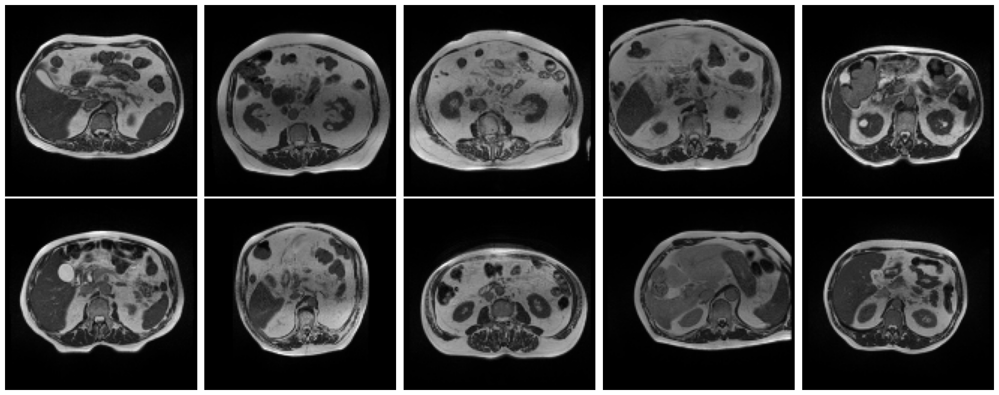

In [16]:
plt.figure(figsize=(20,8))
for i in range(10):
    axs = plt.subplot(2,5,i+1)
    plt.imshow(X_train[i], cmap="gray")
    plt.axis('off')
    axs.set_xticklabels([])
    axs.set_yticklabels([])
    plt.subplots_adjust(wspace=None, hspace=None)
plt.tight_layout()

# The Architecture

In [17]:
def build_generator():

    """
        Generator model "generates" images using random noise. The random noise AKA Latent Vector
        is sampled from a Normal Distribution which is given as the input to the Generator. Using
        Transposed Convolution, the latent vector is transformed to produce an image
        We use 3 Conv2DTranspose layers (which help in producing an image using features; opposite
        of Convolutional Learning)

        Input: Random Noise / Latent Vector
        Output: Image
    """

    model = Sequential([

        Dense(32*32*256, input_dim=NOISE_DIM),
        LeakyReLU(alpha=0.2),
        Reshape((32,32,256)),
        
        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2DTranspose(128, (4, 4), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh')
    ], 
    name="generator")
    model.summary()
    model.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)

    return model

In [18]:
def build_discriminator():
    
    """
        Discriminator is the model which is responsible for classifying the generated images
        as fake or real. Our end goal is to create a Generator so powerful that the Discriminator
        is unable to classify real and fake images
        A simple Convolutional Neural Network with 2 Conv2D layers connected to a Dense output layer
        Output layer activation is Sigmoid since this is a Binary Classifier

        Input: Generated / Real Image
        Output: Validity of Image (Fake or Real)

    """

    model = Sequential([

        Conv2D(64, (3, 3), padding='same', input_shape=(WIDTH, HEIGHT, CHANNELS)),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),

        Conv2D(128, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Conv2D(256, (3, 3), strides=2, padding='same'),
        LeakyReLU(alpha=0.2),
        
        Flatten(),
        Dropout(0.4),
        Dense(1, activation="sigmoid", input_shape=(WIDTH, HEIGHT, CHANNELS))
    ], name="discriminator")
    model.summary()
    model.compile(loss="binary_crossentropy",
                        optimizer=OPTIMIZER)

    return model

# Putting it together

In [19]:
print('\n')
discriminator = build_discriminator()
print('\n')
generator = build_generator()

discriminator.trainable = False 

gan_input = Input(shape=(NOISE_DIM,))
fake_image = generator(gan_input)

gan_output = discriminator(fake_image)

gan = Model(gan_input, gan_output, name="gan_model")
gan.compile(loss="binary_crossentropy", optimizer=OPTIMIZER)

print("The Combined Network:\n")
gan.summary()



Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 64)      640       
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 128, 128, 64)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 128)       73856     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 64, 64, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       147584    
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 32, 32, 128)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 16, 16, 256)   

In [20]:
def sample_images(noise, subplots, figsize=(22,8), save=False):
    generated_images = generator.predict(noise)
    plt.figure(figsize=figsize)
    
    for i, image in enumerate(generated_images):
        plt.subplot(subplots[0], subplots[1], i+1)
        if CHANNELS == 1:
            plt.imshow(image.reshape((WIDTH, HEIGHT)), cmap='gray')    
                                                                            
        else:
            plt.imshow(image.reshape((WIDTH, HEIGHT, CHANNELS)))
        if save == True:
            img_name = "gen" + str(i)
            plt.savefig(img_name)
        plt.subplots_adjust(wspace=None, hspace=None)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

## The Training

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 1s 554ms/step


  0%|                                        | 1/3750 [00:04<4:14:37,  4.08s/it]

1/1 [==============================] - 0s 10ms/step


  0%|                                        | 2/3750 [00:04<1:49:10,  1.75s/it]

1/1 [==============================] - 0s 8ms/step


  0%|                                        | 3/3750 [00:04<1:03:15,  1.01s/it]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 4/3750 [00:04<40:51,  1.53it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 5/3750 [00:04<28:26,  2.20it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 6/3750 [00:04<20:55,  2.98it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 7/3750 [00:04<16:10,  3.86it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 8/3750 [00:04<13:02,  4.78it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 9/3750 [00:04<10:56,  5.70it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 10/3750 [00:05<09:31,  6.54it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 11/3750 [00:05<08:36,  7.24it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 12/3750 [00:05<07:59,  7.80it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 13/3750 [00:05<07:34,  8.23it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 14/3750 [00:05<07:13,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:05<06:59,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:05<06:48,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:05<06:40,  9.32it/s]

1/1 [==============================] - 0s 13ms/step


  0%|▏                                        | 18/3750 [00:05<06:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 19/3750 [00:05<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:06<06:34,  9.46it/s]

1/1 [==============================] - 0s 7ms/step


  1%|▏                                        | 21/3750 [00:06<06:29,  9.57it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏                                        | 22/3750 [00:06<07:08,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 23/3750 [00:06<07:09,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 24/3750 [00:06<07:09,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 25/3750 [00:06<06:58,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 26/3750 [00:06<06:56,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 27/3750 [00:06<06:47,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:06<06:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 29/3750 [00:07<06:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 30/3750 [00:07<06:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 31/3750 [00:07<06:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 32/3750 [00:07<06:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 33/3750 [00:07<06:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 34/3750 [00:07<06:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 35/3750 [00:07<06:25,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 36/3750 [00:07<06:26,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 37/3750 [00:07<06:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 38/3750 [00:08<06:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 39/3750 [00:08<06:26,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 40/3750 [00:08<06:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 41/3750 [00:08<06:40,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 42/3750 [00:08<06:42,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 43/3750 [00:08<06:44,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 44/3750 [00:08<06:45,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 45/3750 [00:08<06:58,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 46/3750 [00:08<06:48,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 47/3750 [00:09<06:44,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 48/3750 [00:09<06:49,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:09<06:54,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 50/3750 [00:09<07:00,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 51/3750 [00:09<07:18,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 52/3750 [00:09<07:14,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 53/3750 [00:09<07:09,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 54/3750 [00:09<07:05,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:09<06:51,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:10<06:45,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:10<06:44,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 58/3750 [00:10<06:42,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 59/3750 [00:10<06:54,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 60/3750 [00:10<06:52,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 61/3750 [00:10<06:43,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 62/3750 [00:10<06:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:10<06:39,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 64/3750 [00:10<06:45,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:11<06:41,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 66/3750 [00:11<06:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 67/3750 [00:11<06:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 68/3750 [00:11<06:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 69/3750 [00:11<06:36,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▊                                        | 70/3750 [00:11<06:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:11<06:43,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 72/3750 [00:11<06:43,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 73/3750 [00:11<06:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 74/3750 [00:11<06:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 75/3750 [00:12<06:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 76/3750 [00:12<06:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 77/3750 [00:12<06:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 78/3750 [00:12<06:35,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:12<06:37,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 80/3750 [00:12<06:35,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 81/3750 [00:12<06:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 82/3750 [00:12<06:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 83/3750 [00:12<06:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 84/3750 [00:13<06:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:13<06:18,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 86/3750 [00:13<07:02,  8.68it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 87/3750 [00:13<07:07,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:13<06:53,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:13<06:48,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 90/3750 [00:13<06:39,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 91/3750 [00:13<06:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:13<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:14<06:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:14<06:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:14<06:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 96/3750 [00:14<06:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:14<06:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:14<06:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:14<06:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 100/3750 [00:14<06:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 101/3750 [00:14<06:19,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 102/3750 [00:14<06:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 103/3750 [00:15<06:20,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:15<06:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:15<06:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:15<06:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 107/3750 [00:15<06:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 108/3750 [00:15<06:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:15<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 110/3750 [00:15<06:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:15<06:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:16<06:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 113/3750 [00:16<06:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:16<06:29,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▏                                      | 115/3750 [00:16<06:35,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 116/3750 [00:16<06:33,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 117/3750 [00:16<06:47,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 118/3750 [00:16<06:39,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 119/3750 [00:16<06:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 120/3750 [00:16<06:29,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 121/3750 [00:17<06:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 122/3750 [00:17<06:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 123/3750 [00:17<06:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 124/3750 [00:17<06:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 125/3750 [00:17<06:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 126/3750 [00:17<06:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 127/3750 [00:17<06:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:17<06:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 129/3750 [00:17<06:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 130/3750 [00:17<06:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 131/3750 [00:18<06:10,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 132/3750 [00:18<06:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 133/3750 [00:18<06:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 134/3750 [00:18<06:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 135/3750 [00:18<06:12,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 136/3750 [00:18<06:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 137/3750 [00:18<06:10,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 138/3750 [00:18<06:10,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 139/3750 [00:18<06:09,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 140/3750 [00:18<06:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 141/3750 [00:19<06:10,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 142/3750 [00:19<06:10,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 143/3750 [00:19<06:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:19<06:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 145/3750 [00:19<06:08,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 146/3750 [00:19<06:08,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 147/3750 [00:19<06:08,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 148/3750 [00:19<06:07,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 149/3750 [00:19<06:07,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 150/3750 [00:20<06:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 151/3750 [00:20<06:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:20<06:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:20<06:09,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:20<06:08,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:20<06:07,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 156/3750 [00:20<06:07,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:20<06:07,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 158/3750 [00:20<06:06,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 159/3750 [00:20<06:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 160/3750 [00:21<06:08,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:21<06:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 162/3750 [00:21<06:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:21<06:07,  9.75it/s]

1/1 [==============================] - 0s 7ms/step


  4%|█▋                                      | 164/3750 [00:21<06:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 165/3750 [00:21<06:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:21<06:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:21<06:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 168/3750 [00:21<06:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 169/3750 [00:21<06:14,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 170/3750 [00:22<06:34,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 171/3750 [00:22<06:32,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 172/3750 [00:22<06:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 173/3750 [00:22<06:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:22<06:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:22<06:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 176/3750 [00:22<06:10,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 177/3750 [00:22<06:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 178/3750 [00:22<06:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 179/3750 [00:23<06:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:23<06:08,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 181/3750 [00:23<06:07,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 182/3750 [00:23<06:05,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 183/3750 [00:23<06:05,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:23<06:05,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:23<06:04,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 186/3750 [00:23<06:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 187/3750 [00:23<06:08,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 188/3750 [00:23<06:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 189/3750 [00:24<06:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:24<06:07,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 191/3750 [00:24<06:06,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:24<06:06,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:24<06:05,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:24<06:05,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:24<06:06,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 196/3750 [00:24<06:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 197/3750 [00:24<06:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 198/3750 [00:24<06:04,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:25<06:03,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:25<06:03,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:25<06:03,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:25<06:02,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:25<06:02,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 204/3750 [00:25<06:04,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 205/3750 [00:25<08:06,  7.29it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:25<07:28,  7.91it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:26<07:02,  8.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 208/3750 [00:26<06:44,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 209/3750 [00:26<06:32,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 210/3750 [00:26<06:40,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:26<06:31,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 212/3750 [00:26<06:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 213/3750 [00:26<06:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 214/3750 [00:26<06:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 215/3750 [00:26<06:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:26<06:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 217/3750 [00:27<06:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 218/3750 [00:27<06:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 219/3750 [00:27<06:03,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:27<06:02,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 221/3750 [00:27<06:00,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:27<06:02,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:27<06:03,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 224/3750 [00:27<06:02,  9.72it/s]

1/1 [==============================] - 0s 24ms/step


  6%|██▍                                     | 225/3750 [00:27<06:41,  8.77it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▍                                     | 226/3750 [00:28<06:44,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 227/3750 [00:28<06:44,  8.71it/s]

1/1 [==============================] - 0s 17ms/step


  6%|██▍                                     | 228/3750 [00:28<07:00,  8.37it/s]

1/1 [==============================] - 0s 18ms/step


  6%|██▍                                     | 229/3750 [00:28<07:10,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 230/3750 [00:28<07:06,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 231/3750 [00:28<07:01,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 232/3750 [00:28<07:07,  8.22it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▍                                     | 233/3750 [00:28<07:36,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 234/3750 [00:29<07:15,  8.08it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 235/3750 [00:29<06:53,  8.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 236/3750 [00:29<06:49,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:29<06:50,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 238/3750 [00:29<06:42,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:29<06:33,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 240/3750 [00:29<06:27,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 241/3750 [00:29<06:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:29<06:22,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▌                                     | 243/3750 [00:30<06:39,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 244/3750 [00:30<06:46,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 245/3750 [00:30<06:37,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:30<06:27,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:30<06:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:30<06:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:30<06:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 250/3750 [00:30<06:21,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 251/3750 [00:30<06:26,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 252/3750 [00:31<06:22,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 253/3750 [00:31<06:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 254/3750 [00:31<06:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:31<06:21,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 256/3750 [00:31<06:33,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 257/3750 [00:31<06:35,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 258/3750 [00:31<06:39,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 259/3750 [00:31<06:41,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 260/3750 [00:31<06:30,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 261/3750 [00:32<06:22,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 262/3750 [00:32<06:19,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 263/3750 [00:32<06:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 264/3750 [00:32<06:15,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 265/3750 [00:32<06:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 266/3750 [00:32<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:32<06:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 268/3750 [00:32<06:11,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 269/3750 [00:32<06:18,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 270/3750 [00:32<06:28,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 271/3750 [00:33<06:37,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:33<06:39,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 273/3750 [00:33<06:32,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 274/3750 [00:33<06:44,  8.59it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▉                                     | 275/3750 [00:33<06:54,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 276/3750 [00:33<06:57,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 277/3750 [00:33<06:56,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 278/3750 [00:33<06:45,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 279/3750 [00:34<06:39,  8.69it/s]

1/1 [==============================] - 0s 13ms/step


  7%|██▉                                     | 280/3750 [00:34<07:22,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 281/3750 [00:34<07:16,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:34<07:06,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:34<06:51,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 284/3750 [00:34<06:44,  8.56it/s]

1/1 [==============================] - 0s 12ms/step


  8%|███                                     | 285/3750 [00:34<06:47,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:34<06:38,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:34<06:29,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 288/3750 [00:35<06:24,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 289/3750 [00:35<06:19,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 290/3750 [00:35<06:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 291/3750 [00:35<06:11,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 292/3750 [00:35<06:34,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:35<06:33,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 294/3750 [00:35<06:30,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:35<06:28,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 296/3750 [00:35<06:26,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 297/3750 [00:36<06:21,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:36<06:19,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 299/3750 [00:36<06:17,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 300/3750 [00:36<06:23,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 301/3750 [00:36<06:43,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 302/3750 [00:36<06:34,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 303/3750 [00:36<06:32,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 304/3750 [00:36<06:36,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 305/3750 [00:37<06:32,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 306/3750 [00:37<06:32,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:37<06:40,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 308/3750 [00:37<06:32,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 309/3750 [00:37<06:25,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 310/3750 [00:37<06:21,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:37<06:17,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 312/3750 [00:37<06:13,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 313/3750 [00:37<06:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 314/3750 [00:38<06:12,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:38<06:16,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 316/3750 [00:38<06:13,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 317/3750 [00:38<06:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 318/3750 [00:38<06:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 319/3750 [00:38<06:10,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:38<06:11,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 321/3750 [00:38<06:20,  9.02it/s]

1/1 [==============================] - 0s 17ms/step


  9%|███▍                                    | 322/3750 [00:38<06:30,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 323/3750 [00:38<06:24,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 324/3750 [00:39<06:24,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 325/3750 [00:39<06:25,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 326/3750 [00:39<06:33,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 327/3750 [00:39<06:40,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 328/3750 [00:39<06:45,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 329/3750 [00:39<06:37,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 330/3750 [00:39<06:24,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 331/3750 [00:39<06:27,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 332/3750 [00:40<06:31,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 333/3750 [00:40<06:27,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 334/3750 [00:40<06:20,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 335/3750 [00:40<06:13,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 336/3750 [00:40<06:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 337/3750 [00:40<06:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 338/3750 [00:40<05:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 339/3750 [00:40<05:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 340/3750 [00:40<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 341/3750 [00:40<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:41<05:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 343/3750 [00:41<05:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:41<05:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 345/3750 [00:41<05:56,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 346/3750 [00:41<06:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 347/3750 [00:41<06:05,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 348/3750 [00:41<06:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:41<06:39,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 350/3750 [00:41<06:32,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:42<06:20,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 352/3750 [00:42<06:11,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 353/3750 [00:42<06:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 354/3750 [00:42<06:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 355/3750 [00:42<05:57,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 356/3750 [00:42<06:07,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 357/3750 [00:42<06:12,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 358/3750 [00:42<06:23,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 359/3750 [00:42<06:33,  8.61it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▊                                    | 360/3750 [00:43<06:34,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 361/3750 [00:43<06:30,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 362/3750 [00:43<06:28,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 363/3750 [00:43<06:35,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 364/3750 [00:43<06:45,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▉                                    | 365/3750 [00:43<06:48,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 366/3750 [00:43<06:46,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 367/3750 [00:43<06:35,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:44<06:27,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 369/3750 [00:44<06:29,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 370/3750 [00:44<06:31,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 371/3750 [00:44<06:22,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:44<06:14,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 373/3750 [00:44<06:07,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:44<06:08,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 375/3750 [00:44<06:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:44<06:07,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 377/3750 [00:44<06:07,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 378/3750 [00:45<06:03,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 379/3750 [00:45<06:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 380/3750 [00:45<05:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 381/3750 [00:45<05:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 382/3750 [00:45<06:09,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 383/3750 [00:45<06:27,  8.70it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 384/3750 [00:45<06:49,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 385/3750 [00:45<06:48,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 386/3750 [00:46<06:36,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 387/3750 [00:46<06:25,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 388/3750 [00:46<06:13,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:46<06:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 390/3750 [00:46<06:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:46<05:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 392/3750 [00:46<05:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 393/3750 [00:46<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 394/3750 [00:46<05:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:46<05:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 396/3750 [00:47<05:53,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 397/3750 [00:47<05:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 398/3750 [00:47<05:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 399/3750 [00:47<05:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:47<05:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 401/3750 [00:47<05:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 402/3750 [00:47<05:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 403/3750 [00:47<05:50,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 404/3750 [00:47<05:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:48<05:50,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 406/3750 [00:48<05:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 407/3750 [00:48<05:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 408/3750 [00:48<05:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 409/3750 [00:48<06:08,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 410/3750 [00:48<06:05,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 411/3750 [00:48<06:06,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 412/3750 [00:48<05:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 413/3750 [00:48<05:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 414/3750 [00:48<05:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 415/3750 [00:49<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:49<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 417/3750 [00:49<06:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 418/3750 [00:49<07:01,  7.91it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 419/3750 [00:49<06:44,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 420/3750 [00:49<06:34,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 421/3750 [00:49<06:26,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:49<06:17,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 423/3750 [00:50<06:09,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 424/3750 [00:50<06:06,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 425/3750 [00:50<05:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 426/3750 [00:50<05:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:50<05:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:50<05:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:50<05:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 430/3750 [00:50<05:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 431/3750 [00:50<05:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 432/3750 [00:50<05:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 433/3750 [00:51<05:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:51<05:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:51<05:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 436/3750 [00:51<05:44,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:51<05:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 438/3750 [00:51<05:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 439/3750 [00:51<05:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:51<05:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:51<05:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:52<05:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:52<05:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:52<05:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 445/3750 [00:52<05:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 446/3750 [00:52<05:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:52<05:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:52<05:45,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:52<05:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:52<05:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:52<05:45,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 452/3750 [00:53<05:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 453/3750 [00:53<05:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:53<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:53<05:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 456/3750 [00:53<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 457/3750 [00:53<05:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 458/3750 [00:53<05:42,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 459/3750 [00:53<05:44,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:53<05:53,  9.32it/s]

1/1 [==============================] - 0s 12ms/step


 12%|████▉                                   | 461/3750 [00:54<06:14,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 12%|████▉                                   | 462/3750 [00:54<06:21,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▉                                   | 463/3750 [00:54<06:26,  8.51it/s]

1/1 [==============================] - 0s 11ms/step


 12%|████▉                                   | 464/3750 [00:54<06:34,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▉                                   | 465/3750 [00:54<06:39,  8.22it/s]

1/1 [==============================] - 0s 11ms/step


 12%|████▉                                   | 466/3750 [00:54<06:43,  8.13it/s]

1/1 [==============================] - 0s 11ms/step


 12%|████▉                                   | 467/3750 [00:54<06:46,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 468/3750 [00:54<06:37,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 469/3750 [00:55<06:33,  8.33it/s]

1/1 [==============================] - 0s 12ms/step


 13%|█████                                   | 470/3750 [00:55<06:40,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 471/3750 [00:55<06:36,  8.27it/s]

1/1 [==============================] - 0s 11ms/step


 13%|█████                                   | 472/3750 [00:55<06:39,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 473/3750 [00:55<06:35,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 474/3750 [00:55<06:34,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 475/3750 [00:55<06:36,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 476/3750 [00:55<06:36,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 477/3750 [00:55<06:36,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 478/3750 [00:56<06:29,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:56<06:17,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:56<06:04,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:56<05:56,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 482/3750 [00:56<05:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 483/3750 [00:56<05:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 484/3750 [00:56<05:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 485/3750 [00:56<05:39,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 486/3750 [00:56<05:42,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▏                                  | 487/3750 [00:57<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 488/3750 [00:57<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:57<05:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 490/3750 [00:57<05:50,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▏                                  | 491/3750 [00:57<06:07,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:57<06:10,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 493/3750 [00:57<06:03,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 494/3750 [00:57<05:54,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 495/3750 [00:57<05:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 496/3750 [00:58<05:43,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 497/3750 [00:58<06:05,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 498/3750 [00:58<06:12,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 499/3750 [00:58<06:10,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 500/3750 [00:58<06:09,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 501/3750 [00:58<06:14,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 502/3750 [00:58<06:24,  8.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:58<06:10,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 504/3750 [00:58<06:02,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:59<05:54,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:59<05:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:59<05:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 508/3750 [00:59<05:57,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 509/3750 [00:59<06:01,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 510/3750 [00:59<05:55,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 511/3750 [00:59<05:54,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 512/3750 [00:59<05:51,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:59<05:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 514/3750 [01:00<05:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [01:00<05:56,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 516/3750 [01:00<06:07,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▌                                  | 517/3750 [01:00<06:17,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 518/3750 [01:00<06:22,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 519/3750 [01:00<06:29,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 520/3750 [01:00<06:31,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 521/3750 [01:00<06:32,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [01:01<06:34,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 523/3750 [01:01<06:35,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 524/3750 [01:01<06:33,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 525/3750 [01:01<06:39,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 526/3750 [01:01<06:38,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 527/3750 [01:01<06:39,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 528/3750 [01:01<06:37,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 529/3750 [01:01<06:40,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 530/3750 [01:02<06:39,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 531/3750 [01:02<07:06,  7.54it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 532/3750 [01:02<06:58,  7.68it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [01:02<06:49,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 534/3750 [01:02<06:46,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 535/3750 [01:02<06:39,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 536/3750 [01:02<06:36,  8.11it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [01:02<06:33,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 538/3750 [01:03<06:32,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 539/3750 [01:03<06:30,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [01:03<06:30,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▊                                  | 541/3750 [01:03<06:31,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 542/3750 [01:03<06:30,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 543/3750 [01:03<06:32,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 544/3750 [01:03<06:31,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 545/3750 [01:03<06:31,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 546/3750 [01:03<06:32,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [01:04<06:29,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 548/3750 [01:04<06:29,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 549/3750 [01:04<06:26,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 550/3750 [01:04<06:27,  8.27it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [01:04<06:26,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 552/3750 [01:04<06:27,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 553/3750 [01:04<06:29,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 554/3750 [01:04<06:30,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 555/3750 [01:05<06:29,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 556/3750 [01:05<06:27,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 557/3750 [01:05<06:27,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 558/3750 [01:05<06:30,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 559/3750 [01:05<06:31,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 560/3750 [01:05<06:29,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:05<06:32,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 562/3750 [01:05<06:32,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 563/3750 [01:06<06:28,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 564/3750 [01:06<06:26,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 565/3750 [01:06<06:27,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 566/3750 [01:06<06:27,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 567/3750 [01:06<06:25,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:06<06:23,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 569/3750 [01:06<06:23,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:06<06:26,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 571/3750 [01:07<06:27,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 572/3750 [01:07<06:27,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 573/3750 [01:07<06:27,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:07<06:26,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 575/3750 [01:07<06:25,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 576/3750 [01:07<06:28,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:07<06:29,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 578/3750 [01:07<06:38,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 579/3750 [01:08<06:38,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 580/3750 [01:08<06:33,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 581/3750 [01:08<06:30,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 582/3750 [01:08<06:29,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:08<06:27,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▏                                 | 584/3750 [01:08<06:26,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 585/3750 [01:08<06:26,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 586/3750 [01:08<06:30,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 587/3750 [01:08<06:28,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 588/3750 [01:09<06:32,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 589/3750 [01:09<06:29,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 590/3750 [01:09<06:28,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 591/3750 [01:09<06:27,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 592/3750 [01:09<06:25,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 593/3750 [01:09<06:21,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 594/3750 [01:09<06:22,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 595/3750 [01:09<06:21,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 596/3750 [01:10<06:19,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:10<06:22,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:10<06:21,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 599/3750 [01:10<06:24,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 600/3750 [01:10<06:24,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 601/3750 [01:10<06:24,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 602/3750 [01:10<06:24,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 603/3750 [01:10<06:24,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 604/3750 [01:11<06:22,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 605/3750 [01:11<06:24,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 606/3750 [01:11<06:24,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 607/3750 [01:11<06:25,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:11<06:24,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▍                                 | 609/3750 [01:11<06:28,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 610/3750 [01:11<06:30,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 611/3750 [01:11<06:30,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 612/3750 [01:12<06:31,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 613/3750 [01:12<06:33,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 614/3750 [01:12<06:33,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 615/3750 [01:12<06:30,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 616/3750 [01:12<06:27,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:12<06:26,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:12<06:26,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▌                                 | 619/3750 [01:12<06:25,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 620/3750 [01:13<06:25,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 621/3750 [01:13<06:24,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 622/3750 [01:13<06:24,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 623/3750 [01:13<06:22,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 624/3750 [01:13<06:23,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 625/3750 [01:13<06:25,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 626/3750 [01:13<06:25,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 627/3750 [01:13<06:25,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 628/3750 [01:14<06:24,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 629/3750 [01:14<06:22,  8.16it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 630/3750 [01:14<06:18,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 631/3750 [01:14<06:22,  8.15it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▋                                 | 632/3750 [01:14<06:24,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 633/3750 [01:14<06:39,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 634/3750 [01:14<06:35,  7.87it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▊                                 | 635/3750 [01:14<06:33,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 636/3750 [01:15<06:32,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 637/3750 [01:15<06:29,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 638/3750 [01:15<06:27,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 639/3750 [01:15<06:25,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 640/3750 [01:15<06:22,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 641/3750 [01:15<06:21,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 642/3750 [01:15<06:25,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 643/3750 [01:15<06:28,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 644/3750 [01:16<06:26,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 645/3750 [01:16<06:24,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 646/3750 [01:16<06:22,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 647/3750 [01:16<06:21,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 648/3750 [01:16<06:20,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:16<06:20,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 650/3750 [01:16<06:22,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 651/3750 [01:16<06:23,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 652/3750 [01:17<06:24,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 653/3750 [01:17<06:22,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 654/3750 [01:17<06:46,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 655/3750 [01:17<06:39,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 656/3750 [01:17<06:42,  7.69it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 657/3750 [01:17<06:35,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 658/3750 [01:17<06:30,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 659/3750 [01:17<06:28,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 660/3750 [01:18<06:27,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 661/3750 [01:18<06:25,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 662/3750 [01:18<06:24,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 663/3750 [01:18<06:21,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 664/3750 [01:18<06:22,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 665/3750 [01:18<06:21,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 666/3750 [01:18<06:20,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 667/3750 [01:18<06:20,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 668/3750 [01:19<06:16,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 669/3750 [01:19<06:18,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 670/3750 [01:19<06:17,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 671/3750 [01:19<06:16,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:19<06:15,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 673/3750 [01:19<06:21,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 674/3750 [01:19<06:20,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 675/3750 [01:19<06:18,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:19<06:16,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 677/3750 [01:20<06:14,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 678/3750 [01:20<06:17,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 679/3750 [01:20<06:15,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 680/3750 [01:20<06:17,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 681/3750 [01:20<06:16,  8.15it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████▎                                | 682/3750 [01:20<06:17,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:20<06:14,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 684/3750 [01:20<06:14,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 685/3750 [01:21<06:13,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 686/3750 [01:21<06:14,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 687/3750 [01:21<06:16,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 688/3750 [01:21<06:18,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 689/3750 [01:21<06:18,  8.10it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 690/3750 [01:21<06:15,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 691/3750 [01:21<06:14,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▍                                | 692/3750 [01:21<06:26,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████▍                                | 693/3750 [01:22<06:31,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 694/3750 [01:22<06:29,  7.85it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 695/3750 [01:22<06:28,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 696/3750 [01:22<06:30,  7.82it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 697/3750 [01:22<06:25,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▍                                | 698/3750 [01:22<06:21,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 699/3750 [01:22<06:18,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:22<06:01,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:23<05:49,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 702/3750 [01:23<05:38,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 703/3750 [01:23<05:35,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 704/3750 [01:23<05:30,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 705/3750 [01:23<05:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 706/3750 [01:23<05:31,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:23<05:34,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 708/3750 [01:23<05:33,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 709/3750 [01:23<05:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 710/3750 [01:24<05:27,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 711/3750 [01:24<05:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:24<05:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:24<05:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 714/3750 [01:24<05:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:24<05:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:24<05:27,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 717/3750 [01:24<05:37,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 718/3750 [01:24<05:42,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:25<05:52,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 720/3750 [01:25<05:56,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▋                                | 721/3750 [01:25<06:04,  8.32it/s]

1/1 [==============================] - 0s 12ms/step


 19%|███████▋                                | 722/3750 [01:25<06:06,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 723/3750 [01:25<06:07,  8.23it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▋                                | 724/3750 [01:25<06:11,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 725/3750 [01:25<06:11,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 726/3750 [01:25<06:09,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▊                                | 727/3750 [01:26<06:07,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:26<06:04,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 729/3750 [01:26<06:03,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▊                                | 730/3750 [01:26<06:03,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 731/3750 [01:26<06:05,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 732/3750 [01:26<06:03,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 733/3750 [01:26<06:03,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 734/3750 [01:26<06:01,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 735/3750 [01:26<06:01,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:27<05:59,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 737/3750 [01:27<05:58,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:27<05:57,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 739/3750 [01:27<05:56,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:27<05:56,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:27<06:01,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:27<06:03,  8.26it/s]

1/1 [==============================] - 0s 19ms/step


 20%|███████▉                                | 743/3750 [01:27<06:16,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 744/3750 [01:28<06:12,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 745/3750 [01:28<06:06,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 746/3750 [01:28<06:03,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:28<06:02,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:28<05:59,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:28<05:58,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 750/3750 [01:28<05:56,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 751/3750 [01:28<05:59,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 752/3750 [01:29<05:59,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 753/3750 [01:29<06:00,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


 20%|████████                                | 754/3750 [01:29<06:02,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 755/3750 [01:29<06:01,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 756/3750 [01:29<06:03,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 757/3750 [01:29<06:02,  8.26it/s]

1/1 [==============================] - 0s 11ms/step


 20%|████████                                | 758/3750 [01:29<06:03,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 759/3750 [01:29<06:01,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 760/3750 [01:29<06:05,  8.18it/s]

1/1 [==============================] - 0s 11ms/step


 20%|████████                                | 761/3750 [01:30<06:06,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 762/3750 [01:30<06:05,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████▏                               | 763/3750 [01:30<06:04,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████▏                               | 764/3750 [01:30<06:00,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 765/3750 [01:30<05:57,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:30<05:45,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:30<05:35,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:30<05:27,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:31<05:23,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 770/3750 [01:31<05:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:31<05:22,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▏                               | 772/3750 [01:31<05:29,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 773/3750 [01:31<05:25,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 774/3750 [01:31<05:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 775/3750 [01:31<05:19,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 776/3750 [01:31<05:19,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▎                               | 777/3750 [01:31<05:33,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 778/3750 [01:31<05:28,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 779/3750 [01:32<05:22,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 780/3750 [01:32<05:18,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 781/3750 [01:32<05:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 782/3750 [01:32<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 783/3750 [01:32<05:09,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 784/3750 [01:32<05:09,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:32<05:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 786/3750 [01:32<05:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 787/3750 [01:32<05:10,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 788/3750 [01:33<05:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 789/3750 [01:33<05:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 790/3750 [01:33<05:08,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 791/3750 [01:33<05:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 792/3750 [01:33<05:12,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 793/3750 [01:33<05:23,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 794/3750 [01:33<05:24,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:33<05:21,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 796/3750 [01:33<05:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 797/3750 [01:33<05:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 798/3750 [01:34<05:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 799/3750 [01:34<05:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:34<05:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 801/3750 [01:34<05:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:34<05:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:34<05:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 804/3750 [01:34<05:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:34<05:14,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▌                               | 806/3750 [01:34<05:19,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 807/3750 [01:35<05:19,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 808/3750 [01:35<05:25,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 809/3750 [01:35<05:33,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 810/3750 [01:35<05:26,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 811/3750 [01:35<05:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 812/3750 [01:35<05:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 813/3750 [01:35<05:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:35<05:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 815/3750 [01:35<05:12,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 816/3750 [01:36<05:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 817/3750 [01:36<05:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 818/3750 [01:36<05:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 819/3750 [01:36<05:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 820/3750 [01:36<05:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:36<05:36,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:36<05:43,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 823/3750 [01:36<05:44,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 824/3750 [01:36<05:55,  8.23it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▊                               | 825/3750 [01:37<06:06,  7.99it/s]

1/1 [==============================] - 0s 12ms/step


 22%|████████▊                               | 826/3750 [01:37<06:14,  7.82it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▊                               | 827/3750 [01:37<06:36,  7.38it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 828/3750 [01:37<06:30,  7.49it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 829/3750 [01:37<06:25,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 830/3750 [01:37<06:19,  7.69it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 831/3750 [01:37<06:15,  7.78it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 832/3750 [01:38<06:08,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 833/3750 [01:38<06:06,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 834/3750 [01:38<06:08,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 835/3750 [01:38<06:08,  7.90it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 836/3750 [01:38<06:10,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 837/3750 [01:38<06:12,  7.83it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 838/3750 [01:38<06:10,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 839/3750 [01:38<06:08,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:39<06:04,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 841/3750 [01:39<06:05,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 842/3750 [01:39<06:04,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 843/3750 [01:39<06:08,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 844/3750 [01:39<06:05,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 845/3750 [01:39<06:09,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 846/3750 [01:39<06:03,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:39<06:02,  8.01it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████                               | 848/3750 [01:40<06:03,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 849/3750 [01:40<06:05,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 850/3750 [01:40<06:04,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 851/3750 [01:40<06:04,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 852/3750 [01:40<06:05,  7.94it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████                               | 853/3750 [01:40<06:05,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 854/3750 [01:40<06:08,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 855/3750 [01:40<06:08,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▏                              | 856/3750 [01:41<06:06,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 857/3750 [01:41<06:05,  7.91it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:41<06:02,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 859/3750 [01:41<05:59,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 860/3750 [01:41<06:00,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 861/3750 [01:41<06:03,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 862/3750 [01:41<06:02,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:41<06:02,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 864/3750 [01:42<06:00,  8.01it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 865/3750 [01:42<06:04,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 866/3750 [01:42<06:00,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 867/3750 [01:42<05:54,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 868/3750 [01:42<05:53,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 869/3750 [01:42<05:55,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 870/3750 [01:42<05:57,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 871/3750 [01:42<05:57,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 872/3750 [01:43<05:57,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 873/3750 [01:43<05:58,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 874/3750 [01:43<05:57,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 875/3750 [01:43<06:00,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▎                              | 876/3750 [01:43<06:04,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 877/3750 [01:43<06:02,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 878/3750 [01:43<06:02,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▍                              | 879/3750 [01:43<06:06,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▍                              | 880/3750 [01:44<06:08,  7.80it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▍                              | 881/3750 [01:44<06:07,  7.80it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▍                              | 882/3750 [01:44<06:08,  7.79it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▍                              | 883/3750 [01:44<05:56,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 884/3750 [01:44<05:43,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 885/3750 [01:44<05:34,  8.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 886/3750 [01:44<05:24,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 887/3750 [01:44<05:19,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 888/3750 [01:44<05:16,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:45<05:13,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 890/3750 [01:45<05:13,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 891/3750 [01:45<05:09,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:45<05:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:45<05:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:45<05:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 895/3750 [01:45<04:58,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 896/3750 [01:45<05:00,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 897/3750 [01:45<05:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 898/3750 [01:46<05:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:46<05:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 900/3750 [01:46<05:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:46<05:08,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 902/3750 [01:46<05:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 903/3750 [01:46<05:08,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 904/3750 [01:46<05:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 905/3750 [01:46<05:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:46<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 907/3750 [01:47<05:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 908/3750 [01:47<05:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 909/3750 [01:47<04:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:47<04:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 911/3750 [01:47<04:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:47<04:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 913/3750 [01:47<04:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 914/3750 [01:47<04:57,  9.54it/s]

1/1 [==============================] - 0s 7ms/step


 24%|█████████▊                              | 915/3750 [01:47<04:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 916/3750 [01:47<04:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 917/3750 [01:48<04:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 918/3750 [01:48<04:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 919/3750 [01:48<04:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 920/3750 [01:48<04:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 921/3750 [01:48<04:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 922/3750 [01:48<04:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 923/3750 [01:48<04:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 924/3750 [01:48<04:53,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 925/3750 [01:48<04:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 926/3750 [01:48<04:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:49<04:54,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 928/3750 [01:49<04:54,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 929/3750 [01:49<04:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:49<04:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 931/3750 [01:49<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:49<05:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:49<05:09,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 934/3750 [01:49<05:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 935/3750 [01:49<05:11,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 936/3750 [01:50<05:07,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 937/3750 [01:50<05:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 938/3750 [01:50<05:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 939/3750 [01:50<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 940/3750 [01:50<04:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 941/3750 [01:50<04:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 942/3750 [01:50<04:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 943/3750 [01:50<04:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 944/3750 [01:50<04:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 945/3750 [01:51<04:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:51<04:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 947/3750 [01:51<04:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 948/3750 [01:51<04:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 949/3750 [01:51<04:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 950/3750 [01:51<04:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 951/3750 [01:51<04:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 952/3750 [01:51<04:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 953/3750 [01:51<04:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 954/3750 [01:51<04:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 955/3750 [01:52<04:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 956/3750 [01:52<04:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 957/3750 [01:52<04:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 958/3750 [01:52<04:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 959/3750 [01:52<04:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 960/3750 [01:52<04:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 961/3750 [01:52<04:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 962/3750 [01:52<04:49,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 963/3750 [01:52<04:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 964/3750 [01:53<04:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:53<04:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 966/3750 [01:53<04:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 967/3750 [01:53<04:51,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 968/3750 [01:53<04:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 969/3750 [01:53<04:49,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 970/3750 [01:53<04:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 971/3750 [01:53<04:49,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:53<04:49,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:53<04:50,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 974/3750 [01:54<04:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 975/3750 [01:54<04:49,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 976/3750 [01:54<04:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 977/3750 [01:54<04:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 978/3750 [01:54<04:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 979/3750 [01:54<04:46,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 980/3750 [01:54<04:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 981/3750 [01:54<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:54<04:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:54<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 984/3750 [01:55<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:55<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:55<04:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 987/3750 [01:55<04:45,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 988/3750 [01:55<04:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:55<04:49,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 990/3750 [01:55<04:48,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 991/3750 [01:55<04:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 992/3750 [01:55<04:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 993/3750 [01:56<04:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 994/3750 [01:56<04:47,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 995/3750 [01:56<04:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:56<04:45,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 997/3750 [01:56<04:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 998/3750 [01:56<04:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 999/3750 [01:56<04:45,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1000/3750 [01:56<04:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1001/3750 [01:56<04:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1002/3750 [01:56<04:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1003/3750 [01:57<04:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:57<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:57<04:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1006/3750 [01:57<04:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:57<04:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1008/3750 [01:57<04:48,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1009/3750 [01:57<04:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:57<04:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1011/3750 [01:57<04:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1012/3750 [01:58<04:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1013/3750 [01:58<04:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1014/3750 [01:58<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1015/3750 [01:58<04:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1016/3750 [01:58<04:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1017/3750 [01:58<04:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1018/3750 [01:58<04:44,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:58<04:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1020/3750 [01:58<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:58<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:59<04:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:59<04:40,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1024/3750 [01:59<04:40,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1025/3750 [01:59<04:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1026/3750 [01:59<04:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1027/3750 [01:59<04:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:59<04:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:59<04:43,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1030/3750 [01:59<04:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:59<04:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [02:00<04:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [02:00<04:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [02:00<04:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1035/3750 [02:00<04:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [02:00<04:42,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [02:00<04:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [02:00<04:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [02:00<04:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1040/3750 [02:00<04:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1041/3750 [02:01<04:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1042/3750 [02:01<04:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1043/3750 [02:01<04:39,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1044/3750 [02:01<04:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1045/3750 [02:01<04:41,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1046/3750 [02:01<04:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1047/3750 [02:01<04:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1048/3750 [02:01<04:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1049/3750 [02:01<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [02:01<04:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1051/3750 [02:02<04:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1052/3750 [02:02<04:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1053/3750 [02:02<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [02:02<04:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [02:02<04:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [02:02<04:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1057/3750 [02:02<04:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1058/3750 [02:02<04:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1059/3750 [02:02<04:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1060/3750 [02:03<04:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1061/3750 [02:03<04:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1062/3750 [02:03<04:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1063/3750 [02:03<04:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [02:03<04:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1065/3750 [02:03<04:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [02:03<04:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [02:03<04:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [02:03<04:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████                            | 1069/3750 [02:03<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [02:04<04:37,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1071/3750 [02:04<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1072/3750 [02:04<04:36,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1073/3750 [02:04<04:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [02:04<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [02:04<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [02:04<04:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [02:04<04:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [02:04<04:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [02:04<04:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1080/3750 [02:05<04:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [02:05<04:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [02:05<04:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [02:05<04:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1084/3750 [02:05<04:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [02:05<04:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1086/3750 [02:05<04:35,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1087/3750 [02:05<04:35,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1088/3750 [02:05<04:35,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1089/3750 [02:06<04:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1090/3750 [02:06<04:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1091/3750 [02:06<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1092/3750 [02:06<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1093/3750 [02:06<04:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1094/3750 [02:06<04:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1095/3750 [02:06<04:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1096/3750 [02:06<04:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1097/3750 [02:06<04:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1098/3750 [02:06<04:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1099/3750 [02:07<04:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1100/3750 [02:07<04:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1101/3750 [02:07<04:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1102/3750 [02:07<04:41,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1103/3750 [02:07<04:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [02:07<04:46,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [02:07<04:44,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▌                           | 1106/3750 [02:07<04:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [02:07<04:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1108/3750 [02:08<04:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1109/3750 [02:08<04:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1110/3750 [02:08<04:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1111/3750 [02:08<04:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1112/3750 [02:08<04:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1113/3750 [02:08<04:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [02:08<04:38,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1115/3750 [02:08<04:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [02:08<04:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [02:08<04:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [02:09<04:35,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1119/3750 [02:09<04:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1120/3750 [02:09<04:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1121/3750 [02:09<04:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [02:09<04:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1123/3750 [02:09<04:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1124/3750 [02:09<04:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1125/3750 [02:09<04:33,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [02:09<04:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [02:10<04:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1128/3750 [02:10<04:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1129/3750 [02:10<04:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1130/3750 [02:10<04:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [02:10<04:31,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1132/3750 [02:10<04:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [02:10<04:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:10<04:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1135/3750 [02:10<04:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1136/3750 [02:10<04:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1137/3750 [02:11<04:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1138/3750 [02:11<04:33,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:11<04:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1140/3750 [02:11<04:32,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1141/3750 [02:11<04:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1142/3750 [02:11<04:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1143/3750 [02:11<04:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1144/3750 [02:11<04:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1145/3750 [02:11<04:30,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:12<04:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1147/3750 [02:12<04:30,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:12<04:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1149/3750 [02:12<04:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1150/3750 [02:12<04:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1151/3750 [02:12<04:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1152/3750 [02:12<04:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1153/3750 [02:12<04:31,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1154/3750 [02:12<04:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:12<04:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1156/3750 [02:13<04:31,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1157/3750 [02:13<04:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:13<04:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:13<04:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:13<04:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1161/3750 [02:13<04:29,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1162/3750 [02:13<04:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:13<04:30,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1164/3750 [02:13<04:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:13<04:30,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:14<04:29,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1167/3750 [02:14<04:30,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1168/3750 [02:14<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1169/3750 [02:14<04:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1170/3750 [02:14<04:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1171/3750 [02:14<04:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1172/3750 [02:14<04:26,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1173/3750 [02:14<04:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:14<04:27,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:15<04:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1176/3750 [02:15<04:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1177/3750 [02:15<04:27,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1178/3750 [02:15<04:27,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1179/3750 [02:15<04:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:15<04:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1181/3750 [02:15<04:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:15<04:28,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1183/3750 [02:15<04:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1184/3750 [02:15<04:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1185/3750 [02:16<04:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:16<04:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1187/3750 [02:16<04:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:16<04:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1189/3750 [02:16<04:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:16<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:16<04:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1192/3750 [02:16<04:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:16<04:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1194/3750 [02:17<04:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1195/3750 [02:17<04:25,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1196/3750 [02:17<04:25,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1197/3750 [02:17<04:26,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1198/3750 [02:17<04:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1199/3750 [02:17<04:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:17<04:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:17<04:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1202/3750 [02:17<04:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1203/3750 [02:17<04:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:18<04:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1205/3750 [02:18<04:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1206/3750 [02:18<04:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:18<04:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1208/3750 [02:18<04:21,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:18<04:21,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:18<04:23,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1211/3750 [02:18<04:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:18<04:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1213/3750 [02:19<04:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1214/3750 [02:19<04:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1215/3750 [02:19<04:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1216/3750 [02:19<04:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1217/3750 [02:19<04:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:19<04:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:19<04:24,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1220/3750 [02:19<04:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:19<04:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:19<04:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1223/3750 [02:20<04:23,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:20<04:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:20<04:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:20<04:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1227/3750 [02:20<04:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:20<04:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:20<04:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1230/3750 [02:20<04:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1231/3750 [02:20<04:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1232/3750 [02:20<04:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1233/3750 [02:21<04:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:21<04:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:21<04:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:21<04:31,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1237/3750 [02:21<04:40,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1238/3750 [02:21<04:34,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1239/3750 [02:21<04:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:21<04:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1241/3750 [02:21<04:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1242/3750 [02:22<04:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1243/3750 [02:22<04:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1244/3750 [02:22<04:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1245/3750 [02:22<04:20,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1246/3750 [02:22<04:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1247/3750 [02:22<06:28,  6.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1248/3750 [02:22<05:49,  7.16it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1249/3750 [02:22<05:21,  7.78it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1250/3750 [02:23<05:02,  8.27it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1251/3750 [02:23<04:50,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:23<04:41,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:23<04:34,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1254/3750 [02:23<04:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1255/3750 [02:23<04:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1256/3750 [02:23<04:25,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:23<04:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:23<04:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:24<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1260/3750 [02:24<04:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1261/3750 [02:24<04:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:24<04:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1263/3750 [02:24<04:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:24<04:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:24<04:20,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1266/3750 [02:24<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:24<04:19,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1268/3750 [02:24<04:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:25<04:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:25<04:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1271/3750 [02:25<04:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:25<04:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:25<04:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:25<04:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:25<04:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:25<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1277/3750 [02:25<04:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:26<04:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:26<04:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1280/3750 [02:26<04:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:26<04:16,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1282/3750 [02:26<04:20,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1283/3750 [02:26<04:23,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1284/3750 [02:26<04:45,  8.64it/s]

1/1 [==============================] - 0s 11ms/step


 34%|█████████████▎                         | 1285/3750 [02:26<04:42,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1286/3750 [02:26<04:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1287/3750 [02:26<04:33,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1288/3750 [02:27<04:28,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:27<04:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1290/3750 [02:27<04:29,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1291/3750 [02:27<04:29,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1292/3750 [02:27<04:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1293/3750 [02:27<04:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:27<04:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:27<04:26,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1296/3750 [02:27<04:28,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▍                         | 1297/3750 [02:28<04:30,  9.08it/s]

1/1 [==============================] - 0s 12ms/step


 35%|█████████████▍                         | 1298/3750 [02:28<04:35,  8.91it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▌                         | 1299/3750 [02:28<04:44,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1300/3750 [02:28<04:48,  8.49it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▌                         | 1301/3750 [02:28<04:57,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1302/3750 [02:28<05:08,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1303/3750 [02:28<05:10,  7.88it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1304/3750 [02:28<04:56,  8.24it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1305/3750 [02:29<04:43,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1306/3750 [02:29<04:34,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1307/3750 [02:29<04:28,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1308/3750 [02:29<04:23,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1309/3750 [02:29<04:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1310/3750 [02:29<04:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1311/3750 [02:29<04:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1312/3750 [02:29<04:18,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1313/3750 [02:29<04:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1314/3750 [02:30<04:28,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:30<04:27,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:30<04:31,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1317/3750 [02:30<04:25,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1318/3750 [02:30<04:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:30<04:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1320/3750 [02:30<04:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1321/3750 [02:30<04:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:30<04:16,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1323/3750 [02:30<04:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1324/3750 [02:31<04:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1325/3750 [02:31<04:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:31<04:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1327/3750 [02:31<04:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1328/3750 [02:31<04:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1329/3750 [02:31<04:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1330/3750 [02:31<04:12,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1331/3750 [02:31<04:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1332/3750 [02:31<04:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1333/3750 [02:32<04:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1334/3750 [02:32<04:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1335/3750 [02:32<04:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1336/3750 [02:32<04:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1337/3750 [02:32<04:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1338/3750 [02:32<04:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1339/3750 [02:32<04:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1340/3750 [02:32<04:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1341/3750 [02:32<04:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1342/3750 [02:32<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1343/3750 [02:33<04:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1344/3750 [02:33<04:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1345/3750 [02:33<04:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1346/3750 [02:33<04:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1347/3750 [02:33<04:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1348/3750 [02:33<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:33<04:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:33<04:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:33<04:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:34<04:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1353/3750 [02:34<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1354/3750 [02:34<04:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1355/3750 [02:34<04:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1356/3750 [02:34<04:11,  9.54it/s]

1/1 [==============================] - 0s 7ms/step


 36%|██████████████                         | 1357/3750 [02:34<04:09,  9.58it/s]

1/1 [==============================] - 0s 35ms/step


 36%|██████████████                         | 1358/3750 [02:34<04:41,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1359/3750 [02:34<04:33,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1360/3750 [02:34<04:26,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:35<04:20,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:35<04:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1363/3750 [02:35<04:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1364/3750 [02:35<04:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1365/3750 [02:35<04:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:35<04:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:35<04:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:35<04:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:35<04:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:35<04:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:36<04:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1372/3750 [02:36<04:06,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:36<04:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:36<04:05,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:36<04:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1376/3750 [02:36<04:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:36<04:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1378/3750 [02:36<04:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:36<04:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1380/3750 [02:36<04:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:37<04:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1382/3750 [02:37<04:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:37<04:07,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1384/3750 [02:37<04:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1385/3750 [02:37<04:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1386/3750 [02:37<04:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1387/3750 [02:37<04:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:37<04:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1389/3750 [02:37<04:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:38<04:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:38<04:06,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1392/3750 [02:38<04:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:38<04:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:38<04:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:38<04:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1396/3750 [02:38<04:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1397/3750 [02:38<04:04,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:38<04:03,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1399/3750 [02:38<04:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:39<04:04,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1401/3750 [02:39<04:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1402/3750 [02:39<04:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1403/3750 [02:39<04:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1404/3750 [02:39<04:03,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1405/3750 [02:39<04:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:39<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1407/3750 [02:39<04:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:39<04:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1409/3750 [02:40<04:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1410/3750 [02:40<04:03,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1411/3750 [02:40<04:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:40<04:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:40<04:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:40<04:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:40<04:00,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1416/3750 [02:40<04:01,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:40<04:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:40<04:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1419/3750 [02:41<04:03,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:41<04:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1421/3750 [02:41<04:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1422/3750 [02:41<04:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1423/3750 [02:41<04:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1424/3750 [02:41<04:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:41<04:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1426/3750 [02:41<04:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:41<04:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1428/3750 [02:41<04:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1429/3750 [02:42<04:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1430/3750 [02:42<04:00,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:42<04:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1432/3750 [02:42<04:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:42<04:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1434/3750 [02:42<04:01,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1435/3750 [02:42<04:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1436/3750 [02:42<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1437/3750 [02:42<04:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1438/3750 [02:43<04:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1439/3750 [02:43<03:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1440/3750 [02:43<03:58,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:43<03:58,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1442/3750 [02:43<04:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|███████████████                        | 1443/3750 [02:43<04:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1444/3750 [02:43<04:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1445/3750 [02:43<04:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:43<04:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:43<04:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1448/3750 [02:44<04:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1449/3750 [02:44<03:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1450/3750 [02:44<03:59,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1451/3750 [02:44<03:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:44<03:58,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1453/3750 [02:44<04:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:44<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1455/3750 [02:44<04:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:44<03:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1457/3750 [02:45<03:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1458/3750 [02:45<03:58,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1459/3750 [02:45<03:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1460/3750 [02:45<03:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:45<03:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:45<03:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1463/3750 [02:45<03:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:45<03:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:45<03:57,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1466/3750 [02:45<03:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:46<03:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:46<03:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:46<03:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1470/3750 [02:46<03:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1471/3750 [02:46<03:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1472/3750 [02:46<03:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1473/3750 [02:46<03:56,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:46<03:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:46<03:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:46<03:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:47<03:54,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1478/3750 [02:47<03:54,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1479/3750 [02:47<03:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:47<03:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:47<03:56,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1482/3750 [02:47<03:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1483/3750 [02:47<03:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1484/3750 [02:47<03:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1485/3750 [02:47<03:56,  9.56it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▍                       | 1486/3750 [02:48<03:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1487/3750 [02:48<03:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1488/3750 [02:48<03:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1489/3750 [02:48<03:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1490/3750 [02:48<03:55,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1491/3750 [02:48<03:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1492/3750 [02:48<03:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1493/3750 [02:48<03:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1494/3750 [02:48<03:55,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1495/3750 [02:48<04:06,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1496/3750 [02:49<04:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1497/3750 [02:49<04:04,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1498/3750 [02:49<04:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1499/3750 [02:49<04:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1500/3750 [02:49<03:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1501/3750 [02:49<03:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1502/3750 [02:49<03:55,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:49<03:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:49<03:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:50<03:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:50<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:50<03:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:50<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1509/3750 [02:50<03:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:50<03:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:50<03:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:50<03:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1513/3750 [02:50<03:52,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:50<03:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:51<03:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:51<03:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:51<03:51,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1518/3750 [02:51<03:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1519/3750 [02:51<03:52,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1520/3750 [02:51<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:51<03:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1522/3750 [02:51<03:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1523/3750 [02:51<03:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1524/3750 [02:52<03:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1525/3750 [02:52<03:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1526/3750 [02:52<03:51,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1527/3750 [02:52<03:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1528/3750 [02:52<03:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1529/3750 [02:52<03:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:52<03:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1531/3750 [02:52<03:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1532/3750 [02:52<03:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1533/3750 [02:52<03:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1534/3750 [02:53<03:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1535/3750 [02:53<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1536/3750 [02:53<03:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1537/3750 [02:53<03:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1538/3750 [02:53<03:53,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1539/3750 [02:53<03:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1540/3750 [02:53<03:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1541/3750 [02:53<03:51,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1542/3750 [02:53<03:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1543/3750 [02:54<03:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:54<03:48,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1545/3750 [02:54<03:49,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:54<03:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:54<03:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1548/3750 [02:54<03:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1549/3750 [02:54<03:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1550/3750 [02:54<03:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1551/3750 [02:54<03:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:54<03:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1553/3750 [02:55<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1554/3750 [02:55<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:55<03:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:55<03:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:55<03:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1558/3750 [02:55<03:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1559/3750 [02:55<03:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1560/3750 [02:55<03:46,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1561/3750 [02:55<03:45,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1562/3750 [02:55<03:45,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:56<03:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:56<03:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1565/3750 [02:56<03:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1566/3750 [02:56<03:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:56<03:45,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:56<03:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:56<03:44,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:56<03:44,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:56<03:44,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:57<03:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1573/3750 [02:57<03:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1574/3750 [02:57<03:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:57<03:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:57<03:43,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:57<03:43,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1578/3750 [02:57<03:43,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:57<03:42,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1580/3750 [02:57<03:42,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1581/3750 [02:57<03:42,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:58<03:54,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:58<03:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:58<03:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1585/3750 [02:58<03:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1586/3750 [02:58<03:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:58<03:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1588/3750 [02:58<03:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:58<03:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:58<03:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:59<03:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1592/3750 [02:59<03:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:59<03:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1594/3750 [02:59<03:45,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1595/3750 [02:59<03:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:59<03:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:59<03:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:59<03:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1599/3750 [02:59<03:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1600/3750 [02:59<03:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [03:00<03:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [03:00<03:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [03:00<03:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [03:00<03:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [03:00<03:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [03:00<03:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [03:00<03:43,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1608/3750 [03:00<03:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1609/3750 [03:00<03:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1610/3750 [03:01<03:47,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1611/3750 [03:01<03:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [03:01<03:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [03:01<03:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1614/3750 [03:01<03:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1615/3750 [03:01<03:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1616/3750 [03:01<03:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1617/3750 [03:01<03:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [03:01<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1619/3750 [03:01<03:43,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1620/3750 [03:02<03:47,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1621/3750 [03:02<03:59,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [03:02<03:55,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1623/3750 [03:02<03:52,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1624/3750 [03:02<03:48,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1625/3750 [03:02<03:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1626/3750 [03:02<03:51,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1627/3750 [03:02<03:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1628/3750 [03:02<03:51,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1629/3750 [03:03<03:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1630/3750 [03:03<03:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1631/3750 [03:03<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [03:03<03:45,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [03:03<03:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [03:03<03:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1635/3750 [03:03<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1636/3750 [03:03<03:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1637/3750 [03:03<03:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1638/3750 [03:04<03:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1639/3750 [03:04<03:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [03:04<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1641/3750 [03:04<03:44,  9.41it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1642/3750 [03:04<03:53,  9.04it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1643/3750 [03:04<04:05,  8.59it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1644/3750 [03:04<04:11,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1645/3750 [03:04<04:16,  8.19it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1646/3750 [03:04<04:23,  7.99it/s]

1/1 [==============================] - 0s 13ms/step


 44%|█████████████████▏                     | 1647/3750 [03:05<04:28,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1648/3750 [03:05<04:27,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1649/3750 [03:05<04:30,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1650/3750 [03:05<04:31,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1651/3750 [03:05<04:29,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1652/3750 [03:05<04:28,  7.81it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1653/3750 [03:05<04:28,  7.82it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1654/3750 [03:05<04:25,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1655/3750 [03:06<04:28,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1656/3750 [03:06<04:27,  7.82it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1657/3750 [03:06<04:33,  7.66it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1658/3750 [03:06<04:21,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1659/3750 [03:06<04:09,  8.38it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [03:06<03:59,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1661/3750 [03:06<03:52,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1662/3750 [03:06<03:46,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1663/3750 [03:07<03:49,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1664/3750 [03:07<03:57,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1665/3750 [03:07<03:54,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1666/3750 [03:07<03:50,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1667/3750 [03:07<03:45,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [03:07<03:43,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1669/3750 [03:07<03:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1670/3750 [03:07<03:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1671/3750 [03:07<03:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1672/3750 [03:07<03:37,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1673/3750 [03:08<03:44,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1674/3750 [03:08<03:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1675/3750 [03:08<03:42,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1676/3750 [03:08<03:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1677/3750 [03:08<03:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1678/3750 [03:08<03:46,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [03:08<03:44,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1680/3750 [03:08<03:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [03:08<03:42,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [03:09<03:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1683/3750 [03:09<03:41,  9.33it/s]

1/1 [==============================] - 0s 12ms/step


 45%|█████████████████▌                     | 1684/3750 [03:09<03:49,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1685/3750 [03:09<03:53,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1686/3750 [03:09<03:51,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1687/3750 [03:09<03:48,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [03:09<03:43,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1689/3750 [03:09<03:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1690/3750 [03:09<03:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [03:10<03:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1692/3750 [03:10<03:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1693/3750 [03:10<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:10<03:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1695/3750 [03:10<03:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1696/3750 [03:10<03:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1697/3750 [03:10<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1698/3750 [03:10<03:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [03:10<03:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1700/3750 [03:10<03:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1701/3750 [03:11<03:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:11<03:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1703/3750 [03:11<03:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1704/3750 [03:11<03:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1705/3750 [03:11<03:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1706/3750 [03:11<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [03:11<03:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1708/3750 [03:11<03:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:11<03:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1710/3750 [03:12<03:32,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:12<03:38,  9.31it/s]

1/1 [==============================] - 0s 13ms/step


 46%|█████████████████▊                     | 1712/3750 [03:12<04:12,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:12<04:02,  8.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1714/3750 [03:12<03:53,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1715/3750 [03:12<03:46,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:12<03:41,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1717/3750 [03:12<03:37,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:12<03:37,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1719/3750 [03:13<03:46,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1720/3750 [03:13<03:47,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1721/3750 [03:13<03:50,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1722/3750 [03:13<03:52,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:13<03:47,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1724/3750 [03:13<03:42,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1725/3750 [03:13<03:40,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:13<03:45,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1727/3750 [03:13<03:43,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:14<03:39,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:14<03:43,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 46%|█████████████████▉                     | 1730/3750 [03:14<03:48,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1731/3750 [03:14<03:45,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1732/3750 [03:14<03:47,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1733/3750 [03:14<03:50,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:14<03:56,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1735/3750 [03:14<03:51,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1736/3750 [03:14<03:53,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:15<03:46,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1738/3750 [03:15<03:46,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1739/3750 [03:15<03:49,  8.76it/s]

1/1 [==============================] - 0s 12ms/step


 46%|██████████████████                     | 1740/3750 [03:15<03:51,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1741/3750 [03:15<03:46,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1742/3750 [03:15<03:41,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████▏                    | 1743/3750 [03:15<03:37,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1744/3750 [03:15<03:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1745/3750 [03:15<03:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:16<03:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1747/3750 [03:16<03:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1748/3750 [03:16<03:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:16<03:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1750/3750 [03:16<03:29,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:16<03:32,  9.43it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▏                    | 1752/3750 [03:16<03:39,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1753/3750 [03:16<03:41,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1754/3750 [03:16<03:44,  8.91it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▎                    | 1755/3750 [03:17<04:10,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1756/3750 [03:17<04:04,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1757/3750 [03:17<04:03,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1758/3750 [03:17<03:58,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1759/3750 [03:17<03:55,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1760/3750 [03:17<03:52,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1761/3750 [03:17<03:46,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1762/3750 [03:17<03:42,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1763/3750 [03:18<03:38,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:18<03:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1765/3750 [03:18<03:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:18<03:37,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1767/3750 [03:18<03:39,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1768/3750 [03:18<03:37,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1769/3750 [03:18<03:36,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1770/3750 [03:18<03:38,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1771/3750 [03:18<03:38,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1772/3750 [03:19<03:49,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1773/3750 [03:19<03:53,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1774/3750 [03:19<03:55,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1775/3750 [03:19<03:57,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1776/3750 [03:19<03:56,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1777/3750 [03:19<03:51,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1778/3750 [03:19<03:44,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1779/3750 [03:19<03:38,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1780/3750 [03:19<03:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1781/3750 [03:20<03:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:20<03:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:20<03:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:20<03:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:20<03:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:20<03:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:20<03:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1788/3750 [03:20<03:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:20<03:24,  9.59it/s]

1/1 [==============================] - 0s 31ms/step


 48%|██████████████████▌                    | 1790/3750 [03:21<04:06,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1791/3750 [03:21<04:00,  8.15it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:21<03:49,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1793/3750 [03:21<03:44,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1794/3750 [03:21<03:40,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1795/3750 [03:21<03:35,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1796/3750 [03:21<03:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1797/3750 [03:21<03:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1798/3750 [03:21<03:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1799/3750 [03:21<03:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1800/3750 [03:22<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:22<03:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1802/3750 [03:22<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1803/3750 [03:22<03:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1804/3750 [03:22<03:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1805/3750 [03:22<03:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1806/3750 [03:22<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:22<03:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1808/3750 [03:22<03:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1809/3750 [03:23<03:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1810/3750 [03:23<03:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1811/3750 [03:23<03:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1812/3750 [03:23<03:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:23<03:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1814/3750 [03:23<03:20,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1815/3750 [03:23<03:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1816/3750 [03:23<03:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1817/3750 [03:23<03:21,  9.59it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▉                    | 1818/3750 [03:23<03:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1819/3750 [03:24<03:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:24<03:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1821/3750 [03:24<03:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:24<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1823/3750 [03:24<03:22,  9.52it/s]

1/1 [==============================] - 0s 11ms/step


 49%|██████████████████▉                    | 1824/3750 [03:24<03:32,  9.07it/s]

1/1 [==============================] - 0s 12ms/step


 49%|██████████████████▉                    | 1825/3750 [03:24<03:36,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1826/3750 [03:24<03:34,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1827/3750 [03:24<03:30,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:25<03:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1829/3750 [03:25<03:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:25<03:34,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1831/3750 [03:25<03:46,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1832/3750 [03:25<03:43,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1833/3750 [03:25<03:36,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1834/3750 [03:25<03:34,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:25<03:29,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1836/3750 [03:25<03:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:26<03:28,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1838/3750 [03:26<03:28,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1839/3750 [03:26<03:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1840/3750 [03:26<03:34,  8.91it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▏                   | 1841/3750 [03:26<03:40,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▏                   | 1842/3750 [03:26<03:41,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1843/3750 [03:26<03:36,  8.80it/s]

1/1 [==============================] - 0s 12ms/step


 49%|███████████████████▏                   | 1844/3750 [03:26<03:33,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:26<03:29,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:27<03:32,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▏                   | 1847/3750 [03:27<03:32,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1848/3750 [03:27<03:29,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1849/3750 [03:27<03:27,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:27<03:31,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▎                   | 1851/3750 [03:27<03:34,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:27<03:30,  9.01it/s]

1/1 [==============================] - 0s 22ms/step


 49%|███████████████████▎                   | 1853/3750 [03:27<03:38,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▎                   | 1854/3750 [03:27<03:35,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1855/3750 [03:28<03:34,  8.85it/s]

1/1 [==============================] - 0s 12ms/step


 49%|███████████████████▎                   | 1856/3750 [03:28<03:34,  8.82it/s]

1/1 [==============================] - 0s 12ms/step


 50%|███████████████████▎                   | 1857/3750 [03:28<03:38,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1858/3750 [03:28<03:56,  7.99it/s]

1/1 [==============================] - 0s 11ms/step


 50%|███████████████████▎                   | 1859/3750 [03:28<04:03,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1860/3750 [03:28<03:59,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1861/3750 [03:28<04:01,  7.82it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1862/3750 [03:28<03:54,  8.06it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:29<03:43,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:29<03:34,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1865/3750 [03:29<03:28,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:29<03:30,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:29<03:30,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:29<03:27,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1869/3750 [03:29<03:25,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1870/3750 [03:29<03:25,  9.14it/s]

1/1 [==============================] - 0s 19ms/step


 50%|███████████████████▍                   | 1871/3750 [03:29<03:47,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1872/3750 [03:30<03:56,  7.95it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1873/3750 [03:30<03:44,  8.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:30<03:35,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1875/3750 [03:30<03:36,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:30<03:31,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:30<03:25,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:30<03:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:30<03:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1880/3750 [03:30<03:25,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:31<03:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:31<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:31<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:31<03:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1885/3750 [03:31<03:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:31<03:22,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:31<03:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:31<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1889/3750 [03:31<03:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:32<03:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:32<03:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:32<03:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:32<03:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1894/3750 [03:32<03:51,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1895/3750 [03:32<03:45,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:32<03:37,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1897/3750 [03:32<03:32,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1898/3750 [03:32<03:32,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1899/3750 [03:33<03:26,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1900/3750 [03:33<03:21,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:33<03:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1902/3750 [03:33<03:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1903/3750 [03:33<03:19,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:33<03:18,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1905/3750 [03:33<03:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1906/3750 [03:33<03:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:33<03:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1908/3750 [03:34<03:18,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1909/3750 [03:34<03:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1910/3750 [03:34<03:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1911/3750 [03:34<03:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1912/3750 [03:34<03:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1913/3750 [03:34<03:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1914/3750 [03:34<03:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1915/3750 [03:34<03:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:34<03:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1917/3750 [03:34<03:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1918/3750 [03:35<03:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1919/3750 [03:35<03:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1920/3750 [03:35<03:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1921/3750 [03:35<03:18,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1922/3750 [03:35<03:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1923/3750 [03:35<03:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1924/3750 [03:35<03:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1925/3750 [03:35<03:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1926/3750 [03:35<03:19,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1927/3750 [03:36<03:17,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:36<03:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1929/3750 [03:36<03:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1930/3750 [03:36<03:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:36<03:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1932/3750 [03:36<03:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1933/3750 [03:36<03:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:36<03:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1935/3750 [03:36<03:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1936/3750 [03:37<03:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1937/3750 [03:37<03:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1938/3750 [03:37<03:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1939/3750 [03:37<03:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1940/3750 [03:37<03:15,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:37<03:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1942/3750 [03:37<03:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1943/3750 [03:37<03:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:37<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1945/3750 [03:38<03:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:38<03:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1947/3750 [03:38<03:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1948/3750 [03:38<03:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1949/3750 [03:38<03:12,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1950/3750 [03:38<03:15,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1951/3750 [03:38<03:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:38<03:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:38<03:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:38<03:16,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1955/3750 [03:39<03:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:39<03:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1957/3750 [03:39<03:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1958/3750 [03:39<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1959/3750 [03:39<03:16,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1960/3750 [03:39<03:13,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:39<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:39<03:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1963/3750 [03:39<03:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1964/3750 [03:40<03:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:40<03:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1966/3750 [03:40<03:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1967/3750 [03:40<03:08,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1968/3750 [03:40<03:15,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:40<03:13,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1970/3750 [03:40<03:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1971/3750 [03:40<03:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:40<03:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:41<03:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:41<03:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:41<03:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:41<03:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:41<03:13,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:41<03:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1979/3750 [03:41<03:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:41<03:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:41<03:09,  9.33it/s]

1/1 [==============================] - 0s 13ms/step


 53%|████████████████████▌                  | 1982/3750 [03:42<03:34,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:42<03:27,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1984/3750 [03:42<03:23,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1985/3750 [03:42<03:18,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1986/3750 [03:42<03:18,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:42<03:15,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1988/3750 [03:42<03:12,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:42<03:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:42<03:09,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1991/3750 [03:42<03:14,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:43<03:11,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1993/3750 [03:43<03:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1994/3750 [03:43<03:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1995/3750 [03:43<03:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1996/3750 [03:43<03:11,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1997/3750 [03:43<03:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1998/3750 [03:43<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:43<03:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:43<03:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:44<03:09,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:44<03:12,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:44<03:09,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2004/3750 [03:44<03:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:44<03:13,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2006/3750 [03:44<03:09,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:44<03:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2008/3750 [03:44<03:06,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2009/3750 [03:44<03:12,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2010/3750 [03:45<03:11,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2011/3750 [03:45<03:09,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2012/3750 [03:45<03:25,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2013/3750 [03:45<03:22,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:45<03:20,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:45<03:14,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2016/3750 [03:45<03:09,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2017/3750 [03:45<03:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2018/3750 [03:45<03:10,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2019/3750 [03:46<03:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:46<03:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:46<03:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2022/3750 [03:46<03:04,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2023/3750 [03:46<03:08,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2024/3750 [03:46<03:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2025/3750 [03:46<03:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2026/3750 [03:46<03:01,  9.50it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2027/3750 [03:46<03:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2028/3750 [03:47<03:08,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:47<03:05,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2030/3750 [03:47<03:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2031/3750 [03:47<03:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:47<03:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:47<03:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:47<03:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:47<03:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:47<03:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:47<03:05,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:48<03:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:48<03:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:48<02:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:48<03:02,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:48<03:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:48<03:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:48<03:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:48<02:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:48<03:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:49<03:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:49<03:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:49<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:49<02:59,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:49<03:06,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:49<03:03,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:49<03:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:49<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:49<03:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:50<03:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:50<03:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:50<02:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:50<02:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:50<03:02,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:50<03:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:50<02:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:50<02:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:50<02:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:50<03:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:51<03:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:51<02:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:51<02:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:51<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:51<03:02,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:51<02:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:51<02:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:51<03:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:51<03:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:52<03:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:52<02:59,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:52<02:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:52<02:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:52<03:02,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:52<02:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:52<02:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:52<02:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:52<02:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:53<03:00,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:53<02:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:53<02:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:53<02:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:53<03:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:53<03:00,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:53<02:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:53<02:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:53<02:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:53<03:00,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:54<02:57,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:54<02:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:54<02:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:54<02:55,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:54<02:59,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:54<02:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:54<02:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:54<02:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:54<02:59,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:55<02:59,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:55<02:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:55<02:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:55<02:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:55<02:59,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:55<02:57,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:55<02:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:55<02:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:55<02:55,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:56<03:00,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:56<02:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:56<02:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:56<02:55,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2116/3750 [03:56<03:01,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2117/3750 [03:56<03:03,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2118/3750 [03:56<02:59,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:56<02:56,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████                 | 2120/3750 [03:56<03:06,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2121/3750 [03:57<03:10,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2122/3750 [03:57<03:09,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2123/3750 [03:57<03:04,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2124/3750 [03:57<02:59,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2125/3750 [03:57<02:55,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2126/3750 [03:57<02:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2127/3750 [03:57<02:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2128/3750 [03:57<02:50,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2129/3750 [03:57<02:48,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2130/3750 [03:57<02:49,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2131/3750 [03:58<02:57,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2132/3750 [03:58<03:02,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2133/3750 [03:58<03:04,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2134/3750 [03:58<03:00,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:58<02:58,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2136/3750 [03:58<02:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2137/3750 [03:58<02:53,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:58<02:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2139/3750 [03:58<02:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2140/3750 [03:59<02:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2141/3750 [03:59<02:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:59<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2143/3750 [03:59<02:52,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2144/3750 [03:59<02:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2145/3750 [03:59<02:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2146/3750 [03:59<02:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2147/3750 [03:59<02:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2148/3750 [03:59<02:51,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2149/3750 [04:00<02:56,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2150/3750 [04:00<02:54,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2151/3750 [04:00<02:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2152/3750 [04:00<02:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2153/3750 [04:00<02:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2154/3750 [04:00<02:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2155/3750 [04:00<02:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2156/3750 [04:00<02:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2157/3750 [04:00<02:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [04:00<02:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2159/3750 [04:01<02:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2160/3750 [04:01<02:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2161/3750 [04:01<02:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2162/3750 [04:01<02:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2163/3750 [04:01<02:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2164/3750 [04:01<02:48,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2165/3750 [04:01<02:55,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [04:01<02:54,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2167/3750 [04:01<03:00,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2168/3750 [04:02<03:03,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2169/3750 [04:02<03:04,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [04:02<02:59,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2171/3750 [04:02<02:59,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2172/3750 [04:02<02:59,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2173/3750 [04:02<02:55,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2174/3750 [04:02<02:52,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2175/3750 [04:02<02:50,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2176/3750 [04:02<02:55,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [04:03<02:53,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2178/3750 [04:03<02:57,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2179/3750 [04:03<02:55,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [04:03<02:57,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2181/3750 [04:03<02:55,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2182/3750 [04:03<02:51,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2183/3750 [04:03<02:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2184/3750 [04:03<02:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [04:03<02:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2186/3750 [04:04<02:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [04:04<02:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [04:04<02:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [04:04<02:48,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2190/3750 [04:04<02:52,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2191/3750 [04:04<02:49,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2192/3750 [04:04<02:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [04:04<02:54,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2194/3750 [04:04<02:57,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2195/3750 [04:05<02:53,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [04:05<02:49,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2197/3750 [04:05<02:46,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [04:05<02:46,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▊                | 2199/3750 [04:05<02:50,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2200/3750 [04:05<02:49,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2201/3750 [04:05<02:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2202/3750 [04:05<02:47,  9.25it/s]

1/1 [==============================] - 0s 7ms/step


 59%|██████████████████████▉                | 2203/3750 [04:05<02:48,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2204/3750 [04:06<02:47,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2205/3750 [04:06<02:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [04:06<02:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [04:06<02:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2208/3750 [04:06<02:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2209/3750 [04:06<02:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2210/3750 [04:06<02:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2211/3750 [04:06<02:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [04:06<02:44,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████                | 2213/3750 [04:06<02:49,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2214/3750 [04:07<02:47,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2215/3750 [04:07<02:45,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [04:07<02:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [04:07<02:45,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2218/3750 [04:07<02:47,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2219/3750 [04:07<02:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2220/3750 [04:07<02:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2221/3750 [04:07<02:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2222/3750 [04:07<02:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2223/3750 [04:08<02:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2224/3750 [04:08<02:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2225/3750 [04:08<02:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2226/3750 [04:08<02:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2227/3750 [04:08<02:48,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2228/3750 [04:08<02:44,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2229/3750 [04:08<02:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2230/3750 [04:08<02:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2231/3750 [04:08<02:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2232/3750 [04:09<02:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2233/3750 [04:09<02:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2234/3750 [04:09<02:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2235/3750 [04:09<02:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2236/3750 [04:09<02:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2237/3750 [04:09<02:44,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2238/3750 [04:09<02:52,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2239/3750 [04:09<02:48,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [04:09<02:47,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2241/3750 [04:10<02:47,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2242/3750 [04:10<02:46,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2243/3750 [04:10<02:42,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2244/3750 [04:10<02:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2245/3750 [04:10<02:43,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2246/3750 [04:10<02:44,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2247/3750 [04:10<02:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2248/3750 [04:10<02:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2249/3750 [04:10<02:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2250/3750 [04:10<02:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2251/3750 [04:11<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2252/3750 [04:11<02:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2253/3750 [04:11<02:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2254/3750 [04:11<02:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2255/3750 [04:11<02:42,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2256/3750 [04:11<02:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2257/3750 [04:11<02:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2258/3750 [04:11<02:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2259/3750 [04:11<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:12<02:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:12<02:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2262/3750 [04:12<02:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2263/3750 [04:12<02:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2264/3750 [04:12<02:41,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:12<02:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [04:12<02:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2267/3750 [04:12<02:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [04:12<02:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2269/3750 [04:12<02:40,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2270/3750 [04:13<02:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2271/3750 [04:13<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2272/3750 [04:13<02:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [04:13<02:37,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2274/3750 [04:13<02:41,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2275/3750 [04:13<02:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2276/3750 [04:13<02:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2277/3750 [04:13<02:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2278/3750 [04:13<02:41,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2279/3750 [04:14<02:39,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2280/3750 [04:14<02:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:14<02:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2282/3750 [04:14<02:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2283/3750 [04:14<02:39,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2284/3750 [04:14<02:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2285/3750 [04:14<02:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2286/3750 [04:14<02:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2287/3750 [04:14<02:39,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2288/3750 [04:15<02:39,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2289/3750 [04:15<02:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:15<02:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:15<02:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:15<02:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2293/3750 [04:15<02:37,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2294/3750 [04:15<02:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2295/3750 [04:15<02:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2296/3750 [04:15<02:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2297/3750 [04:15<02:39,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2298/3750 [04:16<02:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2299/3750 [04:16<02:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2300/3750 [04:16<02:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2301/3750 [04:16<02:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2302/3750 [04:16<02:37,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:16<02:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2304/3750 [04:16<02:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:16<02:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:16<02:37,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:17<02:36,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:17<02:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2309/3750 [04:17<02:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2310/3750 [04:17<02:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:17<02:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2312/3750 [04:17<03:44,  6.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2313/3750 [04:17<03:23,  7.06it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2314/3750 [04:17<03:11,  7.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2315/3750 [04:18<02:58,  8.03it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2316/3750 [04:18<02:49,  8.48it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2317/3750 [04:18<02:42,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2318/3750 [04:18<02:41,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2319/3750 [04:18<02:40,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2320/3750 [04:18<02:38,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:18<02:35,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2322/3750 [04:18<02:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:18<02:36,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2324/3750 [04:19<02:34,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:19<02:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2326/3750 [04:19<02:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:19<02:31,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2328/3750 [04:19<02:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:19<02:35,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2330/3750 [04:19<02:34,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:19<02:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2332/3750 [04:19<02:38,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2333/3750 [04:20<02:38,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2334/3750 [04:20<02:36,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2335/3750 [04:20<02:38,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2336/3750 [04:20<02:38,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2337/3750 [04:20<02:41,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2338/3750 [04:20<02:40,  8.77it/s]

1/1 [==============================] - 0s 14ms/step


 62%|████████████████████████▎              | 2339/3750 [04:20<02:50,  8.26it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▎              | 2340/3750 [04:20<02:51,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2341/3750 [04:20<02:50,  8.24it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▎              | 2342/3750 [04:21<02:50,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2343/3750 [04:21<02:49,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2344/3750 [04:21<02:44,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:21<02:39,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:21<02:35,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:21<02:33,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:21<02:31,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:21<02:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:21<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2351/3750 [04:22<02:29,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2352/3750 [04:22<02:37,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▍              | 2353/3750 [04:22<02:36,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2354/3750 [04:22<02:35,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:22<02:33,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2356/3750 [04:22<02:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2357/3750 [04:22<02:34,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2358/3750 [04:22<02:36,  8.90it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▌              | 2359/3750 [04:22<02:37,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2360/3750 [04:23<02:36,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:23<02:33,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:23<02:31,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2363/3750 [04:23<02:29,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2364/3750 [04:23<02:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:23<02:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2366/3750 [04:23<02:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:23<02:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:23<02:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2369/3750 [04:24<02:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2370/3750 [04:24<02:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2371/3750 [04:24<02:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2372/3750 [04:24<02:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2373/3750 [04:24<02:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2374/3750 [04:24<02:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:24<02:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2376/3750 [04:24<02:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:24<02:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:24<02:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2379/3750 [04:25<02:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2380/3750 [04:25<02:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2381/3750 [04:25<02:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2382/3750 [04:25<02:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2383/3750 [04:25<02:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2384/3750 [04:25<02:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:25<02:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2386/3750 [04:25<02:21,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:25<02:20,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2388/3750 [04:26<02:20,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2389/3750 [04:26<02:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:26<02:21,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2391/3750 [04:26<02:23,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2392/3750 [04:26<02:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2393/3750 [04:26<02:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2394/3750 [04:26<02:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2395/3750 [04:26<02:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2396/3750 [04:26<02:24,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2397/3750 [04:26<02:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:27<02:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2399/3750 [04:27<02:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2400/3750 [04:27<02:26,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2401/3750 [04:27<02:29,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2402/3750 [04:27<02:30,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2403/3750 [04:27<02:31,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2404/3750 [04:27<02:33,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2405/3750 [04:27<02:37,  8.54it/s]

1/1 [==============================] - 0s 14ms/step


 64%|█████████████████████████              | 2406/3750 [04:28<02:39,  8.43it/s]

1/1 [==============================] - 0s 14ms/step


 64%|█████████████████████████              | 2407/3750 [04:28<02:49,  7.93it/s]

1/1 [==============================] - 0s 18ms/step


 64%|█████████████████████████              | 2408/3750 [04:28<02:54,  7.70it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2409/3750 [04:28<02:48,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2410/3750 [04:28<02:45,  8.11it/s]

1/1 [==============================] - 0s 27ms/step


 64%|█████████████████████████              | 2411/3750 [04:28<02:53,  7.70it/s]

1/1 [==============================] - 0s 13ms/step


 64%|█████████████████████████              | 2412/3750 [04:28<03:12,  6.97it/s]

1/1 [==============================] - 0s 11ms/step


 64%|█████████████████████████              | 2413/3750 [04:28<03:07,  7.12it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2414/3750 [04:29<03:00,  7.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2415/3750 [04:29<02:53,  7.72it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:29<02:48,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:29<02:41,  8.25it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:29<02:35,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:29<02:31,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:29<02:28,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:29<02:30,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:30<02:32,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:30<02:32,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:30<02:28,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:30<02:25,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:30<02:22,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:30<02:38,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:30<02:39,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:30<02:54,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:30<02:50,  7.72it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:31<02:47,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:31<02:40,  8.22it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:31<02:33,  8.59it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:31<02:33,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:31<02:32,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:31<02:32,  8.64it/s]

1/1 [==============================] - 0s 13ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:31<02:43,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:31<02:42,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:32<02:37,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:32<02:31,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:32<02:26,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:32<02:24,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:32<02:25,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:32<02:23,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:32<02:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:32<02:21,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:32<02:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:33<02:23,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:33<02:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:33<02:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:33<02:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:33<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:33<02:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:33<02:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:33<02:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:33<02:16,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:33<02:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:34<02:19,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:34<02:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:34<02:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:34<02:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:34<02:19,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:34<02:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:34<02:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:34<02:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:34<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:35<02:19,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:35<02:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:35<02:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:35<02:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:35<02:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:35<02:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:35<02:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:35<02:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:35<02:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:36<02:17,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:36<02:16,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:36<02:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:36<02:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:36<02:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:36<02:18,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:36<02:16,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:36<02:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:36<02:15,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:36<02:21,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:37<02:19,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:37<02:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:37<02:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:37<02:15,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:37<02:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:37<02:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:37<02:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:37<02:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:37<02:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:38<02:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:38<02:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:38<02:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:38<02:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:38<02:16,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2500/3750 [04:38<02:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2501/3750 [04:38<02:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2502/3750 [04:38<02:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2503/3750 [04:38<02:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2504/3750 [04:39<02:16,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2505/3750 [04:39<02:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2506/3750 [04:39<02:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2507/3750 [04:39<02:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:39<02:14,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2509/3750 [04:39<02:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2510/3750 [04:39<02:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2511/3750 [04:39<02:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2512/3750 [04:39<02:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:39<02:15,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:40<02:14,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:40<02:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:40<02:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:40<02:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:40<02:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:40<02:11,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:40<02:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:40<02:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:40<02:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:41<02:13,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:41<02:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:41<02:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:41<02:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:41<02:14,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:41<02:12,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:41<02:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:41<02:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:41<02:12,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:42<02:14,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:42<02:12,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:42<02:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:42<02:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:42<02:12,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:42<02:11,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:42<02:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:42<02:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:42<02:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:42<02:12,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:43<02:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:43<02:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:43<02:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:43<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:43<02:09,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:43<02:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:43<02:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:43<02:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:43<02:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:44<02:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:44<02:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:44<02:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:44<02:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:44<02:09,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:44<02:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:44<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:44<02:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:44<02:08,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:45<02:10,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:45<02:08,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:45<02:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:45<02:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:45<02:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:45<02:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:45<02:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:45<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:45<02:07,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:45<02:10,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:46<02:09,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:46<02:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:46<02:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:46<02:07,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:46<02:08,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:46<02:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:46<02:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:46<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:46<02:07,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:47<02:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:47<02:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:47<02:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:47<02:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:47<02:06,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:47<02:07,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:47<02:05,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:47<02:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:47<02:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:48<02:07,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:48<02:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:48<02:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:48<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:48<02:05,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:48<02:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:48<02:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:48<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:48<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:48<02:05,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:49<02:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2599/3750 [04:49<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2600/3750 [04:49<02:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2601/3750 [04:49<02:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:49<02:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2603/3750 [04:49<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2604/3750 [04:49<02:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2605/3750 [04:49<01:59,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2606/3750 [04:49<02:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:50<02:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2608/3750 [04:50<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:50<02:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:50<02:00,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:50<02:04,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:50<02:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:50<02:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:50<01:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:50<02:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:51<02:05,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:51<02:02,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:51<02:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:51<01:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:51<02:03,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:51<02:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:51<01:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:51<01:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:51<01:59,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:51<02:04,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:52<02:04,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:52<02:02,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:52<02:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:52<02:02,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:52<02:03,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:52<02:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:52<01:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:52<01:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:52<02:01,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:53<02:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:53<01:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:53<01:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:53<01:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:53<02:07,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:53<02:05,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:53<02:02,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:53<02:00,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:53<02:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:54<02:01,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:54<01:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:54<01:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:54<01:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:54<02:00,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:54<01:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:54<01:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:54<01:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:54<01:58,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:55<01:59,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:55<01:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:55<01:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:55<01:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:55<02:00,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:55<01:58,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:55<01:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:55<01:56,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:55<01:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:56<01:58,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:56<01:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:56<01:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:56<01:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:56<01:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:56<01:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:56<01:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:56<01:55,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:56<02:04,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:56<02:04,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:57<02:00,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:57<01:58,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:57<01:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:57<01:57,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:57<01:58,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:57<01:56,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:57<01:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:57<01:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:57<01:56,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:58<01:55,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:58<01:54,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:58<01:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:58<01:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:58<01:55,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:58<01:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:58<01:57,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:58<01:55,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:58<01:57,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:59<01:56,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:59<01:54,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:59<01:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2693/3750 [04:59<01:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:59<01:54,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2695/3750 [04:59<01:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2696/3750 [04:59<01:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:59<01:50,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:59<01:51,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2699/3750 [05:00<01:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2700/3750 [05:00<01:53,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2701/3750 [05:00<01:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [05:00<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2703/3750 [05:00<01:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [05:00<01:52,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2705/3750 [05:00<01:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [05:00<01:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [05:00<01:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2708/3750 [05:00<01:52,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [05:01<01:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [05:01<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [05:01<01:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2712/3750 [05:01<01:49,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2713/3750 [05:01<01:52,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2714/3750 [05:01<01:51,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2715/3750 [05:01<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2716/3750 [05:01<01:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2717/3750 [05:01<01:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2718/3750 [05:02<01:51,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2719/3750 [05:02<01:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2720/3750 [05:02<01:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2721/3750 [05:02<01:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2722/3750 [05:02<01:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2723/3750 [05:02<01:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2724/3750 [05:02<01:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2725/3750 [05:02<01:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2726/3750 [05:02<01:48,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2727/3750 [05:02<01:51,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [05:03<01:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2729/3750 [05:03<01:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2730/3750 [05:03<01:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2731/3750 [05:03<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2732/3750 [05:03<01:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2733/3750 [05:03<01:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2734/3750 [05:03<01:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2735/3750 [05:03<01:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2736/3750 [05:03<01:49,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2737/3750 [05:04<01:50,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2738/3750 [05:04<01:48,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [05:04<01:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2740/3750 [05:04<01:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2741/3750 [05:04<01:50,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2742/3750 [05:04<01:48,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2743/3750 [05:04<01:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2744/3750 [05:04<01:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2745/3750 [05:04<01:48,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2746/3750 [05:05<01:50,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2747/3750 [05:05<01:48,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2748/3750 [05:05<01:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [05:05<01:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2750/3750 [05:05<01:48,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2751/3750 [05:05<01:47,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2752/3750 [05:05<01:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2753/3750 [05:05<01:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2754/3750 [05:05<01:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2755/3750 [05:05<01:47,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2756/3750 [05:06<01:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2757/3750 [05:06<01:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2758/3750 [05:06<01:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2759/3750 [05:06<01:49,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▋          | 2760/3750 [05:06<01:52,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2761/3750 [05:06<01:52,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2762/3750 [05:06<01:49,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2763/3750 [05:06<01:48,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2764/3750 [05:06<01:49,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2765/3750 [05:07<01:47,  9.14it/s]

1/1 [==============================] - 0s 40ms/step


 74%|████████████████████████████▊          | 2766/3750 [05:07<02:07,  7.69it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2767/3750 [05:07<02:04,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2768/3750 [05:07<02:01,  8.09it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [05:07<01:55,  8.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2770/3750 [05:07<01:51,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2771/3750 [05:07<01:50,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2772/3750 [05:07<01:50,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2773/3750 [05:08<01:49,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [05:08<01:47,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2775/3750 [05:08<01:45,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [05:08<01:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2777/3750 [05:08<01:46,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2778/3750 [05:08<01:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [05:08<01:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2780/3750 [05:08<01:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:08<01:43,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:09<01:46,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:09<01:45,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:09<01:43,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:09<01:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:09<01:45,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:09<01:45,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:09<01:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2789/3750 [05:09<01:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [05:09<01:43,  9.30it/s]

1/1 [==============================] - 0s 16ms/step


 74%|█████████████████████████████          | 2791/3750 [05:10<01:51,  8.57it/s]

1/1 [==============================] - 0s 12ms/step


 74%|█████████████████████████████          | 2792/3750 [05:10<01:56,  8.24it/s]

1/1 [==============================] - 0s 11ms/step


 74%|█████████████████████████████          | 2793/3750 [05:10<01:54,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:10<01:52,  8.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2795/3750 [05:10<01:49,  8.71it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████          | 2796/3750 [05:10<02:15,  7.02it/s]

1/1 [==============================] - 0s 14ms/step


 75%|█████████████████████████████          | 2797/3750 [05:10<02:22,  6.71it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████          | 2798/3750 [05:11<02:23,  6.65it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████          | 2799/3750 [05:11<02:24,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 75%|█████████████████████████████          | 2800/3750 [05:11<02:16,  6.94it/s]

1/1 [==============================] - 0s 24ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:11<02:16,  6.97it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:11<02:15,  6.99it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:11<02:19,  6.78it/s]

1/1 [==============================] - 0s 14ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:11<02:12,  7.14it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:11<02:04,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:12<01:59,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:12<01:55,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:12<01:53,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:12<01:49,  8.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:12<01:47,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:12<01:46,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:12<01:45,  8.93it/s]

1/1 [==============================] - 0s 15ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:12<01:48,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:12<01:52,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:13<01:50,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:13<01:51,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:13<01:51,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:13<01:47,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:13<01:48,  8.55it/s]

1/1 [==============================] - 0s 12ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:13<01:48,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:13<01:46,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:13<01:45,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:14<01:43,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:14<01:42,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:14<01:42,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:14<01:42,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:14<01:43,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:14<01:47,  8.58it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:14<01:53,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:14<01:50,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:14<01:47,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:15<01:45,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:15<01:43,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:15<01:41,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:15<01:40,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:15<01:40,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:15<01:41,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:15<01:41,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:15<01:41,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:15<01:42,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:16<01:40,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:16<01:38,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:16<01:38,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:16<01:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:16<01:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:16<01:39,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:16<01:39,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:16<01:38,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:16<01:39,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:17<01:37,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:17<01:37,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:17<01:37,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:17<01:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:17<01:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:17<01:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:17<01:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:17<01:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:17<01:36,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:18<01:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:18<01:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:18<01:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:18<01:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:18<01:36,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:18<01:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:18<01:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:18<01:36,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:18<01:36,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:18<01:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:19<01:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:19<01:35,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:19<01:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:19<01:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:19<01:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:19<01:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:19<01:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:19<01:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:19<01:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:20<01:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:20<01:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:20<01:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:20<01:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:20<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:20<01:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:20<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2885/3750 [05:20<01:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:20<01:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2887/3750 [05:21<01:33,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2888/3750 [05:21<01:33,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2889/3750 [05:21<01:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2890/3750 [05:21<01:32,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2891/3750 [05:21<01:34,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2892/3750 [05:21<01:35,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2893/3750 [05:21<01:35,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2894/3750 [05:21<01:35,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2895/3750 [05:21<01:36,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2896/3750 [05:22<01:36,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:22<01:34,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:22<01:33,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:22<01:33,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:22<01:33,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:22<01:32,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:22<01:32,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:22<01:31,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:22<01:31,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:22<01:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:23<01:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:23<01:31,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:23<01:31,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:23<01:32,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:23<01:31,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:23<01:32,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:23<01:32,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:23<01:32,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:23<01:32,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:24<01:30,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:24<01:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:24<01:29,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:24<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:24<01:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:24<01:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:24<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:24<01:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:24<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:25<01:27,  9.48it/s]

1/1 [==============================] - 0s 39ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:25<01:36,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:25<01:33,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:25<01:31,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:25<01:29,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:25<01:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:25<01:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:25<01:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:25<01:27,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:26<01:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:26<01:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:26<01:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:26<01:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:26<01:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:26<01:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:26<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:26<01:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:26<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:26<01:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:27<01:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:27<01:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:27<01:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:27<01:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:27<01:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:27<01:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:27<01:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:27<01:24,  9.47it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:27<01:28,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:28<01:28,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:28<01:26,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:28<01:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:28<01:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:28<01:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:28<01:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:28<01:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:28<01:23,  9.46it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:28<01:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:29<01:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:29<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:29<01:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:29<01:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:29<01:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:29<01:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:29<01:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:29<01:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:29<01:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:29<01:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:30<01:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:30<01:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:30<01:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:30<01:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:30<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:30<01:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:30<01:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:30<01:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:30<01:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:31<01:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 79%|███████████████████████████████        | 2981/3750 [05:31<01:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2982/3750 [05:31<01:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2983/3750 [05:31<01:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2984/3750 [05:31<01:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2985/3750 [05:31<01:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2986/3750 [05:31<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:31<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:31<01:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:31<01:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2990/3750 [05:32<01:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2991/3750 [05:32<01:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2992/3750 [05:32<01:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:32<01:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:32<01:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:32<01:19,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:32<01:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:32<01:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:32<01:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:33<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:33<01:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:33<01:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:33<01:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:33<01:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:33<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:33<01:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:33<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:33<01:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:33<01:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:34<01:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:34<01:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:34<01:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:34<01:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:34<01:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:34<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:34<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:34<01:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:34<01:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:35<01:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:35<01:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:35<01:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:35<01:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:35<01:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:35<01:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:35<01:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:35<01:17,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:35<01:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:35<01:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:36<01:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:36<01:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:36<01:18,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:36<01:19,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:36<01:18,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:36<01:18,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:36<01:18,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:36<01:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:36<01:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:37<01:17,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:37<01:18,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:37<01:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:37<01:17,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:37<01:25,  8.25it/s]

1/1 [==============================] - 0s 68ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:37<01:46,  6.63it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:37<01:38,  7.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:38<01:32,  7.64it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:38<01:27,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:38<01:24,  8.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:38<01:21,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:38<01:19,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:38<01:18,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:38<01:18,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:38<01:17,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:38<01:18,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:38<01:17,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:39<01:16,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:39<01:15,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:39<01:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:39<01:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:39<01:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:39<01:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:39<01:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:39<01:13,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:39<01:14,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:40<01:14,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:40<01:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:40<01:14,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:40<01:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:40<01:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:40<01:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:40<01:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:40<01:15,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:40<01:15,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:41<01:15,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:41<01:14,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:41<01:16,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:41<01:16,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:41<01:16,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3077/3750 [05:41<01:14,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3078/3750 [05:41<01:13,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:41<01:13,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3080/3750 [05:41<01:14,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3081/3750 [05:42<01:14,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3082/3750 [05:42<01:13,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3083/3750 [05:42<01:11,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:42<01:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3085/3750 [05:42<01:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3086/3750 [05:42<01:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:42<01:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3088/3750 [05:42<01:10,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:42<01:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:43<01:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:43<01:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:43<01:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:43<01:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:43<01:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:43<01:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:43<01:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:43<01:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:43<01:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:43<01:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:44<01:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:44<01:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:44<01:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:44<01:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:44<01:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:44<01:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:44<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:44<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:44<01:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:45<01:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:45<01:07,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:45<01:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:45<01:13,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:45<01:11,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:45<01:10,  9.04it/s]

1/1 [==============================] - 0s 7ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:45<01:09,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:45<01:08,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:45<01:09,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:46<01:10,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:46<01:09,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:46<01:08,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:46<01:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:46<01:07,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:46<01:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:46<01:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:46<01:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:46<01:09,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:47<01:09,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:47<01:09,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:47<01:09,  8.92it/s]

1/1 [==============================] - 0s 13ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:47<01:13,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:47<01:11,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:47<01:10,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:47<01:09,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:47<01:08,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:47<01:07,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:48<01:07,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:48<01:07,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:48<01:06,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:48<01:05,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:48<01:05,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:48<01:06,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:48<01:07,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:48<01:06,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:48<01:06,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:48<01:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:49<01:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:49<01:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:49<01:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:49<01:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:49<01:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:49<01:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:49<01:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:49<01:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:50<01:12,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:50<01:09,  8.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:50<01:08,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:50<01:06,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:50<01:06,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:50<01:05,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:50<01:05,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:50<01:04,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:50<01:03,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:50<01:04,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:51<01:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:51<01:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:51<01:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:51<01:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:51<01:04,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:51<01:04,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:51<01:04,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:51<01:02,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:51<01:02,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:52<01:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:52<01:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:52<01:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:52<01:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:52<01:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:52<01:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:52<01:01,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:52<01:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:52<01:01,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:53<01:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:53<01:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:53<01:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:53<01:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:53<01:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:53<00:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:53<01:00,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:53<01:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:53<01:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:54<01:00,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:54<00:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:54<00:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:54<00:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:54<00:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:54<00:58,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:54<00:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:54<01:00,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:54<00:59,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:54<00:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:55<00:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:55<00:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:55<00:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:55<01:00,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:55<01:00,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:55<00:59,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:55<00:59,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:55<00:59,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:55<00:58,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:56<00:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:56<00:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:56<00:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:56<00:57,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:56<00:58,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:56<00:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:56<00:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:56<00:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:56<00:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:57<00:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:57<00:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:57<00:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:57<00:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:57<00:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:57<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:57<00:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:57<00:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:57<00:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:57<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:58<00:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:58<00:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:58<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:58<00:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:58<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:58<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:58<00:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:58<00:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:58<00:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:59<00:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:59<00:53,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:59<00:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:59<00:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:59<00:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:59<00:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:59<00:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:59<00:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:59<00:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:59<00:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [06:00<00:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [06:00<00:52,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [06:00<00:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [06:00<00:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [06:00<00:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [06:00<00:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [06:00<00:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [06:00<00:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [06:00<00:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [06:01<00:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [06:01<00:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [06:01<00:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [06:01<00:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [06:01<00:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [06:01<00:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [06:01<00:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [06:01<00:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [06:01<00:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [06:01<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [06:02<00:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [06:02<00:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [06:02<00:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3270/3750 [06:02<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3271/3750 [06:02<00:52,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


 87%|██████████████████████████████████     | 3272/3750 [06:02<00:53,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3273/3750 [06:02<00:54,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3274/3750 [06:02<00:54,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3275/3750 [06:02<00:53,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [06:03<00:52,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3277/3750 [06:03<00:51,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3278/3750 [06:03<00:51,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3279/3750 [06:03<00:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [06:03<00:51,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3281/3750 [06:03<00:53,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [06:03<00:52,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [06:03<00:51,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [06:03<00:50,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [06:04<00:50,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [06:04<00:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [06:04<00:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [06:04<00:52,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [06:04<00:51,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [06:04<00:50,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [06:04<00:49,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [06:04<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [06:04<00:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [06:05<00:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [06:05<00:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [06:05<00:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [06:05<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [06:05<00:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [06:05<00:47,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [06:05<00:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [06:05<00:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [06:05<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [06:05<00:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [06:06<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [06:06<00:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [06:06<00:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [06:06<00:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [06:06<00:47,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [06:06<00:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [06:06<00:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [06:06<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [06:06<00:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [06:07<00:45,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [06:07<00:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [06:07<00:49,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [06:07<00:48,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [06:07<00:47,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [06:07<00:46,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [06:07<00:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [06:07<00:46,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [06:07<00:46,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [06:08<00:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [06:08<00:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [06:08<00:46,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [06:08<00:46,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [06:08<00:46,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [06:08<00:45,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [06:08<00:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [06:08<00:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [06:08<00:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [06:08<00:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [06:09<00:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [06:09<00:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [06:09<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [06:09<00:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [06:09<00:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:09<00:44,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:09<00:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:09<00:44,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:09<00:44,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:10<00:45,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:10<00:45,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:10<00:44,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:10<00:44,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:10<00:44,  9.08it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:10<00:44,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:10<00:45,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:10<00:46,  8.68it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:10<00:46,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:11<00:46,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:11<00:45,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:11<00:45,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:11<00:44,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:11<00:44,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:11<00:44,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:11<00:43,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:11<00:43,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:11<00:43,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:12<00:42,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:12<00:42,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:12<00:42,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:12<00:42,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:12<00:42,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:12<00:42,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:12<00:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:12<00:42,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:12<00:43,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:13<00:42,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:13<00:42,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:13<00:41,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:13<00:41,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:13<00:41,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:13<00:41,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:13<00:41,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:13<00:40,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:13<00:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:14<00:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:14<00:39,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:14<00:41,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:14<00:41,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:14<00:40,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:14<00:39,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:14<00:39,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:14<00:39,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:14<00:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:15<00:39,  9.27it/s]

1/1 [==============================] - 0s 12ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:15<00:42,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:15<00:42,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:15<00:42,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:15<00:41,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:15<00:40,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:15<00:39,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:15<00:39,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:15<00:38,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:16<00:39,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:16<00:38,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:16<00:38,  9.14it/s]

1/1 [==============================] - 0s 15ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:16<00:40,  8.75it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:16<01:09,  5.08it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:16<00:59,  5.85it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:17<00:53,  6.55it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:17<00:48,  7.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:17<00:45,  7.67it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:17<00:44,  7.75it/s]

1/1 [==============================] - 0s 12ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:17<00:43,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:17<00:42,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:17<00:40,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:17<00:40,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:17<00:39,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:18<00:39,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:18<00:39,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:18<00:39,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:18<00:39,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:18<00:38,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:18<00:38,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:18<00:38,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:18<00:39,  8.50it/s]

1/1 [==============================] - 0s 13ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:19<00:40,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:19<00:39,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:19<00:38,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:19<00:37,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:19<00:37,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:19<00:37,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:19<00:36,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:19<00:36,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:19<00:36,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:20<00:36,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:20<00:36,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:20<00:36,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:20<00:35,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:20<00:35,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:20<00:35,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:20<00:35,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:20<00:35,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:20<00:35,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:21<00:35,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:21<00:34,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:21<00:34,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:21<00:34,  9.08it/s]

1/1 [==============================] - 0s 12ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:21<00:35,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:21<00:35,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:21<00:34,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:21<00:35,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:21<00:34,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:22<00:34,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:22<00:33,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:22<00:33,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:22<00:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:22<00:32,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:22<00:33,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:22<00:32,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:22<00:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:22<00:32,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:23<00:32,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:23<00:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:23<00:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:23<00:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:23<00:31,  9.37it/s]

1/1 [==============================] - 0s 14ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:23<00:31,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:23<00:31,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:23<00:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:23<00:31,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:23<00:31,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:24<00:31,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:24<00:32,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:24<00:32,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:24<00:32,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:24<00:33,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:24<00:33,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:24<00:32,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:24<00:32,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:25<00:32,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:25<00:31,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:25<00:31,  8.78it/s]

1/1 [==============================] - 0s 14ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:25<00:31,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:25<00:31,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:25<00:32,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:25<00:31,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:25<00:30,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:25<00:30,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:26<00:29,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:26<00:29,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:26<00:29,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:26<00:29,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:26<00:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:26<00:28,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:26<00:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:26<00:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:26<00:28,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:27<00:28,  9.21it/s]

1/1 [==============================] - 0s 17ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:27<00:30,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:27<00:29,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:27<00:29,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:27<00:28,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:27<00:28,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:27<00:27,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:27<00:28,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:27<00:29,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:28<00:29,  8.58it/s]

1/1 [==============================] - 0s 11ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:28<00:28,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:28<00:27,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:28<00:27,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:28<00:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:28<00:26,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:28<00:26,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:28<00:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:28<00:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:29<00:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:29<00:26,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:29<00:26,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:29<00:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:29<00:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:29<00:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:29<00:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:29<00:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:29<00:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:29<00:24,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:30<00:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:30<00:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:30<00:24,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:30<00:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:30<00:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:30<00:24,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:30<00:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:30<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:30<00:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:31<00:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:31<00:24,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:31<00:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:31<00:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:31<00:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:31<00:23,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:31<00:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:31<00:23,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:31<00:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:32<00:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:32<00:23,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:32<00:22,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:32<00:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:32<00:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:32<00:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:32<00:22,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:32<00:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:32<00:22,  9.21it/s]

1/1 [==============================] - 0s 29ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:33<00:24,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:33<00:23,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:33<00:23,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:33<00:22,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:33<00:22,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:33<00:22,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:33<00:21,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:33<00:21,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:33<00:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:33<00:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:34<00:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:34<00:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:34<00:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:34<00:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:34<00:20,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:34<00:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:34<00:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:34<00:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:34<00:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:35<00:20,  9.18it/s]

1/1 [==============================] - 0s 11ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:35<00:20,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:35<00:20,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:35<00:19,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:35<00:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:35<00:19,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:35<00:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:35<00:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:35<00:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:36<00:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:36<00:19,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:36<00:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:36<00:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:36<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:36<00:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:36<00:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:36<00:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:36<00:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:37<00:18,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:37<00:18,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:37<00:18,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:37<00:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:37<00:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:37<00:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:37<00:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:37<00:17,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:37<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:37<00:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:38<00:17,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:38<00:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:38<00:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:38<00:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:38<00:16,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:38<00:16,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:38<00:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:38<00:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:38<00:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:39<00:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:39<00:16,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:39<00:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:39<00:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:39<00:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:39<00:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:39<00:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:39<00:15,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:39<00:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:40<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:40<00:15,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:40<00:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:40<00:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:40<00:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:40<00:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:40<00:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:40<00:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:40<00:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:40<00:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:41<00:14,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:41<00:14,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:41<00:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:41<00:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:41<00:13,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:41<00:13,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:41<00:14,  8.46it/s]

1/1 [==============================] - 0s 12ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:41<00:14,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:41<00:13,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:42<00:13,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:42<00:13,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:42<00:13,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:42<00:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:42<00:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:42<00:12,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:42<00:12,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:42<00:12,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:42<00:12,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:43<00:12,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:43<00:12,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:43<00:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:43<00:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:43<00:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:43<00:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:43<00:11,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:43<00:11,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:43<00:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:44<00:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:44<00:11,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:44<00:12,  7.82it/s]

1/1 [==============================] - 0s 13ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:44<00:12,  7.75it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:44<00:12,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:44<00:11,  8.26it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:44<00:11,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:44<00:10,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:44<00:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:45<00:10,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:45<00:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:45<00:10,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:45<00:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:45<00:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:45<00:09,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:45<00:09,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:45<00:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:45<00:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:46<00:09,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:46<00:09,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:46<00:09,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:46<00:08,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:46<00:08,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:46<00:08,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:46<00:08,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:46<00:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:46<00:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:47<00:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:47<00:08,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:47<00:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:47<00:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:47<00:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:47<00:07,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:47<00:07,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:47<00:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:47<00:07,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:47<00:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:48<00:07,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:48<00:07,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:48<00:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:48<00:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:48<00:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:48<00:06,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:48<00:06,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:48<00:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:48<00:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:49<00:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:49<00:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:49<00:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:49<00:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:49<00:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:49<00:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:49<00:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:49<00:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:49<00:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:50<00:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:50<00:05,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:50<00:04,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:50<00:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:50<00:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:50<00:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:50<00:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:50<00:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:50<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:50<00:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:51<00:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:51<00:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:51<00:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:51<00:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:51<00:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:51<00:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:51<00:03,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:51<00:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:51<00:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:52<00:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:52<00:03,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:52<00:02,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:52<00:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:52<00:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:52<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:52<00:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:52<00:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:52<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:53<00:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:53<00:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:53<00:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:53<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:53<00:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:53<00:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:53<00:01,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:53<00:01,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:53<00:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:53<00:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:54<00:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:54<00:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:54<00:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:54<00:00,  9.49it/s]

1/1 [==============================] - 0s 21ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:54<00:00,  7.77it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:54<00:00,  8.10it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:54<00:00,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:54<00:00,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:55<00:00,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:55<00:00,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


100%|███████████████████████████████████████| 3750/3750 [06:55<00:00,  9.03it/s]

EPOCH: 1 Generator Loss: 0.0000 Discriminator Loss: 0.0000


1/1 [==============================] - 0s 114ms/step


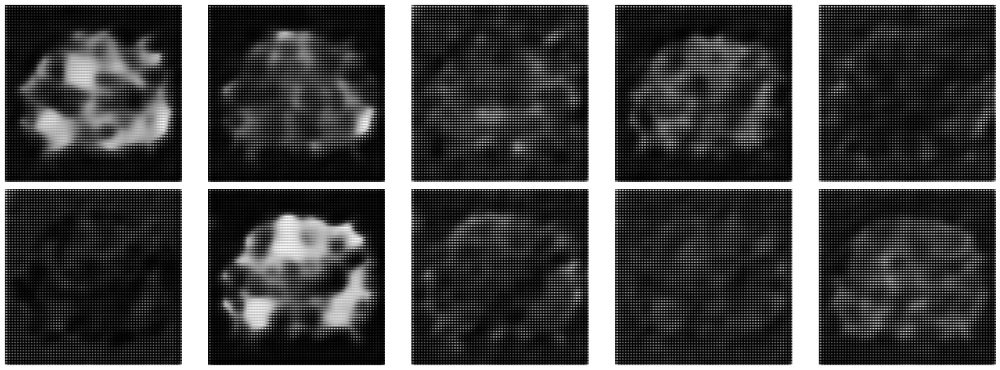

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<08:12,  7.62it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 2/3750 [00:00<07:12,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 3/3750 [00:00<06:52,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<07:28,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<07:20,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 6/3750 [00:00<07:11,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 7/3750 [00:00<06:56,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 8/3750 [00:00<06:45,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 9/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 10/3750 [00:01<06:47,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 11/3750 [00:01<06:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 12/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 13/3750 [00:01<06:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 14/3750 [00:01<06:32,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<06:42,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:01<06:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 18/3750 [00:01<06:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 20/3750 [00:02<06:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 21/3750 [00:02<06:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 22/3750 [00:02<06:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<07:32,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 24/3750 [00:02<07:23,  8.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 25/3750 [00:02<07:05,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 26/3750 [00:02<06:53,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 27/3750 [00:02<06:43,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:03<06:44,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 29/3750 [00:03<06:46,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 30/3750 [00:03<06:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 31/3750 [00:03<06:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 32/3750 [00:03<06:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 33/3750 [00:03<06:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:39,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 35/3750 [00:03<06:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 36/3750 [00:03<06:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 37/3750 [00:04<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 38/3750 [00:04<06:40,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 39/3750 [00:04<06:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 40/3750 [00:04<06:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 41/3750 [00:04<06:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 42/3750 [00:04<06:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 43/3750 [00:04<06:41,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 44/3750 [00:04<06:35,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 45/3750 [00:04<06:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 46/3750 [00:04<06:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 47/3750 [00:05<06:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 48/3750 [00:05<06:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 49/3750 [00:05<06:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 50/3750 [00:05<06:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 51/3750 [00:05<06:28,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 52/3750 [00:05<06:45,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 53/3750 [00:05<06:42,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 54/3750 [00:05<06:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:05<06:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:06<06:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▌                                        | 57/3750 [00:06<06:39,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 58/3750 [00:06<06:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 59/3750 [00:06<06:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 60/3750 [00:06<06:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 61/3750 [00:06<06:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 64/3750 [00:06<06:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 65/3750 [00:07<06:24,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 66/3750 [00:07<06:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 67/3750 [00:07<06:35,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 68/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 69/3750 [00:07<06:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 70/3750 [00:07<06:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:07<06:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 72/3750 [00:07<06:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 73/3750 [00:07<06:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 74/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 75/3750 [00:08<06:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 76/3750 [00:08<06:38,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 77/3750 [00:08<06:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 78/3750 [00:08<06:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:08<06:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 80/3750 [00:08<06:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 81/3750 [00:08<06:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 82/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 83/3750 [00:08<06:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 84/3750 [00:09<06:22,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 85/3750 [00:09<06:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 86/3750 [00:09<06:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 87/3750 [00:09<06:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:09<06:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:09<06:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 90/3750 [00:09<06:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 91/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 93/3750 [00:09<06:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 95/3750 [00:10<06:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 96/3750 [00:10<06:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:10<06:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:10<06:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:10<06:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:10<06:34,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 101/3750 [00:10<06:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 102/3750 [00:10<06:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 103/3750 [00:11<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:11<06:34,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:11<06:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:40,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 107/3750 [00:11<06:34,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 108/3750 [00:11<06:42,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 109/3750 [00:11<06:38,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:11<06:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:11<06:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:12<06:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<06:38,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:12<06:34,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<06:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 116/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 117/3750 [00:12<06:26,  9.40it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▎                                      | 118/3750 [00:12<06:51,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:12<06:45,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 120/3750 [00:12<06:38,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 121/3750 [00:13<06:34,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 122/3750 [00:13<06:43,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:13<06:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:35,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 125/3750 [00:13<06:46,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 126/3750 [00:13<06:44,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 127/3750 [00:13<06:42,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:13<06:34,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 129/3750 [00:13<06:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 130/3750 [00:13<06:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 131/3750 [00:14<06:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:14<06:33,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 133/3750 [00:14<06:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 134/3750 [00:14<06:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 135/3750 [00:14<06:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 136/3750 [00:14<06:31,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 137/3750 [00:14<06:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 138/3750 [00:14<06:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 139/3750 [00:14<06:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 140/3750 [00:15<06:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 141/3750 [00:15<06:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 142/3750 [00:15<06:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 143/3750 [00:15<06:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:15<06:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 145/3750 [00:15<06:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 146/3750 [00:15<06:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 147/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 148/3750 [00:15<06:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 149/3750 [00:16<06:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 150/3750 [00:16<06:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 151/3750 [00:16<06:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:16<06:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:16<06:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:16<06:18,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 155/3750 [00:16<06:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 156/3750 [00:16<06:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:16<06:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 158/3750 [00:16<06:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 159/3750 [00:17<06:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 160/3750 [00:17<06:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:17<06:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 162/3750 [00:17<06:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:17<06:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 164/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 165/3750 [00:17<06:29,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:17<06:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:17<06:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 168/3750 [00:18<06:15,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 169/3750 [00:18<06:32,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:18<06:26,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:18<06:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 172/3750 [00:18<06:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 173/3750 [00:18<06:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 174/3750 [00:18<06:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:18<06:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 176/3750 [00:18<06:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 177/3750 [00:18<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 178/3750 [00:19<06:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 179/3750 [00:19<06:25,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:19<06:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 181/3750 [00:19<06:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 182/3750 [00:19<06:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 183/3750 [00:19<06:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:19<06:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:19<06:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 186/3750 [00:19<06:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 187/3750 [00:20<06:14,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 188/3750 [00:20<06:24,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 189/3750 [00:20<06:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:20<06:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 191/3750 [00:20<06:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:20<06:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 193/3750 [00:20<06:23,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:20<06:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:20<06:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 196/3750 [00:20<06:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 197/3750 [00:21<06:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 198/3750 [00:21<06:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:21<06:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:21<06:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:21<06:12,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 202/3750 [00:21<06:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:21<06:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 204/3750 [00:21<06:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 205/3750 [00:21<06:09,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:22<06:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:22<06:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 208/3750 [00:22<06:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 209/3750 [00:22<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 210/3750 [00:22<06:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:22<06:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:22<06:27,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 213/3750 [00:22<06:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 214/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 215/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 216/3750 [00:23<06:24,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 217/3750 [00:23<06:18,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 218/3750 [00:23<06:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 219/3750 [00:23<06:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:23<06:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 221/3750 [00:23<06:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:23<06:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:23<06:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 224/3750 [00:23<06:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 225/3750 [00:24<06:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 226/3750 [00:24<06:20,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 227/3750 [00:24<06:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 228/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 229/3750 [00:24<06:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 230/3750 [00:24<06:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 231/3750 [00:24<06:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:24<06:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 234/3750 [00:25<06:08,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:25<06:20,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 236/3750 [00:25<06:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 237/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 238/3750 [00:25<06:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 239/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:25<06:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 241/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 242/3750 [00:25<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 243/3750 [00:25<06:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 244/3750 [00:26<06:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 245/3750 [00:26<06:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 246/3750 [00:26<06:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 249/3750 [00:26<06:19,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 250/3750 [00:26<06:15,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 251/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 252/3750 [00:26<06:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 253/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 254/3750 [00:27<06:18,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:27<06:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 256/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 257/3750 [00:27<06:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 258/3750 [00:27<06:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 259/3750 [00:27<06:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 260/3750 [00:27<06:36,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 261/3750 [00:27<06:26,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 262/3750 [00:28<06:24,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 263/3750 [00:28<06:30,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 264/3750 [00:28<06:21,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 265/3750 [00:28<06:18,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 266/3750 [00:28<06:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 267/3750 [00:28<06:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:28<06:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 269/3750 [00:28<06:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 270/3750 [00:28<06:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 271/3750 [00:29<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:29<06:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 273/3750 [00:29<06:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 274/3750 [00:29<06:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:29<06:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 277/3750 [00:29<06:15,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 278/3750 [00:29<06:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 279/3750 [00:29<06:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 280/3750 [00:29<06:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 281/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:30<06:15,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 283/3750 [00:30<06:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 284/3750 [00:30<06:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 285/3750 [00:30<06:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 286/3750 [00:30<06:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 288/3750 [00:30<06:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 289/3750 [00:30<06:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 290/3750 [00:31<06:05,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 291/3750 [00:31<06:23,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 292/3750 [00:31<06:23,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:31<06:16,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 294/3750 [00:31<06:16,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:31<06:17,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 296/3750 [00:31<06:16,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 297/3750 [00:31<06:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:31<06:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 299/3750 [00:32<06:13,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:32<06:19,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 301/3750 [00:32<06:16,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 302/3750 [00:32<06:09,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 303/3750 [00:32<06:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 304/3750 [00:32<06:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 305/3750 [00:32<06:12,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:32<06:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 307/3750 [00:32<06:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:32<06:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 309/3750 [00:33<06:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 310/3750 [00:33<06:17,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:33<06:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 312/3750 [00:33<06:16,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 313/3750 [00:33<06:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:33<06:20,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:33<06:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 316/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 317/3750 [00:33<06:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 318/3750 [00:34<06:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 319/3750 [00:34<06:11,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:34<06:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 321/3750 [00:34<06:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 322/3750 [00:34<06:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 323/3750 [00:34<06:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 324/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 325/3750 [00:34<06:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 326/3750 [00:34<06:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 327/3750 [00:35<05:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 328/3750 [00:35<06:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:35<06:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 330/3750 [00:35<06:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 331/3750 [00:35<05:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 332/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 333/3750 [00:35<06:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 334/3750 [00:35<06:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 335/3750 [00:35<05:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 336/3750 [00:35<05:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 337/3750 [00:36<06:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 338/3750 [00:36<06:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 339/3750 [00:36<06:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 340/3750 [00:36<06:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 341/3750 [00:36<06:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:36<06:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 343/3750 [00:36<06:08,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:36<06:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 345/3750 [00:36<05:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 346/3750 [00:37<05:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 347/3750 [00:37<06:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:37<06:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:37<05:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:37<05:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:37<05:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 352/3750 [00:37<06:05,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 353/3750 [00:37<06:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 354/3750 [00:37<05:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 355/3750 [00:37<05:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 356/3750 [00:38<05:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 357/3750 [00:38<06:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 358/3750 [00:38<05:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 359/3750 [00:38<05:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 360/3750 [00:38<05:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 361/3750 [00:38<06:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 362/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 363/3750 [00:38<05:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 364/3750 [00:38<05:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 365/3750 [00:39<05:52,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 366/3750 [00:39<06:05,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 368/3750 [00:39<05:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 369/3750 [00:39<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 370/3750 [00:39<05:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 371/3750 [00:39<06:04,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:39<05:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 373/3750 [00:39<05:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:39<05:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 375/3750 [00:40<06:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:40<06:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 377/3750 [00:40<05:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 378/3750 [00:40<05:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 379/3750 [00:40<05:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 380/3750 [00:40<06:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 381/3750 [00:40<05:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 382/3750 [00:40<05:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 383/3750 [00:40<05:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 384/3750 [00:41<05:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 385/3750 [00:41<06:04,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 386/3750 [00:41<05:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 387/3750 [00:41<05:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 388/3750 [00:41<05:51,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:41<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 390/3750 [00:41<06:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 391/3750 [00:41<05:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 392/3750 [00:41<05:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 393/3750 [00:42<06:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 394/3750 [00:42<07:24,  7.55it/s]

1/1 [==============================] - 0s 12ms/step


 11%|████▏                                   | 395/3750 [00:42<07:32,  7.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 396/3750 [00:42<07:03,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 397/3750 [00:42<06:51,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 398/3750 [00:42<06:40,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:42<06:24,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:42<06:12,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 401/3750 [00:42<06:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 402/3750 [00:43<06:07,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 403/3750 [00:43<06:09,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 404/3750 [00:43<06:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 406/3750 [00:43<05:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 407/3750 [00:43<06:04,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 408/3750 [00:43<05:59,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:43<05:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:43<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 411/3750 [00:44<05:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 412/3750 [00:44<05:58,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 413/3750 [00:44<05:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 414/3750 [00:44<05:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 415/3750 [00:44<05:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:44<05:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 417/3750 [00:44<05:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 418/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 419/3750 [00:44<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 420/3750 [00:45<05:50,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 421/3750 [00:45<05:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:45<05:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 423/3750 [00:45<05:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 424/3750 [00:45<05:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 425/3750 [00:45<05:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:45<05:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 427/3750 [00:45<05:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:45<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:45<05:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 430/3750 [00:46<05:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:46<05:58,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 432/3750 [00:46<05:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 433/3750 [00:46<05:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:46<05:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:46<05:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 436/3750 [00:46<05:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 437/3750 [00:46<05:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 438/3750 [00:46<06:00,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 439/3750 [00:47<05:58,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 440/3750 [00:47<06:06,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:47<05:58,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:47<05:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:47<05:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:47<05:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 445/3750 [00:47<05:59,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 446/3750 [00:47<05:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:47<05:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 449/3750 [00:48<05:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 450/3750 [00:48<05:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:48<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 452/3750 [00:48<05:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 453/3750 [00:48<05:48,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 454/3750 [00:48<05:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:48<05:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 456/3750 [00:48<05:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 457/3750 [00:48<05:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 458/3750 [00:49<05:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 459/3750 [00:49<05:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 460/3750 [00:49<05:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:49<05:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:49<05:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:49<05:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 464/3750 [00:49<05:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 465/3750 [00:49<05:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 466/3750 [00:49<05:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 467/3750 [00:50<05:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 468/3750 [00:50<05:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:50<05:52,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:50<05:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:50<05:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 473/3750 [00:50<05:54,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:50<05:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 475/3750 [00:50<05:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 476/3750 [00:50<05:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:51<05:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:51<05:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 479/3750 [00:51<05:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:51<05:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:51<05:40,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 482/3750 [00:51<05:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 483/3750 [00:51<05:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 484/3750 [00:51<05:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 485/3750 [00:51<05:41,  9.56it/s]

1/1 [==============================] - 0s 12ms/step


 13%|█████▏                                  | 486/3750 [00:52<05:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 487/3750 [00:52<05:59,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 488/3750 [00:52<05:56,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 489/3750 [00:52<05:51,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 490/3750 [00:52<05:56,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 491/3750 [00:52<06:01,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:52<05:56,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 493/3750 [00:52<05:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 494/3750 [00:52<05:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 495/3750 [00:53<05:41,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 496/3750 [00:53<05:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 497/3750 [00:53<05:51,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 498/3750 [00:53<05:46,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 499/3750 [00:53<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:53<05:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 501/3750 [00:53<05:53,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 502/3750 [00:53<05:48,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 504/3750 [00:53<05:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:54<05:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:54<05:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:54<05:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 508/3750 [00:54<05:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 509/3750 [00:54<05:47,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:54<05:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 511/3750 [00:54<05:53,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 512/3750 [00:54<05:51,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:54<05:51,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 514/3750 [00:55<05:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:55<05:56,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 516/3750 [00:55<05:50,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:55<05:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 518/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 519/3750 [00:55<06:24,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 520/3750 [00:55<06:15,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 521/3750 [00:55<06:06,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [00:55<06:00,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▌                                  | 523/3750 [00:56<06:06,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 524/3750 [00:56<06:06,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 525/3750 [00:56<05:57,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 526/3750 [00:56<05:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 527/3750 [00:56<05:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 528/3750 [00:56<05:53,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 529/3750 [00:56<05:51,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:56<05:44,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:56<05:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 532/3750 [00:57<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [00:57<05:49,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 534/3750 [00:57<05:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 535/3750 [00:57<05:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [00:57<05:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [00:57<05:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 538/3750 [00:57<05:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 539/3750 [00:57<05:47,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 540/3750 [00:57<05:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 541/3750 [00:57<05:37,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 542/3750 [00:58<05:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 543/3750 [00:58<05:46,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 544/3750 [00:58<05:41,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 545/3750 [00:58<05:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 546/3750 [00:58<05:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [00:58<05:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 548/3750 [00:58<05:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 549/3750 [00:58<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 550/3750 [00:58<05:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [00:59<05:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 552/3750 [00:59<05:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 553/3750 [00:59<05:55,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 554/3750 [00:59<05:51,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [00:59<05:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 556/3750 [00:59<05:49,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 557/3750 [00:59<05:46,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [00:59<05:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 559/3750 [00:59<05:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 560/3750 [01:00<05:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:00<05:47,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 562/3750 [01:00<05:42,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 563/3750 [01:00<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 564/3750 [01:00<05:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 565/3750 [01:00<05:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 566/3750 [01:00<05:44,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 567/3750 [01:00<05:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 568/3750 [01:00<05:38,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 569/3750 [01:00<05:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 570/3750 [01:01<05:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 571/3750 [01:01<08:37,  6.15it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 572/3750 [01:01<07:39,  6.92it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 573/3750 [01:01<07:11,  7.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:01<06:43,  7.87it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 575/3750 [01:01<06:20,  8.34it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 576/3750 [01:01<06:03,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 577/3750 [01:02<05:55,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 578/3750 [01:02<05:58,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 579/3750 [01:02<05:55,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 580/3750 [01:02<05:46,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:02<05:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 582/3750 [01:02<05:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:02<05:45,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 584/3750 [01:02<05:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 585/3750 [01:02<05:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 586/3750 [01:02<05:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 587/3750 [01:03<05:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 588/3750 [01:03<05:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 589/3750 [01:03<05:37,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 590/3750 [01:03<05:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 591/3750 [01:03<05:38,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 592/3750 [01:03<05:47,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:03<05:41,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 594/3750 [01:03<05:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 595/3750 [01:03<05:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 596/3750 [01:04<05:46,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 597/3750 [01:04<05:48,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:04<05:43,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 599/3750 [01:04<05:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 600/3750 [01:04<05:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 601/3750 [01:04<05:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 602/3750 [01:04<05:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 603/3750 [01:04<05:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 604/3750 [01:04<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 605/3750 [01:05<05:34,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 606/3750 [01:05<05:45,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 607/3750 [01:05<05:39,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 608/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 609/3750 [01:05<05:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 610/3750 [01:05<05:39,  9.26it/s]

1/1 [==============================] - 0s 13ms/step


 16%|██████▌                                 | 611/3750 [01:05<05:44,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 612/3750 [01:05<05:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:05<05:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 615/3750 [01:06<05:42,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:06<05:39,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 617/3750 [01:06<05:34,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 618/3750 [01:06<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 619/3750 [01:06<05:32,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▌                                 | 620/3750 [01:06<05:39,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 621/3750 [01:06<05:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 622/3750 [01:06<05:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 623/3750 [01:06<05:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 624/3750 [01:07<05:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 625/3750 [01:07<05:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 626/3750 [01:07<05:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 627/3750 [01:07<05:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 628/3750 [01:07<05:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 629/3750 [01:07<05:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:07<05:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 631/3750 [01:07<05:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 632/3750 [01:07<05:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 633/3750 [01:08<05:29,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 634/3750 [01:08<05:39,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 635/3750 [01:08<05:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 636/3750 [01:08<05:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 637/3750 [01:08<05:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 638/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 639/3750 [01:08<05:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 640/3750 [01:08<05:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 641/3750 [01:08<05:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 642/3750 [01:08<05:24,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:09<05:40,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 644/3750 [01:09<05:37,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 645/3750 [01:09<05:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 646/3750 [01:09<05:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 647/3750 [01:09<05:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 648/3750 [01:09<05:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 649/3750 [01:09<05:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 650/3750 [01:09<05:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 651/3750 [01:09<05:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 652/3750 [01:10<05:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:10<05:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:10<05:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 655/3750 [01:10<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 656/3750 [01:10<05:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 657/3750 [01:10<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 658/3750 [01:10<05:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:10<05:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 660/3750 [01:10<05:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:11<05:24,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 662/3750 [01:11<05:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 663/3750 [01:11<05:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 664/3750 [01:11<05:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 665/3750 [01:11<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 666/3750 [01:11<05:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 667/3750 [01:11<05:52,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 668/3750 [01:11<05:44,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 669/3750 [01:11<05:37,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 670/3750 [01:11<05:33,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 671/3750 [01:12<05:36,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:12<05:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 673/3750 [01:12<05:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 674/3750 [01:12<05:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 675/3750 [01:12<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:12<05:34,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 677/3750 [01:12<05:28,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 678/3750 [01:12<05:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 679/3750 [01:12<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 680/3750 [01:13<05:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 681/3750 [01:13<05:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 682/3750 [01:13<05:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 683/3750 [01:13<05:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 684/3750 [01:13<05:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 685/3750 [01:13<05:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 686/3750 [01:13<05:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 687/3750 [01:13<05:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 688/3750 [01:13<05:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 689/3750 [01:14<05:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 690/3750 [01:14<05:33,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 691/3750 [01:14<05:29,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 692/3750 [01:14<05:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 693/3750 [01:14<05:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 694/3750 [01:14<05:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 695/3750 [01:14<05:31,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 696/3750 [01:14<05:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 697/3750 [01:14<05:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:14<05:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 699/3750 [01:15<05:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:15<05:33,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 701/3750 [01:15<05:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 702/3750 [01:15<05:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 703/3750 [01:15<05:20,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:15<05:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:15<05:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 706/3750 [01:15<05:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:15<05:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 708/3750 [01:16<05:21,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:16<05:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 710/3750 [01:16<05:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 711/3750 [01:16<05:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:16<05:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:16<05:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 714/3750 [01:16<05:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:16<05:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:16<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:16<05:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:17<05:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:17<05:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 720/3750 [01:17<05:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 721/3750 [01:17<05:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 722/3750 [01:17<05:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:17<05:25,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 724/3750 [01:17<05:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:17<05:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 726/3750 [01:17<05:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 727/3750 [01:18<05:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:18<05:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:18<05:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 730/3750 [01:18<05:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 731/3750 [01:18<05:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:18<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 733/3750 [01:18<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 734/3750 [01:18<05:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 735/3750 [01:18<05:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 736/3750 [01:19<05:15,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 737/3750 [01:19<05:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:19<05:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 739/3750 [01:19<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 740/3750 [01:19<05:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 741/3750 [01:19<05:15,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:19<05:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 743/3750 [01:19<05:26,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 744/3750 [01:19<05:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 745/3750 [01:19<05:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 746/3750 [01:20<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:20<05:22,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 748/3750 [01:20<05:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 749/3750 [01:20<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 750/3750 [01:20<05:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 751/3750 [01:20<05:19,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 752/3750 [01:20<05:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 753/3750 [01:20<05:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:20<05:22,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 755/3750 [01:21<05:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:21<05:29,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 757/3750 [01:21<05:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:21<05:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 759/3750 [01:21<05:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:21<05:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:21<05:23,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:21<05:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:21<05:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:21<05:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 765/3750 [01:22<05:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:22<05:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:22<05:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:22<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:22<05:13,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 770/3750 [01:22<05:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 771/3750 [01:22<05:21,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 772/3750 [01:22<05:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 773/3750 [01:22<05:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 774/3750 [01:23<05:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 775/3750 [01:23<05:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 776/3750 [01:23<05:16,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 777/3750 [01:23<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 778/3750 [01:23<05:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 779/3750 [01:23<05:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:23<05:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 781/3750 [01:23<05:21,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 782/3750 [01:23<05:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 783/3750 [01:24<05:16,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 784/3750 [01:24<05:23,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:24<05:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 786/3750 [01:24<05:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 787/3750 [01:24<05:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 788/3750 [01:24<05:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 789/3750 [01:24<05:19,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 790/3750 [01:24<05:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 791/3750 [01:24<05:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 792/3750 [01:24<05:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 793/3750 [01:25<05:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 794/3750 [01:25<05:16,  9.33it/s]

1/1 [==============================] - 0s 41ms/step


 21%|████████▍                               | 795/3750 [01:25<05:48,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 796/3750 [01:25<05:44,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:25<05:43,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 798/3750 [01:25<05:37,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 799/3750 [01:25<05:29,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 800/3750 [01:25<05:23,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 801/3750 [01:25<05:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 802/3750 [01:26<05:24,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:26<05:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 804/3750 [01:26<05:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:26<05:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 806/3750 [01:26<05:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 807/3750 [01:26<05:19,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 808/3750 [01:26<05:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 809/3750 [01:26<05:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:26<05:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 811/3750 [01:27<05:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 812/3750 [01:27<05:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 813/3750 [01:27<05:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:27<05:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 815/3750 [01:27<05:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 816/3750 [01:27<05:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 817/3750 [01:27<05:17,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 818/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 819/3750 [01:27<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 820/3750 [01:28<05:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:28<05:17,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 822/3750 [01:28<05:13,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 823/3750 [01:28<05:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 824/3750 [01:28<05:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 825/3750 [01:28<05:10,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 826/3750 [01:28<05:18,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 827/3750 [01:28<05:12,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:28<05:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:28<05:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 830/3750 [01:29<05:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 831/3750 [01:29<05:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 832/3750 [01:29<05:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 833/3750 [01:29<05:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:29<05:03,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 835/3750 [01:29<05:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 836/3750 [01:29<05:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 837/3750 [01:29<05:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:29<05:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 839/3750 [01:30<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:30<05:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:30<05:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 842/3750 [01:30<05:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 843/3750 [01:30<05:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 844/3750 [01:30<05:10,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 845/3750 [01:30<05:16,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 846/3750 [01:30<05:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 847/3750 [01:30<05:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 848/3750 [01:30<05:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 849/3750 [01:31<05:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:31<05:10,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 851/3750 [01:31<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 852/3750 [01:31<05:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 853/3750 [01:31<05:08,  9.39it/s]

1/1 [==============================] - 0s 12ms/step


 23%|█████████                               | 854/3750 [01:31<06:20,  7.60it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 855/3750 [01:31<06:13,  7.75it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▏                              | 856/3750 [01:31<06:07,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 857/3750 [01:32<05:58,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:32<05:45,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 859/3750 [01:32<05:31,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 860/3750 [01:32<05:22,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:32<05:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 862/3750 [01:32<05:20,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:32<05:17,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:32<05:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:32<05:58,  8.04it/s]

1/1 [==============================] - 0s 12ms/step


 23%|█████████▏                              | 866/3750 [01:33<06:36,  7.28it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 867/3750 [01:33<06:14,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 868/3750 [01:33<05:53,  8.16it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:33<05:36,  8.55it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:33<05:34,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 871/3750 [01:33<05:26,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:33<05:22,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 873/3750 [01:33<05:22,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 874/3750 [01:34<05:19,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 875/3750 [01:34<05:23,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:34<05:15,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 877/3750 [01:34<05:10,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 878/3750 [01:34<05:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 879/3750 [01:34<05:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 880/3750 [01:34<05:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 881/3750 [01:34<05:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 882/3750 [01:34<05:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 883/3750 [01:34<05:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 884/3750 [01:35<05:09,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:35<05:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 886/3750 [01:35<05:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 887/3750 [01:35<05:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 888/3750 [01:35<05:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 889/3750 [01:35<05:09,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 890/3750 [01:35<05:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 891/3750 [01:35<05:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:35<05:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:36<05:08,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 894/3750 [01:36<05:13,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 895/3750 [01:36<05:08,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 896/3750 [01:36<05:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 897/3750 [01:36<05:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 898/3750 [01:36<05:14,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:36<05:12,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 900/3750 [01:36<05:09,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 901/3750 [01:36<05:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 902/3750 [01:37<05:03,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 903/3750 [01:37<05:13,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 904/3750 [01:37<05:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 905/3750 [01:37<05:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:37<04:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 907/3750 [01:37<05:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 908/3750 [01:37<05:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 909/3750 [01:37<05:01,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:37<05:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 911/3750 [01:38<05:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:38<05:08,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 913/3750 [01:38<05:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 914/3750 [01:38<05:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:38<04:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 916/3750 [01:38<05:02,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 917/3750 [01:38<05:16,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 918/3750 [01:38<05:16,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 919/3750 [01:38<05:26,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 920/3750 [01:39<05:19,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 921/3750 [01:39<05:22,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 922/3750 [01:39<05:18,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 923/3750 [01:39<05:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 924/3750 [01:39<05:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 925/3750 [01:39<05:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 926/3750 [01:39<05:09,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:39<05:06,  9.22it/s]

1/1 [==============================] - 0s 16ms/step


 25%|█████████▉                              | 928/3750 [01:39<05:24,  8.70it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 929/3750 [01:40<05:28,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:40<05:44,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:40<05:33,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:40<05:22,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:40<05:27,  8.60it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 934/3750 [01:40<05:26,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 935/3750 [01:40<05:17,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 936/3750 [01:40<05:14,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 937/3750 [01:40<05:35,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 938/3750 [01:41<05:32,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 939/3750 [01:41<05:20,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 940/3750 [01:41<05:14,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 941/3750 [01:41<05:08,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 942/3750 [01:41<05:12,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 943/3750 [01:41<05:06,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 944/3750 [01:41<05:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 945/3750 [01:41<04:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:41<05:02,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 947/3750 [01:42<05:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:42<05:12,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 949/3750 [01:42<05:11,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 950/3750 [01:42<05:14,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 951/3750 [01:42<05:19,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 952/3750 [01:42<05:16,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 953/3750 [01:42<05:10,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 954/3750 [01:42<05:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 955/3750 [01:42<05:09,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:43<05:14,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 957/3750 [01:43<05:11,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 958/3750 [01:43<05:16,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 959/3750 [01:43<05:15,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 960/3750 [01:43<05:26,  8.53it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 961/3750 [01:43<05:25,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 962/3750 [01:43<05:16,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 963/3750 [01:43<05:08,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 964/3750 [01:43<05:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:44<05:02,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 966/3750 [01:44<05:11,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 967/3750 [01:44<05:06,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 968/3750 [01:44<05:09,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 969/3750 [01:44<05:18,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 970/3750 [01:44<05:14,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 971/3750 [01:44<05:06,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:44<05:04,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 973/3750 [01:44<05:13,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 974/3750 [01:45<05:15,  8.79it/s]

1/1 [==============================] - 0s 14ms/step


 26%|██████████▍                             | 975/3750 [01:45<05:31,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 976/3750 [01:45<05:27,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 977/3750 [01:45<05:19,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:45<05:12,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▍                             | 979/3750 [01:45<05:17,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 980/3750 [01:45<05:14,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 981/3750 [01:45<05:10,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 982/3750 [01:45<05:06,  9.02it/s]

1/1 [==============================] - 0s 14ms/step


 26%|██████████▍                             | 983/3750 [01:46<05:53,  7.82it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 984/3750 [01:46<05:36,  8.22it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:46<05:31,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 986/3750 [01:46<05:27,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 987/3750 [01:46<05:30,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 988/3750 [01:46<05:28,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 989/3750 [01:46<05:22,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 990/3750 [01:46<05:16,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 991/3750 [01:47<05:10,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 992/3750 [01:47<05:03,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 993/3750 [01:47<05:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 994/3750 [01:47<04:59,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 995/3750 [01:47<04:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:47<04:56,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                             | 997/3750 [01:47<05:02,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 998/3750 [01:47<05:07,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 999/3750 [01:47<05:10,  8.86it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▍                            | 1000/3750 [01:48<05:14,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1001/3750 [01:48<05:15,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:48<05:18,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1003/3750 [01:48<05:29,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1004/3750 [01:48<05:46,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1005/3750 [01:48<05:52,  7.79it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▍                            | 1006/3750 [01:48<06:10,  7.40it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1007/3750 [01:48<06:10,  7.40it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▍                            | 1008/3750 [01:49<06:08,  7.43it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1009/3750 [01:49<06:14,  7.33it/s]

1/1 [==============================] - 0s 12ms/step


 27%|██████████▌                            | 1010/3750 [01:49<06:20,  7.21it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▌                            | 1011/3750 [01:49<06:22,  7.17it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1012/3750 [01:49<06:14,  7.31it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██████████▌                            | 1013/3750 [01:49<06:16,  7.27it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1014/3750 [01:49<06:03,  7.54it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1015/3750 [01:50<05:56,  7.67it/s]

1/1 [==============================] - 0s 13ms/step


 27%|██████████▌                            | 1016/3750 [01:50<05:46,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1017/3750 [01:50<05:57,  7.65it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1018/3750 [01:50<05:45,  7.90it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▌                            | 1019/3750 [01:50<05:38,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1020/3750 [01:50<05:31,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1021/3750 [01:50<05:21,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1022/3750 [01:50<05:41,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1023/3750 [01:51<05:35,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1024/3750 [01:51<05:36,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1025/3750 [01:51<05:27,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1026/3750 [01:51<05:19,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1027/3750 [01:51<05:13,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:51<05:04,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:51<04:58,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1030/3750 [01:51<04:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:51<04:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [01:52<04:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [01:52<04:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:52<04:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1035/3750 [01:52<04:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [01:52<04:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [01:52<04:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:52<04:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [01:52<04:40,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1040/3750 [01:52<04:41,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1041/3750 [01:52<04:43,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:53<04:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1043/3750 [01:53<04:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1044/3750 [01:53<04:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:53<04:48,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████▉                            | 1046/3750 [01:53<05:02,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1047/3750 [01:53<05:12,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1048/3750 [01:53<05:17,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1049/3750 [01:53<05:13,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [01:53<05:03,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1051/3750 [01:54<04:57,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1052/3750 [01:54<04:54,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1053/3750 [01:54<04:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:54<04:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:54<04:43,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1056/3750 [01:54<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1057/3750 [01:54<04:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1058/3750 [01:54<04:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1059/3750 [01:54<04:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1060/3750 [01:55<04:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:55<05:05,  8.80it/s]

1/1 [==============================] - 0s 11ms/step


 28%|███████████                            | 1062/3750 [01:55<05:14,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1063/3750 [01:55<05:19,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1064/3750 [01:55<05:23,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1065/3750 [01:55<05:28,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1066/3750 [01:55<05:29,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1067/3750 [01:55<05:29,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1068/3750 [01:56<05:27,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████                            | 1069/3750 [01:56<05:30,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▏                           | 1070/3750 [01:56<05:21,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:56<05:11,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1072/3750 [01:56<05:01,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1073/3750 [01:56<04:53,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [01:56<04:47,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [01:56<04:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:56<04:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [01:56<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:57<04:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [01:57<04:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1080/3750 [01:57<04:35,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [01:57<04:34,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:57<04:34,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:57<04:34,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1084/3750 [01:57<04:33,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [01:57<04:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1086/3750 [01:57<04:37,  9.60it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1087/3750 [01:58<04:42,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1088/3750 [01:58<04:40,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1089/3750 [01:58<04:53,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1090/3750 [01:58<04:49,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1091/3750 [01:58<04:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:58<04:48,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1093/3750 [01:58<04:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1094/3750 [01:58<04:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1095/3750 [01:58<04:49,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1096/3750 [01:58<04:45,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1097/3750 [01:59<04:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1098/3750 [01:59<04:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1099/3750 [01:59<04:38,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [01:59<04:40,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1101/3750 [01:59<04:52,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1102/3750 [01:59<04:57,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1103/3750 [01:59<05:11,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▍                           | 1104/3750 [01:59<05:18,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▍                           | 1105/3750 [02:00<05:20,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▌                           | 1106/3750 [02:00<05:19,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1107/3750 [02:00<05:20,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1108/3750 [02:00<05:21,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1109/3750 [02:00<05:15,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [02:00<05:04,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1111/3750 [02:00<04:55,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1112/3750 [02:00<04:48,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1113/3750 [02:00<04:44,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [02:01<04:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1115/3750 [02:01<04:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [02:01<04:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1117/3750 [02:01<04:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [02:01<04:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1119/3750 [02:01<04:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1120/3750 [02:01<04:31,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1121/3750 [02:01<04:30,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [02:01<04:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1123/3750 [02:01<04:32,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1124/3750 [02:02<04:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1125/3750 [02:02<04:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [02:02<04:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [02:02<04:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1128/3750 [02:02<04:30,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1129/3750 [02:02<04:43,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1130/3750 [02:02<04:44,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [02:02<04:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:02<04:43,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [02:03<04:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:03<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1135/3750 [02:03<04:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1136/3750 [02:03<04:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1137/3750 [02:03<04:35,  9.48it/s]

1/1 [==============================] - 0s 14ms/step


 30%|███████████▊                           | 1138/3750 [02:03<04:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1139/3750 [02:03<04:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1140/3750 [02:03<04:36,  9.43it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███████████▊                           | 1141/3750 [02:03<05:07,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▉                           | 1142/3750 [02:04<05:08,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▉                           | 1143/3750 [02:04<05:10,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1144/3750 [02:04<05:02,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1145/3750 [02:04<04:56,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1146/3750 [02:04<04:48,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1147/3750 [02:04<04:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:04<04:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1149/3750 [02:04<04:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1150/3750 [02:04<04:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1151/3750 [02:04<04:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1152/3750 [02:05<04:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1153/3750 [02:05<04:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1154/3750 [02:05<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:05<04:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1156/3750 [02:05<04:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:05<04:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:05<04:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:05<04:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:05<04:28,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1161/3750 [02:06<04:27,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1162/3750 [02:06<04:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:06<04:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1164/3750 [02:06<04:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:06<04:24,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:06<04:23,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1167/3750 [02:06<04:23,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1168/3750 [02:06<04:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1169/3750 [02:06<04:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1170/3750 [02:06<04:24,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1171/3750 [02:07<04:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1172/3750 [02:07<04:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1173/3750 [02:07<04:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:07<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1175/3750 [02:07<04:30,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1176/3750 [02:07<04:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1177/3750 [02:07<04:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1178/3750 [02:07<04:30,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1179/3750 [02:07<04:40,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1180/3750 [02:08<04:46,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1181/3750 [02:08<04:49,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1182/3750 [02:08<04:53,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1183/3750 [02:08<04:50,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1184/3750 [02:08<04:44,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:08<04:41,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:08<04:36,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1187/3750 [02:08<04:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:08<04:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1189/3750 [02:09<04:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:09<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:09<04:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1192/3750 [02:09<04:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:09<04:24,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1194/3750 [02:09<04:24,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1195/3750 [02:09<04:23,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1196/3750 [02:09<04:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1197/3750 [02:09<04:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1198/3750 [02:09<04:23,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1199/3750 [02:10<04:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:10<04:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:10<04:22,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1202/3750 [02:10<04:23,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:10<04:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:10<04:25,  9.60it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1205/3750 [02:10<04:32,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▌                          | 1206/3750 [02:10<05:05,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1207/3750 [02:10<05:04,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:11<04:55,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:11<04:47,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:11<04:40,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:11<04:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:11<04:34,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1213/3750 [02:11<04:42,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▋                          | 1214/3750 [02:11<04:49,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:11<04:42,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1216/3750 [02:11<04:40,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▋                          | 1217/3750 [02:12<04:40,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:12<04:36,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:12<04:33,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1220/3750 [02:12<04:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:12<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:12<04:24,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1223/3750 [02:12<04:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1224/3750 [02:12<04:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:12<04:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:12<04:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1227/3750 [02:13<04:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:13<04:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:13<04:19,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1230/3750 [02:13<04:18,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1231/3750 [02:13<04:18,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1232/3750 [02:13<04:18,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1233/3750 [02:13<04:19,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:13<04:19,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:13<04:19,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:14<04:19,  9.69it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1237/3750 [02:14<04:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1238/3750 [02:14<04:26,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


 33%|████████████▉                          | 1239/3750 [02:14<04:39,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1240/3750 [02:14<04:45,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:14<04:52,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1242/3750 [02:14<04:55,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1243/3750 [02:14<04:51,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:14<04:42,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1245/3750 [02:15<04:35,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1246/3750 [02:15<04:30,  9.25it/s]

1/1 [==============================] - 0s 7ms/step


 33%|████████████▉                          | 1247/3750 [02:15<04:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1248/3750 [02:15<04:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1249/3750 [02:15<04:21,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1250/3750 [02:15<04:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1251/3750 [02:15<04:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:15<04:28,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:15<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:15<04:33,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:16<04:39,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:16<04:52,  8.54it/s]

1/1 [==============================] - 0s 11ms/step


 34%|█████████████                          | 1257/3750 [02:16<04:54,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1258/3750 [02:16<04:52,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:16<04:43,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1260/3750 [02:16<04:38,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1261/3750 [02:16<04:34,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:16<04:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1263/3750 [02:17<04:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:17<04:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:17<04:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1266/3750 [02:17<04:38,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1267/3750 [02:17<04:38,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1268/3750 [02:17<04:32,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:17<04:30,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▏                         | 1270/3750 [02:17<04:32,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▏                         | 1271/3750 [02:17<04:31,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:17<04:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:18<04:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:18<04:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:18<04:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:18<04:29,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1277/3750 [02:18<04:39,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1278/3750 [02:18<04:42,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:18<04:36,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1280/3750 [02:18<04:29,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:18<04:28,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1282/3750 [02:19<04:26,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1283/3750 [02:19<04:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:19<04:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1285/3750 [02:19<04:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:19<04:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1287/3750 [02:19<04:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1288/3750 [02:19<04:13,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:19<04:14,  9.67it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▍                         | 1290/3750 [02:19<04:16,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1291/3750 [02:20<04:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1292/3750 [02:20<04:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1293/3750 [02:20<04:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:20<04:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:20<04:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:20<04:16,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▍                         | 1297/3750 [02:20<04:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1298/3750 [02:20<04:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1299/3750 [02:20<04:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1300/3750 [02:20<04:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1301/3750 [02:21<04:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1302/3750 [02:21<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1303/3750 [02:21<04:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:21<04:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1305/3750 [02:21<04:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1306/3750 [02:21<04:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1307/3750 [02:21<04:17,  9.50it/s]

1/1 [==============================] - 0s 7ms/step


 35%|█████████████▌                         | 1308/3750 [02:21<04:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1309/3750 [02:21<04:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1310/3750 [02:22<04:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1311/3750 [02:22<04:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:22<04:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1313/3750 [02:22<04:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1314/3750 [02:22<04:10,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1315/3750 [02:22<04:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:22<04:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1317/3750 [02:22<04:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1318/3750 [02:22<04:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1319/3750 [02:22<04:10,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:23<04:09,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1321/3750 [02:23<04:09,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:23<04:08,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1323/3750 [02:23<04:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1324/3750 [02:23<04:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1325/3750 [02:23<04:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:23<04:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1327/3750 [02:23<04:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1328/3750 [02:23<04:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1329/3750 [02:24<04:14,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1330/3750 [02:24<04:22,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1331/3750 [02:24<04:35,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▊                         | 1332/3750 [02:24<04:55,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▊                         | 1333/3750 [02:24<05:01,  8.01it/s]

1/1 [==============================] - 0s 18ms/step


 36%|█████████████▊                         | 1334/3750 [02:24<05:06,  7.88it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1335/3750 [02:24<05:21,  7.50it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1336/3750 [02:24<05:26,  7.40it/s]

1/1 [==============================] - 0s 40ms/step


 36%|█████████████▉                         | 1337/3750 [02:25<05:54,  6.80it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1338/3750 [02:25<05:42,  7.04it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1339/3750 [02:25<05:34,  7.21it/s]

1/1 [==============================] - 0s 12ms/step


 36%|█████████████▉                         | 1340/3750 [02:25<05:28,  7.34it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1341/3750 [02:25<05:22,  7.46it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1342/3750 [02:25<05:18,  7.56it/s]

1/1 [==============================] - 0s 18ms/step


 36%|█████████████▉                         | 1343/3750 [02:25<05:17,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1344/3750 [02:26<05:15,  7.63it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1345/3750 [02:26<05:07,  7.81it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1346/3750 [02:26<04:51,  8.24it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1347/3750 [02:26<04:39,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1348/3750 [02:26<04:29,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:26<04:22,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:26<04:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:26<04:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1352/3750 [02:26<04:18,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1353/3750 [02:26<04:19,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1354/3750 [02:27<04:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1355/3750 [02:27<04:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1356/3750 [02:27<04:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1357/3750 [02:27<04:09,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:27<04:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1359/3750 [02:27<04:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1360/3750 [02:27<04:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:27<04:05,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:27<04:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1363/3750 [02:28<04:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1364/3750 [02:28<04:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1365/3750 [02:28<04:05,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:28<04:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:28<04:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:28<04:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:28<04:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:28<04:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:28<04:06,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1372/3750 [02:28<04:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:29<04:06,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:29<04:05,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:29<04:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1376/3750 [02:29<04:03,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:29<04:03,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1378/3750 [02:29<04:03,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:29<04:02,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1380/3750 [02:29<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:29<04:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1382/3750 [02:29<04:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:30<04:05,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:30<04:04,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1385/3750 [02:30<04:03,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:30<04:02,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1387/3750 [02:30<04:02,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:30<04:01,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1389/3750 [02:30<04:03,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:30<04:23,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1391/3750 [02:30<04:18,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1392/3750 [02:31<04:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:31<04:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:31<04:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:31<04:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1396/3750 [02:31<04:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1397/3750 [02:31<04:03,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:31<04:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1399/3750 [02:31<04:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:31<04:02,  9.69it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1401/3750 [02:31<04:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1402/3750 [02:32<04:08,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1403/3750 [02:32<04:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1404/3750 [02:32<04:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1405/3750 [02:32<04:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:32<04:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1407/3750 [02:32<04:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:32<04:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1409/3750 [02:32<04:03,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1410/3750 [02:32<04:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1411/3750 [02:33<04:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:33<04:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:33<04:00,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:33<04:00,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:33<03:59,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1416/3750 [02:33<03:59,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:33<04:00,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:33<03:59,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1419/3750 [02:33<03:59,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:33<04:00,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1421/3750 [02:34<04:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1422/3750 [02:34<04:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1423/3750 [02:34<04:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1424/3750 [02:34<03:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:34<03:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1426/3750 [02:34<04:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:34<04:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1428/3750 [02:34<03:59,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1429/3750 [02:34<03:58,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1430/3750 [02:34<03:58,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1431/3750 [02:35<03:57,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1432/3750 [02:35<03:57,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:35<03:56,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1434/3750 [02:35<03:56,  9.80it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1435/3750 [02:35<04:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1436/3750 [02:35<03:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1437/3750 [02:35<03:59,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1438/3750 [02:35<03:58,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1439/3750 [02:35<04:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1440/3750 [02:36<04:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:36<04:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1442/3750 [02:36<04:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 38%|███████████████                        | 1443/3750 [02:36<03:59,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1444/3750 [02:36<03:59,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1445/3750 [02:36<03:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:36<03:57,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:36<03:56,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1448/3750 [02:36<03:56,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1449/3750 [02:36<03:55,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1450/3750 [02:37<03:55,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1451/3750 [02:37<03:55,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:37<03:55,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1453/3750 [02:37<03:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:37<03:56,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1455/3750 [02:37<03:55,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:37<03:55,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1457/3750 [02:37<03:55,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1458/3750 [02:37<03:54,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1459/3750 [02:37<03:54,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1460/3750 [02:38<03:54,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:38<03:53,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:38<03:55,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1463/3750 [02:38<03:54,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:38<03:54,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:38<03:53,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1466/3750 [02:38<03:53,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:38<03:53,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:38<03:57,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:38<03:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1470/3750 [02:39<03:54,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1471/3750 [02:39<03:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1472/3750 [02:39<03:54,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1473/3750 [02:39<03:53,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:39<03:53,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:39<03:53,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:39<03:52,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:39<03:52,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1478/3750 [02:39<03:53,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1479/3750 [02:40<03:52,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:40<03:53,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:40<03:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1482/3750 [02:40<03:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1483/3750 [02:40<03:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1484/3750 [02:40<03:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1485/3750 [02:40<03:53,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1486/3750 [02:40<03:52,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1487/3750 [02:40<03:52,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1488/3750 [02:40<03:52,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1489/3750 [02:41<03:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1490/3750 [02:41<03:52,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1491/3750 [02:41<03:52,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1492/3750 [02:41<03:52,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1493/3750 [02:41<03:52,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1494/3750 [02:41<03:51,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1495/3750 [02:41<03:51,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1496/3750 [02:41<03:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1497/3750 [02:41<03:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1498/3750 [02:41<03:53,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1499/3750 [02:42<03:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1500/3750 [02:42<03:54,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1501/3750 [02:42<03:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1502/3750 [02:42<03:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1503/3750 [02:42<03:51,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:42<03:51,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:42<03:50,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:42<03:50,  9.74it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1507/3750 [02:42<03:53,  9.60it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▋                       | 1508/3750 [02:43<03:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1509/3750 [02:43<03:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:43<03:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:43<03:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:43<04:19,  8.62it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▋                       | 1513/3750 [02:43<04:17,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:43<04:10,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:43<04:04,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:43<04:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:43<03:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1518/3750 [02:44<03:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1519/3750 [02:44<03:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1520/3750 [02:44<03:51,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:44<03:49,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1522/3750 [02:44<03:49,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1523/3750 [02:44<03:48,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1524/3750 [02:44<03:48,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1525/3750 [02:44<03:49,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1526/3750 [02:44<03:48,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1527/3750 [02:45<03:48,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1528/3750 [02:45<03:48,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1529/3750 [02:45<03:47,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:45<03:47,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1531/3750 [02:45<03:49,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1532/3750 [02:45<03:48,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1533/3750 [02:45<03:48,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1534/3750 [02:45<03:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1535/3750 [02:45<03:48,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1536/3750 [02:45<03:47,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1537/3750 [02:46<03:47,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1538/3750 [02:46<03:46,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1539/3750 [02:46<03:46,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1540/3750 [02:46<03:46,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1541/3750 [02:46<03:46,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1542/3750 [02:46<03:46,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1543/3750 [02:46<03:47,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:46<03:47,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1545/3750 [02:46<03:47,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:46<03:46,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:47<03:46,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1548/3750 [02:47<03:45,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1549/3750 [02:47<03:45,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1550/3750 [02:47<03:44,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1551/3750 [02:47<03:44,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:47<03:46,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1553/3750 [02:47<03:45,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1554/3750 [02:47<03:45,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:47<03:44,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:48<03:44,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:48<03:44,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1558/3750 [02:48<03:44,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1559/3750 [02:48<03:44,  9.76it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1560/3750 [02:48<03:45,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1561/3750 [02:48<03:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1562/3750 [02:48<03:45,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:48<03:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:48<03:45,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1565/3750 [02:48<03:44,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1566/3750 [02:49<03:43,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:49<03:44,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:49<03:43,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:49<03:43,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:49<03:44,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:49<03:43,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:49<03:43,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1573/3750 [02:49<03:42,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1574/3750 [02:49<03:42,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:49<03:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:50<03:43,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:50<03:43,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1578/3750 [02:50<03:42,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:50<03:43,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1580/3750 [02:50<03:43,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1581/3750 [02:50<03:42,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:50<03:42,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:50<03:41,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:50<03:43,  9.69it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████████████████▍                      | 1585/3750 [02:51<04:08,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:51<04:05,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:51<03:59,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1588/3750 [02:51<03:53,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:51<03:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:51<03:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:51<03:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:51<03:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:51<03:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1594/3750 [02:51<03:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1595/3750 [02:52<03:41,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:52<03:40,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:52<03:40,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:52<03:41,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1599/3750 [02:52<03:40,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1600/3750 [02:52<03:40,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [02:52<03:40,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [02:52<03:39,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [02:52<03:40,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:52<03:39,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:53<03:39,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:53<03:38,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [02:53<03:39,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1608/3750 [02:53<03:39,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1609/3750 [02:53<03:38,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1610/3750 [02:53<03:40,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1611/3750 [02:53<03:41,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1612/3750 [02:53<03:42,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1613/3750 [02:53<03:41,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1614/3750 [02:54<03:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1615/3750 [02:54<03:42,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1616/3750 [02:54<03:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1617/3750 [02:54<03:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [02:54<03:43,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1619/3750 [02:54<03:48,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1620/3750 [02:54<03:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1621/3750 [02:54<03:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1622/3750 [02:54<03:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1623/3750 [02:54<03:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1624/3750 [02:55<03:38,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1625/3750 [02:55<03:42,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1626/3750 [02:55<06:08,  5.76it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1627/3750 [02:55<05:23,  6.57it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1628/3750 [02:55<04:51,  7.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1629/3750 [02:55<04:28,  7.89it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1630/3750 [02:55<04:13,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1631/3750 [02:56<04:03,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [02:56<03:55,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [02:56<03:50,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1634/3750 [02:56<03:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1635/3750 [02:56<03:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1636/3750 [02:56<03:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1637/3750 [02:56<03:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1638/3750 [02:56<03:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1639/3750 [02:56<03:37,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [02:56<03:37,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1641/3750 [02:57<03:36,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1642/3750 [02:57<03:36,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1643/3750 [02:57<03:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1644/3750 [02:57<03:37,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1645/3750 [02:57<03:37,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1646/3750 [02:57<03:37,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1647/3750 [02:57<03:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1648/3750 [02:57<03:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1649/3750 [02:57<03:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1650/3750 [02:57<03:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1651/3750 [02:58<03:36,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1652/3750 [02:58<03:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1653/3750 [02:58<03:36,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1654/3750 [02:58<03:35,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1655/3750 [02:58<03:34,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1656/3750 [02:58<03:34,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1657/3750 [02:58<03:34,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1658/3750 [02:58<03:33,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1659/3750 [02:58<03:33,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [02:59<03:33,  9.81it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1661/3750 [02:59<03:53,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1662/3750 [02:59<03:50,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1663/3750 [02:59<03:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1664/3750 [02:59<03:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1665/3750 [02:59<03:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1666/3750 [02:59<03:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1667/3750 [02:59<03:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [02:59<03:36,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1669/3750 [02:59<03:35,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1670/3750 [03:00<03:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1671/3750 [03:00<03:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1672/3750 [03:00<03:34,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1673/3750 [03:00<03:33,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1674/3750 [03:00<03:33,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1675/3750 [03:00<03:32,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1676/3750 [03:00<03:32,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1677/3750 [03:00<03:33,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1678/3750 [03:00<03:33,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [03:00<03:34,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1680/3750 [03:01<03:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [03:01<03:33,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [03:01<03:32,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1683/3750 [03:01<03:32,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1684/3750 [03:01<03:32,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1685/3750 [03:01<03:32,  9.72it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1686/3750 [03:01<03:33,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1687/3750 [03:01<03:32,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [03:01<03:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1689/3750 [03:02<03:32,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1690/3750 [03:02<03:32,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [03:02<03:31,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1692/3750 [03:02<03:31,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1693/3750 [03:02<03:31,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:02<03:30,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1695/3750 [03:02<03:30,  9.74it/s]

1/1 [==============================] - 0s 17ms/step


 45%|█████████████████▋                     | 1696/3750 [03:02<03:53,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1697/3750 [03:02<03:49,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1698/3750 [03:02<03:43,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [03:03<03:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1700/3750 [03:03<03:39,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1701/3750 [03:03<03:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1702/3750 [03:03<03:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1703/3750 [03:03<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1704/3750 [03:03<03:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1705/3750 [03:03<03:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1706/3750 [03:03<03:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [03:03<03:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1708/3750 [03:04<03:30,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:04<03:30,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1710/3750 [03:04<03:29,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1711/3750 [03:04<03:29,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1712/3750 [03:04<03:28,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1713/3750 [03:04<03:28,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1714/3750 [03:04<03:28,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1715/3750 [03:04<03:29,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:04<03:29,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1717/3750 [03:04<03:28,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:05<03:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1719/3750 [03:05<03:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:05<03:29,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1721/3750 [03:05<03:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1722/3750 [03:05<03:27,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1723/3750 [03:05<03:27,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1724/3750 [03:05<03:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1725/3750 [03:05<03:28,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:05<03:28,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1727/3750 [03:05<03:27,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:06<03:28,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:06<03:28,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:06<03:27,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1731/3750 [03:06<03:28,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1732/3750 [03:06<03:27,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1733/3750 [03:06<03:28,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1734/3750 [03:06<03:28,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1735/3750 [03:06<03:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1736/3750 [03:06<03:27,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:07<03:26,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1738/3750 [03:07<03:26,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1739/3750 [03:07<03:25,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1740/3750 [03:07<03:25,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1741/3750 [03:07<03:25,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1742/3750 [03:07<03:26,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████▏                    | 1743/3750 [03:07<03:25,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1744/3750 [03:07<03:25,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1745/3750 [03:07<03:25,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:07<03:24,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1747/3750 [03:08<03:24,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1748/3750 [03:08<03:24,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:08<03:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1750/3750 [03:08<03:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1751/3750 [03:08<03:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1752/3750 [03:08<03:26,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1753/3750 [03:08<03:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1754/3750 [03:08<03:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1755/3750 [03:08<03:24,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1756/3750 [03:08<03:23,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1757/3750 [03:09<03:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1758/3750 [03:09<03:23,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1759/3750 [03:09<03:23,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1760/3750 [03:09<03:23,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1761/3750 [03:09<03:23,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1762/3750 [03:09<03:23,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1763/3750 [03:09<03:23,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:09<03:23,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1765/3750 [03:09<03:23,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1766/3750 [03:09<03:22,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1767/3750 [03:10<03:22,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1768/3750 [03:10<03:21,  9.82it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1769/3750 [03:10<03:23,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1770/3750 [03:10<03:23,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1771/3750 [03:10<03:23,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1772/3750 [03:10<03:22,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1773/3750 [03:10<03:22,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1774/3750 [03:10<03:22,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1775/3750 [03:10<03:21,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1776/3750 [03:10<03:21,  9.81it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1777/3750 [03:11<03:22,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1778/3750 [03:11<03:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1779/3750 [03:11<03:22,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1780/3750 [03:11<03:22,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1781/3750 [03:11<03:22,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:11<03:21,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:11<03:21,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:11<03:21,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:11<03:21,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:12<03:21,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:12<03:21,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1788/3750 [03:12<03:21,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:12<03:20,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:12<03:20,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:12<03:20,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:12<03:20,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1793/3750 [03:12<03:20,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1794/3750 [03:12<03:19,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1795/3750 [03:12<03:18,  9.83it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1796/3750 [03:13<03:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1797/3750 [03:13<03:22,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1798/3750 [03:13<03:21,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1799/3750 [03:13<03:20,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1800/3750 [03:13<03:20,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:13<03:20,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1802/3750 [03:13<03:19,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1803/3750 [03:13<03:19,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1804/3750 [03:13<03:19,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1805/3750 [03:13<03:20,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1806/3750 [03:14<03:19,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:14<03:19,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1808/3750 [03:14<03:18,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1809/3750 [03:14<03:18,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1810/3750 [03:14<03:18,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1811/3750 [03:14<03:18,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1812/3750 [03:14<03:18,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:14<03:17,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1814/3750 [03:14<03:19,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1815/3750 [03:15<03:18,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1816/3750 [03:15<03:17,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1817/3750 [03:15<03:17,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1818/3750 [03:15<03:17,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1819/3750 [03:15<03:17,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:15<03:17,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1821/3750 [03:15<03:16,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:15<03:16,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1823/3750 [03:15<03:17,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1824/3750 [03:15<03:17,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1825/3750 [03:16<03:16,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1826/3750 [03:16<03:16,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1827/3750 [03:16<03:16,  9.81it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:16<03:16,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:16<03:16,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1830/3750 [03:16<03:15,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1831/3750 [03:16<03:15,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1832/3750 [03:16<03:17,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1833/3750 [03:16<03:17,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1834/3750 [03:16<03:17,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:17<03:17,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1836/3750 [03:17<03:16,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:17<03:15,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1838/3750 [03:17<03:15,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1839/3750 [03:17<03:15,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1840/3750 [03:17<03:15,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1841/3750 [03:17<03:16,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1842/3750 [03:17<03:16,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1843/3750 [03:17<03:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:17<03:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:18<03:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:18<03:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:18<03:17,  9.64it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1848/3750 [03:18<03:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1849/3750 [03:18<03:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:18<03:16,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1851/3750 [03:18<03:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1852/3750 [03:18<03:15,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1853/3750 [03:18<03:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1854/3750 [03:19<03:15,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1855/3750 [03:19<03:14,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1856/3750 [03:19<03:14,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1857/3750 [03:19<03:13,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:19<03:13,  9.80it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1859/3750 [03:19<03:12,  9.81it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1860/3750 [03:19<03:13,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1861/3750 [03:19<03:13,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1862/3750 [03:19<03:13,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:19<03:12,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:20<03:13,  9.77it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1865/3750 [03:20<03:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:20<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:20<03:22,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1868/3750 [03:20<03:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1869/3750 [03:20<03:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1870/3750 [03:20<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1871/3750 [03:20<03:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1872/3750 [03:20<03:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1873/3750 [03:20<03:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:21<03:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1875/3750 [03:21<03:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:21<03:13,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:21<03:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:21<03:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:21<03:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1880/3750 [03:21<03:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:21<03:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:21<03:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:22<03:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:22<03:11,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:22<03:11,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:22<03:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:22<03:11,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:22<03:11,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1889/3750 [03:22<03:10,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1890/3750 [03:22<03:10,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:22<03:10,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:22<03:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:23<03:09,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:23<03:09,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1895/3750 [03:23<03:09,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1896/3750 [03:23<03:12,  9.64it/s]

1/1 [==============================] - 0s 14ms/step


 51%|███████████████████▋                   | 1897/3750 [03:23<03:26,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1898/3750 [03:23<03:28,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1899/3750 [03:23<03:26,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1900/3750 [03:23<03:21,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:23<03:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1902/3750 [03:24<03:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1903/3750 [03:24<03:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:24<03:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1905/3750 [03:24<03:19,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1906/3750 [03:24<03:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:24<03:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1908/3750 [03:24<03:18,  9.26it/s]

1/1 [==============================] - 0s 14ms/step


 51%|███████████████████▊                   | 1909/3750 [03:24<03:28,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1910/3750 [03:24<03:27,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1911/3750 [03:25<03:25,  8.93it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1912/3750 [03:25<03:26,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1913/3750 [03:25<03:25,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1914/3750 [03:25<03:23,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1915/3750 [03:25<03:22,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:25<03:31,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1917/3750 [03:25<03:24,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1918/3750 [03:25<03:39,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:25<03:32,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1920/3750 [03:26<03:27,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1921/3750 [03:26<03:22,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1922/3750 [03:26<03:22,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1923/3750 [03:26<03:17,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1924/3750 [03:26<03:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1925/3750 [03:26<03:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1926/3750 [03:26<03:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1927/3750 [03:26<03:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:26<03:22,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1929/3750 [03:27<03:18,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1930/3750 [03:27<03:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1931/3750 [03:27<03:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1932/3750 [03:27<03:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1933/3750 [03:27<03:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:27<03:09,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1935/3750 [03:27<03:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:27<03:07,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:27<03:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1938/3750 [03:27<03:07,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1939/3750 [03:28<03:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1940/3750 [03:28<03:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:28<03:07,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:28<03:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1943/3750 [03:28<03:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:28<03:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1945/3750 [03:28<03:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:28<03:06,  9.68it/s]

1/1 [==============================] - 0s 7ms/step


 52%|████████████████████▏                  | 1947/3750 [03:28<03:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1948/3750 [03:28<03:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1949/3750 [03:29<03:05,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1950/3750 [03:29<03:04,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1951/3750 [03:29<03:05,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1952/3750 [03:29<03:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:29<03:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1954/3750 [03:29<03:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1955/3750 [03:29<03:06,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:29<03:05,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1957/3750 [03:29<03:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1958/3750 [03:30<03:04,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1959/3750 [03:30<03:04,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1960/3750 [03:30<03:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:30<03:05,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:30<03:04,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1963/3750 [03:30<03:04,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1964/3750 [03:30<03:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:30<03:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1966/3750 [03:30<03:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1967/3750 [03:30<03:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1968/3750 [03:31<03:04,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1969/3750 [03:31<03:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1970/3750 [03:31<03:04,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1971/3750 [03:31<03:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:31<03:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:31<03:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:31<03:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:31<03:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:31<03:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:31<03:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:32<03:10,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1979/3750 [03:32<03:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:32<03:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:32<03:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1982/3750 [03:32<03:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1983/3750 [03:32<03:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1984/3750 [03:32<03:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1985/3750 [03:32<03:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1986/3750 [03:32<03:01,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1987/3750 [03:33<03:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1988/3750 [03:33<03:02,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:33<03:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:33<03:01,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1991/3750 [03:33<03:03,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1992/3750 [03:33<03:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:33<03:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1994/3750 [03:33<03:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1995/3750 [03:33<03:02,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1996/3750 [03:33<03:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1997/3750 [03:34<03:03,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1998/3750 [03:34<03:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:34<03:02,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2000/3750 [03:34<03:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2001/3750 [03:34<03:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:34<03:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:34<03:00,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2004/3750 [03:34<03:00,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:34<03:03,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2006/3750 [03:35<03:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▊                  | 2007/3750 [03:35<03:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2008/3750 [03:35<03:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2009/3750 [03:35<03:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:35<02:59,  9.67it/s]

1/1 [==============================] - 0s 12ms/step


 54%|████████████████████▉                  | 2011/3750 [03:35<03:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2012/3750 [03:35<03:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2013/3750 [03:35<03:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2014/3750 [03:35<03:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:35<03:00,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2016/3750 [03:36<03:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2017/3750 [03:36<03:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:36<03:00,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:36<03:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:36<03:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:36<03:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2022/3750 [03:36<03:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2023/3750 [03:36<02:59,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2024/3750 [03:36<03:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:36<03:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2026/3750 [03:37<03:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2027/3750 [03:37<02:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2028/3750 [03:37<02:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:37<02:58,  9.63it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2030/3750 [03:37<03:11,  8.97it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████                  | 2031/3750 [03:37<03:22,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:37<03:27,  8.30it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:37<03:34,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:38<03:31,  8.11it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:38<03:42,  7.72it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:38<03:35,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:38<03:33,  8.02it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:38<03:32,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:38<03:37,  7.85it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:38<03:34,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:38<03:34,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:39<03:31,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:39<03:27,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:39<03:23,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:39<03:19,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:39<03:28,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:39<03:28,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:39<03:25,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:39<03:23,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:40<03:22,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:40<03:20,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:40<03:15,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:40<03:12,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:40<03:08,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:40<03:04,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:40<03:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:40<03:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:40<02:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:40<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:41<02:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:41<02:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:41<02:57,  9.51it/s]

1/1 [==============================] - 0s 15ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:41<03:07,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:41<03:15,  8.61it/s]

1/1 [==============================] - 0s 11ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:41<03:24,  8.23it/s]

1/1 [==============================] - 0s 12ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:41<03:24,  8.23it/s]

1/1 [==============================] - 0s 12ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:41<03:18,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:42<03:11,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:42<03:11,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:42<03:09,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:42<03:05,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:42<03:01,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:42<02:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:42<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:42<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:42<02:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:42<02:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:43<03:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:43<02:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:43<02:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:43<02:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:43<02:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:43<02:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:43<02:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:43<02:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:43<02:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:44<02:52,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:44<02:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:44<02:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:44<03:03,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:44<03:03,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:44<03:01,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:44<02:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:44<02:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:44<02:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:44<02:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:45<02:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:45<02:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:45<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:45<02:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:45<02:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:45<02:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:45<02:50,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:45<02:49,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:45<02:48,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:46<02:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:46<02:49,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:46<02:57,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:46<03:05,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:46<03:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:46<03:03,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:46<03:06,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:46<03:04,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:46<03:00,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:47<02:57,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2116/3750 [03:47<02:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2117/3750 [03:47<02:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2118/3750 [03:47<02:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:47<02:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2120/3750 [03:47<02:55,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2121/3750 [03:47<02:58,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2122/3750 [03:47<03:01,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2123/3750 [03:47<03:03,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2124/3750 [03:48<03:09,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2125/3750 [03:48<03:09,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2126/3750 [03:48<03:08,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2127/3750 [03:48<03:24,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2128/3750 [03:48<03:24,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2129/3750 [03:48<03:24,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2130/3750 [03:48<03:16,  8.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:48<03:07,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2132/3750 [03:48<03:02,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:49<02:58,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2134/3750 [03:49<02:54,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:49<02:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2136/3750 [03:49<02:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2137/3750 [03:49<02:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:49<02:50,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2139/3750 [03:49<02:56,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2140/3750 [03:49<02:54,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2141/3750 [03:49<02:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:50<02:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2143/3750 [03:50<02:49,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2144/3750 [03:50<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:50<02:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2146/3750 [03:50<02:55,  9.14it/s]

1/1 [==============================] - 0s 13ms/step


 57%|██████████████████████▎                | 2147/3750 [03:50<03:14,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2148/3750 [03:50<03:09,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2149/3750 [03:50<03:04,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2150/3750 [03:50<03:00,  8.86it/s]

1/1 [==============================] - 0s 24ms/step


 57%|██████████████████████▎                | 2151/3750 [03:51<03:21,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2152/3750 [03:51<03:13,  8.28it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2153/3750 [03:51<03:07,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2154/3750 [03:51<03:05,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▍                | 2155/3750 [03:51<03:07,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2156/3750 [03:51<03:04,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2157/3750 [03:51<02:59,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [03:51<02:55,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2159/3750 [03:51<02:53,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2160/3750 [03:52<02:57,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2161/3750 [03:52<02:58,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2162/3750 [03:52<03:11,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▍                | 2163/3750 [03:52<03:16,  8.07it/s]

1/1 [==============================] - 0s 15ms/step


 58%|██████████████████████▌                | 2164/3750 [03:52<03:16,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [03:52<03:10,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [03:52<03:17,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2167/3750 [03:52<03:15,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2168/3750 [03:53<03:11,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2169/3750 [03:53<03:09,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [03:53<03:06,  8.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2171/3750 [03:53<03:04,  8.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [03:53<03:02,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▌                | 2173/3750 [03:53<03:06,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▌                | 2174/3750 [03:53<03:14,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2175/3750 [03:53<03:13,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2176/3750 [03:54<03:08,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [03:54<03:03,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2178/3750 [03:54<02:57,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2179/3750 [03:54<02:55,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2180/3750 [03:54<02:53,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▋                | 2181/3750 [03:54<02:57,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [03:54<02:56,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2183/3750 [03:54<02:54,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [03:54<02:51,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [03:55<02:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2186/3750 [03:55<02:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [03:55<02:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:55<02:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2189/3750 [03:55<02:53,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2190/3750 [03:55<02:50,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2191/3750 [03:55<03:25,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2192/3750 [03:55<03:19,  7.80it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2193/3750 [03:55<03:09,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2194/3750 [03:56<03:04,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2195/3750 [03:56<03:00,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2196/3750 [03:56<02:56,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2197/3750 [03:56<02:52,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [03:56<02:49,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2199/3750 [03:56<02:47,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2200/3750 [03:56<02:46,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2201/3750 [03:56<02:51,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [03:56<02:53,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2203/3750 [03:57<03:04,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2204/3750 [03:57<03:03,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2205/3750 [03:57<03:03,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2206/3750 [03:57<03:01,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2207/3750 [03:57<03:01,  8.52it/s]

1/1 [==============================] - 0s 13ms/step


 59%|██████████████████████▉                | 2208/3750 [03:57<03:05,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2209/3750 [03:57<03:03,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [03:57<02:59,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2211/3750 [03:58<02:55,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [03:58<02:51,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2213/3750 [03:58<02:49,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2214/3750 [03:58<02:47,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2215/3750 [03:58<02:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [03:58<02:43,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [03:58<02:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2218/3750 [03:58<02:41,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2219/3750 [03:58<02:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2220/3750 [03:58<02:42,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2221/3750 [03:59<02:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2222/3750 [03:59<02:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2223/3750 [03:59<02:39,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2224/3750 [03:59<02:46,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2225/3750 [03:59<02:48,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2226/3750 [03:59<02:49,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2227/3750 [03:59<02:57,  8.60it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████▏               | 2228/3750 [03:59<02:58,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2229/3750 [04:00<02:56,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [04:00<02:56,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2231/3750 [04:00<02:58,  8.52it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▏               | 2232/3750 [04:00<03:00,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2233/3750 [04:00<03:04,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2234/3750 [04:00<03:03,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2235/3750 [04:00<03:03,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2236/3750 [04:00<02:58,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2237/3750 [04:00<02:52,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2238/3750 [04:01<02:48,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2239/3750 [04:01<02:44,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [04:01<02:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2241/3750 [04:01<02:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2242/3750 [04:01<02:49,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▎               | 2243/3750 [04:01<02:57,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2244/3750 [04:01<03:04,  8.18it/s]

1/1 [==============================] - 0s 12ms/step


 60%|███████████████████████▎               | 2245/3750 [04:01<03:12,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2246/3750 [04:02<03:07,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2247/3750 [04:02<03:04,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2248/3750 [04:02<03:02,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2249/3750 [04:02<03:00,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2250/3750 [04:02<02:59,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2251/3750 [04:02<02:59,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2252/3750 [04:02<02:58,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▍               | 2253/3750 [04:02<02:58,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2254/3750 [04:02<02:56,  8.50it/s]

1/1 [==============================] - 0s 15ms/step


 60%|███████████████████████▍               | 2255/3750 [04:03<02:58,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2256/3750 [04:03<02:53,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2257/3750 [04:03<02:49,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2258/3750 [04:03<02:46,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2259/3750 [04:03<02:45,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:03<02:42,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:03<02:43,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2262/3750 [04:03<02:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2263/3750 [04:03<02:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2264/3750 [04:04<02:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:04<02:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [04:04<02:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2267/3750 [04:04<02:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [04:04<02:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2269/3750 [04:04<02:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2270/3750 [04:04<02:35,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:04<02:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2272/3750 [04:04<02:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [04:04<02:36,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2274/3750 [04:05<02:39,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2275/3750 [04:05<02:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2276/3750 [04:05<02:40,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2277/3750 [04:05<02:38,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2278/3750 [04:05<02:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2279/3750 [04:05<02:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2280/3750 [04:05<02:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:05<02:35,  9.46it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▋               | 2282/3750 [04:05<02:54,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2283/3750 [04:06<02:48,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2284/3750 [04:06<02:43,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2285/3750 [04:06<02:43,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2286/3750 [04:06<02:43,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2287/3750 [04:06<02:40,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2288/3750 [04:06<02:37,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2289/3750 [04:06<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:06<02:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:06<02:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2292/3750 [04:07<02:32,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2293/3750 [04:07<02:32,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:07<02:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:07<02:35,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2296/3750 [04:07<02:42,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2297/3750 [04:07<02:45,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2298/3750 [04:07<02:47,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2299/3750 [04:07<02:45,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:07<02:42,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2301/3750 [04:08<02:39,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2302/3750 [04:08<02:36,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:08<02:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2304/3750 [04:08<02:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:08<02:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:08<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:08<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:08<02:33,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2309/3750 [04:08<02:39,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2310/3750 [04:09<02:41,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:09<02:43,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2312/3750 [04:09<02:45,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2313/3750 [04:09<02:46,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2314/3750 [04:09<02:46,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2315/3750 [04:09<02:45,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2316/3750 [04:09<02:46,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2317/3750 [04:09<02:51,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2318/3750 [04:09<02:51,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:10<02:45,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2320/3750 [04:10<02:41,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:10<02:37,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2322/3750 [04:10<02:35,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:10<02:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2324/3750 [04:10<02:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:10<02:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2326/3750 [04:10<02:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2327/3750 [04:10<02:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:11<02:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:11<02:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2330/3750 [04:11<02:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:11<02:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2332/3750 [04:11<02:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:11<02:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2334/3750 [04:11<02:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2335/3750 [04:11<02:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2336/3750 [04:11<02:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2337/3750 [04:11<02:29,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2338/3750 [04:12<02:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2339/3750 [04:12<02:28,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2340/3750 [04:12<02:34,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2341/3750 [04:12<02:37,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2342/3750 [04:12<02:48,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2343/3750 [04:12<02:43,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2344/3750 [04:12<02:38,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2345/3750 [04:12<02:34,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:13<02:31,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:13<02:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:13<02:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:13<02:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:13<02:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2351/3750 [04:13<02:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2352/3750 [04:13<02:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2353/3750 [04:13<02:26,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2354/3750 [04:13<02:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:13<02:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2356/3750 [04:14<02:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2357/3750 [04:14<02:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2358/3750 [04:14<02:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2359/3750 [04:14<02:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2360/3750 [04:14<02:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2361/3750 [04:14<02:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:14<02:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2363/3750 [04:14<02:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2364/3750 [04:14<02:30,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:15<02:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2366/3750 [04:15<02:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:15<02:24,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:15<02:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2369/3750 [04:15<02:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2370/3750 [04:15<02:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2371/3750 [04:15<02:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2372/3750 [04:15<02:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2373/3750 [04:15<02:25,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2374/3750 [04:15<02:27,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:16<02:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2376/3750 [04:16<02:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:16<02:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:16<02:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2379/3750 [04:16<02:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2380/3750 [04:16<02:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2381/3750 [04:16<02:30,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2382/3750 [04:16<02:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:16<02:29,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2384/3750 [04:17<02:27,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:17<02:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:17<02:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2387/3750 [04:17<02:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2388/3750 [04:17<02:26,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 64%|████████████████████████▊              | 2389/3750 [04:17<02:33,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2390/3750 [04:17<02:38,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2391/3750 [04:17<02:39,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2392/3750 [04:17<02:39,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2393/3750 [04:18<02:41,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2394/3750 [04:18<02:41,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:18<02:40,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2396/3750 [04:18<02:40,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2397/3750 [04:18<02:41,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2398/3750 [04:18<02:42,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2399/3750 [04:18<02:41,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2400/3750 [04:18<02:41,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2401/3750 [04:19<02:41,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2402/3750 [04:19<02:44,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2403/3750 [04:19<02:43,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2404/3750 [04:19<02:44,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2405/3750 [04:19<02:43,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2406/3750 [04:19<02:43,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2407/3750 [04:19<02:43,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:19<02:43,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2409/3750 [04:19<02:42,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2410/3750 [04:20<02:41,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2411/3750 [04:20<02:41,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2412/3750 [04:20<02:41,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:20<02:41,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:20<02:40,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2415/3750 [04:20<02:39,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:20<02:39,  8.36it/s]

1/1 [==============================] - 0s 11ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:20<02:42,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:21<02:43,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:21<02:42,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:21<02:43,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:21<02:44,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:21<02:41,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:21<02:40,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:21<02:41,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:21<02:39,  8.33it/s]

1/1 [==============================] - 0s 13ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:22<02:40,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:22<02:40,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:22<02:39,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:22<02:38,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:22<02:38,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:22<02:38,  8.33it/s]

1/1 [==============================] - 0s 11ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:22<02:35,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:22<02:30,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:22<02:25,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:23<02:22,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:23<02:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:23<02:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:23<02:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:23<02:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:23<02:22,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:23<02:25,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:23<02:27,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:23<02:24,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:24<02:22,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:24<02:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:24<02:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:24<02:16,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:24<02:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:24<02:21,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:24<02:20,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:24<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:24<02:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:25<02:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:25<02:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:25<02:22,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:25<02:25,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:25<02:30,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:25<02:30,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:25<02:26,  8.82it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:25<02:23,  9.00it/s]

1/1 [==============================] - 0s 14ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:25<02:30,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:26<02:32,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:26<02:35,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:26<02:37,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:26<02:39,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:26<02:40,  8.02it/s]

1/1 [==============================] - 0s 11ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:26<02:40,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:26<02:41,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:26<02:41,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:27<02:40,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:27<02:39,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:27<02:39,  8.01it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:27<02:39,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:27<02:38,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:27<02:38,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:27<02:37,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:27<02:38,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:28<02:39,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:28<02:38,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:28<02:37,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:28<02:36,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:28<02:35,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:28<02:35,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:28<02:34,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:28<02:34,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:29<02:34,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:29<02:34,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:29<02:35,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:29<02:30,  8.38it/s]

1/1 [==============================] - 0s 11ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:29<02:31,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:29<02:32,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:29<02:32,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:29<02:33,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:30<02:33,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:30<02:33,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:30<02:32,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:30<02:32,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:30<02:34,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:30<02:34,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2500/3750 [04:30<02:33,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2501/3750 [04:30<02:33,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2502/3750 [04:31<02:34,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2503/3750 [04:31<02:34,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2504/3750 [04:31<02:34,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2505/3750 [04:31<02:33,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2506/3750 [04:31<02:33,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:31<02:31,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:31<02:32,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:31<02:43,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2510/3750 [04:32<02:41,  7.67it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2511/3750 [04:32<02:39,  7.76it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2512/3750 [04:32<02:37,  7.84it/s]

1/1 [==============================] - 0s 11ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:32<02:36,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:32<02:34,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:32<02:32,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:32<02:31,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:32<02:31,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:33<02:30,  8.17it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:33<02:30,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:33<02:30,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:33<02:29,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:33<02:29,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:33<02:30,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:33<02:30,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:33<02:33,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:33<02:32,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:34<02:31,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:34<02:30,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:34<02:32,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:34<02:30,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:34<02:29,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:34<02:32,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:34<02:33,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:34<02:32,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:35<02:32,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:35<02:31,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:35<02:31,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:35<02:31,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:35<02:31,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:35<02:29,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:35<02:29,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:35<02:29,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:36<02:28,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:36<02:28,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:36<02:27,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:36<02:27,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:36<02:27,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:36<02:28,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:36<02:29,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:36<02:29,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:37<02:28,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:37<02:27,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:37<02:28,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:37<02:28,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:37<02:28,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:37<02:29,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:37<02:29,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:37<02:27,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:38<02:21,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:38<02:17,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:38<02:13,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:38<02:10,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:38<02:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:38<02:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:38<02:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:38<02:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:38<02:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:39<02:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:39<02:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:39<02:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:39<02:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:39<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:39<02:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:39<02:07,  9.25it/s]

1/1 [==============================] - 0s 12ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:39<02:10,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:39<02:08,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:40<02:07,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:40<02:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:40<02:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:40<02:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:40<02:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:40<02:33,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:40<02:31,  7.71it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:40<02:25,  8.01it/s]

1/1 [==============================] - 0s 15ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:41<02:36,  7.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:41<02:27,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:41<02:21,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:41<02:15,  8.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:41<02:12,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:41<02:11,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:41<02:10,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:41<02:09,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:41<02:08,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:41<02:06,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:42<02:06,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:42<02:04,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2597/3750 [04:42<02:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2598/3750 [04:42<02:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:42<02:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2600/3750 [04:42<02:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2601/3750 [04:42<02:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:42<02:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:42<02:04,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2604/3750 [04:43<02:03,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2605/3750 [04:43<02:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2606/3750 [04:43<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:43<02:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2608/3750 [04:43<02:05,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:43<02:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:43<02:03,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:43<02:10,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:43<02:08,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:44<02:17,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:44<02:15,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:44<02:13,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:44<02:11,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:44<02:10,  8.71it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:44<02:06,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:44<02:04,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:44<02:02,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:44<02:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:45<01:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:45<01:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:45<01:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:45<01:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:45<01:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:45<01:55,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:45<01:55,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:45<01:55,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:45<01:54,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:45<01:55,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:46<01:55,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:46<01:55,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:46<01:54,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:46<01:54,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:46<01:54,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:46<01:54,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:46<01:53,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:46<01:53,  9.76it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:46<01:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:47<01:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:47<01:54,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:47<01:53,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:47<01:53,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:47<01:53,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:47<01:52,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:47<01:52,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:47<01:52,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:47<01:53,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:47<01:52,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:48<01:52,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:48<01:52,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:48<01:52,  9.74it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:48<01:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:48<01:53,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:48<01:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:48<01:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:48<01:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:48<01:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:49<01:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:49<01:57,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:49<01:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:49<01:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:49<01:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:49<01:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:49<01:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:49<01:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:49<01:52,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:49<01:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:50<01:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:50<01:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:50<01:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:50<01:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:50<01:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:50<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:50<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:50<01:54,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:51<03:09,  5.64it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:51<02:45,  6.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:51<02:30,  7.09it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:51<02:18,  7.70it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:51<02:10,  8.21it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:51<02:07,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:51<02:04,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:51<02:02,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:52<02:00,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:52<01:58,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:52<01:59,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:52<01:58,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:52<01:57,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:52<01:57,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:52<01:56,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2693/3750 [04:52<01:55,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2694/3750 [04:52<01:55,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2695/3750 [04:52<01:56,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2696/3750 [04:53<01:56,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2697/3750 [04:53<01:56,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2698/3750 [04:53<01:55,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2699/3750 [04:53<01:53,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2700/3750 [04:53<01:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2701/3750 [04:53<01:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [04:53<01:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2703/3750 [04:53<01:49,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [04:53<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:54<01:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:54<01:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:54<01:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:54<01:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:54<01:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:54<01:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:54<01:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:54<01:48,  9.59it/s]

1/1 [==============================] - 0s 16ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:54<01:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:55<01:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:55<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:55<01:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:55<01:48,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:55<01:48,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:55<01:48,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:55<01:49,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:55<01:50,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:55<01:51,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:55<01:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:56<01:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:56<01:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:56<01:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:56<01:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:56<01:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:56<01:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:56<01:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:56<01:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:56<01:47,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:57<01:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:57<01:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:57<01:46,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:57<01:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:57<01:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:57<01:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:57<01:46,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:57<01:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:57<01:47,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:57<01:47,  9.36it/s]

1/1 [==============================] - 0s 12ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:58<01:50,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:58<01:52,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:58<01:51,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:58<01:50,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:58<01:49,  9.15it/s]

1/1 [==============================] - 0s 13ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:58<01:50,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:58<01:48,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:58<01:48,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:58<01:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:59<01:48,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:59<01:50,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:59<01:48,  9.16it/s]

1/1 [==============================] - 0s 12ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:59<01:49,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:59<01:47,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:59<01:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:59<01:46,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:59<01:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:59<01:48,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2761/3750 [05:00<01:47,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2762/3750 [05:00<01:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2763/3750 [05:00<01:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2764/3750 [05:00<01:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2765/3750 [05:00<01:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [05:00<01:45,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2767/3750 [05:00<01:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2768/3750 [05:00<01:42,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2769/3750 [05:00<01:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2770/3750 [05:01<01:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2771/3750 [05:01<01:42,  9.52it/s]

1/1 [==============================] - 0s 21ms/step


 74%|████████████████████████████▊          | 2772/3750 [05:01<01:49,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2773/3750 [05:01<01:47,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [05:01<01:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2775/3750 [05:01<01:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [05:01<01:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2777/3750 [05:01<01:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2778/3750 [05:01<01:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [05:01<01:41,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2780/3750 [05:02<01:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:02<01:41,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:02<01:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:02<01:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:02<01:43,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:02<01:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:02<01:40,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:02<01:41,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:02<01:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2789/3750 [05:03<01:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2790/3750 [05:03<01:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2791/3750 [05:03<01:42,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2792/3750 [05:03<01:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2793/3750 [05:03<01:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:03<01:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2795/3750 [05:03<01:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2796/3750 [05:03<01:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2797/3750 [05:03<01:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [05:03<01:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2799/3750 [05:04<01:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2800/3750 [05:04<01:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:04<01:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:04<01:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:04<01:38,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:04<01:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:04<01:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:04<01:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:04<01:39,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:05<01:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:05<01:42,  9.19it/s]

1/1 [==============================] - 0s 12ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:05<01:50,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:05<01:48,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:05<01:46,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:05<01:43,  9.04it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:05<01:45,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:05<01:46,  8.81it/s]

1/1 [==============================] - 0s 22ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:05<01:54,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:06<01:55,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:06<01:55,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:06<01:55,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:06<01:55,  8.07it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:06<01:56,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:06<01:55,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:06<01:54,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:06<01:55,  8.05it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:07<01:55,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:07<01:54,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:07<01:53,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:07<01:53,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:07<01:54,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:07<01:53,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:07<01:53,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:07<01:52,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:08<01:53,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:08<01:52,  8.11it/s]

1/1 [==============================] - 0s 15ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:08<01:53,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:08<01:53,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:08<01:52,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:08<01:52,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:08<01:51,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:08<01:51,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:09<01:55,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:09<01:55,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:09<01:53,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:09<01:53,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:09<01:51,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:09<01:51,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:09<01:58,  7.63it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:09<01:55,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:10<01:54,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:10<01:53,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:10<01:52,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:10<01:52,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:10<01:51,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:10<01:50,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:10<01:50,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:10<01:50,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:11<01:49,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:11<01:49,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:11<01:49,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:11<01:50,  8.05it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:11<01:50,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:11<01:50,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:11<01:49,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:11<01:49,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:12<01:49,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:12<01:48,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:12<01:48,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:12<01:47,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:12<01:48,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:12<01:47,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:12<01:47,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:12<01:47,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:13<01:47,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:13<01:47,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:13<01:47,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:13<01:47,  8.11it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:13<01:48,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:13<01:49,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:13<01:49,  7.93it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:13<01:49,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:14<01:49,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:14<01:48,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:14<01:47,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:14<01:46,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2885/3750 [05:14<01:45,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2886/3750 [05:14<01:45,  8.21it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2887/3750 [05:14<01:45,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2888/3750 [05:14<01:45,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2889/3750 [05:15<01:44,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2890/3750 [05:15<01:44,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2891/3750 [05:15<01:43,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2892/3750 [05:15<01:43,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2893/3750 [05:15<01:43,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2894/3750 [05:15<01:43,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2895/3750 [05:15<01:43,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2896/3750 [05:15<01:49,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:16<01:47,  7.95it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:16<01:46,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:16<01:52,  7.58it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:16<01:49,  7.73it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:16<01:47,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:16<01:45,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:16<01:45,  8.03it/s]

1/1 [==============================] - 0s 12ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:16<01:46,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:17<01:45,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:17<01:44,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:17<01:43,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:17<01:41,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:17<01:41,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:17<01:40,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:17<01:41,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:17<01:41,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:17<01:40,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:18<01:40,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:18<01:40,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:18<01:40,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:18<01:39,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:18<01:39,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:18<01:39,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:18<01:39,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:18<01:39,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:19<01:39,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:19<01:40,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:19<01:39,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:19<01:41,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:19<01:40,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:19<01:39,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:19<01:38,  8.33it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:19<01:39,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:20<01:38,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:20<01:39,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:20<01:39,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:20<01:39,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:20<01:39,  8.22it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:20<01:37,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:20<01:34,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:20<01:31,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:20<01:29,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:21<01:27,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:21<01:27,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:21<01:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:21<01:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:21<01:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:21<01:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:21<01:25,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:21<01:25,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:21<01:27,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:22<01:28,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:22<01:27,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:22<01:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:22<01:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:22<01:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:22<01:30,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:22<01:33,  8.49it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:22<01:37,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:22<01:37,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:23<01:37,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:23<01:37,  8.15it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:23<01:37,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:23<01:38,  8.05it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:23<01:37,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:23<01:40,  7.88it/s]

1/1 [==============================] - 0s 12ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:23<01:43,  7.61it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:23<01:38,  8.01it/s]

1/1 [==============================] - 0s 18ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:24<01:40,  7.78it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:24<01:38,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:24<01:37,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:24<01:40,  7.80it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:24<01:38,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:24<01:34,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:24<01:30,  8.60it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:24<01:27,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:25<01:25,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:25<01:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:25<01:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:25<01:24,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:25<01:24,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:25<01:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:25<01:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:25<01:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|███████████████████████████████        | 2981/3750 [05:25<01:22,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2982/3750 [05:26<01:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2983/3750 [05:26<01:23,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2984/3750 [05:26<01:24,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2985/3750 [05:26<01:24,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2986/3750 [05:26<01:23,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:26<01:22,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:26<01:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:26<01:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2990/3750 [05:26<01:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2991/3750 [05:26<01:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2992/3750 [05:27<01:19,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:27<01:20,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:27<01:23,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:27<01:22,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:27<01:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:27<01:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:27<01:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:27<01:19,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:27<01:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:28<01:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:28<01:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:28<01:18,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:28<01:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:28<01:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:28<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:28<01:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:28<01:17,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:28<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:28<01:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:29<01:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:29<01:16,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:29<01:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:29<01:17,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:29<01:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:29<01:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:29<01:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:29<01:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:29<01:16,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:30<01:19,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:30<01:18,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:30<01:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:30<01:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:30<01:16,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:30<01:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:30<01:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:30<01:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:30<01:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:31<01:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:31<01:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:31<01:17,  9.34it/s]

1/1 [==============================] - 0s 13ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:31<01:26,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:31<01:24,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:31<01:21,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:31<01:19,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:31<01:18,  9.13it/s]

1/1 [==============================] - 0s 13ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:31<01:18,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:32<01:17,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:32<01:16,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:32<01:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:32<01:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:32<01:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:32<01:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:32<01:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:32<01:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:32<01:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:32<01:13,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:33<01:13,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:33<01:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:33<01:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:33<01:13,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:33<01:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:33<01:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:33<01:12,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:33<01:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:33<01:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:34<01:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:34<01:11,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:34<01:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:34<01:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:34<01:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:34<01:11,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:34<01:11,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:34<01:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:34<01:10,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:34<01:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:35<01:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:35<01:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:35<01:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:35<01:10,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:35<01:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:35<01:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:35<01:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:35<01:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:35<01:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:35<01:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3077/3750 [05:36<01:10,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3078/3750 [05:36<01:10,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:36<01:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3080/3750 [05:36<01:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:36<01:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3082/3750 [05:36<01:09,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3083/3750 [05:36<01:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:36<01:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3085/3750 [05:36<01:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3086/3750 [05:37<01:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:37<01:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3088/3750 [05:37<01:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:37<01:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:37<01:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:37<01:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:37<01:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:37<01:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:37<01:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:37<01:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:38<01:07,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:38<01:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:38<01:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:38<01:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:38<01:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:38<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:38<01:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:38<01:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:38<01:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:39<01:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:39<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:39<01:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:39<01:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:39<01:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:39<01:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:39<01:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:39<01:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:39<01:06,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:39<01:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:40<01:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:40<01:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:40<01:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:40<01:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:40<01:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:40<01:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:40<01:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:40<01:05,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:40<01:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:41<01:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:41<01:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:41<01:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:41<01:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:41<01:05,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:41<01:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:41<01:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:41<01:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:41<01:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:41<01:04,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:42<01:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:42<01:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:42<01:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:42<01:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:42<01:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:42<01:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:42<01:03,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:42<01:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:42<01:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:42<01:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:43<01:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:43<01:02,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:43<01:02,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:43<01:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:43<01:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:43<01:01,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:43<01:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:43<01:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:43<01:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:44<01:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:44<01:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:44<01:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:44<01:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:44<01:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:44<01:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:44<01:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:44<01:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:44<01:01,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:44<01:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:45<01:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:45<01:01,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:45<01:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:45<01:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:45<01:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:45<01:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:45<01:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:45<01:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:45<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:45<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:46<00:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:46<00:59,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:46<00:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:46<00:59,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:46<00:59,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:46<00:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:46<01:00,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:46<00:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:46<00:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:47<00:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:47<00:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:47<00:58,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:47<00:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:47<00:58,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:47<00:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:47<00:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:47<00:58,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:47<00:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:47<00:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:48<00:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:48<00:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:48<01:00,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:48<00:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:48<00:58,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:48<00:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:48<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:48<00:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:48<00:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:49<00:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:49<00:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:49<00:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:49<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:49<00:58,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:49<00:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:49<00:59,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:49<00:58,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:49<00:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:50<00:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:50<00:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:50<00:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:50<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:50<00:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:50<00:58,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:50<00:58,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:50<00:58,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:50<00:58,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:51<00:58,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:51<00:58,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:51<00:57,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:51<00:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:51<00:57,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:51<00:58,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:51<00:57,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:51<00:57,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:51<00:57,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:52<00:58,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:52<00:58,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:52<00:57,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:52<00:57,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:52<00:57,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:52<00:57,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:52<00:57,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:52<00:57,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:52<00:56,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:52<00:55,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:53<00:55,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:53<00:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:53<00:55,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:53<00:56,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:53<00:55,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:53<00:56,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:53<00:55,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:53<00:54,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:53<00:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:54<00:53,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:54<00:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:54<00:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:54<00:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:54<00:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:54<00:53,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:54<00:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:54<00:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:54<00:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:55<00:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:55<00:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:55<00:51,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:55<00:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:55<00:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:55<00:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:55<00:50,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:55<00:50,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:55<00:55,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:56<00:54,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:56<00:53,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:56<00:53,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:56<00:52,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:56<00:52,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:56<00:51,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:56<00:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:56<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:56<00:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:56<00:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:57<00:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:57<00:49,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:57<00:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:57<00:49,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:57<00:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:57<00:48,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:57<00:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:57<00:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:57<00:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:58<00:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:58<00:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:58<00:48,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:58<00:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:58<00:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:58<00:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:58<00:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:58<00:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:58<00:47,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:58<00:47,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:59<00:46,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:59<00:46,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:59<00:46,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:59<00:47,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:59<00:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:59<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:59<00:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:59<00:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:59<00:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:59<00:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [06:00<00:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [06:00<00:46,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [06:00<00:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [06:00<00:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [06:00<00:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [06:00<00:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [06:00<00:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [06:00<00:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [06:00<00:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [06:01<00:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [06:01<00:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [06:01<00:45,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [06:01<00:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [06:01<00:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [06:01<00:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [06:01<00:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [06:01<00:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [06:01<00:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [06:01<00:44,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [06:02<00:44,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [06:02<00:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [06:02<00:44,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [06:02<00:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [06:02<00:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [06:02<00:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [06:02<00:43,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [06:02<00:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [06:02<00:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [06:02<00:43,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [06:03<00:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [06:03<00:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [06:03<00:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [06:03<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:03<00:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:03<00:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:03<00:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:03<00:42,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:03<00:42,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:04<00:41,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:04<00:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:04<00:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:04<00:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:04<00:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:04<00:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:04<00:41,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:04<00:41,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:04<00:40,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:04<00:40,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:05<00:41,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:05<00:41,  9.64it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:05<00:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:05<00:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:05<00:41,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:05<00:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:05<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:05<00:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:05<00:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:06<00:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:06<00:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:06<00:40,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:06<00:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:06<00:41,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:06<00:41,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:06<00:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:06<00:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:06<00:41,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:06<00:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:07<00:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:07<00:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:07<00:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:07<00:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:07<00:40,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:07<00:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:07<00:41,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:07<00:40,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:07<00:39,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:08<00:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:08<00:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:08<00:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:08<00:45,  8.07it/s]

1/1 [==============================] - 0s 14ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:08<00:44,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:08<00:42,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:08<00:41,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:08<00:40,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:08<00:39,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:09<00:39,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:09<00:39,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:09<00:39,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:09<00:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:09<00:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:09<00:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:09<00:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:09<00:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:09<00:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:10<00:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:10<00:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:10<00:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:10<00:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:10<00:36,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:10<00:36,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:10<00:36,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:10<00:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:10<00:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:10<00:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:11<00:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:11<00:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:11<00:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:11<00:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:11<00:34,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:11<00:34,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:11<00:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:11<00:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:11<00:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:12<00:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:12<00:35,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:12<00:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:12<00:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:12<00:34,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:12<00:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:12<00:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:12<00:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:12<00:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:12<00:33,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:13<00:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:13<00:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:13<00:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:13<00:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:13<00:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:13<00:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:13<00:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:13<00:32,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:13<00:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:14<00:32,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:14<00:32,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:14<00:32,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:14<00:31,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:14<00:31,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:14<00:31,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:14<00:31,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:14<00:31,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:14<00:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:14<00:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:15<00:31,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:15<00:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:15<00:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:15<00:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:15<00:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:15<00:30,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:15<00:30,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:15<00:30,  9.68it/s]

1/1 [==============================] - 0s 29ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:15<00:33,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:16<00:33,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:16<00:32,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:16<00:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:16<00:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:16<00:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:16<00:30,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:16<00:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:16<00:29,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:16<00:29,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:16<00:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:17<00:29,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:17<00:29,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:17<00:29,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:17<00:28,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:17<00:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:17<00:28,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:17<00:28,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:17<00:28,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:17<00:28,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:17<00:28,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:18<00:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:18<00:28,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:18<00:28,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:18<00:27,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:18<00:27,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:18<00:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:18<00:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:18<00:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:18<00:27,  9.72it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:19<00:27,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:19<00:27,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:19<00:27,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:19<00:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:19<00:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:19<00:26,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:19<00:26,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:19<00:26,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:19<00:26,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:19<00:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:20<00:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:20<00:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:20<00:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:20<00:25,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:20<00:25,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:20<00:25,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:20<00:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:20<00:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:20<00:25,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:20<00:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:21<00:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:21<00:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:21<00:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:21<00:25,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:21<00:25,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:21<00:24,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:21<00:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:21<00:24,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:21<00:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:21<00:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:22<00:24,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:22<00:24,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:22<00:23,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:22<00:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:22<00:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:22<00:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:22<00:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:22<00:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:22<00:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:23<00:23,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:23<00:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:23<00:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:23<00:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:23<00:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:23<00:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:23<00:23,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:23<00:23,  9.47it/s]

1/1 [==============================] - 0s 13ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:23<00:26,  8.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:24<00:25,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:24<00:24,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:24<00:23,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:24<00:23,  9.17it/s]

1/1 [==============================] - 0s 13ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:24<00:24,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:24<00:23,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:24<00:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:24<00:22,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:24<00:22,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:24<00:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:25<00:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:25<00:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:25<00:22,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:25<00:23,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:25<00:23,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:25<00:22,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:25<00:21,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:25<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:25<00:22,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:26<00:22,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:26<00:21,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:26<00:21,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:26<00:21,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:26<00:20,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:26<00:21,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:26<00:21,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:26<00:21,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:26<00:21,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:27<00:21,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:27<00:21,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:27<00:21,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:27<00:21,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:27<00:21,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:27<00:21,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:27<00:20,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:27<00:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:27<00:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:28<00:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:28<00:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:28<00:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:28<00:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:28<00:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:28<00:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:28<00:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:28<00:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:28<00:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:29<00:17,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:29<00:17,  9.62it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:29<00:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:29<00:18,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:29<00:18,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:29<00:17,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:29<00:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:29<00:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:29<00:20,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:30<00:19,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:30<00:18,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:30<00:17,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:30<00:17,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:30<00:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:30<00:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:30<00:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:30<00:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:30<00:16,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:31<00:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:31<00:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:31<00:16,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:31<00:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:31<00:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:31<00:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:31<00:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:31<00:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:31<00:15,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:31<00:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:32<00:15,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:32<00:15,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:32<00:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:32<00:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:32<00:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:32<00:14,  9.49it/s]

1/1 [==============================] - 0s 44ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:32<00:16,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:32<00:15,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:32<00:15,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:33<00:15,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:33<00:14,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:33<00:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:33<00:14,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:33<00:14,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:33<00:14,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:33<00:14,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:33<00:13,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:33<00:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:34<00:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:34<00:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:34<00:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:34<00:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:34<00:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:34<00:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:34<00:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:34<00:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:34<00:12,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:34<00:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:35<00:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:35<00:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:35<00:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:35<00:11,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:35<00:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:35<00:11,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:35<00:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:35<00:11,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:35<00:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:35<00:10,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:36<00:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:36<00:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:36<00:10,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:36<00:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:36<00:10,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:36<00:10,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:36<00:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:36<00:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:36<00:10,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:37<00:09,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:37<00:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:37<00:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:37<00:09,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:37<00:09,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:37<00:09,  9.79it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:37<00:09,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:37<00:09,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:37<00:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:37<00:09,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:38<00:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:38<00:08,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:38<00:08,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:38<00:08,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:38<00:08,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:38<00:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:38<00:08,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:38<00:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:38<00:08,  9.73it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:38<00:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:39<00:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:39<00:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:39<00:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:39<00:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:39<00:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:39<00:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:39<00:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:39<00:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:39<00:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:40<00:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:40<00:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:40<00:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:40<00:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:40<00:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:40<00:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:40<00:06,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:40<00:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:40<00:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:40<00:06,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:41<00:06,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:41<00:06,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:41<00:06,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:41<00:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:41<00:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:41<00:05,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:41<00:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:41<00:05,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:41<00:05,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:42<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:42<00:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:42<00:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:42<00:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:42<00:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:42<00:04,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:42<00:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:42<00:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:42<00:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:43<00:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:43<00:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:43<00:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:43<00:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:43<00:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:43<00:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:43<00:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:43<00:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:43<00:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:43<00:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:44<00:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:44<00:03,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:44<00:03,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:44<00:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:44<00:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:44<00:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:44<00:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:44<00:02,  9.53it/s]

1/1 [==============================] - 0s 15ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:45<00:02,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:45<00:04,  4.89it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:45<00:03,  5.66it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:45<00:02,  6.38it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:45<00:02,  7.00it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:45<00:02,  7.53it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:45<00:02,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:46<00:01,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:46<00:01,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:46<00:01,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:46<00:01,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:46<00:01,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:46<00:01,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:46<00:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:46<00:00,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:46<00:00,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:46<00:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:47<00:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:47<00:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:47<00:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:47<00:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:47<00:00,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


100%|███████████████████████████████████████| 3750/3750 [06:47<00:00,  9.20it/s]

EPOCH: 2 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


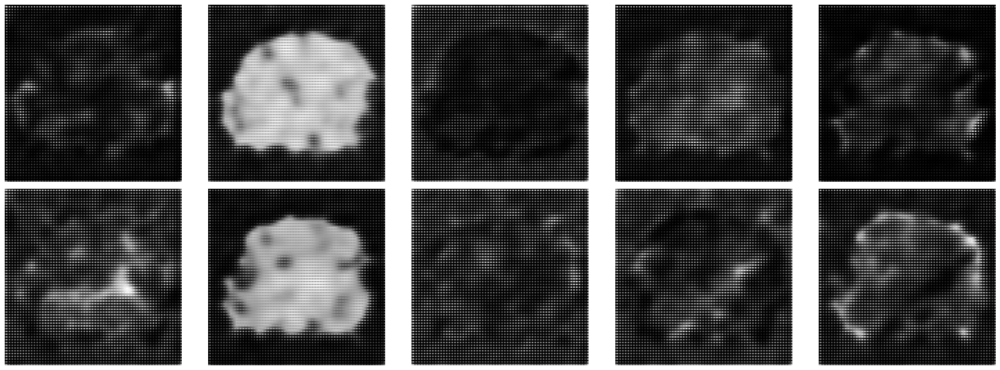

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<08:47,  7.11it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 2/3750 [00:00<07:38,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 3/3750 [00:00<07:09,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 4/3750 [00:00<08:01,  7.77it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 5/3750 [00:00<07:28,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 6/3750 [00:00<07:06,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 7/3750 [00:00<06:53,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 8/3750 [00:00<06:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:01<06:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<06:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 11/3750 [00:01<06:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 12/3750 [00:01<06:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 13/3750 [00:01<06:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 14/3750 [00:01<06:27,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<06:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:01<06:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:01<06:24,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 18/3750 [00:01<06:26,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:02<06:24,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 21/3750 [00:02<06:25,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 22/3750 [00:02<06:25,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<06:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 24/3750 [00:02<06:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 25/3750 [00:02<06:29,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 26/3750 [00:02<06:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 27/3750 [00:02<06:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:02<06:29,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 29/3750 [00:03<06:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 30/3750 [00:03<06:32,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 31/3750 [00:03<06:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 32/3750 [00:03<06:29,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 33/3750 [00:03<06:27,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 35/3750 [00:03<06:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 36/3750 [00:03<06:28,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 37/3750 [00:03<06:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 38/3750 [00:04<06:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 39/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 40/3750 [00:04<06:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 41/3750 [00:04<06:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 42/3750 [00:04<06:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 43/3750 [00:04<06:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 44/3750 [00:04<06:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 45/3750 [00:04<06:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 46/3750 [00:04<06:25,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 47/3750 [00:04<06:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 48/3750 [00:05<06:50,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 49/3750 [00:05<06:42,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 50/3750 [00:05<06:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 51/3750 [00:05<06:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 52/3750 [00:05<06:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 53/3750 [00:05<06:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 54/3750 [00:05<06:26,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:05<06:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:05<06:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▌                                        | 57/3750 [00:06<06:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 58/3750 [00:06<06:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 59/3750 [00:06<06:24,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 60/3750 [00:06<07:10,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 61/3750 [00:06<07:04,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:53,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:06<06:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 64/3750 [00:06<06:39,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 65/3750 [00:06<06:33,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 66/3750 [00:07<06:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 67/3750 [00:07<06:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 68/3750 [00:07<06:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 69/3750 [00:07<06:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 70/3750 [00:07<06:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 71/3750 [00:07<06:17,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 72/3750 [00:07<06:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 73/3750 [00:07<06:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 74/3750 [00:07<06:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 75/3750 [00:07<06:19,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 76/3750 [00:08<06:18,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 77/3750 [00:08<06:17,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 78/3750 [00:08<06:16,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:08<06:16,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 80/3750 [00:08<06:15,  9.77it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 81/3750 [00:08<06:18,  9.70it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 82/3750 [00:08<06:25,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 83/3750 [00:08<06:25,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 84/3750 [00:08<06:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:09<06:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 86/3750 [00:09<06:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 87/3750 [00:09<06:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:09<06:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:09<06:18,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 90/3750 [00:09<06:16,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 91/3750 [00:09<06:19,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:09<06:18,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 93/3750 [00:09<06:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:09<06:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 96/3750 [00:10<06:17,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:10<06:16,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:10<06:15,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:10<06:14,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 100/3750 [00:10<06:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 101/3750 [00:10<06:16,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 102/3750 [00:10<06:15,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 103/3750 [00:10<06:14,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 104/3750 [00:10<06:14,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:11<06:14,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:13,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 107/3750 [00:11<06:12,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 108/3750 [00:11<06:12,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:11<06:14,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:11<06:14,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:11<06:14,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:11<06:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 113/3750 [00:11<06:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:11<06:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<06:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 116/3750 [00:12<06:14,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 117/3750 [00:12<06:14,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 118/3750 [00:12<06:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 119/3750 [00:12<06:15,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 120/3750 [00:12<06:14,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 121/3750 [00:12<06:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 122/3750 [00:12<06:14,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:12<06:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 125/3750 [00:13<06:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 126/3750 [00:13<06:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 127/3750 [00:13<06:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:13<06:19,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 129/3750 [00:13<06:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 130/3750 [00:13<06:19,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 131/3750 [00:13<06:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:13<06:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 133/3750 [00:13<06:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 134/3750 [00:14<06:16,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 135/3750 [00:14<06:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 136/3750 [00:14<06:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 137/3750 [00:14<06:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:14<06:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 139/3750 [00:14<06:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 140/3750 [00:14<06:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 141/3750 [00:14<06:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 142/3750 [00:14<06:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 143/3750 [00:15<06:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:15<06:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 145/3750 [00:15<06:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 146/3750 [00:15<06:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 147/3750 [00:15<06:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 148/3750 [00:15<06:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 149/3750 [00:15<06:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 150/3750 [00:15<06:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 151/3750 [00:15<06:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:15<06:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:16<06:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:16<06:09,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:16<06:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 156/3750 [00:16<06:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:16<06:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 158/3750 [00:16<06:11,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 159/3750 [00:16<06:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 160/3750 [00:16<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:16<06:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 162/3750 [00:16<06:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:17<06:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 164/3750 [00:17<06:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 165/3750 [00:17<06:10,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:17<06:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:17<06:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 168/3750 [00:17<06:07,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 169/3750 [00:17<06:07,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 170/3750 [00:17<06:07,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:17<06:06,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 172/3750 [00:18<06:06,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 173/3750 [00:18<06:09,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:18<06:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:18<06:07,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 176/3750 [00:18<06:06,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 177/3750 [00:18<06:06,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 178/3750 [00:18<06:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 179/3750 [00:18<06:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:18<06:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 181/3750 [00:18<06:07,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 182/3750 [00:19<06:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 183/3750 [00:19<06:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:19<06:09,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:19<06:08,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 186/3750 [00:19<06:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 187/3750 [00:19<06:09,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 188/3750 [00:19<06:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:19<06:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:19<06:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 191/3750 [00:20<06:22,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:20<06:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:20<06:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:20<06:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 196/3750 [00:20<06:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 197/3750 [00:20<06:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 198/3750 [00:20<06:07,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 199/3750 [00:20<06:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:20<06:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:21<06:09,  9.61it/s]

1/1 [==============================] - 0s 10ms/step


  5%|██▏                                     | 202/3750 [00:21<06:09,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:21<06:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 204/3750 [00:21<06:07,  9.66it/s]

1/1 [==============================] - 0s 7ms/step


  5%|██▏                                     | 205/3750 [00:21<06:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:21<06:03,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:21<06:03,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 208/3750 [00:21<06:03,  9.76it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:21<06:06,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 210/3750 [00:21<06:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:22<06:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 212/3750 [00:22<06:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 213/3750 [00:22<06:08,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 214/3750 [00:22<06:06,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 215/3750 [00:22<06:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:22<06:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 217/3750 [00:22<06:02,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 218/3750 [00:22<06:01,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 219/3750 [00:22<06:05,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:23<06:09,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 221/3750 [00:23<06:32,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 222/3750 [00:23<06:27,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 223/3750 [00:23<06:24,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 224/3750 [00:23<06:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 225/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 226/3750 [00:23<06:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 227/3750 [00:23<06:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 228/3750 [00:23<06:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 229/3750 [00:23<06:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 230/3750 [00:24<06:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 231/3750 [00:24<06:04,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:24<06:03,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:24<06:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 234/3750 [00:24<06:01,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 235/3750 [00:24<06:01,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 236/3750 [00:24<06:01,  9.73it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:24<06:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 238/3750 [00:24<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 239/3750 [00:25<06:06,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 240/3750 [00:25<06:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 241/3750 [00:25<06:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 242/3750 [00:25<06:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 243/3750 [00:25<06:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 244/3750 [00:25<06:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 245/3750 [00:25<06:01,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 246/3750 [00:25<06:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:25<06:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:25<06:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:26<06:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 250/3750 [00:26<06:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 251/3750 [00:26<06:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:26<06:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 253/3750 [00:26<06:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 254/3750 [00:26<06:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:26<06:23,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 256/3750 [00:26<06:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:26<06:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 258/3750 [00:27<06:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 259/3750 [00:27<06:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 260/3750 [00:27<06:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 261/3750 [00:27<06:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 262/3750 [00:27<06:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 263/3750 [00:27<06:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 264/3750 [00:27<06:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 265/3750 [00:27<06:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 266/3750 [00:27<06:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 267/3750 [00:27<06:02,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:28<06:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 269/3750 [00:28<06:02,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 270/3750 [00:28<06:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 271/3750 [00:28<06:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 272/3750 [00:28<06:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 273/3750 [00:28<06:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 274/3750 [00:28<06:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:28<06:00,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 276/3750 [00:28<06:03,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 277/3750 [00:28<06:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 278/3750 [00:29<06:02,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:29<06:01,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 280/3750 [00:29<06:02,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 281/3750 [00:29<06:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 282/3750 [00:29<06:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 283/3750 [00:29<06:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 284/3750 [00:29<06:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:29<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 286/3750 [00:29<06:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 287/3750 [00:30<06:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 288/3750 [00:30<05:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 289/3750 [00:30<05:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 290/3750 [00:30<05:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 291/3750 [00:30<05:56,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 292/3750 [00:30<05:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 293/3750 [00:30<05:55,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 294/3750 [00:30<06:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:30<05:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 296/3750 [00:30<05:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 297/3750 [00:31<05:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:31<06:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:31<06:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:31<06:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 301/3750 [00:31<06:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 302/3750 [00:31<05:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 303/3750 [00:31<06:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 304/3750 [00:31<06:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 305/3750 [00:31<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:32<06:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:32<06:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:32<06:29,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 309/3750 [00:32<06:19,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 310/3750 [00:32<06:12,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:32<06:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 312/3750 [00:32<06:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 313/3750 [00:32<06:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:32<06:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:32<06:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 316/3750 [00:33<06:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 317/3750 [00:33<06:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 318/3750 [00:33<06:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 319/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:33<06:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 321/3750 [00:33<06:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 322/3750 [00:33<05:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 323/3750 [00:33<05:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 324/3750 [00:33<05:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 325/3750 [00:34<05:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 326/3750 [00:34<05:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 327/3750 [00:34<05:52,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 328/3750 [00:34<05:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 329/3750 [00:34<05:53,  9.68it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 330/3750 [00:34<05:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 331/3750 [00:34<05:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 332/3750 [00:34<05:54,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 333/3750 [00:34<05:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 334/3750 [00:34<05:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 335/3750 [00:35<05:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 336/3750 [00:35<05:54,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 337/3750 [00:35<05:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 338/3750 [00:35<05:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 339/3750 [00:35<05:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 340/3750 [00:35<05:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 341/3750 [00:35<05:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:35<05:50,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 343/3750 [00:35<05:49,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:36<05:49,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 345/3750 [00:36<05:49,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 346/3750 [00:36<05:50,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 347/3750 [00:36<05:49,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 348/3750 [00:36<05:49,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:36<05:49,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:36<05:48,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:36<05:48,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 352/3750 [00:36<05:49,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 353/3750 [00:36<05:48,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 354/3750 [00:37<05:47,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 355/3750 [00:37<05:51,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 356/3750 [00:37<05:50,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 357/3750 [00:37<05:49,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 358/3750 [00:37<05:49,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 359/3750 [00:37<05:49,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 360/3750 [00:37<05:49,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 361/3750 [00:37<05:49,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 362/3750 [00:37<05:48,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 363/3750 [00:37<05:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 364/3750 [00:38<05:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 365/3750 [00:38<05:51,  9.62it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▉                                    | 366/3750 [00:38<05:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:38<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:38<05:58,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 369/3750 [00:38<06:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 370/3750 [00:38<05:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 371/3750 [00:38<05:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:38<05:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 373/3750 [00:39<05:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:39<05:52,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 375/3750 [00:39<05:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:39<05:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 377/3750 [00:39<05:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 378/3750 [00:39<05:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 379/3750 [00:39<05:49,  9.65it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 380/3750 [00:39<06:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 381/3750 [00:39<06:10,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 382/3750 [00:39<06:17,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 383/3750 [00:40<06:13,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 384/3750 [00:40<06:06,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 385/3750 [00:40<06:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 386/3750 [00:40<06:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 387/3750 [00:40<06:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 388/3750 [00:40<05:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:40<05:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 390/3750 [00:40<06:01,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 391/3750 [00:40<05:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 392/3750 [00:41<05:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 393/3750 [00:41<05:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 394/3750 [00:41<05:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:41<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 396/3750 [00:41<05:50,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 397/3750 [00:41<05:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 398/3750 [00:41<05:47,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:41<05:46,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:41<05:44,  9.72it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 401/3750 [00:41<05:47,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 402/3750 [00:42<05:46,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 403/3750 [00:42<05:45,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 404/3750 [00:42<05:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:42<05:44,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 406/3750 [00:42<05:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 407/3750 [00:42<05:44,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 408/3750 [00:42<05:43,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:42<05:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:42<05:44,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 411/3750 [00:43<05:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 412/3750 [00:43<05:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 413/3750 [00:43<05:49,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 414/3750 [00:43<06:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 415/3750 [00:43<05:57,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:43<05:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 417/3750 [00:43<06:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 418/3750 [00:43<06:01,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 419/3750 [00:43<05:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 420/3750 [00:43<05:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 421/3750 [00:44<05:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 422/3750 [00:44<05:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 423/3750 [00:44<05:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 424/3750 [00:44<05:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 425/3750 [00:44<05:46,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:44<05:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 427/3750 [00:44<05:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:44<05:44,  9.64it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 429/3750 [00:44<06:13,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 430/3750 [00:45<06:07,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 431/3750 [00:45<05:59,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 432/3750 [00:45<05:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 433/3750 [00:45<05:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:45<05:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:45<05:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 436/3750 [00:45<05:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 437/3750 [00:45<05:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 438/3750 [00:45<05:45,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 439/3750 [00:45<05:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:46<05:48,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▋                                   | 441/3750 [00:46<05:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:46<05:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:46<06:06,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


 12%|████▋                                   | 444/3750 [00:46<06:07,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 445/3750 [00:46<06:06,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 446/3750 [00:46<06:03,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:46<06:03,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 448/3750 [00:46<06:03,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:47<05:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 450/3750 [00:47<05:59,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:47<06:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 452/3750 [00:47<06:01,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 453/3750 [00:47<06:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 454/3750 [00:47<05:59,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:47<05:58,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▊                                   | 456/3750 [00:47<06:01,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▊                                   | 457/3750 [00:47<06:02,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 458/3750 [00:48<05:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 459/3750 [00:48<05:54,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 12%|████▉                                   | 460/3750 [00:48<05:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 461/3750 [00:48<05:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:48<05:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:48<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 464/3750 [00:48<05:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 465/3750 [00:48<05:42,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 466/3750 [00:48<05:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 467/3750 [00:49<05:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 468/3750 [00:49<05:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 469/3750 [00:49<05:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:49<05:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:49<05:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:49<05:38,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 473/3750 [00:49<05:37,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:49<05:36,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 475/3750 [00:49<05:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 476/3750 [00:49<05:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:50<05:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 478/3750 [00:50<05:37,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 479/3750 [00:50<05:38,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:50<05:37,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:50<05:36,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 482/3750 [00:50<05:36,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 483/3750 [00:50<05:36,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 484/3750 [00:50<05:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 485/3750 [00:50<05:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 486/3750 [00:50<05:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 487/3750 [00:51<05:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 488/3750 [00:51<05:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 489/3750 [00:51<05:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 490/3750 [00:51<05:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 491/3750 [00:51<05:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 492/3750 [00:51<05:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 493/3750 [00:51<05:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 494/3750 [00:51<05:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 495/3750 [00:51<05:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 496/3750 [00:52<05:35,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 497/3750 [00:52<05:34,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 498/3750 [00:52<05:33,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 499/3750 [00:52<05:35,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:52<05:34,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 501/3750 [00:52<05:33,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 502/3750 [00:52<05:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:52<05:34,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 504/3750 [00:52<05:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:52<05:35,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:53<05:35,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:53<05:34,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 508/3750 [00:53<05:33,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 509/3750 [00:53<05:33,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:53<05:33,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 511/3750 [00:53<05:34,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 512/3750 [00:53<05:35,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:53<05:34,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 514/3750 [00:53<06:04,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▍                                  | 515/3750 [00:54<06:15,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 516/3750 [00:54<06:04,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:54<05:57,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 518/3750 [00:54<05:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 519/3750 [00:54<05:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 520/3750 [00:54<05:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 521/3750 [00:54<05:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 522/3750 [00:54<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 523/3750 [00:54<05:37,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 524/3750 [00:54<05:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 525/3750 [00:55<05:34,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 526/3750 [00:55<05:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 527/3750 [00:55<05:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:55<05:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 529/3750 [00:55<05:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:55<05:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:55<05:32,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 532/3750 [00:55<05:32,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 533/3750 [00:55<05:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 534/3750 [00:56<05:31,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 535/3750 [00:56<05:30,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [00:56<05:30,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [00:56<05:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 538/3750 [00:56<05:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 539/3750 [00:56<05:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 540/3750 [00:56<05:30,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 541/3750 [00:56<05:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 542/3750 [00:56<05:30,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 543/3750 [00:56<05:29,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 544/3750 [00:57<05:29,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 545/3750 [00:57<05:28,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 546/3750 [00:57<05:28,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 547/3750 [00:57<05:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 548/3750 [00:57<05:30,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 549/3750 [00:57<05:29,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 550/3750 [00:57<05:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [00:57<05:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 552/3750 [00:57<05:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 553/3750 [00:57<05:29,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 554/3750 [00:58<05:28,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [00:58<05:28,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 556/3750 [00:58<05:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 557/3750 [00:58<05:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [00:58<05:29,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 559/3750 [00:58<05:33,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 560/3750 [00:58<05:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 561/3750 [00:58<05:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 562/3750 [00:58<05:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 563/3750 [00:59<05:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 564/3750 [00:59<05:29,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 565/3750 [00:59<05:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 566/3750 [00:59<05:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 567/3750 [00:59<05:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 568/3750 [00:59<05:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 569/3750 [00:59<05:28,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [00:59<05:28,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 571/3750 [00:59<05:28,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 572/3750 [00:59<05:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 573/3750 [01:00<05:27,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 574/3750 [01:00<05:28,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 575/3750 [01:00<05:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 576/3750 [01:00<05:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 577/3750 [01:00<05:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 578/3750 [01:00<05:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 579/3750 [01:00<05:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 580/3750 [01:00<05:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:00<05:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 582/3750 [01:00<05:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 583/3750 [01:01<05:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 584/3750 [01:01<05:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 585/3750 [01:01<05:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 586/3750 [01:01<05:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 587/3750 [01:01<05:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 588/3750 [01:01<05:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:01<05:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 590/3750 [01:01<05:24,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 591/3750 [01:01<05:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 592/3750 [01:02<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:02<05:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 594/3750 [01:02<05:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 595/3750 [01:02<05:35,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▎                                 | 596/3750 [01:02<05:49,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:02<05:46,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 598/3750 [01:02<05:41,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 599/3750 [01:02<05:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 600/3750 [01:02<05:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 601/3750 [01:02<05:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 602/3750 [01:03<05:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 603/3750 [01:03<05:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 604/3750 [01:03<05:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 605/3750 [01:03<05:27,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 606/3750 [01:03<05:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 607/3750 [01:03<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:03<05:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 609/3750 [01:03<05:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 610/3750 [01:03<05:32,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 611/3750 [01:04<05:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 612/3750 [01:04<05:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 613/3750 [01:04<05:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:04<05:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 615/3750 [01:04<05:37,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 616/3750 [01:04<05:55,  8.81it/s]

1/1 [==============================] - 0s 14ms/step


 16%|██████▌                                 | 617/3750 [01:04<05:57,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:04<05:50,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:04<05:46,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 620/3750 [01:05<05:43,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▌                                 | 621/3750 [01:05<05:52,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 622/3750 [01:05<05:52,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 623/3750 [01:05<05:48,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▋                                 | 624/3750 [01:05<05:55,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 625/3750 [01:05<06:00,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 626/3750 [01:05<06:03,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 627/3750 [01:05<06:06,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 628/3750 [01:05<06:04,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 629/3750 [01:06<05:57,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:06<05:52,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 631/3750 [01:06<05:45,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 632/3750 [01:06<05:38,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 633/3750 [01:06<05:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 634/3750 [01:06<05:34,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 635/3750 [01:06<05:39,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 636/3750 [01:06<05:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 637/3750 [01:06<05:39,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 638/3750 [01:07<05:41,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 639/3750 [01:07<05:44,  9.04it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▊                                 | 640/3750 [01:07<05:52,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 641/3750 [01:07<05:47,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 642/3750 [01:07<05:53,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:07<05:47,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 644/3750 [01:07<05:54,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:07<05:49,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 646/3750 [01:07<05:43,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 647/3750 [01:08<05:42,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 648/3750 [01:08<05:41,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:08<05:45,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 650/3750 [01:08<05:52,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 651/3750 [01:08<05:47,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:08<05:43,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:08<05:37,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:08<05:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 655/3750 [01:08<05:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 656/3750 [01:09<05:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 657/3750 [01:09<05:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 658/3750 [01:09<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:09<05:28,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████                                 | 660/3750 [01:09<05:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 661/3750 [01:09<05:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 662/3750 [01:09<05:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 663/3750 [01:09<05:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:09<05:36,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 665/3750 [01:09<05:32,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 666/3750 [01:10<05:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 667/3750 [01:10<05:32,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 668/3750 [01:10<05:45,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 669/3750 [01:10<05:55,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 670/3750 [01:10<05:54,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:10<05:49,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 672/3750 [01:10<05:48,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 673/3750 [01:10<05:42,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 674/3750 [01:11<05:45,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 675/3750 [01:11<05:42,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:11<05:45,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 677/3750 [01:11<05:38,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 678/3750 [01:11<05:39,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 679/3750 [01:11<05:42,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 680/3750 [01:11<05:39,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 681/3750 [01:11<05:37,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████▎                                | 682/3750 [01:11<05:47,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:12<05:45,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████▎                                | 684/3750 [01:12<05:55,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 685/3750 [01:12<05:47,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 686/3750 [01:12<05:40,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 687/3750 [01:12<05:48,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 688/3750 [01:12<05:56,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 689/3750 [01:12<05:59,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 690/3750 [01:12<05:49,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 691/3750 [01:12<05:43,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▍                                | 692/3750 [01:13<05:40,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▍                                | 693/3750 [01:13<05:39,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 694/3750 [01:13<05:35,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 695/3750 [01:13<05:30,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 696/3750 [01:13<05:49,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 697/3750 [01:13<05:43,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 698/3750 [01:13<05:39,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:13<05:36,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:13<05:35,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:14<05:32,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:14<05:33,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 703/3750 [01:14<05:32,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 704/3750 [01:14<05:40,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▌                                | 705/3750 [01:14<05:48,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 706/3750 [01:14<05:45,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 707/3750 [01:14<05:39,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 708/3750 [01:14<05:46,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 709/3750 [01:14<05:40,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 710/3750 [01:15<05:36,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 711/3750 [01:15<05:40,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 712/3750 [01:15<05:35,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 713/3750 [01:15<05:34,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 714/3750 [01:15<05:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 715/3750 [01:15<05:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 716/3750 [01:15<05:33,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:15<05:27,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:15<05:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 719/3750 [01:16<05:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 720/3750 [01:16<05:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 721/3750 [01:16<05:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 722/3750 [01:16<05:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:16<05:15,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 724/3750 [01:16<05:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:16<05:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 726/3750 [01:16<05:16,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 727/3750 [01:16<05:16,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:16<05:31,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▊                                | 729/3750 [01:17<08:23,  6.00it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▊                                | 730/3750 [01:17<07:42,  6.53it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 731/3750 [01:17<07:05,  7.10it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▊                                | 732/3750 [01:17<06:50,  7.34it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▊                                | 733/3750 [01:17<06:33,  7.67it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 734/3750 [01:17<06:17,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 735/3750 [01:17<06:11,  8.12it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▊                                | 736/3750 [01:18<06:01,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 737/3750 [01:18<05:53,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:18<05:50,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 739/3750 [01:18<05:44,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:18<05:37,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:18<05:37,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 742/3750 [01:18<05:45,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 743/3750 [01:18<05:41,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 744/3750 [01:18<05:44,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 745/3750 [01:19<05:45,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 746/3750 [01:19<05:50,  8.57it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▉                                | 747/3750 [01:19<05:54,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:19<05:45,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:19<05:41,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 750/3750 [01:19<05:37,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 751/3750 [01:19<05:37,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 752/3750 [01:19<05:34,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 753/3750 [01:20<06:05,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:20<05:54,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:20<05:52,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 756/3750 [01:20<05:44,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 757/3750 [01:20<05:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 758/3750 [01:20<05:32,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 759/3750 [01:20<05:30,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████                                | 760/3750 [01:20<05:28,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:20<05:26,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 762/3750 [01:21<05:24,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:21<05:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:21<05:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 765/3750 [01:21<05:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 766/3750 [01:21<05:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 767/3750 [01:21<05:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 768/3750 [01:21<05:25,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▏                               | 769/3750 [01:21<05:33,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▏                               | 770/3750 [01:21<05:32,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▏                               | 771/3750 [01:22<05:29,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 772/3750 [01:22<05:30,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▏                               | 773/3750 [01:22<05:34,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 774/3750 [01:22<05:39,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▎                               | 775/3750 [01:22<05:37,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 776/3750 [01:22<06:04,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▎                               | 777/3750 [01:22<06:01,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 778/3750 [01:22<05:51,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 779/3750 [01:22<05:41,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:23<05:33,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 781/3750 [01:23<05:26,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 782/3750 [01:23<05:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 783/3750 [01:23<05:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 784/3750 [01:23<05:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 785/3750 [01:23<05:24,  9.15it/s]

1/1 [==============================] - 0s 12ms/step


 21%|████████▍                               | 786/3750 [01:23<05:37,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 787/3750 [01:23<05:45,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 788/3750 [01:23<05:47,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 789/3750 [01:24<05:41,  8.68it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 790/3750 [01:24<05:45,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 791/3750 [01:24<05:41,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 792/3750 [01:24<05:37,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 793/3750 [01:24<05:41,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 794/3750 [01:24<05:47,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:24<05:37,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 796/3750 [01:24<05:28,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:24<05:35,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 798/3750 [01:25<05:31,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 799/3750 [01:25<05:25,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:25<05:21,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▌                               | 801/3750 [01:25<05:30,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:25<05:25,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 803/3750 [01:25<05:24,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 804/3750 [01:25<05:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:25<05:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 806/3750 [01:25<05:26,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▌                               | 807/3750 [01:26<05:30,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 808/3750 [01:26<05:24,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 809/3750 [01:26<05:19,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:26<05:15,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 811/3750 [01:26<05:26,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 812/3750 [01:26<05:22,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 813/3750 [01:26<05:20,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:26<05:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 815/3750 [01:26<05:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:27<05:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 817/3750 [01:27<05:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 818/3750 [01:27<05:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 819/3750 [01:27<05:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 820/3750 [01:27<05:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 821/3750 [01:27<05:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 822/3750 [01:27<05:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 823/3750 [01:27<05:21,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 824/3750 [01:27<05:20,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 825/3750 [01:28<05:18,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 826/3750 [01:28<05:13,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 827/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:28<05:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:28<05:04,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 830/3750 [01:28<05:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 831/3750 [01:28<05:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 832/3750 [01:28<05:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 833/3750 [01:28<05:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:28<05:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 835/3750 [01:29<05:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 836/3750 [01:29<05:01,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 837/3750 [01:29<04:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:29<04:59,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 839/3750 [01:29<04:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 840/3750 [01:29<04:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:29<04:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 842/3750 [01:29<04:58,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 843/3750 [01:29<05:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 844/3750 [01:29<05:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 845/3750 [01:30<04:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 846/3750 [01:30<04:59,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 847/3750 [01:30<05:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 848/3750 [01:30<04:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 849/3750 [01:30<05:05,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 850/3750 [01:30<05:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 851/3750 [01:30<05:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 852/3750 [01:30<05:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 853/3750 [01:30<05:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 854/3750 [01:31<05:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 855/3750 [01:31<04:58,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 856/3750 [01:31<04:58,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 857/3750 [01:31<04:57,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 858/3750 [01:31<04:56,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 859/3750 [01:31<04:56,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 860/3750 [01:31<04:56,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:31<04:58,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 862/3750 [01:31<04:58,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:31<05:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:32<04:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:32<04:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 866/3750 [01:32<04:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 867/3750 [01:32<04:57,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 868/3750 [01:32<04:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:32<04:56,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:32<04:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 871/3750 [01:32<05:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:32<04:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 873/3750 [01:32<04:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 874/3750 [01:33<04:56,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 875/3750 [01:33<04:56,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:33<04:55,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 877/3750 [01:33<04:55,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 878/3750 [01:33<04:55,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 879/3750 [01:33<04:56,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 880/3750 [01:33<08:14,  5.80it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 881/3750 [01:34<07:15,  6.59it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 882/3750 [01:34<06:32,  7.30it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 883/3750 [01:34<06:03,  7.90it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 884/3750 [01:34<05:42,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:34<05:31,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 886/3750 [01:34<05:20,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 887/3750 [01:34<05:13,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 888/3750 [01:34<05:08,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:34<05:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 890/3750 [01:34<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 891/3750 [01:35<05:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:35<04:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:35<04:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:35<04:56,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 895/3750 [01:35<04:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 896/3750 [01:35<04:57,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 897/3750 [01:35<04:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 898/3750 [01:35<04:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 899/3750 [01:35<04:55,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 900/3750 [01:36<04:56,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:36<04:58,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 902/3750 [01:36<04:58,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 903/3750 [01:36<05:00,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 904/3750 [01:36<04:59,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 905/3750 [01:36<05:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 906/3750 [01:36<05:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 907/3750 [01:36<05:02,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▋                              | 908/3750 [01:36<05:17,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▋                              | 909/3750 [01:36<05:27,  8.67it/s]

1/1 [==============================] - 0s 12ms/step


 24%|█████████▋                              | 910/3750 [01:37<05:36,  8.43it/s]

1/1 [==============================] - 0s 12ms/step


 24%|█████████▋                              | 911/3750 [01:37<05:47,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 912/3750 [01:37<05:38,  8.39it/s]

1/1 [==============================] - 0s 12ms/step


 24%|█████████▋                              | 913/3750 [01:37<05:43,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▋                              | 914/3750 [01:37<05:47,  8.16it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▊                              | 915/3750 [01:37<05:46,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 916/3750 [01:37<05:38,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▊                              | 917/3750 [01:37<05:34,  8.47it/s]

1/1 [==============================] - 0s 13ms/step


 24%|█████████▊                              | 918/3750 [01:38<05:45,  8.19it/s]

1/1 [==============================] - 0s 14ms/step


 25%|█████████▊                              | 919/3750 [01:38<06:08,  7.69it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▊                              | 920/3750 [01:38<06:00,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▊                              | 921/3750 [01:38<05:48,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 922/3750 [01:38<05:44,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 923/3750 [01:38<05:39,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 924/3750 [01:38<05:46,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 925/3750 [01:38<05:36,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 926/3750 [01:39<05:31,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 927/3750 [01:39<05:25,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 928/3750 [01:39<05:23,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:39<05:16,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:39<05:15,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 931/3750 [01:39<05:15,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:39<05:11,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 933/3750 [01:39<05:13,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 934/3750 [01:39<05:12,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 935/3750 [01:40<05:20,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 936/3750 [01:40<05:29,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 937/3750 [01:40<05:33,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 938/3750 [01:40<05:35,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 939/3750 [01:40<05:33,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 940/3750 [01:40<05:24,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 941/3750 [01:40<05:28,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████                              | 942/3750 [01:40<05:29,  8.53it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████                              | 943/3750 [01:41<05:29,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 944/3750 [01:41<05:22,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 945/3750 [01:41<05:17,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 946/3750 [01:41<05:13,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 947/3750 [01:41<05:24,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:41<05:17,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:41<05:12,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 950/3750 [01:41<05:07,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████▏                             | 951/3750 [01:41<05:15,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████▏                             | 952/3750 [01:42<05:17,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 953/3750 [01:42<05:16,  8.82it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████▏                             | 954/3750 [01:42<05:17,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 955/3750 [01:42<05:16,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:42<05:13,  8.91it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▏                             | 957/3750 [01:42<05:11,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 958/3750 [01:42<05:08,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 959/3750 [01:42<05:07,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 960/3750 [01:42<05:16,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 961/3750 [01:43<05:25,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 962/3750 [01:43<05:25,  8.58it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 963/3750 [01:43<05:21,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 964/3750 [01:43<05:23,  8.62it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 965/3750 [01:43<05:27,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 966/3750 [01:43<06:04,  7.64it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 967/3750 [01:43<06:00,  7.73it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 968/3750 [01:43<05:45,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 969/3750 [01:44<05:31,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 970/3750 [01:44<05:25,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 971/3750 [01:44<05:24,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 972/3750 [01:44<05:18,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:44<05:12,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 974/3750 [01:44<05:07,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 975/3750 [01:44<05:12,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 976/3750 [01:44<05:10,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 977/3750 [01:44<05:03,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:45<04:59,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 979/3750 [01:45<05:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 980/3750 [01:45<05:01,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 981/3750 [01:45<05:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 982/3750 [01:45<04:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 983/3750 [01:45<04:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 984/3750 [01:45<04:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 985/3750 [01:45<04:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:45<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 987/3750 [01:45<04:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 988/3750 [01:46<04:52,  9.44it/s]

1/1 [==============================] - 0s 12ms/step


 26%|██████████▌                             | 989/3750 [01:46<05:00,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 990/3750 [01:46<05:07,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▌                             | 991/3750 [01:46<05:34,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▌                             | 992/3750 [01:46<05:27,  8.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 993/3750 [01:46<05:19,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 994/3750 [01:46<05:15,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                             | 995/3750 [01:46<05:10,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 996/3750 [01:47<05:06,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 997/3750 [01:47<05:06,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▋                             | 998/3750 [01:47<05:40,  8.07it/s]

1/1 [==============================] - 0s 12ms/step


 27%|██████████▋                             | 999/3750 [01:47<05:43,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1000/3750 [01:47<05:39,  8.11it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▍                            | 1001/3750 [01:47<05:40,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▍                            | 1002/3750 [01:47<05:38,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1003/3750 [01:47<05:29,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:47<05:19,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:48<05:12,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1006/3750 [01:48<05:10,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:48<05:06,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1008/3750 [01:48<05:08,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1009/3750 [01:48<05:03,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:48<04:58,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1011/3750 [01:48<04:55,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1012/3750 [01:48<04:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1013/3750 [01:48<04:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1014/3750 [01:49<05:03,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:49<05:06,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:49<05:04,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1017/3750 [01:49<05:00,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1018/3750 [01:49<04:58,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:49<04:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1020/3750 [01:49<04:55,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:49<04:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:49<04:51,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:50<04:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1024/3750 [01:50<04:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1025/3750 [01:50<04:44,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1026/3750 [01:50<04:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1027/3750 [01:50<04:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:50<04:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:50<04:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1030/3750 [01:50<04:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:50<04:40,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [01:50<04:39,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [01:51<04:39,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:51<04:40,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1035/3750 [01:51<04:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [01:51<04:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [01:51<04:40,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:51<04:40,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [01:51<04:40,  9.65it/s]

1/1 [==============================] - 0s 56ms/step


 28%|██████████▊                            | 1040/3750 [01:51<06:17,  7.18it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████▊                            | 1041/3750 [01:52<06:05,  7.41it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▊                            | 1042/3750 [01:52<05:44,  7.85it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1043/3750 [01:52<05:26,  8.29it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1044/3750 [01:52<05:18,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:52<05:08,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1046/3750 [01:52<05:24,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1047/3750 [01:52<05:20,  8.43it/s]

1/1 [==============================] - 0s 13ms/step


 28%|██████████▉                            | 1048/3750 [01:52<06:09,  7.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1049/3750 [01:53<05:44,  7.83it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [01:53<05:26,  8.28it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1051/3750 [01:53<05:11,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1052/3750 [01:53<05:04,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1053/3750 [01:53<04:57,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:53<04:56,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:53<04:59,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1056/3750 [01:53<05:06,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1057/3750 [01:53<05:09,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1058/3750 [01:54<05:09,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1059/3750 [01:54<05:06,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1060/3750 [01:54<05:04,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:54<05:02,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:54<04:55,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1063/3750 [01:54<04:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1064/3750 [01:54<04:47,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1065/3750 [01:54<04:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [01:54<04:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [01:54<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [01:55<04:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████                            | 1069/3750 [01:55<04:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [01:55<04:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1071/3750 [01:55<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1072/3750 [01:55<04:40,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1073/3750 [01:55<04:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [01:55<04:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [01:55<04:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:55<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [01:56<04:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:56<04:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [01:56<04:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1080/3750 [01:56<04:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [01:56<04:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:56<04:39,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1083/3750 [01:56<04:42,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1084/3750 [01:56<04:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1085/3750 [01:56<04:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [01:56<04:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1087/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [01:57<04:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1089/3750 [01:57<04:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1090/3750 [01:57<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1091/3750 [01:57<04:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:57<04:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:57<04:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1094/3750 [01:57<05:19,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1095/3750 [01:57<05:12,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1096/3750 [01:58<05:05,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1097/3750 [01:58<05:02,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1098/3750 [01:58<04:57,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1099/3750 [01:58<04:52,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1100/3750 [01:58<04:49,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1101/3750 [01:58<04:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1102/3750 [01:58<04:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1103/3750 [01:58<04:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1104/3750 [01:58<04:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1105/3750 [01:59<04:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▌                           | 1106/3750 [01:59<04:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [01:59<04:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [01:59<04:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1109/3750 [01:59<04:47,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 30%|███████████▌                           | 1110/3750 [01:59<04:52,  9.04it/s]

1/1 [==============================] - 0s 12ms/step


 30%|███████████▌                           | 1111/3750 [01:59<04:54,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1112/3750 [01:59<04:49,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1113/3750 [01:59<04:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [02:00<04:40,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1115/3750 [02:00<04:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [02:00<04:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1117/3750 [02:00<04:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [02:00<04:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1119/3750 [02:00<04:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1120/3750 [02:00<04:36,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1121/3750 [02:00<04:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [02:00<04:33,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1123/3750 [02:00<04:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1124/3750 [02:01<04:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1125/3750 [02:01<04:29,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [02:01<04:29,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [02:01<04:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1128/3750 [02:01<04:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1129/3750 [02:01<04:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1130/3750 [02:01<04:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [02:01<04:33,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:01<04:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [02:02<04:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:02<04:30,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1135/3750 [02:02<04:29,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1136/3750 [02:02<04:29,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1137/3750 [02:02<04:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1138/3750 [02:02<04:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1139/3750 [02:02<04:29,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1140/3750 [02:02<04:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1141/3750 [02:02<04:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1142/3750 [02:02<04:37,  9.40it/s]

1/1 [==============================] - 0s 44ms/step


 30%|███████████▉                           | 1143/3750 [02:03<05:24,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1144/3750 [02:03<05:16,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1145/3750 [02:03<05:10,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:03<05:04,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1147/3750 [02:03<04:57,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1148/3750 [02:03<04:50,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1149/3750 [02:03<04:45,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1150/3750 [02:03<04:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1151/3750 [02:03<04:45,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1152/3750 [02:04<04:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1153/3750 [02:04<04:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1154/3750 [02:04<04:33,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1155/3750 [02:04<04:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1156/3750 [02:04<04:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:04<04:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:04<04:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:04<04:28,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:04<04:27,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1161/3750 [02:05<04:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1162/3750 [02:05<04:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:05<04:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1164/3750 [02:05<04:26,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:05<04:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:05<04:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1167/3750 [02:05<04:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1168/3750 [02:05<04:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1169/3750 [02:05<04:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1170/3750 [02:05<04:26,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1171/3750 [02:06<04:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1172/3750 [02:06<04:24,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1173/3750 [02:06<04:24,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:06<04:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1175/3750 [02:06<04:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1176/3750 [02:06<04:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1177/3750 [02:06<04:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1178/3750 [02:06<04:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1179/3750 [02:06<04:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:06<04:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1181/3750 [02:07<04:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:07<04:24,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1183/3750 [02:07<04:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1184/3750 [02:07<04:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1185/3750 [02:07<04:23,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:07<04:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1187/3750 [02:07<04:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:07<04:23,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1189/3750 [02:07<04:22,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:08<04:23,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:08<04:23,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1192/3750 [02:08<04:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:08<04:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1194/3750 [02:08<04:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1195/3750 [02:08<04:24,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1196/3750 [02:08<04:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1197/3750 [02:08<04:23,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1198/3750 [02:08<04:22,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1199/3750 [02:08<04:22,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:09<04:21,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:09<04:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1202/3750 [02:09<04:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1203/3750 [02:09<04:22,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:09<04:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1205/3750 [02:09<04:22,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1206/3750 [02:09<04:21,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:09<04:21,  9.73it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:09<04:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:09<04:22,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:10<04:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:10<04:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:10<04:24,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1213/3750 [02:10<04:25,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:10<04:26,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:10<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:10<04:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1217/3750 [02:10<04:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:10<04:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:11<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1220/3750 [02:11<04:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:11<04:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:11<04:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1223/3750 [02:11<04:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1224/3750 [02:11<04:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:11<04:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:11<04:21,  9.67it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1227/3750 [02:11<04:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:11<04:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:12<04:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1230/3750 [02:12<04:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1231/3750 [02:12<04:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1232/3750 [02:12<04:20,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1233/3750 [02:12<04:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:12<04:20,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:12<04:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:12<04:20,  9.66it/s]

1/1 [==============================] - 0s 11ms/step


 33%|████████████▊                          | 1237/3750 [02:12<04:23,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1238/3750 [02:13<04:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1239/3750 [02:13<04:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:13<04:23,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:13<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1242/3750 [02:13<04:22,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1243/3750 [02:13<04:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:13<04:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1245/3750 [02:13<04:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1246/3750 [02:13<04:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1247/3750 [02:13<04:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1248/3750 [02:14<04:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1249/3750 [02:14<04:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1250/3750 [02:14<04:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1251/3750 [02:14<04:19,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1252/3750 [02:14<04:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:14<04:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1254/3750 [02:14<04:39,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 33%|█████████████                          | 1255/3750 [02:14<04:34,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1256/3750 [02:14<04:32,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:15<04:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:15<04:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1259/3750 [02:15<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1260/3750 [02:15<04:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1261/3750 [02:15<04:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:15<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1263/3750 [02:15<04:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:15<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:15<04:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:15<04:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:16<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1268/3750 [02:16<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:16<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:16<04:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1271/3750 [02:16<04:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:16<04:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:16<04:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:16<04:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:16<04:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:17<04:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1277/3750 [02:17<04:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:17<04:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:17<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1280/3750 [02:17<04:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:17<04:17,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1282/3750 [02:17<04:18,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1283/3750 [02:17<04:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:17<04:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1285/3750 [02:17<04:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:18<04:17,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1287/3750 [02:18<04:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1288/3750 [02:18<04:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:18<04:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1290/3750 [02:18<04:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1291/3750 [02:18<04:15,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1292/3750 [02:18<04:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1293/3750 [02:18<04:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:18<04:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:18<04:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:19<04:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1297/3750 [02:19<04:12,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1298/3750 [02:19<04:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1299/3750 [02:19<04:14,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1300/3750 [02:19<04:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1301/3750 [02:19<04:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1302/3750 [02:19<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1303/3750 [02:19<04:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:19<04:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1305/3750 [02:20<04:12,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1306/3750 [02:20<04:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1307/3750 [02:20<04:11,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1308/3750 [02:20<04:11,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1309/3750 [02:20<04:11,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1310/3750 [02:20<04:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1311/3750 [02:20<04:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:20<04:11,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1313/3750 [02:20<04:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1314/3750 [02:20<04:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1315/3750 [02:21<04:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:21<04:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1317/3750 [02:21<04:09,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1318/3750 [02:21<04:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1319/3750 [02:21<04:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:21<04:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1321/3750 [02:21<04:10,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:21<04:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1323/3750 [02:21<04:10,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1324/3750 [02:21<04:11,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1325/3750 [02:22<04:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:22<04:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1327/3750 [02:22<04:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1328/3750 [02:22<04:29,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1329/3750 [02:22<04:25,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1330/3750 [02:22<04:21,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1331/3750 [02:22<04:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1332/3750 [02:22<04:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1333/3750 [02:22<04:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1334/3750 [02:23<04:12,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1335/3750 [02:23<04:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1336/3750 [02:23<04:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1337/3750 [02:23<04:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1338/3750 [02:23<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1339/3750 [02:23<04:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1340/3750 [02:23<04:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1341/3750 [02:23<04:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1342/3750 [02:23<04:08,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1343/3750 [02:23<04:08,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1344/3750 [02:24<04:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1345/3750 [02:24<04:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1346/3750 [02:24<04:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1347/3750 [02:24<04:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1348/3750 [02:24<04:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:24<04:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:24<04:07,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:24<04:06,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:24<04:05,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1353/3750 [02:25<04:05,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1354/3750 [02:25<04:05,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1355/3750 [02:25<04:04,  9.78it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1356/3750 [02:25<04:06,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1357/3750 [02:25<04:06,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:25<04:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1359/3750 [02:25<04:05,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1360/3750 [02:25<04:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:25<04:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:25<04:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1363/3750 [02:26<04:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1364/3750 [02:26<04:04,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1365/3750 [02:26<04:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:26<04:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:26<04:05,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:26<04:04,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:26<04:05,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:26<04:05,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1371/3750 [02:26<04:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1372/3750 [02:26<04:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:27<04:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:27<04:05,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:27<04:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1376/3750 [02:27<04:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:27<04:06,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1378/3750 [02:27<04:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:27<04:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1380/3750 [02:27<04:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:27<04:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:28<04:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:28<04:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:28<04:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1385/3750 [02:28<04:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:28<04:05,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1387/3750 [02:28<04:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:28<04:05,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1389/3750 [02:28<04:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:28<04:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:28<04:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1392/3750 [02:29<04:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:29<04:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:29<04:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:29<04:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1396/3750 [02:29<04:05,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1397/3750 [02:29<04:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:29<04:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1399/3750 [02:29<04:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:29<04:04,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1401/3750 [02:30<04:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1402/3750 [02:30<04:04,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1403/3750 [02:30<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1404/3750 [02:30<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1405/3750 [02:30<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:30<04:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1407/3750 [02:30<04:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:30<04:01,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1409/3750 [02:30<04:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1410/3750 [02:30<04:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1411/3750 [02:31<04:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:31<04:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:31<04:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:31<04:01,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:31<04:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1416/3750 [02:31<04:00,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:31<04:00,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:31<03:59,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1419/3750 [02:31<04:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:31<04:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1421/3750 [02:32<04:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1422/3750 [02:32<04:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1423/3750 [02:32<03:59,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1424/3750 [02:32<03:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:32<03:58,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1426/3750 [02:32<03:59,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:32<03:59,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1428/3750 [02:32<03:59,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1429/3750 [02:32<04:01,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1430/3750 [02:33<04:02,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:33<04:03,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1432/3750 [02:33<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:33<04:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1434/3750 [02:33<04:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1435/3750 [02:33<04:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1436/3750 [02:33<04:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1437/3750 [02:33<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1438/3750 [02:33<04:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1439/3750 [02:33<04:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1440/3750 [02:34<04:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:34<03:59,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1442/3750 [02:34<03:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|███████████████                        | 1443/3750 [02:34<03:58,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1444/3750 [02:34<03:57,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1445/3750 [02:34<03:56,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:34<03:56,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:34<03:57,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1448/3750 [02:34<04:00,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1449/3750 [02:34<04:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1450/3750 [02:35<03:59,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1451/3750 [02:35<03:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:35<03:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1453/3750 [02:35<03:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:35<03:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1455/3750 [02:35<03:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:35<03:58,  9.60it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▏                       | 1457/3750 [02:35<04:24,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1458/3750 [02:35<04:17,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1459/3750 [02:36<04:11,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1460/3750 [02:36<04:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:36<04:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:36<04:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1463/3750 [02:36<03:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:36<04:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:36<04:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1466/3750 [02:36<04:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:36<03:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:37<03:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:37<03:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1470/3750 [02:37<04:07,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1471/3750 [02:37<04:08,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1472/3750 [02:37<04:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:37<04:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:37<03:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:37<03:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:37<03:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:37<03:56,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1478/3750 [02:38<03:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1479/3750 [02:38<03:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:38<03:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:38<03:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1482/3750 [02:38<03:56,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1483/3750 [02:38<03:56,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1484/3750 [02:38<03:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1485/3750 [02:38<03:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1486/3750 [02:38<03:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1487/3750 [02:39<03:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1488/3750 [02:39<03:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1489/3750 [02:39<03:56,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1490/3750 [02:39<03:55,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1491/3750 [02:39<03:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1492/3750 [02:39<03:55,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1493/3750 [02:39<03:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1494/3750 [02:39<03:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:39<03:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1496/3750 [02:39<03:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1497/3750 [02:40<03:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1498/3750 [02:40<03:55,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1499/3750 [02:40<03:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1500/3750 [02:40<03:53,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1501/3750 [02:40<03:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1502/3750 [02:40<03:53,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:40<03:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:40<03:53,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:40<03:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:40<03:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:41<03:54,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:41<03:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1509/3750 [02:41<03:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:41<03:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:41<03:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:41<03:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1513/3750 [02:41<03:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1514/3750 [02:41<03:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:41<03:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:42<03:51,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:42<03:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1518/3750 [02:42<03:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1519/3750 [02:42<03:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1520/3750 [02:42<03:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:42<03:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1522/3750 [02:42<03:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1523/3750 [02:42<03:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1524/3750 [02:42<03:51,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1525/3750 [02:42<03:51,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1526/3750 [02:43<03:50,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1527/3750 [02:43<03:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1528/3750 [02:43<03:50,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1529/3750 [02:43<03:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:43<03:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1531/3750 [02:43<03:59,  9.27it/s]

1/1 [==============================] - 0s 12ms/step


 41%|███████████████▉                       | 1532/3750 [02:43<04:16,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1533/3750 [02:43<04:10,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1534/3750 [02:43<04:05,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1535/3750 [02:44<04:01,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1536/3750 [02:44<03:57,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1537/3750 [02:44<03:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1538/3750 [02:44<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1539/3750 [02:44<03:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1540/3750 [02:44<03:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1541/3750 [02:44<03:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1542/3750 [02:44<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1543/3750 [02:44<03:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:44<03:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1545/3750 [02:45<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:45<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:45<03:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1548/3750 [02:45<03:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1549/3750 [02:45<03:49,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1550/3750 [02:45<03:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1551/3750 [02:45<03:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:45<03:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1553/3750 [02:45<03:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1554/3750 [02:46<03:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:46<03:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:46<03:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:46<03:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1558/3750 [02:46<03:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1559/3750 [02:46<03:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1560/3750 [02:46<03:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1561/3750 [02:46<03:46,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1562/3750 [02:46<03:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:46<03:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:47<03:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1565/3750 [02:47<03:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1566/3750 [02:47<03:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:47<03:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:47<03:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:47<03:47,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1570/3750 [02:47<03:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:47<03:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:47<03:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1573/3750 [02:48<03:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1574/3750 [02:48<03:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:48<03:47,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1576/3750 [02:48<03:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1577/3750 [02:48<03:50,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1578/3750 [02:48<03:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:48<03:50,  9.40it/s]

1/1 [==============================] - 0s 14ms/step


 42%|████████████████▍                      | 1580/3750 [02:48<03:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1581/3750 [02:48<03:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:48<03:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:49<03:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:49<03:46,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1585/3750 [02:49<03:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:49<03:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1587/3750 [02:49<03:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1588/3750 [02:49<03:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:49<03:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:49<03:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:49<03:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:50<03:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:50<03:43,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1594/3750 [02:50<03:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1595/3750 [02:50<03:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:50<03:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:50<03:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:50<03:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1599/3750 [02:50<03:43,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1600/3750 [02:50<03:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [02:50<03:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [02:51<03:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [02:51<03:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:51<03:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:51<03:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:51<03:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [02:51<03:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1608/3750 [02:51<03:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1609/3750 [02:51<03:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1610/3750 [02:51<03:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1611/3750 [02:51<03:40,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [02:52<03:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:52<03:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1614/3750 [02:52<03:40,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1615/3750 [02:52<03:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1616/3750 [02:52<03:41,  9.65it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████████████████▊                      | 1617/3750 [02:52<04:07,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [02:52<04:01,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1619/3750 [02:52<03:54,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1620/3750 [02:52<03:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1621/3750 [02:53<03:47,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1622/3750 [02:53<03:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1623/3750 [02:53<03:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1624/3750 [02:53<03:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1625/3750 [02:53<03:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1626/3750 [02:53<03:39,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1627/3750 [02:53<03:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1628/3750 [02:53<03:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1629/3750 [02:53<03:41,  9.59it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1630/3750 [02:54<03:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1631/3750 [02:54<03:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [02:54<03:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1633/3750 [02:54<03:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [02:54<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1635/3750 [02:54<03:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1636/3750 [02:54<03:41,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1637/3750 [02:54<03:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1638/3750 [02:54<03:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1639/3750 [02:54<03:39,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [02:55<03:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1641/3750 [02:55<03:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1642/3750 [02:55<03:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1643/3750 [02:55<03:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1644/3750 [02:55<03:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1645/3750 [02:55<03:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1646/3750 [02:55<03:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1647/3750 [02:55<03:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1648/3750 [02:55<03:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1649/3750 [02:55<03:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1650/3750 [02:56<03:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1651/3750 [02:56<03:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1652/3750 [02:56<03:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1653/3750 [02:56<03:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1654/3750 [02:56<03:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1655/3750 [02:56<03:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1656/3750 [02:56<03:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1657/3750 [02:56<03:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1658/3750 [02:56<03:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1659/3750 [02:57<03:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [02:57<03:35,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1661/3750 [02:57<03:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1662/3750 [02:57<03:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1663/3750 [02:57<03:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1664/3750 [02:57<03:35,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1665/3750 [02:57<03:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1666/3750 [02:57<03:34,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1667/3750 [02:57<03:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [02:57<03:35,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1669/3750 [02:58<03:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1670/3750 [02:58<03:36,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1671/3750 [02:58<03:36,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1672/3750 [02:58<03:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1673/3750 [02:58<03:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1674/3750 [02:58<03:34,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1675/3750 [02:58<03:34,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [02:58<03:35,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [02:58<03:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1678/3750 [02:59<03:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [02:59<03:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1680/3750 [02:59<03:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [02:59<03:34,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [02:59<03:33,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1683/3750 [02:59<03:33,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1684/3750 [02:59<03:33,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1685/3750 [02:59<03:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1686/3750 [02:59<03:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1687/3750 [02:59<03:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [03:00<03:33,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1689/3750 [03:00<03:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1690/3750 [03:00<03:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [03:00<03:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1692/3750 [03:00<03:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1693/3750 [03:00<03:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:00<03:35,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1695/3750 [03:00<03:35,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1696/3750 [03:00<03:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1697/3750 [03:00<03:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1698/3750 [03:01<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [03:01<03:33,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1700/3750 [03:01<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1701/3750 [03:01<03:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1702/3750 [03:01<03:32,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1703/3750 [03:01<03:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1704/3750 [03:01<03:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1705/3750 [03:01<03:33,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:01<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [03:02<03:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1708/3750 [03:02<03:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:02<03:32,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:02<03:32,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:02<03:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1712/3750 [03:02<03:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1713/3750 [03:02<03:32,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1714/3750 [03:02<03:32,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:02<03:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:02<03:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1717/3750 [03:03<03:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:03<03:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1719/3750 [03:03<03:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:03<03:31,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1721/3750 [03:03<03:32,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1722/3750 [03:03<03:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:03<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1724/3750 [03:03<03:32,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1725/3750 [03:03<03:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:04<03:31,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1727/3750 [03:04<03:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:04<03:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:04<03:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:04<03:28,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1731/3750 [03:04<03:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1732/3750 [03:04<03:28,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1733/3750 [03:04<03:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1734/3750 [03:04<03:28,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1735/3750 [03:04<03:28,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1736/3750 [03:05<03:27,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:05<03:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1738/3750 [03:05<03:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1739/3750 [03:05<03:27,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1740/3750 [03:05<03:28,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1741/3750 [03:05<03:28,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1742/3750 [03:05<03:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████▏                    | 1743/3750 [03:05<03:29,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1744/3750 [03:05<03:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1745/3750 [03:05<03:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:06<03:27,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1747/3750 [03:06<03:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1748/3750 [03:06<03:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:06<03:26,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1750/3750 [03:06<03:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1751/3750 [03:06<03:26,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1752/3750 [03:06<03:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1753/3750 [03:06<03:25,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1754/3750 [03:06<03:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1755/3750 [03:07<03:24,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1756/3750 [03:07<03:24,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1757/3750 [03:07<03:24,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1758/3750 [03:07<03:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1759/3750 [03:07<03:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1760/3750 [03:07<03:24,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1761/3750 [03:07<03:24,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1762/3750 [03:07<03:24,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1763/3750 [03:07<03:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:07<03:24,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1765/3750 [03:08<03:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1766/3750 [03:08<03:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1767/3750 [03:08<03:23,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1768/3750 [03:08<03:24,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1769/3750 [03:08<03:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1770/3750 [03:08<03:24,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1771/3750 [03:08<03:25,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1772/3750 [03:08<03:24,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1773/3750 [03:08<03:24,  9.68it/s]

1/1 [==============================] - 0s 7ms/step


 47%|██████████████████▍                    | 1774/3750 [03:08<03:23,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1775/3750 [03:09<03:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1776/3750 [03:09<03:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1777/3750 [03:09<03:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1778/3750 [03:09<03:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1779/3750 [03:09<03:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1780/3750 [03:09<03:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1781/3750 [03:09<03:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:09<03:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:09<03:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:10<03:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:10<03:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:10<03:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:10<03:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1788/3750 [03:10<03:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:10<03:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:10<03:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:10<03:22,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:10<03:21,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1793/3750 [03:10<03:21,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1794/3750 [03:11<03:21,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1795/3750 [03:11<03:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1796/3750 [03:11<03:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1797/3750 [03:11<03:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1798/3750 [03:11<03:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1799/3750 [03:11<03:23,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1800/3750 [03:11<03:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:11<03:22,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1802/3750 [03:11<03:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1803/3750 [03:11<03:21,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1804/3750 [03:12<03:23,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1805/3750 [03:12<03:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1806/3750 [03:12<03:23,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:12<03:23,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1808/3750 [03:12<03:22,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1809/3750 [03:12<03:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1810/3750 [03:12<03:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1811/3750 [03:12<03:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1812/3750 [03:12<03:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:13<03:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1814/3750 [03:13<03:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1815/3750 [03:13<03:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1816/3750 [03:13<03:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1817/3750 [03:13<03:19,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1818/3750 [03:13<03:18,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1819/3750 [03:13<03:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:13<03:18,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1821/3750 [03:13<03:18,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:13<03:18,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1823/3750 [03:14<03:18,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1824/3750 [03:14<03:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1825/3750 [03:14<03:17,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1826/3750 [03:14<03:17,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1827/3750 [03:14<03:17,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:14<03:17,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:14<03:16,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1830/3750 [03:14<03:20,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:14<03:22,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1832/3750 [03:14<03:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1833/3750 [03:15<03:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1834/3750 [03:15<03:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:15<03:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1836/3750 [03:15<03:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1837/3750 [03:15<03:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:15<03:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1839/3750 [03:15<03:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1840/3750 [03:15<03:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:15<03:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1842/3750 [03:16<03:20,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1843/3750 [03:16<03:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:16<03:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:16<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:16<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:16<03:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1848/3750 [03:16<03:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1849/3750 [03:16<03:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:16<03:20,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1851/3750 [03:16<03:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1853/3750 [03:17<03:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1854/3750 [03:17<03:22,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▎                   | 1855/3750 [03:17<03:25,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1856/3750 [03:17<03:25,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1857/3750 [03:17<03:25,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:17<03:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1859/3750 [03:17<03:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1860/3750 [03:17<03:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1861/3750 [03:18<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1862/3750 [03:18<03:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:18<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:18<03:17,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1865/3750 [03:18<03:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:18<03:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1867/3750 [03:18<03:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1868/3750 [03:18<03:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1869/3750 [03:18<03:16,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1870/3750 [03:19<03:17,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1871/3750 [03:19<03:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1872/3750 [03:19<03:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1873/3750 [03:19<03:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:19<03:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1875/3750 [03:19<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:19<03:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:19<03:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:19<03:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:19<03:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1880/3750 [03:20<03:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:20<03:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:20<03:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:20<03:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:20<03:11,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:20<03:11,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:20<03:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:20<03:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:20<03:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1889/3750 [03:20<03:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1890/3750 [03:21<03:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:21<03:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:21<03:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:21<03:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:21<03:11,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1895/3750 [03:21<03:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1896/3750 [03:21<03:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1897/3750 [03:21<03:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1898/3750 [03:21<03:10,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1899/3750 [03:22<03:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1900/3750 [03:22<03:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:22<03:09,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1902/3750 [03:22<03:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:22<03:09,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:22<03:09,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1905/3750 [03:22<03:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1906/3750 [03:22<03:09,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:22<03:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1908/3750 [03:22<03:09,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1909/3750 [03:23<03:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1910/3750 [03:23<03:08,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1911/3750 [03:23<03:08,  9.75it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1912/3750 [03:23<03:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1913/3750 [03:23<03:10,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1914/3750 [03:23<03:12,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1915/3750 [03:23<03:12,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1916/3750 [03:23<03:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1917/3750 [03:23<03:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1918/3750 [03:23<03:11,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:24<03:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1920/3750 [03:24<03:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1921/3750 [03:24<03:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1922/3750 [03:24<03:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1923/3750 [03:24<03:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1924/3750 [03:24<03:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1925/3750 [03:24<03:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1926/3750 [03:24<03:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1927/3750 [03:24<03:09,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:25<03:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1929/3750 [03:25<03:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1930/3750 [03:25<03:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1931/3750 [03:25<03:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1932/3750 [03:25<03:09,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1933/3750 [03:25<04:49,  6.27it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:25<04:18,  7.03it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1935/3750 [03:25<03:56,  7.67it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:26<03:47,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:26<03:36,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1938/3750 [03:26<03:28,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1939/3750 [03:26<03:22,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1940/3750 [03:26<03:17,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:26<03:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1942/3750 [03:26<03:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1943/3750 [03:26<03:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:26<03:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1945/3750 [03:26<03:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:27<03:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1947/3750 [03:27<03:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1948/3750 [03:27<03:08,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:27<03:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1950/3750 [03:27<03:08,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1951/3750 [03:27<03:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:27<03:07,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1953/3750 [03:27<03:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1954/3750 [03:27<03:07,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1955/3750 [03:28<03:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:28<03:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1957/3750 [03:28<03:06,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1958/3750 [03:28<03:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1959/3750 [03:28<03:07,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:28<03:06,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1961/3750 [03:28<03:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:28<03:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1963/3750 [03:28<03:37,  8.21it/s]

1/1 [==============================] - 0s 13ms/step


 52%|████████████████████▍                  | 1964/3750 [03:29<03:48,  7.80it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1965/3750 [03:29<03:37,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1966/3750 [03:29<03:28,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1967/3750 [03:29<03:21,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1968/3750 [03:29<03:18,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:29<03:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1970/3750 [03:29<03:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:29<03:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:29<03:09,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:30<03:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:30<03:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:30<03:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1976/3750 [03:30<03:06,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:30<03:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:30<03:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1979/3750 [03:30<03:05,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1980/3750 [03:30<03:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:30<03:14,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1982/3750 [03:30<03:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:31<03:13,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1984/3750 [03:31<03:12,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1985/3750 [03:31<03:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1986/3750 [03:31<03:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:31<03:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1988/3750 [03:31<03:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:31<03:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:31<03:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1991/3750 [03:31<03:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:32<03:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:32<03:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1994/3750 [03:32<03:01,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1995/3750 [03:32<03:04,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1996/3750 [03:32<03:03,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1997/3750 [03:32<03:02,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1998/3750 [03:32<03:02,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1999/3750 [03:32<03:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:32<03:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2001/3750 [03:32<03:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:33<03:00,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:33<03:00,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2004/3750 [03:33<03:01,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:33<03:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2006/3750 [03:33<03:00,  9.65it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▊                  | 2007/3750 [03:33<03:02,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2008/3750 [03:33<03:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2009/3750 [03:33<03:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:33<03:12,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2011/3750 [03:34<03:09,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2012/3750 [03:34<03:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2013/3750 [03:34<03:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2014/3750 [03:34<03:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:34<03:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2016/3750 [03:34<03:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2017/3750 [03:34<03:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:34<02:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2019/3750 [03:34<02:58,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:34<02:57,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:35<02:57,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2022/3750 [03:35<02:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2023/3750 [03:35<02:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2024/3750 [03:35<02:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2025/3750 [03:35<02:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2026/3750 [03:35<02:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2027/3750 [03:35<02:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2028/3750 [03:35<02:57,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:35<02:57,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2030/3750 [03:35<02:56,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2031/3750 [03:36<02:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:36<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:36<03:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:36<02:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:36<02:58,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:36<02:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:36<02:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:36<02:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:36<02:57,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:37<02:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:37<02:57,  9.64it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:37<02:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:37<02:58,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:37<02:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:37<02:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:37<02:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:37<02:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:37<03:00,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:37<03:02,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:38<03:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:38<03:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:38<03:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:38<02:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:38<02:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:38<02:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:38<02:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:38<02:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:38<02:55,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:39<02:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:39<02:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:39<02:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:39<02:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:39<02:54,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:39<02:53,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:39<02:53,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:39<02:53,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:39<02:54,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:39<02:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:40<02:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:40<02:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:40<02:53,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:40<02:53,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:40<02:53,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:40<02:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:40<02:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:40<02:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:40<02:54,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:40<02:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:41<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:41<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:41<02:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:41<02:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:41<02:51,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:41<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:41<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:41<02:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:41<02:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:42<02:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:42<02:51,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:42<02:50,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:42<02:52,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:42<02:53,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:42<02:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:42<02:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:42<02:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:42<02:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:42<02:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:43<02:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:43<02:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:43<02:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:43<02:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:43<02:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:43<02:53,  9.51it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:43<03:17,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:43<03:14,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:43<03:08,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:44<03:04,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:44<03:01,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:44<02:57,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:44<02:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:44<02:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:44<02:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:44<02:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:44<02:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:44<02:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2116/3750 [03:45<02:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2117/3750 [03:45<02:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2118/3750 [03:45<02:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:45<02:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2120/3750 [03:45<02:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2121/3750 [03:45<02:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2122/3750 [03:45<02:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2123/3750 [03:45<02:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2124/3750 [03:45<02:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2125/3750 [03:45<02:49,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2126/3750 [03:46<02:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2127/3750 [03:46<02:49,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2128/3750 [03:46<02:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2129/3750 [03:46<02:48,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2130/3750 [03:46<02:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:46<02:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2132/3750 [03:46<02:47,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:46<02:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2134/3750 [03:46<02:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:47<02:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2136/3750 [03:47<02:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2137/3750 [03:47<02:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:47<02:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2139/3750 [03:47<02:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2140/3750 [03:47<02:47,  9.62it/s]

1/1 [==============================] - 0s 7ms/step


 57%|██████████████████████▎                | 2141/3750 [03:47<02:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:47<02:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2143/3750 [03:47<02:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2144/3750 [03:47<02:46,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:48<02:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2146/3750 [03:48<02:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2147/3750 [03:48<02:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2148/3750 [03:48<02:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2149/3750 [03:48<02:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2150/3750 [03:48<02:45,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2151/3750 [03:48<02:47,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2152/3750 [03:48<02:47,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2153/3750 [03:48<02:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2154/3750 [03:48<02:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2155/3750 [03:49<02:45,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2156/3750 [03:49<02:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2157/3750 [03:49<02:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [03:49<02:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2159/3750 [03:49<02:46,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2160/3750 [03:49<02:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2161/3750 [03:49<02:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2162/3750 [03:49<02:45,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2163/3750 [03:49<02:46,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [03:50<02:45,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [03:50<02:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2166/3750 [03:50<02:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2167/3750 [03:50<02:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2168/3750 [03:50<02:43,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2169/3750 [03:50<02:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2170/3750 [03:50<02:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2171/3750 [03:50<02:43,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [03:50<02:42,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2173/3750 [03:50<02:41,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2174/3750 [03:51<02:41,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2175/3750 [03:51<02:41,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2176/3750 [03:51<02:41,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [03:51<02:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2178/3750 [03:51<02:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2179/3750 [03:51<02:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [03:51<02:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2181/3750 [03:51<02:44,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [03:51<02:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2183/3750 [03:52<02:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2184/3750 [03:52<02:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [03:52<02:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2186/3750 [03:52<02:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [03:52<02:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:52<02:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [03:52<02:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2190/3750 [03:52<02:40,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2191/3750 [03:52<02:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2192/3750 [03:52<02:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [03:53<02:41,  9.66it/s]

1/1 [==============================] - 0s 7ms/step


 59%|██████████████████████▊                | 2194/3750 [03:53<02:40,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2195/3750 [03:53<02:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [03:53<02:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2197/3750 [03:53<02:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [03:53<02:45,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2199/3750 [03:53<02:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2200/3750 [03:53<02:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2201/3750 [03:53<02:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2202/3750 [03:53<02:41,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2203/3750 [03:54<02:40,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2204/3750 [03:54<02:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2205/3750 [03:54<02:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [03:54<02:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [03:54<02:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2208/3750 [03:54<02:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2209/3750 [03:54<02:38,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2210/3750 [03:54<02:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2211/3750 [03:54<02:38,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [03:55<02:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2213/3750 [03:55<02:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2214/3750 [03:55<02:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2215/3750 [03:55<02:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [03:55<02:39,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [03:55<02:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2218/3750 [03:55<02:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2219/3750 [03:55<02:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2220/3750 [03:55<02:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2221/3750 [03:55<02:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2222/3750 [03:56<02:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2223/3750 [03:56<02:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2224/3750 [03:56<02:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2225/3750 [03:56<02:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2226/3750 [03:56<02:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2227/3750 [03:56<02:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2228/3750 [03:56<02:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2229/3750 [03:56<02:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2230/3750 [03:56<02:37,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2231/3750 [03:57<02:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2232/3750 [03:57<02:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2233/3750 [03:57<02:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2234/3750 [03:57<02:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2235/3750 [03:57<02:36,  9.71it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2236/3750 [03:57<02:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2237/3750 [03:57<02:35,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2238/3750 [03:57<02:35,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2239/3750 [03:57<02:35,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [03:57<02:34,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2241/3750 [03:58<02:34,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2242/3750 [03:58<02:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2243/3750 [03:58<02:35,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2244/3750 [03:58<02:35,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2245/3750 [03:58<02:34,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2246/3750 [03:58<02:34,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2247/3750 [03:58<02:34,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2248/3750 [03:58<02:34,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2249/3750 [03:58<02:34,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2250/3750 [03:58<02:34,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2251/3750 [03:59<02:34,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2252/3750 [03:59<02:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2253/3750 [03:59<02:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2254/3750 [03:59<02:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2255/3750 [03:59<02:34,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2256/3750 [03:59<02:34,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2257/3750 [03:59<02:41,  9.27it/s]

1/1 [==============================] - 0s 22ms/step


 60%|███████████████████████▍               | 2258/3750 [03:59<03:02,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [03:59<02:54,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:00<02:51,  8.71it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:00<02:47,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:00<02:44,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2263/3750 [04:00<02:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2264/3750 [04:00<02:40,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:00<02:38,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [04:00<02:36,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2267/3750 [04:00<02:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [04:00<02:34,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2269/3750 [04:01<02:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2270/3750 [04:01<02:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2271/3750 [04:01<02:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2272/3750 [04:01<02:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [04:01<02:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2274/3750 [04:01<02:47,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2275/3750 [04:01<02:45,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2276/3750 [04:01<02:41,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2277/3750 [04:01<02:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2278/3750 [04:01<02:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2279/3750 [04:02<02:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2280/3750 [04:02<02:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:02<02:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2282/3750 [04:02<02:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2283/3750 [04:02<02:31,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2284/3750 [04:02<02:32,  9.63it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2285/3750 [04:02<02:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2286/3750 [04:02<02:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2287/3750 [04:02<02:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2288/3750 [04:03<02:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2289/3750 [04:03<02:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:03<02:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:03<02:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:03<02:35,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2293/3750 [04:03<02:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:03<02:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:03<02:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2296/3750 [04:03<02:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2297/3750 [04:04<02:38,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2298/3750 [04:04<02:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2299/3750 [04:04<02:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2300/3750 [04:04<02:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2301/3750 [04:04<02:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2302/3750 [04:04<02:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:04<02:32,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2304/3750 [04:04<02:38,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:04<02:36,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:04<02:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:05<02:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:05<02:31,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2309/3750 [04:05<02:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2310/3750 [04:05<02:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2311/3750 [04:05<02:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2312/3750 [04:05<02:28,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2313/3750 [04:05<02:28,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2314/3750 [04:05<02:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2315/3750 [04:05<02:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2316/3750 [04:06<02:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2317/3750 [04:06<02:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2318/3750 [04:06<02:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2319/3750 [04:06<02:28,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2320/3750 [04:06<02:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:06<02:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2322/3750 [04:06<02:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:06<02:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2324/3750 [04:06<02:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:06<02:28,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:07<02:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:07<02:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:07<02:26,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:07<02:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2330/3750 [04:07<02:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2331/3750 [04:07<02:28,  9.56it/s]

1/1 [==============================] - 0s 15ms/step


 62%|████████████████████████▎              | 2332/3750 [04:07<02:48,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:07<02:43,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2334/3750 [04:07<02:38,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2335/3750 [04:08<02:34,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2336/3750 [04:08<02:32,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2337/3750 [04:08<02:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2338/3750 [04:08<02:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2339/3750 [04:08<02:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2340/3750 [04:08<02:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2341/3750 [04:08<02:25,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2342/3750 [04:08<02:26,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2343/3750 [04:08<02:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2344/3750 [04:08<02:25,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2345/3750 [04:09<02:24,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:09<02:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:09<02:26,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2348/3750 [04:09<02:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:09<02:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:09<02:24,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2351/3750 [04:09<02:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2352/3750 [04:09<02:25,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2353/3750 [04:09<02:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2354/3750 [04:09<02:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2355/3750 [04:10<02:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2356/3750 [04:10<02:24,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2357/3750 [04:10<02:23,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2358/3750 [04:10<02:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2359/3750 [04:10<02:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2360/3750 [04:10<02:24,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:10<02:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:10<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2363/3750 [04:10<02:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2364/3750 [04:11<02:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:11<02:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2366/3750 [04:11<02:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:11<02:23,  9.62it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2368/3750 [04:11<02:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:11<02:31,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:11<02:30,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2371/3750 [04:11<02:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2372/3750 [04:11<02:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2373/3750 [04:12<02:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2374/3750 [04:12<02:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:12<02:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2376/3750 [04:12<02:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:12<02:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:12<02:22,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2379/3750 [04:12<02:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2380/3750 [04:12<02:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2381/3750 [04:12<02:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2382/3750 [04:12<02:22,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:13<02:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2384/3750 [04:13<02:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:13<02:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2386/3750 [04:13<02:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:13<02:21,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:13<02:21,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2389/3750 [04:13<02:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:13<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2391/3750 [04:13<02:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2392/3750 [04:13<02:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2393/3750 [04:14<02:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2394/3750 [04:14<02:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2395/3750 [04:14<02:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2396/3750 [04:14<02:20,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2397/3750 [04:14<02:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:14<02:21,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2399/3750 [04:14<02:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2400/3750 [04:14<02:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2401/3750 [04:14<02:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2402/3750 [04:15<02:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2403/3750 [04:15<02:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2404/3750 [04:15<02:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2405/3750 [04:15<02:19,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2406/3750 [04:15<02:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2407/3750 [04:15<02:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2408/3750 [04:15<02:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2409/3750 [04:15<02:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2410/3750 [04:15<02:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2411/3750 [04:15<02:18,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2412/3750 [04:16<02:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2413/3750 [04:16<02:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2414/3750 [04:16<02:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2415/3750 [04:16<02:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:16<02:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:16<02:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:16<02:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:16<02:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:16<02:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:17<02:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:17<02:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:17<02:16,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:17<02:16,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:17<02:16,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:17<02:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:17<02:16,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:17<02:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:17<02:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:17<02:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:18<02:16,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:18<02:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:18<02:15,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:18<02:15,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:18<02:15,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:18<02:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:18<02:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:18<02:14,  9.73it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:18<02:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:18<02:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:19<02:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:19<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:19<02:17,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:19<02:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:19<02:16,  9.57it/s]

1/1 [==============================] - 0s 7ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:19<02:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:19<02:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:19<02:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:19<02:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:20<02:13,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:20<02:13,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:20<02:13,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:20<02:13,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:20<02:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:20<02:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:20<02:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:20<02:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:20<02:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:20<02:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:21<02:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:21<02:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:21<02:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:21<02:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:21<02:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:21<02:12,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:21<02:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:21<02:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:21<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:21<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:22<02:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:22<02:12,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:22<02:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:22<02:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:22<02:12,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:22<02:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:22<02:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:22<02:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:22<02:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:23<02:12,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:23<02:12,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:23<02:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:23<02:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:23<02:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:23<02:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:23<02:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:23<02:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:23<02:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:23<02:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:24<02:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:24<02:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:24<02:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:24<02:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:24<02:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:24<02:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:24<02:09,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:24<02:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:24<02:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:24<02:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:25<02:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2500/3750 [04:25<02:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2501/3750 [04:25<02:08,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2502/3750 [04:25<02:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2503/3750 [04:25<02:08,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2504/3750 [04:25<02:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2505/3750 [04:25<02:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2506/3750 [04:25<02:07,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2507/3750 [04:25<02:07,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2508/3750 [04:26<02:08,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2509/3750 [04:26<02:09,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2510/3750 [04:26<02:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2511/3750 [04:26<02:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2512/3750 [04:26<02:07,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:26<02:07,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:26<02:07,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:26<02:06,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:26<02:06,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:26<02:06,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:27<02:06,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:27<02:06,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:27<02:06,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:27<02:06,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:27<02:06,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:27<02:05,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:27<02:05,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:27<02:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:27<02:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:27<02:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:28<02:05,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:28<02:05,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:28<02:05,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:28<02:05,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:28<02:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:28<02:05,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:28<02:04,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:28<02:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:28<02:05,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:29<02:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:29<02:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:29<02:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:29<02:04,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:29<02:04,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:29<02:04,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:29<02:03,  9.74it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:29<02:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:29<02:04,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:29<02:04,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:30<02:04,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:30<02:03,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:30<02:03,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:30<02:03,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:30<02:03,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:30<02:03,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:30<02:03,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:30<02:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:30<02:03,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:30<02:03,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:31<02:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:31<02:02,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:31<02:02,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:31<02:02,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:31<02:02,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:31<02:02,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:31<02:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:31<02:03,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:31<02:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:32<02:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:32<02:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:32<02:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:32<02:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:32<02:03,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:32<02:15,  8.73it/s]

1/1 [==============================] - 0s 12ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:32<02:17,  8.59it/s]

1/1 [==============================] - 0s 14ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:32<02:24,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:32<02:24,  8.13it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:33<02:24,  8.14it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:33<02:23,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:33<02:21,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:33<02:20,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:33<02:19,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:33<02:19,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:33<02:18,  8.45it/s]

1/1 [==============================] - 0s 12ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:33<02:21,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:34<02:24,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:34<02:23,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:34<02:21,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:34<02:16,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:34<02:13,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:34<02:09,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:34<02:06,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:34<02:08,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:34<02:09,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:35<02:07,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:35<02:07,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:35<02:23,  8.04it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:35<02:18,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:35<02:14,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:35<02:10,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:35<02:07,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:35<02:08,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2600/3750 [04:35<02:11,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2601/3750 [04:36<02:12,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:36<02:13,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:36<02:13,  8.56it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2604/3750 [04:36<02:13,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2605/3750 [04:36<02:13,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2606/3750 [04:36<02:17,  8.30it/s]

1/1 [==============================] - 0s 12ms/step


 70%|███████████████████████████            | 2607/3750 [04:36<02:18,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2608/3750 [04:36<02:14,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:37<02:10,  8.71it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:37<02:10,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:37<02:08,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:37<02:07,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:37<02:04,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:37<02:02,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:37<02:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:37<02:00,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:37<02:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:37<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:38<02:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:38<01:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:38<01:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:38<01:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:38<01:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:38<01:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:38<01:56,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:38<01:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:39<01:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:39<01:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:39<01:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:39<01:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:39<01:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:39<01:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:39<01:56,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:39<01:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:39<01:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:39<01:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:40<01:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:40<01:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:40<01:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:40<01:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:40<01:55,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:40<01:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:40<01:55,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:40<01:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:40<01:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:41<01:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:41<01:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:41<01:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:41<01:54,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:41<01:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:41<01:54,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:41<01:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:41<01:54,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:41<01:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:41<01:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:42<01:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:42<01:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:42<01:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:42<01:56,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:42<01:59,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:42<01:58,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:42<01:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:42<01:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:42<01:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:43<01:54,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:43<02:00,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:43<01:59,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:43<01:58,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:43<01:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:43<01:56,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:43<02:00,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:43<01:59,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:43<02:00,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:44<01:58,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:44<01:57,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:44<01:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:44<01:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:44<01:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:44<01:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:44<01:54,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:44<01:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:44<01:53,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:45<01:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:45<01:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:45<01:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:45<01:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:45<01:52,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:45<01:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:45<01:50,  9.59it/s]

1/1 [==============================] - 0s 11ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:45<01:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:45<01:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2693/3750 [04:45<01:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:46<01:53,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 72%|████████████████████████████           | 2695/3750 [04:46<01:54,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2696/3750 [04:46<01:54,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:46<01:52,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:46<01:57,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2699/3750 [04:46<01:56,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2700/3750 [04:46<01:54,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2701/3750 [04:46<01:52,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [04:46<01:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2703/3750 [04:47<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2704/3750 [04:47<01:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:47<01:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:47<01:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:47<01:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:47<01:47,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:47<01:47,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:47<01:47,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:47<01:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:47<01:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:48<01:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:48<01:47,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:48<01:46,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:48<01:46,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:48<01:45,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:48<01:46,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:48<01:46,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:48<01:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:48<01:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:49<01:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:49<01:48,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:49<01:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:49<01:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:49<01:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:49<01:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:49<01:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:49<01:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:49<01:45,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:49<01:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:50<01:45,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:50<01:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:50<01:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:50<01:45,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:50<01:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:50<01:44,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:50<01:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:50<01:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:50<01:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:51<01:44,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:51<01:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:51<01:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:51<01:43,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:51<01:43,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:51<01:42,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:51<01:42,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:51<01:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:51<01:43,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:51<01:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:52<01:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:52<01:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:52<01:42,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:52<01:42,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:52<01:42,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:52<01:42,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:52<01:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:52<01:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:52<01:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:52<01:42,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2761/3750 [04:53<01:42,  9.67it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▋          | 2762/3750 [04:53<01:55,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2763/3750 [04:53<01:51,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2764/3750 [04:53<01:48,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2765/3750 [04:53<01:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [04:53<01:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2767/3750 [04:53<01:45,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2768/3750 [04:53<01:44,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [04:53<01:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2770/3750 [04:54<01:42,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2771/3750 [04:54<01:41,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [04:54<01:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2773/3750 [04:54<01:41,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [04:54<01:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2775/3750 [04:54<01:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2776/3750 [04:54<01:46,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2777/3750 [04:54<01:45,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2778/3750 [04:54<01:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [04:55<01:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2780/3750 [04:55<01:41,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2781/3750 [04:55<01:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2782/3750 [04:55<01:41,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2783/3750 [04:55<01:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2784/3750 [04:55<01:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2785/3750 [04:55<01:42,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2786/3750 [04:55<01:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2787/3750 [04:55<01:40,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2788/3750 [04:55<01:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2789/3750 [04:56<01:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [04:56<01:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2791/3750 [04:56<01:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2792/3750 [04:56<01:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2793/3750 [04:56<01:38,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [04:56<01:39,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2795/3750 [04:56<01:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2796/3750 [04:56<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2797/3750 [04:56<01:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [04:56<01:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2799/3750 [04:57<01:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2800/3750 [04:57<01:38,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2801/3750 [04:57<01:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2802/3750 [04:57<01:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2803/3750 [04:57<01:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2804/3750 [04:57<01:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2805/3750 [04:57<01:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2806/3750 [04:57<01:39,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2807/3750 [04:57<01:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2808/3750 [04:58<01:39,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2809/3750 [04:58<01:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2810/3750 [04:58<01:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2811/3750 [04:58<01:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [04:58<01:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2813/3750 [04:58<01:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2814/3750 [04:58<01:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2815/3750 [04:58<01:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2816/3750 [04:58<01:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2817/3750 [04:58<01:36,  9.69it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2818/3750 [04:59<01:37,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2819/3750 [04:59<01:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2820/3750 [04:59<01:37,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2821/3750 [04:59<01:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2822/3750 [04:59<01:40,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2823/3750 [04:59<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2824/3750 [04:59<01:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2825/3750 [04:59<01:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2826/3750 [04:59<01:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:00<01:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:00<01:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:00<01:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:00<01:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:00<01:35,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:00<01:35,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:00<01:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:00<01:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:00<01:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:00<01:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:01<01:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:01<01:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:01<01:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:01<01:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:01<01:35,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:01<01:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:01<01:34,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:01<01:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:01<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:02<01:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:02<01:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:02<01:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:02<01:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:02<01:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:02<01:32,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:02<01:32,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:02<01:32,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:02<01:32,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:02<01:31,  9.73it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:03<01:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:03<01:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:03<01:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:03<01:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:03<01:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:03<01:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:03<01:31,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:03<01:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:03<01:31,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:04<01:31,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:04<01:30,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:04<01:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:04<01:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:04<01:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:04<01:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:04<01:30,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:04<01:30,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:04<01:30,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:04<01:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:05<01:30,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:05<01:29,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:05<01:29,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:05<01:29,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:05<01:29,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:05<01:29,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:05<01:28,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:05<01:28,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:05<01:28,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:05<01:28,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2885/3750 [05:06<01:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2886/3750 [05:06<01:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2887/3750 [05:06<01:29,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2888/3750 [05:06<01:28,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2889/3750 [05:06<01:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2890/3750 [05:06<01:28,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2891/3750 [05:06<01:28,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:06<01:27,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2893/3750 [05:06<01:27,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2894/3750 [05:07<01:34,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2895/3750 [05:07<01:33,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2896/3750 [05:07<01:32,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:07<01:32,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:07<01:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:07<01:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:07<01:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:07<01:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:07<01:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:07<01:27,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:08<01:27,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:08<01:27,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:08<01:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:08<01:26,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:08<01:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:08<01:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:08<01:26,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:08<01:26,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:08<01:26,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:08<01:25,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:09<01:26,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:09<01:26,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:09<01:26,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:09<01:25,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:09<01:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:09<01:25,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:09<01:25,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:09<01:24,  9.76it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:09<01:24,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:10<01:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:10<01:25,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:10<01:25,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:10<01:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:10<01:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:10<01:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:10<01:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:10<01:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:10<01:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:10<01:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:11<01:26,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:11<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:11<01:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:11<01:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:11<01:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:11<01:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:11<01:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:11<01:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:11<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:12<01:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:12<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:12<01:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:12<01:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:12<01:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:12<01:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:12<01:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:12<01:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:12<01:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:12<01:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:13<01:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:13<01:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:13<01:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:13<01:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:13<01:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:13<01:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:13<01:24,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:13<01:25,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:13<01:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:14<01:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:14<01:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:14<01:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:14<01:23,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:14<01:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:14<01:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:14<01:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:14<01:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:14<01:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:14<01:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:15<01:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:15<01:20,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:15<01:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:15<01:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:15<01:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:15<01:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:15<01:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:15<01:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:15<01:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:16<01:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 79%|███████████████████████████████        | 2981/3750 [05:16<01:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2982/3750 [05:16<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2983/3750 [05:16<01:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:16<01:22,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2985/3750 [05:16<01:23,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2986/3750 [05:16<01:22,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:16<01:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:16<01:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:16<01:20,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2990/3750 [05:17<01:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2991/3750 [05:17<01:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2992/3750 [05:17<01:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:17<01:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:17<01:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:17<01:18,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:17<01:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:17<01:18,  9.63it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:18<02:15,  5.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:18<01:58,  6.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:18<01:45,  7.10it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:18<01:36,  7.72it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:18<01:30,  8.23it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:18<01:26,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:18<01:24,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:18<01:22,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:18<01:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:19<01:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:19<01:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:19<01:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:19<01:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:19<01:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:19<01:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:19<01:16,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:19<01:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:19<01:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:20<01:15,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:20<01:15,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:20<01:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:20<01:15,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:20<01:15,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:20<01:14,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:20<01:14,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:20<01:14,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:20<01:14,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:20<01:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:21<01:14,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:21<01:14,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:21<01:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:21<01:14,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:21<01:14,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:21<01:13,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:21<01:13,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:21<01:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:21<01:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:21<01:13,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:22<01:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:22<01:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:22<01:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:22<01:13,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:22<01:12,  9.74it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:22<01:13,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:22<01:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:22<01:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:22<01:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:23<01:19,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:23<01:18,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:23<01:16,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:23<01:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:23<01:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:23<01:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:23<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:23<01:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:23<01:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:23<01:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:24<01:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:24<01:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:24<01:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:24<01:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:24<01:11,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:24<01:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:24<01:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:24<01:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:24<01:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:25<01:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:25<01:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:25<01:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:25<01:10,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:25<01:09,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:25<01:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:25<01:25,  7.93it/s]

1/1 [==============================] - 0s 11ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:25<01:24,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:25<01:20,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:26<01:17,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:26<01:14,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:26<01:13,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:26<01:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3077/3750 [05:26<01:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3078/3750 [05:26<01:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3079/3750 [05:26<01:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3080/3750 [05:26<01:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:26<01:08,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3082/3750 [05:26<01:08,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3083/3750 [05:27<01:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:27<01:08,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3085/3750 [05:27<01:08,  9.77it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3086/3750 [05:27<01:08,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:27<01:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3088/3750 [05:27<01:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:27<01:08,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:27<01:07,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:27<01:08,  9.66it/s]

1/1 [==============================] - 0s 11ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:28<01:11,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:28<01:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:28<01:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:28<01:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:28<01:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:28<01:08,  9.54it/s]

1/1 [==============================] - 0s 14ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:28<01:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:28<01:12,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:28<01:14,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:29<01:14,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:29<01:12,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:29<01:10,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:29<01:11,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:29<01:09,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:29<01:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:29<01:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:29<01:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:29<01:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:29<01:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:30<01:07,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:30<01:09,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:30<01:10,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:30<01:09,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:30<01:08,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:30<01:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:30<01:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:30<01:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:30<01:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:31<01:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:31<01:04,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:31<01:04,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:31<01:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:31<01:04,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:31<01:05,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:31<01:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:31<01:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:31<01:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:31<01:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:32<01:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:32<01:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:32<01:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:32<01:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:32<01:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:32<01:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:32<01:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:32<01:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:32<01:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:32<01:03,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:33<01:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:33<01:02,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:33<01:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:33<01:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:33<01:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:33<01:02,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:33<01:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:33<01:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:33<01:02,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:34<01:01,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:34<01:01,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:34<01:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:34<01:01,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:34<01:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:34<01:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:34<01:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:34<01:01,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:34<01:01,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:34<01:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:35<01:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:35<01:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:35<01:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:35<01:05,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:35<01:04,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:35<01:03,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:35<01:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:35<01:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:35<01:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:36<01:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:36<01:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:36<01:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:36<01:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:36<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:36<00:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:36<00:59,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:36<00:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:36<00:59,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:36<00:58,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:37<00:59,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:37<00:59,  9.59it/s]

1/1 [==============================] - 0s 14ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:37<01:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:37<01:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:37<01:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:37<00:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:37<00:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:37<00:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:37<00:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:38<00:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:38<00:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:38<00:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:38<00:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:38<00:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:38<00:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:38<00:58,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:38<00:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:38<00:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:38<00:58,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:39<00:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:39<00:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:39<00:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:39<00:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:39<00:56,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:39<00:56,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:39<00:56,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:39<00:57,  9.50it/s]

1/1 [==============================] - 0s 12ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:39<00:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:39<00:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:40<00:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:40<00:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:40<00:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:40<00:56,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:40<00:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:40<00:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:40<00:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:40<00:59,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:40<00:58,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:41<00:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:41<00:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:41<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:41<00:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:41<00:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:41<00:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:41<00:55,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:41<00:54,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:41<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:41<00:54,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:42<00:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:42<00:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:42<00:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:42<00:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:42<00:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:42<00:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:42<00:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:42<00:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:42<00:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:43<00:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:43<00:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:43<00:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:43<00:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:43<00:53,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:43<00:53,  9.53it/s]

1/1 [==============================] - 0s 17ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:43<00:55,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:43<00:56,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:43<00:55,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:44<00:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:44<00:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:44<00:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:44<00:54,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:44<00:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:44<00:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:44<00:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:44<00:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:44<00:52,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:44<00:52,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:45<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:45<00:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:45<00:51,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:45<00:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:45<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:45<00:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:45<00:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:45<00:51,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:45<00:51,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:46<00:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:46<00:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:46<00:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:46<00:50,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:46<00:50,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:46<00:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:46<00:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:46<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:46<00:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:46<00:49,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:47<00:49,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:47<00:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:47<00:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:47<00:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:47<00:48,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:47<00:48,  9.71it/s]

1/1 [==============================] - 0s 14ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:47<00:57,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:47<00:54,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:47<00:52,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:48<00:52,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:48<00:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:48<00:50,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:48<00:49,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:48<00:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:48<00:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:48<00:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:48<00:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:48<00:47,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:48<00:47,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:49<00:47,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:49<00:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:49<00:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:49<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:49<00:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:49<00:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:49<00:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:49<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:49<00:47,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:50<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:50<00:46,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:50<00:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [05:50<00:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [05:50<00:46,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [05:50<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [05:50<00:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [05:50<00:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [05:50<00:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [05:50<00:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [05:51<00:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [05:51<00:45,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [05:51<00:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [05:51<00:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [05:51<00:45,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [05:51<00:45,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [05:51<00:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [05:51<00:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [05:51<00:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [05:52<00:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [05:52<00:44,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [05:52<00:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [05:52<00:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [05:52<00:44,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [05:52<00:44,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [05:52<00:44,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [05:52<00:44,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [05:52<00:44,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [05:52<00:44,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [05:53<00:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [05:53<00:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [05:53<00:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [05:53<00:43,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [05:53<00:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [05:53<00:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [05:53<00:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [05:53<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [05:53<00:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [05:54<00:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [05:54<00:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [05:54<00:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [05:54<00:42,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [05:54<00:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [05:54<00:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [05:54<00:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [05:54<00:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [05:54<00:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [05:54<00:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [05:55<00:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [05:55<00:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [05:55<00:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [05:55<00:41,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [05:55<00:41,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [05:55<00:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [05:55<00:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [05:55<00:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [05:55<00:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [05:55<00:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [05:56<00:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [05:56<00:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [05:56<00:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [05:56<00:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [05:56<00:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [05:56<00:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [05:56<00:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3366/3750 [05:56<00:39,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3367/3750 [05:56<00:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3368/3750 [05:57<00:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3369/3750 [05:57<00:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [05:57<00:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3371/3750 [05:57<00:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3372/3750 [05:57<00:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3373/3750 [05:57<00:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3374/3750 [05:57<00:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3375/3750 [05:57<00:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [05:57<00:38,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3377/3750 [05:57<00:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [05:58<00:38,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [05:58<00:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [05:58<00:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [05:58<00:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [05:58<00:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [05:58<00:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [05:58<00:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [05:58<00:37,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [05:58<00:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [05:58<00:37,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [05:59<00:37,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [05:59<00:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [05:59<00:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [05:59<00:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [05:59<00:37,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [05:59<00:37,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [05:59<00:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [05:59<00:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [05:59<00:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:00<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:00<00:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:00<00:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:00<00:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:00<00:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:00<00:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:00<00:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:00<00:36,  9.38it/s]

1/1 [==============================] - 0s 67ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:00<00:48,  7.15it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:01<00:45,  7.55it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:01<00:43,  7.94it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:01<00:41,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:01<00:40,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:01<00:39,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:01<00:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:01<00:37,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:01<00:36,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:01<00:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:02<00:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:02<00:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:02<00:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:02<00:34,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:02<00:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:02<00:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:02<00:35,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:02<00:35,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:02<00:34,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:03<00:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:03<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:03<00:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:03<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:03<00:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:03<00:33,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:03<00:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:03<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:03<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:03<00:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:04<00:33,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:04<00:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:04<00:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:04<00:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:04<00:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:04<00:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:04<00:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:04<00:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:04<00:32,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:05<00:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:05<00:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:05<00:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:05<00:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:05<00:31,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:05<00:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:05<00:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:05<00:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:05<00:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:05<00:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:06<00:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:06<00:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:06<00:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:06<00:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:06<00:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:06<00:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:06<00:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:06<00:30,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:06<00:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:06<00:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:07<00:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:07<00:29,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:07<00:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:07<00:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:07<00:30,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:07<00:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:07<00:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:07<00:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:07<00:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:08<00:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:08<00:29,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:08<00:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:08<00:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:08<00:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:08<00:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:08<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:08<00:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:08<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:09<00:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:09<00:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:09<00:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:09<00:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:09<00:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:09<00:27,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:09<00:27,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:09<00:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:09<00:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:09<00:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:10<00:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:10<00:26,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:10<00:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:10<00:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:10<00:26,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:10<00:26,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:10<00:26,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:10<00:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:10<00:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:10<00:26,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:11<00:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:11<00:25,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:11<00:25,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:11<00:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:11<00:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:11<00:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:11<00:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:11<00:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:11<00:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:12<00:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:12<00:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:12<00:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:12<00:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:12<00:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:12<00:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:12<00:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:12<00:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:12<00:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:12<00:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:13<00:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:13<00:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:13<00:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:13<00:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:13<00:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:13<00:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:13<00:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:13<00:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:13<00:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:14<00:22,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:14<00:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:14<00:22,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:14<00:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:14<00:22,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:14<00:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:14<00:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:14<00:22,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:14<00:21,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:14<00:21,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:15<00:21,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:15<00:21,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:15<00:21,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:15<00:21,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:15<00:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:15<00:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:15<00:21,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:15<00:21,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:15<00:20,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:15<00:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:16<00:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:16<00:20,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:16<00:20,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:16<00:23,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:16<00:22,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:16<00:22,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:16<00:21,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:16<00:21,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:16<00:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:17<00:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:17<00:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:17<00:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:17<00:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:17<00:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:17<00:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:17<00:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:17<00:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:17<00:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:18<00:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:18<00:18,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:18<00:18,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:18<00:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:18<00:18,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:18<00:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:18<00:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:18<00:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:18<00:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:18<00:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:19<00:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:19<00:17,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:19<00:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:19<00:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:19<00:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:19<00:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:19<00:17,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:19<00:17,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:19<00:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:20<00:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:20<00:16,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:20<00:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:20<00:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:20<00:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:20<00:16,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:20<00:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:20<00:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:20<00:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:20<00:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:21<00:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:21<00:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:21<00:15,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:21<00:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:21<00:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:21<00:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:21<00:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:21<00:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:21<00:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:21<00:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:22<00:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:22<00:14,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:22<00:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:22<00:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:22<00:14,  9.57it/s]

1/1 [==============================] - 0s 11ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:22<00:16,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:22<00:15,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:22<00:15,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:22<00:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:23<00:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:23<00:14,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:23<00:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:23<00:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:23<00:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:23<00:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:23<00:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:23<00:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:23<00:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:23<00:12,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:24<00:12,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:24<00:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:24<00:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:24<00:12,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:24<00:12,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:24<00:12,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:24<00:12,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:24<00:12,  9.75it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:24<00:12,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:25<00:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:25<00:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:25<00:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:25<00:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:25<00:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:25<00:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:25<00:11,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:25<00:11,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:25<00:11,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:25<00:10,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:26<00:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:26<00:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:26<00:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:26<00:10,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:26<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:26<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:26<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:26<00:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:26<00:10,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:26<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:27<00:09,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:27<00:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:27<00:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:27<00:09,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:27<00:09,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:27<00:09,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:27<00:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:27<00:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:27<00:09,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:28<00:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:28<00:08,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:28<00:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:28<00:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:28<00:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:28<00:08,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:28<00:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:28<00:08,  9.74it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:28<00:08,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:28<00:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:29<00:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:29<00:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:29<00:07,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:29<00:07,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:29<00:07,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:29<00:07,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:29<00:07,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:29<00:07,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:29<00:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:29<00:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:30<00:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:30<00:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:30<00:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:30<00:06,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:30<00:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:30<00:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:30<00:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:30<00:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:30<00:06,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:31<00:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:31<00:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:31<00:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:31<00:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:31<00:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:31<00:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:31<00:05,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:31<00:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:31<00:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:31<00:05,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:32<00:05,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:32<00:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:32<00:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:32<00:04,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:32<00:04,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:32<00:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:32<00:04,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:32<00:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:32<00:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:33<00:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:33<00:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:33<00:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:33<00:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:33<00:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:33<00:03,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:33<00:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:33<00:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:33<00:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:33<00:03,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:34<00:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:34<00:03,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:34<00:03,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:34<00:02,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:34<00:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:34<00:02,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:34<00:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:34<00:02,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:34<00:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:35<00:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:35<00:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:35<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:35<00:01,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:35<00:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:35<00:01,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:35<00:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:35<00:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:35<00:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:36<00:01,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:36<00:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:36<00:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:36<00:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:36<00:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:36<00:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:36<00:00,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:36<00:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:36<00:00,  9.06it/s]

1/1 [==============================] - 0s 11ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:36<00:00,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:37<00:00,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


100%|███████████████████████████████████████| 3750/3750 [06:37<00:00,  9.44it/s]

EPOCH: 3 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


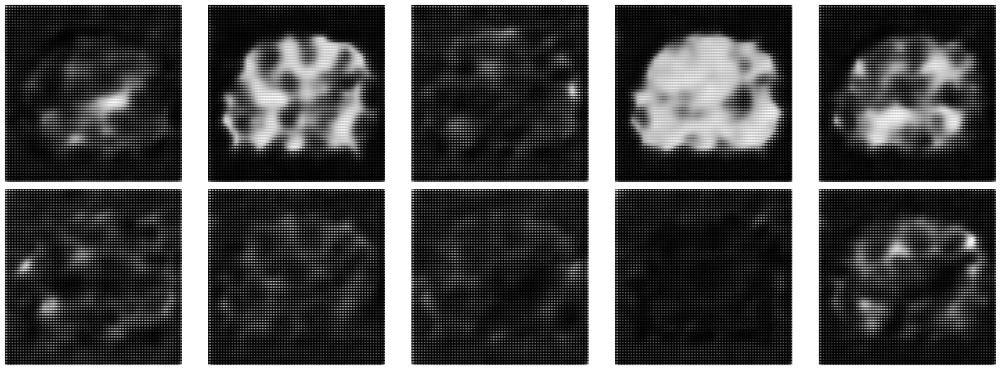

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<07:24,  8.43it/s]

1/1 [==============================] - 0s 127ms/step


  0%|                                          | 2/3750 [00:00<12:02,  5.19it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 3/3750 [00:00<09:57,  6.27it/s]

1/1 [==============================] - 0s 12ms/step


  0%|                                          | 4/3750 [00:00<09:04,  6.88it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<08:13,  7.59it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 6/3750 [00:00<08:20,  7.48it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 7/3750 [00:00<08:00,  7.78it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 8/3750 [00:01<07:33,  8.25it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 9/3750 [00:01<07:14,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 10/3750 [00:01<07:01,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 11/3750 [00:01<06:58,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                        | 12/3750 [00:01<07:07,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 13/3750 [00:01<08:18,  7.49it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 14/3750 [00:01<07:56,  7.85it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                        | 15/3750 [00:01<07:33,  8.23it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:02<07:15,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:02<07:00,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 18/3750 [00:02<06:50,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:44,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:02<06:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 21/3750 [00:02<06:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 22/3750 [00:02<06:37,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 23/3750 [00:02<06:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 24/3750 [00:02<06:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 25/3750 [00:02<06:36,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 26/3750 [00:03<06:34,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 27/3750 [00:03<06:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 28/3750 [00:03<06:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 29/3750 [00:03<06:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 30/3750 [00:03<06:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 31/3750 [00:03<06:39,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 32/3750 [00:03<06:46,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 33/3750 [00:03<06:47,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:52,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 35/3750 [00:04<06:57,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 36/3750 [00:04<07:06,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 37/3750 [00:04<07:11,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 38/3750 [00:04<07:08,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 39/3750 [00:04<07:15,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 40/3750 [00:04<07:05,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 41/3750 [00:04<06:54,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 42/3750 [00:04<06:49,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 43/3750 [00:04<07:03,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 44/3750 [00:05<06:56,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 45/3750 [00:05<07:10,  8.60it/s]

1/1 [==============================] - 0s 13ms/step


  1%|▌                                        | 46/3750 [00:05<07:11,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 47/3750 [00:05<07:00,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 48/3750 [00:05<06:56,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<06:49,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 50/3750 [00:05<07:04,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 51/3750 [00:05<07:02,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 52/3750 [00:06<06:57,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 53/3750 [00:06<06:55,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 54/3750 [00:06<06:50,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 55/3750 [00:06<06:54,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 56/3750 [00:06<06:55,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▌                                        | 57/3750 [00:06<06:54,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 58/3750 [00:06<07:02,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 59/3750 [00:06<07:13,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 60/3750 [00:06<07:17,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 61/3750 [00:07<07:18,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 62/3750 [00:07<07:21,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 63/3750 [00:07<07:24,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 64/3750 [00:07<07:16,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:07<07:06,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 66/3750 [00:07<07:06,  8.64it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▋                                        | 67/3750 [00:07<06:59,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 68/3750 [00:07<06:53,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 69/3750 [00:07<06:49,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 70/3750 [00:08<06:44,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:08<06:46,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▊                                        | 72/3750 [00:08<07:23,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 73/3750 [00:08<07:09,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 74/3750 [00:08<07:02,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 75/3750 [00:08<07:05,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 76/3750 [00:08<06:58,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 77/3750 [00:08<06:48,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 78/3750 [00:08<06:42,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:09<06:38,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 80/3750 [00:09<06:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 81/3750 [00:09<06:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 82/3750 [00:09<06:51,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 83/3750 [00:09<06:55,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 84/3750 [00:09<06:49,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:09<06:43,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 86/3750 [00:09<06:36,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 87/3750 [00:09<06:34,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:10<06:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:10<06:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 90/3750 [00:10<06:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 91/3750 [00:10<06:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:10<06:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 93/3750 [00:10<06:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:10<06:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:20,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 96/3750 [00:10<06:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:11<06:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:11<06:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:11<06:23,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:11<06:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 101/3750 [00:11<06:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 102/3750 [00:11<06:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:11<06:29,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 104/3750 [00:11<06:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 105/3750 [00:11<06:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 107/3750 [00:12<06:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 108/3750 [00:12<06:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:12<06:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:12<06:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:12<06:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:12<06:21,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<06:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 114/3750 [00:12<06:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 115/3750 [00:12<06:32,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


  3%|█▏                                      | 116/3750 [00:13<06:39,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 117/3750 [00:13<06:38,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 118/3750 [00:13<06:35,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 119/3750 [00:13<06:30,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 120/3750 [00:13<06:38,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


  3%|█▎                                      | 121/3750 [00:13<06:50,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 122/3750 [00:13<06:42,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:13<06:38,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:46,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 125/3750 [00:14<06:45,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 126/3750 [00:14<06:40,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 127/3750 [00:14<06:50,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 128/3750 [00:14<06:47,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 129/3750 [00:14<06:51,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▍                                      | 130/3750 [00:14<06:58,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▍                                      | 131/3750 [00:14<06:53,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:14<06:57,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 133/3750 [00:14<07:02,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 134/3750 [00:15<07:06,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 135/3750 [00:15<07:08,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 136/3750 [00:15<06:56,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 137/3750 [00:15<06:50,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:15<06:44,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 139/3750 [00:15<06:45,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 140/3750 [00:15<06:48,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 141/3750 [00:16<11:16,  5.34it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 142/3750 [00:16<10:01,  6.00it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▌                                      | 143/3750 [00:16<09:10,  6.55it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 144/3750 [00:16<09:15,  6.49it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 145/3750 [00:16<08:24,  7.14it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 146/3750 [00:16<07:48,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 147/3750 [00:16<07:22,  8.14it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 148/3750 [00:16<07:01,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 149/3750 [00:17<06:59,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 150/3750 [00:17<07:00,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 151/3750 [00:17<06:58,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 152/3750 [00:17<06:45,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:17<06:35,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:17<06:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:17<06:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 156/3750 [00:17<06:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:17<06:17,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 158/3750 [00:17<06:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 159/3750 [00:18<06:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 160/3750 [00:18<06:15,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:18<06:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 162/3750 [00:18<06:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:18<06:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 164/3750 [00:18<06:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 165/3750 [00:18<06:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:18<06:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:18<06:14,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 168/3750 [00:19<06:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 169/3750 [00:19<06:14,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:19<06:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:19<06:14,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 172/3750 [00:19<06:13,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:19<06:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:19<06:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:19<06:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 176/3750 [00:19<06:14,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 177/3750 [00:19<06:14,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 178/3750 [00:20<06:15,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 179/3750 [00:20<06:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:20<06:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 181/3750 [00:20<06:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 182/3750 [00:20<06:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 183/3750 [00:20<06:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:20<06:09,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 185/3750 [00:20<06:11,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 186/3750 [00:20<06:10,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 187/3750 [00:21<06:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 188/3750 [00:21<06:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 189/3750 [00:21<06:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:21<06:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 191/3750 [00:21<06:08,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 192/3750 [00:21<06:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:21<06:09,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 194/3750 [00:21<06:10,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 195/3750 [00:21<06:10,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:21<06:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:22<06:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 198/3750 [00:22<06:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:22<06:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:22<06:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:22<06:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:22<06:08,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 203/3750 [00:22<06:09,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 204/3750 [00:22<06:09,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 205/3750 [00:22<06:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:22<06:09,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 207/3750 [00:23<06:10,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 208/3750 [00:23<06:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 209/3750 [00:23<06:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 210/3750 [00:23<06:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:23<06:06,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:23<06:08,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 213/3750 [00:23<06:10,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 214/3750 [00:23<06:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 215/3750 [00:23<06:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:24<06:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 217/3750 [00:24<06:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 218/3750 [00:24<06:06,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 219/3750 [00:24<06:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:24<06:05,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 221/3750 [00:24<06:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:24<06:07,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 223/3750 [00:24<06:08,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 224/3750 [00:24<06:10,  9.52it/s]

1/1 [==============================] - 0s 15ms/step


  6%|██▍                                     | 225/3750 [00:25<07:02,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▍                                     | 226/3750 [00:25<06:55,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 227/3750 [00:25<07:19,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 228/3750 [00:25<07:03,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 229/3750 [00:25<06:48,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 230/3750 [00:25<06:42,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 231/3750 [00:25<06:34,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 232/3750 [00:25<06:27,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:25<06:20,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▍                                     | 234/3750 [00:26<06:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:26<06:23,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 236/3750 [00:26<06:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:26<06:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 238/3750 [00:26<06:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:26<06:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:26<06:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 241/3750 [00:26<06:20,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 242/3750 [00:26<06:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 243/3750 [00:27<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 244/3750 [00:27<06:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 245/3750 [00:27<06:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:27<06:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:27<06:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:27<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:27<06:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 250/3750 [00:27<06:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 251/3750 [00:27<06:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:27<06:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 253/3750 [00:28<06:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 254/3750 [00:28<06:17,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:28<06:15,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 256/3750 [00:28<06:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:28<06:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 258/3750 [00:28<06:12,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 259/3750 [00:28<06:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 260/3750 [00:28<06:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 261/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 262/3750 [00:29<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 263/3750 [00:29<06:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:29<06:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 265/3750 [00:29<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 266/3750 [00:29<06:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:29<06:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:29<06:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 269/3750 [00:29<06:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 270/3750 [00:29<06:11,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 271/3750 [00:30<06:14,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 272/3750 [00:30<06:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 273/3750 [00:30<06:13,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 274/3750 [00:30<06:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:30<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:30<06:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 277/3750 [00:30<06:06,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 278/3750 [00:30<06:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:30<06:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 280/3750 [00:30<06:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 281/3750 [00:31<06:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 282/3750 [00:31<06:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:31<06:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 284/3750 [00:31<06:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:31<06:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:31<06:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:31<06:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:31<06:17,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 289/3750 [00:31<06:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 290/3750 [00:32<06:18,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 291/3750 [00:32<06:18,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███                                     | 292/3750 [00:32<06:16,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 293/3750 [00:32<06:11,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 294/3750 [00:32<06:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:32<06:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 296/3750 [00:32<06:06,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 297/3750 [00:32<06:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:32<06:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:32<06:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:33<06:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 301/3750 [00:33<06:00,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 302/3750 [00:33<06:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 303/3750 [00:33<06:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 304/3750 [00:33<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 305/3750 [00:33<06:05,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 306/3750 [00:33<06:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:33<06:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:33<06:07,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 309/3750 [00:34<06:11,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 310/3750 [00:34<06:35,  8.70it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 311/3750 [00:34<06:46,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 312/3750 [00:34<06:49,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 313/3750 [00:34<06:45,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:34<06:35,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:34<06:26,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 316/3750 [00:34<06:25,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▍                                    | 317/3750 [00:34<06:35,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▍                                    | 318/3750 [00:35<06:30,  8.79it/s]

1/1 [==============================] - 0s 13ms/step


  9%|███▍                                    | 319/3750 [00:35<06:43,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 320/3750 [00:35<06:45,  8.46it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▍                                    | 321/3750 [00:35<06:58,  8.20it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▍                                    | 322/3750 [00:35<06:51,  8.32it/s]

1/1 [==============================] - 0s 14ms/step


  9%|███▍                                    | 323/3750 [00:35<06:51,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 324/3750 [00:35<06:40,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 325/3750 [00:35<06:34,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▍                                    | 326/3750 [00:36<06:39,  8.58it/s]

1/1 [==============================] - 0s 13ms/step


  9%|███▍                                    | 327/3750 [00:36<06:44,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 328/3750 [00:36<06:44,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:36<06:44,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 330/3750 [00:36<06:42,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▌                                    | 331/3750 [00:36<06:55,  8.23it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▌                                    | 332/3750 [00:36<07:05,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 333/3750 [00:36<07:04,  8.05it/s]

1/1 [==============================] - 0s 12ms/step


  9%|███▌                                    | 334/3750 [00:37<07:03,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 335/3750 [00:37<07:06,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 336/3750 [00:37<06:59,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 337/3750 [00:37<06:55,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 338/3750 [00:37<06:53,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 339/3750 [00:37<06:51,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 340/3750 [00:37<07:15,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 341/3750 [00:37<07:03,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 342/3750 [00:38<06:51,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 343/3750 [00:38<07:04,  8.02it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▋                                    | 344/3750 [00:38<07:02,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 345/3750 [00:38<06:57,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 346/3750 [00:38<06:40,  8.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 347/3750 [00:38<06:27,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:38<06:17,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:38<06:09,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:38<06:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:39<06:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 352/3750 [00:39<06:08,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 353/3750 [00:39<06:24,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▊                                    | 354/3750 [00:39<06:21,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 355/3750 [00:39<06:25,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 356/3750 [00:39<06:18,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 357/3750 [00:39<06:11,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 358/3750 [00:39<06:04,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 359/3750 [00:39<06:09,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 360/3750 [00:40<06:11,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 361/3750 [00:40<06:05,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 362/3750 [00:40<06:01,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 363/3750 [00:40<06:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 364/3750 [00:40<06:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 365/3750 [00:40<05:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 366/3750 [00:40<05:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:40<05:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 368/3750 [00:40<05:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 369/3750 [00:40<05:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 370/3750 [00:41<05:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 371/3750 [00:41<05:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:41<05:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 373/3750 [00:41<05:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:41<05:54,  9.52it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 375/3750 [00:41<06:03,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 376/3750 [00:41<06:21,  8.85it/s]

1/1 [==============================] - 0s 13ms/step


 10%|████                                    | 377/3750 [00:41<06:42,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 378/3750 [00:41<06:41,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 379/3750 [00:42<06:32,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 380/3750 [00:42<06:21,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 381/3750 [00:42<06:12,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 382/3750 [00:42<06:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 383/3750 [00:42<06:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 384/3750 [00:42<06:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 385/3750 [00:42<05:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 386/3750 [00:42<05:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 387/3750 [00:42<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 388/3750 [00:43<05:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:43<05:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 390/3750 [00:43<05:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:43<05:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 392/3750 [00:43<05:51,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 393/3750 [00:43<05:52,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 394/3750 [00:43<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:43<05:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 396/3750 [00:43<05:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 397/3750 [00:44<06:19,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 398/3750 [00:44<06:11,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:44<06:04,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:44<05:57,  9.36it/s]

1/1 [==============================] - 0s 18ms/step


 11%|████▎                                   | 401/3750 [00:44<06:43,  8.30it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 402/3750 [00:44<06:28,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 403/3750 [00:44<06:15,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 404/3750 [00:44<06:06,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:44<06:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 406/3750 [00:44<06:00,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 407/3750 [00:45<05:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 408/3750 [00:45<05:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:45<05:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:45<05:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 411/3750 [00:45<05:51,  9.49it/s]

1/1 [==============================] - 0s 13ms/step


 11%|████▍                                   | 412/3750 [00:45<06:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 413/3750 [00:45<06:03,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▍                                   | 414/3750 [00:45<06:05,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 415/3750 [00:45<06:01,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:46<06:01,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 417/3750 [00:46<05:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 418/3750 [00:46<05:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 419/3750 [00:46<05:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 420/3750 [00:46<05:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 421/3750 [00:46<05:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 422/3750 [00:46<05:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 423/3750 [00:46<05:47,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 424/3750 [00:46<05:48,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 425/3750 [00:47<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:47<05:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 427/3750 [00:47<05:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:47<05:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:47<05:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 430/3750 [00:47<05:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 431/3750 [00:47<05:56,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 432/3750 [00:47<05:53,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 433/3750 [00:47<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:47<05:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:48<05:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 436/3750 [00:48<05:45,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:48<05:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 438/3750 [00:48<05:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 439/3750 [00:48<05:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:48<05:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:48<05:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:48<06:03,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 443/3750 [00:48<06:01,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 444/3750 [00:49<05:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 445/3750 [00:49<05:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 446/3750 [00:49<05:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:49<05:45,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:49<05:44,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:49<05:43,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:49<05:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:49<05:40,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 452/3750 [00:49<05:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 453/3750 [00:49<05:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:50<05:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:50<05:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 456/3750 [00:50<05:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 457/3750 [00:50<05:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 458/3750 [00:50<05:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 459/3750 [00:50<05:41,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 460/3750 [00:50<05:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:50<05:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:50<05:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:50<05:41,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 464/3750 [00:51<05:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 465/3750 [00:51<05:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 466/3750 [00:51<05:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 467/3750 [00:51<05:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 468/3750 [00:51<05:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 469/3750 [00:51<05:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:51<05:42,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 471/3750 [00:51<05:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:51<05:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 473/3750 [00:52<05:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:52<05:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 475/3750 [00:52<05:40,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 476/3750 [00:52<05:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:52<05:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 478/3750 [00:52<05:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 479/3750 [00:52<05:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:52<05:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:52<05:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 482/3750 [00:52<05:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 483/3750 [00:53<05:36,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 484/3750 [00:53<05:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 485/3750 [00:53<05:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 486/3750 [00:53<05:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 487/3750 [00:53<05:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 488/3750 [00:53<05:39,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 489/3750 [00:53<05:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 490/3750 [00:53<05:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 491/3750 [00:53<05:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 492/3750 [00:54<05:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 493/3750 [00:54<05:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 494/3750 [00:54<05:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 495/3750 [00:54<05:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 496/3750 [00:54<05:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 497/3750 [00:54<05:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 498/3750 [00:54<05:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 499/3750 [00:54<05:38,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 500/3750 [00:54<05:39,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 501/3750 [00:54<05:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 502/3750 [00:55<05:39,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:55<05:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 504/3750 [00:55<05:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:55<05:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:55<05:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:55<05:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 508/3750 [00:55<05:36,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 509/3750 [00:55<05:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:55<05:35,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 511/3750 [00:55<05:34,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 512/3750 [00:56<05:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:56<05:34,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 514/3750 [00:56<05:34,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:56<05:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 516/3750 [00:56<05:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:56<05:35,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 518/3750 [00:56<05:36,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 519/3750 [00:56<05:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 520/3750 [00:56<05:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 521/3750 [00:57<05:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 522/3750 [00:57<05:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 523/3750 [00:57<05:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 524/3750 [00:57<05:36,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 525/3750 [00:57<05:36,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 526/3750 [00:57<05:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 527/3750 [00:57<05:36,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:57<05:35,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 529/3750 [00:57<05:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:57<05:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:58<05:32,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 532/3750 [00:58<05:32,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 533/3750 [00:58<05:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 534/3750 [00:58<05:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 535/3750 [00:58<05:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [00:58<05:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [00:58<05:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 538/3750 [00:58<05:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 539/3750 [00:58<05:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 540/3750 [00:59<05:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 541/3750 [00:59<05:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 542/3750 [00:59<05:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 543/3750 [00:59<05:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 544/3750 [00:59<05:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 545/3750 [00:59<05:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 546/3750 [00:59<05:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 547/3750 [00:59<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 548/3750 [00:59<05:37,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 549/3750 [00:59<05:42,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 550/3750 [01:00<05:40,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [01:00<05:36,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 552/3750 [01:00<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 553/3750 [01:00<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 554/3750 [01:00<05:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [01:00<05:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 556/3750 [01:00<05:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 557/3750 [01:00<05:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [01:00<05:31,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 559/3750 [01:01<05:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 560/3750 [01:01<05:31,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:01<05:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 562/3750 [01:01<05:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 563/3750 [01:01<05:34,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 564/3750 [01:01<05:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 565/3750 [01:01<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 566/3750 [01:01<05:38,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 567/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 569/3750 [01:02<05:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:02<05:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 571/3750 [01:02<05:53,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 572/3750 [01:02<05:49,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 573/3750 [01:02<05:51,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:02<05:45,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 575/3750 [01:02<05:41,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 576/3750 [01:02<05:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:02<05:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 578/3750 [01:03<05:36,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 579/3750 [01:03<05:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 580/3750 [01:03<05:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 581/3750 [01:03<05:41,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▏                                 | 582/3750 [01:03<05:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:03<05:40,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 584/3750 [01:03<05:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 585/3750 [01:03<05:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 586/3750 [01:03<05:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 587/3750 [01:04<05:30,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 588/3750 [01:04<05:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:04<05:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 590/3750 [01:04<05:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 591/3750 [01:04<05:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 592/3750 [01:04<05:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:04<05:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 594/3750 [01:04<05:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 595/3750 [01:04<05:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 596/3750 [01:04<05:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 597/3750 [01:05<05:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 598/3750 [01:05<05:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 599/3750 [01:05<05:48,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 600/3750 [01:05<05:44,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 601/3750 [01:05<05:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 602/3750 [01:05<05:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 603/3750 [01:05<05:50,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▍                                 | 604/3750 [01:05<06:11,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 605/3750 [01:05<06:01,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 606/3750 [01:06<05:53,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 607/3750 [01:06<05:47,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 608/3750 [01:06<05:42,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 609/3750 [01:06<05:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 610/3750 [01:06<05:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 611/3750 [01:06<05:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 612/3750 [01:06<05:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:06<05:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 615/3750 [01:07<05:41,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▌                                 | 616/3750 [01:07<05:54,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:07<06:00,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:07<05:52,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:07<05:45,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 620/3750 [01:07<05:41,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 621/3750 [01:07<05:35,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▋                                 | 622/3750 [01:07<05:43,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 623/3750 [01:07<05:45,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 624/3750 [01:08<05:46,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 625/3750 [01:08<05:48,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 626/3750 [01:08<05:46,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▋                                 | 627/3750 [01:08<05:48,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 628/3750 [01:08<05:46,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 629/3750 [01:08<05:40,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 630/3750 [01:08<05:34,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 631/3750 [01:08<05:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 632/3750 [01:08<05:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 633/3750 [01:09<05:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 634/3750 [01:09<05:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 635/3750 [01:09<05:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 636/3750 [01:09<05:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 637/3750 [01:09<05:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 638/3750 [01:09<05:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 639/3750 [01:09<05:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 640/3750 [01:09<05:23,  9.61it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 641/3750 [01:09<05:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 642/3750 [01:09<05:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 643/3750 [01:10<05:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 644/3750 [01:10<05:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 645/3750 [01:10<05:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 646/3750 [01:10<05:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 647/3750 [01:10<05:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 648/3750 [01:10<05:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 649/3750 [01:10<05:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 650/3750 [01:10<05:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 651/3750 [01:10<05:21,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:10<05:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 653/3750 [01:11<05:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:11<05:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 655/3750 [01:11<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 656/3750 [01:11<05:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 657/3750 [01:11<05:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 658/3750 [01:11<05:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:11<05:21,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 660/3750 [01:11<05:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:11<05:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 662/3750 [01:12<05:21,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 663/3750 [01:12<05:21,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:12<05:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 665/3750 [01:12<05:23,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 666/3750 [01:12<05:28,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 667/3750 [01:12<05:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 668/3750 [01:12<05:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 669/3750 [01:12<05:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 670/3750 [01:12<05:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:12<05:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 672/3750 [01:13<05:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 673/3750 [01:13<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 674/3750 [01:13<05:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 675/3750 [01:13<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 676/3750 [01:13<05:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 677/3750 [01:13<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 678/3750 [01:13<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 679/3750 [01:13<05:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 680/3750 [01:13<05:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 681/3750 [01:14<05:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 682/3750 [01:14<05:21,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:14<05:21,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 684/3750 [01:14<05:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 685/3750 [01:14<05:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 686/3750 [01:14<05:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 687/3750 [01:14<05:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 688/3750 [01:14<05:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 689/3750 [01:14<05:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 690/3750 [01:14<05:18,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 691/3750 [01:15<05:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 692/3750 [01:15<05:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 693/3750 [01:15<05:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 694/3750 [01:15<05:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 695/3750 [01:15<05:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 696/3750 [01:15<05:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 697/3750 [01:15<05:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:15<05:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 699/3750 [01:15<05:16,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:16<05:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 701/3750 [01:16<05:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:16<05:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 703/3750 [01:16<05:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 704/3750 [01:16<05:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 705/3750 [01:16<05:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 706/3750 [01:16<05:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:16<05:32,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 708/3750 [01:16<05:37,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:17<05:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 710/3750 [01:17<05:27,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 711/3750 [01:17<05:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:17<05:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:17<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 714/3750 [01:17<05:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:17<05:15,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:17<05:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:17<05:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:17<05:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 719/3750 [01:18<05:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 720/3750 [01:18<05:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 721/3750 [01:18<05:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 722/3750 [01:18<05:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:18<05:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 724/3750 [01:18<05:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:18<05:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 726/3750 [01:18<05:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 727/3750 [01:18<05:15,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 728/3750 [01:18<05:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:19<05:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 730/3750 [01:19<05:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 731/3750 [01:19<05:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:19<05:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 733/3750 [01:19<05:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 734/3750 [01:19<05:12,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 735/3750 [01:19<05:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:19<05:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 737/3750 [01:19<05:19,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 738/3750 [01:20<05:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 739/3750 [01:20<05:25,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 740/3750 [01:20<05:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:20<05:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:20<05:26,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:20<05:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 744/3750 [01:20<05:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 745/3750 [01:20<05:25,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 746/3750 [01:20<05:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:21<05:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 748/3750 [01:21<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 749/3750 [01:21<05:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 750/3750 [01:21<05:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 751/3750 [01:21<05:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 752/3750 [01:21<05:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:21<05:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 754/3750 [01:21<05:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 755/3750 [01:21<05:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 756/3750 [01:21<05:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 757/3750 [01:22<05:10,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:22<05:09,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 759/3750 [01:22<05:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:22<05:11,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:22<05:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:22<05:12,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 763/3750 [01:22<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:22<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 765/3750 [01:22<05:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 766/3750 [01:22<05:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:23<05:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:23<05:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:23<05:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 770/3750 [01:23<05:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:23<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 772/3750 [01:23<05:13,  9.50it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▏                               | 773/3750 [01:23<05:30,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 774/3750 [01:23<05:29,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 775/3750 [01:23<05:28,  9.06it/s]

1/1 [==============================] - 0s 41ms/step


 21%|████████▎                               | 776/3750 [01:24<07:13,  6.87it/s]

1/1 [==============================] - 0s 12ms/step


 21%|████████▎                               | 777/3750 [01:24<07:02,  7.04it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 778/3750 [01:24<06:33,  7.55it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 779/3750 [01:24<06:14,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:24<05:59,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 781/3750 [01:24<05:55,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 782/3750 [01:24<05:56,  8.31it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 783/3750 [01:24<05:44,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 784/3750 [01:25<05:33,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:25<05:25,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 786/3750 [01:25<05:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 787/3750 [01:25<05:19,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 788/3750 [01:25<05:16,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 789/3750 [01:25<05:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 790/3750 [01:25<05:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 791/3750 [01:25<05:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 792/3750 [01:25<05:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 793/3750 [01:26<05:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 794/3750 [01:26<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 795/3750 [01:26<05:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 796/3750 [01:26<05:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 797/3750 [01:26<05:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 798/3750 [01:26<05:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 799/3750 [01:26<05:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:26<05:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 801/3750 [01:26<05:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 802/3750 [01:26<05:06,  9.61it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▌                               | 803/3750 [01:27<05:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 804/3750 [01:27<05:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:27<05:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 806/3750 [01:27<05:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 807/3750 [01:27<05:05,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 808/3750 [01:27<05:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 809/3750 [01:27<05:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:27<05:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 811/3750 [01:27<05:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 812/3750 [01:28<05:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 813/3750 [01:28<05:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:28<05:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 815/3750 [01:28<05:03,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:28<05:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 817/3750 [01:28<05:04,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 818/3750 [01:28<05:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 819/3750 [01:28<05:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 820/3750 [01:28<05:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 821/3750 [01:28<05:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 822/3750 [01:29<05:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 823/3750 [01:29<05:02,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 824/3750 [01:29<05:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 825/3750 [01:29<05:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 826/3750 [01:29<05:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 827/3750 [01:29<05:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:29<05:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:29<05:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 830/3750 [01:29<05:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 831/3750 [01:30<05:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 832/3750 [01:30<05:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 833/3750 [01:30<05:01,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:30<05:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 835/3750 [01:30<05:01,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 836/3750 [01:30<05:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 837/3750 [01:30<05:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:30<05:05,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 839/3750 [01:30<05:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 840/3750 [01:30<05:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:31<05:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 842/3750 [01:31<05:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 843/3750 [01:31<05:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 844/3750 [01:31<05:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 845/3750 [01:31<05:02,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 846/3750 [01:31<05:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 847/3750 [01:31<05:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 848/3750 [01:31<05:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 849/3750 [01:31<05:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 850/3750 [01:31<05:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 851/3750 [01:32<05:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 852/3750 [01:32<04:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 853/3750 [01:32<04:59,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 854/3750 [01:32<05:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 855/3750 [01:32<05:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 856/3750 [01:32<04:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 857/3750 [01:32<04:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 858/3750 [01:32<04:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 859/3750 [01:32<04:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 860/3750 [01:33<04:58,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:33<04:57,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 862/3750 [01:33<04:57,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 863/3750 [01:33<05:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:33<04:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:33<04:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 866/3750 [01:33<04:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 867/3750 [01:33<04:57,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 868/3750 [01:33<04:57,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:33<04:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:34<04:57,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 871/3750 [01:34<04:57,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:34<04:59,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 873/3750 [01:34<05:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 874/3750 [01:34<05:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 875/3750 [01:34<05:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:34<04:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 877/3750 [01:34<04:59,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 878/3750 [01:34<04:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 879/3750 [01:34<05:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 880/3750 [01:35<04:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 881/3750 [01:35<04:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 882/3750 [01:35<04:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 883/3750 [01:35<04:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 884/3750 [01:35<04:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:35<04:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 886/3750 [01:35<04:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 887/3750 [01:35<04:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 888/3750 [01:35<04:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:36<04:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 890/3750 [01:36<04:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 891/3750 [01:36<04:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:36<04:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:36<04:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:36<04:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 895/3750 [01:36<04:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 896/3750 [01:36<04:56,  9.61it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 897/3750 [01:36<05:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 898/3750 [01:36<05:00,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:37<05:01,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 900/3750 [01:37<05:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:37<05:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 902/3750 [01:37<05:11,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 903/3750 [01:37<05:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 904/3750 [01:37<05:06,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 905/3750 [01:37<05:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:37<05:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 907/3750 [01:37<04:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 908/3750 [01:38<04:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 909/3750 [01:38<04:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:38<04:56,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 911/3750 [01:38<04:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:38<04:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 913/3750 [01:38<04:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 914/3750 [01:38<04:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:38<04:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 916/3750 [01:38<04:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 917/3750 [01:38<04:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 918/3750 [01:39<04:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 919/3750 [01:39<04:53,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 920/3750 [01:39<04:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 921/3750 [01:39<04:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 922/3750 [01:39<04:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 923/3750 [01:39<04:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 924/3750 [01:39<04:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 925/3750 [01:39<04:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 926/3750 [01:39<04:51,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:40<04:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 928/3750 [01:40<04:53,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:40<04:56,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:40<04:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:40<05:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:40<05:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 933/3750 [01:40<05:02,  9.31it/s]

1/1 [==============================] - 0s 12ms/step


 25%|█████████▉                              | 934/3750 [01:40<05:18,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 935/3750 [01:40<05:20,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 936/3750 [01:41<05:19,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 937/3750 [01:41<05:13,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 938/3750 [01:41<05:10,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 939/3750 [01:41<05:06,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 940/3750 [01:41<05:07,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 941/3750 [01:41<05:04,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 942/3750 [01:41<05:04,  9.22it/s]

1/1 [==============================] - 0s 12ms/step


 25%|██████████                              | 943/3750 [01:41<05:05,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 944/3750 [01:41<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 945/3750 [01:41<05:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:42<04:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 947/3750 [01:42<04:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 948/3750 [01:42<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 949/3750 [01:42<04:54,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 950/3750 [01:42<05:03,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 951/3750 [01:42<05:11,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 952/3750 [01:42<05:10,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 953/3750 [01:42<05:05,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 954/3750 [01:42<05:01,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 955/3750 [01:43<05:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 956/3750 [01:43<05:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 957/3750 [01:43<04:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 958/3750 [01:43<05:06,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▏                             | 959/3750 [01:43<05:13,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 960/3750 [01:43<05:16,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 961/3750 [01:43<05:10,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 962/3750 [01:43<05:04,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 963/3750 [01:43<05:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 964/3750 [01:44<04:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:44<04:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 966/3750 [01:44<04:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 967/3750 [01:44<05:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 968/3750 [01:44<04:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 969/3750 [01:44<04:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 970/3750 [01:44<04:52,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 971/3750 [01:44<04:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:44<04:57,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 973/3750 [01:45<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 974/3750 [01:45<05:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 975/3750 [01:45<05:00,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 976/3750 [01:45<05:00,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 977/3750 [01:45<05:00,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 978/3750 [01:45<05:00,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 979/3750 [01:45<04:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 980/3750 [01:45<04:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 981/3750 [01:45<04:59,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:45<04:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:46<04:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 984/3750 [01:46<04:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:46<04:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:46<04:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 987/3750 [01:46<04:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 988/3750 [01:46<04:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:46<04:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 990/3750 [01:46<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 991/3750 [01:46<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 992/3750 [01:47<04:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 993/3750 [01:47<04:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 994/3750 [01:47<04:45,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 995/3750 [01:47<04:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:47<04:44,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 997/3750 [01:47<04:44,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 998/3750 [01:47<04:43,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 999/3750 [01:47<04:43,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1000/3750 [01:47<04:44,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1001/3750 [01:47<04:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1002/3750 [01:48<04:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1003/3750 [01:48<04:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1004/3750 [01:48<04:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1005/3750 [01:48<04:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1006/3750 [01:48<04:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1007/3750 [01:48<04:43,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1008/3750 [01:48<04:42,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1009/3750 [01:48<04:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:48<04:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1011/3750 [01:48<04:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1012/3750 [01:49<04:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1013/3750 [01:49<04:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1014/3750 [01:49<04:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1015/3750 [01:49<04:42,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1016/3750 [01:49<04:41,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1017/3750 [01:49<04:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1018/3750 [01:49<04:41,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:49<04:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1020/3750 [01:49<04:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:50<04:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:50<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:50<04:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1024/3750 [01:50<04:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1025/3750 [01:50<04:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1026/3750 [01:50<04:40,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1027/3750 [01:50<04:40,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:50<04:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:50<04:40,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1030/3750 [01:50<04:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:51<04:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [01:51<04:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [01:51<04:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:51<04:40,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1035/3750 [01:51<04:39,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [01:51<04:39,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [01:51<04:41,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:51<04:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [01:51<04:42,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1040/3750 [01:51<04:42,  9.58it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████▊                            | 1041/3750 [01:52<04:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:52<04:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1043/3750 [01:52<04:50,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1044/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:52<04:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1046/3750 [01:52<04:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1047/3750 [01:52<04:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1048/3750 [01:52<04:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1049/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 13ms/step


 28%|██████████▉                            | 1050/3750 [01:53<05:00,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1051/3750 [01:53<05:00,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1052/3750 [01:53<04:56,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1053/3750 [01:53<04:53,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:53<04:49,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:53<04:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [01:53<04:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1057/3750 [01:53<04:58,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 28%|███████████                            | 1058/3750 [01:53<05:06,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1059/3750 [01:54<05:00,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1060/3750 [01:54<04:54,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1061/3750 [01:54<04:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1062/3750 [01:54<04:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1063/3750 [01:54<04:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [01:54<04:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1065/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [01:54<04:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [01:54<04:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [01:55<04:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████                            | 1069/3750 [01:55<04:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [01:55<04:37,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1071/3750 [01:55<04:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1072/3750 [01:55<04:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1073/3750 [01:55<04:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [01:55<04:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [01:55<04:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:55<04:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [01:55<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:56<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [01:56<04:44,  9.40it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▏                           | 1080/3750 [01:56<04:53,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1081/3750 [01:56<04:50,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:56<04:48,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:56<04:47,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1084/3750 [01:56<04:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [01:56<04:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [01:56<04:50,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▎                           | 1087/3750 [01:57<04:56,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [01:57<04:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1089/3750 [01:57<04:50,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1090/3750 [01:57<04:48,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1091/3750 [01:57<04:49,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:57<04:51,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:57<04:48,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1094/3750 [01:57<04:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1095/3750 [01:57<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1096/3750 [01:58<04:43,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1097/3750 [01:58<04:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1098/3750 [01:58<04:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [01:58<04:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [01:58<04:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1101/3750 [01:58<04:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1102/3750 [01:58<04:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1103/3750 [01:58<04:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [01:58<04:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [01:58<04:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▌                           | 1106/3750 [01:59<04:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1107/3750 [01:59<04:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [01:59<05:27,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1109/3750 [01:59<05:14,  8.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1110/3750 [01:59<05:03,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1111/3750 [01:59<04:59,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1112/3750 [01:59<04:55,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1113/3750 [01:59<04:50,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [01:59<04:45,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1115/3750 [02:00<04:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [02:00<04:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [02:00<04:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [02:00<04:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1119/3750 [02:00<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1120/3750 [02:00<04:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1121/3750 [02:00<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1122/3750 [02:00<04:43,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1123/3750 [02:00<04:45,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1124/3750 [02:01<04:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:01<04:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [02:01<04:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [02:01<04:37,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1128/3750 [02:01<04:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1129/3750 [02:01<04:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1130/3750 [02:01<04:37,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1131/3750 [02:01<04:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:01<04:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [02:02<04:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:02<04:39,  9.35it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███████████▊                           | 1135/3750 [02:02<05:37,  7.75it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1136/3750 [02:02<05:18,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1137/3750 [02:02<05:07,  8.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1138/3750 [02:02<04:57,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:02<04:53,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1140/3750 [02:02<04:47,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1141/3750 [02:02<04:45,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1142/3750 [02:03<04:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1143/3750 [02:03<04:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1144/3750 [02:03<04:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1145/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:03<04:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1147/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:03<04:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1149/3750 [02:03<04:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1150/3750 [02:03<04:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1151/3750 [02:03<04:32,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1152/3750 [02:04<04:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1153/3750 [02:04<04:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1154/3750 [02:04<04:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:04<05:00,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1156/3750 [02:04<04:53,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:04<04:45,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:04<04:41,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:04<04:37,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:04<04:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1161/3750 [02:05<04:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1162/3750 [02:05<04:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:05<04:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1164/3750 [02:05<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:05<04:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:05<04:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1167/3750 [02:05<04:31,  9.52it/s]

1/1 [==============================] - 0s 16ms/step


 31%|████████████▏                          | 1168/3750 [02:05<05:05,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1169/3750 [02:05<04:57,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1170/3750 [02:06<04:50,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1171/3750 [02:06<04:48,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1172/3750 [02:06<04:53,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 31%|████████████▏                          | 1173/3750 [02:06<05:06,  8.42it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:06<04:57,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:06<04:49,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1176/3750 [02:06<04:43,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1177/3750 [02:06<05:16,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1178/3750 [02:07<05:04,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1179/3750 [02:07<04:55,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:07<04:46,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1181/3750 [02:07<04:40,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:07<04:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1183/3750 [02:07<04:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1184/3750 [02:07<04:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1185/3750 [02:07<04:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:07<04:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1187/3750 [02:07<04:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:08<04:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1189/3750 [02:08<04:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:08<04:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:08<04:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1192/3750 [02:08<04:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:08<04:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1194/3750 [02:08<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1195/3750 [02:08<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1196/3750 [02:08<04:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1197/3750 [02:08<04:26,  9.58it/s]

1/1 [==============================] - 0s 15ms/step


 32%|████████████▍                          | 1198/3750 [02:09<04:41,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1199/3750 [02:09<04:38,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:09<04:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:09<04:32,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1202/3750 [02:09<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:09<04:36,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:09<04:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1205/3750 [02:09<04:31,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▌                          | 1206/3750 [02:10<08:03,  5.26it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:10<06:58,  6.08it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1208/3750 [02:10<06:13,  6.80it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1209/3750 [02:10<05:44,  7.38it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:10<05:26,  7.79it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:10<05:08,  8.22it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:10<04:55,  8.59it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1213/3750 [02:10<04:45,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1214/3750 [02:11<04:40,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1215/3750 [02:11<04:35,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1216/3750 [02:11<04:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1217/3750 [02:11<04:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:11<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:11<04:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1220/3750 [02:11<04:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1221/3750 [02:11<04:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1222/3750 [02:11<04:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1223/3750 [02:12<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:12<04:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1225/3750 [02:12<04:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:12<04:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1227/3750 [02:12<04:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:12<04:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:12<04:23,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1230/3750 [02:12<04:23,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1231/3750 [02:12<04:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1232/3750 [02:12<04:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1233/3750 [02:13<04:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:13<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:13<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:13<04:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1237/3750 [02:13<04:21,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1238/3750 [02:13<04:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1239/3750 [02:13<04:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:13<04:21,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:13<04:23,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1242/3750 [02:14<04:22,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1243/3750 [02:14<04:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1244/3750 [02:14<04:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1245/3750 [02:14<04:20,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1246/3750 [02:14<04:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1247/3750 [02:14<04:21,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1248/3750 [02:14<04:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1249/3750 [02:14<04:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1250/3750 [02:14<04:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1251/3750 [02:14<04:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:15<04:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1253/3750 [02:15<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:15<04:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:15<04:22,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:15<04:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:15<04:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:15<04:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:15<04:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1260/3750 [02:15<04:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1261/3750 [02:16<04:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:16<04:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1263/3750 [02:16<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:16<04:18,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1265/3750 [02:16<04:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:16<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:16<04:18,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1268/3750 [02:16<04:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1269/3750 [02:16<04:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1270/3750 [02:16<04:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1271/3750 [02:17<04:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1272/3750 [02:17<04:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:17<04:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:17<04:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:17<04:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:17<04:15,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1277/3750 [02:17<04:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:17<04:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:17<04:17,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1280/3750 [02:18<04:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:18<04:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1282/3750 [02:18<04:15,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1283/3750 [02:18<04:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:18<04:15,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1285/3750 [02:18<04:15,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:18<04:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1287/3750 [02:18<04:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1288/3750 [02:18<04:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:18<04:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1290/3750 [02:19<04:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1291/3750 [02:19<04:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1292/3750 [02:19<04:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1293/3750 [02:19<04:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:19<04:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:19<04:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:19<04:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1297/3750 [02:19<04:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1298/3750 [02:19<04:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1299/3750 [02:19<04:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1300/3750 [02:20<04:12,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1301/3750 [02:20<04:12,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1302/3750 [02:20<04:12,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1303/3750 [02:20<04:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:20<04:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1305/3750 [02:20<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1306/3750 [02:20<04:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1307/3750 [02:20<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1308/3750 [02:20<04:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1309/3750 [02:21<04:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1310/3750 [02:21<04:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1311/3750 [02:21<04:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:21<04:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1313/3750 [02:21<04:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1314/3750 [02:21<04:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1315/3750 [02:21<04:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:21<04:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1317/3750 [02:21<04:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1318/3750 [02:21<04:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1319/3750 [02:22<04:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:22<04:12,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1321/3750 [02:22<04:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:22<04:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1323/3750 [02:22<04:12,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1324/3750 [02:22<04:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1325/3750 [02:22<04:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:22<04:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1327/3750 [02:22<04:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1328/3750 [02:22<04:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1329/3750 [02:23<04:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1330/3750 [02:23<04:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1331/3750 [02:23<04:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1332/3750 [02:23<04:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1333/3750 [02:23<04:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1334/3750 [02:23<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1335/3750 [02:23<04:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1336/3750 [02:23<04:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1337/3750 [02:23<04:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1338/3750 [02:24<04:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1339/3750 [02:24<04:09,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1340/3750 [02:24<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1341/3750 [02:24<04:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1342/3750 [02:24<04:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1343/3750 [02:24<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1344/3750 [02:24<04:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1345/3750 [02:24<04:12,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1346/3750 [02:24<04:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1347/3750 [02:24<04:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1348/3750 [02:25<04:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:25<04:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:25<04:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:25<04:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:25<04:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1353/3750 [02:25<04:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1354/3750 [02:25<04:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1355/3750 [02:25<04:12,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1356/3750 [02:25<04:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1357/3750 [02:26<04:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:26<04:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1359/3750 [02:26<04:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1360/3750 [02:26<04:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:26<04:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:26<04:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1363/3750 [02:26<04:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1364/3750 [02:26<04:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1365/3750 [02:26<04:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:26<04:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:27<04:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:27<04:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:27<04:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:27<04:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:27<04:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1372/3750 [02:27<04:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:27<04:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:27<04:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:27<04:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1376/3750 [02:28<04:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:28<04:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1378/3750 [02:28<04:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:28<04:06,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1380/3750 [02:28<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:28<04:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1382/3750 [02:28<04:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:28<04:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:28<04:04,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1385/3750 [02:28<04:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:29<04:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1387/3750 [02:29<04:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:29<04:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1389/3750 [02:29<04:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:29<04:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:29<04:05,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1392/3750 [02:29<04:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:29<04:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:29<04:05,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1395/3750 [02:30<04:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1396/3750 [02:30<04:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1397/3750 [02:30<04:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:30<04:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1399/3750 [02:30<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:30<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1401/3750 [02:30<04:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1402/3750 [02:30<04:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1403/3750 [02:30<04:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1404/3750 [02:30<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1405/3750 [02:31<04:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:31<04:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1407/3750 [02:31<04:03,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1408/3750 [02:31<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1409/3750 [02:31<04:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1410/3750 [02:31<04:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1411/3750 [02:31<04:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:31<04:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:31<04:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:31<04:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:32<04:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1416/3750 [02:32<04:01,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:32<04:00,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:32<04:00,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1419/3750 [02:32<04:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:32<04:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1421/3750 [02:32<04:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1422/3750 [02:32<04:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1423/3750 [02:32<04:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1424/3750 [02:33<04:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:33<04:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1426/3750 [02:33<04:00,  9.66it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1427/3750 [02:33<04:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1428/3750 [02:33<04:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1429/3750 [02:33<04:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1430/3750 [02:33<03:59,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:33<04:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1432/3750 [02:33<04:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:33<04:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1434/3750 [02:34<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1435/3750 [02:34<04:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1436/3750 [02:34<04:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1437/3750 [02:34<04:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1438/3750 [02:34<04:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1439/3750 [02:34<04:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1440/3750 [02:34<04:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:34<04:01,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1442/3750 [02:34<04:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|███████████████                        | 1443/3750 [02:35<03:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1444/3750 [02:35<03:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1445/3750 [02:35<03:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:35<03:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:35<03:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1448/3750 [02:35<03:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1449/3750 [02:35<03:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1450/3750 [02:35<04:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1451/3750 [02:35<04:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:35<03:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1453/3750 [02:36<03:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:36<03:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1455/3750 [02:36<03:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:36<03:57,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1457/3750 [02:36<03:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1458/3750 [02:36<03:56,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1459/3750 [02:36<03:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1460/3750 [02:36<03:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:36<03:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:36<03:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1463/3750 [02:37<03:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:37<03:56,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:37<03:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1466/3750 [02:37<03:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:37<03:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:37<03:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:37<03:57,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1470/3750 [02:37<03:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1471/3750 [02:37<04:01,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1472/3750 [02:38<04:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1473/3750 [02:38<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:38<03:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:38<03:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:38<03:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:38<03:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1478/3750 [02:38<03:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1479/3750 [02:38<03:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:38<03:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:38<03:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1482/3750 [02:39<03:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1483/3750 [02:39<03:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1484/3750 [02:39<03:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1485/3750 [02:39<03:53,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1486/3750 [02:39<03:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1487/3750 [02:39<03:53,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1488/3750 [02:39<03:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1489/3750 [02:39<03:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1490/3750 [02:39<03:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1491/3750 [02:39<03:52,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1492/3750 [02:40<03:52,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1493/3750 [02:40<03:52,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1494/3750 [02:40<03:52,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1495/3750 [02:40<03:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1496/3750 [02:40<03:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1497/3750 [02:40<03:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1498/3750 [02:40<03:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1499/3750 [02:40<03:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1500/3750 [02:40<03:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1501/3750 [02:41<03:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1502/3750 [02:41<03:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1503/3750 [02:41<03:51,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:41<03:53,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:41<03:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:41<03:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:41<03:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:41<03:52,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1509/3750 [02:41<03:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:41<03:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:42<03:52,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:42<03:51,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1513/3750 [02:42<03:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1514/3750 [02:42<03:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1515/3750 [02:42<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:42<03:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:42<03:53,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1518/3750 [02:42<03:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1519/3750 [02:42<03:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1520/3750 [02:43<03:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:43<03:50,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1522/3750 [02:43<03:50,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1523/3750 [02:43<03:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1524/3750 [02:43<03:51,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1525/3750 [02:43<03:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1526/3750 [02:43<03:49,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1527/3750 [02:43<03:50,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1528/3750 [02:43<03:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1529/3750 [02:43<03:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:44<03:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1531/3750 [02:44<03:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1532/3750 [02:44<03:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1533/3750 [02:44<03:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1534/3750 [02:44<03:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1535/3750 [02:44<03:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1536/3750 [02:44<03:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1537/3750 [02:44<03:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1538/3750 [02:44<03:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1539/3750 [02:44<03:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1540/3750 [02:45<03:48,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1541/3750 [02:45<03:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1542/3750 [02:45<04:00,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1543/3750 [02:45<03:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:45<03:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1545/3750 [02:45<03:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:45<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:45<03:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1548/3750 [02:45<03:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1549/3750 [02:46<03:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1550/3750 [02:46<03:48,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1551/3750 [02:46<03:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:46<03:49,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1553/3750 [02:46<03:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1554/3750 [02:46<03:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:46<03:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:46<03:50,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:46<03:49,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1558/3750 [02:46<03:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1559/3750 [02:47<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1560/3750 [02:47<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1561/3750 [02:47<03:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1562/3750 [02:47<03:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:47<03:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:47<03:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1565/3750 [02:47<03:47,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1566/3750 [02:47<03:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:47<03:47,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:48<03:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:48<03:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:48<03:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:48<03:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:48<03:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1573/3750 [02:48<03:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1574/3750 [02:48<03:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:48<03:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:48<03:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:48<03:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1578/3750 [02:49<03:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:49<03:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1580/3750 [02:49<03:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1581/3750 [02:49<03:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:49<03:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:49<03:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:49<03:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1585/3750 [02:49<03:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1586/3750 [02:49<03:43,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:49<03:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1588/3750 [02:50<03:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:50<03:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:50<03:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:50<03:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:50<03:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:50<03:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1594/3750 [02:50<03:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1595/3750 [02:50<03:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:50<03:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:51<03:44,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1598/3750 [02:51<03:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1599/3750 [02:51<03:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1600/3750 [02:51<03:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [02:51<03:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [02:51<03:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [02:51<03:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:51<03:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:51<03:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:51<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [02:52<03:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1608/3750 [02:52<03:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1609/3750 [02:52<03:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1610/3750 [02:52<03:49,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1611/3750 [02:52<03:54,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1612/3750 [02:52<03:51,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:52<03:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1614/3750 [02:52<03:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1615/3750 [02:52<03:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1616/3750 [02:53<03:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:53<03:43,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [02:53<03:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1619/3750 [02:53<03:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1620/3750 [02:53<03:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1621/3750 [02:53<03:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1622/3750 [02:53<03:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1623/3750 [02:53<03:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1624/3750 [02:53<03:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1625/3750 [02:53<03:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1626/3750 [02:54<03:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1627/3750 [02:54<03:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1628/3750 [02:54<03:38,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1629/3750 [02:54<03:38,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1630/3750 [02:54<03:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1631/3750 [02:54<03:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [02:54<03:37,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [02:54<03:40,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1634/3750 [02:54<03:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1635/3750 [02:54<03:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1636/3750 [02:55<03:38,  9.66it/s]

1/1 [==============================] - 0s 37ms/step


 44%|█████████████████                      | 1637/3750 [02:55<04:27,  7.89it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1638/3750 [02:55<04:42,  7.48it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1639/3750 [02:55<04:27,  7.88it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [02:55<04:15,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1641/3750 [02:55<04:06,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1642/3750 [02:55<03:59,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1643/3750 [02:55<03:56,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1644/3750 [02:56<03:51,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1645/3750 [02:56<03:48,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1646/3750 [02:56<03:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1647/3750 [02:56<03:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1648/3750 [02:56<03:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [02:56<03:41,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1650/3750 [02:56<03:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1651/3750 [02:56<03:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1652/3750 [02:56<03:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1653/3750 [02:57<03:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1654/3750 [02:57<03:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1655/3750 [02:57<03:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1656/3750 [02:57<03:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1657/3750 [02:57<03:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1658/3750 [02:57<03:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1659/3750 [02:57<03:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [02:57<03:35,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1661/3750 [02:57<03:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1662/3750 [02:57<03:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1663/3750 [02:58<03:35,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1664/3750 [02:58<03:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1665/3750 [02:58<03:35,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1666/3750 [02:58<03:35,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1667/3750 [02:58<03:35,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [02:58<03:34,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1669/3750 [02:58<03:34,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1670/3750 [02:58<03:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1671/3750 [02:58<03:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1672/3750 [02:58<03:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1673/3750 [02:59<03:35,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1674/3750 [02:59<03:35,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1675/3750 [02:59<03:36,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [02:59<03:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1677/3750 [02:59<03:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1678/3750 [02:59<03:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [02:59<03:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1680/3750 [02:59<03:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [02:59<03:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [03:00<03:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1683/3750 [03:00<03:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1684/3750 [03:00<03:33,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1685/3750 [03:00<03:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1686/3750 [03:00<03:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1687/3750 [03:00<03:34,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1688/3750 [03:00<03:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1689/3750 [03:00<03:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1690/3750 [03:00<03:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [03:00<03:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1692/3750 [03:01<03:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1693/3750 [03:01<03:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:01<03:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1695/3750 [03:01<03:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1696/3750 [03:01<03:31,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1697/3750 [03:01<03:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1698/3750 [03:01<03:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [03:01<03:33,  9.63it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1700/3750 [03:01<03:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1701/3750 [03:02<03:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1702/3750 [03:02<03:33,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [03:02<03:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1704/3750 [03:02<03:33,  9.60it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1705/3750 [03:02<03:43,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:02<03:42,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [03:02<03:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1708/3750 [03:02<03:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:02<03:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1710/3750 [03:02<03:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1711/3750 [03:03<03:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1712/3750 [03:03<03:34,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:03<03:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1714/3750 [03:03<03:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:03<03:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:03<03:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1717/3750 [03:03<03:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:03<03:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1719/3750 [03:03<03:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:04<03:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1721/3750 [03:04<03:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1722/3750 [03:04<03:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1723/3750 [03:04<03:31,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1724/3750 [03:04<03:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1725/3750 [03:04<03:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:04<03:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1727/3750 [03:04<03:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:04<03:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:04<03:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:05<03:28,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1731/3750 [03:05<03:28,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1732/3750 [03:05<03:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1733/3750 [03:05<03:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1734/3750 [03:05<03:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1735/3750 [03:05<03:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1736/3750 [03:05<03:29,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:05<03:45,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1738/3750 [03:05<03:41,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1739/3750 [03:06<03:38,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1740/3750 [03:06<03:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1741/3750 [03:06<03:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1742/3750 [03:06<03:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████▏                    | 1743/3750 [03:06<03:45,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1744/3750 [03:06<03:42,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1745/3750 [03:06<03:38,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:06<03:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1747/3750 [03:06<03:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1748/3750 [03:06<03:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:07<03:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1750/3750 [03:07<03:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1751/3750 [03:07<03:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1752/3750 [03:07<03:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1753/3750 [03:07<03:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1754/3750 [03:07<03:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1755/3750 [03:07<03:28,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1756/3750 [03:07<03:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1757/3750 [03:07<03:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1758/3750 [03:08<03:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1759/3750 [03:08<03:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1760/3750 [03:08<03:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1761/3750 [03:08<03:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1762/3750 [03:08<03:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1763/3750 [03:08<03:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:08<03:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1765/3750 [03:08<03:27,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:08<03:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1767/3750 [03:08<03:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1768/3750 [03:09<03:27,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1769/3750 [03:09<03:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1770/3750 [03:09<03:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1771/3750 [03:09<03:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1772/3750 [03:09<03:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1773/3750 [03:09<03:25,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1774/3750 [03:09<03:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1775/3750 [03:09<03:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1776/3750 [03:09<03:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1777/3750 [03:10<03:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1778/3750 [03:10<03:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1779/3750 [03:10<03:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1780/3750 [03:10<03:25,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1781/3750 [03:10<03:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:10<03:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:10<03:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:10<03:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:10<03:25,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1786/3750 [03:10<03:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:11<03:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1788/3750 [03:11<03:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:11<03:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:11<03:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:11<03:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:11<03:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1793/3750 [03:11<03:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1794/3750 [03:11<03:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1795/3750 [03:11<03:24,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1796/3750 [03:11<03:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1797/3750 [03:12<03:25,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1798/3750 [03:12<03:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1799/3750 [03:12<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1800/3750 [03:12<03:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:12<03:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1802/3750 [03:12<03:26,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1803/3750 [03:12<03:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1804/3750 [03:12<03:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1805/3750 [03:12<03:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1806/3750 [03:13<03:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:13<03:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1808/3750 [03:13<03:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1809/3750 [03:13<03:23,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1810/3750 [03:13<03:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1811/3750 [03:13<03:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1812/3750 [03:13<03:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:13<03:31,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1814/3750 [03:13<03:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:14<03:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1816/3750 [03:14<03:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1817/3750 [03:14<03:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1818/3750 [03:14<03:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1819/3750 [03:14<03:22,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1820/3750 [03:14<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1821/3750 [03:14<03:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:14<03:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1823/3750 [03:14<03:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1824/3750 [03:14<03:21,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1825/3750 [03:15<03:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1826/3750 [03:15<03:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1827/3750 [03:15<03:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:15<03:19,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:15<03:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1830/3750 [03:15<03:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1831/3750 [03:15<03:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1832/3750 [03:15<03:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1833/3750 [03:15<03:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1834/3750 [03:15<03:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:16<03:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1836/3750 [03:16<03:19,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1837/3750 [03:16<03:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1838/3750 [03:16<03:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1839/3750 [03:16<03:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1840/3750 [03:16<03:19,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:16<03:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1842/3750 [03:16<03:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1843/3750 [03:16<03:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:17<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:17<03:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:17<03:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:17<03:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1848/3750 [03:17<03:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1849/3750 [03:17<03:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:17<03:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1851/3750 [03:17<03:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1852/3750 [03:17<03:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1853/3750 [03:17<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1854/3750 [03:18<03:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1855/3750 [03:18<03:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1856/3750 [03:18<03:17,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1857/3750 [03:18<03:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:18<03:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1859/3750 [03:18<03:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1860/3750 [03:18<03:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1861/3750 [03:18<03:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1862/3750 [03:18<03:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:19<03:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:19<03:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1865/3750 [03:19<03:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:19<03:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1867/3750 [03:19<03:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1868/3750 [03:19<03:14,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1869/3750 [03:19<03:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1870/3750 [03:19<03:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1871/3750 [03:19<03:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1872/3750 [03:19<03:15,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1873/3750 [03:20<03:16,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1874/3750 [03:20<03:15,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1875/3750 [03:20<03:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:20<03:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:20<03:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:20<03:15,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1879/3750 [03:20<03:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1880/3750 [03:20<03:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:20<03:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:20<03:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:21<03:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:21<03:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:21<03:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:21<03:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:21<03:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:21<03:13,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1889/3750 [03:21<03:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1890/3750 [03:21<03:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:21<03:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:22<03:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:22<03:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:22<03:14,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1895/3750 [03:22<03:13,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1896/3750 [03:22<03:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1897/3750 [03:22<03:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1898/3750 [03:22<03:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1899/3750 [03:22<03:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1900/3750 [03:22<03:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:22<03:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1902/3750 [03:23<03:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:23<03:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:23<03:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1905/3750 [03:23<03:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1906/3750 [03:23<03:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:23<03:10,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1908/3750 [03:23<03:10,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1909/3750 [03:23<03:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1910/3750 [03:23<03:09,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1911/3750 [03:24<03:09,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1912/3750 [03:24<03:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1913/3750 [03:24<03:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1914/3750 [03:24<03:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1915/3750 [03:24<03:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:24<03:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1917/3750 [03:24<03:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1918/3750 [03:24<03:11,  9.56it/s]

1/1 [==============================] - 0s 15ms/step


 51%|███████████████████▉                   | 1919/3750 [03:24<03:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1920/3750 [03:24<03:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1921/3750 [03:25<03:18,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1922/3750 [03:25<03:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1923/3750 [03:25<03:50,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1924/3750 [03:25<03:43,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1925/3750 [03:25<03:34,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1926/3750 [03:25<03:33,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1927/3750 [03:25<03:28,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:25<03:23,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1929/3750 [03:26<03:19,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1930/3750 [03:26<03:18,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:26<03:17,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1932/3750 [03:26<03:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1933/3750 [03:26<03:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:26<03:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1935/3750 [03:26<03:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:26<03:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1937/3750 [03:26<03:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1938/3750 [03:26<03:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1939/3750 [03:27<03:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1940/3750 [03:27<03:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:27<03:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1942/3750 [03:27<03:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1943/3750 [03:27<03:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:27<03:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1945/3750 [03:27<03:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:27<03:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1947/3750 [03:27<03:06,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1948/3750 [03:27<03:06,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:28<03:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1950/3750 [03:28<03:06,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1951/3750 [03:28<03:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:28<03:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:28<03:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1954/3750 [03:28<03:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1955/3750 [03:28<03:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:28<03:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1957/3750 [03:28<03:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1958/3750 [03:29<03:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1959/3750 [03:29<03:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1960/3750 [03:29<03:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:29<03:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:29<03:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1963/3750 [03:29<03:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1964/3750 [03:29<03:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:29<03:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1966/3750 [03:29<03:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1967/3750 [03:29<03:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1968/3750 [03:30<03:04,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:30<03:04,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1970/3750 [03:30<03:06,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1971/3750 [03:30<03:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:30<03:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:30<03:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:30<03:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:30<03:03,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:30<03:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1977/3750 [03:31<03:03,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1978/3750 [03:31<03:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1979/3750 [03:31<03:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:31<03:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:31<03:02,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1982/3750 [03:31<03:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1983/3750 [03:31<03:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1984/3750 [03:31<03:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1985/3750 [03:31<03:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1986/3750 [03:31<03:01,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1987/3750 [03:32<03:01,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1988/3750 [03:32<03:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:32<03:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:32<03:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1991/3750 [03:32<03:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:32<03:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:32<03:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1994/3750 [03:32<03:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1995/3750 [03:32<03:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1996/3750 [03:32<03:01,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1997/3750 [03:33<03:01,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1998/3750 [03:33<03:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:33<03:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:33<03:01,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2001/3750 [03:33<03:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:33<03:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:33<03:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2004/3750 [03:33<03:00,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2005/3750 [03:33<02:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2006/3750 [03:34<03:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▊                  | 2007/3750 [03:34<03:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2008/3750 [03:34<03:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2009/3750 [03:34<02:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:34<02:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2011/3750 [03:34<02:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2012/3750 [03:34<02:59,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2013/3750 [03:34<03:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2014/3750 [03:34<03:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:34<03:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2016/3750 [03:35<03:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2017/3750 [03:35<03:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:35<03:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2019/3750 [03:35<02:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:35<02:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:35<03:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2022/3750 [03:35<03:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2023/3750 [03:35<03:00,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2024/3750 [03:35<03:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:35<03:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2026/3750 [03:36<03:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2027/3750 [03:36<02:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2028/3750 [03:36<02:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:36<02:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2030/3750 [03:36<02:57,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2031/3750 [03:36<02:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:36<02:57,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:36<02:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:36<02:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:37<02:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:37<02:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:37<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:37<02:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:37<02:57,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:37<02:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:37<02:56,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:37<02:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:37<02:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:37<02:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:38<02:56,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:38<02:57,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:38<02:58,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:38<02:58,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:38<02:57,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:38<02:58,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:38<02:58,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:38<02:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:38<02:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:39<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:39<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:39<02:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:39<02:56,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:39<02:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:39<02:56,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:39<02:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:39<02:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:39<02:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:39<02:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:40<02:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:40<02:53,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:40<02:53,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:40<02:53,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:40<02:52,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:40<02:53,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:40<02:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:40<02:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:40<02:53,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:40<02:53,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:41<02:53,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:41<02:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:41<02:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:41<02:52,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:41<02:52,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:41<02:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:41<02:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:41<02:52,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:41<02:51,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:42<02:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:42<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:42<02:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:42<02:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:42<02:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:42<02:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:42<02:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:42<02:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:42<02:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:42<02:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:43<02:51,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:43<02:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:43<02:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:43<02:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:43<02:51,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:43<02:51,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:43<02:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:43<02:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:43<02:51,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:43<02:50,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:44<02:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:44<02:50,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:44<02:49,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:44<02:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:44<02:50,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:44<02:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:44<02:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:44<02:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:44<02:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:45<02:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:45<02:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:45<02:48,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:45<02:49,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2116/3750 [03:45<02:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2117/3750 [03:45<02:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2118/3750 [03:45<02:48,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:45<02:48,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2120/3750 [03:45<02:48,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2121/3750 [03:45<02:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2122/3750 [03:46<02:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2123/3750 [03:46<02:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2124/3750 [03:46<02:48,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2125/3750 [03:46<02:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2126/3750 [03:46<02:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2127/3750 [03:46<02:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2128/3750 [03:46<02:48,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2129/3750 [03:46<02:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2130/3750 [03:46<02:47,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:46<02:47,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2132/3750 [03:47<02:47,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:47<02:47,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2134/3750 [03:47<02:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:47<02:47,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2136/3750 [03:47<02:46,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2137/3750 [03:47<02:46,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:47<02:45,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2139/3750 [03:47<02:45,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2140/3750 [03:47<02:45,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2141/3750 [03:48<02:45,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:48<02:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2143/3750 [03:48<02:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2144/3750 [03:48<02:46,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2145/3750 [03:48<02:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2146/3750 [03:48<02:45,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2147/3750 [03:48<02:45,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2148/3750 [03:48<02:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2149/3750 [03:48<02:45,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2150/3750 [03:48<02:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2151/3750 [03:49<02:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2152/3750 [03:49<02:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2153/3750 [03:49<02:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2154/3750 [03:49<02:45,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2155/3750 [03:49<02:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2156/3750 [03:49<02:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2157/3750 [03:49<02:44,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [03:49<02:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2159/3750 [03:49<02:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2160/3750 [03:49<02:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2161/3750 [03:50<02:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2162/3750 [03:50<02:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2163/3750 [03:50<02:45,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2164/3750 [03:50<02:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2165/3750 [03:50<02:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2166/3750 [03:50<02:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2167/3750 [03:50<02:43,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2168/3750 [03:50<02:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2169/3750 [03:50<02:44,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2170/3750 [03:51<02:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2171/3750 [03:51<02:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [03:51<02:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2173/3750 [03:51<02:42,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2174/3750 [03:51<02:42,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2175/3750 [03:51<02:42,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2176/3750 [03:51<02:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [03:51<02:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2178/3750 [03:51<02:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2179/3750 [03:51<02:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [03:52<02:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2181/3750 [03:52<02:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2182/3750 [03:52<02:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2183/3750 [03:52<02:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2184/3750 [03:52<02:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [03:52<02:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2186/3750 [03:52<02:41,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [03:52<02:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:52<02:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [03:52<02:41,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2190/3750 [03:53<02:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2191/3750 [03:53<02:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2192/3750 [03:53<02:41,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [03:53<02:40,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2194/3750 [03:53<02:40,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2195/3750 [03:53<02:40,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [03:53<02:39,  9.72it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2197/3750 [03:53<02:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [03:53<02:46,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2199/3750 [03:54<02:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2200/3750 [03:54<02:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2201/3750 [03:54<02:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [03:54<02:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2203/3750 [03:54<02:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2204/3750 [03:54<02:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2205/3750 [03:54<02:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [03:54<02:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [03:54<02:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2208/3750 [03:54<02:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2209/3750 [03:55<02:43,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [03:55<02:43,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2211/3750 [03:55<02:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [03:55<02:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2213/3750 [03:55<02:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2214/3750 [03:55<02:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2215/3750 [03:55<02:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [03:55<02:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [03:55<02:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2218/3750 [03:56<02:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2219/3750 [03:56<02:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2220/3750 [03:56<02:38,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2221/3750 [03:56<02:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2222/3750 [03:56<02:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2223/3750 [03:56<02:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2224/3750 [03:56<02:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2225/3750 [03:56<02:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2226/3750 [03:56<02:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2227/3750 [03:56<02:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2228/3750 [03:57<02:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2229/3750 [03:57<02:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2230/3750 [03:57<02:38,  9.62it/s]

1/1 [==============================] - 0s 7ms/step


 59%|███████████████████████▏               | 2231/3750 [03:57<02:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2232/3750 [03:57<02:36,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2233/3750 [03:57<02:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2234/3750 [03:57<02:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2235/3750 [03:57<02:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2236/3750 [03:57<02:43,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2237/3750 [03:58<02:41,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2238/3750 [03:58<02:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2239/3750 [03:58<02:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [03:58<02:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2241/3750 [03:58<02:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2242/3750 [03:58<02:39,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2243/3750 [03:58<04:26,  5.65it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2244/3750 [03:58<03:53,  6.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2245/3750 [03:59<03:29,  7.19it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2246/3750 [03:59<03:12,  7.80it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2247/3750 [03:59<03:02,  8.22it/s]

1/1 [==============================] - 0s 13ms/step


 60%|███████████████████████▍               | 2248/3750 [03:59<03:04,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2249/3750 [03:59<02:56,  8.52it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2250/3750 [03:59<02:49,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2251/3750 [03:59<02:45,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2252/3750 [03:59<02:42,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2253/3750 [03:59<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2254/3750 [04:00<02:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2255/3750 [04:00<02:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2256/3750 [04:00<02:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2257/3750 [04:00<02:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2258/3750 [04:00<02:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2259/3750 [04:00<02:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2260/3750 [04:00<02:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:00<02:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:00<02:35,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2263/3750 [04:00<02:37,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2264/3750 [04:01<02:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:01<02:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [04:01<02:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2267/3750 [04:01<02:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [04:01<02:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2269/3750 [04:01<02:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2270/3750 [04:01<02:34,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:01<02:34,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2272/3750 [04:01<02:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [04:02<02:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2274/3750 [04:02<02:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2275/3750 [04:02<02:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2276/3750 [04:02<02:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2277/3750 [04:02<02:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2278/3750 [04:02<02:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2279/3750 [04:02<02:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2280/3750 [04:02<02:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:02<02:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2282/3750 [04:02<02:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2283/3750 [04:03<02:32,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2284/3750 [04:03<02:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2285/3750 [04:03<02:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2286/3750 [04:03<02:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2287/3750 [04:03<02:32,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2288/3750 [04:03<02:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2289/3750 [04:03<02:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:03<02:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:03<02:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2292/3750 [04:04<02:31,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2293/3750 [04:04<02:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2294/3750 [04:04<02:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2295/3750 [04:04<02:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2296/3750 [04:04<02:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2297/3750 [04:04<02:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2298/3750 [04:04<02:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2299/3750 [04:04<02:31,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:04<02:31,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2301/3750 [04:04<02:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2302/3750 [04:05<02:31,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:05<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2304/3750 [04:05<02:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:05<02:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:05<02:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:05<02:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:05<02:28,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2309/3750 [04:05<02:44,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2310/3750 [04:05<02:42,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2311/3750 [04:06<02:38,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2312/3750 [04:06<02:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2313/3750 [04:06<02:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2314/3750 [04:06<02:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2315/3750 [04:06<02:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2316/3750 [04:06<02:30,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2317/3750 [04:06<02:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2318/3750 [04:06<02:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2319/3750 [04:06<02:28,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2320/3750 [04:06<02:28,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:07<02:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2322/3750 [04:07<02:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:07<02:28,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2324/3750 [04:07<02:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:07<02:27,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:07<02:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:07<02:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:07<02:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2329/3750 [04:07<02:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2330/3750 [04:08<02:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2331/3750 [04:08<02:27,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2332/3750 [04:08<02:28,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:08<02:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2334/3750 [04:08<02:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2335/3750 [04:08<02:27,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2336/3750 [04:08<02:27,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2337/3750 [04:08<02:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2338/3750 [04:08<02:26,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2339/3750 [04:08<02:26,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2340/3750 [04:09<02:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2341/3750 [04:09<02:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2342/3750 [04:09<02:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2343/3750 [04:09<02:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2344/3750 [04:09<02:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2345/3750 [04:09<02:26,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:09<02:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:09<02:25,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2348/3750 [04:09<02:24,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:09<02:24,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:10<02:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2351/3750 [04:10<02:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2352/3750 [04:10<02:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2353/3750 [04:10<02:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2354/3750 [04:10<02:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2355/3750 [04:10<02:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2356/3750 [04:10<02:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2357/3750 [04:10<02:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2358/3750 [04:10<02:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2359/3750 [04:11<02:24,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2360/3750 [04:11<02:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2361/3750 [04:11<02:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:11<02:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2363/3750 [04:11<02:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2364/3750 [04:11<02:23,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:11<02:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2366/3750 [04:11<02:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:11<02:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:11<02:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2369/3750 [04:12<02:22,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2370/3750 [04:12<02:22,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2371/3750 [04:12<02:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2372/3750 [04:12<02:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2373/3750 [04:12<02:22,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2374/3750 [04:12<02:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:12<02:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2376/3750 [04:12<02:22,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:12<02:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:12<02:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2379/3750 [04:13<02:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2380/3750 [04:13<02:21,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2381/3750 [04:13<02:21,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2382/3750 [04:13<02:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2383/3750 [04:13<02:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2384/3750 [04:13<02:21,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:13<02:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2386/3750 [04:13<02:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:13<02:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2388/3750 [04:14<02:21,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2389/3750 [04:14<02:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:14<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2391/3750 [04:14<02:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2392/3750 [04:14<02:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2393/3750 [04:14<02:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2394/3750 [04:14<02:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2395/3750 [04:14<02:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2396/3750 [04:14<02:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2397/3750 [04:14<02:20,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:15<02:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2399/3750 [04:15<02:19,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2400/3750 [04:15<02:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2401/3750 [04:15<02:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2402/3750 [04:15<02:19,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2403/3750 [04:15<02:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2404/3750 [04:15<02:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2405/3750 [04:15<02:19,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2406/3750 [04:15<02:19,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2407/3750 [04:15<02:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2408/3750 [04:16<02:18,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2409/3750 [04:16<02:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2410/3750 [04:16<02:18,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2411/3750 [04:16<02:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2412/3750 [04:16<02:17,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2413/3750 [04:16<02:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2414/3750 [04:16<02:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2415/3750 [04:16<02:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:16<02:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:17<02:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:17<02:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:17<02:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:17<02:17,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:17<02:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:17<02:16,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:17<02:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:17<02:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:17<02:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:17<02:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:18<02:16,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:18<02:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:18<02:16,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:18<02:16,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:18<02:15,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:18<02:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:18<02:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:18<02:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:18<02:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:19<02:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:19<02:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:19<02:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:19<02:14,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:19<02:14,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:19<02:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:19<02:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:19<02:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:19<02:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:19<02:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:20<02:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:20<02:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:20<02:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:20<02:14,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:20<02:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:20<02:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:20<02:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:20<02:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:20<02:13,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:20<02:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:21<02:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:21<02:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:21<02:13,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:21<02:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:21<02:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:21<02:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:21<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:21<02:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:21<02:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:22<02:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:22<02:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:22<02:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:22<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:22<02:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:22<02:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:22<02:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:22<02:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:22<02:11,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:22<02:11,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:23<02:11,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:23<02:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:23<02:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:23<02:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:23<02:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:23<02:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:23<02:11,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:23<02:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:23<02:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:23<02:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:24<02:10,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:24<02:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:24<02:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:24<02:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:24<02:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:24<02:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:24<02:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:24<02:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:24<02:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:25<02:09,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:25<02:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:25<02:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:25<02:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:25<02:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:25<02:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2500/3750 [04:25<02:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2501/3750 [04:25<02:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2502/3750 [04:25<02:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2503/3750 [04:25<02:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2504/3750 [04:26<02:09,  9.60it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2505/3750 [04:26<02:14,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████             | 2506/3750 [04:26<02:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:26<02:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:26<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:26<02:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:26<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2511/3750 [04:26<02:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:26<02:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:27<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:27<02:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:27<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:27<02:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:27<02:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:27<02:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:27<02:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:27<02:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:27<02:23,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:28<02:19,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:28<02:17,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:28<02:15,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:28<02:13,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:28<02:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:28<02:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:28<02:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:28<02:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:28<02:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:28<02:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:29<02:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:29<02:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:29<02:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:29<02:08,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:29<02:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:29<02:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:29<02:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:29<02:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:29<02:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:30<02:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:30<02:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:30<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:30<02:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:30<02:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:30<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:30<02:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:30<02:07,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:30<02:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:30<02:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:31<02:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:31<02:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:31<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:31<02:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:31<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:31<02:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:31<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:31<02:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:31<02:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:32<02:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:32<02:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:32<02:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:32<02:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:32<02:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:32<02:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:32<02:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:32<02:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:32<02:02,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:32<02:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:33<02:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:33<02:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:33<02:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:33<02:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:33<02:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:33<02:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:33<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:33<02:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:33<02:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:34<02:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:34<02:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:34<02:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:34<02:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:34<02:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:34<02:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:34<02:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:34<02:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:34<02:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:34<02:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:35<02:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:35<02:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:35<02:00,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:35<02:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:35<02:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:35<02:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:35<01:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:35<01:59,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2597/3750 [04:35<02:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2598/3750 [04:36<01:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2599/3750 [04:36<01:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2600/3750 [04:36<01:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2601/3750 [04:36<01:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2602/3750 [04:36<01:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2603/3750 [04:36<01:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2604/3750 [04:36<01:59,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2605/3750 [04:36<01:58,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2606/3750 [04:36<01:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2607/3750 [04:36<01:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2608/3750 [04:37<01:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:37<01:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:37<01:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:37<01:58,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:37<01:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:37<01:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:37<01:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:37<01:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:37<01:58,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:37<01:57,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:38<01:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:38<01:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:38<01:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:38<01:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:38<01:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:38<01:56,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:38<01:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:38<01:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:38<01:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:39<01:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:39<01:56,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:39<01:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:39<01:56,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:39<01:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:39<01:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:39<01:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:39<01:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:39<01:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:39<01:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:40<01:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:40<01:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:40<01:55,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:40<01:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:40<01:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:40<01:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:40<01:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:40<01:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:40<01:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:40<01:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:41<01:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:41<01:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:41<01:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:41<01:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:41<01:54,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:41<01:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:41<01:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:41<01:53,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:41<01:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:42<01:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:42<01:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:42<01:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:42<01:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:42<01:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:42<01:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:42<01:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:42<01:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:42<01:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:42<01:53,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:43<01:52,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:43<01:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:43<01:51,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:43<01:52,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:43<01:52,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:43<01:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:43<01:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:43<01:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:43<01:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:44<01:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:44<01:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:44<01:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:44<01:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:44<01:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:44<01:51,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:44<01:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:44<01:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:44<01:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:44<01:50,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:45<01:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:45<01:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:45<01:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:45<01:50,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:45<01:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:45<01:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:45<01:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:45<01:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2693/3750 [04:45<01:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2694/3750 [04:45<01:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2695/3750 [04:46<01:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2696/3750 [04:46<01:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:46<01:49,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:46<01:49,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2699/3750 [04:46<01:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2700/3750 [04:46<01:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2701/3750 [04:46<01:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [04:46<01:48,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2703/3750 [04:46<01:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2704/3750 [04:47<01:48,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:47<01:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:47<01:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:47<01:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:47<01:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:47<01:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:47<01:48,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:47<01:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:47<01:47,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:47<01:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:48<01:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:48<01:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:48<01:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:48<01:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:48<01:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:48<01:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:48<01:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:48<01:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:48<01:46,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:49<01:47,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:49<01:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:49<01:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:49<01:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:49<01:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:49<01:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:49<01:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:49<01:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:49<01:45,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:49<01:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:50<01:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:50<01:45,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:50<01:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:50<01:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:50<01:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:50<01:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:50<01:44,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:50<01:44,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:50<01:44,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:50<01:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:51<01:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:51<01:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:51<01:43,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:51<01:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:51<01:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:51<01:43,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:51<01:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:51<01:43,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:51<01:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:52<01:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:52<01:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:52<01:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:52<01:43,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:52<01:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:52<01:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:52<01:42,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:52<01:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:52<01:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2761/3750 [04:52<01:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2762/3750 [04:53<01:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2763/3750 [04:53<01:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2764/3750 [04:53<01:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2765/3750 [04:53<01:41,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [04:53<01:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2767/3750 [04:53<01:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2768/3750 [04:53<01:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [04:53<01:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2770/3750 [04:53<01:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2771/3750 [04:53<01:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2772/3750 [04:54<01:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2773/3750 [04:54<01:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [04:54<01:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2775/3750 [04:54<01:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [04:54<01:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2777/3750 [04:54<01:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2778/3750 [04:54<01:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [04:54<01:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2780/3750 [04:54<01:40,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2781/3750 [04:55<01:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2782/3750 [04:55<01:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2783/3750 [04:55<01:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2784/3750 [04:55<01:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2785/3750 [04:55<01:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2786/3750 [04:55<01:39,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2787/3750 [04:55<01:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2788/3750 [04:55<01:39,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2789/3750 [04:55<01:39,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [04:55<01:39,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2791/3750 [04:56<01:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2792/3750 [04:56<01:38,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2793/3750 [04:56<01:38,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2794/3750 [04:56<01:38,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2795/3750 [04:56<01:38,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2796/3750 [04:56<01:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2797/3750 [04:56<01:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [04:56<01:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2799/3750 [04:56<01:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2800/3750 [04:56<01:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2801/3750 [04:57<01:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2802/3750 [04:57<01:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2803/3750 [04:57<01:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2804/3750 [04:57<01:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2805/3750 [04:57<01:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2806/3750 [04:57<01:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2807/3750 [04:57<01:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2808/3750 [04:57<01:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2809/3750 [04:57<01:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2810/3750 [04:58<01:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2811/3750 [04:58<01:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2812/3750 [04:58<01:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2813/3750 [04:58<01:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2814/3750 [04:58<01:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2815/3750 [04:58<01:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2816/3750 [04:58<01:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2817/3750 [04:58<01:36,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2818/3750 [04:58<01:36,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2819/3750 [04:58<01:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2820/3750 [04:59<01:36,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2821/3750 [04:59<01:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2822/3750 [04:59<01:35,  9.67it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2823/3750 [04:59<01:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2824/3750 [04:59<01:41,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2825/3750 [04:59<01:39,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2826/3750 [04:59<01:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2827/3750 [04:59<01:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2828/3750 [04:59<01:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:00<01:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:00<01:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:00<01:35,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:00<01:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:00<01:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:00<01:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:00<01:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:00<01:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:00<01:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:00<01:34,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:01<01:34,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:01<01:34,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:01<01:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:01<01:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:01<01:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:01<01:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:01<01:33,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:01<01:33,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:01<01:33,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:01<01:33,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:02<01:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:02<01:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:02<01:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:02<01:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:02<01:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:02<01:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:02<01:32,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:02<01:32,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:02<01:32,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:03<01:32,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:03<01:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:03<01:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:03<01:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:03<01:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:03<01:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:03<01:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:03<01:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:03<01:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:03<01:31,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:04<01:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:04<01:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:04<01:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:04<01:31,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:04<01:31,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:04<01:30,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:04<01:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:04<01:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:04<01:30,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:05<01:31,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:05<01:31,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:05<01:30,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:05<01:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:05<01:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:05<01:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:05<01:29,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:05<01:29,  9.63it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2885/3750 [05:05<01:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:05<01:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2887/3750 [05:06<01:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2888/3750 [05:06<01:33,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2889/3750 [05:06<01:33,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2890/3750 [05:06<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2891/3750 [05:06<01:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:06<01:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2893/3750 [05:06<01:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2894/3750 [05:06<01:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2895/3750 [05:06<01:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2896/3750 [05:07<01:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:07<01:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:07<01:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:07<01:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:07<01:27,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:07<01:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:07<01:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:07<01:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:07<01:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:07<01:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:08<01:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:08<01:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:08<01:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:08<01:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:08<01:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:08<01:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:08<01:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:08<01:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:08<01:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:08<01:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:09<01:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:09<01:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:09<01:26,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:09<01:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:09<01:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:09<01:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:09<01:25,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:09<01:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:09<01:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:10<01:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:10<01:26,  9.53it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:10<01:36,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:10<01:33,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:10<01:31,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:10<01:29,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:10<01:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:10<01:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:10<01:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:11<01:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:11<01:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:11<01:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:11<01:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:11<01:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:11<01:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:11<01:23,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:11<01:23,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:11<01:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:11<01:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:12<01:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:12<01:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:12<01:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:12<01:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:12<01:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:12<01:22,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:12<01:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:12<01:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:12<01:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:12<01:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:13<01:22,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:13<01:22,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:13<01:21,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:13<01:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:13<01:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:13<01:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:13<01:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:13<01:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:13<01:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:14<01:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:14<01:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:14<01:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:14<01:21,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:14<01:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:14<01:20,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:14<01:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:14<01:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:14<01:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:14<01:20,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:15<01:20,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:15<01:20,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:15<01:19,  9.73it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:15<01:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:15<01:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:15<01:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:15<01:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:15<01:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 79%|███████████████████████████████        | 2981/3750 [05:15<01:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2982/3750 [05:15<01:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2983/3750 [05:16<01:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2984/3750 [05:16<01:19,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2985/3750 [05:16<01:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2986/3750 [05:16<01:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:16<01:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:16<01:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:16<01:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2990/3750 [05:16<01:18,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2991/3750 [05:16<01:18,  9.64it/s]

1/1 [==============================] - 0s 7ms/step


 80%|███████████████████████████████        | 2992/3750 [05:17<01:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:17<01:18,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:17<01:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:17<01:18,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:17<01:17,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:17<01:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:17<01:17,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:17<01:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:17<01:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:17<01:17,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:18<01:16,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:18<01:16,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:18<01:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:18<01:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:18<01:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:18<01:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:18<01:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:18<01:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:18<01:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:18<01:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:19<01:16,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:19<01:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:19<01:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:19<01:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:19<01:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:19<01:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:19<01:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:19<01:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:19<01:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:20<01:15,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:20<01:15,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:20<01:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:20<01:15,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:20<01:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:20<01:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:20<01:17,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:20<01:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:20<01:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:20<01:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:21<01:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:21<01:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:21<01:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:21<01:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:21<01:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:21<01:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:21<01:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:21<01:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:21<01:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:22<01:13,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:22<01:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:22<01:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:22<01:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:22<01:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:22<01:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:22<01:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:22<01:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:22<01:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:22<01:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:23<01:12,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:23<01:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:23<01:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:23<01:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:23<01:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:23<01:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:23<01:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:23<01:11,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:23<01:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:23<01:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:24<01:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:24<01:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:24<01:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:24<01:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:24<01:11,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:24<01:10,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:24<01:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:24<01:10,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:24<01:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:25<01:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:25<01:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:25<01:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:25<01:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:25<01:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:25<01:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:25<01:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:25<01:10,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3077/3750 [05:25<01:11,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3078/3750 [05:25<01:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:26<01:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3080/3750 [05:26<01:24,  7.95it/s]

1/1 [==============================] - 0s 11ms/step


 82%|████████████████████████████████       | 3081/3750 [05:26<01:24,  7.94it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3082/3750 [05:26<01:20,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3083/3750 [05:26<01:18,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3084/3750 [05:26<01:16,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:26<01:16,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3086/3750 [05:26<01:14,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:27<01:14,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3088/3750 [05:27<01:13,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:27<01:12,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:27<01:10,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:27<01:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:27<01:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:27<01:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:27<01:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:27<01:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:27<01:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:28<01:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:28<01:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:28<01:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:28<01:07,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:28<01:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:28<01:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:28<01:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:28<01:06,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:28<01:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:28<01:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:29<01:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:29<01:06,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:29<01:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:29<01:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:29<01:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:29<01:05,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:29<01:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:29<01:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:29<01:06,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:30<01:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:30<01:05,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:30<01:05,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:30<01:05,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:30<01:04,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:30<01:04,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:30<01:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:30<01:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:30<01:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:30<01:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:31<01:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:31<01:04,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:31<01:04,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:31<01:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:31<01:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:31<01:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:31<01:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:31<01:04,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:31<01:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:32<01:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:32<01:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:32<01:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:32<01:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:32<01:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:32<01:03,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:32<01:03,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:32<01:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:32<01:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:32<01:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:33<01:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:33<01:02,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:33<01:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:33<01:02,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:33<01:02,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:33<01:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:33<01:02,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:33<01:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:33<01:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:33<01:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:34<01:02,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:34<01:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:34<01:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:34<01:01,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:34<01:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:34<01:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:34<01:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:34<01:01,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:34<01:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:35<01:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:35<01:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:35<01:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:35<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:35<01:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:35<01:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:35<01:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:35<01:00,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:35<00:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:35<00:59,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:36<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:36<00:59,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:36<00:59,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:36<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:36<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:36<00:59,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:36<00:59,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:36<00:59,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:36<00:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:36<00:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:37<00:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:37<00:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:37<00:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:37<00:58,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:37<00:58,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:37<00:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:37<00:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:37<00:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:37<00:57,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:38<00:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:38<00:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:38<00:58,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:38<00:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:38<00:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:38<00:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:38<00:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:38<00:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:38<00:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:38<00:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:39<00:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:39<00:56,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:39<00:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:39<00:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:39<00:56,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:39<00:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:39<00:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:39<00:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:39<00:56,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:40<00:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:40<00:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:40<00:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:40<00:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:40<00:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:40<00:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:40<00:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:40<00:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:40<00:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:40<00:54,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:41<00:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:41<00:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:41<00:54,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:41<00:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:41<00:54,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:41<00:54,  9.68it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:41<00:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:41<00:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:41<00:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:42<00:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:42<00:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:42<00:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:42<00:53,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:42<00:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:42<00:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:42<00:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:42<00:52,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:42<00:52,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:42<00:52,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:43<00:52,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:43<00:52,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:43<00:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:43<00:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:43<00:52,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:43<00:52,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:43<00:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:43<00:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:43<00:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:43<00:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:44<00:51,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:44<00:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:44<00:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:44<00:51,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:44<00:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:44<00:51,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:44<00:50,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:44<00:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:44<00:56,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:45<00:54,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:45<00:53,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:45<00:52,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:45<00:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:45<00:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:45<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:45<00:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:45<00:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:45<00:50,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:45<00:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:46<00:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:46<00:49,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:46<00:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:46<00:49,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:46<00:49,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:46<00:49,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:46<00:49,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:46<00:49,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:47<01:22,  5.72it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:47<01:12,  6.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:47<01:05,  7.19it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:47<01:00,  7.79it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:47<00:56,  8.28it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:47<00:54,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:47<00:52,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:47<00:51,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:47<00:50,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:48<00:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:48<00:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:48<00:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:48<00:50,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:48<00:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:48<00:49,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:48<00:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:48<00:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:48<00:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:49<00:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:49<00:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:49<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:49<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:49<00:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:49<00:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:49<00:46,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:49<00:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [05:49<00:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [05:49<00:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [05:50<00:46,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [05:50<00:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [05:50<00:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [05:50<00:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [05:50<00:45,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [05:50<00:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [05:50<00:45,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [05:50<00:45,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [05:50<00:45,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [05:51<00:45,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [05:51<00:45,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [05:51<00:45,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [05:51<00:45,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [05:51<00:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [05:51<00:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [05:51<00:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [05:51<00:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [05:51<00:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [05:51<00:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [05:52<00:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [05:52<00:44,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [05:52<00:44,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [05:52<00:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [05:52<00:43,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [05:52<00:43,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [05:52<00:43,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [05:52<00:43,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [05:52<00:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [05:53<00:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [05:53<00:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [05:53<00:43,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [05:53<00:43,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [05:53<00:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [05:53<00:42,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [05:53<00:42,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [05:53<00:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [05:53<00:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [05:53<00:42,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [05:54<00:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [05:54<00:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [05:54<00:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [05:54<00:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [05:54<00:41,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [05:54<00:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [05:54<00:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [05:54<00:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [05:54<00:41,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [05:55<00:41,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [05:55<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [05:55<00:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [05:55<00:41,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [05:55<00:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [05:55<00:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [05:55<00:41,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [05:55<00:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [05:55<00:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [05:55<00:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [05:56<00:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [05:56<00:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [05:56<00:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3366/3750 [05:56<00:40,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3367/3750 [05:56<00:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3368/3750 [05:56<00:39,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3369/3750 [05:56<00:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [05:56<00:39,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3371/3750 [05:56<00:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3372/3750 [05:57<00:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3373/3750 [05:57<00:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3374/3750 [05:57<00:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3375/3750 [05:57<00:38,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [05:57<00:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3377/3750 [05:57<00:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [05:57<00:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [05:57<00:39,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [05:57<00:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [05:57<00:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [05:58<00:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [05:58<00:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [05:58<00:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [05:58<00:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [05:58<00:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [05:58<00:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [05:58<00:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [05:58<00:37,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [05:58<00:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [05:58<00:37,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [05:59<00:37,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [05:59<00:36,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [05:59<00:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [05:59<00:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [05:59<00:37,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [05:59<00:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [05:59<00:36,  9.55it/s]

1/1 [==============================] - 0s 11ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [05:59<00:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [05:59<00:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:00<00:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:00<00:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:00<00:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:00<00:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:00<00:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:00<00:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:00<00:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:00<00:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:00<00:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:00<00:35,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:01<00:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:01<00:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:01<00:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:01<00:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:01<00:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:01<00:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:01<00:34,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:01<00:34,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:01<00:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:02<00:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:02<00:35,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:02<00:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:02<00:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:02<00:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:02<00:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:02<00:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:02<00:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:02<00:33,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:02<00:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:03<00:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:03<00:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:03<00:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:03<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:03<00:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:03<00:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:03<00:32,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:03<00:32,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:03<00:32,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:04<00:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:04<00:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:04<00:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:04<00:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:04<00:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:04<00:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:04<00:31,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:04<00:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:04<00:31,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:04<00:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:05<00:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:05<00:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:05<00:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:05<00:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:05<00:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:05<00:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:05<00:30,  9.61it/s]

1/1 [==============================] - 0s 44ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:05<00:33,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:05<00:33,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:06<00:32,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:06<00:31,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:06<00:31,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:06<00:31,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:06<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:06<00:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:06<00:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:06<00:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:06<00:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:06<00:29,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:07<00:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:07<00:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:07<00:29,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:07<00:28,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:07<00:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:07<00:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:07<00:28,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:07<00:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:07<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:08<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:08<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:08<00:28,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:08<00:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:08<00:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:08<00:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:08<00:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:08<00:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:08<00:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:08<00:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:09<00:27,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:09<00:27,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:09<00:27,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:09<00:26,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:09<00:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:09<00:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:09<00:26,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:09<00:26,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:09<00:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:10<00:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:10<00:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:10<00:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:10<00:26,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:10<00:25,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:10<00:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:10<00:25,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:10<00:25,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:10<00:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:10<00:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:11<00:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:11<00:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:11<00:25,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:11<00:25,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:11<00:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:11<00:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:11<00:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:11<00:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:11<00:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:11<00:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:12<00:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:12<00:24,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:12<00:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:12<00:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:12<00:23,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:12<00:23,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:12<00:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:12<00:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:12<00:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:13<00:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:13<00:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:13<00:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:13<00:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:13<00:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:13<00:22,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:13<00:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:13<00:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:13<00:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:13<00:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:14<00:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:14<00:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:14<00:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:14<00:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:14<00:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:14<00:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:14<00:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:14<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:14<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:15<00:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:15<00:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:15<00:21,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:15<00:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:15<00:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:15<00:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:15<00:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:15<00:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:15<00:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:15<00:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:16<00:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:16<00:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:16<00:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:16<00:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:16<00:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:16<00:19,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:16<00:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:16<00:19,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:16<00:19,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:16<00:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:17<00:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:17<00:19,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:17<00:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:17<00:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:17<00:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:17<00:18,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:17<00:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:17<00:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:17<00:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:18<00:18,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:18<00:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:18<00:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:18<00:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:18<00:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:18<00:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:18<00:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:18<00:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:18<00:17,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:18<00:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:19<00:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:19<00:18,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:19<00:18,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:19<00:17,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:19<00:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:19<00:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:19<00:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:19<00:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:19<00:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:20<00:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:20<00:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:20<00:16,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:20<00:16,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:20<00:15,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:20<00:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:20<00:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:20<00:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:20<00:15,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:20<00:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:21<00:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:21<00:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:21<00:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:21<00:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:21<00:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:21<00:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:21<00:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:21<00:14,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:21<00:14,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:21<00:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:22<00:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:22<00:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:22<00:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:22<00:14,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:22<00:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:22<00:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:22<00:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:22<00:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:22<00:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:23<00:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:23<00:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:23<00:13,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:23<00:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:23<00:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:23<00:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:23<00:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:23<00:12,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:23<00:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:23<00:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:24<00:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:24<00:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:24<00:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:24<00:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:24<00:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:24<00:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:24<00:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:24<00:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:24<00:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:25<00:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:25<00:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:25<00:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:25<00:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:25<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:25<00:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:25<00:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:25<00:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:25<00:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:25<00:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:26<00:10,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:26<00:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:26<00:10,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:26<00:10,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:26<00:09,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:26<00:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:26<00:09,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:26<00:09,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:26<00:09,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:26<00:09,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:27<00:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:27<00:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:27<00:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:27<00:09,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:27<00:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:27<00:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:27<00:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:27<00:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:27<00:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:28<00:08,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:28<00:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:28<00:08,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:28<00:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:28<00:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:28<00:07,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:28<00:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:28<00:07,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:28<00:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:28<00:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:29<00:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:29<00:07,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:29<00:07,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:29<00:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:29<00:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:29<00:06,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:29<00:06,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:29<00:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:29<00:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:29<00:06,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:30<00:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:30<00:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:30<00:06,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:30<00:06,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:30<00:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:30<00:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:30<00:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:30<00:05,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:30<00:05,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:31<00:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:31<00:05,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:31<00:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:31<00:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:31<00:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:31<00:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:31<00:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:31<00:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:31<00:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:31<00:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:32<00:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:32<00:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:32<00:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:32<00:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:32<00:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:32<00:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:32<00:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:32<00:03,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:32<00:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:33<00:03,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:33<00:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:33<00:03,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:33<00:03,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:33<00:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:33<00:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:33<00:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:33<00:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:33<00:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:33<00:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:34<00:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:34<00:02,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:34<00:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:34<00:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:34<00:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:34<00:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:34<00:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:34<00:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:34<00:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:35<00:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:35<00:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:35<00:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:35<00:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:35<00:01,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:35<00:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:35<00:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:35<00:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:35<00:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:35<00:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:36<00:00,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:36<00:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:36<00:00,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:36<00:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


100%|███████████████████████████████████████| 3750/3750 [06:36<00:00,  9.46it/s]

EPOCH: 4 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


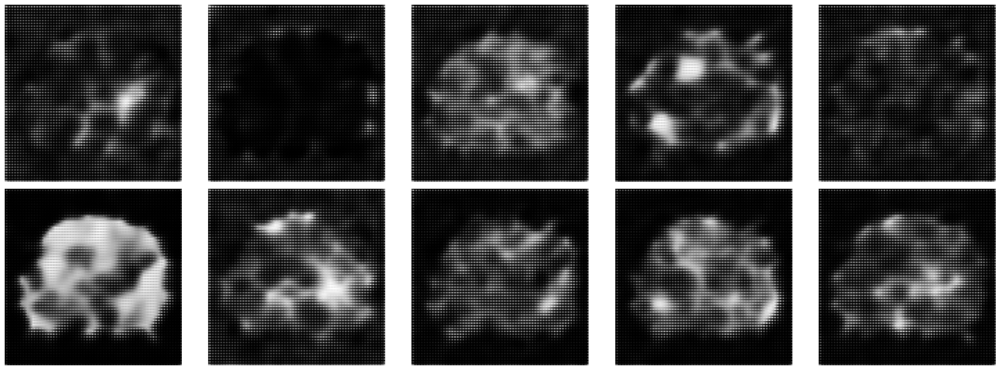

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 1/3750 [00:00<13:13,  4.73it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 2/3750 [00:00<09:41,  6.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 3/3750 [00:00<08:13,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<07:34,  8.25it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 5/3750 [00:00<07:10,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 6/3750 [00:00<06:55,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 7/3750 [00:00<06:45,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 8/3750 [00:00<06:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 9/3750 [00:01<06:35,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 10/3750 [00:01<06:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 11/3750 [00:01<06:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 12/3750 [00:01<06:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 13/3750 [00:01<06:30,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 14/3750 [00:01<06:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 15/3750 [00:01<06:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:01<06:26,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:01<06:26,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 18/3750 [00:01<06:25,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:25,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:02<06:25,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 21/3750 [00:02<06:23,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 22/3750 [00:02<06:26,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<06:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 24/3750 [00:02<06:25,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 25/3750 [00:02<06:26,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 26/3750 [00:02<06:25,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 27/3750 [00:02<06:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:03<06:26,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 29/3750 [00:03<06:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 30/3750 [00:03<06:27,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 31/3750 [00:03<06:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 32/3750 [00:03<06:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 33/3750 [00:03<06:27,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 34/3750 [00:03<06:25,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 35/3750 [00:03<06:26,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 36/3750 [00:03<06:24,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 37/3750 [00:03<06:24,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 38/3750 [00:04<06:23,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 39/3750 [00:04<06:23,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 40/3750 [00:04<07:53,  7.83it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 41/3750 [00:04<07:30,  8.23it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 42/3750 [00:04<07:09,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 43/3750 [00:04<06:54,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 44/3750 [00:04<06:44,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 45/3750 [00:04<06:37,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 46/3750 [00:04<06:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 47/3750 [00:05<06:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 48/3750 [00:05<06:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 49/3750 [00:05<06:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 50/3750 [00:05<06:26,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 51/3750 [00:05<06:26,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 52/3750 [00:05<06:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 53/3750 [00:05<06:26,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 54/3750 [00:05<06:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:05<06:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:06<06:25,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▌                                        | 57/3750 [00:06<06:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 58/3750 [00:06<06:23,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 59/3750 [00:06<06:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 60/3750 [00:06<06:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 61/3750 [00:06<06:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 62/3750 [00:06<06:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:06<06:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 64/3750 [00:06<06:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 65/3750 [00:06<06:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 66/3750 [00:07<06:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 67/3750 [00:07<06:21,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 68/3750 [00:07<06:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 69/3750 [00:07<06:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 70/3750 [00:07<06:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 71/3750 [00:07<06:19,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 72/3750 [00:07<06:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 73/3750 [00:07<06:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 74/3750 [00:07<06:19,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 75/3750 [00:07<06:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 76/3750 [00:08<06:18,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 77/3750 [00:08<06:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 78/3750 [00:08<06:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:08<06:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 80/3750 [00:08<06:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 81/3750 [00:08<06:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 82/3750 [00:08<06:19,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 83/3750 [00:08<06:17,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 84/3750 [00:08<06:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:09<06:18,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 86/3750 [00:09<06:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 87/3750 [00:09<06:19,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:09<06:18,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:09<06:18,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 90/3750 [00:09<06:16,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 91/3750 [00:09<06:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:09<06:17,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 93/3750 [00:09<06:19,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 94/3750 [00:09<06:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 96/3750 [00:10<06:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:10<06:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:10<06:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:10<06:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 100/3750 [00:10<06:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 101/3750 [00:10<06:17,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 102/3750 [00:10<06:18,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 103/3750 [00:10<06:17,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 104/3750 [00:10<06:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:11<06:17,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:17,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 107/3750 [00:11<06:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 108/3750 [00:11<06:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:11<06:16,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 110/3750 [00:11<06:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:11<06:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:11<06:16,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 113/3750 [00:11<06:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:12<06:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<06:23,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 116/3750 [00:12<06:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 117/3750 [00:12<06:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 118/3750 [00:12<06:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 119/3750 [00:12<06:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 120/3750 [00:12<06:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 121/3750 [00:12<06:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 122/3750 [00:12<06:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 123/3750 [00:12<06:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 124/3750 [00:13<06:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 125/3750 [00:13<06:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 126/3750 [00:13<06:17,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 127/3750 [00:13<06:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:13<06:14,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 129/3750 [00:13<06:14,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 130/3750 [00:13<06:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 131/3750 [00:13<06:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 132/3750 [00:13<06:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 133/3750 [00:14<06:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 134/3750 [00:14<06:15,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 135/3750 [00:14<06:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 136/3750 [00:14<06:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 137/3750 [00:14<06:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 138/3750 [00:14<06:12,  9.70it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 139/3750 [00:14<06:14,  9.64it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 140/3750 [00:14<06:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 141/3750 [00:14<06:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 142/3750 [00:14<06:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 143/3750 [00:15<06:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:15<06:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 145/3750 [00:15<06:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 146/3750 [00:15<06:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 147/3750 [00:15<06:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 148/3750 [00:15<06:12,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 149/3750 [00:15<06:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 150/3750 [00:15<06:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 151/3750 [00:15<06:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:15<06:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:16<06:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:16<06:11,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:16<06:11,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 156/3750 [00:16<06:10,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:16<06:09,  9.72it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 158/3750 [00:16<06:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 159/3750 [00:16<06:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 160/3750 [00:16<06:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:16<06:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 162/3750 [00:17<06:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:17<06:10,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 164/3750 [00:17<06:10,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 165/3750 [00:17<06:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:17<06:09,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:17<06:08,  9.71it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 168/3750 [00:17<06:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 169/3750 [00:17<06:15,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 170/3750 [00:17<06:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:17<06:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 172/3750 [00:18<06:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 173/3750 [00:18<06:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:18<06:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:18<06:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 176/3750 [00:18<06:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 177/3750 [00:18<06:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 178/3750 [00:18<06:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 179/3750 [00:18<06:11,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:18<06:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 181/3750 [00:18<06:12,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 182/3750 [00:19<06:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 183/3750 [00:19<06:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:19<06:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:19<06:08,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 186/3750 [00:19<06:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 187/3750 [00:19<06:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 188/3750 [00:19<06:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 189/3750 [00:19<06:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:19<06:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 191/3750 [00:20<06:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:20<06:06,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:20<06:07,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:20<06:07,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:20<06:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 196/3750 [00:20<06:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 197/3750 [00:20<06:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 198/3750 [00:20<06:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:20<06:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:20<06:07,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:21<06:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:21<06:07,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:21<06:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 204/3750 [00:21<06:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 205/3750 [00:21<06:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:21<06:06,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:21<06:05,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 208/3750 [00:21<06:06,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:21<06:07,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 210/3750 [00:22<06:09,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:22<06:09,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 212/3750 [00:22<06:09,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 213/3750 [00:22<06:26,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 214/3750 [00:22<06:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 215/3750 [00:22<06:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:22<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 217/3750 [00:22<06:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 218/3750 [00:22<06:17,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 219/3750 [00:22<06:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:23<06:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 221/3750 [00:23<06:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:23<06:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:23<06:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 224/3750 [00:23<06:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 225/3750 [00:23<06:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 226/3750 [00:23<06:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 227/3750 [00:23<06:07,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 228/3750 [00:23<06:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 229/3750 [00:24<06:05,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 230/3750 [00:24<06:04,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 231/3750 [00:24<06:04,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:24<06:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:24<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 234/3750 [00:24<06:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 235/3750 [00:24<06:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 236/3750 [00:24<06:06,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 237/3750 [00:24<06:40,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 238/3750 [00:24<06:31,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 239/3750 [00:25<06:22,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 240/3750 [00:25<06:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 241/3750 [00:25<06:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:25<06:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 243/3750 [00:25<06:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 244/3750 [00:25<06:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 245/3750 [00:25<06:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 246/3750 [00:25<06:06,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:25<06:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:26<06:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:26<06:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 250/3750 [00:26<06:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 251/3750 [00:26<06:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 252/3750 [00:26<06:04,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 253/3750 [00:26<06:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 254/3750 [00:26<06:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:26<06:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 256/3750 [00:26<06:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 257/3750 [00:26<06:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 258/3750 [00:27<06:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 259/3750 [00:27<06:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 260/3750 [00:27<06:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 261/3750 [00:27<06:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 262/3750 [00:27<06:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 263/3750 [00:27<06:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 264/3750 [00:27<06:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 265/3750 [00:27<06:01,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 266/3750 [00:27<06:00,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 267/3750 [00:28<06:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 268/3750 [00:28<06:00,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 269/3750 [00:28<06:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 270/3750 [00:28<06:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 271/3750 [00:28<06:01,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 272/3750 [00:28<06:00,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 273/3750 [00:28<06:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 274/3750 [00:28<06:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 275/3750 [00:28<06:15,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:28<06:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 277/3750 [00:29<06:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 278/3750 [00:29<06:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 279/3750 [00:29<06:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 280/3750 [00:29<06:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 281/3750 [00:29<06:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:29<06:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:29<06:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 284/3750 [00:29<06:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 285/3750 [00:29<06:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 286/3750 [00:30<06:04,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 287/3750 [00:30<06:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 288/3750 [00:30<06:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 289/3750 [00:30<06:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 290/3750 [00:30<06:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 291/3750 [00:30<06:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 292/3750 [00:30<05:59,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 293/3750 [00:30<06:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 294/3750 [00:30<05:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:30<05:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 296/3750 [00:31<06:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 297/3750 [00:31<06:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:31<05:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:31<05:59,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:31<05:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 301/3750 [00:31<05:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 302/3750 [00:31<05:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 303/3750 [00:31<05:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 304/3750 [00:31<05:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 305/3750 [00:31<05:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:32<05:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 307/3750 [00:32<05:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:32<05:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 309/3750 [00:32<05:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 310/3750 [00:32<05:56,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:32<05:55,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 312/3750 [00:32<05:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 313/3750 [00:32<05:55,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 314/3750 [00:32<05:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:33<05:57,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 316/3750 [00:33<05:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 317/3750 [00:33<05:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 318/3750 [00:33<05:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 319/3750 [00:33<05:55,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:33<05:55,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 321/3750 [00:33<05:54,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 322/3750 [00:33<05:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 323/3750 [00:33<05:56,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 324/3750 [00:33<05:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 325/3750 [00:34<05:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 326/3750 [00:34<05:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 327/3750 [00:34<05:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 328/3750 [00:34<05:54,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 329/3750 [00:34<05:53,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 330/3750 [00:34<05:52,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 331/3750 [00:34<05:52,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 332/3750 [00:34<05:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 333/3750 [00:34<06:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 334/3750 [00:35<06:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 335/3750 [00:35<05:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 336/3750 [00:35<05:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 337/3750 [00:35<05:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 338/3750 [00:35<05:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 339/3750 [00:35<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 340/3750 [00:35<05:54,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 341/3750 [00:35<05:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:35<05:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 343/3750 [00:35<05:54,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:36<05:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 345/3750 [00:36<05:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 346/3750 [00:36<05:53,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 347/3750 [00:36<05:54,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 348/3750 [00:36<05:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:36<05:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:36<05:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:36<05:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 352/3750 [00:36<05:53,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 353/3750 [00:36<05:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 354/3750 [00:37<05:52,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 355/3750 [00:37<05:52,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 356/3750 [00:37<05:50,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 357/3750 [00:37<05:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 358/3750 [00:37<05:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 359/3750 [00:37<05:54,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 360/3750 [00:37<05:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 361/3750 [00:37<05:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 362/3750 [00:37<05:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 363/3750 [00:38<05:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 364/3750 [00:38<05:52,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 365/3750 [00:38<05:52,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 366/3750 [00:38<05:51,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:38<05:50,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 368/3750 [00:38<05:49,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 369/3750 [00:38<05:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 370/3750 [00:38<05:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 371/3750 [00:38<05:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:38<05:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 373/3750 [00:39<05:49,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:39<05:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 375/3750 [00:39<05:48,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:39<05:48,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 377/3750 [00:39<05:47,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 378/3750 [00:39<05:50,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 379/3750 [00:39<05:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 380/3750 [00:39<05:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 381/3750 [00:39<05:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 382/3750 [00:39<05:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 383/3750 [00:40<05:49,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 384/3750 [00:40<05:48,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 385/3750 [00:40<05:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 386/3750 [00:40<05:48,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 387/3750 [00:40<05:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 388/3750 [00:40<05:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:40<05:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 390/3750 [00:40<05:50,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 391/3750 [00:40<05:49,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 392/3750 [00:41<05:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 393/3750 [00:41<05:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 394/3750 [00:41<05:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:41<05:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 396/3750 [00:41<05:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 397/3750 [00:41<05:49,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 398/3750 [00:41<05:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:41<05:49,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:41<05:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 401/3750 [00:41<05:47,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 402/3750 [00:42<05:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 403/3750 [00:42<05:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 404/3750 [00:42<05:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:42<05:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 406/3750 [00:42<05:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 407/3750 [00:42<05:46,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 408/3750 [00:42<05:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:42<05:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:42<05:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 411/3750 [00:43<05:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 412/3750 [00:43<05:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 413/3750 [00:43<05:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 414/3750 [00:43<05:48,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 415/3750 [00:43<08:59,  6.18it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:43<08:01,  6.93it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 417/3750 [00:43<07:19,  7.58it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 418/3750 [00:43<06:50,  8.13it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 419/3750 [00:44<06:30,  8.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 420/3750 [00:44<06:14,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 421/3750 [00:44<06:21,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 422/3750 [00:44<06:11,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 423/3750 [00:44<06:07,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 424/3750 [00:44<05:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 425/3750 [00:44<05:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 426/3750 [00:44<05:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:44<05:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:44<05:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:45<05:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 430/3750 [00:45<05:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 431/3750 [00:45<05:46,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 432/3750 [00:45<05:47,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 433/3750 [00:45<05:45,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 434/3750 [00:45<05:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:45<05:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 436/3750 [00:45<05:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 437/3750 [00:45<05:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 438/3750 [00:46<05:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 439/3750 [00:46<05:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:46<05:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:46<05:45,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 442/3750 [00:46<05:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:46<05:44,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:46<05:44,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 445/3750 [00:46<05:44,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 446/3750 [00:46<05:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:46<05:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:47<05:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:47<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:47<05:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 451/3750 [00:47<05:46,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 452/3750 [00:47<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 453/3750 [00:47<05:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:47<05:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:47<05:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 456/3750 [00:47<05:44,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 457/3750 [00:48<05:43,  9.59it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▉                                   | 458/3750 [00:48<05:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 459/3750 [00:48<05:45,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:48<05:44,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 461/3750 [00:48<05:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:48<05:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:48<05:43,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 464/3750 [00:48<05:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 465/3750 [00:48<05:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 466/3750 [00:48<05:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 467/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 468/3750 [00:49<05:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:49<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 470/3750 [00:49<05:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:49<05:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:49<05:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 473/3750 [00:49<05:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:49<05:41,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 475/3750 [00:49<05:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 476/3750 [00:49<05:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:50<05:41,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:50<05:42,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:50<05:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:50<05:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:50<05:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 482/3750 [00:50<05:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 483/3750 [00:50<05:38,  9.66it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▏                                  | 484/3750 [00:50<05:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 485/3750 [00:50<05:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 486/3750 [00:51<05:46,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▏                                  | 487/3750 [00:51<06:46,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▏                                  | 488/3750 [00:51<06:31,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:51<06:18,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 490/3750 [00:51<06:12,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 13%|█████▏                                  | 491/3750 [00:51<06:25,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:51<06:15,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 493/3750 [00:51<06:08,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 494/3750 [00:51<06:01,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 495/3750 [00:52<05:55,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 496/3750 [00:52<05:53,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 497/3750 [00:52<05:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 498/3750 [00:52<05:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 499/3750 [00:52<05:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:52<05:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 501/3750 [00:52<05:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 502/3750 [00:52<05:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:52<05:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 504/3750 [00:53<05:36,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:53<05:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:53<05:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:53<05:37,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 508/3750 [00:53<05:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 509/3750 [00:53<05:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:53<05:35,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 511/3750 [00:53<05:35,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 512/3750 [00:53<05:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:53<05:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 514/3750 [00:54<05:38,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:54<05:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 516/3750 [00:54<05:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:54<05:36,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 518/3750 [00:54<05:36,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 519/3750 [00:54<05:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 520/3750 [00:54<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 521/3750 [00:54<05:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 522/3750 [00:54<05:37,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:55<05:36,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 524/3750 [00:55<05:37,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 525/3750 [00:55<05:36,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 526/3750 [00:55<05:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 527/3750 [00:55<05:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:55<05:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 529/3750 [00:55<05:33,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:55<05:32,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:55<05:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 532/3750 [00:55<05:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 533/3750 [00:56<05:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 534/3750 [00:56<05:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 535/3750 [00:56<05:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [00:56<05:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [00:56<05:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 538/3750 [00:56<05:32,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 539/3750 [00:56<05:32,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 540/3750 [00:56<05:31,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 541/3750 [00:56<05:30,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 542/3750 [00:56<05:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 543/3750 [00:57<05:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 544/3750 [00:57<05:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 545/3750 [00:57<05:32,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 546/3750 [00:57<05:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 547/3750 [00:57<05:31,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 548/3750 [00:57<05:31,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 549/3750 [00:57<05:30,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 550/3750 [00:57<05:30,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [00:57<05:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 552/3750 [00:58<05:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 553/3750 [00:58<05:32,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 554/3750 [00:58<05:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [00:58<05:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 556/3750 [00:58<05:32,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 557/3750 [00:58<05:30,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [00:58<05:29,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 559/3750 [00:58<05:29,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 560/3750 [00:58<05:31,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 561/3750 [00:58<05:31,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 562/3750 [00:59<05:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 563/3750 [00:59<05:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 564/3750 [00:59<05:30,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 565/3750 [00:59<05:30,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 566/3750 [00:59<05:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 567/3750 [00:59<05:28,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 568/3750 [00:59<05:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 569/3750 [00:59<05:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 570/3750 [00:59<05:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 571/3750 [01:00<05:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 572/3750 [01:00<05:29,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 573/3750 [01:00<05:28,  9.68it/s]

1/1 [==============================] - 0s 12ms/step


 15%|██████                                  | 574/3750 [01:00<05:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 575/3750 [01:00<05:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 576/3750 [01:00<05:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 577/3750 [01:00<05:33,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 578/3750 [01:00<05:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 579/3750 [01:00<05:35,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 580/3750 [01:00<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:01<05:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 582/3750 [01:01<05:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 583/3750 [01:01<05:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 584/3750 [01:01<05:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 585/3750 [01:01<05:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 586/3750 [01:01<05:28,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 587/3750 [01:01<05:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 588/3750 [01:01<05:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:01<05:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 590/3750 [01:01<05:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 591/3750 [01:02<05:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 592/3750 [01:02<05:28,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:02<05:27,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 594/3750 [01:02<05:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 595/3750 [01:02<05:26,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 596/3750 [01:02<05:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 597/3750 [01:02<05:27,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 598/3750 [01:02<05:26,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 599/3750 [01:02<05:27,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 600/3750 [01:03<05:27,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 601/3750 [01:03<05:26,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 602/3750 [01:03<05:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 603/3750 [01:03<05:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 604/3750 [01:03<05:25,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 605/3750 [01:03<05:28,  9.58it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 606/3750 [01:03<05:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 607/3750 [01:03<05:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:03<05:29,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 609/3750 [01:03<05:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 610/3750 [01:04<05:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 611/3750 [01:04<05:43,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 612/3750 [01:04<05:39,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:04<05:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 614/3750 [01:04<05:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 615/3750 [01:04<05:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 616/3750 [01:04<05:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 617/3750 [01:04<05:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 618/3750 [01:04<05:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 619/3750 [01:05<05:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 620/3750 [01:05<05:25,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 621/3750 [01:05<05:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 622/3750 [01:05<05:26,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 623/3750 [01:05<05:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 624/3750 [01:05<05:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 625/3750 [01:05<05:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 626/3750 [01:05<05:26,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 627/3750 [01:05<05:24,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 628/3750 [01:05<05:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 629/3750 [01:06<05:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 630/3750 [01:06<05:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 631/3750 [01:06<05:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 632/3750 [01:06<05:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 633/3750 [01:06<05:26,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 634/3750 [01:06<05:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 635/3750 [01:06<05:24,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 636/3750 [01:06<05:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 637/3750 [01:06<05:23,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 638/3750 [01:07<05:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 639/3750 [01:07<05:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 640/3750 [01:07<05:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 641/3750 [01:07<05:22,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 642/3750 [01:07<05:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 643/3750 [01:07<05:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 644/3750 [01:07<05:23,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:07<05:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 646/3750 [01:07<05:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 647/3750 [01:07<05:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 648/3750 [01:08<05:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 649/3750 [01:08<05:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 650/3750 [01:08<05:21,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 651/3750 [01:08<05:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 652/3750 [01:08<05:22,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 653/3750 [01:08<05:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:08<05:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 655/3750 [01:08<05:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 656/3750 [01:08<05:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 657/3750 [01:08<05:20,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 658/3750 [01:09<05:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:09<05:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 660/3750 [01:09<05:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:09<05:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 662/3750 [01:09<05:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 663/3750 [01:09<05:21,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:09<05:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 665/3750 [01:09<05:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 666/3750 [01:09<05:20,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 667/3750 [01:10<05:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 668/3750 [01:10<05:19,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 669/3750 [01:10<05:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 670/3750 [01:10<05:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 671/3750 [01:10<05:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 672/3750 [01:10<05:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 673/3750 [01:10<05:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 674/3750 [01:10<05:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 675/3750 [01:10<05:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 676/3750 [01:10<05:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 677/3750 [01:11<05:18,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 678/3750 [01:11<05:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 679/3750 [01:11<05:19,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 680/3750 [01:11<05:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 681/3750 [01:11<05:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 682/3750 [01:11<05:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 683/3750 [01:11<05:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 684/3750 [01:11<05:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 685/3750 [01:11<05:18,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 686/3750 [01:12<05:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 687/3750 [01:12<05:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 688/3750 [01:12<05:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 689/3750 [01:12<05:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 690/3750 [01:12<05:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 691/3750 [01:12<05:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 692/3750 [01:12<05:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 693/3750 [01:12<05:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 694/3750 [01:12<05:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 695/3750 [01:12<05:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 696/3750 [01:13<05:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 697/3750 [01:13<05:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:13<05:18,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:13<05:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 700/3750 [01:13<05:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 701/3750 [01:13<05:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 702/3750 [01:13<05:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 703/3750 [01:13<05:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 704/3750 [01:13<05:15,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 705/3750 [01:13<05:17,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 706/3750 [01:14<05:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:14<05:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 708/3750 [01:14<05:16,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 709/3750 [01:14<05:15,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 710/3750 [01:14<05:15,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 711/3750 [01:14<05:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:14<05:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:14<05:13,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 714/3750 [01:14<05:15,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:15<05:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:15<05:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:15<05:14,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:15<05:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 719/3750 [01:15<05:14,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 720/3750 [01:15<05:13,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 721/3750 [01:15<05:13,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 722/3750 [01:15<05:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:15<05:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 724/3750 [01:15<05:14,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:16<05:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 726/3750 [01:16<05:14,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 727/3750 [01:16<05:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 728/3750 [01:16<05:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:16<05:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 730/3750 [01:16<05:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 731/3750 [01:16<05:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:16<05:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 733/3750 [01:16<05:14,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 734/3750 [01:17<05:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 735/3750 [01:17<05:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 736/3750 [01:17<05:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 737/3750 [01:17<05:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 738/3750 [01:17<05:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 739/3750 [01:17<05:12,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 740/3750 [01:17<05:11,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 741/3750 [01:17<05:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 742/3750 [01:17<05:11,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 743/3750 [01:17<05:12,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 744/3750 [01:18<05:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 745/3750 [01:18<05:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 746/3750 [01:18<05:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 747/3750 [01:18<05:12,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:18<05:12,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:18<05:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 750/3750 [01:18<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 751/3750 [01:18<05:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 752/3750 [01:18<05:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:18<05:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 754/3750 [01:19<05:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 755/3750 [01:19<05:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 756/3750 [01:19<05:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 757/3750 [01:19<05:10,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:19<05:09,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 759/3750 [01:19<05:09,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:19<05:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 761/3750 [01:19<05:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:19<05:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:20<05:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:20<05:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 765/3750 [01:20<05:10,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 766/3750 [01:20<05:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:20<05:09,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:20<05:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:20<05:09,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 770/3750 [01:20<05:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:20<05:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 772/3750 [01:20<05:08,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 773/3750 [01:21<05:08,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 774/3750 [01:21<05:08,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 775/3750 [01:21<05:08,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 776/3750 [01:21<05:10,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 777/3750 [01:21<05:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 778/3750 [01:21<05:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 779/3750 [01:21<05:10,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 780/3750 [01:21<05:09,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 781/3750 [01:21<05:09,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 782/3750 [01:22<05:08,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 783/3750 [01:22<05:07,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 784/3750 [01:22<05:07,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:22<05:18,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 786/3750 [01:22<05:23,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 787/3750 [01:22<05:24,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 788/3750 [01:22<05:52,  8.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 789/3750 [01:22<05:39,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 790/3750 [01:22<05:29,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 791/3750 [01:23<05:21,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 792/3750 [01:23<05:25,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 793/3750 [01:23<05:19,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 794/3750 [01:23<05:15,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 795/3750 [01:23<05:13,  9.41it/s]

1/1 [==============================] - 0s 13ms/step


 21%|████████▍                               | 796/3750 [01:23<05:20,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 797/3750 [01:23<05:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 798/3750 [01:23<05:15,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 799/3750 [01:23<05:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:23<05:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 801/3750 [01:24<05:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 802/3750 [01:24<05:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 803/3750 [01:24<05:07,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 804/3750 [01:24<05:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:24<05:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 806/3750 [01:24<05:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 807/3750 [01:24<05:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▌                               | 808/3750 [01:24<05:07,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 809/3750 [01:24<05:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:25<05:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 811/3750 [01:25<05:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 812/3750 [01:25<05:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 813/3750 [01:25<05:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:25<05:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 815/3750 [01:25<05:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 816/3750 [01:25<05:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 817/3750 [01:25<05:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 818/3750 [01:25<05:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 819/3750 [01:25<05:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 820/3750 [01:26<05:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 821/3750 [01:26<05:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:26<05:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 823/3750 [01:26<05:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 824/3750 [01:26<05:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 825/3750 [01:26<05:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 826/3750 [01:26<05:04,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 827/3750 [01:26<05:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:26<05:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:26<05:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 830/3750 [01:27<05:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 831/3750 [01:27<05:02,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 832/3750 [01:27<05:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 833/3750 [01:27<05:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:27<05:02,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 835/3750 [01:27<05:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 836/3750 [01:27<05:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 837/3750 [01:27<05:04,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:27<05:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 839/3750 [01:28<05:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 840/3750 [01:28<05:02,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:28<05:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 842/3750 [01:28<05:02,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 843/3750 [01:28<05:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 844/3750 [01:28<05:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 845/3750 [01:28<05:07,  9.46it/s]

1/1 [==============================] - 0s 62ms/step


 23%|█████████                               | 846/3750 [01:28<06:04,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:28<05:47,  8.35it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 848/3750 [01:29<05:34,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 849/3750 [01:29<05:26,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:29<05:19,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 851/3750 [01:29<05:16,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 852/3750 [01:29<05:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 853/3750 [01:29<05:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 854/3750 [01:29<05:11,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 855/3750 [01:29<05:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 856/3750 [01:29<05:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 857/3750 [01:29<05:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:30<05:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 859/3750 [01:30<05:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 860/3750 [01:30<05:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:30<05:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 862/3750 [01:30<05:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 863/3750 [01:30<05:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:30<04:59,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:30<04:59,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 866/3750 [01:30<04:58,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 867/3750 [01:31<04:57,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 868/3750 [01:31<04:57,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:31<04:58,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:31<04:58,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 871/3750 [01:31<04:58,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:31<04:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 873/3750 [01:31<04:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 874/3750 [01:31<04:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 875/3750 [01:31<04:58,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:31<04:57,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 877/3750 [01:32<04:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 878/3750 [01:32<04:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 879/3750 [01:32<04:58,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 880/3750 [01:32<04:57,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 881/3750 [01:32<04:57,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 882/3750 [01:32<04:55,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 883/3750 [01:32<04:55,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 884/3750 [01:32<04:55,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:32<04:55,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 886/3750 [01:33<04:54,  9.71it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 887/3750 [01:33<04:57,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 888/3750 [01:33<05:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:33<05:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 890/3750 [01:33<05:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 891/3750 [01:33<04:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:33<04:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:33<04:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:33<04:56,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 895/3750 [01:33<04:54,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 896/3750 [01:34<04:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 897/3750 [01:34<04:56,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 898/3750 [01:34<04:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 899/3750 [01:34<04:55,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 900/3750 [01:34<04:55,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 901/3750 [01:34<04:55,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 902/3750 [01:34<04:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 903/3750 [01:34<04:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 904/3750 [01:34<04:55,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 905/3750 [01:34<04:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:35<04:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 907/3750 [01:35<04:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 908/3750 [01:35<04:55,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 909/3750 [01:35<04:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:35<04:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 911/3750 [01:35<04:54,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:35<04:53,  9.66it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 913/3750 [01:35<04:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 914/3750 [01:35<04:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:36<04:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 916/3750 [01:36<04:55,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 917/3750 [01:36<04:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 918/3750 [01:36<04:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 919/3750 [01:36<04:53,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 920/3750 [01:36<04:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 921/3750 [01:36<04:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 922/3750 [01:36<04:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 923/3750 [01:36<04:54,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 924/3750 [01:36<04:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 925/3750 [01:37<04:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 926/3750 [01:37<04:53,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:37<04:52,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 928/3750 [01:37<04:51,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 929/3750 [01:37<04:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 930/3750 [01:37<04:52,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 931/3750 [01:37<04:51,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 932/3750 [01:37<04:53,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 933/3750 [01:37<04:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 934/3750 [01:37<04:52,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 935/3750 [01:38<04:52,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 936/3750 [01:38<04:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 937/3750 [01:38<04:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 938/3750 [01:38<04:51,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 939/3750 [01:38<04:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 940/3750 [01:38<04:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 941/3750 [01:38<04:51,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 942/3750 [01:38<04:51,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 943/3750 [01:38<04:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 944/3750 [01:39<04:50,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 945/3750 [01:39<04:49,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:39<04:49,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 947/3750 [01:39<04:49,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 948/3750 [01:39<04:49,  9.69it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:39<04:50,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 950/3750 [01:39<04:52,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 951/3750 [01:39<04:52,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 952/3750 [01:39<04:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 953/3750 [01:39<04:50,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 954/3750 [01:40<04:51,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 955/3750 [01:40<04:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 956/3750 [01:40<04:49,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 957/3750 [01:40<04:49,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 958/3750 [01:40<04:48,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 959/3750 [01:40<04:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 960/3750 [01:40<04:50,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 961/3750 [01:40<04:49,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 962/3750 [01:40<04:49,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 963/3750 [01:41<04:48,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 964/3750 [01:41<04:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:41<04:49,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 966/3750 [01:41<04:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 967/3750 [01:41<04:47,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 968/3750 [01:41<04:49,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 969/3750 [01:41<04:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 970/3750 [01:41<04:48,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 971/3750 [01:41<04:48,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:41<04:47,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 973/3750 [01:42<04:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 974/3750 [01:42<04:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 975/3750 [01:42<04:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 976/3750 [01:42<04:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 977/3750 [01:42<04:48,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 978/3750 [01:42<04:49,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 979/3750 [01:42<04:48,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 980/3750 [01:42<04:48,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 981/3750 [01:42<04:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:42<04:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:43<04:47,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 984/3750 [01:43<04:46,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:43<04:45,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:43<04:44,  9.70it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 987/3750 [01:43<04:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 988/3750 [01:43<04:47,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:43<04:47,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 990/3750 [01:43<04:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 991/3750 [01:43<04:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 992/3750 [01:44<04:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 993/3750 [01:44<04:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 994/3750 [01:44<04:45,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 995/3750 [01:44<04:45,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:44<04:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 997/3750 [01:44<04:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 998/3750 [01:44<04:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 999/3750 [01:44<04:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1000/3750 [01:44<04:44,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1001/3750 [01:44<04:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1002/3750 [01:45<04:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1003/3750 [01:45<04:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1004/3750 [01:45<04:45,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1005/3750 [01:45<04:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1006/3750 [01:45<04:45,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:45<04:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1008/3750 [01:45<04:47,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1009/3750 [01:45<04:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:45<04:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1011/3750 [01:46<04:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1012/3750 [01:46<04:44,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1013/3750 [01:46<04:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1014/3750 [01:46<04:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1015/3750 [01:46<04:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1016/3750 [01:46<04:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1017/3750 [01:46<04:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1018/3750 [01:46<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:46<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1020/3750 [01:46<04:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:47<04:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:47<04:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:47<04:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1024/3750 [01:47<04:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1025/3750 [01:47<04:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1026/3750 [01:47<04:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1027/3750 [01:47<04:41,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:47<04:41,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:47<04:42,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1030/3750 [01:47<04:42,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:48<04:41,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [01:48<04:42,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [01:48<04:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:48<04:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1035/3750 [01:48<04:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [01:48<04:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [01:48<04:42,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:48<04:40,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [01:48<04:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1040/3750 [01:49<04:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1041/3750 [01:49<04:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1042/3750 [01:49<04:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1043/3750 [01:49<04:40,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1044/3750 [01:49<04:40,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1045/3750 [01:49<04:39,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1046/3750 [01:49<04:39,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1047/3750 [01:49<04:40,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1048/3750 [01:49<04:40,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1049/3750 [01:49<04:39,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [01:50<04:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1051/3750 [01:50<04:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1052/3750 [01:50<04:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1053/3750 [01:50<04:40,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:50<04:39,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:50<04:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [01:50<04:39,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1057/3750 [01:50<04:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1058/3750 [01:50<04:38,  9.68it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1059/3750 [01:50<04:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1060/3750 [01:51<04:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1061/3750 [01:51<04:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1062/3750 [01:51<04:39,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1063/3750 [01:51<04:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [01:51<04:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1065/3750 [01:51<04:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [01:51<04:39,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [01:51<04:37,  9.65it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1068/3750 [01:51<04:40,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:52<04:39,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1070/3750 [01:52<04:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1071/3750 [01:52<04:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1072/3750 [01:52<04:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1073/3750 [01:52<04:38,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1074/3750 [01:52<04:38,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1075/3750 [01:52<04:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:52<04:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1077/3750 [01:52<04:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:52<04:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1079/3750 [01:53<04:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1080/3750 [01:53<04:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [01:53<04:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:53<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:53<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1084/3750 [01:53<04:38,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [01:53<04:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1086/3750 [01:53<04:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1087/3750 [01:53<04:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1088/3750 [01:54<04:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1089/3750 [01:54<04:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1090/3750 [01:54<04:37,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1091/3750 [01:54<04:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1092/3750 [01:54<04:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1093/3750 [01:54<04:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1094/3750 [01:54<04:35,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1095/3750 [01:54<04:34,  9.67it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1096/3750 [01:54<04:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1097/3750 [01:54<04:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1098/3750 [01:55<04:37,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [01:55<04:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1100/3750 [01:55<04:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1101/3750 [01:55<04:37,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1102/3750 [01:55<04:36,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1103/3750 [01:55<04:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [01:55<04:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1105/3750 [01:55<04:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▌                           | 1106/3750 [01:55<04:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [01:56<04:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1108/3750 [01:56<04:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1109/3750 [01:56<04:39,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1110/3750 [01:56<04:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1111/3750 [01:56<04:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1112/3750 [01:56<04:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1113/3750 [01:56<04:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [01:56<04:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1115/3750 [01:56<04:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [01:56<04:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1117/3750 [01:57<04:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [01:57<04:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1119/3750 [01:57<04:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1120/3750 [01:57<04:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1121/3750 [01:57<04:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [01:57<04:33,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1123/3750 [01:57<04:34,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1124/3750 [01:57<04:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1125/3750 [01:57<04:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [01:57<04:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [01:58<04:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1128/3750 [01:58<04:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1129/3750 [01:58<04:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1130/3750 [01:58<04:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [01:58<04:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1132/3750 [01:58<04:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [01:58<04:32,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [01:58<04:33,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1135/3750 [01:58<04:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1136/3750 [01:59<04:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1137/3750 [01:59<04:32,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1138/3750 [01:59<04:32,  9.60it/s]

1/1 [==============================] - 0s 7ms/step


 30%|███████████▊                           | 1139/3750 [01:59<04:31,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1140/3750 [01:59<04:30,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1141/3750 [01:59<04:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1142/3750 [01:59<04:32,  9.59it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▉                           | 1143/3750 [01:59<04:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1144/3750 [01:59<04:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1145/3750 [01:59<04:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1146/3750 [02:00<04:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1147/3750 [02:00<04:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:00<04:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1149/3750 [02:00<04:29,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1150/3750 [02:00<04:31,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1151/3750 [02:00<04:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1152/3750 [02:00<04:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1153/3750 [02:00<04:36,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1154/3750 [02:00<04:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:01<04:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1156/3750 [02:01<04:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:01<04:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:01<04:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:01<04:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:01<04:31,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1161/3750 [02:01<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1162/3750 [02:01<04:30,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:01<04:30,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1164/3750 [02:01<04:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:02<04:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:02<04:28,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1167/3750 [02:02<04:27,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1168/3750 [02:02<04:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1169/3750 [02:02<04:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1170/3750 [02:02<04:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1171/3750 [02:02<04:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1172/3750 [02:02<04:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1173/3750 [02:02<04:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:03<04:26,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1175/3750 [02:03<04:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1176/3750 [02:03<04:27,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1177/3750 [02:03<04:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1178/3750 [02:03<04:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1179/3750 [02:03<04:27,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:03<04:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1181/3750 [02:03<04:40,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1182/3750 [02:03<04:43,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1183/3750 [02:03<04:39,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1184/3750 [02:04<04:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1185/3750 [02:04<04:39,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:04<04:38,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1187/3750 [02:04<04:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:04<04:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1189/3750 [02:04<04:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1190/3750 [02:04<04:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1191/3750 [02:04<04:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1192/3750 [02:04<04:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:05<04:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1194/3750 [02:05<04:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1195/3750 [02:05<04:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1196/3750 [02:05<04:32,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1197/3750 [02:05<04:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1198/3750 [02:05<04:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1199/3750 [02:05<04:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1200/3750 [02:05<04:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:05<04:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1202/3750 [02:05<04:26,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:06<04:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:06<04:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1205/3750 [02:06<04:25,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1206/3750 [02:06<04:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:06<04:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1208/3750 [02:06<04:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:06<04:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:06<04:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:06<04:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:07<04:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1213/3750 [02:07<04:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1214/3750 [02:07<04:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1215/3750 [02:07<04:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1216/3750 [02:07<04:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1217/3750 [02:07<04:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:07<04:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:07<04:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1220/3750 [02:07<04:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:07<04:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:08<04:22,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1223/3750 [02:08<04:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1224/3750 [02:08<04:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:08<04:22,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:08<04:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1227/3750 [02:08<04:21,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:08<04:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:08<04:20,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1230/3750 [02:08<04:21,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1231/3750 [02:09<04:21,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1232/3750 [02:09<04:22,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1233/3750 [02:09<04:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:09<04:21,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:09<04:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:09<04:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1237/3750 [02:09<04:20,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1238/3750 [02:09<04:19,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1239/3750 [02:09<04:19,  9.69it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:09<04:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1241/3750 [02:10<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1242/3750 [02:10<04:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1243/3750 [02:10<04:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1244/3750 [02:10<04:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1245/3750 [02:10<04:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1246/3750 [02:10<04:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1247/3750 [02:10<04:20,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1248/3750 [02:10<04:20,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1249/3750 [02:10<04:19,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1250/3750 [02:10<04:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1251/3750 [02:11<04:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1252/3750 [02:11<04:19,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:11<04:19,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1254/3750 [02:11<04:19,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1255/3750 [02:11<04:19,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1256/3750 [02:11<04:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:11<04:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:11<04:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1259/3750 [02:11<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1260/3750 [02:12<04:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1261/3750 [02:12<04:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:12<04:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1263/3750 [02:12<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:12<04:18,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:12<04:18,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:12<04:17,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:12<04:17,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1268/3750 [02:12<04:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:12<04:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:13<04:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1271/3750 [02:13<04:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:13<04:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:13<04:16,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:13<04:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:13<04:17,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:13<04:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1277/3750 [02:13<04:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:13<04:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:14<04:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1280/3750 [02:14<04:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:14<04:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1282/3750 [02:14<04:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1283/3750 [02:14<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:14<04:16,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1285/3750 [02:14<04:16,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:14<04:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1287/3750 [02:14<04:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1288/3750 [02:14<04:27,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:15<04:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1290/3750 [02:15<04:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1291/3750 [02:15<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1292/3750 [02:15<04:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1293/3750 [02:15<04:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:15<04:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:15<04:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:15<04:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1297/3750 [02:15<04:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1298/3750 [02:16<04:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1299/3750 [02:16<04:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1300/3750 [02:16<04:15,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1301/3750 [02:16<04:14,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1302/3750 [02:16<04:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1303/3750 [02:16<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:16<04:13,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1305/3750 [02:16<04:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1306/3750 [02:16<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1307/3750 [02:16<04:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1308/3750 [02:17<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1309/3750 [02:17<04:13,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1310/3750 [02:17<04:12,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1311/3750 [02:17<04:13,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:17<04:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1313/3750 [02:17<04:12,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1314/3750 [02:17<04:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:17<04:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:17<04:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1317/3750 [02:17<04:14,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1318/3750 [02:18<04:13,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1319/3750 [02:18<04:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:18<04:12,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1321/3750 [02:18<04:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:18<04:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1323/3750 [02:18<04:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1324/3750 [02:18<04:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1325/3750 [02:18<04:13,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:18<04:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1327/3750 [02:19<04:11,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1328/3750 [02:19<04:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1329/3750 [02:19<04:12,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1330/3750 [02:19<04:11,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1331/3750 [02:19<04:10,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1332/3750 [02:19<04:12,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1333/3750 [02:19<04:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1334/3750 [02:19<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1335/3750 [02:19<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1336/3750 [02:19<04:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1337/3750 [02:20<04:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1338/3750 [02:20<04:12,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1339/3750 [02:20<04:13,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1340/3750 [02:20<04:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1341/3750 [02:20<04:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1342/3750 [02:20<04:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1343/3750 [02:20<04:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1344/3750 [02:20<04:12,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1345/3750 [02:20<04:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1346/3750 [02:21<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1347/3750 [02:21<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1348/3750 [02:21<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:21<04:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:21<04:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:21<04:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:21<04:11,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1353/3750 [02:21<04:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1354/3750 [02:21<04:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1355/3750 [02:21<04:10,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1356/3750 [02:22<04:09,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1357/3750 [02:22<04:09,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:22<04:09,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1359/3750 [02:22<04:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1360/3750 [02:22<04:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:22<04:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:22<04:09,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1363/3750 [02:22<04:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1364/3750 [02:22<04:08,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1365/3750 [02:22<04:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:23<04:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:23<04:07,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:23<04:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:23<04:08,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:23<04:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:23<04:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1372/3750 [02:23<04:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:23<04:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:23<04:07,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:24<04:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1376/3750 [02:24<04:07,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1377/3750 [02:24<04:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1378/3750 [02:24<04:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:24<04:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1380/3750 [02:24<04:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:24<04:06,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:24<04:07,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1383/3750 [02:24<04:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:24<04:09,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1385/3750 [02:25<04:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:25<04:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1387/3750 [02:25<04:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:25<04:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1389/3750 [02:25<04:06,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:25<04:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:25<04:04,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1392/3750 [02:25<04:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:25<04:05,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:26<04:04,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:26<04:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1396/3750 [02:26<04:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1397/3750 [02:26<04:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:26<04:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1399/3750 [02:26<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:26<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1401/3750 [02:26<04:05,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1402/3750 [02:26<04:04,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1403/3750 [02:26<04:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1404/3750 [02:27<04:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1405/3750 [02:27<04:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:27<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1407/3750 [02:27<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:27<04:04,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1409/3750 [02:27<04:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1410/3750 [02:27<04:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1411/3750 [02:27<04:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:27<04:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:28<04:04,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:28<04:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:28<04:03,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1416/3750 [02:28<04:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:28<04:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:28<04:02,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1419/3750 [02:28<04:02,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:28<04:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1421/3750 [02:28<04:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1422/3750 [02:28<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1423/3750 [02:29<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1424/3750 [02:29<04:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:29<04:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1426/3750 [02:29<04:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:29<04:04,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1428/3750 [02:29<04:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1429/3750 [02:29<04:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1430/3750 [02:29<04:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1431/3750 [02:29<04:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1432/3750 [02:30<04:03,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1433/3750 [02:30<04:02,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1434/3750 [02:30<04:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1435/3750 [02:30<04:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1436/3750 [02:30<04:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1437/3750 [02:30<04:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1438/3750 [02:30<04:03,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1439/3750 [02:30<04:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1440/3750 [02:30<04:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:30<04:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1442/3750 [02:31<06:14,  6.16it/s]

1/1 [==============================] - 0s 8ms/step


 38%|███████████████                        | 1443/3750 [02:31<05:33,  6.91it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1444/3750 [02:31<05:06,  7.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1445/3750 [02:31<04:46,  8.05it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:31<04:31,  8.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:31<04:24,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1448/3750 [02:31<04:18,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1449/3750 [02:31<04:12,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1450/3750 [02:32<04:09,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1451/3750 [02:32<04:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:32<04:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1453/3750 [02:32<04:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:32<04:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1455/3750 [02:32<03:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:32<03:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1457/3750 [02:32<03:59,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1458/3750 [02:32<03:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1459/3750 [02:33<04:01,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1460/3750 [02:33<04:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:33<04:00,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1462/3750 [02:33<03:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1463/3750 [02:33<03:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:33<03:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:33<04:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1466/3750 [02:33<03:59,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:33<03:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:33<03:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:34<03:58,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1470/3750 [02:34<03:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1471/3750 [02:34<03:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1472/3750 [02:34<03:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1473/3750 [02:34<03:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:34<03:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:34<03:56,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:34<03:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:34<03:57,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1478/3750 [02:35<03:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1479/3750 [02:35<03:57,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1480/3750 [02:35<03:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:35<03:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1482/3750 [02:35<03:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1483/3750 [02:35<03:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1484/3750 [02:35<03:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1485/3750 [02:35<03:57,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1486/3750 [02:35<03:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1487/3750 [02:35<03:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1488/3750 [02:36<03:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1489/3750 [02:36<05:15,  7.16it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▍                       | 1490/3750 [02:36<05:07,  7.35it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1491/3750 [02:36<04:51,  7.76it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1492/3750 [02:36<04:35,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1493/3750 [02:36<04:24,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1494/3750 [02:36<04:17,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:36<04:15,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1496/3750 [02:37<04:09,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1497/3750 [02:37<04:06,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1498/3750 [02:37<04:03,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1499/3750 [02:37<04:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1500/3750 [02:37<03:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1501/3750 [02:37<03:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1502/3750 [02:37<03:56,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:37<03:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:37<03:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1505/3750 [02:38<03:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1506/3750 [02:38<03:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:38<03:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:38<03:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1509/3750 [02:38<04:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:38<03:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1511/3750 [02:38<03:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:38<03:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:38<03:55,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:38<03:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:39<03:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1516/3750 [02:39<04:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1517/3750 [02:39<03:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1518/3750 [02:39<03:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1519/3750 [02:39<03:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1520/3750 [02:39<04:00,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 41%|███████████████▊                       | 1521/3750 [02:39<04:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1522/3750 [02:39<03:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1523/3750 [02:39<03:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1524/3750 [02:40<03:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:40<03:57,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1526/3750 [02:40<03:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1527/3750 [02:40<03:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1528/3750 [02:40<03:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:40<03:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:40<03:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1531/3750 [02:40<03:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1532/3750 [02:40<03:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1533/3750 [02:40<03:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1534/3750 [02:41<03:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1535/3750 [02:41<03:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1536/3750 [02:41<03:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1537/3750 [02:41<03:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1538/3750 [02:41<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1539/3750 [02:41<03:51,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1540/3750 [02:41<03:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1541/3750 [02:41<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1542/3750 [02:41<03:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1543/3750 [02:42<03:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:42<03:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1545/3750 [02:42<03:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:42<03:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:42<03:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1548/3750 [02:42<03:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1549/3750 [02:42<03:50,  9.56it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1550/3750 [02:42<03:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1551/3750 [02:42<03:52,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1552/3750 [02:42<03:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1553/3750 [02:43<03:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1554/3750 [02:43<03:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:43<03:51,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:43<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:43<03:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1558/3750 [02:43<03:49,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1559/3750 [02:43<03:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1560/3750 [02:43<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1561/3750 [02:43<03:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1562/3750 [02:44<03:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:44<03:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:44<03:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1565/3750 [02:44<03:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1566/3750 [02:44<03:48,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:44<03:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:44<03:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:44<03:48,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:44<03:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:44<03:47,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:45<03:47,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1573/3750 [02:45<03:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1574/3750 [02:45<03:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:45<03:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:45<03:47,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:45<03:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1578/3750 [02:45<03:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:45<03:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1580/3750 [02:45<03:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1581/3750 [02:46<03:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:46<03:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:46<03:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:46<03:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1585/3750 [02:46<03:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1586/3750 [02:46<03:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:46<03:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1588/3750 [02:46<03:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:46<03:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:46<03:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:47<03:45,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:47<03:44,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:47<03:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1594/3750 [02:47<03:43,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1595/3750 [02:47<03:45,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:47<03:45,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:47<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:47<03:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1599/3750 [02:47<03:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1600/3750 [02:48<03:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [02:48<03:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [02:48<03:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [02:48<03:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:48<03:45,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1605/3750 [02:48<03:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:48<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [02:48<03:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1608/3750 [02:48<03:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1609/3750 [02:48<03:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1610/3750 [02:49<03:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1611/3750 [02:49<03:43,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [02:49<03:43,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:49<03:42,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1614/3750 [02:49<03:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1615/3750 [02:49<03:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1616/3750 [02:49<03:42,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:49<03:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [02:49<03:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1619/3750 [02:50<03:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1620/3750 [02:50<03:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1621/3750 [02:50<03:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [02:50<03:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1623/3750 [02:50<03:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1624/3750 [02:50<03:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1625/3750 [02:50<03:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1626/3750 [02:50<03:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1627/3750 [02:50<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1628/3750 [02:50<03:42,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1629/3750 [02:51<03:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1630/3750 [02:51<03:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1631/3750 [02:51<03:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [02:51<03:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [02:51<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1634/3750 [02:51<03:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1635/3750 [02:51<03:40,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1636/3750 [02:51<03:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1637/3750 [02:51<03:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1638/3750 [02:52<03:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1639/3750 [02:52<03:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [02:52<03:39,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1641/3750 [02:52<03:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1642/3750 [02:52<03:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1643/3750 [02:52<03:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1644/3750 [02:52<03:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1645/3750 [02:52<03:41,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1646/3750 [02:52<04:04,  8.60it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1647/3750 [02:52<04:00,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1648/3750 [02:53<03:55,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1649/3750 [02:53<03:50,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1650/3750 [02:53<03:51,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1651/3750 [02:53<03:48,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1652/3750 [02:53<03:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1653/3750 [02:53<03:47,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1654/3750 [02:53<03:49,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1655/3750 [02:53<03:47,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1656/3750 [02:53<03:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1657/3750 [02:54<03:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1658/3750 [02:54<03:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1659/3750 [02:54<03:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [02:54<03:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1661/3750 [02:54<03:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1662/3750 [02:54<03:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1663/3750 [02:54<03:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1664/3750 [02:54<03:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1665/3750 [02:54<03:37,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1666/3750 [02:55<03:36,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1667/3750 [02:55<03:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [02:55<03:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1669/3750 [02:55<03:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▎                     | 1670/3750 [02:55<03:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1671/3750 [02:55<03:37,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1672/3750 [02:55<03:36,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1673/3750 [02:55<03:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1674/3750 [02:55<03:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1675/3750 [02:55<03:36,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [02:56<03:36,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1677/3750 [02:56<03:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1678/3750 [02:56<03:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [02:56<03:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1680/3750 [02:56<03:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [02:56<03:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [02:56<03:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1683/3750 [02:56<03:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1684/3750 [02:56<03:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1685/3750 [02:56<03:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1686/3750 [02:57<03:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1687/3750 [02:57<03:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [02:57<03:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1689/3750 [02:57<03:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1690/3750 [02:57<03:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [02:57<03:53,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1692/3750 [02:57<03:48,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1693/3750 [02:57<03:43,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [02:57<03:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1695/3750 [02:58<03:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1696/3750 [02:58<03:38,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1697/3750 [02:58<03:37,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1698/3750 [02:58<03:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [02:58<03:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1700/3750 [02:58<03:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1701/3750 [02:58<03:34,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [02:58<03:34,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [02:58<03:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1704/3750 [02:59<03:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1705/3750 [02:59<03:35,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1706/3750 [02:59<03:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [02:59<03:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1708/3750 [02:59<03:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [02:59<03:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1710/3750 [02:59<03:32,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [02:59<03:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1712/3750 [02:59<03:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1713/3750 [02:59<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1714/3750 [03:00<03:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1715/3750 [03:00<03:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:00<03:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1717/3750 [03:00<03:38,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:00<03:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1719/3750 [03:00<03:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:00<03:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1721/3750 [03:00<03:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1722/3750 [03:00<03:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1723/3750 [03:01<03:31,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:01<03:32,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1725/3750 [03:01<03:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1726/3750 [03:01<03:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1727/3750 [03:01<03:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:01<03:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:01<03:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:01<03:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1731/3750 [03:01<03:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1732/3750 [03:01<03:30,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1733/3750 [03:02<03:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:02<03:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1735/3750 [03:02<03:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1736/3750 [03:02<03:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:02<03:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1738/3750 [03:02<03:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1739/3750 [03:02<03:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1740/3750 [03:02<03:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1741/3750 [03:02<03:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1742/3750 [03:02<03:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████▏                    | 1743/3750 [03:03<03:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1744/3750 [03:03<03:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1745/3750 [03:03<03:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:03<03:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1747/3750 [03:03<03:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1748/3750 [03:03<03:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:03<03:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1750/3750 [03:03<03:29,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:03<03:32,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1752/3750 [03:04<03:31,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1753/3750 [03:04<03:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1754/3750 [03:04<03:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1755/3750 [03:04<03:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1756/3750 [03:04<03:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1757/3750 [03:04<03:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1758/3750 [03:04<03:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1759/3750 [03:04<03:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1760/3750 [03:04<03:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1761/3750 [03:04<03:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1762/3750 [03:05<03:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1763/3750 [03:05<03:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:05<03:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1765/3750 [03:05<03:26,  9.60it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:05<03:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1767/3750 [03:05<03:27,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1768/3750 [03:05<03:27,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1769/3750 [03:05<03:43,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1770/3750 [03:05<03:40,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1771/3750 [03:06<03:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1772/3750 [03:06<03:35,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1773/3750 [03:06<03:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1774/3750 [03:06<03:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1775/3750 [03:06<03:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1776/3750 [03:06<03:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1777/3750 [03:06<03:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1778/3750 [03:06<03:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1779/3750 [03:06<03:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1780/3750 [03:07<03:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1781/3750 [03:07<03:25,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:07<03:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:07<03:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:07<03:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:07<03:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:07<03:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:07<03:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1788/3750 [03:07<03:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:07<03:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:08<03:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:08<03:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:08<03:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1793/3750 [03:08<03:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1794/3750 [03:08<03:24,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1795/3750 [03:08<03:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1796/3750 [03:08<03:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1797/3750 [03:08<03:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1798/3750 [03:08<03:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1799/3750 [03:09<03:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1800/3750 [03:09<03:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:09<03:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1802/3750 [03:09<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1803/3750 [03:09<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1804/3750 [03:09<03:23,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1805/3750 [03:09<03:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1806/3750 [03:09<03:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:09<03:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1808/3750 [03:09<03:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1809/3750 [03:10<03:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1810/3750 [03:10<03:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1811/3750 [03:10<03:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1812/3750 [03:10<03:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:10<03:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1814/3750 [03:10<03:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1815/3750 [03:10<03:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1816/3750 [03:10<03:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1817/3750 [03:10<03:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1818/3750 [03:10<03:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1819/3750 [03:11<03:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:11<03:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1821/3750 [03:11<03:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:11<03:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1823/3750 [03:11<03:22,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1824/3750 [03:11<03:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1825/3750 [03:11<03:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1826/3750 [03:11<03:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1827/3750 [03:11<03:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:12<03:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:12<03:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1830/3750 [03:12<03:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1831/3750 [03:12<03:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1832/3750 [03:12<03:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1833/3750 [03:12<03:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1834/3750 [03:12<03:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:12<03:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1836/3750 [03:12<03:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:12<03:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1838/3750 [03:13<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1839/3750 [03:13<03:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1840/3750 [03:13<03:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1841/3750 [03:13<03:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1842/3750 [03:13<03:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1843/3750 [03:13<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:13<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:13<03:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:13<03:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:14<03:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1848/3750 [03:14<03:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1849/3750 [03:14<03:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:14<03:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1851/3750 [03:14<03:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1852/3750 [03:14<03:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1853/3750 [03:14<03:18,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1854/3750 [03:14<03:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1855/3750 [03:14<03:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1856/3750 [03:14<03:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1857/3750 [03:15<03:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:15<03:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1859/3750 [03:15<03:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1860/3750 [03:15<03:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1861/3750 [03:15<03:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1862/3750 [03:15<03:17,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1863/3750 [03:15<03:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:15<03:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1865/3750 [03:15<03:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:16<03:17,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1867/3750 [03:16<03:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1868/3750 [03:16<03:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1869/3750 [03:16<03:16,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1870/3750 [03:16<03:17,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1871/3750 [03:16<03:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1872/3750 [03:16<03:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1873/3750 [03:16<03:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:16<03:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1875/3750 [03:16<03:15,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:17<03:14,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:17<03:14,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1878/3750 [03:17<03:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:17<03:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1880/3750 [03:17<03:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1881/3750 [03:17<03:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:17<03:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1883/3750 [03:17<03:20,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:17<03:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:18<03:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:18<03:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:18<03:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:18<03:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1889/3750 [03:18<03:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1890/3750 [03:18<03:15,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:18<03:14,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:18<03:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:18<03:13,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:18<03:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1895/3750 [03:19<03:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1896/3750 [03:19<03:12,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1897/3750 [03:19<03:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1898/3750 [03:19<03:15,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1899/3750 [03:19<03:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1900/3750 [03:19<03:14,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:19<03:13,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1902/3750 [03:19<03:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:19<03:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:20<03:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1905/3750 [03:20<03:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1906/3750 [03:20<03:13,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1907/3750 [03:20<03:12,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1908/3750 [03:20<03:12,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1909/3750 [03:20<03:12,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1910/3750 [03:20<03:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1911/3750 [03:20<03:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1912/3750 [03:20<03:11,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1913/3750 [03:20<03:11,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1914/3750 [03:21<03:11,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1915/3750 [03:21<03:12,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:21<03:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1917/3750 [03:21<03:11,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1918/3750 [03:21<03:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1919/3750 [03:21<03:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1920/3750 [03:21<03:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1921/3750 [03:21<03:10,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1922/3750 [03:21<03:10,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1923/3750 [03:21<03:09,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1924/3750 [03:22<03:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1925/3750 [03:22<03:10,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1926/3750 [03:22<03:14,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 51%|████████████████████                   | 1927/3750 [03:22<03:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1928/3750 [03:22<03:17,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1929/3750 [03:22<03:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1930/3750 [03:22<03:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1931/3750 [03:22<03:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1932/3750 [03:22<03:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1933/3750 [03:23<03:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:23<03:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1935/3750 [03:23<03:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:23<03:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1937/3750 [03:23<03:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1938/3750 [03:23<03:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1939/3750 [03:23<03:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1940/3750 [03:23<03:13,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:23<03:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1942/3750 [03:24<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1943/3750 [03:24<03:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:24<03:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1945/3750 [03:24<03:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:24<03:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1947/3750 [03:24<03:09,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1948/3750 [03:24<03:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1949/3750 [03:24<03:07,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1950/3750 [03:24<03:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1951/3750 [03:24<03:08,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:25<03:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:25<03:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1954/3750 [03:25<03:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1955/3750 [03:25<03:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:25<03:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1957/3750 [03:25<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1958/3750 [03:25<03:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1959/3750 [03:25<03:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1960/3750 [03:25<03:20,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:26<03:16,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:26<03:18,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1963/3750 [03:26<03:14,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1964/3750 [03:26<03:12,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:26<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1966/3750 [03:26<03:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1967/3750 [03:26<03:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1968/3750 [03:26<03:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1969/3750 [03:26<03:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1970/3750 [03:26<03:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1971/3750 [03:27<03:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:27<03:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:27<03:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1974/3750 [03:27<03:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:27<03:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:27<03:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1977/3750 [03:27<03:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1978/3750 [03:27<03:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1979/3750 [03:27<03:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:28<03:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:28<03:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1982/3750 [03:28<03:04,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1983/3750 [03:28<03:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1984/3750 [03:28<03:04,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1985/3750 [03:28<03:04,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1986/3750 [03:28<03:03,  9.59it/s]

1/1 [==============================] - 0s 26ms/step


 53%|████████████████████▋                  | 1987/3750 [03:28<03:14,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1988/3750 [03:28<03:12,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1989/3750 [03:29<03:13,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:29<03:10,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1991/3750 [03:29<03:08,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:29<03:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:29<03:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1994/3750 [03:29<03:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1995/3750 [03:29<03:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1996/3750 [03:29<03:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1997/3750 [03:29<03:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1998/3750 [03:29<03:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:30<03:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:30<03:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:30<03:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:30<03:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:30<03:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2004/3750 [03:30<03:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2005/3750 [03:30<03:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2006/3750 [03:30<03:02,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:30<03:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2008/3750 [03:31<03:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2009/3750 [03:31<03:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:31<03:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2011/3750 [03:31<03:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2012/3750 [03:31<03:01,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2013/3750 [03:31<03:01,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:31<03:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:31<03:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2016/3750 [03:31<03:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2017/3750 [03:31<03:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:32<03:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2019/3750 [03:32<03:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:32<03:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:32<03:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2022/3750 [03:32<03:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2023/3750 [03:32<03:00,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2024/3750 [03:32<02:59,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:32<03:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2026/3750 [03:32<03:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2027/3750 [03:32<03:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2028/3750 [03:33<03:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:33<03:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2030/3750 [03:33<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2031/3750 [03:33<02:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:33<02:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:33<02:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:33<03:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:33<02:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:33<02:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:34<02:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:34<02:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:34<02:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:34<02:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:34<02:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:34<02:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:34<02:58,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:34<02:59,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:34<03:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:34<03:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:35<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:35<02:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:35<02:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:35<02:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:35<02:56,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:35<02:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:35<02:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:35<02:58,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:35<02:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:36<02:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:36<02:56,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:36<02:56,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:36<02:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:36<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:36<02:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:36<02:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:36<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:36<02:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:36<02:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:37<02:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:37<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:37<02:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:37<02:55,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:37<02:55,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:37<02:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:37<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:37<02:55,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:37<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:38<02:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:38<02:54,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:38<02:54,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:38<02:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:38<02:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:38<02:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:38<02:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:38<02:54,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:38<02:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:38<02:53,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:39<02:53,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:39<02:53,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:39<02:53,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:39<02:52,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:39<02:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:39<02:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:39<02:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:39<02:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:39<02:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:40<02:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:40<02:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:40<02:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:40<02:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:40<02:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:40<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:40<03:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:40<02:58,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:40<02:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:40<02:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:41<02:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:41<02:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:41<02:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:41<02:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:41<02:51,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:41<02:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:41<02:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:41<02:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:41<02:50,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:42<02:50,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:42<02:49,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:42<02:49,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2116/3750 [03:42<02:50,  9.57it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2117/3750 [03:42<03:22,  8.05it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2118/3750 [03:42<03:13,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2119/3750 [03:42<03:33,  7.64it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2120/3750 [03:42<03:26,  7.88it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2121/3750 [03:42<03:14,  8.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2122/3750 [03:43<03:06,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2123/3750 [03:43<03:00,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2124/3750 [03:43<02:56,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2125/3750 [03:43<02:55,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2126/3750 [03:43<02:52,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2127/3750 [03:43<02:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2128/3750 [03:43<02:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2129/3750 [03:43<02:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2130/3750 [03:43<02:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:44<02:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2132/3750 [03:44<02:48,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:44<02:48,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2134/3750 [03:44<02:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:44<02:49,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2136/3750 [03:44<02:49,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2137/3750 [03:44<02:48,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:44<02:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2139/3750 [03:44<02:47,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2140/3750 [03:44<02:47,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2141/3750 [03:45<02:47,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:45<02:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2143/3750 [03:45<02:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2144/3750 [03:45<02:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2145/3750 [03:45<02:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2146/3750 [03:45<02:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2147/3750 [03:45<02:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2148/3750 [03:45<02:47,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2149/3750 [03:45<02:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2150/3750 [03:46<02:46,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2151/3750 [03:46<02:46,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2152/3750 [03:46<02:45,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2153/3750 [03:46<02:46,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2154/3750 [03:46<02:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2155/3750 [03:46<02:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▍                | 2156/3750 [03:46<02:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2157/3750 [03:46<02:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [03:46<02:46,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2159/3750 [03:46<02:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2160/3750 [03:47<02:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2161/3750 [03:47<02:44,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2162/3750 [03:47<02:45,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2163/3750 [03:47<02:45,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2164/3750 [03:47<02:45,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2165/3750 [03:47<02:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2166/3750 [03:47<02:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2167/3750 [03:47<02:44,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2168/3750 [03:47<02:44,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2169/3750 [03:47<02:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2170/3750 [03:48<02:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2171/3750 [03:48<02:44,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [03:48<02:43,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2173/3750 [03:48<02:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2174/3750 [03:48<02:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2175/3750 [03:48<02:43,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2176/3750 [03:48<02:43,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [03:48<02:42,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2178/3750 [03:48<02:42,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2179/3750 [03:49<02:42,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [03:49<02:43,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2181/3750 [03:49<02:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2182/3750 [03:49<02:43,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2183/3750 [03:49<02:42,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [03:49<02:42,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2185/3750 [03:49<02:44,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2186/3750 [03:49<02:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [03:49<02:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:49<02:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [03:50<02:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2190/3750 [03:50<02:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2191/3750 [03:50<02:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2192/3750 [03:50<02:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [03:50<02:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2194/3750 [03:50<02:41,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2195/3750 [03:50<02:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [03:50<02:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2197/3750 [03:50<02:41,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [03:51<02:41,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2199/3750 [03:51<02:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2200/3750 [03:51<02:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2201/3750 [03:51<02:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2202/3750 [03:51<02:41,  9.61it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2203/3750 [03:51<02:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2204/3750 [03:51<02:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2205/3750 [03:51<02:41,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [03:51<02:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [03:51<02:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2208/3750 [03:52<02:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2209/3750 [03:52<02:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2210/3750 [03:52<02:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2211/3750 [03:52<02:40,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [03:52<02:40,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2213/3750 [03:52<02:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2214/3750 [03:52<02:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2215/3750 [03:52<02:39,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [03:52<02:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [03:52<02:39,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2218/3750 [03:53<02:39,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2219/3750 [03:53<02:39,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2220/3750 [03:53<02:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2221/3750 [03:53<02:38,  9.67it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2222/3750 [03:53<02:38,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2223/3750 [03:53<02:38,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2224/3750 [03:53<02:38,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2225/3750 [03:53<02:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2226/3750 [03:53<02:38,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2227/3750 [03:54<02:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2228/3750 [03:54<02:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2229/3750 [03:54<02:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2230/3750 [03:54<02:38,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2231/3750 [03:54<02:38,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2232/3750 [03:54<02:37,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2233/3750 [03:54<02:37,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2234/3750 [03:54<02:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2235/3750 [03:54<02:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2236/3750 [03:54<02:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2237/3750 [03:55<02:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2238/3750 [03:55<02:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2239/3750 [03:55<02:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [03:55<02:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2241/3750 [03:55<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2242/3750 [03:55<02:36,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2243/3750 [03:55<02:37,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2244/3750 [03:55<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2245/3750 [03:55<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2246/3750 [03:56<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2247/3750 [03:56<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2248/3750 [03:56<02:36,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2249/3750 [03:56<02:36,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2250/3750 [03:56<02:35,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2251/3750 [03:56<02:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2252/3750 [03:56<02:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2253/3750 [03:56<02:36,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2254/3750 [03:56<02:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2255/3750 [03:56<02:35,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2256/3750 [03:57<02:35,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2257/3750 [03:57<02:35,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2258/3750 [03:57<02:34,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2259/3750 [03:57<02:34,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2260/3750 [03:57<02:34,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [03:57<02:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2262/3750 [03:57<02:34,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2263/3750 [03:57<02:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2264/3750 [03:57<02:34,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [03:57<02:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [03:58<02:34,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2267/3750 [03:58<02:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [03:58<02:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2269/3750 [03:58<02:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2270/3750 [03:58<02:33,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2271/3750 [03:58<02:33,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2272/3750 [03:58<02:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [03:58<02:33,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2274/3750 [03:58<02:33,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2275/3750 [03:59<02:32,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2276/3750 [03:59<02:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2277/3750 [03:59<02:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2278/3750 [03:59<02:33,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2279/3750 [03:59<02:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2280/3750 [03:59<02:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [03:59<02:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2282/3750 [03:59<02:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2283/3750 [03:59<02:33,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2284/3750 [03:59<02:33,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2285/3750 [04:00<02:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2286/3750 [04:00<02:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2287/3750 [04:00<02:33,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2288/3750 [04:00<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2289/3750 [04:00<02:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:00<02:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:00<02:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2292/3750 [04:00<02:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2293/3750 [04:00<02:31,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2294/3750 [04:01<02:31,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:01<02:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2296/3750 [04:01<02:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2297/3750 [04:01<02:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2298/3750 [04:01<02:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2299/3750 [04:01<02:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2300/3750 [04:01<02:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2301/3750 [04:01<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2302/3750 [04:01<02:30,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:01<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2304/3750 [04:02<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:02<02:30,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:02<02:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:02<02:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:02<02:30,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2309/3750 [04:02<02:30,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2310/3750 [04:02<02:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2311/3750 [04:02<02:29,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2312/3750 [04:02<02:29,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2313/3750 [04:02<02:29,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2314/3750 [04:03<02:29,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2315/3750 [04:03<02:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2316/3750 [04:03<02:29,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2317/3750 [04:03<02:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2318/3750 [04:03<02:29,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2319/3750 [04:03<02:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2320/3750 [04:03<02:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:03<02:28,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2322/3750 [04:03<02:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:04<02:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2324/3750 [04:04<02:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:04<02:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2326/3750 [04:04<02:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:04<02:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:04<02:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2329/3750 [04:04<02:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2330/3750 [04:04<02:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2331/3750 [04:04<02:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2332/3750 [04:04<02:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2333/3750 [04:05<02:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2334/3750 [04:05<02:32,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2335/3750 [04:05<02:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2336/3750 [04:05<02:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2337/3750 [04:05<02:28,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2338/3750 [04:05<02:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2339/3750 [04:05<02:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2340/3750 [04:05<02:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2341/3750 [04:05<02:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2342/3750 [04:06<02:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2343/3750 [04:06<02:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2344/3750 [04:06<02:27,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:06<02:26,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2346/3750 [04:06<02:27,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:06<02:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2348/3750 [04:06<02:26,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:06<02:26,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:06<02:25,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2351/3750 [04:06<02:25,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:07<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2353/3750 [04:07<02:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2354/3750 [04:07<02:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2355/3750 [04:07<02:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2356/3750 [04:07<02:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2357/3750 [04:07<02:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2358/3750 [04:07<02:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2359/3750 [04:07<02:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2360/3750 [04:07<02:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2361/3750 [04:08<02:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:08<02:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2363/3750 [04:08<02:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2364/3750 [04:08<02:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:08<02:24,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2366/3750 [04:08<02:24,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:08<02:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:08<02:23,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2369/3750 [04:08<02:23,  9.65it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2370/3750 [04:08<02:22,  9.66it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2371/3750 [04:09<02:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2372/3750 [04:09<02:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2373/3750 [04:09<02:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2374/3750 [04:09<02:23,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:09<02:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2376/3750 [04:09<02:23,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:09<02:22,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:09<02:23,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2379/3750 [04:09<02:23,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2380/3750 [04:10<02:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▊              | 2381/3750 [04:10<02:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2382/3750 [04:10<02:23,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:10<02:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2384/3750 [04:10<02:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:10<02:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2386/3750 [04:10<02:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:10<02:22,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2388/3750 [04:10<02:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2389/3750 [04:10<02:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:11<02:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2391/3750 [04:11<02:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2392/3750 [04:11<02:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2393/3750 [04:11<02:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2394/3750 [04:11<02:21,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2395/3750 [04:11<02:21,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2396/3750 [04:11<02:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2397/3750 [04:11<02:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:11<02:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2399/3750 [04:11<02:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2400/3750 [04:12<02:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2401/3750 [04:12<02:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2402/3750 [04:12<02:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2403/3750 [04:12<02:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2404/3750 [04:12<02:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2405/3750 [04:12<02:20,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2406/3750 [04:12<02:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2407/3750 [04:12<02:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2408/3750 [04:12<02:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2409/3750 [04:13<02:20,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2410/3750 [04:13<02:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2411/3750 [04:13<02:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2412/3750 [04:13<02:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2413/3750 [04:13<02:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2414/3750 [04:13<02:19,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2415/3750 [04:13<02:18,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:13<02:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:13<02:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:13<02:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:14<02:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:14<02:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:14<02:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:14<02:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:14<02:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:14<02:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:14<02:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:14<02:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:14<02:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:15<02:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:15<02:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:15<02:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:15<02:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:15<02:17,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:15<02:17,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:15<02:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:15<02:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:15<02:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:15<02:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:16<02:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:16<02:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:16<02:17,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:16<02:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:16<02:16,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:16<02:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:16<02:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:16<02:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:16<02:16,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:17<02:16,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:17<02:16,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:17<02:15,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:17<02:15,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:17<02:15,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:17<02:16,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:17<02:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:17<02:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:17<02:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:17<02:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:18<02:15,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:18<02:15,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:18<02:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:18<02:14,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:18<02:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:18<02:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:18<02:14,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:18<02:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:18<02:13,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:19<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:19<02:13,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:19<02:13,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:19<02:12,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:19<02:13,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:19<02:13,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:19<02:13,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:19<02:13,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:19<02:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:19<02:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:20<02:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:20<02:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:20<02:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:20<02:13,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:20<02:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:20<03:37,  5.84it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:20<03:13,  6.57it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:21<02:55,  7.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:21<02:42,  7.80it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:21<02:33,  8.26it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:21<02:26,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:21<02:22,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:21<02:19,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:21<02:17,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:21<02:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:21<02:15,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:21<02:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:22<02:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:22<02:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:22<02:15,  9.29it/s]

1/1 [==============================] - 0s 14ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:22<02:19,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:22<02:17,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:22<02:17,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:22<02:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2500/3750 [04:22<02:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2501/3750 [04:22<02:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2502/3750 [04:23<02:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2503/3750 [04:23<02:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2504/3750 [04:23<02:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2505/3750 [04:23<02:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2506/3750 [04:23<02:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:23<02:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:23<02:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:23<02:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:23<02:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2511/3750 [04:24<02:21,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2512/3750 [04:24<02:18,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:24<02:15,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:24<02:14,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:24<02:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:24<02:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:24<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:24<02:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:24<02:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:24<02:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:25<02:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:25<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:25<02:09,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:25<02:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:25<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:25<02:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:25<02:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:25<02:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:25<02:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:26<02:08,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:26<02:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:26<02:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:26<02:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:26<02:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:26<02:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:26<02:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:26<02:07,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:26<02:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:26<02:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:27<02:07,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:27<02:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:27<02:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:27<02:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:27<02:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:27<02:06,  9.52it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:27<02:14,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:27<02:12,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:27<02:10,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:28<02:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:28<02:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:28<02:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:28<02:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:28<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:28<02:06,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:28<02:07,  9.36it/s]

1/1 [==============================] - 0s 15ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:28<02:15,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:28<02:22,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:29<02:17,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:29<02:13,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:29<02:11,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:29<02:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:29<02:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:29<02:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:29<02:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:29<02:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:29<02:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:30<02:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:30<02:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:30<02:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:30<02:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:30<02:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:30<02:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:30<02:04,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:30<02:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:30<02:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:30<02:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:31<02:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:31<02:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:31<02:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:31<02:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:31<02:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:31<02:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:31<02:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:31<02:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:31<02:02,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:32<02:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:32<02:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:32<02:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:32<02:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:32<02:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:32<02:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:32<02:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:32<02:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:32<02:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:32<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:33<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2597/3750 [04:33<02:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2598/3750 [04:33<02:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2599/3750 [04:33<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2600/3750 [04:33<02:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2601/3750 [04:33<02:00,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2602/3750 [04:33<02:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2603/3750 [04:33<02:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2604/3750 [04:33<02:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2605/3750 [04:34<02:00,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2606/3750 [04:34<02:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2607/3750 [04:34<01:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2608/3750 [04:34<02:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:34<01:59,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:34<01:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:34<01:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:34<01:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:34<01:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:34<01:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:35<01:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:35<01:58,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:35<01:58,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:35<01:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:35<01:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:35<01:58,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:35<01:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:35<01:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:35<01:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:35<01:57,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:36<01:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:36<01:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:36<01:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:36<01:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:36<01:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:36<01:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:36<01:57,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:36<01:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:36<01:57,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:37<01:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:37<01:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:37<01:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:37<01:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:37<01:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:37<01:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:37<01:55,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:37<01:55,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:37<01:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:37<01:55,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:38<01:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:38<01:55,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:38<01:55,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:38<01:55,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:38<01:54,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:38<02:19,  7.88it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:38<02:14,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:38<02:09,  8.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:39<02:05,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:39<02:02,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:39<02:00,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:39<01:58,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:39<01:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:39<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:39<01:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:39<01:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:39<01:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:39<01:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:40<01:54,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:40<01:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:40<01:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:40<01:53,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:40<01:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:40<01:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:40<01:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:40<01:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:40<01:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:41<01:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:41<01:54,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:41<01:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:41<01:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:41<01:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:41<01:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:41<01:52,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:41<01:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:41<01:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:41<01:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:42<01:52,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:42<01:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:42<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:42<01:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:42<01:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:42<01:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:42<01:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:42<01:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:42<01:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:43<01:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:43<01:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:43<01:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2693/3750 [04:43<01:50,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:43<01:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2695/3750 [04:43<01:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2696/3750 [04:43<01:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:43<01:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:43<01:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2699/3750 [04:43<01:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2700/3750 [04:44<01:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2701/3750 [04:44<01:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [04:44<01:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2703/3750 [04:44<01:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2704/3750 [04:44<01:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:44<01:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:44<01:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:44<01:48,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:44<01:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:45<01:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:45<01:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:45<01:48,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:45<01:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:45<01:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:45<01:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:45<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:45<01:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:45<01:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:45<01:48,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:46<01:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:46<01:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:46<01:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:46<01:47,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:46<01:47,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:46<01:46,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:46<01:46,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:46<01:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:46<01:47,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:47<01:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:47<01:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:47<01:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:47<01:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:47<01:46,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:47<01:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:47<01:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:47<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:47<01:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:47<01:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:48<01:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:48<01:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:48<01:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:48<01:48,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:48<01:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:48<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:48<01:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:48<01:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:48<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:49<01:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:49<01:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:49<01:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:49<01:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:49<01:44,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:49<01:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:49<01:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:49<01:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:49<01:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:49<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:50<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:50<01:44,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:50<01:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:50<01:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2761/3750 [04:50<01:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2762/3750 [04:50<01:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2763/3750 [04:50<01:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2764/3750 [04:50<01:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2765/3750 [04:50<01:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [04:51<01:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2767/3750 [04:51<01:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2768/3750 [04:51<01:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [04:51<01:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2770/3750 [04:51<01:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2771/3750 [04:51<01:42,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [04:51<01:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [04:51<01:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [04:51<01:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2775/3750 [04:51<01:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [04:52<01:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2777/3750 [04:52<01:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2778/3750 [04:52<01:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [04:52<01:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2780/3750 [04:52<01:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2781/3750 [04:52<01:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2782/3750 [04:52<01:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2783/3750 [04:52<01:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2784/3750 [04:52<01:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2785/3750 [04:53<01:41,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2786/3750 [04:53<01:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2787/3750 [04:53<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2788/3750 [04:53<01:40,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2789/3750 [04:53<01:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [04:53<01:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2791/3750 [04:53<01:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2792/3750 [04:53<01:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2793/3750 [04:53<01:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2794/3750 [04:53<01:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2795/3750 [04:54<01:39,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2796/3750 [04:54<01:39,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2797/3750 [04:54<01:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [04:54<01:39,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2799/3750 [04:54<01:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2800/3750 [04:54<01:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2801/3750 [04:54<01:39,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2802/3750 [04:54<01:42,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▏         | 2803/3750 [04:54<01:49,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2804/3750 [04:55<01:47,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2805/3750 [04:55<01:49,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2806/3750 [04:55<01:46,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2807/3750 [04:55<01:44,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2808/3750 [04:55<01:44,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2809/3750 [04:55<01:43,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [04:55<01:42,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2811/3750 [04:55<01:42,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2812/3750 [04:55<01:41,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2813/3750 [04:56<01:41,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2814/3750 [04:56<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2815/3750 [04:56<01:39,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2816/3750 [04:56<01:38,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2817/3750 [04:56<01:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2818/3750 [04:56<01:38,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2819/3750 [04:56<01:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2820/3750 [04:56<01:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2821/3750 [04:56<01:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2822/3750 [04:56<01:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2823/3750 [04:57<01:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2824/3750 [04:57<01:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2825/3750 [04:57<01:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2826/3750 [04:57<01:36,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2827/3750 [04:57<01:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2828/3750 [04:57<01:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2829/3750 [04:57<01:36,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [04:57<01:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2831/3750 [04:57<01:36,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2832/3750 [04:58<01:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2833/3750 [04:58<01:35,  9.62it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [04:58<01:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2835/3750 [04:58<01:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2836/3750 [04:58<01:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2837/3750 [04:58<01:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2838/3750 [04:58<01:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2839/3750 [04:58<01:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2840/3750 [04:58<01:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2841/3750 [04:58<01:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2842/3750 [04:59<01:34,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [04:59<01:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2844/3750 [04:59<01:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2845/3750 [04:59<01:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2846/3750 [04:59<01:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2847/3750 [04:59<01:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2848/3750 [04:59<01:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2849/3750 [04:59<01:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [04:59<01:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:00<01:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:00<01:34,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:00<01:33,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:00<01:38,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:00<01:37,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:00<01:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:00<01:36,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:00<01:35,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:00<01:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:00<01:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:01<01:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:01<01:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:01<01:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:01<01:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:01<01:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:01<01:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:01<01:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:01<01:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:01<01:32,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:02<01:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:02<01:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:02<01:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:02<01:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:02<01:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:02<01:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:02<01:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:02<01:31,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:02<01:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:02<01:30,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:03<01:30,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:03<01:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:03<01:31,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:03<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:03<01:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2885/3750 [05:03<01:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2886/3750 [05:03<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2887/3750 [05:03<01:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2888/3750 [05:03<01:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2889/3750 [05:04<01:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2890/3750 [05:04<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2891/3750 [05:04<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:04<01:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2893/3750 [05:04<01:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2894/3750 [05:04<01:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2895/3750 [05:04<01:29,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2896/3750 [05:04<01:29,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:04<01:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:04<01:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:05<01:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:05<01:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:05<01:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:05<01:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:05<01:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:05<01:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:05<01:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:05<01:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:05<01:27,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:06<01:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:06<01:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:06<01:29,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:06<01:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:06<01:28,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:06<01:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:06<01:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:06<01:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:06<01:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:06<01:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:07<01:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:07<01:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:07<01:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:07<01:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:07<01:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:07<01:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:07<01:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:07<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:07<01:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:08<01:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:08<01:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:08<01:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:08<01:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:08<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:08<01:26,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:08<01:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:08<01:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:08<01:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:08<01:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:09<01:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:09<01:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:09<01:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:09<01:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:09<01:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:09<01:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:09<01:24,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:09<01:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:09<01:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:10<01:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:10<01:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:10<01:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:10<01:23,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:10<01:23,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:10<01:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:10<01:23,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:10<01:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:10<01:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:10<01:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:11<01:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:11<01:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:11<01:22,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:11<01:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:11<01:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:11<01:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:11<01:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:11<01:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:11<01:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:12<01:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:12<01:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:12<01:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:12<01:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:12<01:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:12<01:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:12<01:21,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:12<01:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:12<01:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:12<01:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:13<01:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:13<01:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:13<01:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:13<01:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:13<01:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:13<01:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 79%|███████████████████████████████        | 2981/3750 [05:13<01:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2982/3750 [05:13<01:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2983/3750 [05:13<01:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2984/3750 [05:13<01:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2985/3750 [05:14<01:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2986/3750 [05:14<01:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:14<01:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:14<01:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:14<01:19,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2990/3750 [05:14<01:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2991/3750 [05:14<01:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2992/3750 [05:14<01:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:14<01:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:15<01:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:15<01:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:15<01:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:15<01:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:15<01:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:15<01:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:15<01:18,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:15<01:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:15<01:18,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:15<01:18,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:16<01:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:16<01:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:16<01:17,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:16<01:17,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:16<01:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:16<01:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:16<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:16<01:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:16<01:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:17<01:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:17<01:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:17<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:17<01:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:17<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:17<01:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:17<01:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:17<01:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:17<01:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:17<01:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:18<01:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:18<01:15,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:18<01:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:18<01:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:18<01:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:18<01:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:18<01:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:18<01:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:18<01:15,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:19<01:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:19<01:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:19<01:14,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:19<01:15,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:19<01:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:19<01:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:19<01:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:19<01:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:19<01:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:19<01:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:20<01:14,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:20<01:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:20<01:13,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:20<01:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:20<01:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:20<01:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:20<01:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:20<01:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:20<01:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:21<01:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:21<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:21<01:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:21<01:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:21<01:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:21<01:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:21<01:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:21<01:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:21<01:12,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:21<01:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:22<01:12,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:22<01:11,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:22<01:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:22<01:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:22<01:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:22<01:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:22<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:22<01:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:22<01:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:23<01:11,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:23<01:10,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:23<01:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:23<01:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:23<01:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:23<01:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:23<01:10,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3077/3750 [05:23<01:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3078/3750 [05:23<01:10,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:23<01:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3080/3750 [05:24<01:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:24<01:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3082/3750 [05:24<01:10,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3083/3750 [05:24<01:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:24<01:09,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:24<01:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3086/3750 [05:24<01:09,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:24<01:09,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3088/3750 [05:24<01:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:25<01:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:25<01:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:25<01:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:25<01:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:25<01:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:25<01:08,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:25<01:08,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:25<01:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:25<01:08,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:25<01:07,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:26<01:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:26<01:08,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:26<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:26<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:26<01:07,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:26<01:07,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:26<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:26<01:07,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:26<01:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:27<01:08,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:27<01:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:27<01:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:27<01:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:27<01:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:27<01:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:27<01:06,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:27<01:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:27<01:06,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:27<01:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:28<01:06,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:28<01:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:28<01:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:28<01:05,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:28<01:05,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:28<01:05,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:28<01:06,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:28<01:08,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:28<01:08,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:29<01:13,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:29<01:11,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:29<01:09,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:29<01:08,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:29<01:07,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:29<01:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:29<01:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:29<01:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:29<01:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:30<01:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:30<01:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:30<01:04,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:30<01:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:30<01:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:30<01:03,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:30<01:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:30<01:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:30<01:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:30<01:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:31<01:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:31<01:03,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:31<01:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:31<01:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:31<01:02,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:31<01:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:31<01:02,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:31<01:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:31<01:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:32<01:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:32<01:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:32<01:02,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:32<01:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:32<01:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:32<01:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:32<01:01,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:32<01:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:32<01:03,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:32<01:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:33<01:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:33<01:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:33<01:01,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:33<01:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:33<01:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:33<01:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:33<01:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:33<01:00,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:33<01:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:34<01:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:34<01:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:34<00:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:34<00:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:34<00:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:34<00:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:34<00:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:34<00:59,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:34<00:59,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:34<00:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:35<00:59,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:35<00:59,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:35<00:58,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:35<00:58,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:35<00:58,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:35<00:59,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:35<00:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:35<00:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:35<00:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:36<00:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:36<00:58,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:36<00:57,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:36<00:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:36<00:57,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:36<00:57,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:36<00:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:36<00:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:36<00:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:36<00:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:37<00:57,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:37<00:57,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:37<00:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:37<00:56,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:37<00:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:37<00:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:37<00:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:37<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:37<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:38<00:56,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:38<00:55,  9.61it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:38<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:38<00:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:38<00:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:38<00:56,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:38<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:38<00:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:38<00:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:38<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:39<00:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:39<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:39<00:55,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:39<00:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:39<00:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:39<00:55,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:39<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:39<00:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:39<00:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:40<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:40<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:40<00:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:40<00:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:40<00:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:40<00:53,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:40<00:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:40<00:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:40<00:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:40<00:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:41<00:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:41<00:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:41<00:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:41<00:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:41<00:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:41<00:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:41<00:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:41<00:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:41<00:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:41<00:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:42<00:52,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:42<00:52,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:42<00:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:42<00:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:42<00:52,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:42<00:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:42<00:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:42<00:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:42<00:51,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:43<00:51,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:43<00:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:43<00:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:43<00:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:43<00:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:43<00:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:43<00:50,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:43<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:43<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:43<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:44<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:44<00:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:44<00:50,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:44<00:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:44<00:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:44<00:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:44<00:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:44<00:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:44<00:49,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:45<00:49,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:45<00:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:45<00:49,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:45<00:48,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:45<00:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:45<00:51,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:45<00:50,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:45<00:50,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:45<00:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:45<00:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:46<00:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:46<00:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:46<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:46<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:46<00:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:46<00:47,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:46<00:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:46<00:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:46<00:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:47<00:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:47<00:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:47<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:47<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:47<00:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:47<00:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [05:47<00:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [05:47<00:46,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [05:47<00:46,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [05:47<00:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [05:48<00:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [05:48<00:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [05:48<00:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [05:48<00:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [05:48<00:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [05:48<00:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [05:48<00:45,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [05:48<00:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [05:48<00:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [05:49<00:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [05:49<00:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [05:49<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [05:49<00:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [05:49<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [05:49<00:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [05:49<00:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [05:49<00:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [05:49<00:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [05:50<00:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [05:50<00:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [05:50<00:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [05:50<00:44,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [05:50<00:44,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [05:50<00:43,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [05:50<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [05:50<00:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [05:50<00:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [05:50<00:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [05:51<00:43,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [05:51<00:43,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [05:51<00:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [05:51<00:42,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [05:51<00:42,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [05:51<00:42,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [05:51<00:42,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [05:51<00:42,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [05:51<00:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [05:51<00:43,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [05:52<00:42,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [05:52<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [05:52<00:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [05:52<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [05:52<00:41,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [05:52<00:41,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [05:52<00:41,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [05:52<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [05:52<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [05:53<00:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [05:53<00:41,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [05:53<00:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [05:53<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [05:53<00:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [05:53<00:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [05:53<00:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [05:53<00:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [05:53<00:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [05:53<00:40,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [05:54<00:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3366/3750 [05:54<00:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3367/3750 [05:54<00:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3368/3750 [05:54<00:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3369/3750 [05:54<00:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [05:54<00:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3371/3750 [05:54<00:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3372/3750 [05:54<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3373/3750 [05:54<00:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3374/3750 [05:55<00:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3375/3750 [05:55<00:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [05:55<00:39,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3377/3750 [05:55<00:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [05:55<00:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [05:55<00:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [05:55<00:38,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [05:55<00:39,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [05:55<00:38,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [05:55<00:38,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [05:56<00:38,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [05:56<00:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [05:56<00:38,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [05:56<00:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [05:56<00:37,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [05:56<00:37,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [05:56<00:37,  9.53it/s]

1/1 [==============================] - 0s 40ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [05:56<00:42,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [05:56<00:40,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [05:57<00:39,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [05:57<00:39,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [05:57<00:38,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [05:57<00:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [05:57<00:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [05:57<00:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [05:57<00:36,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [05:57<00:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [05:57<00:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [05:58<00:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [05:58<00:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [05:58<00:36,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [05:58<00:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [05:58<00:35,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [05:58<00:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [05:58<00:35,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [05:58<00:35,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [05:58<00:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [05:58<00:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [05:59<00:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [05:59<00:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [05:59<00:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [05:59<00:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [05:59<00:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [05:59<00:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [05:59<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [05:59<00:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [05:59<00:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:00<00:34,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:00<00:34,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:00<00:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:00<00:34,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:00<00:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:00<00:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:00<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:00<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:00<00:33,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:00<00:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:01<00:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:01<00:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:01<00:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:01<00:32,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:01<00:32,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:01<00:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:01<00:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:01<00:32,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:01<00:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:01<00:32,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:02<00:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:02<00:32,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:02<00:32,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:02<00:31,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:02<00:31,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:02<00:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:02<00:32,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:02<00:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:02<00:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:03<00:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:03<00:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:03<00:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:03<00:31,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:03<00:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:03<00:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:03<00:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:03<00:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:03<00:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:03<00:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:04<00:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:04<00:30,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:04<00:30,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:04<00:30,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:04<00:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:04<00:29,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:04<00:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:04<00:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:04<00:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:05<00:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:05<00:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:05<00:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:05<00:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:05<00:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:05<00:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:05<00:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:05<00:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:05<00:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:05<00:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:06<00:28,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:06<00:28,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:06<00:28,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:06<00:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:06<00:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:06<00:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:06<00:27,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:06<00:27,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:06<00:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:07<00:27,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:07<00:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:07<00:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:07<00:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:07<00:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:07<00:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:07<00:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:07<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:07<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:07<00:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:08<00:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:08<00:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:08<00:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:08<00:26,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:08<00:26,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:08<00:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:08<00:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:08<00:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:08<00:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:09<00:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:09<00:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:09<00:25,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:09<00:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:09<00:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:09<00:24,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:09<00:24,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:09<00:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:09<00:24,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:09<00:24,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:10<00:24,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:10<00:24,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:10<00:24,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:10<00:41,  5.60it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:10<00:35,  6.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:10<00:32,  7.04it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:10<00:29,  7.64it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:11<00:27,  8.14it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:11<00:26,  8.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:11<00:25,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:11<00:24,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:11<00:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:11<00:23,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:11<00:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:11<00:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:11<00:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:12<00:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:12<00:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:12<00:22,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:12<00:22,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:12<00:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:12<00:22,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:12<00:22,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:12<00:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:12<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:12<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:13<00:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:13<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:13<00:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:13<00:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:13<00:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:13<00:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:13<00:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:13<00:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:13<00:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:14<00:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:14<00:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:14<00:20,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:14<00:20,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:14<00:20,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:14<00:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:14<00:20,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:14<00:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:14<00:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:14<00:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:15<00:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:15<00:19,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:15<00:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:15<00:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:15<00:19,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:15<00:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:15<00:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:15<00:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:15<00:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:15<00:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:16<00:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:16<00:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:16<00:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:16<00:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:16<00:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:16<00:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:16<00:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:16<00:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:16<00:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:17<00:17,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:17<00:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:17<00:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:17<00:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:17<00:17,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:17<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:17<00:17,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:17<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:17<00:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:17<00:16,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:18<00:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:18<00:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:18<00:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:18<00:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:18<00:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:18<00:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:18<00:16,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:18<00:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:18<00:15,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:19<00:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:19<00:15,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:19<00:15,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:19<00:15,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:19<00:15,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:19<00:15,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:19<00:15,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:19<00:14,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:19<00:14,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:19<00:14,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:20<00:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:20<00:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:20<00:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:20<00:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:20<00:14,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:20<00:14,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:20<00:14,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:20<00:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:20<00:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:21<00:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:21<00:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:21<00:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:21<00:13,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:21<00:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:21<00:13,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:21<00:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:21<00:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:21<00:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:21<00:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:22<00:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:22<00:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:22<00:13,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:22<00:13,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:22<00:13,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:22<00:12,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:22<00:12,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:22<00:12,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:22<00:12,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:23<00:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:23<00:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:23<00:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:23<00:11,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:23<00:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:23<00:11,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:23<00:11,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:23<00:11,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:23<00:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:24<00:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:24<00:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:24<00:10,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:24<00:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:24<00:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:24<00:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:24<00:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:24<00:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:24<00:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:24<00:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:25<00:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:25<00:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:25<00:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:25<00:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:25<00:09,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:25<00:09,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:25<00:09,  9.48it/s]

1/1 [==============================] - 0s 11ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:25<00:10,  8.53it/s]

1/1 [==============================] - 0s 12ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:26<00:11,  7.50it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:26<00:10,  7.94it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:26<00:09,  8.33it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:26<00:09,  8.66it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:26<00:09,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:26<00:08,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:26<00:08,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:26<00:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:26<00:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:26<00:08,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:27<00:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:27<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:27<00:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:27<00:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:27<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:27<00:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:27<00:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:27<00:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:27<00:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:28<00:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:28<00:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:28<00:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:28<00:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:28<00:06,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:28<00:06,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:28<00:06,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:28<00:06,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:28<00:06,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:29<00:06,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:29<00:06,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:29<00:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:29<00:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:29<00:05,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:29<00:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:29<00:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:29<00:05,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:29<00:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:29<00:05,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:30<00:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:30<00:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:30<00:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:30<00:04,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:30<00:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:30<00:04,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:30<00:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:30<00:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:30<00:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:31<00:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:31<00:03,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:31<00:03,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:31<00:03,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:31<00:03,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:31<00:03,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:31<00:03,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:31<00:03,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:31<00:03,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:31<00:03,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:32<00:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:32<00:02,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:32<00:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:32<00:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:32<00:02,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:32<00:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:32<00:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:32<00:02,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:32<00:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:33<00:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:33<00:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:33<00:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:33<00:01,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:33<00:01,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:33<00:01,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:33<00:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:33<00:01,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:33<00:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:33<00:01,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:34<00:00,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:34<00:00,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:34<00:00,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:34<00:00,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:34<00:00,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:34<00:00,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:34<00:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:34<00:00,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:34<00:00,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


100%|███████████████████████████████████████| 3750/3750 [06:34<00:00,  9.49it/s]

EPOCH: 5 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 12ms/step


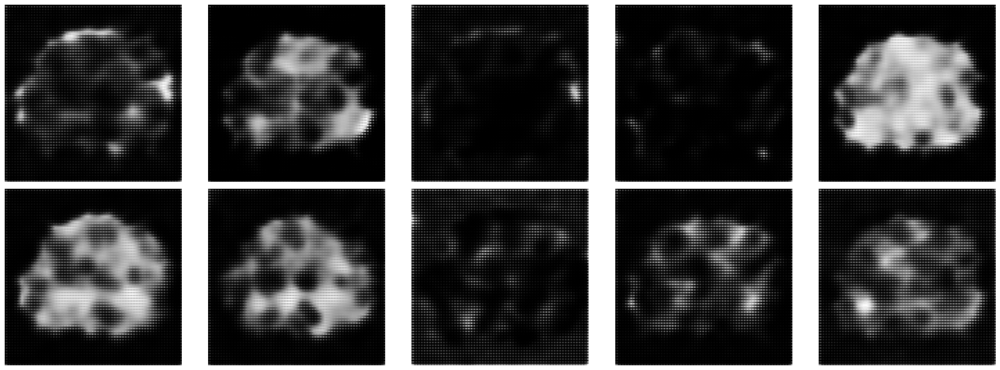

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 1/3750 [00:00<07:18,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 2/3750 [00:00<09:32,  6.55it/s]

1/1 [==============================] - 0s 11ms/step


  0%|                                          | 3/3750 [00:00<08:31,  7.33it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<07:46,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<07:23,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 6/3750 [00:00<07:13,  8.63it/s]

1/1 [==============================] - 0s 16ms/step


  0%|                                          | 7/3750 [00:00<07:22,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 8/3750 [00:00<07:08,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:01<07:01,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<06:54,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 11/3750 [00:01<06:48,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 12/3750 [00:01<06:48,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 13/3750 [00:01<06:46,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 14/3750 [00:01<06:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<06:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 16/3750 [00:01<06:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:01<06:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 18/3750 [00:02<06:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:02<06:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 21/3750 [00:02<06:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 22/3750 [00:02<06:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<06:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 24/3750 [00:02<06:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 25/3750 [00:02<06:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 26/3750 [00:02<06:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 27/3750 [00:02<06:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:03<06:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 29/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▎                                        | 30/3750 [00:03<07:25,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 31/3750 [00:03<07:14,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 32/3750 [00:03<08:02,  7.71it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▎                                        | 33/3750 [00:03<07:47,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 34/3750 [00:03<07:41,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 35/3750 [00:03<07:32,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 36/3750 [00:04<07:29,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 37/3750 [00:04<07:27,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 38/3750 [00:04<07:13,  8.56it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 39/3750 [00:04<06:59,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 40/3750 [00:04<06:52,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 41/3750 [00:04<06:48,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 42/3750 [00:04<06:43,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 43/3750 [00:04<06:42,  9.22it/s]

1/1 [==============================] - 0s 12ms/step


  1%|▍                                        | 44/3750 [00:04<06:53,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 45/3750 [00:05<07:02,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 46/3750 [00:05<07:07,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 47/3750 [00:05<07:05,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 48/3750 [00:05<07:03,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<07:01,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 50/3750 [00:05<06:53,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 51/3750 [00:05<06:45,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 52/3750 [00:05<06:40,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 53/3750 [00:05<06:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 54/3750 [00:06<06:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:06<06:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:06<06:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:06<06:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 58/3750 [00:06<06:33,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 59/3750 [00:06<06:38,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 60/3750 [00:06<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 61/3750 [00:06<06:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 63/3750 [00:07<06:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 64/3750 [00:07<06:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 66/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 67/3750 [00:07<06:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 68/3750 [00:07<06:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 69/3750 [00:07<06:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 70/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 72/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 73/3750 [00:08<06:38,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 74/3750 [00:08<06:48,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▊                                        | 75/3750 [00:08<06:52,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 76/3750 [00:08<06:55,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 77/3750 [00:08<07:00,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 78/3750 [00:08<06:58,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 79/3750 [00:08<06:55,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 80/3750 [00:08<06:49,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 81/3750 [00:09<06:44,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 82/3750 [00:09<06:40,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 83/3750 [00:09<06:37,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 84/3750 [00:09<06:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 85/3750 [00:09<06:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 86/3750 [00:09<06:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 87/3750 [00:09<06:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 88/3750 [00:09<06:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:09<06:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 90/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 91/3750 [00:10<06:42,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


  2%|█                                        | 92/3750 [00:10<06:54,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:10<06:46,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 94/3750 [00:10<06:40,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 96/3750 [00:10<06:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 97/3750 [00:10<06:37,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:10<06:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 99/3750 [00:10<06:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:11<06:38,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 101/3750 [00:11<06:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 102/3750 [00:11<06:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:11<06:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:11<06:37,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 105/3750 [00:11<06:39,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 106/3750 [00:11<06:40,  9.11it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▏                                      | 107/3750 [00:11<07:22,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▏                                      | 108/3750 [00:12<07:26,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 109/3750 [00:12<07:12,  8.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:12<07:00,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 111/3750 [00:12<06:52,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 112/3750 [00:12<06:50,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<06:45,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:12<06:40,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<08:05,  7.48it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▏                                      | 116/3750 [00:12<07:51,  7.71it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 117/3750 [00:13<07:36,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 118/3750 [00:13<07:22,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:13<07:11,  8.41it/s]

1/1 [==============================] - 0s 11ms/step


  3%|█▎                                      | 120/3750 [00:13<07:16,  8.32it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▎                                      | 121/3750 [00:13<08:07,  7.44it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▎                                      | 122/3750 [00:13<08:00,  7.55it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 123/3750 [00:13<07:46,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 124/3750 [00:13<07:36,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▎                                      | 125/3750 [00:14<07:25,  8.14it/s]

1/1 [==============================] - 0s 11ms/step


  3%|█▎                                      | 126/3750 [00:14<07:23,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 127/3750 [00:14<07:08,  8.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:14<06:55,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 129/3750 [00:14<06:44,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 130/3750 [00:14<06:37,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 131/3750 [00:14<06:32,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 132/3750 [00:14<06:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 133/3750 [00:14<06:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 134/3750 [00:15<06:38,  9.06it/s]

1/1 [==============================] - 0s 12ms/step


  4%|█▍                                      | 135/3750 [00:15<06:41,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▍                                      | 136/3750 [00:15<06:41,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 137/3750 [00:15<06:41,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:15<06:37,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▍                                      | 139/3750 [00:15<06:53,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 140/3750 [00:15<07:00,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 141/3750 [00:15<07:03,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 142/3750 [00:15<07:10,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 143/3750 [00:16<07:34,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 144/3750 [00:16<07:28,  8.04it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▌                                      | 145/3750 [00:16<07:30,  8.01it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▌                                      | 146/3750 [00:16<07:18,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 147/3750 [00:16<07:04,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 148/3750 [00:16<06:56,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 149/3750 [00:16<06:51,  8.75it/s]

1/1 [==============================] - 0s 17ms/step


  4%|█▌                                      | 150/3750 [00:16<06:55,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 151/3750 [00:17<06:51,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 152/3750 [00:17<06:45,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 153/3750 [00:17<06:44,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 154/3750 [00:17<06:48,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 155/3750 [00:17<07:23,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 156/3750 [00:17<07:09,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 157/3750 [00:17<06:56,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 158/3750 [00:17<07:06,  8.42it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▋                                      | 159/3750 [00:18<07:08,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 160/3750 [00:18<07:10,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 161/3750 [00:18<07:11,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▋                                      | 162/3750 [00:18<07:12,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 163/3750 [00:18<07:10,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 164/3750 [00:18<07:09,  8.35it/s]

1/1 [==============================] - 0s 15ms/step


  4%|█▊                                      | 165/3750 [00:18<07:17,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 166/3750 [00:18<07:20,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 167/3750 [00:18<07:12,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 168/3750 [00:19<07:08,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 169/3750 [00:19<07:08,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


  5%|█▊                                      | 170/3750 [00:19<07:10,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 171/3750 [00:19<07:07,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 172/3750 [00:19<07:06,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:19<07:04,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 174/3750 [00:19<07:05,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▊                                      | 175/3750 [00:19<07:07,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▉                                      | 176/3750 [00:20<07:05,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 177/3750 [00:20<06:51,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▉                                      | 178/3750 [00:20<06:46,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


  5%|█▉                                      | 179/3750 [00:20<06:51,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▉                                      | 180/3750 [00:20<06:45,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 181/3750 [00:20<06:40,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 182/3750 [00:20<06:35,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 183/3750 [00:20<06:29,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:20<06:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:21<06:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 186/3750 [00:21<06:19,  9.40it/s]

1/1 [==============================] - 0s 12ms/step


  5%|█▉                                      | 187/3750 [00:21<06:46,  8.77it/s]

1/1 [==============================] - 0s 11ms/step


  5%|██                                      | 188/3750 [00:21<07:19,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:21<07:01,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 190/3750 [00:21<06:51,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 191/3750 [00:21<06:39,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:21<06:32,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 193/3750 [00:21<06:26,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:22<06:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 195/3750 [00:22<06:27,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:22<06:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:22<06:29,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 198/3750 [00:22<06:45,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 199/3750 [00:22<06:37,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:22<06:30,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 201/3750 [00:22<06:24,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:22<06:21,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:23<06:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 204/3750 [00:23<06:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 205/3750 [00:23<06:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 206/3750 [00:23<06:18,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:23<06:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 208/3750 [00:23<06:14,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 209/3750 [00:23<06:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 210/3750 [00:23<06:11,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:23<06:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:23<06:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 213/3750 [00:24<06:12,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 214/3750 [00:24<06:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 215/3750 [00:24<06:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:24<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 217/3750 [00:24<06:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 218/3750 [00:24<06:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 219/3750 [00:24<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:24<06:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 221/3750 [00:24<06:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:25<06:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:25<06:08,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 224/3750 [00:25<06:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 225/3750 [00:25<06:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 226/3750 [00:25<06:08,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 227/3750 [00:25<06:08,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 228/3750 [00:25<06:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 229/3750 [00:25<06:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 230/3750 [00:25<06:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 231/3750 [00:25<06:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:26<06:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:26<06:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 234/3750 [00:26<06:15,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 235/3750 [00:26<06:22,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 236/3750 [00:26<06:24,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 237/3750 [00:26<06:23,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 238/3750 [00:26<06:22,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:26<06:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:26<06:36,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 241/3750 [00:27<06:41,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 242/3750 [00:27<06:44,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 243/3750 [00:27<06:48,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▌                                     | 244/3750 [00:27<06:51,  8.51it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▌                                     | 245/3750 [00:27<06:55,  8.43it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▌                                     | 246/3750 [00:27<06:57,  8.40it/s]

1/1 [==============================] - 0s 12ms/step


  7%|██▋                                     | 247/3750 [00:27<07:12,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 248/3750 [00:27<07:06,  8.21it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▋                                     | 249/3750 [00:28<07:22,  7.91it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▋                                     | 250/3750 [00:28<07:21,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 251/3750 [00:28<07:15,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 252/3750 [00:28<07:14,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 253/3750 [00:28<07:15,  8.03it/s]

1/1 [==============================] - 0s 13ms/step


  7%|██▋                                     | 254/3750 [00:28<07:16,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 255/3750 [00:28<07:07,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 256/3750 [00:28<07:01,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:29<06:57,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 258/3750 [00:29<07:13,  8.06it/s]

1/1 [==============================] - 0s 12ms/step


  7%|██▊                                     | 259/3750 [00:29<07:09,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 260/3750 [00:29<07:15,  8.01it/s]

1/1 [==============================] - 0s 16ms/step


  7%|██▊                                     | 261/3750 [00:29<08:08,  7.14it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▊                                     | 262/3750 [00:29<07:46,  7.48it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▊                                     | 263/3750 [00:29<07:33,  7.69it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:29<07:19,  7.94it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 265/3750 [00:30<07:11,  8.08it/s]

1/1 [==============================] - 0s 53ms/step


  7%|██▊                                     | 266/3750 [00:30<07:52,  7.38it/s]

1/1 [==============================] - 0s 11ms/step


  7%|██▊                                     | 267/3750 [00:30<07:39,  7.58it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 268/3750 [00:30<07:25,  7.82it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 269/3750 [00:30<07:20,  7.91it/s]

1/1 [==============================] - 0s 12ms/step


  7%|██▉                                     | 270/3750 [00:30<07:26,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 271/3750 [00:30<07:08,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:30<06:53,  8.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 273/3750 [00:31<06:40,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 274/3750 [00:31<06:29,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:31<06:21,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:31<06:17,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 277/3750 [00:31<06:13,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 278/3750 [00:31<06:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:31<06:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 280/3750 [00:31<06:10,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 281/3750 [00:31<06:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:32<06:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:32<06:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 284/3750 [00:32<06:11,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 285/3750 [00:32<06:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 286/3750 [00:32<06:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 287/3750 [00:32<06:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:32<06:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 289/3750 [00:32<06:14,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 290/3750 [00:32<06:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 291/3750 [00:33<06:15,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 292/3750 [00:33<06:17,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:33<06:15,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 294/3750 [00:33<06:16,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 295/3750 [00:33<06:16,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 296/3750 [00:33<06:22,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 297/3750 [00:33<06:18,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 298/3750 [00:33<06:18,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:33<06:15,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:33<06:11,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 301/3750 [00:34<06:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 302/3750 [00:34<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 303/3750 [00:34<06:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 304/3750 [00:34<06:06,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 305/3750 [00:34<06:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:34<06:02,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 307/3750 [00:34<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:34<06:05,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 309/3750 [00:34<06:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 310/3750 [00:35<06:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 311/3750 [00:35<06:05,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 312/3750 [00:35<06:07,  9.36it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 313/3750 [00:35<06:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:35<06:08,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 315/3750 [00:35<06:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 316/3750 [00:35<06:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 317/3750 [00:35<06:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 318/3750 [00:35<06:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 319/3750 [00:36<06:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:36<06:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 321/3750 [00:36<06:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 322/3750 [00:36<06:05,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 323/3750 [00:36<06:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 324/3750 [00:36<06:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 325/3750 [00:36<06:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 326/3750 [00:36<06:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 327/3750 [00:36<06:08,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 328/3750 [00:36<06:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:37<06:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 330/3750 [00:37<06:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 331/3750 [00:37<06:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 332/3750 [00:37<06:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 333/3750 [00:37<06:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 334/3750 [00:37<06:03,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 335/3750 [00:37<06:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 336/3750 [00:37<06:14,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 337/3750 [00:37<06:22,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 338/3750 [00:38<06:28,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 339/3750 [00:38<06:30,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 340/3750 [00:38<06:34,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 341/3750 [00:38<06:36,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 342/3750 [00:38<06:41,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 343/3750 [00:38<06:49,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 344/3750 [00:38<06:45,  8.41it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▋                                    | 345/3750 [00:38<06:49,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 346/3750 [00:39<06:48,  8.34it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▋                                    | 347/3750 [00:39<06:51,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:39<06:49,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▋                                    | 349/3750 [00:39<06:47,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 350/3750 [00:39<06:44,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 351/3750 [00:39<06:45,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 352/3750 [00:39<06:46,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 353/3750 [00:39<06:48,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▊                                    | 354/3750 [00:39<06:49,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 355/3750 [00:40<06:48,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 356/3750 [00:40<06:47,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 357/3750 [00:40<06:45,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 358/3750 [00:40<06:43,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▊                                    | 359/3750 [00:40<06:45,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 360/3750 [00:40<06:46,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 361/3750 [00:40<06:45,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 362/3750 [00:40<06:46,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 363/3750 [00:41<06:48,  8.29it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▉                                    | 364/3750 [00:41<06:48,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 365/3750 [00:41<06:44,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 366/3750 [00:41<06:44,  8.36it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▉                                    | 367/3750 [00:41<06:43,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:41<06:40,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 369/3750 [00:41<06:38,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 370/3750 [00:41<06:38,  8.48it/s]

1/1 [==============================] - 0s 11ms/step


 10%|███▉                                    | 371/3750 [00:42<06:45,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 372/3750 [00:42<06:47,  8.29it/s]

1/1 [==============================] - 0s 13ms/step


 10%|███▉                                    | 373/3750 [00:42<06:46,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 374/3750 [00:42<06:40,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 375/3750 [00:42<06:48,  8.27it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 376/3750 [00:42<06:51,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 377/3750 [00:42<06:53,  8.16it/s]

1/1 [==============================] - 0s 13ms/step


 10%|████                                    | 378/3750 [00:42<06:59,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 379/3750 [00:43<07:02,  7.98it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████                                    | 380/3750 [00:43<07:05,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 381/3750 [00:43<07:08,  7.86it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████                                    | 382/3750 [00:43<07:10,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 383/3750 [00:43<07:10,  7.81it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 384/3750 [00:43<07:07,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 385/3750 [00:43<07:06,  7.89it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████                                    | 386/3750 [00:43<07:22,  7.60it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████▏                                   | 387/3750 [00:44<07:28,  7.49it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████▏                                   | 388/3750 [00:44<07:40,  7.31it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████▏                                   | 389/3750 [00:44<07:36,  7.37it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████▏                                   | 390/3750 [00:44<07:32,  7.43it/s]

1/1 [==============================] - 0s 13ms/step


 10%|████▏                                   | 391/3750 [00:44<07:29,  7.47it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████▏                                   | 392/3750 [00:44<07:23,  7.57it/s]

1/1 [==============================] - 0s 13ms/step


 10%|████▏                                   | 393/3750 [00:44<07:18,  7.66it/s]

1/1 [==============================] - 0s 13ms/step


 11%|████▏                                   | 394/3750 [00:44<07:14,  7.73it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 395/3750 [00:45<07:08,  7.82it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▏                                   | 396/3750 [00:45<07:08,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 397/3750 [00:45<07:03,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 398/3750 [00:45<07:01,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 399/3750 [00:45<07:01,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 400/3750 [00:45<06:52,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 401/3750 [00:45<06:54,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 402/3750 [00:45<06:59,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 403/3750 [00:46<07:04,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 404/3750 [00:46<07:02,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 405/3750 [00:46<07:06,  7.84it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▎                                   | 406/3750 [00:46<07:07,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 407/3750 [00:46<07:01,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 408/3750 [00:46<06:47,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 409/3750 [00:46<06:33,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 410/3750 [00:46<06:33,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 411/3750 [00:47<06:25,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 412/3750 [00:47<06:16,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 413/3750 [00:47<06:14,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 414/3750 [00:47<06:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 415/3750 [00:47<06:10,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 416/3750 [00:47<06:03,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 417/3750 [00:47<06:08,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▍                                   | 418/3750 [00:47<06:25,  8.64it/s]

1/1 [==============================] - 0s 12ms/step


 11%|████▍                                   | 419/3750 [00:47<06:40,  8.31it/s]

1/1 [==============================] - 0s 12ms/step


 11%|████▍                                   | 420/3750 [00:48<06:47,  8.16it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▍                                   | 421/3750 [00:48<06:49,  8.12it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▌                                   | 422/3750 [00:48<06:39,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 423/3750 [00:48<06:25,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 424/3750 [00:48<06:25,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 425/3750 [00:48<06:22,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 426/3750 [00:48<06:16,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:48<06:13,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 428/3750 [00:49<06:19,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 11%|████▌                                   | 429/3750 [00:49<06:18,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 430/3750 [00:49<06:11,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:49<06:10,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 432/3750 [00:49<06:05,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 433/3750 [00:49<06:00,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:49<06:01,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▋                                   | 435/3750 [00:49<06:06,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 436/3750 [00:49<06:07,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:49<06:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 438/3750 [00:50<06:03,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 439/3750 [00:50<06:00,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:50<05:56,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:50<05:53,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:50<05:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:50<05:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:50<05:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 445/3750 [00:50<05:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 446/3750 [00:50<05:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:51<05:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:51<05:47,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 449/3750 [00:51<05:46,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:51<05:46,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:51<05:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 452/3750 [00:51<05:51,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▊                                   | 453/3750 [00:51<05:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 454/3750 [00:51<05:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 455/3750 [00:51<05:59,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▊                                   | 456/3750 [00:52<06:00,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 457/3750 [00:52<05:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 458/3750 [00:52<05:56,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 459/3750 [00:52<05:53,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 460/3750 [00:52<05:50,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:52<05:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:52<05:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:52<05:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 464/3750 [00:52<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 465/3750 [00:52<05:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 466/3750 [00:53<05:46,  9.47it/s]

1/1 [==============================] - 0s 43ms/step


 12%|████▉                                   | 467/3750 [00:53<06:28,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 468/3750 [00:53<06:23,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:53<06:12,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:53<06:06,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:53<05:59,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 472/3750 [00:53<06:01,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 473/3750 [00:53<06:00,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:53<05:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 475/3750 [00:54<05:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 476/3750 [00:54<05:54,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 477/3750 [00:54<05:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 478/3750 [00:54<05:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:54<05:49,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 480/3750 [00:54<05:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:54<05:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 482/3750 [00:54<05:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 483/3750 [00:54<05:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 484/3750 [00:55<05:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 485/3750 [00:55<05:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 486/3750 [00:55<05:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 487/3750 [00:55<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 488/3750 [00:55<05:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:55<05:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 490/3750 [00:55<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 491/3750 [00:55<05:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:55<05:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 493/3750 [00:56<05:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 494/3750 [00:56<05:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 495/3750 [00:56<05:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 496/3750 [00:56<05:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 497/3750 [00:56<05:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 498/3750 [00:56<05:43,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 499/3750 [00:56<05:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:56<05:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 501/3750 [00:56<05:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 502/3750 [00:56<05:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:57<05:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 504/3750 [00:57<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 505/3750 [00:57<05:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:57<05:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:57<05:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 508/3750 [00:57<05:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 509/3750 [00:57<05:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:57<05:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 511/3750 [00:57<05:40,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 512/3750 [00:58<05:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 513/3750 [00:58<05:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 514/3750 [00:58<05:39,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:58<05:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 516/3750 [00:58<05:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:58<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 518/3750 [00:58<05:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 519/3750 [00:58<05:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 520/3750 [00:58<05:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 521/3750 [00:58<05:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 522/3750 [00:59<05:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:59<05:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 524/3750 [00:59<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 525/3750 [00:59<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 526/3750 [00:59<05:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 527/3750 [00:59<05:37,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:59<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 529/3750 [00:59<05:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:59<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [01:00<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 532/3750 [01:00<05:38,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [01:00<05:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 534/3750 [01:00<05:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 535/3750 [01:00<05:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [01:00<05:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [01:00<05:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 538/3750 [01:00<05:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 539/3750 [01:00<05:36,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [01:00<05:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 541/3750 [01:01<05:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 542/3750 [01:01<05:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 543/3750 [01:01<05:35,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 544/3750 [01:01<05:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 545/3750 [01:01<05:35,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 546/3750 [01:01<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 547/3750 [01:01<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 548/3750 [01:01<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 549/3750 [01:01<05:37,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 550/3750 [01:02<05:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 551/3750 [01:02<05:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 552/3750 [01:02<05:36,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 553/3750 [01:02<05:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 554/3750 [01:02<05:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [01:02<05:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 556/3750 [01:02<05:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 557/3750 [01:02<05:50,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 558/3750 [01:02<05:51,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 559/3750 [01:02<05:56,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 560/3750 [01:03<05:57,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:03<05:57,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 562/3750 [01:03<08:28,  6.27it/s]

1/1 [==============================] - 0s 14ms/step


 15%|██████                                  | 563/3750 [01:03<08:36,  6.17it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 564/3750 [01:03<07:56,  6.68it/s]

1/1 [==============================] - 0s 11ms/step


 15%|██████                                  | 565/3750 [01:03<07:21,  7.21it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 566/3750 [01:03<06:57,  7.63it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 567/3750 [01:04<06:34,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:04<06:42,  7.90it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 569/3750 [01:04<06:25,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 570/3750 [01:04<06:14,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 571/3750 [01:04<06:04,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 572/3750 [01:04<05:57,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 573/3750 [01:04<05:51,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:04<05:56,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 575/3750 [01:04<05:51,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 576/3750 [01:05<05:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:05<05:44,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 578/3750 [01:05<05:40,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 579/3750 [01:05<05:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 580/3750 [01:05<05:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:05<05:35,  9.45it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▏                                 | 582/3750 [01:05<05:44,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:05<05:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 584/3750 [01:05<05:40,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▏                                 | 585/3750 [01:06<05:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 586/3750 [01:06<05:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 587/3750 [01:06<05:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 588/3750 [01:06<05:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:06<05:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 590/3750 [01:06<05:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 591/3750 [01:06<05:30,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 592/3750 [01:06<05:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:06<05:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 594/3750 [01:07<05:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 595/3750 [01:07<05:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 596/3750 [01:07<05:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 597/3750 [01:07<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 598/3750 [01:07<05:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 599/3750 [01:07<05:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 600/3750 [01:07<05:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 601/3750 [01:07<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 602/3750 [01:07<05:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 603/3750 [01:07<05:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 604/3750 [01:08<05:29,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 605/3750 [01:08<05:30,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 606/3750 [01:08<05:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 607/3750 [01:08<05:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 608/3750 [01:08<05:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 609/3750 [01:08<05:28,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 610/3750 [01:08<05:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 611/3750 [01:08<05:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 612/3750 [01:08<05:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:09<05:28,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:09<05:29,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 615/3750 [01:09<05:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:09<05:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:09<05:28,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:09<05:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 619/3750 [01:09<05:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 620/3750 [01:09<05:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 621/3750 [01:09<05:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 622/3750 [01:09<05:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 623/3750 [01:10<05:27,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 624/3750 [01:10<05:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 625/3750 [01:10<05:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 626/3750 [01:10<05:28,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 627/3750 [01:10<05:34,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▋                                 | 628/3750 [01:10<05:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 629/3750 [01:10<05:44,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:10<05:44,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 631/3750 [01:10<05:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 632/3750 [01:11<05:44,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 633/3750 [01:11<06:00,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 634/3750 [01:11<06:18,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 635/3750 [01:11<06:18,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 636/3750 [01:11<06:18,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 637/3750 [01:11<06:30,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▊                                 | 638/3750 [01:11<06:24,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 639/3750 [01:11<06:20,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 640/3750 [01:12<06:22,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 641/3750 [01:12<06:20,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 642/3750 [01:12<06:18,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 643/3750 [01:12<06:27,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 644/3750 [01:12<06:23,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 645/3750 [01:12<06:20,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 646/3750 [01:12<06:23,  8.09it/s]

1/1 [==============================] - 0s 12ms/step


 17%|██████▉                                 | 647/3750 [01:12<06:17,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 648/3750 [01:13<06:04,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:13<06:01,  8.57it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▉                                 | 650/3750 [01:13<06:04,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 17%|██████▉                                 | 651/3750 [01:13<05:58,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 652/3750 [01:13<05:49,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 653/3750 [01:13<05:44,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:13<05:38,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 655/3750 [01:13<05:35,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 656/3750 [01:13<05:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 657/3750 [01:14<05:39,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 658/3750 [01:14<05:39,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:14<05:37,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 660/3750 [01:14<05:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:14<05:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 662/3750 [01:14<05:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 663/3750 [01:14<05:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:14<05:39,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████                                 | 665/3750 [01:15<09:13,  5.57it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 666/3750 [01:15<08:05,  6.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 667/3750 [01:15<07:16,  7.07it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 668/3750 [01:15<06:41,  7.67it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 669/3750 [01:15<06:17,  8.15it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 670/3750 [01:15<06:01,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:15<05:52,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:15<05:43,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 673/3750 [01:15<05:38,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 674/3750 [01:16<05:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 675/3750 [01:16<05:29,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 676/3750 [01:16<05:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 677/3750 [01:16<05:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 678/3750 [01:16<05:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 679/3750 [01:16<05:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 680/3750 [01:16<05:23,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 681/3750 [01:16<05:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 682/3750 [01:16<05:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:16<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 684/3750 [01:17<05:24,  9.45it/s]

1/1 [==============================] - 0s 12ms/step


 18%|███████▎                                | 685/3750 [01:17<05:44,  8.91it/s]

1/1 [==============================] - 0s 13ms/step


 18%|███████▎                                | 686/3750 [01:17<06:03,  8.42it/s]

1/1 [==============================] - 0s 12ms/step


 18%|███████▎                                | 687/3750 [01:17<06:20,  8.04it/s]

1/1 [==============================] - 0s 14ms/step


 18%|███████▎                                | 688/3750 [01:17<06:33,  7.79it/s]

1/1 [==============================] - 0s 13ms/step


 18%|███████▎                                | 689/3750 [01:17<06:28,  7.88it/s]

1/1 [==============================] - 0s 12ms/step


 18%|███████▎                                | 690/3750 [01:17<06:44,  7.56it/s]

1/1 [==============================] - 0s 15ms/step


 18%|███████▎                                | 691/3750 [01:18<06:52,  7.42it/s]

1/1 [==============================] - 0s 14ms/step


 18%|███████▍                                | 692/3750 [01:18<06:43,  7.58it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▍                                | 693/3750 [01:18<06:36,  7.70it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 694/3750 [01:18<06:15,  8.14it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 695/3750 [01:18<05:58,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 696/3750 [01:18<05:47,  8.78it/s]

1/1 [==============================] - 0s 17ms/step


 19%|███████▍                                | 697/3750 [01:18<05:47,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:18<06:23,  7.97it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 699/3750 [01:18<06:03,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:19<05:52,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:19<05:42,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 702/3750 [01:19<05:35,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 703/3750 [01:19<05:33,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:19<05:39,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:19<05:36,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 706/3750 [01:19<05:33,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:19<05:29,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 708/3750 [01:19<05:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:20<05:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 710/3750 [01:20<05:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 711/3750 [01:20<05:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 712/3750 [01:20<05:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:20<05:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 714/3750 [01:20<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:20<05:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:20<05:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 717/3750 [01:20<05:18,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 718/3750 [01:21<05:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:21<05:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 720/3750 [01:21<05:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 721/3750 [01:21<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 722/3750 [01:21<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 723/3750 [01:21<05:18,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 724/3750 [01:21<05:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 725/3750 [01:21<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 726/3750 [01:21<05:19,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 727/3750 [01:21<05:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 728/3750 [01:22<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 729/3750 [01:22<05:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 730/3750 [01:22<05:24,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▊                                | 731/3750 [01:22<05:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 732/3750 [01:22<05:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 733/3750 [01:22<05:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 734/3750 [01:22<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 735/3750 [01:22<05:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 736/3750 [01:22<05:21,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 737/3750 [01:23<05:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:23<05:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 739/3750 [01:23<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 740/3750 [01:23<05:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:23<05:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:23<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:23<05:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 744/3750 [01:23<05:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 745/3750 [01:23<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 746/3750 [01:23<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:24<05:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 748/3750 [01:24<05:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 749/3750 [01:24<05:16,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 750/3750 [01:24<05:15,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 751/3750 [01:24<05:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 752/3750 [01:24<05:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:24<05:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:24<05:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:24<05:25,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:25<05:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 757/3750 [01:25<05:20,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:25<05:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 759/3750 [01:25<05:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:25<05:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:25<05:15,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:25<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:25<05:14,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:25<05:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 765/3750 [01:26<05:14,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:26<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:26<05:13,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:26<05:13,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:26<05:13,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 770/3750 [01:26<05:11,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:26<05:11,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 772/3750 [01:26<05:12,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 773/3750 [01:26<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 774/3750 [01:26<05:13,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 775/3750 [01:27<05:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 776/3750 [01:27<05:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 777/3750 [01:27<05:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 778/3750 [01:27<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 779/3750 [01:27<05:14,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 780/3750 [01:27<05:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 781/3750 [01:27<05:13,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 782/3750 [01:27<05:20,  9.26it/s]

1/1 [==============================] - 0s 13ms/step


 21%|████████▎                               | 783/3750 [01:27<05:39,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 784/3750 [01:28<05:39,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 785/3750 [01:28<05:34,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 786/3750 [01:28<05:30,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 787/3750 [01:28<05:24,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 788/3750 [01:28<05:22,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 789/3750 [01:28<05:30,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 790/3750 [01:28<05:32,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 791/3750 [01:28<05:26,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 792/3750 [01:28<05:28,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 793/3750 [01:29<05:28,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 794/3750 [01:29<05:29,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:29<05:31,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 796/3750 [01:29<05:35,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:29<05:32,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 798/3750 [01:29<05:28,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 799/3750 [01:29<05:27,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▌                               | 800/3750 [01:29<05:34,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 801/3750 [01:29<05:31,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:30<05:26,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:30<05:26,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▌                               | 804/3750 [01:30<05:33,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▌                               | 805/3750 [01:30<05:33,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 806/3750 [01:30<05:25,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 807/3750 [01:30<05:21,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 808/3750 [01:30<05:19,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 809/3750 [01:30<05:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:30<05:17,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 811/3750 [01:31<05:30,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 812/3750 [01:31<05:31,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 813/3750 [01:31<05:25,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:31<05:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 815/3750 [01:31<05:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:31<05:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 817/3750 [01:31<05:15,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 818/3750 [01:31<05:19,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 819/3750 [01:31<05:20,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 820/3750 [01:32<05:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:32<05:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:32<05:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 823/3750 [01:32<05:16,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 824/3750 [01:32<05:25,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 825/3750 [01:32<05:21,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 826/3750 [01:32<05:17,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 827/3750 [01:32<05:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:32<05:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 829/3750 [01:32<05:15,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 830/3750 [01:33<05:21,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 831/3750 [01:33<05:24,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 832/3750 [01:33<05:21,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 833/3750 [01:33<05:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 834/3750 [01:33<05:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 835/3750 [01:33<05:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 836/3750 [01:33<05:13,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 837/3750 [01:33<05:14,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 838/3750 [01:33<05:15,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 839/3750 [01:34<05:16,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:34<05:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 841/3750 [01:34<05:25,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 842/3750 [01:34<05:33,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 843/3750 [01:34<05:29,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 844/3750 [01:34<05:22,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 845/3750 [01:34<05:19,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 846/3750 [01:34<05:17,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:34<05:15,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 848/3750 [01:35<05:20,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████                               | 849/3750 [01:35<05:23,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:35<05:21,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 851/3750 [01:35<05:16,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 852/3750 [01:35<05:23,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 853/3750 [01:35<05:29,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 854/3750 [01:35<05:31,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 855/3750 [01:35<05:34,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 856/3750 [01:36<05:35,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 857/3750 [01:36<05:42,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 858/3750 [01:36<05:43,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 859/3750 [01:36<05:38,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 860/3750 [01:36<05:31,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:36<05:24,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 862/3750 [01:36<05:27,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:36<05:21,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:36<05:15,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:37<05:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 866/3750 [01:37<05:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 867/3750 [01:37<05:16,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 868/3750 [01:37<05:15,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:37<05:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 870/3750 [01:37<05:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 871/3750 [01:37<05:06,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:37<05:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 873/3750 [01:37<05:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 874/3750 [01:37<05:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 875/3750 [01:38<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:38<05:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 877/3750 [01:38<05:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 878/3750 [01:38<05:17,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▍                              | 879/3750 [01:38<05:22,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 880/3750 [01:38<05:17,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 881/3750 [01:38<05:12,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 882/3750 [01:38<05:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 883/3750 [01:38<05:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 884/3750 [01:39<05:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 885/3750 [01:39<05:13,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 886/3750 [01:39<05:14,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 887/3750 [01:39<05:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 888/3750 [01:39<05:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:39<05:06,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 890/3750 [01:39<05:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 891/3750 [01:39<05:07,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 892/3750 [01:39<05:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:40<05:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:40<05:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 895/3750 [01:40<05:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 896/3750 [01:40<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 897/3750 [01:40<05:01,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 898/3750 [01:40<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 899/3750 [01:40<04:59,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 900/3750 [01:40<04:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 901/3750 [01:40<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 902/3750 [01:40<04:59,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 903/3750 [01:41<05:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 904/3750 [01:41<05:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 905/3750 [01:41<05:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 906/3750 [01:41<05:08,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 907/3750 [01:41<05:18,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 908/3750 [01:41<05:15,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 909/3750 [01:41<05:10,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:41<05:06,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 911/3750 [01:41<05:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:42<05:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 913/3750 [01:42<05:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 914/3750 [01:42<05:08,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:42<05:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 916/3750 [01:42<05:06,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 917/3750 [01:42<05:08,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 918/3750 [01:42<05:20,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 919/3750 [01:42<05:15,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 920/3750 [01:42<05:10,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 921/3750 [01:43<05:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 922/3750 [01:43<05:06,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 923/3750 [01:43<05:06,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 924/3750 [01:43<05:17,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 925/3750 [01:43<05:17,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 926/3750 [01:43<05:12,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:43<05:07,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 928/3750 [01:43<05:04,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 929/3750 [01:43<05:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 930/3750 [01:44<05:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:44<05:12,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:44<05:09,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 933/3750 [01:44<05:06,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 934/3750 [01:44<05:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 935/3750 [01:44<05:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 936/3750 [01:44<04:59,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 937/3750 [01:44<04:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 938/3750 [01:44<04:56,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 939/3750 [01:44<04:57,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 940/3750 [01:45<05:08,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 25%|██████████                              | 941/3750 [01:45<05:09,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 942/3750 [01:45<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 943/3750 [01:45<05:01,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 944/3750 [01:45<04:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 945/3750 [01:45<04:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:45<05:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 947/3750 [01:45<05:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:45<05:02,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 949/3750 [01:46<05:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 950/3750 [01:46<04:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 951/3750 [01:46<04:57,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 952/3750 [01:46<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 953/3750 [01:46<04:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 954/3750 [01:46<04:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 955/3750 [01:46<05:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:46<05:01,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▏                             | 957/3750 [01:46<05:14,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 958/3750 [01:47<05:20,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 959/3750 [01:47<05:25,  8.57it/s]

1/1 [==============================] - 0s 12ms/step


 26%|██████████▏                             | 960/3750 [01:47<05:26,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 961/3750 [01:47<05:28,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 962/3750 [01:47<05:26,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 963/3750 [01:47<05:38,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 964/3750 [01:47<05:31,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 965/3750 [01:47<05:27,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 966/3750 [01:48<05:24,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 967/3750 [01:48<05:19,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 968/3750 [01:48<05:11,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 969/3750 [01:48<05:09,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 970/3750 [01:48<05:14,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 971/3750 [01:48<05:12,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:48<05:06,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 973/3750 [01:48<05:02,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 974/3750 [01:48<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 975/3750 [01:48<04:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 976/3750 [01:49<04:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 977/3750 [01:49<04:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:49<04:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 979/3750 [01:49<04:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 980/3750 [01:49<04:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 981/3750 [01:49<04:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:49<04:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:49<04:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 984/3750 [01:49<04:50,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 985/3750 [01:50<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:50<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 987/3750 [01:50<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 988/3750 [01:50<04:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:50<04:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 990/3750 [01:50<04:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 991/3750 [01:50<04:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 992/3750 [01:50<04:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 993/3750 [01:50<04:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 994/3750 [01:50<04:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 995/3750 [01:51<04:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:51<04:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 997/3750 [01:51<04:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 998/3750 [01:51<04:48,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 999/3750 [01:51<04:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1000/3750 [01:51<04:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1001/3750 [01:51<04:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:51<04:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1003/3750 [01:52<06:20,  7.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:52<05:58,  7.67it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:52<05:39,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1006/3750 [01:52<05:25,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:52<05:13,  8.74it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1008/3750 [01:52<05:06,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1009/3750 [01:52<05:00,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:52<04:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1011/3750 [01:52<04:55,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1012/3750 [01:53<04:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1013/3750 [01:53<05:00,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 27%|██████████▌                            | 1014/3750 [01:53<05:02,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:53<05:01,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:53<04:57,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1017/3750 [01:53<04:56,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1018/3750 [01:53<04:54,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:53<04:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1020/3750 [01:53<04:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:53<04:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:54<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:54<04:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1024/3750 [01:54<04:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1025/3750 [01:54<04:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1026/3750 [01:54<04:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1027/3750 [01:54<04:46,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:54<04:52,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:54<04:50,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1030/3750 [01:54<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:55<04:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1032/3750 [01:55<04:47,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▋                            | 1033/3750 [01:55<04:45,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:55<04:45,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1035/3750 [01:55<04:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1036/3750 [01:55<04:45,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1037/3750 [01:55<04:44,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:55<04:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1039/3750 [01:55<04:43,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1040/3750 [01:55<04:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1041/3750 [01:56<04:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1042/3750 [01:56<04:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1043/3750 [01:56<04:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1044/3750 [01:56<04:44,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1045/3750 [01:56<04:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1046/3750 [01:56<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1047/3750 [01:56<04:43,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1048/3750 [01:56<04:43,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1049/3750 [01:56<04:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [01:57<04:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1051/3750 [01:57<04:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1052/3750 [01:57<04:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1053/3750 [01:57<04:42,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1054/3750 [01:57<04:43,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:57<04:43,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [01:57<04:42,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1057/3750 [01:57<04:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1058/3750 [01:57<04:41,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1059/3750 [01:57<04:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1060/3750 [01:58<04:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1061/3750 [01:58<04:41,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:58<04:41,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1063/3750 [01:58<04:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [01:58<04:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1065/3750 [01:58<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [01:58<04:42,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [01:58<04:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [01:58<04:42,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:59<04:42,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [01:59<04:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:59<04:42,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1072/3750 [01:59<04:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1073/3750 [01:59<04:41,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [01:59<04:40,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [01:59<04:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:59<04:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [01:59<04:41,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:59<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [02:00<04:40,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1080/3750 [02:00<04:40,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1081/3750 [02:00<04:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [02:00<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [02:00<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1084/3750 [02:00<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [02:00<04:38,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [02:00<04:40,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1087/3750 [02:00<04:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [02:01<04:40,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1089/3750 [02:01<04:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1090/3750 [02:01<04:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1091/3750 [02:01<04:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1092/3750 [02:01<04:37,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1093/3750 [02:01<04:37,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1094/3750 [02:01<04:37,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1095/3750 [02:01<04:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1096/3750 [02:01<04:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1097/3750 [02:01<04:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1098/3750 [02:02<04:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1099/3750 [02:02<04:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [02:02<04:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1101/3750 [02:02<04:38,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1102/3750 [02:02<04:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1103/3750 [02:02<04:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1104/3750 [02:02<04:38,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [02:02<04:37,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▌                           | 1106/3750 [02:02<04:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [02:03<04:36,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1108/3750 [02:03<04:36,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1109/3750 [02:03<04:36,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [02:03<04:37,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1111/3750 [02:03<04:36,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1112/3750 [02:03<04:35,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1113/3750 [02:03<04:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1114/3750 [02:03<04:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1115/3750 [02:03<04:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1116/3750 [02:03<04:36,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1117/3750 [02:04<04:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1118/3750 [02:04<04:35,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1119/3750 [02:04<04:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1120/3750 [02:04<04:34,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1121/3750 [02:04<04:34,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [02:04<04:36,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1123/3750 [02:04<04:36,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1124/3750 [02:04<04:35,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:04<04:35,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1126/3750 [02:05<04:34,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1127/3750 [02:05<04:33,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1128/3750 [02:05<04:33,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1129/3750 [02:05<04:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1130/3750 [02:05<04:33,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [02:05<04:35,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1132/3750 [02:05<04:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1133/3750 [02:05<04:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:05<04:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1135/3750 [02:05<04:33,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1136/3750 [02:06<04:33,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1137/3750 [02:06<04:32,  9.58it/s]

1/1 [==============================] - 0s 11ms/step


 30%|███████████▊                           | 1138/3750 [02:06<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:06<04:36,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1140/3750 [02:06<04:35,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1141/3750 [02:06<04:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▉                           | 1142/3750 [02:06<04:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1143/3750 [02:06<04:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1144/3750 [02:06<04:46,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1145/3750 [02:07<04:43,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1146/3750 [02:07<04:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1147/3750 [02:07<04:38,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:07<04:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1149/3750 [02:07<04:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1150/3750 [02:07<04:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1151/3750 [02:07<04:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1152/3750 [02:07<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1153/3750 [02:07<04:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1154/3750 [02:07<04:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:08<04:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1156/3750 [02:08<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:08<04:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:08<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:08<04:33,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1160/3750 [02:08<04:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1161/3750 [02:08<04:32,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1162/3750 [02:08<04:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1163/3750 [02:08<04:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1164/3750 [02:09<04:31,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1165/3750 [02:09<04:31,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:09<04:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1167/3750 [02:09<04:30,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1168/3750 [02:09<04:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1169/3750 [02:09<04:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1170/3750 [02:09<04:31,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1171/3750 [02:09<04:30,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1172/3750 [02:09<04:30,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1173/3750 [02:09<04:29,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1174/3750 [02:10<04:29,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:10<04:30,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1176/3750 [02:10<04:30,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1177/3750 [02:10<04:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1178/3750 [02:10<04:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1179/3750 [02:10<04:29,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:10<04:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1181/3750 [02:10<04:28,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:10<04:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1183/3750 [02:11<04:28,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1184/3750 [02:11<04:28,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:11<04:28,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1186/3750 [02:11<04:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1187/3750 [02:11<04:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1188/3750 [02:11<04:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1189/3750 [02:11<04:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1190/3750 [02:11<04:29,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:11<04:29,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1192/3750 [02:11<04:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1193/3750 [02:12<04:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1194/3750 [02:12<04:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1195/3750 [02:12<04:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1196/3750 [02:12<04:40,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1197/3750 [02:12<04:38,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1198/3750 [02:12<04:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1199/3750 [02:12<04:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:12<04:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1201/3750 [02:12<04:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1202/3750 [02:13<04:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1203/3750 [02:13<04:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1204/3750 [02:13<04:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1205/3750 [02:13<04:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1206/3750 [02:13<04:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:13<04:35,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1208/3750 [02:13<04:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:13<04:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:13<04:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1211/3750 [02:14<04:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:14<04:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1213/3750 [02:14<04:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:14<04:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:14<04:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:14<04:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1217/3750 [02:14<04:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▋                          | 1218/3750 [02:14<04:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1219/3750 [02:14<04:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1220/3750 [02:14<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:15<04:25,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:15<04:26,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1223/3750 [02:15<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1224/3750 [02:15<04:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:15<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:15<04:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1227/3750 [02:15<04:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:15<04:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1229/3750 [02:15<04:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1230/3750 [02:16<04:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1231/3750 [02:16<04:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1232/3750 [02:16<04:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1233/3750 [02:16<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:16<04:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1235/3750 [02:16<04:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1236/3750 [02:16<04:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1237/3750 [02:16<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1238/3750 [02:16<04:23,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1239/3750 [02:16<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:17<04:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1241/3750 [02:17<04:24,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1242/3750 [02:17<04:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1243/3750 [02:17<04:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:17<04:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1245/3750 [02:17<04:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1246/3750 [02:17<04:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1247/3750 [02:17<04:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1248/3750 [02:17<04:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1249/3750 [02:18<04:22,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1250/3750 [02:18<04:21,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1251/3750 [02:18<04:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:18<04:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:18<04:21,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1254/3750 [02:18<04:20,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:18<04:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1256/3750 [02:18<04:21,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:18<04:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:18<04:20,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:19<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1260/3750 [02:19<04:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1261/3750 [02:19<04:21,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1262/3750 [02:19<04:20,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1263/3750 [02:19<04:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:19<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:19<04:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:19<04:19,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:19<04:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1268/3750 [02:20<04:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:20<04:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:20<04:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1271/3750 [02:20<04:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:20<04:18,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:20<04:18,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:20<04:17,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1275/3750 [02:20<04:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:20<04:16,  9.64it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1277/3750 [02:20<04:16,  9.63it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:21<04:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1279/3750 [02:21<04:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1280/3750 [02:21<04:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1281/3750 [02:21<04:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1282/3750 [02:21<04:19,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1283/3750 [02:21<04:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:21<04:18,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1285/3750 [02:21<04:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:21<04:17,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▍                         | 1287/3750 [02:21<04:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1288/3750 [02:22<04:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1289/3750 [02:22<04:18,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▍                         | 1290/3750 [02:22<04:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1291/3750 [02:22<04:18,  9.52it/s]

1/1 [==============================] - 0s 16ms/step


 34%|█████████████▍                         | 1292/3750 [02:22<04:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1293/3750 [02:22<04:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:22<04:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:22<04:19,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:22<04:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1297/3750 [02:23<04:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1298/3750 [02:23<04:17,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1299/3750 [02:23<04:22,  9.34it/s]

1/1 [==============================] - 0s 13ms/step


 35%|█████████████▌                         | 1300/3750 [02:23<04:35,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1301/3750 [02:23<04:36,  8.85it/s]

1/1 [==============================] - 0s 12ms/step


 35%|█████████████▌                         | 1302/3750 [02:23<05:11,  7.87it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▌                         | 1303/3750 [02:23<04:58,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1304/3750 [02:23<04:48,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1305/3750 [02:23<04:40,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1306/3750 [02:24<04:34,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1307/3750 [02:24<04:32,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1308/3750 [02:24<04:28,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1309/3750 [02:24<04:27,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1310/3750 [02:24<04:31,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1311/3750 [02:24<04:30,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1312/3750 [02:24<04:28,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1313/3750 [02:24<04:29,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1314/3750 [02:24<04:29,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1315/3750 [02:25<04:29,  9.04it/s]

1/1 [==============================] - 0s 12ms/step


 35%|█████████████▋                         | 1316/3750 [02:25<04:38,  8.73it/s]

1/1 [==============================] - 0s 19ms/step


 35%|█████████████▋                         | 1317/3750 [02:25<04:46,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1318/3750 [02:25<04:40,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:25<04:37,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1320/3750 [02:25<04:31,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1321/3750 [02:25<04:30,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1322/3750 [02:25<04:31,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1323/3750 [02:26<04:32,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1324/3750 [02:26<04:33,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1325/3750 [02:26<04:30,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1326/3750 [02:26<04:32,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1327/3750 [02:26<04:36,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1328/3750 [02:26<04:35,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1329/3750 [02:26<04:32,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1330/3750 [02:26<04:34,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1331/3750 [02:26<04:43,  8.54it/s]

1/1 [==============================] - 0s 12ms/step


 36%|█████████████▊                         | 1332/3750 [02:27<04:46,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▊                         | 1333/3750 [02:27<04:48,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▊                         | 1334/3750 [02:27<05:09,  7.81it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1335/3750 [02:27<05:05,  7.90it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1336/3750 [02:27<05:03,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1337/3750 [02:27<04:58,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1338/3750 [02:27<04:48,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1339/3750 [02:27<04:39,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1340/3750 [02:28<04:31,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1341/3750 [02:28<04:27,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1342/3750 [02:28<04:30,  8.91it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1343/3750 [02:28<04:40,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1344/3750 [02:28<04:37,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1345/3750 [02:28<04:33,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1346/3750 [02:28<04:37,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1347/3750 [02:28<04:36,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1348/3750 [02:28<04:34,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1349/3750 [02:29<04:30,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1350/3750 [02:29<04:27,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1351/3750 [02:29<04:25,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1352/3750 [02:29<04:27,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1353/3750 [02:29<04:29,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1354/3750 [02:29<04:33,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1355/3750 [02:29<04:33,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1356/3750 [02:29<04:28,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1357/3750 [02:29<04:24,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1358/3750 [02:30<04:23,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1359/3750 [02:30<04:20,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1360/3750 [02:30<04:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1361/3750 [02:30<04:25,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1362/3750 [02:30<04:25,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1363/3750 [02:30<04:23,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1364/3750 [02:30<04:20,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1365/3750 [02:30<04:18,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:30<04:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:31<04:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1368/3750 [02:31<04:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:31<04:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1370/3750 [02:31<04:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:31<04:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1372/3750 [02:31<04:14,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1373/3750 [02:31<04:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1374/3750 [02:31<04:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:31<04:43,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1376/3750 [02:32<04:35,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:32<04:28,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1378/3750 [02:32<04:22,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:32<04:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1380/3750 [02:32<04:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1381/3750 [02:32<04:39,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:32<04:32,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:32<04:29,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1384/3750 [02:32<04:24,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1385/3750 [02:33<04:20,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:33<04:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1387/3750 [02:33<04:14,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:33<04:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1389/3750 [02:33<04:17,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1390/3750 [02:33<04:14,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:33<04:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1392/3750 [02:33<04:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:33<04:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:33<04:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:34<04:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1396/3750 [02:34<04:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1397/3750 [02:34<04:07,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1398/3750 [02:34<04:08,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1399/3750 [02:34<04:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1400/3750 [02:34<04:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1401/3750 [02:34<04:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1402/3750 [02:34<04:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1403/3750 [02:34<04:12,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1404/3750 [02:35<04:18,  9.06it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1405/3750 [02:35<04:24,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1406/3750 [02:35<04:19,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1407/3750 [02:35<04:18,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1408/3750 [02:35<04:17,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1409/3750 [02:35<04:18,  9.06it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1410/3750 [02:35<04:25,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1411/3750 [02:35<04:28,  8.71it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1412/3750 [02:35<04:32,  8.58it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1413/3750 [02:36<04:34,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1414/3750 [02:36<04:30,  8.63it/s]

1/1 [==============================] - 0s 17ms/step


 38%|██████████████▋                        | 1415/3750 [02:36<05:24,  7.19it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1416/3750 [02:36<05:13,  7.46it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1417/3750 [02:36<05:09,  7.54it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1418/3750 [02:36<04:54,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▊                        | 1419/3750 [02:36<04:45,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1420/3750 [02:36<04:36,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1421/3750 [02:37<04:30,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1422/3750 [02:37<04:30,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1423/3750 [02:37<04:25,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1424/3750 [02:37<04:20,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:37<04:15,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1426/3750 [02:37<04:15,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:37<04:13,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1428/3750 [02:37<04:14,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1429/3750 [02:37<04:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1430/3750 [02:38<04:11,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▉                        | 1431/3750 [02:38<04:13,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1432/3750 [02:38<04:18,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1433/3750 [02:38<04:22,  8.82it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▉                        | 1434/3750 [02:38<04:32,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1435/3750 [02:38<04:32,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1436/3750 [02:38<04:33,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1437/3750 [02:38<04:34,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1438/3750 [02:38<04:34,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1439/3750 [02:39<04:36,  8.35it/s]

1/1 [==============================] - 0s 12ms/step


 38%|██████████████▉                        | 1440/3750 [02:39<04:47,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▉                        | 1441/3750 [02:39<04:45,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1442/3750 [02:39<04:44,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 38%|███████████████                        | 1443/3750 [02:39<04:43,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1444/3750 [02:39<04:45,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1445/3750 [02:39<04:39,  8.24it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███████████████                        | 1446/3750 [02:40<04:51,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1447/3750 [02:40<04:47,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1448/3750 [02:40<04:42,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1449/3750 [02:40<04:36,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1450/3750 [02:40<04:34,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1451/3750 [02:40<04:33,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1452/3750 [02:40<04:31,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1453/3750 [02:40<04:33,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1454/3750 [02:40<04:36,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1455/3750 [02:41<04:35,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1456/3750 [02:41<04:34,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1457/3750 [02:41<04:34,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▏                       | 1458/3750 [02:41<04:37,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1459/3750 [02:41<04:28,  8.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1460/3750 [02:41<04:20,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:41<04:14,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:41<04:11,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1463/3750 [02:41<04:10,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:42<04:07,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1465/3750 [02:42<04:13,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1466/3750 [02:42<04:14,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1467/3750 [02:42<04:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:42<04:06,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1469/3750 [02:42<04:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1470/3750 [02:42<04:08,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1471/3750 [02:42<04:11,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1472/3750 [02:42<04:15,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:43<04:13,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:43<04:09,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1475/3750 [02:43<04:06,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1476/3750 [02:43<04:12,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1477/3750 [02:43<04:18,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1478/3750 [02:43<04:22,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▍                       | 1479/3750 [02:43<04:28,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▍                       | 1480/3750 [02:43<04:33,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▍                       | 1481/3750 [02:44<04:32,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▍                       | 1482/3750 [02:44<04:31,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1483/3750 [02:44<04:32,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1484/3750 [02:44<05:03,  7.47it/s]

1/1 [==============================] - 0s 15ms/step


 40%|███████████████▍                       | 1485/3750 [02:44<04:57,  7.61it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1486/3750 [02:44<04:48,  7.84it/s]

1/1 [==============================] - 0s 12ms/step


 40%|███████████████▍                       | 1487/3750 [02:44<04:43,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1488/3750 [02:44<04:39,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1489/3750 [02:45<04:35,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1490/3750 [02:45<04:40,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1491/3750 [02:45<04:35,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1492/3750 [02:45<04:33,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1493/3750 [02:45<04:31,  8.33it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███████████████▌                       | 1494/3750 [02:45<04:36,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1495/3750 [02:45<04:34,  8.22it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▌                       | 1496/3750 [02:45<04:34,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1497/3750 [02:45<04:33,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1498/3750 [02:46<04:34,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1499/3750 [02:46<04:37,  8.10it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▌                       | 1500/3750 [02:46<04:43,  7.94it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1501/3750 [02:46<04:29,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1502/3750 [02:46<04:21,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:46<04:17,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1504/3750 [02:46<04:11,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:46<04:06,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:47<04:03,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:47<04:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:47<04:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1509/3750 [02:47<03:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:47<03:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:47<03:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1512/3750 [02:47<03:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:47<03:56,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1514/3750 [02:47<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:47<03:54,  9.53it/s]

1/1 [==============================] - 0s 12ms/step


 40%|███████████████▊                       | 1516/3750 [02:48<03:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:48<04:00,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1518/3750 [02:48<04:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1519/3750 [02:48<03:58,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1520/3750 [02:48<04:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1521/3750 [02:48<03:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1522/3750 [02:48<03:58,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1523/3750 [02:48<03:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1524/3750 [02:48<03:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:49<03:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1526/3750 [02:49<03:55,  9.45it/s]

1/1 [==============================] - 0s 11ms/step


 41%|███████████████▉                       | 1527/3750 [02:49<04:01,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1528/3750 [02:49<04:02,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:49<04:10,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1530/3750 [02:49<04:07,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1531/3750 [02:49<04:04,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1532/3750 [02:49<04:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1533/3750 [02:49<03:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1534/3750 [02:50<03:59,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1535/3750 [02:50<04:00,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1536/3750 [02:50<04:00,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1537/3750 [02:50<04:02,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1538/3750 [02:50<04:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1539/3750 [02:50<03:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1540/3750 [02:50<03:59,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1541/3750 [02:50<03:58,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1542/3750 [02:50<03:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1543/3750 [02:50<03:55,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1544/3750 [02:51<03:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1545/3750 [02:51<03:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1546/3750 [02:51<03:53,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1547/3750 [02:51<03:52,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1548/3750 [02:51<03:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1549/3750 [02:51<03:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1550/3750 [02:51<03:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1551/3750 [02:51<03:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:51<03:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1553/3750 [02:52<03:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1554/3750 [02:52<03:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1555/3750 [02:52<03:55,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:52<03:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:52<03:54,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▏                      | 1558/3750 [02:52<03:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1559/3750 [02:52<03:56,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▏                      | 1560/3750 [02:52<03:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1561/3750 [02:52<03:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1562/3750 [02:53<03:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1563/3750 [02:53<03:59,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1564/3750 [02:53<04:05,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1565/3750 [02:53<04:05,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1566/3750 [02:53<04:01,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:53<03:57,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1568/3750 [02:53<03:56,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1569/3750 [02:53<03:57,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1570/3750 [02:53<03:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1571/3750 [02:54<03:57,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1572/3750 [02:54<03:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1573/3750 [02:54<03:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1574/3750 [02:54<03:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1575/3750 [02:54<04:00,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:54<03:58,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1577/3750 [02:54<03:57,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1578/3750 [02:54<03:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1579/3750 [02:54<03:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1580/3750 [02:54<03:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1581/3750 [02:55<03:51,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:55<03:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:55<03:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:55<03:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1585/3750 [02:55<03:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1586/3750 [02:55<03:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:55<03:50,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▌                      | 1588/3750 [02:55<03:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1589/3750 [02:55<03:50,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▌                      | 1590/3750 [02:56<03:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1591/3750 [02:56<03:52,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:56<03:50,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▌                      | 1593/3750 [02:56<03:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1594/3750 [02:56<03:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1595/3750 [02:56<03:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:56<03:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:56<03:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:56<03:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1599/3750 [02:57<03:51,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1600/3750 [02:57<03:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1601/3750 [02:57<03:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1602/3750 [02:57<03:49,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▋                      | 1603/3750 [02:57<03:51,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▋                      | 1604/3750 [02:57<03:52,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1605/3750 [02:57<03:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:57<03:51,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1607/3750 [02:57<03:50,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1608/3750 [02:57<03:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1609/3750 [02:58<03:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1610/3750 [02:58<03:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1611/3750 [02:58<03:48,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [02:58<03:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1613/3750 [02:58<03:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1614/3750 [02:58<03:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1615/3750 [02:58<03:58,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1616/3750 [02:58<04:01,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:58<04:03,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1618/3750 [02:59<04:04,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1619/3750 [02:59<04:06,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1620/3750 [02:59<04:08,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1621/3750 [02:59<04:07,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [02:59<04:08,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1623/3750 [02:59<04:08,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1624/3750 [02:59<04:07,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1625/3750 [02:59<04:08,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1626/3750 [03:00<04:07,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1627/3750 [03:00<04:06,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1628/3750 [03:00<04:06,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1629/3750 [03:00<04:06,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1630/3750 [03:00<04:06,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1631/3750 [03:00<04:06,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████▉                      | 1632/3750 [03:00<04:06,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1633/3750 [03:00<04:06,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 44%|████████████████▉                      | 1634/3750 [03:00<04:06,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1635/3750 [03:01<04:07,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1636/3750 [03:01<04:06,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1637/3750 [03:01<04:06,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1638/3750 [03:01<04:07,  8.55it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1639/3750 [03:01<04:10,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1640/3750 [03:01<04:12,  8.37it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1641/3750 [03:01<04:13,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1642/3750 [03:01<04:11,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1643/3750 [03:02<04:10,  8.41it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1644/3750 [03:02<04:11,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1645/3750 [03:02<04:08,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1646/3750 [03:02<04:07,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1647/3750 [03:02<04:18,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1648/3750 [03:02<04:17,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [03:02<04:14,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1650/3750 [03:02<04:11,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1651/3750 [03:02<04:08,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1652/3750 [03:03<04:06,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1653/3750 [03:03<04:04,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1654/3750 [03:03<04:05,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1655/3750 [03:03<04:03,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1656/3750 [03:03<04:02,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1657/3750 [03:03<04:04,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1658/3750 [03:03<04:05,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1659/3750 [03:03<04:04,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1660/3750 [03:04<04:04,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1661/3750 [03:04<04:03,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1662/3750 [03:04<04:03,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1663/3750 [03:04<04:04,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1664/3750 [03:04<04:03,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1665/3750 [03:04<04:03,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1666/3750 [03:04<04:03,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1667/3750 [03:04<04:04,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1668/3750 [03:04<04:04,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▎                     | 1669/3750 [03:05<04:07,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1670/3750 [03:05<04:06,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1671/3750 [03:05<04:06,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1672/3750 [03:05<04:04,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1673/3750 [03:05<04:02,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1674/3750 [03:05<04:02,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1675/3750 [03:05<04:00,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [03:05<04:00,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [03:06<03:59,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1678/3750 [03:06<03:59,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1679/3750 [03:06<04:00,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1680/3750 [03:06<04:00,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1681/3750 [03:06<04:00,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1682/3750 [03:06<04:00,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1683/3750 [03:06<03:59,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1684/3750 [03:06<03:59,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1685/3750 [03:06<04:00,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1686/3750 [03:07<03:59,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1687/3750 [03:07<04:00,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [03:07<03:59,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1689/3750 [03:07<04:00,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1690/3750 [03:07<04:00,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1691/3750 [03:07<03:59,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1692/3750 [03:07<03:59,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1693/3750 [03:07<03:59,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1694/3750 [03:08<04:00,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1695/3750 [03:08<03:59,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1696/3750 [03:08<03:59,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1697/3750 [03:08<04:00,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1698/3750 [03:08<03:59,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1699/3750 [03:08<03:59,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1700/3750 [03:08<03:59,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1701/3750 [03:08<04:00,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:08<03:58,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [03:09<03:59,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1704/3750 [03:09<03:59,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1705/3750 [03:09<03:59,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:09<03:58,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1707/3750 [03:09<03:58,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1708/3750 [03:09<03:58,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1709/3750 [03:09<03:58,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:09<03:57,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:09<03:56,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1712/3750 [03:10<03:57,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:10<03:57,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1714/3750 [03:10<03:58,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1715/3750 [03:10<03:57,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1716/3750 [03:10<03:56,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1717/3750 [03:10<03:57,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1718/3750 [03:10<03:59,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1719/3750 [03:10<03:59,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1720/3750 [03:11<03:59,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1721/3750 [03:11<03:59,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1722/3750 [03:11<03:58,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:11<03:57,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:11<03:56,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1725/3750 [03:11<03:55,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1726/3750 [03:11<03:54,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1727/3750 [03:11<03:54,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1728/3750 [03:11<03:53,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1729/3750 [03:12<03:53,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1730/3750 [03:12<03:55,  8.57it/s]

1/1 [==============================] - 0s 12ms/step


 46%|██████████████████                     | 1731/3750 [03:12<06:34,  5.12it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1732/3750 [03:12<05:46,  5.83it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1733/3750 [03:12<05:12,  6.45it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:12<04:49,  6.97it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1735/3750 [03:13<04:32,  7.38it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1736/3750 [03:13<04:22,  7.67it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1737/3750 [03:13<04:15,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1738/3750 [03:13<04:08,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1739/3750 [03:13<04:04,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1740/3750 [03:13<04:01,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1741/3750 [03:13<03:59,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1742/3750 [03:13<04:04,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████▏                    | 1743/3750 [03:14<04:00,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1744/3750 [03:14<03:58,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1745/3750 [03:14<03:56,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1746/3750 [03:14<03:56,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1747/3750 [03:14<03:58,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1748/3750 [03:14<03:57,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1749/3750 [03:14<03:56,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1750/3750 [03:14<03:55,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1751/3750 [03:14<04:00,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1752/3750 [03:15<03:59,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1753/3750 [03:15<03:56,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1754/3750 [03:15<03:58,  8.38it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1755/3750 [03:15<03:57,  8.41it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1756/3750 [03:15<03:58,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1757/3750 [03:15<03:59,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1758/3750 [03:15<03:56,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1759/3750 [03:15<03:52,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1760/3750 [03:16<03:48,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1761/3750 [03:16<03:54,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1762/3750 [03:16<04:01,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1763/3750 [03:16<04:04,  8.13it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▎                    | 1764/3750 [03:16<04:07,  8.02it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▎                    | 1765/3750 [03:16<04:07,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1766/3750 [03:16<04:20,  7.60it/s]

1/1 [==============================] - 0s 14ms/step


 47%|██████████████████▍                    | 1767/3750 [03:16<04:20,  7.62it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1768/3750 [03:17<04:15,  7.75it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▍                    | 1769/3750 [03:17<04:15,  7.76it/s]

1/1 [==============================] - 0s 15ms/step


 47%|██████████████████▍                    | 1770/3750 [03:17<04:25,  7.46it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▍                    | 1771/3750 [03:17<04:26,  7.43it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1772/3750 [03:17<04:23,  7.49it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1773/3750 [03:17<04:21,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1774/3750 [03:17<04:18,  7.65it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1775/3750 [03:17<04:16,  7.70it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1776/3750 [03:18<04:14,  7.76it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1777/3750 [03:18<04:11,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1778/3750 [03:18<04:10,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1779/3750 [03:18<04:09,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1780/3750 [03:18<04:11,  7.85it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▌                    | 1781/3750 [03:18<04:12,  7.79it/s]

1/1 [==============================] - 0s 12ms/step


 48%|██████████████████▌                    | 1782/3750 [03:18<04:14,  7.73it/s]

1/1 [==============================] - 0s 13ms/step


 48%|██████████████████▌                    | 1783/3750 [03:18<04:16,  7.68it/s]

1/1 [==============================] - 0s 14ms/step


 48%|██████████████████▌                    | 1784/3750 [03:19<04:18,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1785/3750 [03:19<04:38,  7.05it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▌                    | 1786/3750 [03:19<04:36,  7.11it/s]

1/1 [==============================] - 0s 13ms/step


 48%|██████████████████▌                    | 1787/3750 [03:19<04:34,  7.14it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1788/3750 [03:19<04:28,  7.30it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1789/3750 [03:19<04:22,  7.47it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▌                    | 1790/3750 [03:19<04:17,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1791/3750 [03:20<04:12,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1792/3750 [03:20<04:10,  7.81it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▋                    | 1793/3750 [03:20<04:10,  7.83it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▋                    | 1794/3750 [03:20<04:09,  7.85it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1795/3750 [03:20<04:05,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1796/3750 [03:20<04:03,  8.01it/s]

1/1 [==============================] - 0s 12ms/step


 48%|██████████████████▋                    | 1797/3750 [03:20<03:59,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1798/3750 [03:20<04:05,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1799/3750 [03:21<04:05,  7.93it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▋                    | 1800/3750 [03:21<04:06,  7.93it/s]

1/1 [==============================] - 0s 13ms/step


 48%|██████████████████▋                    | 1801/3750 [03:21<04:07,  7.87it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▋                    | 1802/3750 [03:21<04:03,  8.01it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▊                    | 1803/3750 [03:21<04:01,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▊                    | 1804/3750 [03:21<04:00,  8.09it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▊                    | 1805/3750 [03:21<03:53,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1806/3750 [03:21<03:45,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1807/3750 [03:22<03:40,  8.83it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1808/3750 [03:22<03:34,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1809/3750 [03:22<03:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1810/3750 [03:22<03:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1811/3750 [03:22<03:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1812/3750 [03:22<03:31,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1813/3750 [03:22<03:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1814/3750 [03:22<03:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:22<03:34,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▉                    | 1816/3750 [03:23<03:45,  8.56it/s]

1/1 [==============================] - 0s 12ms/step


 48%|██████████████████▉                    | 1817/3750 [03:23<03:53,  8.28it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▉                    | 1818/3750 [03:23<03:57,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1819/3750 [03:23<03:52,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1820/3750 [03:23<03:45,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1821/3750 [03:23<03:40,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1822/3750 [03:23<03:39,  8.80it/s]

1/1 [==============================] - 0s 11ms/step


 49%|██████████████████▉                    | 1823/3750 [03:23<03:41,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1824/3750 [03:23<03:43,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1825/3750 [03:24<03:40,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1826/3750 [03:24<03:37,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1827/3750 [03:24<03:33,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1828/3750 [03:24<03:36,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1829/3750 [03:24<03:40,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:24<03:38,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:24<03:33,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1832/3750 [03:24<03:39,  8.72it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████                    | 1833/3750 [03:24<03:43,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1834/3750 [03:25<03:44,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1835/3750 [03:25<03:42,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1836/3750 [03:25<03:38,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1837/3750 [03:25<03:34,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:25<03:31,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1839/3750 [03:25<03:30,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1840/3750 [03:25<03:28,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:25<03:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1842/3750 [03:25<03:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1843/3750 [03:26<03:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:26<03:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1845/3750 [03:26<03:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1846/3750 [03:26<03:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:26<03:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1848/3750 [03:26<03:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1849/3750 [03:26<03:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1850/3750 [03:26<03:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1851/3750 [03:26<03:20,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1852/3750 [03:27<03:19,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1853/3750 [03:27<03:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1854/3750 [03:27<03:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1855/3750 [03:27<03:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1856/3750 [03:27<03:18,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1857/3750 [03:27<03:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1858/3750 [03:27<03:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1859/3750 [03:27<03:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1860/3750 [03:27<03:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1861/3750 [03:27<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1862/3750 [03:28<03:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:28<03:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1864/3750 [03:28<03:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1865/3750 [03:28<03:19,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1866/3750 [03:28<03:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:28<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:28<03:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1869/3750 [03:28<03:20,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1870/3750 [03:28<03:19,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1871/3750 [03:29<03:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1872/3750 [03:29<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1873/3750 [03:29<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:29<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1875/3750 [03:29<03:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:29<03:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1877/3750 [03:29<03:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:29<03:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:29<03:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1880/3750 [03:29<03:16,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:30<03:16,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1882/3750 [03:30<03:14,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:30<03:15,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1884/3750 [03:30<03:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1885/3750 [03:30<03:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1886/3750 [03:30<03:17,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1887/3750 [03:30<03:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1888/3750 [03:30<03:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1889/3750 [03:30<03:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:31<03:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1891/3750 [03:31<03:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1892/3750 [03:31<03:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1893/3750 [03:31<03:23,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1894/3750 [03:31<03:30,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▋                   | 1895/3750 [03:31<03:33,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:31<03:29,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1897/3750 [03:31<03:28,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1898/3750 [03:31<03:33,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1899/3750 [03:32<03:30,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1900/3750 [03:32<03:25,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1901/3750 [03:32<03:27,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1902/3750 [03:32<03:30,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1903/3750 [03:32<03:43,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1904/3750 [03:32<03:57,  7.76it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1905/3750 [03:32<03:56,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1906/3750 [03:32<03:51,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1907/3750 [03:33<03:47,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1908/3750 [03:33<03:44,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1909/3750 [03:33<03:39,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1910/3750 [03:33<03:39,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1911/3750 [03:33<03:37,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1912/3750 [03:33<03:37,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1913/3750 [03:33<03:32,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1914/3750 [03:33<03:27,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1915/3750 [03:33<03:26,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1916/3750 [03:34<03:26,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1917/3750 [03:34<03:25,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1918/3750 [03:34<03:23,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:34<03:21,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1920/3750 [03:34<03:19,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1921/3750 [03:34<03:17,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1922/3750 [03:34<03:22,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1923/3750 [03:34<03:21,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1924/3750 [03:34<03:19,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1925/3750 [03:35<03:21,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1926/3750 [03:35<03:21,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1927/3750 [03:35<03:19,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:35<03:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1929/3750 [03:35<03:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1930/3750 [03:35<03:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:35<03:17,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████                   | 1932/3750 [03:35<03:19,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████                   | 1933/3750 [03:35<03:20,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1934/3750 [03:36<03:21,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████                   | 1935/3750 [03:36<03:21,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1936/3750 [03:36<03:21,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:36<03:19,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1938/3750 [03:36<03:17,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1939/3750 [03:36<03:15,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1940/3750 [03:36<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1941/3750 [03:36<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:36<03:15,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1943/3750 [03:37<03:18,  9.12it/s]

1/1 [==============================] - 0s 12ms/step


 52%|████████████████████▏                  | 1944/3750 [03:37<03:22,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1945/3750 [03:37<03:25,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1946/3750 [03:37<03:26,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1947/3750 [03:37<03:23,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1948/3750 [03:37<03:21,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:37<03:21,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1950/3750 [03:37<03:21,  8.93it/s]

1/1 [==============================] - 0s 12ms/step


 52%|████████████████████▎                  | 1951/3750 [03:37<03:22,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1952/3750 [03:38<03:21,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1953/3750 [03:38<03:20,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:38<03:17,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1955/3750 [03:38<03:14,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1956/3750 [03:38<03:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1957/3750 [03:38<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1958/3750 [03:38<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1959/3750 [03:38<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:38<03:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:39<03:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:39<03:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1963/3750 [03:39<03:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1964/3750 [03:39<03:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:39<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1966/3750 [03:39<03:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1967/3750 [03:39<03:09,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1968/3750 [03:39<03:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:39<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1970/3750 [03:39<03:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:40<03:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1972/3750 [03:40<03:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:40<03:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:40<03:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1975/3750 [03:40<03:05,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:40<03:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1977/3750 [03:40<03:05,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:40<03:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1979/3750 [03:40<03:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1980/3750 [03:41<03:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1981/3750 [03:41<03:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1982/3750 [03:41<03:06,  9.48it/s]

1/1 [==============================] - 0s 13ms/step


 53%|████████████████████▌                  | 1983/3750 [03:41<03:20,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1984/3750 [03:41<03:26,  8.54it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1985/3750 [03:41<03:27,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1986/3750 [03:41<03:24,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:41<03:22,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1988/3750 [03:41<03:18,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1989/3750 [03:42<03:15,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1990/3750 [03:42<03:13,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1991/3750 [03:42<03:11,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:42<03:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:42<03:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1994/3750 [03:42<03:05,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1995/3750 [03:42<03:04,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1996/3750 [03:42<03:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1997/3750 [03:42<03:05,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1998/3750 [03:42<03:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:43<03:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:43<03:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:43<03:03,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2002/3750 [03:43<03:03,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2003/3750 [03:43<03:02,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2004/3750 [03:43<03:02,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2005/3750 [03:43<03:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2006/3750 [03:43<03:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:43<03:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2008/3750 [03:44<03:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2009/3750 [03:44<03:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:44<03:02,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2011/3750 [03:44<03:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2012/3750 [03:44<03:03,  9.47it/s]

1/1 [==============================] - 0s 11ms/step


 54%|████████████████████▉                  | 2013/3750 [03:44<03:10,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:44<03:09,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2015/3750 [03:44<03:12,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 54%|████████████████████▉                  | 2016/3750 [03:44<03:15,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2017/3750 [03:45<03:15,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2018/3750 [03:45<03:15,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:45<03:12,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2020/3750 [03:45<03:09,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2021/3750 [03:45<03:10,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2022/3750 [03:45<03:14,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2023/3750 [03:45<03:14,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2024/3750 [03:45<03:11,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:45<03:11,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2026/3750 [03:46<03:09,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2027/3750 [03:46<03:09,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2028/3750 [03:46<03:11,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2029/3750 [03:46<03:12,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2030/3750 [03:46<03:10,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████                  | 2031/3750 [03:46<03:12,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:46<03:10,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:46<03:09,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:46<03:07,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:47<03:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:47<03:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:47<03:04,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:47<03:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:47<03:03,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:47<03:08,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:47<03:08,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:47<03:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:47<03:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:47<03:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:48<03:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:48<03:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:48<03:08,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:48<03:08,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:48<03:06,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:48<03:04,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:48<03:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:48<03:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:48<03:05,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:49<03:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:49<03:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:49<03:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:49<03:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:49<03:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:49<03:01,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:49<02:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:49<02:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:49<02:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:50<02:59,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:50<02:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:50<02:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:50<02:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:50<02:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:50<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:50<02:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:50<02:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:50<02:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:51<02:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:51<02:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:51<02:59,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:51<02:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:51<02:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:51<03:01,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:51<03:05,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:51<03:02,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:51<02:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:51<02:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:52<02:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:52<02:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:52<02:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:52<02:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:52<02:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:52<02:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:52<02:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:52<02:53,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:52<02:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:53<02:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:53<02:56,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:53<02:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:53<02:59,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:53<02:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:53<02:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:53<02:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:53<02:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:53<02:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:53<02:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:54<02:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:54<02:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:54<02:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:54<02:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:54<02:53,  9.48it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:54<03:01,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:54<02:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:54<02:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:54<02:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:55<02:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:55<02:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:55<02:56,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:55<02:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:55<02:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:55<02:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2116/3750 [03:55<02:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|██████████████████████                 | 2117/3750 [03:55<02:55,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2118/3750 [03:55<02:57,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2119/3750 [03:56<02:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2120/3750 [03:56<02:55,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2121/3750 [03:56<02:56,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2122/3750 [03:56<02:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2123/3750 [03:56<02:57,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2124/3750 [03:56<02:58,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2125/3750 [03:56<03:04,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2126/3750 [03:56<03:07,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2127/3750 [03:56<03:05,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2128/3750 [03:57<03:02,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2129/3750 [03:57<02:59,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2130/3750 [03:57<02:58,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:57<02:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2132/3750 [03:57<02:58,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2133/3750 [03:57<03:02,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2134/3750 [03:57<03:00,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2135/3750 [03:57<02:57,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2136/3750 [03:57<02:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2137/3750 [03:58<02:59,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2138/3750 [03:58<02:58,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2139/3750 [03:58<02:57,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2140/3750 [03:58<02:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2141/3750 [03:58<02:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2142/3750 [03:58<02:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2143/3750 [03:58<02:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2144/3750 [03:58<04:09,  6.45it/s]

1/1 [==============================] - 0s 12ms/step


 57%|██████████████████████▎                | 2145/3750 [03:59<03:53,  6.86it/s]

1/1 [==============================] - 0s 18ms/step


 57%|██████████████████████▎                | 2146/3750 [03:59<03:47,  7.05it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2147/3750 [03:59<03:31,  7.58it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2148/3750 [03:59<03:20,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2149/3750 [03:59<03:11,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2150/3750 [03:59<03:04,  8.69it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2151/3750 [03:59<02:59,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2152/3750 [03:59<02:57,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2153/3750 [03:59<02:55,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2154/3750 [04:00<02:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2155/3750 [04:00<02:52,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2156/3750 [04:00<02:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2157/3750 [04:00<02:52,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2158/3750 [04:00<02:54,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▍                | 2159/3750 [04:00<02:58,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2160/3750 [04:00<02:56,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2161/3750 [04:00<03:02,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2162/3750 [04:00<02:58,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2163/3750 [04:01<02:55,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [04:01<02:54,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [04:01<02:56,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [04:01<02:56,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2167/3750 [04:01<02:53,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2168/3750 [04:01<02:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2169/3750 [04:01<02:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [04:01<02:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2171/3750 [04:01<02:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [04:02<02:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2173/3750 [04:02<02:47,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2174/3750 [04:02<02:53,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2175/3750 [04:02<02:56,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2176/3750 [04:02<02:53,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2177/3750 [04:02<02:51,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2178/3750 [04:02<02:49,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2179/3750 [04:02<02:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [04:02<02:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2181/3750 [04:03<02:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [04:03<02:56,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2183/3750 [04:03<02:57,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [04:03<02:53,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [04:03<02:50,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2186/3750 [04:03<02:50,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [04:03<02:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [04:03<02:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [04:03<02:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2190/3750 [04:04<02:48,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2191/3750 [04:04<02:49,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2192/3750 [04:04<02:50,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2193/3750 [04:04<02:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2194/3750 [04:04<02:48,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2195/3750 [04:04<02:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [04:04<02:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2197/3750 [04:04<02:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2198/3750 [04:04<02:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2199/3750 [04:04<02:43,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2200/3750 [04:05<02:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2201/3750 [04:05<02:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [04:05<02:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2203/3750 [04:05<02:46,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2204/3750 [04:05<02:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2205/3750 [04:05<02:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [04:05<02:45,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [04:05<02:44,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▉                | 2208/3750 [04:05<02:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2209/3750 [04:06<02:46,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [04:06<02:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2211/3750 [04:06<02:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2212/3750 [04:06<02:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2213/3750 [04:06<02:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2214/3750 [04:06<02:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2215/3750 [04:06<02:42,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [04:06<02:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [04:06<02:41,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2218/3750 [04:06<02:41,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2219/3750 [04:07<02:40,  9.52it/s]

1/1 [==============================] - 0s 27ms/step


 59%|███████████████████████                | 2220/3750 [04:07<03:07,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2221/3750 [04:07<03:05,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2222/3750 [04:07<03:02,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2223/3750 [04:07<03:01,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2224/3750 [04:07<03:01,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2225/3750 [04:07<02:56,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2226/3750 [04:07<02:52,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2227/3750 [04:08<02:48,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2228/3750 [04:08<02:45,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2229/3750 [04:08<02:45,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [04:08<02:43,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2231/3750 [04:08<02:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2232/3750 [04:08<02:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2233/3750 [04:08<02:41,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2234/3750 [04:08<02:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▏               | 2235/3750 [04:08<02:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2236/3750 [04:08<02:38,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2237/3750 [04:09<02:38,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2238/3750 [04:09<02:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2239/3750 [04:09<02:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2240/3750 [04:09<02:39,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2241/3750 [04:09<02:39,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2242/3750 [04:09<02:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2243/3750 [04:09<02:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2244/3750 [04:09<02:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2245/3750 [04:09<02:40,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2246/3750 [04:10<02:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2247/3750 [04:10<02:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2248/3750 [04:10<02:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2249/3750 [04:10<02:38,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2250/3750 [04:10<02:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2251/3750 [04:10<02:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2252/3750 [04:10<02:39,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2253/3750 [04:10<02:39,  9.41it/s]

1/1 [==============================] - 0s 14ms/step


 60%|███████████████████████▍               | 2254/3750 [04:10<02:44,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2255/3750 [04:11<02:45,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2256/3750 [04:11<02:45,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2257/3750 [04:11<02:50,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2258/3750 [04:11<02:47,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [04:11<02:44,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2260/3750 [04:11<02:42,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:11<02:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:11<02:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2263/3750 [04:11<02:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2264/3750 [04:12<02:37,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:12<02:48,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2266/3750 [04:12<02:46,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2267/3750 [04:12<02:43,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2268/3750 [04:12<02:40,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▌               | 2269/3750 [04:12<02:43,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▌               | 2270/3750 [04:12<02:46,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:12<02:43,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2272/3750 [04:12<02:41,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2273/3750 [04:13<02:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2274/3750 [04:13<02:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2275/3750 [04:13<02:38,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2276/3750 [04:13<02:40,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2277/3750 [04:13<02:41,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2278/3750 [04:13<02:42,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2279/3750 [04:13<02:41,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2280/3750 [04:13<02:39,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:13<02:38,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2282/3750 [04:13<02:36,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2283/3750 [04:14<02:35,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2284/3750 [04:14<02:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2285/3750 [04:14<02:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2286/3750 [04:14<02:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2287/3750 [04:14<02:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2288/3750 [04:14<02:38,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2289/3750 [04:14<02:42,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2290/3750 [04:14<02:41,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2291/3750 [04:14<02:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:15<02:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2293/3750 [04:15<02:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:15<02:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:15<02:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2296/3750 [04:15<02:40,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2297/3750 [04:15<02:38,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2298/3750 [04:15<02:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2299/3750 [04:15<02:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:15<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2301/3750 [04:16<02:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2302/3750 [04:16<02:32,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:16<02:35,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2304/3750 [04:16<02:39,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2305/3750 [04:16<02:39,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2306/3750 [04:16<02:37,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:16<02:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2308/3750 [04:16<02:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2309/3750 [04:16<02:33,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2310/3750 [04:17<02:46,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2311/3750 [04:17<02:46,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2312/3750 [04:17<02:44,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2313/3750 [04:17<02:41,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2314/3750 [04:17<02:40,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2315/3750 [04:17<02:40,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2316/3750 [04:17<02:39,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2317/3750 [04:17<02:37,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2318/3750 [04:17<02:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:18<02:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2320/3750 [04:18<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2321/3750 [04:18<02:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2322/3750 [04:18<02:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2323/3750 [04:18<02:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2324/3750 [04:18<02:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:18<02:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:18<02:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:18<02:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:18<02:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2329/3750 [04:19<02:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2330/3750 [04:19<02:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:19<02:32,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2332/3750 [04:19<02:35,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2333/3750 [04:19<02:35,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2334/3750 [04:19<02:35,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2335/3750 [04:19<02:35,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2336/3750 [04:19<02:34,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2337/3750 [04:19<02:34,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2338/3750 [04:20<02:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2339/3750 [04:20<02:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2340/3750 [04:20<02:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2341/3750 [04:20<02:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2342/3750 [04:20<02:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2343/3750 [04:20<02:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2344/3750 [04:20<02:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:20<02:29,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:20<02:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2347/3750 [04:21<02:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2348/3750 [04:21<02:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:21<02:27,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2350/3750 [04:21<02:28,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2351/3750 [04:21<02:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:21<02:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2353/3750 [04:21<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2354/3750 [04:21<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:21<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2356/3750 [04:21<02:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2357/3750 [04:22<02:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2358/3750 [04:22<02:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2359/3750 [04:22<02:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2360/3750 [04:22<02:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:22<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:22<02:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2363/3750 [04:22<02:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2364/3750 [04:22<02:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:22<02:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2366/3750 [04:23<02:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:23<02:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:23<02:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:23<02:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:23<02:32,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2371/3750 [04:23<02:36,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2372/3750 [04:23<02:39,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2373/3750 [04:23<02:41,  8.54it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▋              | 2374/3750 [04:23<02:43,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2375/3750 [04:24<02:40,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2376/3750 [04:24<02:35,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:24<02:32,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2378/3750 [04:24<02:32,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2379/3750 [04:24<02:33,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▊              | 2380/3750 [04:24<02:35,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2381/3750 [04:24<02:35,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▊              | 2382/3750 [04:24<02:33,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:24<02:30,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2384/3750 [04:25<02:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2385/3750 [04:25<02:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:25<02:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:25<02:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:25<02:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2389/3750 [04:25<02:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2390/3750 [04:25<02:23,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2391/3750 [04:25<02:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2392/3750 [04:25<02:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2393/3750 [04:26<02:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2394/3750 [04:26<02:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:26<02:24,  9.39it/s]

1/1 [==============================] - 0s 55ms/step


 64%|████████████████████████▉              | 2396/3750 [04:26<03:17,  6.85it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2397/3750 [04:26<03:02,  7.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2398/3750 [04:26<02:52,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2399/3750 [04:26<02:44,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2400/3750 [04:26<02:38,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2401/3750 [04:27<02:33,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2402/3750 [04:27<02:30,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2403/3750 [04:27<02:30,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2404/3750 [04:27<02:29,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2405/3750 [04:27<02:28,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2406/3750 [04:27<02:28,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2407/3750 [04:27<02:27,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:27<02:26,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2409/3750 [04:27<02:25,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2410/3750 [04:27<02:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2411/3750 [04:28<02:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2412/3750 [04:28<02:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:28<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:28<02:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2415/3750 [04:28<02:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:28<02:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:28<02:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:28<02:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:28<02:20,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:29<02:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:29<02:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:29<02:23,  9.27it/s]

1/1 [==============================] - 0s 12ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:29<02:30,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:29<02:29,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:29<02:27,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:29<02:36,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:29<02:32,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:29<02:29,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:30<02:29,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:30<02:29,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:30<02:27,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:30<02:25,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:30<02:24,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:30<02:23,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:30<02:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:30<02:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:30<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:31<02:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:31<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:31<02:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:31<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:31<02:19,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:31<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:31<02:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:31<02:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:31<02:17,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:31<02:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:32<02:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:32<02:19,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:32<02:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:32<02:22,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:32<02:22,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:32<02:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:32<02:21,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:32<02:21,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:32<02:20,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:33<02:20,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:33<02:23,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:33<02:22,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:33<02:21,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:33<02:21,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:33<02:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:33<02:18,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:33<02:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:33<02:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:34<02:17,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:34<02:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:34<02:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:34<02:18,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:34<02:20,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:34<02:35,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:34<02:29,  8.52it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:34<02:25,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:34<02:22,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:35<02:19,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:35<02:18,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:35<02:33,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:35<02:28,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:35<02:25,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:35<02:22,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:35<02:19,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:35<02:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:35<02:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:36<02:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:36<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:36<02:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:36<02:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:36<02:16,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:36<02:18,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:36<02:18,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:36<02:17,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:36<02:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:37<02:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:37<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:37<02:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:37<02:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:37<02:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:37<02:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:37<02:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2500/3750 [04:37<02:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2501/3750 [04:37<02:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2502/3750 [04:38<02:11,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2503/3750 [04:38<02:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2504/3750 [04:38<02:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2505/3750 [04:38<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2506/3750 [04:38<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:38<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:38<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:38<02:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:38<02:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2511/3750 [04:38<02:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:39<02:14,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:39<02:15,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:39<02:14,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:39<02:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:39<02:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:39<02:13,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:39<02:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:39<02:12,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:39<02:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:40<02:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:40<02:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:40<02:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:40<02:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:40<02:08,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:40<02:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:40<02:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:40<02:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:40<02:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:40<02:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:41<02:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:41<02:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:41<02:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:41<02:10,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:41<02:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:41<02:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:41<02:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:41<02:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:41<02:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:42<02:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:42<02:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:42<02:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:42<02:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:42<02:06,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:42<02:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:42<02:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:42<02:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:42<02:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:43<02:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:43<02:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:43<02:05,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:43<02:05,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:43<02:05,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:43<02:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:43<02:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:43<02:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:43<02:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:43<02:08,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:44<02:09,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:44<02:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:44<02:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:44<02:08,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:44<02:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:44<02:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:44<02:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:44<02:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:44<02:08,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:45<02:09,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:45<02:09,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:45<02:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:45<02:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:45<02:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:45<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:45<02:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:45<02:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:45<02:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:46<02:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:46<02:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:46<02:02,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:46<02:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:46<02:02,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:46<02:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:46<02:03,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:46<02:07,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:46<02:09,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:46<02:08,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:47<02:07,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:47<02:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:47<02:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:47<02:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:47<02:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:47<02:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:47<02:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:47<02:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:47<02:01,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:48<02:01,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2597/3750 [04:48<02:01,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:48<02:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:48<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2600/3750 [04:48<02:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2601/3750 [04:48<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:48<02:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2603/3750 [04:48<02:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2604/3750 [04:48<02:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2605/3750 [04:48<02:00,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2606/3750 [04:49<02:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:49<02:02,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████            | 2608/3750 [04:49<02:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:49<02:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:49<02:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:49<02:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:49<02:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:49<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:49<02:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:50<01:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:50<01:59,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:50<01:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:50<01:58,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:50<01:58,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:50<01:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:50<01:58,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:50<01:59,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:50<01:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:51<01:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:51<01:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:51<01:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:51<01:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:51<01:58,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:51<01:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:51<01:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:51<01:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:51<01:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:51<01:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:52<01:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:52<01:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:52<01:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:52<01:59,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:52<02:01,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:52<02:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:52<02:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:52<02:00,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:52<02:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:53<02:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:53<02:13,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:53<02:09,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:53<02:06,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:53<02:03,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:53<02:02,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:53<02:00,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:53<01:59,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:53<01:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:54<01:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:54<01:59,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:54<01:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:54<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:54<01:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:54<01:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:54<01:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:54<01:55,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:54<01:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:55<01:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:55<01:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:55<01:53,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:55<01:53,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:55<01:53,  9.53it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:55<01:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:55<01:56,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:55<01:59,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:55<02:01,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:55<02:00,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:56<01:59,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:56<01:58,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:56<01:56,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:56<01:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:56<01:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:56<02:00,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:56<02:00,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:56<01:58,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:56<01:58,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:57<02:01,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:57<02:00,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:57<01:58,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:57<01:56,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:57<01:57,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:57<01:58,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:57<01:59,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:57<01:59,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:57<01:59,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:58<01:58,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:58<01:56,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:58<01:56,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:58<01:56,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2693/3750 [04:58<01:55,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:58<01:54,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2695/3750 [04:58<01:56,  9.02it/s]

1/1 [==============================] - 0s 12ms/step


 72%|████████████████████████████           | 2696/3750 [04:58<01:58,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2697/3750 [04:58<01:57,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2698/3750 [04:59<01:56,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2699/3750 [04:59<01:55,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2700/3750 [04:59<01:54,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 72%|████████████████████████████           | 2701/3750 [04:59<01:55,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2702/3750 [04:59<01:54,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2703/3750 [04:59<01:55,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2704/3750 [04:59<01:56,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:59<01:57,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:59<01:56,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 72%|████████████████████████████▏          | 2707/3750 [05:00<01:56,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2708/3750 [05:00<01:54,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2709/3750 [05:00<01:54,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [05:00<01:52,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [05:00<01:51,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2712/3750 [05:00<01:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2713/3750 [05:00<01:51,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▏          | 2714/3750 [05:00<01:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [05:00<01:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2716/3750 [05:01<01:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [05:01<01:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2718/3750 [05:01<01:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2719/3750 [05:01<01:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2720/3750 [05:01<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2721/3750 [05:01<01:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2722/3750 [05:01<01:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2723/3750 [05:01<01:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [05:01<01:48,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2725/3750 [05:02<01:49,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2726/3750 [05:02<01:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2727/3750 [05:02<01:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2728/3750 [05:02<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [05:02<01:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2730/3750 [05:02<01:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [05:02<01:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2732/3750 [05:02<01:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2733/3750 [05:02<01:48,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2734/3750 [05:02<01:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2735/3750 [05:03<01:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [05:03<01:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2737/3750 [05:03<01:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2738/3750 [05:03<01:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2739/3750 [05:03<01:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2740/3750 [05:03<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2741/3750 [05:03<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2742/3750 [05:03<01:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2743/3750 [05:03<01:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2744/3750 [05:04<01:47,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2745/3750 [05:04<01:47,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2746/3750 [05:04<01:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2747/3750 [05:04<01:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2748/3750 [05:04<01:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2749/3750 [05:04<01:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2750/3750 [05:04<01:53,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2751/3750 [05:04<01:52,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2752/3750 [05:04<01:50,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2753/3750 [05:05<01:51,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2754/3750 [05:05<01:49,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2755/3750 [05:05<01:48,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2756/3750 [05:05<01:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2757/3750 [05:05<01:46,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2758/3750 [05:05<01:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2759/3750 [05:05<01:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2760/3750 [05:05<01:45,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2761/3750 [05:05<01:47,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▋          | 2762/3750 [05:05<01:49,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2763/3750 [05:06<01:48,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2764/3750 [05:06<01:47,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2765/3750 [05:06<01:46,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [05:06<01:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2767/3750 [05:06<01:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2768/3750 [05:06<01:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [05:06<01:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2770/3750 [05:06<01:44,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2771/3750 [05:06<01:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [05:07<01:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [05:07<01:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [05:07<01:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2775/3750 [05:07<01:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [05:07<01:42,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2777/3750 [05:07<01:47,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2778/3750 [05:07<01:48,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2779/3750 [05:07<01:47,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2780/3750 [05:07<01:46,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:08<01:44,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:08<01:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:08<01:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:08<01:44,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:08<01:46,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:08<01:48,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:08<01:47,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:08<01:46,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2789/3750 [05:08<01:47,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2790/3750 [05:09<01:45,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2791/3750 [05:09<01:44,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2792/3750 [05:09<01:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2793/3750 [05:09<01:44,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:09<01:44,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2795/3750 [05:09<01:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2796/3750 [05:09<01:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2797/3750 [05:09<01:42,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [05:09<01:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2799/3750 [05:09<01:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2800/3750 [05:10<01:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:10<01:44,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:10<01:44,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:10<01:44,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:10<01:42,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:10<01:41,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:10<01:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:10<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:10<01:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:11<01:39,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:11<01:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:11<01:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:11<01:39,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:11<01:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:11<01:38,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:11<01:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:11<01:38,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:12<02:51,  5.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:12<02:32,  6.12it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:12<02:20,  6.63it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:12<02:11,  7.05it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:12<02:06,  7.35it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:12<02:01,  7.62it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:12<01:54,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:12<01:49,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:13<01:46,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:13<01:43,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:13<01:42,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:13<01:42,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:13<01:43,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:13<01:41,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:13<01:39,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:13<01:38,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:13<01:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:14<01:38,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:14<01:42,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:14<01:44,  8.74it/s]

1/1 [==============================] - 0s 12ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:14<01:46,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:14<01:43,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:14<01:41,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:14<01:40,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:14<01:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:14<01:38,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:15<01:39,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:15<01:40,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:15<01:39,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:15<01:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:15<01:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:15<01:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:15<01:35,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:15<01:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:15<01:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:16<01:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:16<01:37,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:16<01:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:16<01:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:16<01:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:16<01:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:16<01:34,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:16<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:16<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:17<01:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:17<01:35,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:17<01:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:17<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:17<01:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:17<01:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:17<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:17<01:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:17<01:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:17<01:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:18<01:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:18<01:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:18<01:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:18<01:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:18<01:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:18<01:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:18<01:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:18<01:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:18<01:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:19<01:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:19<01:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:19<01:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:19<01:33,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:19<01:36,  8.96it/s]

1/1 [==============================] - 0s 12ms/step


 77%|██████████████████████████████         | 2885/3750 [05:19<01:38,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:19<01:37,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2887/3750 [05:19<01:36,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2888/3750 [05:19<01:34,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2889/3750 [05:20<01:34,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2890/3750 [05:20<01:34,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2891/3750 [05:20<01:36,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2892/3750 [05:20<01:37,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2893/3750 [05:20<01:36,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2894/3750 [05:20<01:34,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2895/3750 [05:20<01:33,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2896/3750 [05:20<01:35,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:20<01:34,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:21<01:33,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:21<01:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:21<01:32,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:21<01:35,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:21<01:37,  8.72it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:21<01:36,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:21<01:34,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:21<01:33,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:21<01:33,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:22<01:35,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:22<01:37,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:22<01:37,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:22<01:35,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:22<01:33,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:22<01:31,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:22<01:30,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:22<01:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:22<01:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:23<01:31,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:23<01:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:23<01:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:23<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:23<01:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:23<01:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:23<01:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:23<01:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:23<01:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:23<01:27,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:24<01:29,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:24<01:31,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:24<01:33,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:24<01:33,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:24<01:30,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:24<01:29,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:24<01:28,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:24<01:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:24<01:27,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:25<01:29,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:25<01:28,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:25<01:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:25<01:28,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:25<01:31,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:25<01:30,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:25<01:29,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:25<01:28,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:25<01:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:26<01:26,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:26<01:28,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:26<01:30,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:26<01:32,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:26<01:30,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:26<01:28,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:26<01:27,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:26<01:26,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:26<01:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:27<01:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:27<01:26,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:27<01:28,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:27<01:29,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:27<01:29,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:27<01:28,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:27<01:26,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:27<01:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:27<01:25,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:28<01:28,  8.86it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:28<01:29,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:28<01:27,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:28<01:25,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:28<01:25,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:28<01:28,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:28<01:29,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:28<01:27,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:28<01:25,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:29<01:24,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:29<01:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:29<01:25,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:29<01:27,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:29<01:26,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:29<01:24,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:29<01:24,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:29<01:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:29<01:22,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:30<01:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|███████████████████████████████        | 2981/3750 [05:30<01:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2982/3750 [05:30<01:24,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2983/3750 [05:30<01:25,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:30<01:24,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2985/3750 [05:30<01:23,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2986/3750 [05:30<01:22,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:30<01:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2988/3750 [05:30<01:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2989/3750 [05:31<01:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2990/3750 [05:31<01:21,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2991/3750 [05:31<01:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2992/3750 [05:31<01:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:31<01:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:31<01:21,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:31<01:23,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:31<01:24,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:31<01:23,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:31<01:21,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:32<01:21,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:32<01:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:32<01:19,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:32<01:19,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:32<01:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:32<01:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:32<01:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:32<01:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:32<01:17,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:33<01:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:33<01:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:33<01:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:33<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:33<01:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:33<01:18,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:33<01:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:33<01:17,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:33<01:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:34<01:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:34<01:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:34<01:17,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:34<01:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:34<01:19,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:34<01:20,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:34<01:20,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:34<01:21,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:34<01:20,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:34<01:19,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:35<01:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:35<01:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:35<01:18,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:35<01:18,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:35<01:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:35<01:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:35<01:17,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:35<01:19,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:35<01:20,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:36<01:18,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:36<01:17,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:36<01:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:36<01:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:36<01:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:36<01:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:36<01:18,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:36<01:18,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:36<01:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:37<01:16,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:37<01:16,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:37<01:15,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:37<01:16,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:37<01:18,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:37<01:19,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:37<01:17,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:37<01:16,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:37<01:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:38<01:15,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:38<01:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:38<01:15,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:38<01:15,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:38<01:14,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:38<01:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:38<01:14,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:38<01:16,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:38<01:15,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:39<01:15,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:39<01:15,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:39<01:16,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:39<01:16,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:39<01:16,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:39<01:15,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:39<01:13,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:39<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:39<01:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:40<01:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:40<01:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:40<01:12,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:40<01:12,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:40<01:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3077/3750 [05:40<01:11,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3078/3750 [05:40<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3079/3750 [05:40<01:10,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3080/3750 [05:40<01:10,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:40<01:10,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3082/3750 [05:41<01:10,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3083/3750 [05:41<01:10,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:41<01:09,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:41<01:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3086/3750 [05:41<01:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3087/3750 [05:41<01:09,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3088/3750 [05:41<01:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:41<01:09,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:41<01:11,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:42<01:13,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:42<01:14,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:42<01:13,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:42<01:11,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:42<01:11,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:42<01:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:42<01:10,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:42<01:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:42<01:12,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:43<01:15,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:43<01:15,  8.61it/s]

1/1 [==============================] - 0s 11ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:43<01:15,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:43<01:15,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:43<01:14,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:43<01:13,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:43<01:12,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:43<01:10,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:43<01:10,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:44<01:12,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:44<01:12,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:44<01:11,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:44<01:09,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:44<01:09,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:44<01:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:44<01:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:44<01:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:44<01:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:45<01:10,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:45<01:11,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:45<01:10,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:45<01:09,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:45<01:08,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:45<01:07,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:45<01:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:45<01:07,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:45<01:09,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:46<01:09,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:46<01:08,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:46<01:07,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:46<01:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:46<01:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:46<01:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:46<01:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:46<01:09,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:46<01:10,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:47<01:10,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:47<01:11,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:47<01:10,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:47<01:09,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:47<01:08,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:47<01:07,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:47<01:07,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:47<01:08,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:47<01:09,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:48<01:09,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:48<01:10,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:48<01:10,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:48<01:09,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:48<01:08,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:48<01:07,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:48<01:06,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:48<01:05,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:48<01:04,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:49<01:03,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:49<01:02,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:49<01:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:49<01:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:49<01:04,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:49<01:05,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:49<01:06,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:49<01:07,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:49<01:07,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:50<01:07,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:50<01:07,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:50<01:07,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:50<01:08,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:50<01:08,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:50<01:08,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:50<01:07,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:50<01:07,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:51<01:07,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:51<01:07,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:51<01:06,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:51<01:05,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:51<01:04,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:51<01:03,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:51<01:03,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:51<01:02,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:51<01:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:51<01:01,  9.27it/s]

1/1 [==============================] - 0s 24ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:52<01:14,  7.60it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:52<01:10,  8.06it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:52<01:07,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:52<01:05,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:52<01:03,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:52<01:02,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:52<01:01,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:52<01:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:53<01:00,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:53<00:59,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:53<01:04,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:53<01:03,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:53<01:01,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:53<01:01,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:53<01:00,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:53<00:59,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:53<00:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:54<00:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:54<00:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:54<00:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:54<00:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:54<00:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:54<00:57,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:54<00:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:54<00:57,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:54<00:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:54<00:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:55<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:55<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:55<00:56,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:55<00:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:55<00:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:55<00:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:55<00:56,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:55<00:56,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:55<00:55,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:56<00:55,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:56<00:55,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:56<01:00,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:56<00:59,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:56<00:58,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:56<00:57,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:56<00:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:56<00:56,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:56<00:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:56<00:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:57<00:55,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:57<00:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:57<00:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:57<00:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:57<00:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:57<00:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:57<00:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:57<00:54,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:57<00:53,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:58<00:53,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:58<00:53,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:58<00:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:58<00:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:58<00:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:58<00:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:58<00:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:58<00:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:58<00:53,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:58<00:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:59<00:52,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:59<00:52,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:59<00:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:59<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:59<00:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:59<00:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:59<00:52,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:59<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:59<00:51,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [06:00<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [06:00<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [06:00<00:51,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [06:00<00:51,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [06:00<00:51,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [06:00<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [06:00<00:51,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [06:00<00:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [06:00<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [06:00<00:50,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [06:01<00:50,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [06:01<00:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [06:01<00:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [06:01<00:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [06:01<00:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [06:01<00:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3271/3750 [06:01<00:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3272/3750 [06:01<00:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3273/3750 [06:01<00:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [06:02<00:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3275/3750 [06:02<00:50,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [06:02<00:49,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3277/3750 [06:02<00:49,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3278/3750 [06:02<00:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3279/3750 [06:02<00:49,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3280/3750 [06:02<00:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3281/3750 [06:02<00:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [06:02<00:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [06:02<00:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [06:03<00:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [06:03<00:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [06:03<00:49,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [06:03<00:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [06:03<00:48,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [06:03<00:48,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [06:03<00:48,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [06:03<00:47,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [06:03<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [06:04<00:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [06:04<00:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [06:04<00:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [06:04<00:47,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [06:04<00:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [06:04<00:47,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [06:04<00:47,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [06:04<00:46,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [06:04<00:46,  9.61it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [06:04<00:46,  9.59it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [06:05<00:47,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [06:05<00:48,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [06:05<00:48,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [06:05<00:48,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [06:05<00:48,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [06:05<00:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [06:05<00:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [06:05<00:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [06:05<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [06:06<00:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [06:06<00:46,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [06:06<00:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [06:06<00:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [06:06<00:45,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [06:06<00:45,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [06:06<00:45,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [06:06<00:44,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [06:06<00:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [06:06<00:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [06:07<00:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [06:07<00:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [06:07<00:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [06:07<00:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [06:07<00:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [06:07<00:44,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [06:07<00:44,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [06:07<00:43,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [06:07<00:43,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [06:08<00:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [06:08<00:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [06:08<00:43,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [06:08<00:43,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [06:08<00:43,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [06:08<00:43,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:08<00:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:08<00:43,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:08<00:43,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:08<00:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:09<00:43,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:09<00:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:09<00:42,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:09<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:09<00:42,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:09<00:42,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:09<00:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:09<00:42,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:09<00:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:10<00:41,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:10<00:41,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:10<00:41,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:10<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:10<00:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:10<00:41,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:10<00:41,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:10<00:40,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:10<00:41,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:10<00:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:11<00:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:11<00:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:11<00:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:11<00:40,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:11<00:40,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:11<00:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:11<00:40,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:11<00:40,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:11<00:40,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:12<00:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:12<00:40,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:12<00:40,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:12<00:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:12<00:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:12<00:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:12<00:39,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:12<00:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:12<00:39,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:12<00:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:13<00:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:13<00:38,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:13<00:38,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:13<00:38,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:13<00:38,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:13<00:38,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:13<00:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:13<00:38,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:13<00:38,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:14<00:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:14<00:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:14<00:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:14<00:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:14<00:37,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:14<00:37,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:14<00:37,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:14<00:37,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:14<00:37,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:14<00:37,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:15<00:37,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:15<00:37,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:15<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:15<00:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:15<00:36,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:15<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:15<00:36,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:15<00:36,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:15<00:36,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:16<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:16<00:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:16<00:36,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:16<00:35,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:16<00:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:16<00:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:16<00:35,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:16<00:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:16<00:35,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:16<00:35,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:17<00:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:17<00:34,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:17<00:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:17<00:34,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:17<00:35,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:17<00:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:17<00:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:17<00:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:17<00:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:18<00:34,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:18<00:33,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:18<00:33,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:18<00:33,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:18<00:33,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:18<00:33,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:18<00:33,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:18<00:33,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:18<00:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:18<00:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:19<00:33,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:19<00:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:19<00:32,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:19<00:32,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:19<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:19<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:19<00:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:19<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:19<00:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:20<00:32,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:20<00:31,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:20<00:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:20<00:31,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:20<00:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:20<00:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:20<00:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:20<00:31,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:20<00:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:20<00:31,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:21<00:31,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:21<00:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:21<00:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:21<00:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:21<00:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:21<00:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:21<00:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:21<00:31,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:21<00:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:22<00:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:22<00:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:22<00:30,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:22<00:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:22<00:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:22<00:29,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:22<00:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:22<00:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:22<00:29,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:22<00:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:23<00:29,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:23<00:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:23<00:28,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:23<00:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:23<00:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:23<00:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:23<00:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:23<00:28,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:23<00:28,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:24<00:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:24<00:27,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:24<00:27,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:24<00:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:24<00:27,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:24<00:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:24<00:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:24<00:27,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:24<00:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:24<00:26,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:25<00:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:25<00:26,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:25<00:26,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:25<00:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:25<00:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:25<00:26,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:25<00:26,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:25<00:26,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:25<00:26,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:26<00:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:26<00:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:26<00:25,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:26<00:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:26<00:25,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:26<00:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:26<00:25,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:26<00:25,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:26<00:25,  9.57it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:26<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:27<00:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:27<00:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:27<00:26,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:27<00:26,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:27<00:26,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:27<00:26,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:27<00:26,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:27<00:25,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:28<00:25,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:28<00:24,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:28<00:25,  9.03it/s]

1/1 [==============================] - 0s 24ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:28<00:28,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:28<00:27,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:28<00:26,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:28<00:25,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:28<00:24,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:28<00:24,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:29<00:26,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:29<00:25,  8.68it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:29<00:24,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:29<00:24,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:29<00:24,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:29<00:24,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:29<00:23,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:29<00:23,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:29<00:23,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:30<00:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:30<00:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:30<00:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:30<00:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:30<00:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:30<00:21,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:30<00:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:30<00:21,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:30<00:21,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:30<00:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:31<00:21,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:31<00:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:31<00:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:31<00:20,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:31<00:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:31<00:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:31<00:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:31<00:20,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:31<00:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:32<00:20,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:32<00:20,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:32<00:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:32<00:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:32<00:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:32<00:19,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:32<00:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:32<00:19,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:32<00:19,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:32<00:19,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:33<00:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:33<00:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:33<00:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:33<00:18,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:33<00:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:33<00:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:33<00:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:33<00:18,  9.55it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:33<00:18,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:34<00:18,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:34<00:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:34<00:18,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:34<00:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:34<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:34<00:18,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:34<00:17,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:34<00:17,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:34<00:17,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:34<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:35<00:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:35<00:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:35<00:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:35<00:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:35<00:16,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:35<00:16,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:35<00:16,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:35<00:16,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:35<00:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:36<00:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:36<00:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:36<00:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:36<00:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:36<00:16,  9.36it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:36<00:17,  8.61it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:36<00:16,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:36<00:16,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:36<00:15,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:37<00:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:37<00:15,  9.24it/s]

1/1 [==============================] - 0s 12ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:37<00:16,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:37<00:16,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:37<00:15,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:37<00:15,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:37<00:15,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:37<00:15,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:37<00:15,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:38<00:15,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:38<00:15,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:38<00:14,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:38<00:14,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:38<00:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:38<00:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:38<00:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:38<00:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:38<00:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:38<00:13,  9.34it/s]

1/1 [==============================] - 0s 12ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:39<00:13,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:39<00:14,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:39<00:13,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:39<00:14,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:39<00:14,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:39<00:13,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:39<00:13,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:39<00:13,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:40<00:13,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:40<00:13,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:40<00:13,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:40<00:13,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:40<00:13,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:40<00:13,  8.65it/s]

1/1 [==============================] - 0s 12ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:40<00:13,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:40<00:13,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:40<00:12,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:41<00:12,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:41<00:12,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:41<00:12,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:41<00:11,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:41<00:11,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:41<00:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:41<00:11,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:41<00:11,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:41<00:11,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:42<00:11,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:42<00:11,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:42<00:11,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:42<00:11,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:42<00:11,  8.55it/s]

1/1 [==============================] - 0s 11ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:42<00:11,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:42<00:11,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:42<00:11,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:42<00:11,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:43<00:10,  8.43it/s]

1/1 [==============================] - 0s 12ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:43<00:10,  8.46it/s]

1/1 [==============================] - 0s 14ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:43<00:10,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:43<00:10,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:43<00:10,  8.15it/s]

1/1 [==============================] - 0s 12ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:43<00:10,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:43<00:10,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:43<00:10,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:44<00:10,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:44<00:10,  8.10it/s]

1/1 [==============================] - 0s 12ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:44<00:10,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:44<00:10,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:44<00:09,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:44<00:09,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:44<00:09,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:44<00:08,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:45<00:08,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:45<00:08,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:45<00:08,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:45<00:08,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:45<00:08,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:45<00:07,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:45<00:07,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:45<00:07,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:45<00:07,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:46<00:07,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:46<00:07,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:46<00:07,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:46<00:07,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:46<00:07,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:46<00:06,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:46<00:06,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:46<00:06,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:46<00:06,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:47<00:06,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:47<00:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:47<00:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:47<00:05,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:47<00:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:47<00:05,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:47<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:47<00:05,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:47<00:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:48<00:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:48<00:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:48<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:48<00:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:48<00:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:48<00:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:48<00:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:48<00:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:48<00:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:48<00:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:49<00:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:49<00:04,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:49<00:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:49<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:49<00:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:49<00:03,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:49<00:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:49<00:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:49<00:03,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:50<00:03,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:50<00:03,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:50<00:03,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:50<00:03,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:50<00:02,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:50<00:02,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:50<00:02,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:50<00:02,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:50<00:02,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:51<00:02,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:51<00:02,  8.82it/s]

1/1 [==============================] - 0s 11ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:51<00:02,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:51<00:02,  8.59it/s]

1/1 [==============================] - 0s 14ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:51<00:02,  8.35it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:51<00:01,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:51<00:01,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:51<00:01,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:52<00:01,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:52<00:01,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:52<00:01,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:52<00:01,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:52<00:01,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:52<00:00,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:52<00:00,  8.46it/s]

1/1 [==============================] - 0s 11ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:52<00:00,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:52<00:00,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:53<00:00,  7.54it/s]

1/1 [==============================] - 0s 13ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:53<00:00,  7.20it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:53<00:00,  7.43it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:53<00:00,  7.64it/s]

1/1 [==============================] - 0s 10ms/step


100%|███████████████████████████████████████| 3750/3750 [06:53<00:00,  9.07it/s]

EPOCH: 6 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


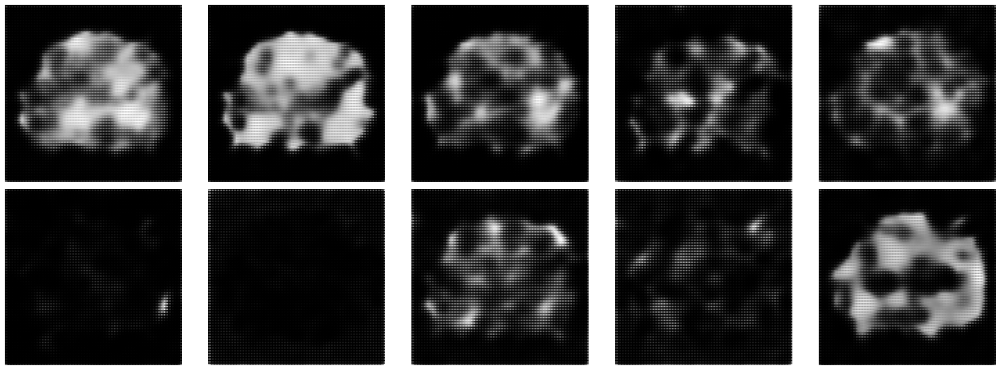

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<07:32,  8.29it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 2/3750 [00:00<06:57,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 3/3750 [00:00<06:50,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<06:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<06:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 6/3750 [00:00<06:48,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 7/3750 [00:00<06:44,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 8/3750 [00:00<07:09,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:00<06:58,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<06:51,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 11/3750 [00:01<06:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 12/3750 [00:01<06:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 13/3750 [00:01<06:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 14/3750 [00:01<06:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<07:03,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 16/3750 [00:01<07:03,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 17/3750 [00:01<06:59,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                        | 18/3750 [00:01<06:55,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▏                                        | 19/3750 [00:02<06:53,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 20/3750 [00:02<06:48,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 21/3750 [00:02<06:45,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▏                                        | 22/3750 [00:02<06:46,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 23/3750 [00:02<06:46,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 24/3750 [00:02<06:51,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 25/3750 [00:02<06:49,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 26/3750 [00:02<06:54,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 27/3750 [00:02<06:54,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 28/3750 [00:03<06:53,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 29/3750 [00:03<06:50,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 30/3750 [00:03<06:47,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 31/3750 [00:03<06:44,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 32/3750 [00:03<06:47,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 33/3750 [00:03<06:45,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:48,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


  1%|▍                                        | 35/3750 [00:03<07:14,  8.54it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 36/3750 [00:04<07:21,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 37/3750 [00:04<07:15,  8.52it/s]

1/1 [==============================] - 0s 79ms/step


  1%|▍                                        | 38/3750 [00:04<09:34,  6.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 39/3750 [00:04<08:46,  7.05it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 40/3750 [00:04<08:06,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 41/3750 [00:04<07:42,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 42/3750 [00:04<07:27,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 43/3750 [00:04<07:22,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 44/3750 [00:05<07:13,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 45/3750 [00:05<07:02,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 46/3750 [00:05<06:58,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 47/3750 [00:05<06:54,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 48/3750 [00:05<06:49,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<06:44,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 50/3750 [00:05<06:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 51/3750 [00:05<06:40,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 52/3750 [00:05<06:41,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 53/3750 [00:06<06:43,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 54/3750 [00:06<06:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 55/3750 [00:06<06:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 56/3750 [00:06<06:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:06<06:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 58/3750 [00:06<06:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 59/3750 [00:06<06:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 60/3750 [00:06<06:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 61/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 63/3750 [00:07<06:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 64/3750 [00:07<06:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:07<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 66/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 67/3750 [00:07<06:31,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 68/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 69/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 70/3750 [00:07<07:24,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:07<07:13,  8.49it/s]

1/1 [==============================] - 0s 15ms/step


  2%|▊                                        | 72/3750 [00:08<07:22,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▊                                        | 73/3750 [00:08<07:29,  8.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▊                                        | 74/3750 [00:08<07:35,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 75/3750 [00:08<07:18,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 76/3750 [00:08<07:10,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 77/3750 [00:08<07:01,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 78/3750 [00:08<06:54,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 79/3750 [00:08<07:22,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 80/3750 [00:09<07:09,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 81/3750 [00:09<07:00,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 82/3750 [00:09<06:51,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 83/3750 [00:09<06:44,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 84/3750 [00:09<06:40,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:09<06:37,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 86/3750 [00:09<07:01,  8.69it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 87/3750 [00:09<07:23,  8.27it/s]

1/1 [==============================] - 0s 12ms/step


  2%|▉                                        | 88/3750 [00:09<07:39,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 89/3750 [00:10<08:13,  7.42it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 90/3750 [00:10<08:03,  7.57it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 91/3750 [00:10<07:34,  8.04it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:10<07:16,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:10<07:04,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 94/3750 [00:10<06:53,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:46,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 96/3750 [00:10<06:45,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 97/3750 [00:11<06:43,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 98/3750 [00:11<06:39,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 99/3750 [00:11<06:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:11<06:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 101/3750 [00:11<06:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 102/3750 [00:11<06:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:11<06:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 104/3750 [00:11<06:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:11<06:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 106/3750 [00:11<06:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 107/3750 [00:12<06:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 108/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:12<06:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 111/3750 [00:12<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 112/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 114/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 115/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 116/3750 [00:13<06:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 117/3750 [00:13<06:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 118/3750 [00:13<06:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:13<06:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 120/3750 [00:13<06:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 121/3750 [00:13<06:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 122/3750 [00:13<06:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:13<06:25,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 124/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 125/3750 [00:13<06:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 126/3750 [00:14<06:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 127/3750 [00:14<06:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:14<06:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 129/3750 [00:14<06:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 130/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 131/3750 [00:14<06:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:14<06:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 133/3750 [00:14<06:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 134/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 135/3750 [00:15<06:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 136/3750 [00:15<06:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 137/3750 [00:15<06:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:15<06:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 139/3750 [00:15<06:28,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 140/3750 [00:15<06:26,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 141/3750 [00:15<06:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 142/3750 [00:15<06:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 143/3750 [00:15<06:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:16<06:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 145/3750 [00:16<06:24,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 146/3750 [00:16<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 147/3750 [00:16<06:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 148/3750 [00:16<06:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 149/3750 [00:16<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 150/3750 [00:16<06:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 151/3750 [00:16<06:21,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:16<06:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 153/3750 [00:16<06:19,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 154/3750 [00:17<06:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:17<06:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 156/3750 [00:17<06:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 157/3750 [00:17<06:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 158/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 159/3750 [00:17<06:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 160/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 161/3750 [00:17<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 162/3750 [00:17<06:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 163/3750 [00:18<06:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 164/3750 [00:18<06:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 165/3750 [00:18<06:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 166/3750 [00:18<06:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 167/3750 [00:18<06:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 168/3750 [00:18<06:23,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 169/3750 [00:18<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:18<06:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:18<06:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 172/3750 [00:18<06:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:19<06:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:19<06:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 175/3750 [00:19<06:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 176/3750 [00:19<06:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 177/3750 [00:19<06:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 178/3750 [00:19<06:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 179/3750 [00:19<06:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 180/3750 [00:19<06:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 181/3750 [00:19<06:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 182/3750 [00:20<06:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 183/3750 [00:20<06:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 184/3750 [00:20<06:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 185/3750 [00:20<06:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 186/3750 [00:20<06:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 187/3750 [00:20<06:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 188/3750 [00:20<06:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:20<06:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 190/3750 [00:20<06:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 191/3750 [00:21<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 192/3750 [00:21<06:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 194/3750 [00:21<06:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 195/3750 [00:21<06:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:21<06:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:21<06:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 198/3750 [00:21<06:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 199/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 200/3750 [00:21<06:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 201/3750 [00:22<06:14,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:22<06:13,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 203/3750 [00:22<06:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 204/3750 [00:22<06:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 205/3750 [00:22<06:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 206/3750 [00:22<06:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 207/3750 [00:22<06:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 208/3750 [00:22<06:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:22<06:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 210/3750 [00:23<06:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 211/3750 [00:23<06:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 212/3750 [00:23<06:34,  8.97it/s]

1/1 [==============================] - 0s 12ms/step


  6%|██▎                                     | 213/3750 [00:23<06:42,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 214/3750 [00:23<06:35,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 215/3750 [00:23<06:28,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▎                                     | 216/3750 [00:23<06:54,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 217/3750 [00:23<06:47,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 218/3750 [00:23<06:39,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 219/3750 [00:24<06:33,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 220/3750 [00:24<06:27,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 221/3750 [00:24<06:24,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 222/3750 [00:24<06:29,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 223/3750 [00:24<06:32,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 224/3750 [00:24<06:29,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 225/3750 [00:24<06:23,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 226/3750 [00:24<06:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 227/3750 [00:24<06:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 228/3750 [00:25<06:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 229/3750 [00:25<06:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 230/3750 [00:25<06:10,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 231/3750 [00:25<06:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:25<06:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 233/3750 [00:25<06:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 234/3750 [00:25<06:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:25<06:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 236/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:25<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▌                                     | 238/3750 [00:26<06:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:26<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:26<06:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 241/3750 [00:26<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:26<06:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 243/3750 [00:26<06:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 244/3750 [00:26<06:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 245/3750 [00:26<06:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:26<06:11,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:27<06:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 248/3750 [00:27<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:27<06:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 250/3750 [00:27<06:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 251/3750 [00:27<06:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:27<06:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 253/3750 [00:27<06:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 254/3750 [00:27<06:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 255/3750 [00:27<06:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 256/3750 [00:27<06:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 257/3750 [00:28<06:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 258/3750 [00:28<06:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 259/3750 [00:28<06:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 260/3750 [00:28<06:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 261/3750 [00:28<06:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 262/3750 [00:28<06:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 263/3750 [00:28<06:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:28<06:13,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 265/3750 [00:28<06:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 266/3750 [00:29<06:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:29<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:29<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 269/3750 [00:29<06:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 270/3750 [00:29<06:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 271/3750 [00:29<06:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:29<06:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 273/3750 [00:29<06:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 274/3750 [00:29<06:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 275/3750 [00:30<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 276/3750 [00:30<06:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 277/3750 [00:30<06:08,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 278/3750 [00:30<06:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:30<06:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 280/3750 [00:30<06:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 281/3750 [00:30<06:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:30<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:30<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 284/3750 [00:30<06:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:31<06:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:31<06:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:31<06:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 289/3750 [00:31<06:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 290/3750 [00:31<06:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 291/3750 [00:31<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 292/3750 [00:31<06:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 294/3750 [00:32<06:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 295/3750 [00:32<06:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 296/3750 [00:32<06:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 297/3750 [00:32<06:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 298/3750 [00:32<06:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:32<06:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 300/3750 [00:32<06:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 301/3750 [00:32<06:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 302/3750 [00:32<06:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 303/3750 [00:33<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 304/3750 [00:33<06:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 305/3750 [00:33<06:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 306/3750 [00:33<06:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:33<06:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:33<06:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 309/3750 [00:33<06:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 310/3750 [00:33<06:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:33<06:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 312/3750 [00:33<06:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 313/3750 [00:34<06:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:34<06:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 315/3750 [00:34<06:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 316/3750 [00:34<06:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 317/3750 [00:34<06:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 318/3750 [00:34<06:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 319/3750 [00:34<06:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 320/3750 [00:34<06:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 321/3750 [00:34<06:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 322/3750 [00:35<06:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 323/3750 [00:35<06:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 324/3750 [00:35<06:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 325/3750 [00:35<06:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 326/3750 [00:35<06:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 327/3750 [00:35<06:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 328/3750 [00:35<06:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:35<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 330/3750 [00:35<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 331/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 332/3750 [00:36<06:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 333/3750 [00:36<06:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 334/3750 [00:36<06:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 335/3750 [00:36<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 336/3750 [00:36<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 337/3750 [00:36<06:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 338/3750 [00:36<06:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 339/3750 [00:36<06:04,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 340/3750 [00:36<06:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 341/3750 [00:37<06:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:37<06:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 343/3750 [00:37<06:03,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:37<06:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 345/3750 [00:37<06:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 346/3750 [00:37<06:03,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 347/3750 [00:37<06:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:37<06:02,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:37<06:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:38<06:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 351/3750 [00:38<06:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 352/3750 [00:38<06:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 353/3750 [00:38<06:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 354/3750 [00:38<06:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 355/3750 [00:38<06:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 356/3750 [00:38<06:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 357/3750 [00:38<06:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 358/3750 [00:38<06:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 359/3750 [00:38<06:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 360/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 361/3750 [00:39<06:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 362/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 363/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 364/3750 [00:39<06:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 365/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 366/3750 [00:39<05:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 367/3750 [00:39<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 369/3750 [00:40<05:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 370/3750 [00:40<05:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 371/3750 [00:40<05:55,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 372/3750 [00:40<05:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 373/3750 [00:40<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 374/3750 [00:40<05:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 375/3750 [00:40<06:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:40<05:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 377/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 378/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 379/3750 [00:41<05:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 380/3750 [00:41<05:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 381/3750 [00:41<05:56,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 382/3750 [00:41<05:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 383/3750 [00:41<05:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 384/3750 [00:41<05:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 385/3750 [00:41<05:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 386/3750 [00:41<05:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 387/3750 [00:41<05:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 388/3750 [00:42<05:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 389/3750 [00:42<06:06,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 390/3750 [00:42<06:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:42<06:03,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 392/3750 [00:42<06:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 393/3750 [00:42<06:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 394/3750 [00:42<05:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:42<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 396/3750 [00:42<05:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 397/3750 [00:43<05:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 398/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 399/3750 [00:43<05:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 400/3750 [00:43<05:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 401/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 402/3750 [00:43<05:56,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 403/3750 [00:43<05:57,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 404/3750 [00:43<05:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 405/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 406/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 407/3750 [00:44<05:56,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 408/3750 [00:44<05:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 409/3750 [00:44<05:54,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:44<05:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 411/3750 [00:44<05:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 412/3750 [00:44<05:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 413/3750 [00:44<06:00,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 414/3750 [00:44<06:04,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 415/3750 [00:44<06:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 416/3750 [00:45<06:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 417/3750 [00:45<06:00,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 418/3750 [00:45<05:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 419/3750 [00:45<05:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 420/3750 [00:45<05:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 421/3750 [00:45<05:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:45<05:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 423/3750 [00:45<05:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 424/3750 [00:45<05:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 425/3750 [00:46<05:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:46<05:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:46<05:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:46<05:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:46<06:13,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 430/3750 [00:46<06:07,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:46<06:02,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 432/3750 [00:46<05:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 433/3750 [00:46<05:57,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:46<05:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 435/3750 [00:47<05:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 436/3750 [00:47<05:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 437/3750 [00:47<05:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 438/3750 [00:47<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 439/3750 [00:47<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 440/3750 [00:47<05:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 441/3750 [00:47<05:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 442/3750 [00:47<05:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 443/3750 [00:47<05:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:48<05:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 445/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 446/3750 [00:48<05:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 447/3750 [00:48<05:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 448/3750 [00:48<05:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 449/3750 [00:48<05:51,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:48<05:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 451/3750 [00:48<05:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 452/3750 [00:48<05:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 453/3750 [00:49<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:49<05:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:49<05:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 456/3750 [00:49<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 457/3750 [00:49<05:50,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 458/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 459/3750 [00:49<05:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 461/3750 [00:49<05:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 462/3750 [00:49<05:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 463/3750 [00:50<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 464/3750 [00:50<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 465/3750 [00:50<05:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 466/3750 [00:50<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 467/3750 [00:50<05:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 468/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:50<05:48,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:50<05:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:50<05:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:51<05:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 473/3750 [00:51<05:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 474/3750 [00:51<05:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 475/3750 [00:51<05:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 476/3750 [00:51<05:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:51<05:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:51<05:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:51<05:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:51<05:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:51<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 482/3750 [00:52<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 483/3750 [00:52<05:45,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 484/3750 [00:52<05:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 485/3750 [00:52<05:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 486/3750 [00:52<05:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 487/3750 [00:52<05:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 488/3750 [00:52<05:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:52<05:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 490/3750 [00:52<05:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 491/3750 [00:53<05:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 492/3750 [00:53<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 493/3750 [00:53<05:42,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 494/3750 [00:53<05:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 495/3750 [00:53<05:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 496/3750 [00:53<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 497/3750 [00:53<05:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 498/3750 [00:53<05:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 499/3750 [00:53<05:47,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:54<05:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 501/3750 [00:54<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 502/3750 [00:54<05:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 503/3750 [00:54<05:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 504/3750 [00:54<05:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 505/3750 [00:54<05:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:54<05:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 507/3750 [00:54<05:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 508/3750 [00:54<05:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 509/3750 [00:54<05:44,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 510/3750 [00:55<05:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 511/3750 [00:55<05:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 512/3750 [00:55<05:44,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 513/3750 [00:55<05:46,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 514/3750 [00:55<05:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 515/3750 [00:55<05:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 516/3750 [00:55<05:43,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 517/3750 [00:55<05:42,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 518/3750 [00:55<05:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 519/3750 [00:56<05:43,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 520/3750 [00:56<05:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 521/3750 [00:56<05:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [00:56<05:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:56<05:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 524/3750 [00:56<05:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 525/3750 [00:56<05:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 526/3750 [00:56<05:39,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 527/3750 [00:56<05:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:56<05:38,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 529/3750 [00:57<05:37,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 530/3750 [00:57<05:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:57<05:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 532/3750 [00:57<05:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [00:57<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 534/3750 [00:57<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 535/3750 [00:57<05:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 536/3750 [00:57<05:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 537/3750 [00:57<05:38,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 538/3750 [00:58<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 539/3750 [00:58<05:38,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [00:58<05:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 541/3750 [00:58<05:39,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▊                                  | 542/3750 [00:58<05:39,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 543/3750 [00:58<05:38,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 544/3750 [00:58<05:37,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▊                                  | 545/3750 [00:58<05:48,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 546/3750 [00:58<05:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [00:58<05:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 548/3750 [00:59<05:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 549/3750 [00:59<05:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 550/3750 [00:59<05:47,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 551/3750 [00:59<05:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 552/3750 [00:59<05:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 553/3750 [00:59<05:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 554/3750 [00:59<05:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 555/3750 [00:59<05:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 556/3750 [00:59<05:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 557/3750 [01:00<05:37,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [01:00<05:36,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 559/3750 [01:00<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 560/3750 [01:00<05:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:00<05:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 562/3750 [01:00<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 563/3750 [01:00<05:37,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 564/3750 [01:00<05:36,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 565/3750 [01:00<05:37,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 566/3750 [01:01<05:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 567/3750 [01:01<05:35,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 569/3750 [01:01<05:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:01<05:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 571/3750 [01:01<05:39,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 572/3750 [01:01<05:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 573/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:01<05:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 575/3750 [01:01<05:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 576/3750 [01:02<05:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:02<05:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 578/3750 [01:02<05:40,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 579/3750 [01:02<05:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 580/3750 [01:02<05:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:02<05:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 582/3750 [01:02<05:35,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▏                                 | 583/3750 [01:02<05:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 584/3750 [01:02<05:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 585/3750 [01:03<05:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 586/3750 [01:03<05:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 587/3750 [01:03<05:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 588/3750 [01:03<05:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 589/3750 [01:03<05:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 590/3750 [01:03<05:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 591/3750 [01:03<05:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 592/3750 [01:03<05:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 593/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 594/3750 [01:03<05:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 595/3750 [01:04<05:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 596/3750 [01:04<05:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:04<05:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:04<05:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 599/3750 [01:04<05:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 600/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 601/3750 [01:04<05:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 602/3750 [01:04<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 603/3750 [01:04<05:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 604/3750 [01:05<05:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 605/3750 [01:05<05:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 606/3750 [01:05<05:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 607/3750 [01:05<05:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:05<05:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 609/3750 [01:05<05:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 610/3750 [01:05<05:32,  9.44it/s]

1/1 [==============================] - 0s 15ms/step


 16%|██████▌                                 | 611/3750 [01:05<06:12,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 612/3750 [01:05<06:01,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:06<05:51,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:49,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 615/3750 [01:06<05:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:06<05:40,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:06<05:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 618/3750 [01:06<05:53,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:06<05:48,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 620/3750 [01:06<05:43,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 621/3750 [01:06<05:38,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 622/3750 [01:07<05:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 623/3750 [01:07<05:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 624/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 625/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 626/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 627/3750 [01:07<05:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 628/3750 [01:07<05:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 629/3750 [01:07<05:28,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:07<05:29,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 631/3750 [01:07<05:28,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 632/3750 [01:08<05:27,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 633/3750 [01:08<05:27,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 634/3750 [01:08<05:27,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 635/3750 [01:08<05:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 636/3750 [01:08<05:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 637/3750 [01:08<05:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 638/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 639/3750 [01:08<05:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 640/3750 [01:08<05:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 641/3750 [01:09<05:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 642/3750 [01:09<05:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:09<05:30,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 644/3750 [01:09<05:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:09<05:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 646/3750 [01:09<05:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 647/3750 [01:09<05:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 648/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 649/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 650/3750 [01:09<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 651/3750 [01:10<05:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:10<05:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:10<05:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 654/3750 [01:10<05:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 655/3750 [01:10<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 656/3750 [01:10<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 657/3750 [01:10<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 658/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 659/3750 [01:10<05:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 660/3750 [01:11<05:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:11<05:32,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 662/3750 [01:11<05:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 663/3750 [01:11<05:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:11<05:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 665/3750 [01:11<05:26,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 666/3750 [01:11<05:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 667/3750 [01:11<05:23,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 668/3750 [01:11<05:22,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 669/3750 [01:12<05:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 670/3750 [01:12<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:12<05:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:12<05:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 673/3750 [01:12<05:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 674/3750 [01:12<05:25,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 675/3750 [01:12<05:24,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 676/3750 [01:12<05:23,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 677/3750 [01:12<05:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 678/3750 [01:12<05:23,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 679/3750 [01:13<05:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 680/3750 [01:13<05:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 681/3750 [01:13<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 682/3750 [01:13<05:24,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 683/3750 [01:13<05:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 684/3750 [01:13<05:21,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 685/3750 [01:13<05:21,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 686/3750 [01:13<05:20,  9.57it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 687/3750 [01:13<05:19,  9.59it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 688/3750 [01:14<05:20,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 689/3750 [01:14<05:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 690/3750 [01:14<05:20,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▎                                | 691/3750 [01:14<05:20,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 692/3750 [01:14<05:19,  9.58it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▍                                | 693/3750 [01:14<05:18,  9.60it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 694/3750 [01:14<05:17,  9.62it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 695/3750 [01:14<05:17,  9.63it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 696/3750 [01:14<05:18,  9.58it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 697/3750 [01:14<05:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 698/3750 [01:15<05:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:15<05:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:15<05:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:15<05:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:15<05:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 703/3750 [01:15<05:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:15<05:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:15<05:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 706/3750 [01:15<05:27,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 707/3750 [01:16<05:29,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 708/3750 [01:16<05:37,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:16<05:33,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 710/3750 [01:16<05:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 711/3750 [01:16<05:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:16<05:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 713/3750 [01:16<05:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 714/3750 [01:16<05:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 715/3750 [01:16<05:24,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 716/3750 [01:16<05:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:17<05:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:17<05:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 719/3750 [01:17<05:21,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 720/3750 [01:17<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 721/3750 [01:17<05:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 722/3750 [01:17<05:19,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:17<05:18,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 724/3750 [01:17<05:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:17<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 726/3750 [01:18<05:20,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 727/3750 [01:18<05:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:18<05:18,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:18<05:17,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 730/3750 [01:18<05:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 731/3750 [01:18<05:17,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:18<05:16,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 733/3750 [01:18<05:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 734/3750 [01:18<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 735/3750 [01:18<05:17,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:19<05:18,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 737/3750 [01:19<05:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 738/3750 [01:19<05:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 739/3750 [01:19<05:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:19<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:19<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:19<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:19<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 744/3750 [01:19<05:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 745/3750 [01:20<05:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 746/3750 [01:20<05:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:20<05:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 748/3750 [01:20<05:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:20<05:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 750/3750 [01:20<05:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 751/3750 [01:20<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 752/3750 [01:20<05:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:20<05:16,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 754/3750 [01:21<05:15,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:21<05:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:21<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 757/3750 [01:21<05:17,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:21<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 759/3750 [01:21<05:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:21<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:21<05:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:21<05:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:21<05:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 764/3750 [01:22<05:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 765/3750 [01:22<05:14,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:22<05:14,  9.48it/s]

1/1 [==============================] - 0s 10ms/step


 20%|████████▏                               | 767/3750 [01:22<05:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 768/3750 [01:22<05:14,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 769/3750 [01:22<05:13,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 770/3750 [01:22<05:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:22<05:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 772/3750 [01:22<05:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 773/3750 [01:23<05:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 774/3750 [01:23<05:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 775/3750 [01:23<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 776/3750 [01:23<05:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 777/3750 [01:23<05:12,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 778/3750 [01:23<05:11,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 779/3750 [01:23<05:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:23<05:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 781/3750 [01:23<05:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 782/3750 [01:23<05:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 783/3750 [01:24<05:12,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 784/3750 [01:24<05:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:24<05:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 786/3750 [01:24<05:12,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 787/3750 [01:24<05:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 788/3750 [01:24<05:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 789/3750 [01:24<05:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 790/3750 [01:24<05:13,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 791/3750 [01:24<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 792/3750 [01:25<05:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 793/3750 [01:25<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 794/3750 [01:25<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:25<05:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 796/3750 [01:25<05:16,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 797/3750 [01:25<05:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 798/3750 [01:25<05:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 799/3750 [01:25<05:14,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:25<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 801/3750 [01:25<05:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:26<05:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 803/3750 [01:26<05:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 804/3750 [01:26<05:11,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 805/3750 [01:26<05:10,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 806/3750 [01:26<06:12,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▌                               | 807/3750 [01:26<06:00,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 808/3750 [01:26<05:45,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 809/3750 [01:26<05:35,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 810/3750 [01:27<05:27,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 811/3750 [01:27<05:21,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 812/3750 [01:27<05:17,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 813/3750 [01:27<05:14,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:27<05:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 815/3750 [01:27<05:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:27<05:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 817/3750 [01:27<05:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 818/3750 [01:27<05:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 819/3750 [01:27<05:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 820/3750 [01:28<05:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:28<05:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:28<05:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 823/3750 [01:28<05:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 824/3750 [01:28<05:09,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 825/3750 [01:28<05:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 826/3750 [01:28<05:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 827/3750 [01:28<05:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 828/3750 [01:28<05:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:29<05:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 830/3750 [01:29<05:08,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 831/3750 [01:29<05:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 832/3750 [01:29<05:06,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 833/3750 [01:29<05:07,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:29<05:06,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 835/3750 [01:29<05:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 836/3750 [01:29<05:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 837/3750 [01:29<05:13,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:29<05:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 839/3750 [01:30<05:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 840/3750 [01:30<05:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 841/3750 [01:30<05:10,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 842/3750 [01:30<05:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 843/3750 [01:30<05:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 844/3750 [01:30<05:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 845/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 846/3750 [01:30<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:30<05:07,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 848/3750 [01:31<05:05,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 849/3750 [01:31<05:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 850/3750 [01:31<05:04,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 851/3750 [01:31<05:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 852/3750 [01:31<05:05,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 853/3750 [01:31<05:07,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 854/3750 [01:31<05:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 855/3750 [01:31<05:06,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 856/3750 [01:31<05:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 857/3750 [01:31<05:05,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:32<05:04,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 859/3750 [01:32<05:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 860/3750 [01:32<05:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 861/3750 [01:32<05:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 862/3750 [01:32<05:05,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:32<05:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 864/3750 [01:32<05:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 865/3750 [01:32<05:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 866/3750 [01:32<05:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 867/3750 [01:33<05:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 868/3750 [01:33<05:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 869/3750 [01:33<05:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:33<05:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 871/3750 [01:33<05:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 872/3750 [01:33<05:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 873/3750 [01:33<05:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 874/3750 [01:33<05:04,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 875/3750 [01:33<05:03,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 876/3750 [01:33<05:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 877/3750 [01:34<05:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 878/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 879/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 880/3750 [01:34<05:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 881/3750 [01:34<05:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 882/3750 [01:34<05:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 883/3750 [01:34<05:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 884/3750 [01:34<05:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:34<05:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 886/3750 [01:35<05:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 887/3750 [01:35<05:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 888/3750 [01:35<05:08,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 889/3750 [01:35<05:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 890/3750 [01:35<05:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 891/3750 [01:35<05:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 892/3750 [01:35<05:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 893/3750 [01:35<05:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 894/3750 [01:35<05:39,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 895/3750 [01:36<05:31,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 896/3750 [01:36<05:25,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 897/3750 [01:36<05:19,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 898/3750 [01:36<05:13,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:36<05:11,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 900/3750 [01:36<05:13,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:36<05:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 902/3750 [01:36<05:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 903/3750 [01:36<05:10,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 904/3750 [01:37<05:09,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 905/3750 [01:37<05:08,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:37<05:06,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 907/3750 [01:37<05:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 908/3750 [01:37<05:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 909/3750 [01:37<05:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 910/3750 [01:37<05:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 911/3750 [01:37<05:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 912/3750 [01:37<05:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 913/3750 [01:37<05:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 914/3750 [01:38<05:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:38<05:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 916/3750 [01:38<05:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 917/3750 [01:38<05:00,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 918/3750 [01:38<05:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 919/3750 [01:38<05:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 920/3750 [01:38<05:05,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 921/3750 [01:38<05:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 922/3750 [01:38<05:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 923/3750 [01:39<05:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 924/3750 [01:39<04:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 925/3750 [01:39<04:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 926/3750 [01:39<04:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:39<04:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 928/3750 [01:39<05:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:39<04:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:39<04:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:39<04:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:40<04:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:40<04:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 934/3750 [01:40<04:56,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 935/3750 [01:40<04:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 936/3750 [01:40<04:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 937/3750 [01:40<04:55,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 938/3750 [01:40<04:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 939/3750 [01:40<04:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 940/3750 [01:40<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 941/3750 [01:40<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 942/3750 [01:41<04:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 943/3750 [01:41<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 944/3750 [01:41<05:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 945/3750 [01:41<05:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 946/3750 [01:41<04:58,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 947/3750 [01:41<04:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:41<04:57,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:41<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 950/3750 [01:41<04:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 951/3750 [01:42<04:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 952/3750 [01:42<04:56,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 953/3750 [01:42<04:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 954/3750 [01:42<04:56,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 955/3750 [01:42<04:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:42<04:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 957/3750 [01:42<04:57,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 958/3750 [01:42<04:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 959/3750 [01:42<04:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 960/3750 [01:42<04:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 961/3750 [01:43<04:54,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 962/3750 [01:43<04:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 963/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 964/3750 [01:43<04:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:43<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 966/3750 [01:43<04:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 967/3750 [01:43<04:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 968/3750 [01:43<04:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 969/3750 [01:43<04:54,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 970/3750 [01:44<05:13,  8.88it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██████████▎                             | 971/3750 [01:44<05:34,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 972/3750 [01:44<05:28,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:44<05:20,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 974/3750 [01:44<05:13,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 975/3750 [01:44<05:09,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 976/3750 [01:44<05:09,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▍                             | 977/3750 [01:44<05:15,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:44<05:09,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 979/3750 [01:45<05:04,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 980/3750 [01:45<05:00,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 981/3750 [01:45<04:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:45<04:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:45<04:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 984/3750 [01:45<04:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 985/3750 [01:45<04:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 986/3750 [01:45<04:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 987/3750 [01:45<04:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 988/3750 [01:46<04:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:46<04:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 990/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 991/3750 [01:46<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 992/3750 [01:46<04:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 993/3750 [01:46<04:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 994/3750 [01:46<04:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 995/3750 [01:46<04:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                             | 996/3750 [01:46<04:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 997/3750 [01:47<04:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 998/3750 [01:47<04:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 999/3750 [01:47<04:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1000/3750 [01:47<04:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1001/3750 [01:47<04:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:47<04:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1003/3750 [01:47<04:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:47<04:51,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1006/3750 [01:47<04:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:48<04:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1008/3750 [01:48<04:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1009/3750 [01:48<04:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1010/3750 [01:48<04:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1011/3750 [01:48<04:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1012/3750 [01:48<04:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1013/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1014/3750 [01:48<04:49,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:48<04:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:49<04:49,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1017/3750 [01:49<04:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1018/3750 [01:49<04:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1019/3750 [01:49<04:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1020/3750 [01:49<04:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:49<04:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1022/3750 [01:49<04:47,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1023/3750 [01:49<04:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1024/3750 [01:49<04:50,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1025/3750 [01:49<04:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1026/3750 [01:50<04:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1027/3750 [01:50<04:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1028/3750 [01:50<04:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:50<04:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1030/3750 [01:50<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:50<04:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1032/3750 [01:50<04:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1033/3750 [01:50<04:47,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:50<04:46,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1035/3750 [01:51<04:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1036/3750 [01:51<04:46,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1037/3750 [01:51<04:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:51<04:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1039/3750 [01:51<04:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1040/3750 [01:51<04:46,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1041/3750 [01:51<04:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:51<04:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1043/3750 [01:51<04:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1044/3750 [01:51<04:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:52<04:45,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1046/3750 [01:52<04:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1047/3750 [01:52<04:50,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 28%|██████████▉                            | 1048/3750 [01:52<04:57,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1049/3750 [01:52<04:54,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1050/3750 [01:52<04:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1051/3750 [01:52<04:51,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1052/3750 [01:52<04:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1053/3750 [01:52<04:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1054/3750 [01:53<04:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1055/3750 [01:53<04:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [01:53<04:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1057/3750 [01:53<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1058/3750 [01:53<04:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1059/3750 [01:53<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1060/3750 [01:53<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:53<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:53<04:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1063/3750 [01:54<04:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [01:54<04:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1065/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1066/3750 [01:54<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1067/3750 [01:54<04:44,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [01:54<04:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:54<04:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1070/3750 [01:54<04:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:54<04:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1072/3750 [01:54<04:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1073/3750 [01:55<04:45,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1074/3750 [01:55<04:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1075/3750 [01:55<04:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1076/3750 [01:55<04:40,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1077/3750 [01:55<04:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1078/3750 [01:55<04:40,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1079/3750 [01:55<04:40,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1080/3750 [01:55<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [01:55<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:56<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:56<04:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1084/3750 [01:56<04:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1085/3750 [01:56<04:39,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1086/3750 [01:56<04:39,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1087/3750 [01:56<04:39,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1088/3750 [01:56<04:40,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1089/3750 [01:56<04:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1090/3750 [01:56<04:40,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1091/3750 [01:56<04:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1092/3750 [01:57<04:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:57<04:42,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1094/3750 [01:57<04:41,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1095/3750 [01:57<04:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1096/3750 [01:57<04:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1097/3750 [01:57<04:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1098/3750 [01:57<04:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [01:57<04:39,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1100/3750 [01:57<04:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1101/3750 [01:58<04:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1102/3750 [01:58<04:39,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1103/3750 [01:58<04:39,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1104/3750 [01:58<04:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [01:58<04:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▌                           | 1106/3750 [01:58<04:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [01:58<04:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [01:58<05:23,  8.16it/s]

1/1 [==============================] - 0s 11ms/step


 30%|███████████▌                           | 1109/3750 [01:58<05:14,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [01:59<05:05,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1111/3750 [01:59<04:57,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1112/3750 [01:59<04:52,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1113/3750 [01:59<04:51,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1114/3750 [01:59<07:24,  5.93it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1115/3750 [01:59<06:35,  6.67it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1116/3750 [01:59<06:00,  7.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [01:59<05:35,  7.85it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1118/3750 [02:00<05:20,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1119/3750 [02:00<05:07,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1120/3750 [02:00<04:58,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1121/3750 [02:00<04:52,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1122/3750 [02:00<04:49,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1123/3750 [02:00<04:46,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1124/3750 [02:00<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:00<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1126/3750 [02:00<04:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1127/3750 [02:01<04:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1128/3750 [02:01<04:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1129/3750 [02:01<04:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1130/3750 [02:01<04:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1131/3750 [02:01<04:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:01<04:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1133/3750 [02:01<04:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1134/3750 [02:01<04:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1135/3750 [02:01<04:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1136/3750 [02:02<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1137/3750 [02:02<04:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1138/3750 [02:02<04:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:02<04:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1140/3750 [02:02<04:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1141/3750 [02:02<04:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1142/3750 [02:02<04:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1143/3750 [02:02<04:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1144/3750 [02:02<04:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1145/3750 [02:02<04:36,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1147/3750 [02:03<04:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1148/3750 [02:03<04:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1149/3750 [02:03<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1150/3750 [02:03<04:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1151/3750 [02:03<04:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1152/3750 [02:03<04:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1153/3750 [02:03<04:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1154/3750 [02:03<04:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1155/3750 [02:04<04:34,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1156/3750 [02:04<04:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1157/3750 [02:04<04:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1158/3750 [02:04<04:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1159/3750 [02:04<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1160/3750 [02:04<04:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1161/3750 [02:04<04:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1162/3750 [02:04<04:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1163/3750 [02:04<04:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1164/3750 [02:04<04:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1165/3750 [02:05<04:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1166/3750 [02:05<04:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1167/3750 [02:05<04:37,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1168/3750 [02:05<04:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1169/3750 [02:05<04:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1170/3750 [02:05<04:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1171/3750 [02:05<04:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1172/3750 [02:05<04:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1173/3750 [02:05<04:34,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1174/3750 [02:06<04:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:06<04:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1176/3750 [02:06<04:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1177/3750 [02:06<04:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1178/3750 [02:06<04:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1179/3750 [02:06<04:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:06<04:31,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1181/3750 [02:06<04:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:06<04:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1183/3750 [02:07<04:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1184/3750 [02:07<04:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:07<04:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1186/3750 [02:07<04:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1187/3750 [02:07<04:46,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1188/3750 [02:07<04:43,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1189/3750 [02:07<04:39,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:07<04:36,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:07<04:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1192/3750 [02:07<04:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1193/3750 [02:08<04:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1194/3750 [02:08<04:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1195/3750 [02:08<04:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1196/3750 [02:08<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1197/3750 [02:08<04:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1198/3750 [02:08<04:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1199/3750 [02:08<04:37,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1200/3750 [02:08<04:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1201/3750 [02:08<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1202/3750 [02:09<04:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:09<04:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1204/3750 [02:09<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1205/3750 [02:09<04:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1206/3750 [02:09<04:33,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1207/3750 [02:09<04:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:09<04:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1209/3750 [02:09<04:30,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1210/3750 [02:09<04:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:10<04:28,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1212/3750 [02:10<04:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1213/3750 [02:10<04:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:10<04:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:10<04:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:10<04:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1217/3750 [02:10<04:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1218/3750 [02:10<04:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1219/3750 [02:10<04:28,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1220/3750 [02:10<04:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:11<04:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1222/3750 [02:11<04:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1223/3750 [02:11<04:30,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:11<04:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1225/3750 [02:11<04:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1226/3750 [02:11<04:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1227/3750 [02:11<04:29,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1229/3750 [02:11<04:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1230/3750 [02:12<04:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1231/3750 [02:12<04:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1232/3750 [02:12<04:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1233/3750 [02:12<04:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:12<04:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1235/3750 [02:12<04:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1236/3750 [02:12<04:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1237/3750 [02:12<04:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1238/3750 [02:12<04:26,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1239/3750 [02:12<04:25,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1240/3750 [02:13<04:23,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1241/3750 [02:13<04:23,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1242/3750 [02:13<04:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1243/3750 [02:13<04:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:13<04:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1245/3750 [02:13<04:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1246/3750 [02:13<04:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1247/3750 [02:13<04:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1248/3750 [02:13<04:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1249/3750 [02:14<04:24,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 33%|█████████████                          | 1250/3750 [02:14<04:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1251/3750 [02:14<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:14<04:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1253/3750 [02:14<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:14<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:14<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:14<04:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1257/3750 [02:14<04:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1258/3750 [02:14<04:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:15<04:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1260/3750 [02:15<04:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1261/3750 [02:15<04:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1262/3750 [02:15<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1263/3750 [02:15<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1264/3750 [02:15<04:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1265/3750 [02:15<04:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:15<04:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:15<04:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1268/3750 [02:16<04:22,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:16<04:21,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:16<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1271/3750 [02:16<04:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1272/3750 [02:16<04:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1273/3750 [02:16<04:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1274/3750 [02:16<04:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1275/3750 [02:16<04:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1276/3750 [02:16<04:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1277/3750 [02:17<04:21,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1278/3750 [02:17<04:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1279/3750 [02:17<04:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1280/3750 [02:17<04:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1281/3750 [02:17<04:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1282/3750 [02:17<04:22,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1283/3750 [02:17<04:20,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:17<04:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1285/3750 [02:17<04:19,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1286/3750 [02:17<04:18,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1287/3750 [02:18<04:18,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1288/3750 [02:18<04:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1289/3750 [02:18<04:21,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1290/3750 [02:18<04:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1291/3750 [02:18<04:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1292/3750 [02:18<04:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1293/3750 [02:18<04:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1294/3750 [02:18<04:20,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▍                         | 1295/3750 [02:18<04:20,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1296/3750 [02:19<04:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1297/3750 [02:19<04:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1298/3750 [02:19<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1299/3750 [02:19<04:20,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1300/3750 [02:19<04:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1301/3750 [02:19<04:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1302/3750 [02:19<04:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1303/3750 [02:19<04:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:19<04:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1305/3750 [02:19<04:17,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1306/3750 [02:20<04:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1307/3750 [02:20<04:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1308/3750 [02:20<04:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1309/3750 [02:20<04:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1310/3750 [02:20<04:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1311/3750 [02:20<04:16,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:20<04:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1313/3750 [02:20<04:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1314/3750 [02:20<04:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:21<04:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1316/3750 [02:21<04:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1317/3750 [02:21<04:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1318/3750 [02:21<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:21<04:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:21<04:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1321/3750 [02:21<04:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:21<04:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1323/3750 [02:21<04:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1324/3750 [02:21<04:16,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1325/3750 [02:22<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1326/3750 [02:22<04:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1327/3750 [02:22<04:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1328/3750 [02:22<04:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1329/3750 [02:22<04:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1330/3750 [02:22<04:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1331/3750 [02:22<04:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1332/3750 [02:22<04:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▊                         | 1333/3750 [02:22<04:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1334/3750 [02:23<04:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1335/3750 [02:23<04:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1336/3750 [02:23<04:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1337/3750 [02:23<04:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1338/3750 [02:23<04:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1339/3750 [02:23<04:14,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1340/3750 [02:23<04:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1341/3750 [02:23<04:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1342/3750 [02:23<04:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1343/3750 [02:24<04:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1344/3750 [02:24<04:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1345/3750 [02:24<04:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1346/3750 [02:24<04:13,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1347/3750 [02:24<04:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1348/3750 [02:24<04:13,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:24<04:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:24<04:12,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:24<04:12,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1352/3750 [02:24<04:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1353/3750 [02:25<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1354/3750 [02:25<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1355/3750 [02:25<04:13,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1356/3750 [02:25<04:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1357/3750 [02:25<04:12,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:25<04:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1359/3750 [02:25<04:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1360/3750 [02:25<04:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1361/3750 [02:25<04:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1362/3750 [02:26<04:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1363/3750 [02:26<04:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1364/3750 [02:26<04:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1365/3750 [02:26<04:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:26<04:11,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:26<04:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1368/3750 [02:26<04:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▏                        | 1369/3750 [02:26<04:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▏                        | 1370/3750 [02:26<04:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1371/3750 [02:26<04:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1372/3750 [02:27<04:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1373/3750 [02:27<04:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1374/3750 [02:27<04:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1375/3750 [02:27<04:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1376/3750 [02:27<04:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:27<04:09,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1378/3750 [02:27<04:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:27<04:08,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1380/3750 [02:27<04:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1381/3750 [02:28<04:08,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:28<04:09,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:28<04:08,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:28<04:08,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1385/3750 [02:28<04:08,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:28<04:07,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1387/3750 [02:28<04:07,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1388/3750 [02:28<04:07,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1389/3750 [02:28<04:07,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1390/3750 [02:28<04:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:29<04:08,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1392/3750 [02:29<04:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:29<04:07,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:29<04:06,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1395/3750 [02:29<04:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1396/3750 [02:29<04:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1397/3750 [02:29<04:07,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1398/3750 [02:29<04:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1399/3750 [02:29<04:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1400/3750 [02:30<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1401/3750 [02:30<04:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1402/3750 [02:30<04:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1403/3750 [02:30<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1404/3750 [02:30<04:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1405/3750 [02:30<04:13,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1406/3750 [02:30<04:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1407/3750 [02:30<04:12,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:30<04:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1409/3750 [02:30<04:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1410/3750 [02:31<04:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1411/3750 [02:31<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:31<04:06,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1413/3750 [02:31<04:06,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1414/3750 [02:31<04:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1415/3750 [02:31<04:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1416/3750 [02:31<04:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1417/3750 [02:31<04:08,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1418/3750 [02:31<04:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1419/3750 [02:32<04:16,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1420/3750 [02:32<04:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1421/3750 [02:32<04:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1422/3750 [02:32<04:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1423/3750 [02:32<04:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1424/3750 [02:32<04:10,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1425/3750 [02:32<04:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1426/3750 [02:32<04:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1427/3750 [02:32<04:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1428/3750 [02:33<04:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1429/3750 [02:33<04:08,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1430/3750 [02:33<04:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:33<04:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1432/3750 [02:33<04:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1433/3750 [02:33<04:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1434/3750 [02:33<04:05,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1435/3750 [02:33<04:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1436/3750 [02:33<04:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1437/3750 [02:33<04:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1438/3750 [02:34<04:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1439/3750 [02:34<04:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1440/3750 [02:34<04:04,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1441/3750 [02:34<04:03,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1442/3750 [02:34<04:09,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|███████████████                        | 1443/3750 [02:34<04:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1444/3750 [02:34<04:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1445/3750 [02:34<04:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1446/3750 [02:34<04:04,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1447/3750 [02:35<04:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1448/3750 [02:35<04:03,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1449/3750 [02:35<04:03,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1450/3750 [02:35<04:03,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1451/3750 [02:35<04:02,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1452/3750 [02:35<04:01,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1453/3750 [02:35<04:02,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1454/3750 [02:35<04:03,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1455/3750 [02:35<04:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1456/3750 [02:35<04:01,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1457/3750 [02:36<04:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1458/3750 [02:36<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1459/3750 [02:36<04:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1460/3750 [02:36<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1461/3750 [02:36<04:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1462/3750 [02:36<04:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1463/3750 [02:36<04:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:36<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1465/3750 [02:36<04:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1466/3750 [02:37<04:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1467/3750 [02:37<04:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1468/3750 [02:37<04:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1469/3750 [02:37<04:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1470/3750 [02:37<04:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1471/3750 [02:37<04:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1472/3750 [02:37<04:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:37<04:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1474/3750 [02:37<04:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1475/3750 [02:38<04:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1476/3750 [02:38<04:00,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1477/3750 [02:38<03:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1478/3750 [02:38<03:59,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1479/3750 [02:38<03:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:38<03:57,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1481/3750 [02:38<03:59,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1482/3750 [02:38<03:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1483/3750 [02:38<03:59,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1484/3750 [02:38<03:59,  9.47it/s]

1/1 [==============================] - 0s 14ms/step


 40%|███████████████▍                       | 1485/3750 [02:39<04:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1486/3750 [02:39<04:12,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1487/3750 [02:39<04:16,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1488/3750 [02:39<04:15,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1489/3750 [02:39<04:12,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1490/3750 [02:39<04:13,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1491/3750 [02:39<04:25,  8.50it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▌                       | 1492/3750 [02:39<04:21,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1493/3750 [02:39<04:14,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1494/3750 [02:40<04:09,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:40<04:05,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1496/3750 [02:40<04:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1497/3750 [02:40<04:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1498/3750 [02:40<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1499/3750 [02:40<04:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1500/3750 [02:40<04:09,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1501/3750 [02:40<04:06,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1502/3750 [02:40<04:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:41<04:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1504/3750 [02:41<04:11,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1505/3750 [02:41<04:07,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1506/3750 [02:41<04:03,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1507/3750 [02:41<04:00,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:41<04:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1509/3750 [02:41<03:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:41<03:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1511/3750 [02:41<03:57,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▋                       | 1512/3750 [02:42<03:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:42<03:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:42<03:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1515/3750 [02:42<03:55,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:42<03:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1517/3750 [02:42<03:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1518/3750 [02:42<03:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1519/3750 [02:42<03:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1520/3750 [02:42<03:54,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:42<03:53,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1522/3750 [02:43<03:53,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1523/3750 [02:43<03:53,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1524/3750 [02:43<03:53,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:43<03:54,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1526/3750 [02:43<03:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1527/3750 [02:43<03:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1528/3750 [02:43<03:53,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:43<03:54,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:43<03:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1531/3750 [02:44<03:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1532/3750 [02:44<03:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1533/3750 [02:44<03:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1534/3750 [02:44<03:52,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1535/3750 [02:44<03:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1536/3750 [02:44<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1537/3750 [02:44<03:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1538/3750 [02:44<03:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1539/3750 [02:44<03:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1540/3750 [02:44<03:53,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1541/3750 [02:45<03:53,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1542/3750 [02:45<03:58,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1543/3750 [02:45<03:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1544/3750 [02:45<03:57,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1545/3750 [02:45<04:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1546/3750 [02:45<04:00,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1547/3750 [02:45<03:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1548/3750 [02:45<03:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1549/3750 [02:45<03:55,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1550/3750 [02:46<03:53,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1551/3750 [02:46<03:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1552/3750 [02:46<03:50,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1553/3750 [02:46<03:49,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1554/3750 [02:46<03:51,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:46<03:50,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1556/3750 [02:46<03:49,  9.56it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:46<03:49,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1558/3750 [02:46<03:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1559/3750 [02:47<03:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1560/3750 [02:47<03:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1561/3750 [02:47<03:50,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1562/3750 [02:47<03:49,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1563/3750 [02:47<03:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1564/3750 [02:47<03:50,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1565/3750 [02:47<03:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1566/3750 [02:47<03:51,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1567/3750 [02:47<03:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1568/3750 [02:47<03:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1569/3750 [02:48<03:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:48<03:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1571/3750 [02:48<03:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1572/3750 [02:48<03:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1573/3750 [02:48<03:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1574/3750 [02:48<03:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:48<03:49,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1576/3750 [02:48<03:48,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:48<03:48,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1578/3750 [02:49<03:48,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1579/3750 [02:49<03:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1580/3750 [02:49<03:48,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1581/3750 [02:49<03:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1582/3750 [02:49<03:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1583/3750 [02:49<03:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:49<03:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1585/3750 [02:49<03:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:49<03:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1587/3750 [02:49<03:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1588/3750 [02:50<03:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1589/3750 [02:50<03:47,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1590/3750 [02:50<03:47,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1591/3750 [02:50<03:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1592/3750 [02:50<03:47,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:50<03:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1594/3750 [02:50<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1595/3750 [02:50<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1596/3750 [02:50<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1597/3750 [02:51<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1598/3750 [02:51<03:46,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1599/3750 [02:51<03:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1600/3750 [02:51<03:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1601/3750 [02:51<03:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1602/3750 [02:51<03:47,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1603/3750 [02:51<03:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1604/3750 [02:51<03:46,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:51<03:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:51<03:59,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1607/3750 [02:52<03:56,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1608/3750 [02:52<03:55,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1609/3750 [02:52<03:57,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▋                      | 1610/3750 [02:52<03:58,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1611/3750 [02:52<03:54,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1612/3750 [02:52<03:52,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:52<03:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1614/3750 [02:52<03:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1615/3750 [02:52<03:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1616/3750 [02:53<03:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:53<03:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1618/3750 [02:53<03:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1619/3750 [02:53<03:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1620/3750 [02:53<03:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1621/3750 [02:53<03:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [02:53<03:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1623/3750 [02:53<03:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1624/3750 [02:53<03:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1625/3750 [02:54<03:47,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1626/3750 [02:54<03:48,  9.29it/s]

1/1 [==============================] - 0s 12ms/step


 43%|████████████████▉                      | 1627/3750 [02:54<03:53,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1628/3750 [02:54<03:55,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1629/3750 [02:54<03:53,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1630/3750 [02:54<03:53,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1631/3750 [02:54<03:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1632/3750 [02:54<03:49,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [02:54<03:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [02:55<03:47,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1635/3750 [02:55<03:53,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1636/3750 [02:55<03:58,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1637/3750 [02:55<03:55,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1638/3750 [02:55<03:52,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1639/3750 [02:55<03:51,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1640/3750 [02:55<03:49,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1641/3750 [02:55<03:54,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1642/3750 [02:55<03:52,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1643/3750 [02:56<03:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1644/3750 [02:56<03:52,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1645/3750 [02:56<03:52,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1646/3750 [02:56<03:50,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1647/3750 [02:56<03:49,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1648/3750 [02:56<03:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [02:56<03:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1650/3750 [02:56<03:46,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1651/3750 [02:56<03:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1652/3750 [02:56<03:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1653/3750 [02:57<03:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1654/3750 [02:57<03:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1655/3750 [02:57<03:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1656/3750 [02:57<03:46,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1657/3750 [02:57<03:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1658/3750 [02:57<03:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1659/3750 [02:57<03:45,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1660/3750 [02:57<03:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1661/3750 [02:57<03:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1662/3750 [02:58<03:49,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1663/3750 [02:58<03:48,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1664/3750 [02:58<03:48,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1665/3750 [02:58<03:48,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1666/3750 [02:58<03:47,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1667/3750 [02:58<03:45,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1668/3750 [02:58<03:48,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▎                     | 1669/3750 [02:58<03:52,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▎                     | 1670/3750 [02:58<03:53,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1671/3750 [02:59<03:51,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1672/3750 [02:59<03:58,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1673/3750 [02:59<03:53,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1674/3750 [02:59<03:51,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1675/3750 [02:59<03:48,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [02:59<03:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [02:59<03:46,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1678/3750 [02:59<04:05,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1679/3750 [02:59<04:01,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1680/3750 [03:00<03:58,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1681/3750 [03:00<03:57,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1682/3750 [03:00<03:54,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1683/3750 [03:00<03:56,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1684/3750 [03:00<03:52,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1685/3750 [03:00<03:52,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1686/3750 [03:00<03:51,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1687/3750 [03:00<03:49,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1688/3750 [03:00<03:47,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1689/3750 [03:01<03:46,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1690/3750 [03:01<03:44,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1691/3750 [03:01<03:42,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1692/3750 [03:01<03:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1693/3750 [03:01<03:46,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:01<03:44,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1695/3750 [03:01<03:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1696/3750 [03:01<03:42,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1697/3750 [03:01<03:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1698/3750 [03:02<03:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1699/3750 [03:02<03:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1700/3750 [03:02<03:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1701/3750 [03:02<03:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:02<03:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [03:02<03:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1704/3750 [03:02<03:40,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1705/3750 [03:02<03:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:02<03:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1707/3750 [03:03<03:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1708/3750 [03:03<03:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:03<03:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:03<03:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:03<03:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1712/3750 [03:03<03:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:03<03:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1714/3750 [03:03<03:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:03<03:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1716/3750 [03:03<03:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1717/3750 [03:04<03:36,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:04<03:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1719/3750 [03:04<03:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1720/3750 [03:04<03:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1721/3750 [03:04<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1722/3750 [03:04<03:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:04<03:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:04<03:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1725/3750 [03:04<03:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:05<03:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1727/3750 [03:05<03:34,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1728/3750 [03:05<03:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1729/3750 [03:05<03:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:05<03:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1731/3750 [03:05<03:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1732/3750 [03:05<03:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1733/3750 [03:05<04:38,  7.24it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:06<04:25,  7.61it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1735/3750 [03:06<04:11,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1736/3750 [03:06<04:01,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1737/3750 [03:06<03:53,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1738/3750 [03:06<03:47,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1739/3750 [03:06<03:44,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1740/3750 [03:06<03:53,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1741/3750 [03:06<03:48,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1742/3750 [03:06<03:46,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████▏                    | 1743/3750 [03:07<03:45,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1744/3750 [03:07<03:45,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1745/3750 [03:07<03:45,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1746/3750 [03:07<03:42,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1747/3750 [03:07<03:41,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1748/3750 [03:07<03:38,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1749/3750 [03:07<03:38,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1750/3750 [03:07<03:37,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:07<03:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1752/3750 [03:08<03:37,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1753/3750 [03:08<03:39,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1754/3750 [03:08<03:41,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1755/3750 [03:08<03:42,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1756/3750 [03:08<03:43,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1757/3750 [03:08<03:44,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1758/3750 [03:08<03:44,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1759/3750 [03:08<03:44,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1760/3750 [03:08<03:43,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1761/3750 [03:09<03:40,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1762/3750 [03:09<03:37,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1763/3750 [03:09<03:37,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1764/3750 [03:09<03:43,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1765/3750 [03:09<03:42,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1766/3750 [03:09<03:42,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1767/3750 [03:09<03:43,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1768/3750 [03:09<03:40,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1769/3750 [03:09<03:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1770/3750 [03:10<03:37,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1771/3750 [03:10<03:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1772/3750 [03:10<03:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1773/3750 [03:10<03:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1774/3750 [03:10<03:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1775/3750 [03:10<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1776/3750 [03:10<03:32,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1777/3750 [03:10<03:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1778/3750 [03:10<03:32,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1779/3750 [03:10<03:30,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1780/3750 [03:11<03:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1781/3750 [03:11<03:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:11<03:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1783/3750 [03:11<03:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1784/3750 [03:11<03:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1785/3750 [03:11<03:28,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:11<03:28,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1787/3750 [03:11<03:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1788/3750 [03:11<03:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1789/3750 [03:12<03:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1790/3750 [03:12<03:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1791/3750 [03:12<03:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1792/3750 [03:12<03:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1793/3750 [03:12<03:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1794/3750 [03:12<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1795/3750 [03:12<03:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1796/3750 [03:12<03:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1797/3750 [03:12<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1798/3750 [03:13<03:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1799/3750 [03:13<03:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1800/3750 [03:13<03:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1801/3750 [03:13<03:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1802/3750 [03:13<03:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1803/3750 [03:13<03:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1804/3750 [03:13<03:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1805/3750 [03:13<03:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1806/3750 [03:13<03:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1807/3750 [03:13<03:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1808/3750 [03:14<03:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1809/3750 [03:14<03:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1810/3750 [03:14<03:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1811/3750 [03:14<03:28,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1812/3750 [03:14<03:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1813/3750 [03:14<03:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1814/3750 [03:14<03:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:14<03:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1816/3750 [03:14<03:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1817/3750 [03:15<03:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1818/3750 [03:15<03:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1819/3750 [03:15<03:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:15<03:25,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1821/3750 [03:15<03:25,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:15<03:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1823/3750 [03:15<03:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1824/3750 [03:15<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1825/3750 [03:15<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1826/3750 [03:15<03:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1827/3750 [03:16<03:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1828/3750 [03:16<03:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:16<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:16<03:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:16<03:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1832/3750 [03:16<03:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1833/3750 [03:16<03:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1834/3750 [03:16<03:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1835/3750 [03:16<03:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1836/3750 [03:17<03:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:17<03:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:17<03:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1839/3750 [03:17<03:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1840/3750 [03:17<03:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:17<03:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1842/3750 [03:17<03:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1843/3750 [03:17<03:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1844/3750 [03:17<03:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1845/3750 [03:18<03:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1846/3750 [03:18<03:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1847/3750 [03:18<03:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1848/3750 [03:18<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1849/3750 [03:18<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1850/3750 [03:18<03:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1851/3750 [03:18<03:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:18<03:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1853/3750 [03:18<03:23,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1854/3750 [03:18<03:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1855/3750 [03:19<03:21,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1856/3750 [03:19<03:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1857/3750 [03:19<03:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1858/3750 [03:19<03:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1859/3750 [03:19<03:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1860/3750 [03:19<03:22,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1861/3750 [03:19<03:24,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1862/3750 [03:19<03:27,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1863/3750 [03:19<03:27,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1864/3750 [03:20<03:26,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1865/3750 [03:20<03:27,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1866/3750 [03:20<03:25,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:20<03:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:20<03:22,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1869/3750 [03:20<03:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1870/3750 [03:20<03:23,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1871/3750 [03:20<03:24,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1872/3750 [03:20<03:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1873/3750 [03:21<03:22,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1874/3750 [03:21<03:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1875/3750 [03:21<03:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1876/3750 [03:21<03:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1877/3750 [03:21<03:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1878/3750 [03:21<03:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1879/3750 [03:21<03:18,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1880/3750 [03:21<03:20,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1881/3750 [03:21<03:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1882/3750 [03:22<03:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1883/3750 [03:22<03:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1884/3750 [03:22<03:18,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:22<03:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1886/3750 [03:22<03:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1887/3750 [03:22<03:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1888/3750 [03:22<03:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1889/3750 [03:22<03:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:22<03:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1891/3750 [03:22<03:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1892/3750 [03:23<03:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1893/3750 [03:23<03:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:23<03:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1895/3750 [03:23<03:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:23<03:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1897/3750 [03:23<03:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1898/3750 [03:23<03:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1899/3750 [03:23<03:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1900/3750 [03:23<03:47,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1901/3750 [03:24<03:38,  8.46it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1902/3750 [03:24<03:31,  8.75it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:24<03:26,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1904/3750 [03:24<03:23,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1905/3750 [03:24<03:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1906/3750 [03:24<03:20,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1907/3750 [03:24<03:19,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1908/3750 [03:24<03:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1909/3750 [03:24<03:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1910/3750 [03:25<03:18,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1911/3750 [03:25<03:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1912/3750 [03:25<03:16,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1913/3750 [03:25<03:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1914/3750 [03:25<03:17,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1915/3750 [03:25<03:20,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1916/3750 [03:25<03:20,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1917/3750 [03:25<03:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1918/3750 [03:25<03:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:26<03:22,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1920/3750 [03:26<03:20,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1921/3750 [03:26<03:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1922/3750 [03:26<03:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1923/3750 [03:26<03:15,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1924/3750 [03:26<03:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1925/3750 [03:26<03:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1926/3750 [03:26<03:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1927/3750 [03:26<03:15,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1928/3750 [03:26<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1929/3750 [03:27<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1930/3750 [03:27<03:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:27<03:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1932/3750 [03:27<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1933/3750 [03:27<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1934/3750 [03:27<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1935/3750 [03:27<03:12,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:27<03:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:27<03:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1938/3750 [03:28<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1939/3750 [03:28<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1940/3750 [03:28<03:16,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1941/3750 [03:28<03:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:28<03:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1943/3750 [03:28<03:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:28<03:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1945/3750 [03:28<03:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1946/3750 [03:28<03:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1947/3750 [03:29<03:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1948/3750 [03:29<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:29<03:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1950/3750 [03:29<03:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1951/3750 [03:29<03:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:29<03:10,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:29<03:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:29<03:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1955/3750 [03:29<03:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1956/3750 [03:29<03:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1957/3750 [03:30<03:15,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1958/3750 [03:30<03:16,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1959/3750 [03:30<03:17,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:30<03:18,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1961/3750 [03:30<03:18,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1962/3750 [03:30<03:17,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1963/3750 [03:30<03:17,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1964/3750 [03:30<03:16,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1965/3750 [03:30<03:16,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1966/3750 [03:31<03:16,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1967/3750 [03:31<03:16,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1968/3750 [03:31<03:14,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1969/3750 [03:31<03:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1970/3750 [03:31<03:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:31<03:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1972/3750 [03:31<03:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1973/3750 [03:31<03:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1974/3750 [03:31<03:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1975/3750 [03:32<03:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:32<03:09,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▌                  | 1977/3750 [03:32<03:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:32<03:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1979/3750 [03:32<03:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:32<03:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1981/3750 [03:32<03:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1982/3750 [03:32<03:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:32<03:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1984/3750 [03:33<03:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1985/3750 [03:33<03:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1986/3750 [03:33<03:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:33<03:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1988/3750 [03:33<03:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:33<03:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1990/3750 [03:33<03:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1991/3750 [03:33<03:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1992/3750 [03:33<03:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1993/3750 [03:33<03:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1994/3750 [03:34<03:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1995/3750 [03:34<03:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1996/3750 [03:34<03:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1997/3750 [03:34<03:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1998/3750 [03:34<03:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1999/3750 [03:34<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2000/3750 [03:34<03:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:34<03:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2002/3750 [03:34<03:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2003/3750 [03:35<03:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2004/3750 [03:35<03:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:35<03:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2006/3750 [03:35<03:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:35<03:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2008/3750 [03:35<03:06,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2009/3750 [03:35<03:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2010/3750 [03:35<03:06,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2011/3750 [03:35<03:37,  7.99it/s]

1/1 [==============================] - 0s 11ms/step


 54%|████████████████████▉                  | 2012/3750 [03:36<03:45,  7.72it/s]

1/1 [==============================] - 0s 12ms/step


 54%|████████████████████▉                  | 2013/3750 [03:36<03:37,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:36<03:27,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2015/3750 [03:36<03:20,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2016/3750 [03:36<03:15,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2017/3750 [03:36<03:11,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:36<03:08,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:36<03:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2020/3750 [03:36<03:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2021/3750 [03:37<03:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2022/3750 [03:37<03:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2023/3750 [03:37<03:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2024/3750 [03:37<03:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:37<03:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2026/3750 [03:37<03:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2027/3750 [03:37<03:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2028/3750 [03:37<03:05,  9.26it/s]

1/1 [==============================] - 0s 42ms/step


 54%|█████████████████████                  | 2029/3750 [03:37<03:23,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2030/3750 [03:38<03:18,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2031/3750 [03:38<03:12,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:38<03:11,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:38<03:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:38<03:08,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:38<03:06,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:38<03:04,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:38<03:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:38<03:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:39<03:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:39<03:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:39<03:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:39<03:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:39<03:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:39<03:08,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:39<03:06,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:39<03:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:39<03:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:40<03:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:40<03:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:40<03:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:40<03:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:40<03:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:40<03:00,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:40<03:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:40<03:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:40<03:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:40<02:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:41<02:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:41<02:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:41<02:59,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:41<02:58,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:41<02:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:41<02:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:41<02:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:41<03:00,  9.35it/s]

1/1 [==============================] - 0s 14ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:41<03:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:42<02:59,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:42<02:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:42<02:57,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:42<02:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:42<02:57,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:42<02:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:42<03:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:42<02:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:42<03:01,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:42<02:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:43<02:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:43<02:57,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:43<02:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:43<02:55,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:43<02:55,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:43<02:55,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:43<02:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:43<02:55,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:43<02:56,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:44<02:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:44<02:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:44<02:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:44<02:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:44<02:55,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:44<02:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:44<02:53,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:44<02:53,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:44<02:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:44<02:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:45<02:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:45<02:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:45<02:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:45<02:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:45<02:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:45<02:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:45<02:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:45<02:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:45<02:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:46<03:07,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:46<03:10,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:46<03:05,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:46<03:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:46<03:02,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:46<03:00,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:46<03:00,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:46<03:05,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:46<03:01,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:47<02:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:47<02:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2116/3750 [03:47<02:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2117/3750 [03:47<02:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2118/3750 [03:47<02:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:47<02:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2120/3750 [03:47<02:55,  9.28it/s]

1/1 [==============================] - 0s 44ms/step


 57%|██████████████████████                 | 2121/3750 [03:47<03:23,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2122/3750 [03:47<03:14,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2123/3750 [03:48<03:07,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2124/3750 [03:48<03:04,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2125/3750 [03:48<03:00,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2126/3750 [03:48<02:58,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2127/3750 [03:48<02:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2128/3750 [03:48<02:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2129/3750 [03:48<02:53,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2130/3750 [03:48<02:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2131/3750 [03:48<02:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2132/3750 [03:49<02:52,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:49<02:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2134/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2135/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2136/3750 [03:49<02:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2137/3750 [03:49<02:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2138/3750 [03:49<02:50,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2139/3750 [03:49<02:49,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2140/3750 [03:49<02:50,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2141/3750 [03:49<02:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2142/3750 [03:50<02:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2143/3750 [03:50<02:50,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2144/3750 [03:50<02:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:50<02:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2146/3750 [03:50<02:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2147/3750 [03:50<02:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2148/3750 [03:50<02:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2149/3750 [03:50<02:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2150/3750 [03:50<02:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2151/3750 [03:51<02:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2152/3750 [03:51<02:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2153/3750 [03:51<02:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2154/3750 [03:51<02:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2155/3750 [03:51<02:49,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2156/3750 [03:51<02:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2157/3750 [03:51<02:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2158/3750 [03:51<02:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2159/3750 [03:51<02:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2160/3750 [03:52<02:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2161/3750 [03:52<02:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2162/3750 [03:52<02:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2163/3750 [03:52<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [03:52<02:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [03:52<02:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [03:52<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2167/3750 [03:52<02:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2168/3750 [03:52<02:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2169/3750 [03:52<02:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [03:53<02:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2171/3750 [03:53<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2172/3750 [03:53<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2173/3750 [03:53<02:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2174/3750 [03:53<02:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2175/3750 [03:53<02:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2176/3750 [03:53<02:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2177/3750 [03:53<03:00,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2178/3750 [03:53<02:56,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2179/3750 [03:54<02:54,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [03:54<02:51,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2181/3750 [03:54<02:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [03:54<02:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2183/3750 [03:54<02:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [03:54<02:55,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2185/3750 [03:54<02:52,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2186/3750 [03:54<02:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2187/3750 [03:54<02:50,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:55<02:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2189/3750 [03:55<02:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2190/3750 [03:55<02:47,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2191/3750 [03:55<02:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2192/3750 [03:55<02:47,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [03:55<02:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2194/3750 [03:55<02:45,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2195/3750 [03:55<02:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2196/3750 [03:55<02:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2197/3750 [03:56<02:44,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2198/3750 [03:56<02:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2199/3750 [03:56<02:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2200/3750 [03:56<04:20,  5.94it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2201/3750 [03:56<03:50,  6.71it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2202/3750 [03:56<03:30,  7.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2203/3750 [03:56<03:15,  7.91it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2204/3750 [03:56<03:05,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2205/3750 [03:57<02:58,  8.65it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2206/3750 [03:57<02:53,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2207/3750 [03:57<02:50,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2208/3750 [03:57<02:51,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2209/3750 [03:57<02:49,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [03:57<02:47,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2211/3750 [03:57<02:46,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2212/3750 [03:57<02:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2213/3750 [03:57<02:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2214/3750 [03:58<02:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2215/3750 [03:58<02:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2216/3750 [03:58<02:43,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2217/3750 [03:58<02:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2218/3750 [03:58<02:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2219/3750 [03:58<02:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2220/3750 [03:58<02:43,  9.38it/s]

1/1 [==============================] - 0s 68ms/step


 59%|███████████████████████                | 2221/3750 [03:58<03:14,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2222/3750 [03:58<03:06,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2223/3750 [03:59<03:00,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2224/3750 [03:59<02:55,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2225/3750 [03:59<02:54,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2226/3750 [03:59<02:52,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2227/3750 [03:59<02:49,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2228/3750 [03:59<02:47,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████▏               | 2229/3750 [03:59<02:46,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [03:59<02:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2231/3750 [03:59<02:44,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2232/3750 [04:00<02:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2233/3750 [04:00<02:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2234/3750 [04:00<02:42,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2235/3750 [04:00<02:43,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▎               | 2236/3750 [04:00<02:44,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2237/3750 [04:00<02:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2238/3750 [04:00<02:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2239/3750 [04:00<02:44,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2240/3750 [04:00<02:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2241/3750 [04:01<02:43,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2242/3750 [04:01<02:43,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2243/3750 [04:01<02:44,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2244/3750 [04:01<02:56,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2245/3750 [04:01<02:52,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2246/3750 [04:01<02:49,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2247/3750 [04:01<02:47,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2248/3750 [04:01<02:46,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2249/3750 [04:01<02:44,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2250/3750 [04:02<02:43,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2251/3750 [04:02<02:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2252/3750 [04:02<02:41,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2253/3750 [04:02<02:44,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2254/3750 [04:02<02:43,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2255/3750 [04:02<02:43,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2256/3750 [04:02<02:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2257/3750 [04:02<02:42,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2258/3750 [04:02<02:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [04:03<02:42,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:03<02:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2261/3750 [04:03<02:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:03<02:42,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2263/3750 [04:03<02:42,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2264/3750 [04:03<02:42,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2265/3750 [04:03<02:41,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2266/3750 [04:03<02:41,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2267/3750 [04:03<02:40,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2268/3750 [04:03<02:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2269/3750 [04:04<02:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2270/3750 [04:04<02:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:04<02:38,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2272/3750 [04:04<02:39,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2273/3750 [04:04<02:38,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2274/3750 [04:04<02:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2275/3750 [04:04<02:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2276/3750 [04:04<02:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2277/3750 [04:04<02:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2278/3750 [04:05<02:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2279/3750 [04:05<02:37,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2280/3750 [04:05<02:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2281/3750 [04:05<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2282/3750 [04:05<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2283/3750 [04:05<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2284/3750 [04:05<02:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2285/3750 [04:05<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2286/3750 [04:05<02:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2287/3750 [04:06<02:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2288/3750 [04:06<02:36,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2289/3750 [04:06<02:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2290/3750 [04:06<02:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2291/3750 [04:06<02:35,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2292/3750 [04:06<02:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2293/3750 [04:06<02:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:06<02:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:06<02:35,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2296/3750 [04:06<02:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2297/3750 [04:07<02:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2298/3750 [04:07<02:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2299/3750 [04:07<02:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:07<02:33,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2301/3750 [04:07<02:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2302/3750 [04:07<02:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2303/3750 [04:07<02:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2304/3750 [04:07<02:34,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2305/3750 [04:07<02:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2306/3750 [04:08<02:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 62%|███████████████████████▉               | 2307/3750 [04:08<02:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2308/3750 [04:08<02:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2309/3750 [04:08<02:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2310/3750 [04:08<02:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:08<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2312/3750 [04:08<02:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2313/3750 [04:08<02:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2314/3750 [04:08<02:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2315/3750 [04:09<02:34,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2316/3750 [04:09<02:33,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2317/3750 [04:09<02:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2318/3750 [04:09<02:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:09<02:32,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2320/3750 [04:09<02:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:09<02:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2322/3750 [04:09<02:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2323/3750 [04:09<02:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2324/3750 [04:09<02:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2325/3750 [04:10<02:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:10<02:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2327/3750 [04:10<02:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:10<02:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2329/3750 [04:10<02:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2330/3750 [04:10<02:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:10<02:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2332/3750 [04:10<02:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:10<02:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2334/3750 [04:11<02:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2335/3750 [04:11<02:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2336/3750 [04:11<02:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2337/3750 [04:11<02:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2338/3750 [04:11<02:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2339/3750 [04:11<02:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2340/3750 [04:11<02:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2341/3750 [04:11<02:30,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2342/3750 [04:11<02:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2343/3750 [04:11<02:29,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2344/3750 [04:12<02:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:12<02:29,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:12<02:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2347/3750 [04:12<02:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:12<02:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2349/3750 [04:12<02:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2350/3750 [04:12<02:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2351/3750 [04:12<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:12<02:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2353/3750 [04:13<02:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2354/3750 [04:13<02:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:13<02:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2356/3750 [04:13<02:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2357/3750 [04:13<02:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2358/3750 [04:13<02:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2359/3750 [04:13<02:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2360/3750 [04:13<02:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:13<02:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2362/3750 [04:14<02:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2363/3750 [04:14<02:28,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2364/3750 [04:14<02:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2365/3750 [04:14<02:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2366/3750 [04:14<02:25,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2367/3750 [04:14<02:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2368/3750 [04:14<02:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:14<02:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:14<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2371/3750 [04:14<02:25,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2372/3750 [04:15<02:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2373/3750 [04:15<02:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2374/3750 [04:15<02:26,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2375/3750 [04:15<02:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2376/3750 [04:15<02:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2377/3750 [04:15<02:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2378/3750 [04:15<02:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2379/3750 [04:15<02:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2380/3750 [04:15<02:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2381/3750 [04:16<02:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2382/3750 [04:16<02:28,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2383/3750 [04:16<02:26,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2384/3750 [04:16<02:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2385/3750 [04:16<02:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:16<02:24,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:16<02:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:16<02:23,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2389/3750 [04:16<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:16<02:22,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2391/3750 [04:17<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2392/3750 [04:17<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2393/3750 [04:17<02:22,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2394/3750 [04:17<02:22,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:17<02:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2396/3750 [04:17<02:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2397/3750 [04:17<02:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:17<02:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2399/3750 [04:17<02:22,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2400/3750 [04:18<02:22,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2401/3750 [04:18<02:22,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2402/3750 [04:18<02:21,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2403/3750 [04:18<02:22,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2404/3750 [04:18<02:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2405/3750 [04:18<02:22,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2406/3750 [04:18<02:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2407/3750 [04:18<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:18<02:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2409/3750 [04:18<02:21,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2410/3750 [04:19<02:21,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2411/3750 [04:19<02:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2412/3750 [04:19<02:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:19<02:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:19<02:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2415/3750 [04:19<02:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:19<02:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:19<02:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:19<02:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:20<02:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:20<02:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:20<02:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:20<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:20<02:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:20<02:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:20<02:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:20<02:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:20<02:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:21<02:20,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:21<02:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:21<02:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:21<02:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:21<02:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:21<02:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:21<02:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:21<02:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:21<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:21<02:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:22<02:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:22<02:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:22<02:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:22<02:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:22<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:22<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:22<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:22<02:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:22<02:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:23<02:19,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:23<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:23<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:23<02:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:23<02:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:23<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:23<02:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:23<02:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:23<02:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:24<02:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:24<02:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:24<02:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:24<02:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:24<02:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:24<02:17,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:24<02:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:24<02:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:24<02:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:24<02:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:25<02:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:25<02:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:25<02:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:25<02:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:25<02:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:25<02:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:25<02:17,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:25<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:25<02:16,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:26<02:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:26<02:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:26<02:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:26<02:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:26<02:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:26<02:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:26<02:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:26<02:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:26<02:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:27<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:27<02:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:27<02:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:27<02:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:27<02:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:27<02:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:27<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:27<02:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:27<02:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:27<02:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:28<02:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:28<02:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:28<02:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:28<02:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:28<02:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:28<02:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2500/3750 [04:28<02:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2501/3750 [04:28<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2502/3750 [04:28<02:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2503/3750 [04:29<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2504/3750 [04:29<02:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2505/3750 [04:29<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2506/3750 [04:29<02:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:29<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:29<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:29<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:29<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2511/3750 [04:29<02:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:30<02:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:30<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:30<02:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:30<02:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:30<02:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:30<02:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:30<02:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:30<02:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:30<02:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:30<02:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:31<02:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:31<02:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:31<02:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:31<02:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:31<02:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:31<02:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:31<02:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:31<02:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:32<02:10,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:32<02:11,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:32<02:14,  9.07it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:32<02:18,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:32<02:25,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:32<02:25,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:32<02:30,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:32<02:25,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:32<02:20,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:33<02:17,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:33<02:15,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:33<02:13,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:33<02:12,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:33<02:13,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:33<02:12,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:33<02:10,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:33<02:15,  8.88it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:33<02:22,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:34<02:23,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:34<02:19,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:34<02:15,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:34<02:13,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:34<02:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:34<02:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:34<02:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:34<02:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:34<02:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:35<02:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:35<02:07,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:35<02:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:35<02:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:35<02:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:35<02:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:35<02:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:35<02:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:35<02:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:36<02:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:36<02:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:36<02:06,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:36<02:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:36<02:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:36<02:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:36<02:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:36<02:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:36<02:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:37<02:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:37<02:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:37<02:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:37<02:04,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:37<02:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:37<02:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:37<02:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:37<02:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:37<02:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:37<02:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:38<02:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:38<02:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:38<02:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:38<02:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:38<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:38<02:03,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:38<02:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:38<02:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:38<02:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:39<02:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:39<02:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:39<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:39<02:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2599/3750 [04:39<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2600/3750 [04:39<02:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2601/3750 [04:39<02:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:39<02:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:39<02:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2604/3750 [04:40<02:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2605/3750 [04:40<02:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2606/3750 [04:40<02:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████            | 2607/3750 [04:40<02:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2608/3750 [04:40<02:01,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:40<02:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:40<02:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:40<02:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:40<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:40<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:41<02:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:41<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:41<02:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:41<02:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:41<02:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:41<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:41<02:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:41<02:01,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:41<02:03,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:42<02:05,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:42<02:05,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:42<02:04,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:42<02:02,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:42<02:02,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:42<02:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:42<01:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:42<01:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:42<02:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:43<02:01,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:43<02:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:43<02:00,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:43<01:59,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:43<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:43<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:43<01:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:43<01:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:43<01:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:43<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:44<01:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:44<01:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:44<01:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:44<01:58,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:44<01:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:44<01:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:44<01:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:44<01:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:44<01:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:45<01:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:45<01:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:45<01:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:45<01:57,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:45<01:56,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:45<01:56,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:45<01:55,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:45<01:56,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:45<01:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:46<01:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:46<01:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:46<01:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:46<01:55,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:46<01:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:46<01:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:46<01:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:46<01:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:46<01:55,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:46<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:47<01:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:47<01:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:47<01:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:47<01:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:47<01:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:47<01:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:47<01:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:47<01:53,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:47<01:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:48<01:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:48<01:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:48<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:48<01:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:48<01:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:48<01:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:48<01:52,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:48<01:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:48<01:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:48<01:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:49<01:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:49<01:52,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:49<01:51,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:49<01:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2693/3750 [04:49<01:52,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2694/3750 [04:49<01:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2695/3750 [04:49<01:51,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2696/3750 [04:49<01:51,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:49<01:52,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:50<01:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2699/3750 [04:50<01:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2700/3750 [04:50<01:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2701/3750 [04:50<01:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2702/3750 [04:50<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2703/3750 [04:50<01:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [04:50<01:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:50<01:50,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:50<01:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:50<01:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:51<01:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:51<01:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:51<01:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:51<01:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:51<01:49,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:51<01:49,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:51<01:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:51<01:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:51<01:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:52<01:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:52<01:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:52<01:50,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:52<01:53,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:52<01:52,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:52<01:51,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:52<01:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:52<01:50,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:52<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:53<01:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:53<01:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:53<01:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:53<01:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:53<01:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:53<01:48,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:53<01:48,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:53<01:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:53<01:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:53<01:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:54<01:49,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:54<01:49,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:54<01:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:54<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:54<01:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:54<01:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:54<01:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:54<01:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:54<01:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:55<01:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:55<01:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:55<01:45,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:55<01:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:55<01:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:55<01:45,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:55<01:53,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:55<01:55,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:55<01:53,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:56<01:52,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:56<01:50,  8.97it/s]

1/1 [==============================] - 0s 13ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:56<01:50,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:56<01:49,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:56<01:48,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:56<01:47,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:56<01:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2761/3750 [04:56<01:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2762/3750 [04:56<01:46,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2763/3750 [04:57<01:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2764/3750 [04:57<01:45,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2765/3750 [04:57<01:44,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2766/3750 [04:57<01:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2767/3750 [04:57<01:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2768/3750 [04:57<01:43,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [04:57<01:43,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2770/3750 [04:57<01:42,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2771/3750 [04:57<01:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [04:57<01:44,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [04:58<01:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2774/3750 [04:58<01:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2775/3750 [04:58<01:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [04:58<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2777/3750 [04:58<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2778/3750 [04:58<01:43,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2779/3750 [04:58<01:43,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2780/3750 [04:58<01:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2781/3750 [04:58<01:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2782/3750 [04:59<01:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2783/3750 [04:59<01:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2784/3750 [04:59<01:42,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2785/3750 [04:59<01:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2786/3750 [04:59<01:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [04:59<01:43,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2788/3750 [04:59<01:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2789/3750 [04:59<01:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [04:59<01:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2791/3750 [04:59<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2792/3750 [05:00<01:41,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2793/3750 [05:00<01:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:00<01:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2795/3750 [05:00<01:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2796/3750 [05:00<01:41,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2797/3750 [05:00<01:41,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2798/3750 [05:00<01:41,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2799/3750 [05:00<01:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2800/3750 [05:00<01:42,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:01<01:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:01<01:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:01<01:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:01<01:40,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:01<01:40,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:01<01:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:01<01:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:01<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:01<01:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:02<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:02<01:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:02<01:39,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:02<01:39,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:02<01:38,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:02<01:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:02<01:38,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:02<01:38,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:02<01:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:02<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:03<01:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:03<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:03<01:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:03<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:03<01:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:03<01:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:03<01:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:03<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:03<01:39,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:04<01:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:04<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:04<01:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:04<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:04<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:04<01:38,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:04<01:37,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:04<01:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:04<01:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:05<01:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:05<01:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:05<01:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:05<01:37,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:05<01:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:05<01:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:05<01:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:05<01:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:05<01:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:05<01:36,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:06<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:06<01:36,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:06<01:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:06<01:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:06<01:34,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:06<01:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:06<01:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:06<01:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:06<01:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:07<01:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:07<01:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:07<01:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:07<01:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:07<01:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:07<01:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:07<01:33,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:07<01:33,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:07<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:07<01:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:08<01:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:08<01:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:08<01:33,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:08<01:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:08<01:33,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:08<01:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:08<01:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:08<01:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:08<01:32,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:09<01:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:09<01:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:09<01:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:09<01:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:09<01:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:09<01:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:09<01:51,  7.79it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:09<01:46,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:09<01:42,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2885/3750 [05:10<01:38,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:10<01:36,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2887/3750 [05:10<01:35,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2888/3750 [05:10<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2889/3750 [05:10<01:32,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2890/3750 [05:10<01:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2891/3750 [05:10<01:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:10<01:30,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2893/3750 [05:10<01:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2894/3750 [05:11<01:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2895/3750 [05:11<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2896/3750 [05:11<01:30,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:11<01:30,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:11<01:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:11<01:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:11<01:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:11<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:11<01:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:11<01:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:12<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:12<01:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:12<01:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:12<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:12<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:12<01:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:12<01:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:12<01:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:12<01:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:13<01:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:13<01:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:13<01:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:13<01:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:13<01:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:13<01:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:13<01:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:13<01:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:13<01:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:14<01:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:14<01:27,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:14<01:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:14<01:27,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:14<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:14<01:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:14<01:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:14<01:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:14<01:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:14<01:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:15<01:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:15<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:15<01:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:15<01:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:15<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:15<01:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:15<01:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:15<01:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:15<01:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:16<01:35,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:16<01:33,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:16<01:30,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:16<01:29,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:16<01:27,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:16<01:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:16<01:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:16<01:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:16<01:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:17<01:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:17<01:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:17<01:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:17<01:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:17<01:25,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:17<01:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:17<01:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:17<01:24,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:17<01:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:17<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:18<01:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:18<01:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:18<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:18<01:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:18<01:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:18<01:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:18<01:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:18<01:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:18<01:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:19<01:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:19<01:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:19<01:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:19<01:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:19<01:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:19<01:22,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:19<01:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:19<01:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:19<01:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:20<01:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:20<01:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:20<01:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 79%|███████████████████████████████        | 2981/3750 [05:20<01:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2982/3750 [05:20<01:21,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2983/3750 [05:20<01:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:20<01:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2985/3750 [05:20<01:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2986/3750 [05:20<01:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2987/3750 [05:20<01:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2988/3750 [05:21<01:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2989/3750 [05:21<01:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2990/3750 [05:21<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2991/3750 [05:21<01:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2992/3750 [05:21<01:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:21<01:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:21<01:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:21<01:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:21<01:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:22<01:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:22<01:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:22<01:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:22<01:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:22<01:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:22<01:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:22<01:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:22<01:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:22<01:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:23<01:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:23<01:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:23<01:21,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:23<01:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:23<01:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:23<01:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:23<01:19,  9.24it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:23<01:22,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:23<01:21,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:24<01:20,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:24<01:20,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:24<01:19,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:24<01:20,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:24<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:24<01:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:24<01:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:24<01:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:24<01:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:24<01:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:25<01:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:25<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:25<01:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:25<01:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:25<01:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:25<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:25<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:25<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:25<01:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:26<01:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:26<01:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:26<01:17,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:26<01:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:26<01:16,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:26<01:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:26<01:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:26<01:16,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:26<01:16,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:27<01:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:27<01:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:27<01:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:27<01:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:27<01:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:27<01:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:27<01:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:27<01:15,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:27<01:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:28<01:14,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:28<01:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:28<01:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:28<01:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:28<01:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:28<01:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:28<01:14,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:28<01:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:28<01:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:28<01:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:29<01:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:29<01:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:29<01:14,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:29<01:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:29<01:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:29<01:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:29<01:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:29<01:13,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:29<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:30<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:30<01:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:30<01:14,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:30<01:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:30<01:14,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:30<01:14,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3077/3750 [05:30<01:16,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3078/3750 [05:30<01:15,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:30<01:14,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3080/3750 [05:31<01:13,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:31<01:12,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3082/3750 [05:31<01:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3083/3750 [05:31<01:12,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3084/3750 [05:31<01:12,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:31<01:12,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3086/3750 [05:31<01:12,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3087/3750 [05:31<01:12,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3088/3750 [05:31<01:13,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:32<01:13,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:32<01:13,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:32<01:12,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:32<01:12,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:32<01:12,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:32<01:12,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:32<01:13,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:32<01:12,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:32<01:12,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:33<01:11,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:33<01:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:33<01:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:33<01:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:33<01:10,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:33<01:10,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:33<01:10,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:33<01:09,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:33<01:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:34<01:09,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:34<01:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:34<01:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:34<01:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:34<01:09,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:34<01:08,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:34<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:34<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:34<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:34<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:35<01:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:35<01:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:35<01:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:35<01:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:35<01:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:35<01:07,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:35<01:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:35<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:35<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:36<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:36<01:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:36<01:06,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:36<01:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:36<01:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:36<01:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:36<01:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:36<01:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:36<01:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:37<01:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:37<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:37<01:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:37<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:37<01:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:37<01:05,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:37<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:37<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:37<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:38<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:38<01:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:38<01:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:38<01:04,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:38<01:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:38<01:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:38<01:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:38<01:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:38<01:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:39<01:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:39<01:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:39<01:05,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:39<01:04,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:39<01:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:39<01:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:39<01:03,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:39<01:04,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:39<01:05,  8.98it/s]

1/1 [==============================] - 0s 13ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:40<01:07,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:40<01:06,  8.87it/s]

1/1 [==============================] - 0s 13ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:40<01:06,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:40<01:05,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:40<01:05,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:40<01:04,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:40<01:04,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:40<01:04,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:40<01:04,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:41<01:03,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:41<01:03,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:41<01:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:41<01:02,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:41<01:02,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:41<01:02,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:41<01:02,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:41<01:02,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:41<01:02,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:42<01:02,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:42<01:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:42<01:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:42<01:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:42<01:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:42<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:42<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:42<01:02,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:42<01:02,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:43<01:02,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:43<01:02,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:43<01:02,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:43<01:02,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:43<01:01,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:43<01:01,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:43<01:00,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:43<01:00,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:43<01:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:43<00:59,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:44<01:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:44<00:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:44<00:59,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:44<00:59,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:44<00:59,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:44<00:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:44<00:59,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:44<00:59,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:44<00:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:45<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:45<00:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:45<00:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:45<00:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:45<00:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:45<00:57,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:45<00:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:45<00:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:45<00:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:46<00:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:46<00:57,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:46<00:57,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:46<00:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:46<00:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:46<00:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:46<00:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:46<00:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:46<00:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:47<00:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:47<00:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:47<00:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:47<00:55,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:47<00:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:47<00:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:47<00:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:47<00:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:47<00:56,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:47<00:56,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:48<01:00,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:48<01:00,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:48<00:59,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:48<00:57,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:48<00:57,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:48<00:56,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:48<01:02,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:48<01:00,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:49<01:00,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:49<00:58,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:49<00:56,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:49<00:57,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:49<00:55,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:49<00:55,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:49<00:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:49<00:54,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:49<00:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:50<00:54,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:50<00:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:50<00:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:50<00:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:50<00:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:50<00:53,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:50<00:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:50<00:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:50<00:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:51<00:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:51<00:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:51<00:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:51<00:52,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:51<00:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:51<00:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:51<00:52,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:51<00:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:51<00:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:51<00:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:52<00:52,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:52<00:52,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:52<00:55,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:52<00:54,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:52<00:53,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:52<00:52,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:52<00:52,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:52<00:51,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:53<00:51,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:53<00:51,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:53<00:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:53<00:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:53<00:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:53<00:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:53<00:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:53<00:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:53<00:50,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:53<00:50,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:54<00:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:54<00:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:54<00:50,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:54<00:49,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:54<00:49,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:54<00:49,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:54<00:48,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:54<00:49,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:54<00:49,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:55<00:48,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:55<00:49,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:55<00:50,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:55<00:50,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [05:55<00:49,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [05:55<00:49,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [05:55<00:48,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [05:55<00:48,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [05:55<00:48,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [05:56<00:50,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [05:56<00:49,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [05:56<00:48,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [05:56<01:20,  5.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [05:56<01:10,  6.20it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [05:56<01:03,  6.89it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [05:56<00:58,  7.46it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [05:57<00:54,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [05:57<00:52,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [05:57<00:50,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [05:57<00:49,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [05:57<00:49,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [05:57<00:48,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [05:57<00:47,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [05:57<00:47,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [05:57<00:48,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [05:58<00:49,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [05:58<00:50,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [05:58<00:49,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [05:58<00:48,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [05:58<00:47,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [05:58<00:47,  8.92it/s]

1/1 [==============================] - 0s 65ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [05:58<00:56,  7.45it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [05:58<00:53,  7.85it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [05:59<00:51,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [05:59<00:49,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [05:59<00:47,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [05:59<00:46,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [05:59<00:46,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [05:59<00:45,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [05:59<00:45,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [05:59<00:45,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [05:59<00:44,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:00<00:44,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:00<00:44,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:00<00:44,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:00<00:44,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:00<00:44,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:00<00:43,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:00<00:43,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:00<00:43,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:00<00:43,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:01<00:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:01<00:43,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:01<00:43,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:01<00:43,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:01<00:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:01<00:42,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:01<00:42,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:01<00:42,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:01<00:42,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:02<00:43,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:02<00:43,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:02<00:43,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:02<00:43,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:02<00:43,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:02<00:42,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:02<00:42,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:02<00:42,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:02<00:41,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:03<00:41,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:03<00:41,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:03<00:41,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:03<00:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:03<00:41,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:03<00:41,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:03<00:41,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:03<00:42,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:03<00:41,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:04<00:42,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:04<00:41,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:04<00:41,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:04<00:40,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:04<00:40,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:04<00:40,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:04<00:40,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:04<00:39,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:04<00:39,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:05<00:39,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:05<00:39,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:05<00:39,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:05<00:39,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:05<00:39,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:05<00:39,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:05<00:39,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:05<00:38,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:05<00:39,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:06<00:38,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:06<00:38,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:06<00:38,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:06<00:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:06<00:37,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:06<00:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:06<00:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:06<00:37,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:06<00:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:06<00:37,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:07<00:37,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:07<00:37,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:07<00:36,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:07<00:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:07<00:37,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:07<00:36,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:07<00:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:07<00:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:07<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:08<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:08<00:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:08<00:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:08<00:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:08<00:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:08<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:08<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:08<00:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:08<00:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:09<00:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:09<00:35,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:09<00:35,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:09<00:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:09<00:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:09<00:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:09<00:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:09<00:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:09<00:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:10<00:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:10<00:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:10<00:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:10<00:33,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:10<00:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:10<00:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:10<00:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:10<00:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:10<00:33,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:10<00:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:11<00:32,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:11<00:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:11<00:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:11<00:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:11<00:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:11<00:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:11<00:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:11<00:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:11<00:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:12<00:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:12<00:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:12<00:31,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:12<00:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:12<00:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:12<00:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:12<00:32,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:12<00:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:12<00:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:13<00:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:13<00:31,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:13<00:31,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:13<00:31,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:13<00:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:13<00:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:13<00:30,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:13<00:30,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:13<00:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:14<00:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:14<00:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:14<00:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:14<00:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:14<00:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:14<00:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:14<00:29,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:14<00:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:14<00:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:14<00:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:15<00:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:15<00:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:15<00:28,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:15<00:28,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:15<00:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:15<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:15<00:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:15<00:28,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:15<00:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:16<00:28,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:16<00:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:16<00:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:16<00:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:16<00:27,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:16<00:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:16<00:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:16<00:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:16<00:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:17<00:27,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:17<00:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:17<00:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:17<00:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:17<00:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:17<00:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:17<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:17<00:26,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:17<00:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:17<00:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:18<00:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:18<00:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:18<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:18<00:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:18<00:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:18<00:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:18<00:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:18<00:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:18<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:19<00:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:19<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:19<00:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:19<00:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:19<00:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:19<00:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:19<00:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:19<00:24,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:19<00:24,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:20<00:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:20<00:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:20<00:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:20<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:20<00:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:20<00:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:20<00:23,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:20<00:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:20<00:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:20<00:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:21<00:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:21<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:21<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:21<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:21<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:21<00:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:21<00:22,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:21<00:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:21<00:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:22<00:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:22<00:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:22<00:21,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:22<00:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:22<00:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:22<00:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:22<00:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:22<00:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:22<00:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:23<00:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:23<00:21,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:23<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:23<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:23<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:23<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:23<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:23<00:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:23<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:24<00:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:24<00:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:24<00:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:24<00:19,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:24<00:19,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:24<00:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:24<00:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:24<00:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:24<00:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:24<00:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:25<00:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:25<00:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:25<00:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:25<00:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:25<00:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:25<00:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:25<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:25<00:18,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:25<00:18,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:26<00:18,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:26<00:17,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:26<00:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:26<00:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:26<00:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:26<00:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:26<00:17,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:26<00:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:26<00:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:27<00:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:27<00:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:27<00:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:27<00:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:27<00:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:27<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:27<00:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:27<00:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:27<00:16,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:27<00:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:28<00:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:28<00:16,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:28<00:16,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:28<00:16,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:28<00:15,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:28<00:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:28<00:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:28<00:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:28<00:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:29<00:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:29<00:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:29<00:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:29<00:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:29<00:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:29<00:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:29<00:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:29<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:29<00:14,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:30<00:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:30<00:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:30<00:14,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:30<00:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:30<00:13,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:30<00:13,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:30<00:13,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:30<00:13,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:30<00:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:31<00:12,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:31<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:31<00:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:31<00:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:31<00:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:31<00:12,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:31<00:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:31<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:31<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:31<00:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:32<00:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:32<00:11,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:32<00:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:32<00:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:32<00:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:32<00:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:32<00:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:32<00:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:32<00:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:33<00:11,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:33<00:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:33<00:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:33<00:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:33<00:10,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:33<00:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:33<00:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:33<00:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:33<00:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:34<00:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:34<00:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:34<00:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:34<00:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:34<00:09,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:34<00:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:34<00:09,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:34<00:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:34<00:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:34<00:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:35<00:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:35<00:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:35<00:08,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:35<00:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:35<00:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:35<00:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:35<00:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:35<00:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:35<00:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:36<00:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:36<00:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:36<00:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:36<00:07,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:36<00:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:36<00:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:36<00:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:36<00:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:36<00:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:37<00:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:37<00:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:37<00:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:37<00:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:37<00:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:37<00:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:37<00:06,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:37<00:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:37<00:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:38<00:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:38<00:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:38<00:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:38<00:05,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:38<00:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:38<00:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:38<00:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:38<00:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:38<00:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:38<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:39<00:05,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:39<00:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:39<00:04,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:39<00:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:39<00:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:39<00:04,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:39<00:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:39<00:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:39<00:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:40<00:04,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:40<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:40<00:03,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:40<00:03,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:40<00:03,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:40<00:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:40<00:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:40<00:03,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:40<00:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:41<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:41<00:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:41<00:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:41<00:02,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:41<00:02,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:41<00:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:41<00:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:41<00:02,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:41<00:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:42<00:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:42<00:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:42<00:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:42<00:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:42<00:01,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:42<00:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:42<00:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:42<00:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:42<00:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:42<00:01,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:43<00:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:43<00:00,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:43<00:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:43<00:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:43<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:43<00:00,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:43<00:00,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:43<00:00,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:43<00:00,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:44<00:00,  8.82it/s]

1/1 [==============================] - 0s 16ms/step


100%|███████████████████████████████████████| 3750/3750 [06:44<00:00,  9.28it/s]

EPOCH: 7 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


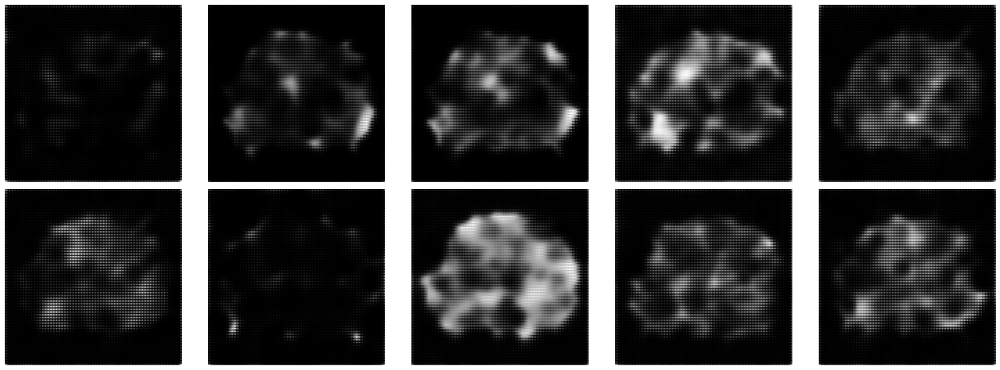

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<07:26,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 2/3750 [00:00<07:20,  8.50it/s]

1/1 [==============================] - 0s 29ms/step


  0%|                                          | 3/3750 [00:00<11:29,  5.44it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<09:38,  6.48it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<08:34,  7.28it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 6/3750 [00:00<08:01,  7.78it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 7/3750 [00:00<08:13,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 8/3750 [00:01<08:04,  7.73it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:01<07:43,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<07:23,  8.43it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                         | 11/3750 [00:01<07:11,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 12/3750 [00:01<06:59,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 13/3750 [00:01<06:51,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 14/3750 [00:01<06:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<06:43,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                        | 16/3750 [00:01<06:42,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  0%|▏                                        | 17/3750 [00:02<06:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 18/3750 [00:02<06:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 19/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 20/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 21/3750 [00:02<06:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▏                                        | 22/3750 [00:02<06:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<06:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 24/3750 [00:02<06:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 25/3750 [00:02<06:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 26/3750 [00:03<06:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 27/3750 [00:03<06:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 28/3750 [00:03<06:34,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 29/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 30/3750 [00:03<06:36,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 31/3750 [00:03<06:36,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 32/3750 [00:03<06:34,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 33/3750 [00:03<06:32,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 34/3750 [00:03<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 35/3750 [00:03<06:31,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 36/3750 [00:04<06:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 37/3750 [00:04<06:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 38/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 39/3750 [00:04<06:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 40/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 41/3750 [00:04<06:31,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 42/3750 [00:04<06:30,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 43/3750 [00:04<06:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 44/3750 [00:04<06:30,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 45/3750 [00:05<06:30,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 46/3750 [00:05<06:31,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 47/3750 [00:05<06:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 48/3750 [00:05<06:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<06:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 50/3750 [00:05<06:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 51/3750 [00:05<06:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 52/3750 [00:05<06:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 53/3750 [00:05<06:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 54/3750 [00:05<06:33,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 55/3750 [00:06<06:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:06<06:31,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:06<06:32,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 58/3750 [00:06<06:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 59/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 60/3750 [00:06<06:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 61/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 62/3750 [00:06<06:30,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:06<06:30,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 64/3750 [00:07<06:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:07<06:32,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 66/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 67/3750 [00:07<06:31,  9.41it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▋                                        | 68/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 69/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 70/3750 [00:07<06:32,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 71/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 72/3750 [00:07<06:29,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 73/3750 [00:08<06:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 74/3750 [00:08<06:28,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 75/3750 [00:08<06:27,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 76/3750 [00:08<06:28,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 77/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 78/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 79/3750 [00:08<06:25,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 80/3750 [00:08<06:25,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 81/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 82/3750 [00:08<06:25,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 83/3750 [00:09<06:24,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 84/3750 [00:09<06:24,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 85/3750 [00:09<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 86/3750 [00:09<06:26,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 87/3750 [00:09<06:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 88/3750 [00:09<06:24,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 89/3750 [00:09<06:25,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 90/3750 [00:09<06:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 91/3750 [00:09<06:27,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  2%|█                                        | 92/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:10<06:29,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:10<06:31,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 95/3750 [00:10<06:26,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 96/3750 [00:10<06:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 97/3750 [00:10<06:24,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 98/3750 [00:10<06:24,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 99/3750 [00:10<06:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:10<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 101/3750 [00:10<06:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 102/3750 [00:11<06:25,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:11<06:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:11<06:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                       | 105/3750 [00:11<06:25,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:23,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 107/3750 [00:11<06:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 108/3750 [00:11<06:24,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:11<06:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 110/3750 [00:11<06:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:12<06:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 112/3750 [00:12<06:23,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 113/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 114/3750 [00:12<06:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<06:25,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 116/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 117/3750 [00:12<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 118/3750 [00:12<06:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:12<06:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 120/3750 [00:12<06:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 121/3750 [00:13<06:24,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 122/3750 [00:13<06:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:13<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 125/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 126/3750 [00:13<06:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 127/3750 [00:13<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 128/3750 [00:13<06:23,  9.46it/s]

1/1 [==============================] - 0s 15ms/step


  3%|█▍                                      | 129/3750 [00:13<07:04,  8.53it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▍                                      | 130/3750 [00:14<07:03,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


  3%|█▍                                      | 131/3750 [00:14<06:58,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:14<06:48,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 133/3750 [00:14<06:42,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 134/3750 [00:14<06:37,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 135/3750 [00:14<06:32,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 136/3750 [00:14<06:27,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 137/3750 [00:14<06:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:14<06:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 139/3750 [00:15<06:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 140/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 141/3750 [00:15<06:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 142/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 143/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 144/3750 [00:15<06:21,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 145/3750 [00:15<06:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 146/3750 [00:15<06:18,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 147/3750 [00:15<06:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 148/3750 [00:15<06:20,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 149/3750 [00:16<06:19,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 150/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 151/3750 [00:16<06:22,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▌                                      | 152/3750 [00:16<06:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 153/3750 [00:16<06:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 154/3750 [00:16<06:20,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 155/3750 [00:16<06:20,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 156/3750 [00:16<06:21,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 157/3750 [00:16<06:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 158/3750 [00:17<06:41,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 159/3750 [00:17<06:37,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 160/3750 [00:17<06:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 161/3750 [00:17<06:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 162/3750 [00:17<06:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 163/3750 [00:17<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 164/3750 [00:17<06:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 165/3750 [00:17<06:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:17<06:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 167/3750 [00:18<06:18,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 168/3750 [00:18<06:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 169/3750 [00:18<06:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:18<06:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:18<06:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 172/3750 [00:18<06:19,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:18<06:18,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 174/3750 [00:18<06:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 175/3750 [00:18<06:18,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 176/3750 [00:18<06:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 177/3750 [00:19<06:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 178/3750 [00:19<06:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 179/3750 [00:19<06:18,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 180/3750 [00:19<06:17,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 181/3750 [00:19<06:17,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 182/3750 [00:19<06:16,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 183/3750 [00:19<06:17,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 184/3750 [00:19<06:16,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 185/3750 [00:19<06:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 186/3750 [00:20<06:15,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 187/3750 [00:20<06:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 188/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:20<06:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 190/3750 [00:20<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 191/3750 [00:20<06:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 192/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 193/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 194/3750 [00:20<06:15,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:20<06:15,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:21<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:21<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 198/3750 [00:21<06:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:21<06:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 200/3750 [00:21<06:41,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 201/3750 [00:21<06:34,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 202/3750 [00:21<06:27,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 203/3750 [00:21<06:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 204/3750 [00:21<06:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 205/3750 [00:22<06:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 206/3750 [00:22<06:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 207/3750 [00:22<06:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 208/3750 [00:22<06:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:22<06:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 210/3750 [00:22<06:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 211/3750 [00:22<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:22<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 213/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 214/3750 [00:23<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 215/3750 [00:23<06:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 216/3750 [00:23<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 217/3750 [00:23<06:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 218/3750 [00:23<06:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 219/3750 [00:23<06:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 220/3750 [00:23<06:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 221/3750 [00:23<06:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 222/3750 [00:23<06:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:23<06:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 224/3750 [00:24<06:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 225/3750 [00:24<06:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 226/3750 [00:24<06:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 227/3750 [00:24<06:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 228/3750 [00:24<06:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 229/3750 [00:24<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 230/3750 [00:24<06:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 231/3750 [00:24<06:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 232/3750 [00:24<06:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 233/3750 [00:25<06:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 234/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:25<06:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 236/3750 [00:25<06:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:25<06:11,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 238/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 241/3750 [00:25<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 243/3750 [00:26<06:11,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▌                                     | 244/3750 [00:26<06:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 245/3750 [00:26<06:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:26<06:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:26<06:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 248/3750 [00:26<06:11,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:26<06:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 250/3750 [00:26<06:10,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 251/3750 [00:26<06:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:27<06:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 253/3750 [00:27<06:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 254/3750 [00:27<06:09,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 255/3750 [00:27<06:08,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 256/3750 [00:27<06:08,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:27<06:07,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 258/3750 [00:27<06:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 259/3750 [00:27<06:07,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 260/3750 [00:27<06:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 261/3750 [00:28<06:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 262/3750 [00:28<06:10,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 263/3750 [00:28<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:28<06:09,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 265/3750 [00:28<06:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 266/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:28<06:06,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 269/3750 [00:28<06:08,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 270/3750 [00:28<06:07,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 271/3750 [00:29<06:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:29<06:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 273/3750 [00:29<06:07,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 274/3750 [00:29<06:06,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:29<06:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:29<06:04,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 277/3750 [00:29<06:03,  9.56it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 278/3750 [00:29<06:05,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 279/3750 [00:29<06:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 280/3750 [00:30<06:07,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 281/3750 [00:30<06:05,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 282/3750 [00:30<06:13,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███                                     | 283/3750 [00:30<06:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 284/3750 [00:30<06:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:30<06:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:30<06:08,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 287/3750 [00:30<06:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:30<06:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 289/3750 [00:30<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 290/3750 [00:31<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 291/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 292/3750 [00:31<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:31<06:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 294/3750 [00:31<06:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 295/3750 [00:31<06:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 296/3750 [00:31<06:05,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 297/3750 [00:31<06:04,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 298/3750 [00:31<06:05,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:32<06:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 300/3750 [00:32<06:04,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 301/3750 [00:32<06:03,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 302/3750 [00:32<06:03,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 303/3750 [00:32<06:02,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 304/3750 [00:32<06:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 305/3750 [00:32<06:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:32<06:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:32<06:03,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 308/3750 [00:32<06:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 309/3750 [00:33<06:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 310/3750 [00:33<06:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 311/3750 [00:33<06:03,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 312/3750 [00:33<06:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 313/3750 [00:33<06:01,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 314/3750 [00:33<06:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 315/3750 [00:33<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 316/3750 [00:33<06:02,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 317/3750 [00:33<06:02,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▍                                    | 318/3750 [00:34<06:09,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 319/3750 [00:34<06:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 320/3750 [00:34<06:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 321/3750 [00:34<06:06,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 322/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 323/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 324/3750 [00:34<06:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 325/3750 [00:34<06:04,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▍                                    | 326/3750 [00:34<06:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 327/3750 [00:34<06:03,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 328/3750 [00:35<06:03,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 329/3750 [00:35<06:02,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 330/3750 [00:35<06:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 331/3750 [00:35<06:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 332/3750 [00:35<06:01,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 333/3750 [00:35<06:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 334/3750 [00:35<06:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 335/3750 [00:35<06:00,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 336/3750 [00:35<06:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 337/3750 [00:36<06:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 338/3750 [00:36<06:00,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 339/3750 [00:36<06:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 340/3750 [00:36<06:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 341/3750 [00:36<06:02,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 342/3750 [00:36<06:02,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 343/3750 [00:36<06:02,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 344/3750 [00:36<06:01,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 345/3750 [00:36<06:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 346/3750 [00:37<05:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 347/3750 [00:37<05:57,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 348/3750 [00:37<05:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 349/3750 [00:37<05:57,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 350/3750 [00:37<05:56,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▋                                    | 351/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 352/3750 [00:37<05:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 353/3750 [00:37<06:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 354/3750 [00:37<06:01,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 355/3750 [00:37<06:00,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▊                                    | 356/3750 [00:38<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 357/3750 [00:38<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 358/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 359/3750 [00:38<05:57,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 360/3750 [00:38<05:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 361/3750 [00:38<05:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 362/3750 [00:38<05:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 363/3750 [00:38<05:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 364/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 365/3750 [00:39<05:57,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 366/3750 [00:39<05:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:39<05:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 368/3750 [00:39<05:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 369/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 370/3750 [00:39<05:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 371/3750 [00:39<05:56,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 372/3750 [00:39<05:55,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 373/3750 [00:39<05:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 374/3750 [00:39<05:53,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 375/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 376/3750 [00:40<05:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 377/3750 [00:40<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 378/3750 [00:40<05:56,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 379/3750 [00:40<05:57,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 380/3750 [00:40<05:55,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 381/3750 [00:40<05:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 382/3750 [00:40<05:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 383/3750 [00:40<05:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 384/3750 [00:41<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 385/3750 [00:41<05:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 386/3750 [00:41<05:53,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 387/3750 [00:41<05:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 388/3750 [00:41<05:55,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 389/3750 [00:41<05:54,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████▏                                   | 390/3750 [00:41<05:53,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:41<05:53,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 392/3750 [00:41<05:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 393/3750 [00:41<05:53,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 394/3750 [00:42<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 395/3750 [00:42<05:51,  9.55it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▏                                   | 396/3750 [00:42<05:51,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 397/3750 [00:42<05:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 398/3750 [00:42<05:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:42<05:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 400/3750 [00:42<05:52,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 401/3750 [00:42<05:51,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 402/3750 [00:42<05:52,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 403/3750 [00:43<05:51,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 404/3750 [00:43<05:51,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 405/3750 [00:43<05:50,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 406/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 407/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 408/3750 [00:43<05:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 409/3750 [00:43<05:52,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 410/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 411/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 412/3750 [00:43<05:51,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 413/3750 [00:44<05:53,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 414/3750 [00:44<05:53,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 415/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 416/3750 [00:44<05:53,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 417/3750 [00:44<05:51,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 418/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 419/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 420/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 421/3750 [00:44<05:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 423/3750 [00:45<05:49,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 424/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 425/3750 [00:45<05:50,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 426/3750 [00:45<05:50,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:45<05:51,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:45<05:50,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 429/3750 [00:45<05:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 430/3750 [00:45<05:49,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:45<05:49,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 432/3750 [00:46<05:49,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 433/3750 [00:46<05:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 434/3750 [00:46<05:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 435/3750 [00:46<05:54,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 436/3750 [00:46<05:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:46<05:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 438/3750 [00:46<05:49,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 439/3750 [00:46<05:48,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 440/3750 [00:46<05:49,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 441/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 442/3750 [00:47<05:48,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 443/3750 [00:47<05:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 444/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 445/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 446/3750 [00:47<05:48,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 447/3750 [00:47<05:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 448/3750 [00:47<05:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:47<05:47,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 450/3750 [00:47<05:47,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 451/3750 [00:48<05:46,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 452/3750 [00:48<05:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 453/3750 [00:48<05:48,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 455/3750 [00:48<05:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 456/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 457/3750 [00:48<05:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 458/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▉                                   | 459/3750 [00:48<06:12,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:49<06:04,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:49<06:01,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 462/3750 [00:49<05:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 463/3750 [00:49<05:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 464/3750 [00:49<05:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 465/3750 [00:49<05:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 466/3750 [00:49<05:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 467/3750 [00:49<05:53,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▉                                   | 468/3750 [00:49<05:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:50<05:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 470/3750 [00:50<05:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 471/3750 [00:50<05:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 472/3750 [00:50<05:48,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████                                   | 473/3750 [00:50<05:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 474/3750 [00:50<05:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 475/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 476/3750 [00:50<05:46,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 477/3750 [00:50<05:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:50<05:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:51<05:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 480/3750 [00:51<05:47,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 481/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 482/3750 [00:51<05:47,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 483/3750 [00:51<05:46,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 484/3750 [00:51<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 485/3750 [00:51<05:46,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 486/3750 [00:51<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 487/3750 [00:51<05:45,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 488/3750 [00:52<05:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 489/3750 [00:52<05:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 490/3750 [00:52<08:35,  6.33it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 491/3750 [00:52<07:43,  7.03it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:52<07:07,  7.62it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 493/3750 [00:52<06:46,  8.01it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 494/3750 [00:52<06:27,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 495/3750 [00:52<06:13,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 496/3750 [00:53<06:04,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 497/3750 [00:53<05:58,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 498/3750 [00:53<05:55,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 499/3750 [00:53<05:52,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 500/3750 [00:53<05:49,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 501/3750 [00:53<05:47,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 502/3750 [00:53<05:50,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 503/3750 [00:53<05:52,  9.21it/s]

1/1 [==============================] - 0s 13ms/step


 13%|█████▍                                  | 504/3750 [00:53<06:00,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 505/3750 [00:54<05:56,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 506/3750 [00:54<05:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 507/3750 [00:54<05:52,  9.19it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█████▍                                  | 508/3750 [00:54<06:25,  8.41it/s]

1/1 [==============================] - 0s 12ms/step


 14%|█████▍                                  | 509/3750 [00:54<06:23,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 510/3750 [00:54<06:28,  8.34it/s]

1/1 [==============================] - 0s 14ms/step


 14%|█████▍                                  | 511/3750 [00:54<06:23,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 512/3750 [00:54<06:28,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 513/3750 [00:54<06:31,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 514/3750 [00:55<06:45,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:55<06:51,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 516/3750 [00:55<06:54,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 517/3750 [00:55<06:43,  8.00it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▌                                  | 518/3750 [00:55<06:38,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 519/3750 [00:55<06:25,  8.37it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 520/3750 [00:55<06:13,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 521/3750 [00:55<06:08,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [00:56<06:03,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:56<05:58,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 524/3750 [00:56<05:59,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▌                                  | 525/3750 [00:56<06:12,  8.65it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█████▌                                  | 526/3750 [00:56<06:34,  8.18it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▌                                  | 527/3750 [00:56<06:53,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 528/3750 [00:56<06:45,  7.94it/s]

1/1 [==============================] - 0s 13ms/step


 14%|█████▋                                  | 529/3750 [00:56<06:43,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 530/3750 [00:57<06:51,  7.82it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█████▋                                  | 531/3750 [00:57<08:13,  6.52it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▋                                  | 532/3750 [00:57<07:41,  6.97it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [00:57<07:06,  7.54it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 534/3750 [00:57<06:57,  7.70it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 535/3750 [00:57<06:39,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 536/3750 [00:57<06:44,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 537/3750 [00:58<06:46,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 538/3750 [00:58<06:35,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 539/3750 [00:58<06:21,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [00:58<06:15,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▊                                  | 541/3750 [00:58<06:12,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▊                                  | 542/3750 [00:58<06:12,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▊                                  | 543/3750 [00:58<06:10,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 544/3750 [00:58<06:05,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 545/3750 [00:58<06:01,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 546/3750 [00:59<05:59,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [00:59<06:57,  7.67it/s]

1/1 [==============================] - 0s 11ms/step


 15%|█████▊                                  | 548/3750 [00:59<06:46,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 549/3750 [00:59<06:29,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 550/3750 [00:59<06:16,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 551/3750 [00:59<06:08,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 552/3750 [00:59<06:04,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 553/3750 [00:59<05:58,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 554/3750 [00:59<05:56,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 555/3750 [01:00<05:56,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 15%|█████▉                                  | 556/3750 [01:00<06:06,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 557/3750 [01:00<06:00,  8.85it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 558/3750 [01:00<05:54,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 559/3750 [01:00<05:51,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 560/3750 [01:00<05:49,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:00<05:46,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 562/3750 [01:00<05:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 563/3750 [01:00<05:43,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 564/3750 [01:01<05:50,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 565/3750 [01:01<05:59,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 566/3750 [01:01<05:58,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 567/3750 [01:01<05:55,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:01<05:52,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 569/3750 [01:01<05:50,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:01<05:48,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 571/3750 [01:01<05:53,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 572/3750 [01:01<05:56,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 573/3750 [01:02<05:57,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:02<05:53,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 575/3750 [01:02<05:50,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 576/3750 [01:02<05:48,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:02<05:45,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 578/3750 [01:02<05:42,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 579/3750 [01:02<05:45,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 580/3750 [01:02<05:46,  9.15it/s]

1/1 [==============================] - 0s 11ms/step


 15%|██████▏                                 | 581/3750 [01:02<05:49,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 582/3750 [01:03<05:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:03<05:46,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▏                                 | 584/3750 [01:03<05:44,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 585/3750 [01:03<05:45,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 586/3750 [01:03<05:48,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▎                                 | 587/3750 [01:03<05:58,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▎                                 | 588/3750 [01:03<05:55,  8.89it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:03<05:51,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 590/3750 [01:03<05:46,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 591/3750 [01:04<05:45,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 592/3750 [01:04<05:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 593/3750 [01:04<05:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 594/3750 [01:04<05:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 595/3750 [01:04<05:42,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 596/3750 [01:04<05:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:04<05:42,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:04<05:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 599/3750 [01:04<05:42,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 600/3750 [01:05<05:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 601/3750 [01:05<05:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 602/3750 [01:05<05:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 603/3750 [01:05<05:50,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 604/3750 [01:05<06:01,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 605/3750 [01:05<05:55,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 606/3750 [01:05<05:50,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 607/3750 [01:05<05:45,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 608/3750 [01:05<05:46,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 609/3750 [01:06<05:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 610/3750 [01:06<05:53,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 611/3750 [01:06<05:59,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 612/3750 [01:06<05:53,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 613/3750 [01:06<05:49,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:43,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 615/3750 [01:06<05:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:06<05:41,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:06<05:43,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▌                                 | 618/3750 [01:07<05:45,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:07<05:43,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▌                                 | 620/3750 [01:07<05:42,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 621/3750 [01:07<05:42,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 622/3750 [01:07<05:46,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 623/3750 [01:07<05:43,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 624/3750 [01:07<05:42,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 625/3750 [01:07<05:41,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 626/3750 [01:07<05:39,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 627/3750 [01:08<05:41,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 628/3750 [01:08<05:39,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 629/3750 [01:08<05:41,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 630/3750 [01:08<05:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 631/3750 [01:08<05:43,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 632/3750 [01:08<06:40,  7.78it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 633/3750 [01:08<06:34,  7.89it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 634/3750 [01:08<06:19,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 635/3750 [01:08<06:07,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 636/3750 [01:09<05:58,  8.69it/s]

1/1 [==============================] - 0s 12ms/step


 17%|██████▊                                 | 637/3750 [01:09<05:56,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 638/3750 [01:09<05:51,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 639/3750 [01:09<05:45,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 640/3750 [01:09<05:52,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 641/3750 [01:09<05:56,  8.72it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 642/3750 [01:09<05:50,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:09<05:46,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 644/3750 [01:09<05:41,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:10<05:41,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 646/3750 [01:10<05:46,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 647/3750 [01:10<05:52,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 648/3750 [01:10<05:50,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:10<05:45,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 650/3750 [01:10<05:47,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 651/3750 [01:10<05:46,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:10<05:49,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:10<05:45,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 654/3750 [01:11<05:41,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 655/3750 [01:11<05:42,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 656/3750 [01:11<05:40,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 657/3750 [01:11<05:49,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 658/3750 [01:11<05:51,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 659/3750 [01:11<05:46,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 660/3750 [01:11<05:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 661/3750 [01:11<05:38,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 662/3750 [01:11<05:41,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 663/3750 [01:12<05:50,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 664/3750 [01:12<05:54,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 665/3750 [01:12<05:50,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 666/3750 [01:12<05:44,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 667/3750 [01:12<05:41,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 668/3750 [01:12<05:36,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 669/3750 [01:12<05:38,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 670/3750 [01:12<05:47,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 671/3750 [01:12<05:55,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:13<05:49,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 673/3750 [01:13<05:43,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 674/3750 [01:13<05:49,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████▏                                | 675/3750 [01:13<05:55,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:13<05:50,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 677/3750 [01:13<05:46,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 678/3750 [01:13<05:42,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 679/3750 [01:13<06:18,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 680/3750 [01:14<06:09,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 681/3750 [01:14<06:05,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 682/3750 [01:14<05:59,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:14<05:54,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 684/3750 [01:14<05:47,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 685/3750 [01:14<05:43,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 686/3750 [01:14<05:40,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 687/3750 [01:14<05:38,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 688/3750 [01:14<05:37,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 689/3750 [01:15<05:35,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 690/3750 [01:15<05:34,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 691/3750 [01:15<05:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▍                                | 692/3750 [01:15<05:48,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▍                                | 693/3750 [01:15<05:46,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 694/3750 [01:15<05:40,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 695/3750 [01:15<05:38,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 696/3750 [01:15<05:35,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 697/3750 [01:15<05:32,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:16<05:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:16<05:31,  9.20it/s]

1/1 [==============================] - 0s 14ms/step


 19%|███████▍                                | 700/3750 [01:16<05:41,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 701/3750 [01:16<05:35,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:16<05:36,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 703/3750 [01:16<05:49,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:16<05:46,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:16<05:43,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 706/3750 [01:16<05:40,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 707/3750 [01:17<05:38,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 708/3750 [01:17<05:36,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:17<05:36,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 710/3750 [01:17<05:35,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 711/3750 [01:17<05:32,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 712/3750 [01:17<05:30,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 713/3750 [01:17<05:28,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 714/3750 [01:17<05:29,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 715/3750 [01:17<05:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 716/3750 [01:18<05:27,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 717/3750 [01:18<05:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 718/3750 [01:18<05:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:18<05:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 720/3750 [01:18<05:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 721/3750 [01:18<05:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 722/3750 [01:18<05:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:18<05:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 724/3750 [01:18<05:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 725/3750 [01:18<05:24,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▋                                | 726/3750 [01:19<05:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 727/3750 [01:19<05:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:19<05:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:19<05:23,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 730/3750 [01:19<05:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 731/3750 [01:19<05:23,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:19<05:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 733/3750 [01:19<05:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 734/3750 [01:19<05:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 735/3750 [01:20<05:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:20<05:21,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▊                                | 737/3750 [01:20<05:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:20<05:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 739/3750 [01:20<05:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:20<05:23,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 741/3750 [01:20<05:26,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 742/3750 [01:20<05:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:20<05:24,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 744/3750 [01:21<05:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 745/3750 [01:21<05:23,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 746/3750 [01:21<05:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:21<05:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:21<05:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:21<05:23,  9.29it/s]

1/1 [==============================] - 0s 11ms/step


 20%|████████                                | 750/3750 [01:21<05:27,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 751/3750 [01:21<05:24,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 752/3750 [01:21<05:21,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:21<05:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:22<05:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:22<05:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:22<05:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 757/3750 [01:22<05:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 758/3750 [01:22<05:17,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 759/3750 [01:22<05:16,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 760/3750 [01:22<05:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:22<05:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 762/3750 [01:22<05:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 763/3750 [01:23<05:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 764/3750 [01:23<05:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 765/3750 [01:23<05:21,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 766/3750 [01:23<05:21,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 767/3750 [01:23<05:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 768/3750 [01:23<05:22,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▏                               | 769/3750 [01:23<05:24,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 770/3750 [01:23<05:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:23<05:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 772/3750 [01:24<05:21,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 773/3750 [01:24<05:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 774/3750 [01:24<05:19,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 775/3750 [01:24<05:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 776/3750 [01:24<05:23,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 777/3750 [01:24<05:32,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 778/3750 [01:24<05:26,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▎                               | 779/3750 [01:24<05:28,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:24<05:25,  9.13it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▎                               | 781/3750 [01:25<05:25,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 782/3750 [01:25<05:24,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 783/3750 [01:25<05:35,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 784/3750 [01:25<05:30,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 785/3750 [01:25<05:27,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 786/3750 [01:25<05:24,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 787/3750 [01:25<05:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 788/3750 [01:25<05:23,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 789/3750 [01:25<05:23,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 790/3750 [01:26<05:23,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 791/3750 [01:26<05:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 792/3750 [01:26<05:21,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 793/3750 [01:26<05:22,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 794/3750 [01:26<05:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:26<05:21,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 796/3750 [01:26<05:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:26<06:01,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 798/3750 [01:26<05:51,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 799/3750 [01:27<05:40,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▌                               | 800/3750 [01:27<05:34,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 801/3750 [01:27<05:31,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:27<05:29,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:27<05:27,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 804/3750 [01:27<05:24,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 805/3750 [01:27<05:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 806/3750 [01:27<05:21,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▌                               | 807/3750 [01:27<05:29,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▌                               | 808/3750 [01:28<05:28,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 809/3750 [01:28<05:24,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 810/3750 [01:28<05:23,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 811/3750 [01:28<05:25,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 812/3750 [01:28<05:27,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 813/3750 [01:28<05:27,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 814/3750 [01:28<05:26,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 815/3750 [01:28<05:26,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:28<05:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 817/3750 [01:29<05:21,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 818/3750 [01:29<05:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 819/3750 [01:29<05:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 820/3750 [01:29<05:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:29<05:19,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:29<05:18,  9.20it/s]

1/1 [==============================] - 0s 16ms/step


 22%|████████▊                               | 823/3750 [01:29<05:28,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 824/3750 [01:29<05:28,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 825/3750 [01:29<05:28,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 826/3750 [01:30<05:30,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 827/3750 [01:30<05:28,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 828/3750 [01:30<05:32,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 829/3750 [01:30<05:27,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 830/3750 [01:30<05:24,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 831/3750 [01:30<05:22,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 832/3750 [01:30<05:21,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 833/3750 [01:30<05:19,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 834/3750 [01:30<05:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 835/3750 [01:30<05:16,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 836/3750 [01:31<05:18,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 837/3750 [01:31<05:17,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 838/3750 [01:31<05:19,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 839/3750 [01:31<05:17,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:31<05:16,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:31<05:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 842/3750 [01:31<05:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 843/3750 [01:31<05:13,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 844/3750 [01:31<05:14,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 845/3750 [01:32<05:16,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 846/3750 [01:32<05:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:32<05:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 848/3750 [01:32<05:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 849/3750 [01:32<05:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:32<05:13,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 851/3750 [01:32<05:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 852/3750 [01:32<05:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 853/3750 [01:32<05:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 854/3750 [01:33<05:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 855/3750 [01:33<05:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 856/3750 [01:33<05:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 857/3750 [01:33<05:12,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 858/3750 [01:33<05:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 859/3750 [01:33<05:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 860/3750 [01:33<05:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 861/3750 [01:33<05:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 862/3750 [01:33<05:14,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:34<05:14,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 864/3750 [01:34<05:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 865/3750 [01:34<05:14,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 866/3750 [01:34<05:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 867/3750 [01:34<05:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 868/3750 [01:34<05:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 869/3750 [01:34<05:08,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 870/3750 [01:34<05:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 871/3750 [01:34<05:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 872/3750 [01:34<05:08,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 873/3750 [01:35<05:20,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 874/3750 [01:35<05:28,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 875/3750 [01:35<05:32,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▎                              | 876/3750 [01:35<05:36,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 877/3750 [01:35<05:29,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 878/3750 [01:35<05:23,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 879/3750 [01:35<05:19,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 880/3750 [01:35<05:16,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▍                              | 881/3750 [01:36<05:15,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 882/3750 [01:36<05:19,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 883/3750 [01:36<05:30,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 884/3750 [01:36<05:34,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 885/3750 [01:36<05:28,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 886/3750 [01:36<05:24,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 887/3750 [01:36<05:20,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 888/3750 [01:36<05:16,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 889/3750 [01:36<05:14,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 890/3750 [01:37<05:13,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 891/3750 [01:37<05:14,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 892/3750 [01:37<05:18,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 893/3750 [01:37<05:14,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 894/3750 [01:37<05:11,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 895/3750 [01:37<05:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 896/3750 [01:37<05:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 897/3750 [01:37<05:09,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 898/3750 [01:37<05:10,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:38<05:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 900/3750 [01:38<05:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:38<05:21,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 902/3750 [01:38<05:20,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 903/3750 [01:38<05:16,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 904/3750 [01:38<05:13,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 905/3750 [01:38<05:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 906/3750 [01:38<05:10,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 907/3750 [01:38<05:11,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 908/3750 [01:39<05:09,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 909/3750 [01:39<05:08,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 910/3750 [01:39<05:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 911/3750 [01:39<05:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 912/3750 [01:39<05:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 913/3750 [01:39<05:07,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 914/3750 [01:39<05:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 915/3750 [01:39<05:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 916/3750 [01:39<05:08,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 917/3750 [01:39<05:08,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 918/3750 [01:40<05:08,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 919/3750 [01:40<05:08,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 920/3750 [01:40<05:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 921/3750 [01:40<05:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 922/3750 [01:40<05:07,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 923/3750 [01:40<05:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 924/3750 [01:40<05:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 925/3750 [01:40<05:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 926/3750 [01:40<05:06,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 927/3750 [01:41<05:05,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 928/3750 [01:41<05:06,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:41<05:06,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▉                              | 930/3750 [01:41<05:10,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:41<05:08,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:41<05:08,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:41<05:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 934/3750 [01:41<05:06,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 935/3750 [01:41<05:09,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 936/3750 [01:42<05:07,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 937/3750 [01:42<05:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 938/3750 [01:42<05:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 939/3750 [01:42<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 940/3750 [01:42<05:06,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 941/3750 [01:42<05:06,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 942/3750 [01:42<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 943/3750 [01:42<05:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 944/3750 [01:42<05:04,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 945/3750 [01:43<05:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 946/3750 [01:43<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 947/3750 [01:43<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:43<05:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:43<04:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 950/3750 [01:43<05:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 951/3750 [01:43<05:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 952/3750 [01:43<05:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 953/3750 [01:43<05:10,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 954/3750 [01:44<05:16,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 955/3750 [01:44<05:12,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:44<05:09,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 957/3750 [01:44<05:06,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 958/3750 [01:44<05:03,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 959/3750 [01:44<05:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 960/3750 [01:44<05:04,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 961/3750 [01:44<05:04,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 962/3750 [01:44<05:01,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 963/3750 [01:44<05:02,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 964/3750 [01:45<05:02,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 965/3750 [01:45<05:02,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 966/3750 [01:45<05:01,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 967/3750 [01:45<05:06,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 968/3750 [01:45<05:03,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 969/3750 [01:45<05:04,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 970/3750 [01:45<05:02,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 971/3750 [01:45<05:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 972/3750 [01:45<05:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:46<05:00,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 974/3750 [01:46<04:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 975/3750 [01:46<04:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 976/3750 [01:46<04:57,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 977/3750 [01:46<04:58,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 978/3750 [01:46<05:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 979/3750 [01:46<04:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 980/3750 [01:46<04:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 981/3750 [01:46<04:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 982/3750 [01:47<04:59,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 983/3750 [01:47<04:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 984/3750 [01:47<04:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:47<04:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 986/3750 [01:47<04:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 987/3750 [01:47<04:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 988/3750 [01:47<04:58,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 989/3750 [01:47<04:55,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 990/3750 [01:47<04:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 991/3750 [01:48<04:55,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 992/3750 [01:48<04:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 993/3750 [01:48<04:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 994/3750 [01:48<04:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 995/3750 [01:48<04:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 996/3750 [01:48<04:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                             | 997/3750 [01:48<04:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 998/3750 [01:48<04:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 999/3750 [01:48<04:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1000/3750 [01:48<04:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1001/3750 [01:49<04:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:49<04:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1003/3750 [01:49<04:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:49<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:49<04:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1006/3750 [01:49<04:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:49<04:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1008/3750 [01:49<04:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1009/3750 [01:49<04:57,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1010/3750 [01:50<04:57,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1011/3750 [01:50<04:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1012/3750 [01:50<04:56,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1013/3750 [01:50<04:56,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1014/3750 [01:50<04:56,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:50<04:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:50<04:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1017/3750 [01:50<04:57,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1018/3750 [01:50<04:56,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1019/3750 [01:51<04:56,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1020/3750 [01:51<04:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▌                            | 1021/3750 [01:51<04:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1022/3750 [01:51<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1023/3750 [01:51<04:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1024/3750 [01:51<04:51,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                            | 1025/3750 [01:51<04:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1026/3750 [01:51<04:55,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1027/3750 [01:51<04:53,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1028/3750 [01:51<04:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1029/3750 [01:52<04:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1030/3750 [01:52<04:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:52<04:51,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▋                            | 1032/3750 [01:52<04:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1033/3750 [01:52<04:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1034/3750 [01:52<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1035/3750 [01:52<04:53,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▊                            | 1036/3750 [01:52<04:55,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1037/3750 [01:52<04:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1038/3750 [01:53<04:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1039/3750 [01:53<04:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1040/3750 [01:53<04:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1041/3750 [01:53<04:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:53<04:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1043/3750 [01:53<04:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1044/3750 [01:53<04:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:53<04:59,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1046/3750 [01:53<04:58,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1047/3750 [01:54<04:57,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1048/3750 [01:54<04:55,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1049/3750 [01:54<04:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1050/3750 [01:54<04:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1051/3750 [01:54<04:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1052/3750 [01:54<04:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1053/3750 [01:54<04:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:54<04:49,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1055/3750 [01:54<04:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1056/3750 [01:55<04:49,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1057/3750 [01:55<04:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1058/3750 [01:55<04:48,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1059/3750 [01:55<04:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1060/3750 [01:55<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:55<04:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:55<04:46,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1063/3750 [01:55<04:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1064/3750 [01:55<04:47,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1065/3750 [01:55<04:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1066/3750 [01:56<04:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1067/3750 [01:56<04:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1068/3750 [01:56<04:49,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:56<04:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [01:56<04:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:56<04:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1072/3750 [01:56<04:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1073/3750 [01:56<04:48,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1074/3750 [01:56<04:49,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1075/3750 [01:57<04:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1076/3750 [01:57<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1077/3750 [01:57<04:48,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1078/3750 [01:57<04:48,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1079/3750 [01:57<04:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1080/3750 [01:57<04:47,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1081/3750 [01:57<04:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1082/3750 [01:57<04:43,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:57<04:44,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1084/3750 [01:58<04:46,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1085/3750 [01:58<04:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [01:58<04:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1087/3750 [01:58<04:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [01:58<04:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1089/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1090/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1091/3750 [01:58<04:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:59<04:46,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1094/3750 [01:59<04:48,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1095/3750 [01:59<04:48,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1096/3750 [01:59<04:48,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1097/3750 [01:59<04:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1098/3750 [01:59<04:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [01:59<04:47,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [01:59<04:47,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▍                           | 1101/3750 [01:59<04:54,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1102/3750 [01:59<04:53,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1103/3750 [02:00<04:53,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [02:00<04:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [02:00<04:48,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▌                           | 1106/3750 [02:00<04:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1107/3750 [02:00<04:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [02:00<04:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1109/3750 [02:00<04:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [02:00<04:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1111/3750 [02:00<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1112/3750 [02:01<04:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1113/3750 [02:01<04:45,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1114/3750 [02:01<04:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1115/3750 [02:01<04:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1116/3750 [02:01<04:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [02:01<04:44,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1118/3750 [02:01<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1119/3750 [02:01<04:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1120/3750 [02:01<04:44,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1121/3750 [02:02<04:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1122/3750 [02:02<04:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1123/3750 [02:02<04:45,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1124/3750 [02:02<04:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:02<04:45,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1126/3750 [02:02<04:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1127/3750 [02:02<04:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1128/3750 [02:02<04:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1129/3750 [02:02<04:43,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1130/3750 [02:03<04:41,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1131/3750 [02:03<04:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:03<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1133/3750 [02:03<04:41,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1134/3750 [02:03<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1135/3750 [02:03<04:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1136/3750 [02:03<04:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1137/3750 [02:03<04:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1138/3750 [02:03<04:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:03<04:45,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1140/3750 [02:04<04:45,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1141/3750 [02:04<04:48,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▉                           | 1142/3750 [02:04<04:52,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▉                           | 1143/3750 [02:04<04:49,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1144/3750 [02:04<04:47,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1145/3750 [02:04<04:47,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:04<04:44,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1147/3750 [02:04<04:42,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1148/3750 [02:04<04:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1149/3750 [02:05<04:47,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1150/3750 [02:05<04:52,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1151/3750 [02:05<04:56,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1152/3750 [02:05<04:58,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1153/3750 [02:05<04:57,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1154/3750 [02:05<04:56,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1155/3750 [02:05<04:55,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████                           | 1156/3750 [02:05<04:55,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1157/3750 [02:06<04:50,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:06<04:49,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1159/3750 [02:06<04:45,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1160/3750 [02:06<04:45,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1161/3750 [02:06<04:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1162/3750 [02:06<04:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1163/3750 [02:06<04:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1164/3750 [02:06<04:41,  9.20it/s]

1/1 [==============================] - 0s 12ms/step


 31%|████████████                           | 1165/3750 [02:06<04:47,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1166/3750 [02:07<04:48,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1167/3750 [02:07<04:48,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1168/3750 [02:07<04:45,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1169/3750 [02:07<04:43,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1170/3750 [02:07<04:49,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1171/3750 [02:07<04:52,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1172/3750 [02:07<04:47,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1173/3750 [02:07<04:48,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 31%|████████████▏                          | 1174/3750 [02:07<04:49,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:08<04:45,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1176/3750 [02:08<04:44,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1177/3750 [02:08<04:40,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1178/3750 [02:08<04:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1179/3750 [02:08<04:38,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▎                          | 1180/3750 [02:08<04:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1181/3750 [02:08<04:37,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1182/3750 [02:08<04:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1183/3750 [02:08<04:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1184/3750 [02:08<04:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:09<04:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1186/3750 [02:09<04:36,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1187/3750 [02:09<04:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1188/3750 [02:09<04:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1189/3750 [02:09<04:37,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1190/3750 [02:09<04:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1191/3750 [02:09<04:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1192/3750 [02:09<04:36,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1193/3750 [02:09<04:38,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1194/3750 [02:10<04:38,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1195/3750 [02:10<04:36,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1196/3750 [02:10<04:35,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1197/3750 [02:10<04:34,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1198/3750 [02:10<05:00,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1199/3750 [02:10<04:51,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1200/3750 [02:10<04:46,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1201/3750 [02:10<04:43,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1202/3750 [02:10<04:40,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:11<04:38,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1204/3750 [02:11<04:36,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1205/3750 [02:11<04:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1206/3750 [02:11<04:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1207/3750 [02:11<04:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:11<04:35,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1209/3750 [02:11<04:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1210/3750 [02:11<04:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1211/3750 [02:11<04:34,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1212/3750 [02:12<04:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1213/3750 [02:12<04:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:12<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:12<04:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:12<04:35,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1217/3750 [02:12<04:36,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1218/3750 [02:12<04:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1219/3750 [02:12<04:34,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1220/3750 [02:12<04:33,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:13<04:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1222/3750 [02:13<04:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1223/3750 [02:13<04:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:13<04:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1225/3750 [02:13<04:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1226/3750 [02:13<04:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1227/3750 [02:13<04:33,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1228/3750 [02:13<04:35,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1229/3750 [02:13<04:37,  9.10it/s]

1/1 [==============================] - 0s 16ms/step


 33%|████████████▊                          | 1230/3750 [02:14<04:54,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1231/3750 [02:14<04:52,  8.60it/s]

1/1 [==============================] - 0s 13ms/step


 33%|████████████▊                          | 1232/3750 [02:14<04:55,  8.51it/s]

1/1 [==============================] - 0s 13ms/step


 33%|████████████▊                          | 1233/3750 [02:14<04:54,  8.55it/s]

1/1 [==============================] - 0s 23ms/step


 33%|████████████▊                          | 1234/3750 [02:14<05:04,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 33%|████████████▊                          | 1235/3750 [02:14<05:25,  7.73it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1236/3750 [02:14<05:27,  7.69it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1237/3750 [02:14<05:24,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1238/3750 [02:15<05:09,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1239/3750 [02:15<04:57,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1240/3750 [02:15<04:49,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:15<04:48,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1242/3750 [02:15<04:42,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1243/3750 [02:15<04:38,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1244/3750 [02:15<04:34,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1245/3750 [02:15<04:33,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1246/3750 [02:15<04:33,  9.14it/s]

1/1 [==============================] - 0s 14ms/step


 33%|████████████▉                          | 1247/3750 [02:16<04:48,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1248/3750 [02:16<04:56,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1249/3750 [02:16<04:49,  8.64it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1250/3750 [02:16<04:43,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1251/3750 [02:16<04:38,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1252/3750 [02:16<04:34,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1253/3750 [02:16<04:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:16<04:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:16<04:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:16<04:31,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:17<04:29,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1258/3750 [02:17<04:26,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1259/3750 [02:17<04:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1260/3750 [02:17<04:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1261/3750 [02:17<04:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1262/3750 [02:17<04:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1263/3750 [02:17<04:22,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1264/3750 [02:17<04:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1265/3750 [02:17<04:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1266/3750 [02:18<04:23,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:18<04:22,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▏                         | 1268/3750 [02:18<04:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1269/3750 [02:18<04:23,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1270/3750 [02:18<04:23,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1271/3750 [02:18<04:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1272/3750 [02:18<04:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1273/3750 [02:18<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1274/3750 [02:18<04:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1275/3750 [02:19<04:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1276/3750 [02:19<04:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1277/3750 [02:19<04:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1278/3750 [02:19<04:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1279/3750 [02:19<04:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1280/3750 [02:19<04:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1281/3750 [02:19<04:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1282/3750 [02:19<04:27,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1283/3750 [02:19<04:40,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1284/3750 [02:20<04:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1285/3750 [02:20<04:45,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1286/3750 [02:20<04:47,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▍                         | 1287/3750 [02:20<04:43,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1288/3750 [02:20<04:35,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1289/3750 [02:20<04:30,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1290/3750 [02:20<04:27,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1291/3750 [02:20<04:24,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1292/3750 [02:20<04:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1293/3750 [02:21<04:30,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1294/3750 [02:21<04:30,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1295/3750 [02:21<04:27,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1296/3750 [02:21<04:27,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▍                         | 1297/3750 [02:21<04:34,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▍                         | 1298/3750 [02:21<04:36,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1299/3750 [02:21<04:32,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1300/3750 [02:21<04:31,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1301/3750 [02:21<04:29,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1302/3750 [02:22<04:36,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1303/3750 [02:22<04:40,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1304/3750 [02:22<04:43,  8.62it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▌                         | 1305/3750 [02:22<04:56,  8.26it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▌                         | 1306/3750 [02:22<04:55,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1307/3750 [02:22<04:52,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1308/3750 [02:22<04:50,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1309/3750 [02:22<04:45,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1310/3750 [02:22<04:45,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1311/3750 [02:23<04:42,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1312/3750 [02:23<04:39,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1313/3750 [02:23<04:37,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1314/3750 [02:23<04:35,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:23<04:36,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1316/3750 [02:23<04:33,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1317/3750 [02:23<04:30,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1318/3750 [02:23<04:29,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:23<04:37,  8.76it/s]

1/1 [==============================] - 0s 12ms/step


 35%|█████████████▋                         | 1320/3750 [02:24<04:40,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1321/3750 [02:24<04:40,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1322/3750 [02:24<04:36,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1323/3750 [02:24<04:35,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1324/3750 [02:24<04:32,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1325/3750 [02:24<04:28,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1326/3750 [02:24<04:27,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1327/3750 [02:24<04:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1328/3750 [02:24<04:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1329/3750 [02:25<04:30,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1330/3750 [02:25<04:35,  8.79it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▊                         | 1331/3750 [02:25<04:42,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▊                         | 1332/3750 [02:25<04:39,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▊                         | 1333/3750 [02:25<04:34,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1334/3750 [02:25<04:30,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1335/3750 [02:25<04:27,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1336/3750 [02:25<04:23,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1337/3750 [02:25<04:22,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1338/3750 [02:26<04:25,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1339/3750 [02:26<04:29,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1340/3750 [02:26<04:27,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1341/3750 [02:26<04:25,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1342/3750 [02:26<04:33,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1343/3750 [02:26<04:36,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1344/3750 [02:26<04:40,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1345/3750 [02:26<04:35,  8.72it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1346/3750 [02:27<04:35,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1347/3750 [02:27<04:32,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1348/3750 [02:27<04:30,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1349/3750 [02:27<04:26,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1350/3750 [02:27<04:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1351/3750 [02:27<04:20,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:27<04:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1353/3750 [02:27<04:34,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1354/3750 [02:27<04:36,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████                         | 1355/3750 [02:28<04:35,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1356/3750 [02:28<04:31,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1357/3750 [02:28<04:28,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1358/3750 [02:28<04:23,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1359/3750 [02:28<04:21,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1360/3750 [02:28<04:24,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1361/3750 [02:28<04:24,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1362/3750 [02:28<04:22,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1363/3750 [02:28<04:20,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1364/3750 [02:29<04:20,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1365/3750 [02:29<04:19,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:29<04:17,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1367/3750 [02:29<04:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1368/3750 [02:29<04:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▏                        | 1369/3750 [02:29<04:18,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▏                        | 1370/3750 [02:29<04:19,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1371/3750 [02:29<04:21,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1372/3750 [02:29<04:26,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1373/3750 [02:29<04:24,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1374/3750 [02:30<04:24,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1375/3750 [02:30<04:24,  8.98it/s]

1/1 [==============================] - 0s 12ms/step


 37%|██████████████▎                        | 1376/3750 [02:30<04:27,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1377/3750 [02:30<04:25,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1378/3750 [02:30<04:22,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:30<04:21,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1380/3750 [02:30<04:22,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1381/3750 [02:30<04:20,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:30<04:19,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1383/3750 [02:31<04:17,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1384/3750 [02:31<04:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1385/3750 [02:31<04:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1386/3750 [02:31<04:15,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1387/3750 [02:31<04:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1388/3750 [02:31<04:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1389/3750 [02:31<04:14,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1390/3750 [02:31<04:13,  9.30it/s]

1/1 [==============================] - 0s 12ms/step


 37%|██████████████▍                        | 1391/3750 [02:31<04:17,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▍                        | 1392/3750 [02:32<04:19,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1393/3750 [02:32<04:18,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:32<04:20,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1395/3750 [02:32<04:31,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1396/3750 [02:32<04:35,  8.55it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1397/3750 [02:32<04:40,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1398/3750 [02:32<04:42,  8.31it/s]

1/1 [==============================] - 0s 13ms/step


 37%|██████████████▌                        | 1399/3750 [02:32<04:48,  8.15it/s]

1/1 [==============================] - 0s 12ms/step


 37%|██████████████▌                        | 1400/3750 [02:33<04:50,  8.09it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1401/3750 [02:33<04:48,  8.15it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1402/3750 [02:33<04:48,  8.15it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1403/3750 [02:33<04:46,  8.20it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1404/3750 [02:33<04:47,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▌                        | 1405/3750 [02:33<04:44,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1406/3750 [02:33<04:36,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1407/3750 [02:33<04:30,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1408/3750 [02:33<04:25,  8.82it/s]

1/1 [==============================] - 0s 21ms/step


 38%|██████████████▋                        | 1409/3750 [02:34<04:34,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1410/3750 [02:34<04:28,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1411/3750 [02:34<04:22,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1412/3750 [02:34<04:21,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1413/3750 [02:34<04:20,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1414/3750 [02:34<04:26,  8.77it/s]

1/1 [==============================] - 0s 13ms/step


 38%|██████████████▋                        | 1415/3750 [02:34<04:35,  8.48it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▋                        | 1416/3750 [02:34<04:39,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1417/3750 [02:35<04:39,  8.36it/s]

1/1 [==============================] - 0s 12ms/step


 38%|██████████████▋                        | 1418/3750 [02:35<04:43,  8.22it/s]

1/1 [==============================] - 0s 12ms/step


 38%|██████████████▊                        | 1419/3750 [02:35<04:38,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1420/3750 [02:35<04:40,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1421/3750 [02:35<04:33,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1422/3750 [02:35<04:30,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1423/3750 [02:35<04:26,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1424/3750 [02:35<04:27,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1425/3750 [02:35<04:32,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1426/3750 [02:36<04:27,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:36<04:22,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1428/3750 [02:36<04:18,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1429/3750 [02:36<04:23,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1430/3750 [02:36<04:27,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1431/3750 [02:36<04:24,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1432/3750 [02:36<04:23,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:36<04:18,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1434/3750 [02:36<04:15,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1435/3750 [02:37<04:20,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 38%|██████████████▉                        | 1436/3750 [02:37<04:24,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1437/3750 [02:37<04:20,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1438/3750 [02:37<04:20,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1439/3750 [02:37<04:16,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1440/3750 [02:37<04:13,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1441/3750 [02:37<04:11,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1442/3750 [02:37<04:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 38%|███████████████                        | 1443/3750 [02:37<04:12,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1444/3750 [02:38<04:13,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1445/3750 [02:38<04:14,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1446/3750 [02:38<04:20,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1447/3750 [02:38<04:23,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1448/3750 [02:38<04:23,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1449/3750 [02:38<04:22,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1450/3750 [02:38<04:21,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1451/3750 [02:38<04:25,  8.67it/s]

1/1 [==============================] - 0s 12ms/step


 39%|███████████████                        | 1452/3750 [02:39<04:28,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1453/3750 [02:39<04:27,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1454/3750 [02:39<04:22,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1455/3750 [02:39<04:17,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1456/3750 [02:39<04:15,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1457/3750 [02:39<04:12,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1458/3750 [02:39<04:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1459/3750 [02:39<05:13,  7.30it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1460/3750 [02:39<04:58,  7.68it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1461/3750 [02:40<04:44,  8.06it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▏                       | 1462/3750 [02:40<04:37,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▏                       | 1463/3750 [02:40<04:35,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1464/3750 [02:40<04:37,  8.23it/s]

1/1 [==============================] - 0s 12ms/step


 39%|███████████████▏                       | 1465/3750 [02:40<04:51,  7.85it/s]

1/1 [==============================] - 0s 13ms/step


 39%|███████████████▏                       | 1466/3750 [02:40<04:47,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1467/3750 [02:40<04:41,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1468/3750 [02:40<04:37,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1469/3750 [02:41<04:38,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1470/3750 [02:41<04:30,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1471/3750 [02:41<04:24,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1472/3750 [02:41<04:19,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:41<04:15,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1474/3750 [02:41<04:12,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1475/3750 [02:41<04:17,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▎                       | 1476/3750 [02:41<04:34,  8.28it/s]

1/1 [==============================] - 0s 12ms/step


 39%|███████████████▎                       | 1477/3750 [02:42<04:41,  8.08it/s]

1/1 [==============================] - 0s 12ms/step


 39%|███████████████▎                       | 1478/3750 [02:42<04:33,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1479/3750 [02:42<04:23,  8.62it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▍                       | 1480/3750 [02:42<04:17,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1481/3750 [02:42<04:20,  8.72it/s]

1/1 [==============================] - 0s 14ms/step


 40%|███████████████▍                       | 1482/3750 [02:42<04:37,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1483/3750 [02:42<04:30,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1484/3750 [02:42<04:23,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1485/3750 [02:42<04:17,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▍                       | 1486/3750 [02:43<04:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1487/3750 [02:43<04:10,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1488/3750 [02:43<04:13,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1489/3750 [02:43<04:14,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1490/3750 [02:43<04:20,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▌                       | 1491/3750 [02:43<04:58,  7.56it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1492/3750 [02:43<04:43,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1493/3750 [02:43<04:31,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1494/3750 [02:43<04:24,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:44<04:27,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1496/3750 [02:44<04:21,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1497/3750 [02:44<04:20,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1498/3750 [02:44<04:17,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1499/3750 [02:44<04:14,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1500/3750 [02:44<04:11,  8.94it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███████████████▌                       | 1501/3750 [02:44<04:19,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1502/3750 [02:44<04:14,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1503/3750 [02:44<04:11,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1504/3750 [02:45<04:07,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1505/3750 [02:45<04:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1506/3750 [02:45<04:05,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1507/3750 [02:45<04:03,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1508/3750 [02:45<04:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1509/3750 [02:45<04:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1510/3750 [02:45<04:00,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▋                       | 1511/3750 [02:45<04:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1512/3750 [02:45<04:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:46<03:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1514/3750 [02:46<03:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1515/3750 [02:46<03:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1516/3750 [02:46<04:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1517/3750 [02:46<04:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1518/3750 [02:46<04:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1519/3750 [02:46<04:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1520/3750 [02:46<04:01,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1521/3750 [02:46<04:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1522/3750 [02:47<04:00,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1523/3750 [02:47<04:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1524/3750 [02:47<04:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:47<03:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1526/3750 [02:47<04:01,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1527/3750 [02:47<03:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1528/3750 [02:47<03:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:47<03:58,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 41%|███████████████▉                       | 1530/3750 [02:47<04:13,  8.76it/s]

1/1 [==============================] - 0s 13ms/step


 41%|███████████████▉                       | 1531/3750 [02:48<04:26,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1532/3750 [02:48<04:18,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1533/3750 [02:48<04:15,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1534/3750 [02:48<04:18,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1535/3750 [02:48<04:33,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1536/3750 [02:48<04:31,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1537/3750 [02:48<04:22,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1538/3750 [02:48<04:23,  8.39it/s]

1/1 [==============================] - 0s 12ms/step


 41%|████████████████                       | 1539/3750 [02:49<04:35,  8.02it/s]

1/1 [==============================] - 0s 12ms/step


 41%|████████████████                       | 1540/3750 [02:49<04:30,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1541/3750 [02:49<04:23,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1542/3750 [02:49<04:16,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1543/3750 [02:49<04:11,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1544/3750 [02:49<04:08,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1545/3750 [02:49<04:06,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1546/3750 [02:49<04:06,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1547/3750 [02:49<04:06,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████                       | 1548/3750 [02:50<04:22,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████                       | 1549/3750 [02:50<04:35,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1550/3750 [02:50<04:24,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1551/3750 [02:50<04:13,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████▏                      | 1552/3750 [02:50<04:09,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1553/3750 [02:50<04:05,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1554/3750 [02:50<04:05,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████▏                      | 1555/3750 [02:50<04:06,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████▏                      | 1556/3750 [02:50<04:12,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▏                      | 1557/3750 [02:51<04:20,  8.42it/s]

1/1 [==============================] - 0s 13ms/step


 42%|████████████████▏                      | 1558/3750 [02:51<04:32,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▏                      | 1559/3750 [02:51<04:25,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1560/3750 [02:51<04:17,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1561/3750 [02:51<04:11,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▏                      | 1562/3750 [02:51<04:06,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1563/3750 [02:51<04:06,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1564/3750 [02:51<04:06,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1565/3750 [02:52<04:06,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1566/3750 [02:52<04:03,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1567/3750 [02:52<04:01,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1568/3750 [02:52<03:59,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1569/3750 [02:52<03:58,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▎                      | 1570/3750 [02:52<03:57,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1571/3750 [02:52<03:59,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


 42%|████████████████▎                      | 1572/3750 [02:52<04:19,  8.41it/s]

1/1 [==============================] - 0s 12ms/step


 42%|████████████████▎                      | 1573/3750 [02:52<04:30,  8.04it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▎                      | 1574/3750 [02:53<04:29,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1575/3750 [02:53<04:21,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1576/3750 [02:53<04:13,  8.58it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:53<04:07,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1578/3750 [02:53<04:20,  8.35it/s]

1/1 [==============================] - 0s 12ms/step


 42%|████████████████▍                      | 1579/3750 [02:53<04:26,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1580/3750 [02:53<04:18,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1581/3750 [02:53<04:12,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1582/3750 [02:53<04:07,  8.77it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1583/3750 [02:54<04:02,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1584/3750 [02:54<03:59,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1585/3750 [02:54<04:01,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:54<04:11,  8.59it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▌                      | 1587/3750 [02:54<04:21,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1588/3750 [02:54<04:13,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1589/3750 [02:54<04:08,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1590/3750 [02:54<04:02,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:55<03:59,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▌                      | 1592/3750 [02:55<04:14,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 42%|████████████████▌                      | 1593/3750 [02:55<04:21,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▌                      | 1594/3750 [02:55<04:31,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▌                      | 1595/3750 [02:55<04:26,  8.08it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▌                      | 1596/3750 [02:55<04:32,  7.91it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▌                      | 1597/3750 [02:55<04:28,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1598/3750 [02:55<04:16,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▋                      | 1599/3750 [02:55<04:09,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1600/3750 [02:56<04:04,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1601/3750 [02:56<03:59,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▋                      | 1602/3750 [02:56<03:59,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1603/3750 [02:56<03:59,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1604/3750 [02:56<03:57,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:56<03:53,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1606/3750 [02:56<03:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1607/3750 [02:56<03:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1608/3750 [02:56<03:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1609/3750 [02:57<03:52,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▋                      | 1610/3750 [02:57<05:57,  5.98it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1611/3750 [02:57<05:18,  6.71it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1612/3750 [02:57<04:51,  7.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1613/3750 [02:57<04:45,  7.48it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▊                      | 1614/3750 [02:57<04:53,  7.28it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1615/3750 [02:57<04:50,  7.36it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▊                      | 1616/3750 [02:58<04:45,  7.49it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▊                      | 1617/3750 [02:58<04:53,  7.27it/s]

1/1 [==============================] - 0s 12ms/step


 43%|████████████████▊                      | 1618/3750 [02:58<04:41,  7.57it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1619/3750 [02:58<04:26,  8.00it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1620/3750 [02:58<04:14,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1621/3750 [02:58<04:07,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [02:58<04:02,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 43%|████████████████▉                      | 1623/3750 [02:58<04:14,  8.37it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████████████████▉                      | 1624/3750 [02:59<05:05,  6.97it/s]

1/1 [==============================] - 0s 14ms/step


 43%|████████████████▉                      | 1625/3750 [02:59<05:02,  7.01it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1626/3750 [02:59<04:42,  7.51it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1627/3750 [02:59<04:29,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1628/3750 [02:59<04:17,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1629/3750 [02:59<04:10,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1630/3750 [02:59<04:07,  8.58it/s]

1/1 [==============================] - 0s 14ms/step


 43%|████████████████▉                      | 1631/3750 [02:59<04:23,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 44%|████████████████▉                      | 1632/3750 [03:00<04:30,  7.82it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1633/3750 [03:00<04:19,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [03:00<04:14,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1635/3750 [03:00<04:27,  7.91it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1636/3750 [03:00<04:32,  7.77it/s]

1/1 [==============================] - 0s 14ms/step


 44%|█████████████████                      | 1637/3750 [03:00<04:23,  8.02it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1638/3750 [03:00<04:15,  8.26it/s]

1/1 [==============================] - 0s 13ms/step


 44%|█████████████████                      | 1639/3750 [03:00<04:25,  7.96it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1640/3750 [03:01<04:31,  7.78it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1641/3750 [03:01<04:31,  7.78it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1642/3750 [03:01<04:18,  8.14it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1643/3750 [03:01<04:10,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1644/3750 [03:01<04:13,  8.31it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████                      | 1645/3750 [03:01<04:23,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1646/3750 [03:01<04:15,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1647/3750 [03:01<04:08,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1648/3750 [03:02<04:01,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [03:02<03:57,  8.84it/s]

1/1 [==============================] - 0s 12ms/step


 44%|█████████████████▏                     | 1650/3750 [03:02<04:11,  8.34it/s]

1/1 [==============================] - 0s 13ms/step


 44%|█████████████████▏                     | 1651/3750 [03:02<04:20,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1652/3750 [03:02<04:10,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1653/3750 [03:02<04:08,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1654/3750 [03:02<04:03,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1655/3750 [03:02<03:58,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1656/3750 [03:02<03:54,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1657/3750 [03:03<03:52,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1658/3750 [03:03<03:54,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1659/3750 [03:03<03:55,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1660/3750 [03:03<04:07,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▎                     | 1661/3750 [03:03<04:20,  8.02it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▎                     | 1662/3750 [03:03<04:19,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1663/3750 [03:03<04:09,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1664/3750 [03:03<04:03,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1665/3750 [03:04<03:58,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1666/3750 [03:04<04:06,  8.45it/s]

1/1 [==============================] - 0s 13ms/step


 44%|█████████████████▎                     | 1667/3750 [03:04<04:17,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1668/3750 [03:04<04:10,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1669/3750 [03:04<04:02,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1670/3750 [03:04<04:02,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1671/3750 [03:04<04:01,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1672/3750 [03:04<04:00,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1673/3750 [03:05<03:59,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1674/3750 [03:05<03:57,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1675/3750 [03:05<03:55,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1676/3750 [03:05<03:53,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [03:05<03:49,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1678/3750 [03:05<03:47,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1679/3750 [03:05<03:46,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1680/3750 [03:05<03:47,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


 45%|█████████████████▍                     | 1681/3750 [03:05<03:50,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▍                     | 1682/3750 [03:06<04:09,  8.28it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▌                     | 1683/3750 [03:06<04:15,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1684/3750 [03:06<04:06,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1685/3750 [03:06<03:59,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1686/3750 [03:06<03:56,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1687/3750 [03:06<03:52,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1688/3750 [03:06<03:51,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1689/3750 [03:06<03:51,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1690/3750 [03:06<03:52,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1691/3750 [03:07<03:55,  8.76it/s]

1/1 [==============================] - 0s 12ms/step


 45%|█████████████████▌                     | 1692/3750 [03:07<04:09,  8.24it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▌                     | 1693/3750 [03:07<04:13,  8.12it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▌                     | 1694/3750 [03:07<04:26,  7.70it/s]

1/1 [==============================] - 0s 37ms/step


 45%|█████████████████▋                     | 1695/3750 [03:07<05:00,  6.84it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1696/3750 [03:07<04:39,  7.35it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1697/3750 [03:07<04:37,  7.40it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1698/3750 [03:08<04:34,  7.47it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1699/3750 [03:08<04:22,  7.81it/s]

1/1 [==============================] - 0s 49ms/step


 45%|█████████████████▋                     | 1700/3750 [03:08<04:34,  7.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1701/3750 [03:08<04:18,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:08<04:06,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1703/3750 [03:08<04:02,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1704/3750 [03:08<04:03,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1705/3750 [03:08<03:58,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:08<03:53,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1707/3750 [03:09<03:49,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1708/3750 [03:09<03:47,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1709/3750 [03:09<03:46,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:09<03:44,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1711/3750 [03:09<03:42,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1712/3750 [03:09<03:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:09<03:41,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1714/3750 [03:09<03:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:09<03:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1716/3750 [03:10<03:40,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1717/3750 [03:10<03:41,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▊                     | 1718/3750 [03:10<03:42,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1719/3750 [03:10<03:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1720/3750 [03:10<03:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1721/3750 [03:10<03:39,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1722/3750 [03:10<03:40,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1723/3750 [03:10<03:41,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:10<03:41,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1725/3750 [03:11<03:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1726/3750 [03:11<03:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1727/3750 [03:11<03:38,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1728/3750 [03:11<03:41,  9.13it/s]

1/1 [==============================] - 0s 12ms/step


 46%|█████████████████▉                     | 1729/3750 [03:11<03:42,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1730/3750 [03:11<03:40,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1731/3750 [03:11<03:47,  8.86it/s]

1/1 [==============================] - 0s 12ms/step


 46%|██████████████████                     | 1732/3750 [03:11<04:00,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1733/3750 [03:11<03:56,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:12<03:51,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1735/3750 [03:12<03:48,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1736/3750 [03:12<03:45,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1737/3750 [03:12<03:45,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1738/3750 [03:12<03:46,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1739/3750 [03:12<03:51,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1740/3750 [03:12<03:46,  8.86it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1741/3750 [03:12<03:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1742/3750 [03:12<03:40,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████▏                    | 1743/3750 [03:13<03:39,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1744/3750 [03:13<03:37,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1745/3750 [03:13<03:37,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1746/3750 [03:13<03:36,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1747/3750 [03:13<03:36,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1748/3750 [03:13<03:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1749/3750 [03:13<03:35,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1750/3750 [03:13<03:36,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:13<03:47,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1752/3750 [03:14<03:46,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1753/3750 [03:14<03:48,  8.74it/s]

1/1 [==============================] - 0s 12ms/step


 47%|██████████████████▏                    | 1754/3750 [03:14<03:55,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1755/3750 [03:14<03:55,  8.48it/s]

1/1 [==============================] - 0s 24ms/step


 47%|██████████████████▎                    | 1756/3750 [03:14<04:04,  8.15it/s]

1/1 [==============================] - 0s 20ms/step


 47%|██████████████████▎                    | 1757/3750 [03:14<04:21,  7.61it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1758/3750 [03:14<04:24,  7.53it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1759/3750 [03:14<04:21,  7.60it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1760/3750 [03:15<04:07,  8.03it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1761/3750 [03:15<03:57,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1762/3750 [03:15<03:50,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1763/3750 [03:15<03:46,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1764/3750 [03:15<03:42,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1765/3750 [03:15<03:42,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:15<03:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1767/3750 [03:15<03:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1768/3750 [03:15<03:37,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1769/3750 [03:16<03:46,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1770/3750 [03:16<03:47,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1771/3750 [03:16<03:43,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1772/3750 [03:16<03:40,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1773/3750 [03:16<03:37,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1774/3750 [03:16<03:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1775/3750 [03:16<03:35,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1776/3750 [03:16<03:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1777/3750 [03:16<03:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1778/3750 [03:17<03:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1779/3750 [03:17<03:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1780/3750 [03:17<03:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1781/3750 [03:17<03:36,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1782/3750 [03:17<03:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1783/3750 [03:17<03:33,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1784/3750 [03:17<03:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1785/3750 [03:17<03:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1786/3750 [03:17<03:31,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1787/3750 [03:17<03:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1788/3750 [03:18<03:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:18<03:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:18<03:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:18<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1792/3750 [03:18<03:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1793/3750 [03:18<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1794/3750 [03:18<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1795/3750 [03:18<03:30,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1796/3750 [03:18<03:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1797/3750 [03:19<03:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1798/3750 [03:19<03:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1799/3750 [03:19<03:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1800/3750 [03:19<03:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1801/3750 [03:19<03:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1802/3750 [03:19<03:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1803/3750 [03:19<03:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1804/3750 [03:19<03:31,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1805/3750 [03:19<03:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1806/3750 [03:20<03:30,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1807/3750 [03:20<03:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1808/3750 [03:20<03:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1809/3750 [03:20<03:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1810/3750 [03:20<03:30,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1811/3750 [03:20<03:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1812/3750 [03:20<03:30,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1813/3750 [03:20<03:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1814/3750 [03:20<03:35,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:21<03:33,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▉                    | 1816/3750 [03:21<03:32,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1817/3750 [03:21<03:31,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1818/3750 [03:21<03:33,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1819/3750 [03:21<03:31,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1820/3750 [03:21<03:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1821/3750 [03:21<03:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1822/3750 [03:21<03:29,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1823/3750 [03:21<03:29,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1824/3750 [03:22<03:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1825/3750 [03:22<03:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1826/3750 [03:22<03:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1827/3750 [03:22<03:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1828/3750 [03:22<03:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:22<03:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:22<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:22<03:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1832/3750 [03:22<03:28,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1833/3750 [03:22<03:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1834/3750 [03:23<03:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1835/3750 [03:23<03:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1836/3750 [03:23<03:27,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:23<03:27,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:23<03:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1839/3750 [03:23<03:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1840/3750 [03:23<03:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:23<03:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1842/3750 [03:23<03:27,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1843/3750 [03:24<03:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1844/3750 [03:24<03:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1845/3750 [03:24<03:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1846/3750 [03:24<03:25,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1847/3750 [03:24<03:25,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1848/3750 [03:24<03:25,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1849/3750 [03:24<03:25,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1850/3750 [03:24<03:25,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▎                   | 1851/3750 [03:24<03:25,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:25<03:25,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1853/3750 [03:25<03:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1854/3750 [03:25<03:24,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1855/3750 [03:25<03:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1856/3750 [03:25<03:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1857/3750 [03:25<03:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:25<03:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1859/3750 [03:25<03:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1860/3750 [03:25<03:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1861/3750 [03:25<03:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1862/3750 [03:26<03:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1863/3750 [03:26<03:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1864/3750 [03:26<03:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1865/3750 [03:26<03:26,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1866/3750 [03:26<03:24,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:26<03:22,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:26<03:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1869/3750 [03:26<03:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1870/3750 [03:26<03:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1871/3750 [03:27<03:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1872/3750 [03:27<03:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1873/3750 [03:27<03:24,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1874/3750 [03:27<03:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1875/3750 [03:27<03:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1876/3750 [03:27<03:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1877/3750 [03:27<03:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1878/3750 [03:27<03:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1879/3750 [03:27<03:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1880/3750 [03:28<03:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1881/3750 [03:28<03:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1882/3750 [03:28<03:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1883/3750 [03:28<03:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1884/3750 [03:28<03:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1885/3750 [03:28<03:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1886/3750 [03:28<03:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1887/3750 [03:28<03:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1888/3750 [03:28<03:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1889/3750 [03:29<03:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:29<03:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1891/3750 [03:29<03:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1892/3750 [03:29<03:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1893/3750 [03:29<03:29,  8.87it/s]

1/1 [==============================] - 0s 12ms/step


 51%|███████████████████▋                   | 1894/3750 [03:29<03:44,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1895/3750 [03:29<03:38,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:29<03:32,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1897/3750 [03:29<03:29,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1898/3750 [03:30<03:27,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1899/3750 [03:30<03:27,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1900/3750 [03:30<03:28,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1901/3750 [03:30<03:27,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1902/3750 [03:30<03:25,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1903/3750 [03:30<03:23,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1904/3750 [03:30<03:24,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1905/3750 [03:30<03:22,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1906/3750 [03:30<03:21,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:31<03:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1908/3750 [03:31<03:22,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1909/3750 [03:31<03:21,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1910/3750 [03:31<03:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1911/3750 [03:31<03:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1912/3750 [03:31<03:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1913/3750 [03:31<03:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1914/3750 [03:31<03:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1915/3750 [03:31<03:18,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:32<03:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1917/3750 [03:32<03:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1918/3750 [03:32<03:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:32<03:17,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1920/3750 [03:32<03:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1921/3750 [03:32<03:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1922/3750 [03:32<03:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1923/3750 [03:32<03:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1924/3750 [03:32<03:29,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1925/3750 [03:33<03:25,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1926/3750 [03:33<03:22,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1927/3750 [03:33<03:22,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1928/3750 [03:33<03:20,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1929/3750 [03:33<03:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1930/3750 [03:33<03:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:33<03:17,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1932/3750 [03:33<03:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1933/3750 [03:33<03:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1934/3750 [03:33<03:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1935/3750 [03:34<03:15,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1936/3750 [03:34<03:17,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:34<03:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1938/3750 [03:34<03:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1939/3750 [03:34<03:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1940/3750 [03:34<03:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1941/3750 [03:34<03:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:34<03:14,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1943/3750 [03:34<03:16,  9.21it/s]

1/1 [==============================] - 0s 12ms/step


 52%|████████████████████▏                  | 1944/3750 [03:35<03:38,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1945/3750 [03:35<03:43,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1946/3750 [03:35<03:48,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1947/3750 [03:35<03:47,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1948/3750 [03:35<03:44,  8.02it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████▎                  | 1949/3750 [03:35<03:39,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1950/3750 [03:35<03:31,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1951/3750 [03:35<03:26,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1952/3750 [03:36<03:22,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1953/3750 [03:36<03:19,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:36<03:18,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1955/3750 [03:36<03:21,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1956/3750 [03:36<03:21,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1957/3750 [03:36<03:19,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1958/3750 [03:36<03:19,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1959/3750 [03:36<03:17,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:36<03:15,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:37<03:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1962/3750 [03:37<03:13,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1963/3750 [03:37<03:12,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1964/3750 [03:37<03:11,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1965/3750 [03:37<03:12,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1966/3750 [03:37<03:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1967/3750 [03:37<03:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1968/3750 [03:37<03:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:37<03:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1970/3750 [03:38<03:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:38<03:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1972/3750 [03:38<03:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1973/3750 [03:38<03:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1974/3750 [03:38<03:13,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1975/3750 [03:38<03:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1976/3750 [03:38<03:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:38<03:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:38<03:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1979/3750 [03:38<03:11,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:39<03:10,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1981/3750 [03:39<03:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1982/3750 [03:39<03:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:39<03:11,  9.24it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1984/3750 [03:39<03:24,  8.62it/s]

1/1 [==============================] - 0s 12ms/step


 53%|████████████████████▋                  | 1985/3750 [03:39<03:29,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1986/3750 [03:39<03:22,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:39<03:19,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1988/3750 [03:40<03:17,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1989/3750 [03:40<03:15,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1990/3750 [03:40<03:15,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1991/3750 [03:40<03:17,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1992/3750 [03:40<03:15,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1993/3750 [03:40<03:15,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1994/3750 [03:40<03:27,  8.44it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▋                  | 1995/3750 [03:40<03:29,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▊                  | 1996/3750 [03:40<03:24,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 1997/3750 [03:41<03:20,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1998/3750 [03:41<03:17,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1999/3750 [03:41<03:17,  8.87it/s]

1/1 [==============================] - 0s 12ms/step


 53%|████████████████████▊                  | 2000/3750 [03:41<03:31,  8.25it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▊                  | 2001/3750 [03:41<03:31,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 2002/3750 [03:41<03:25,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2003/3750 [03:41<03:20,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 2004/3750 [03:41<03:26,  8.45it/s]

1/1 [==============================] - 0s 12ms/step


 53%|████████████████████▊                  | 2005/3750 [03:41<03:36,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 53%|████████████████████▊                  | 2006/3750 [03:42<03:41,  7.89it/s]

1/1 [==============================] - 0s 11ms/step


 54%|████████████████████▊                  | 2007/3750 [03:42<03:44,  7.78it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2008/3750 [03:42<03:46,  7.69it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2009/3750 [03:42<03:40,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2010/3750 [03:42<03:31,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2011/3750 [03:42<03:26,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2012/3750 [03:42<03:19,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2013/3750 [03:42<03:18,  8.74it/s]

1/1 [==============================] - 0s 13ms/step


 54%|████████████████████▉                  | 2014/3750 [03:43<03:29,  8.28it/s]

1/1 [==============================] - 0s 11ms/step


 54%|████████████████████▉                  | 2015/3750 [03:43<03:35,  8.05it/s]

1/1 [==============================] - 0s 12ms/step


 54%|████████████████████▉                  | 2016/3750 [03:43<03:38,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2017/3750 [03:43<03:42,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2018/3750 [03:43<03:43,  7.75it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:43<03:40,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2020/3750 [03:43<03:35,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2021/3750 [03:43<03:34,  8.04it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████                  | 2022/3750 [03:44<03:45,  7.66it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2023/3750 [03:44<03:44,  7.71it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2024/3750 [03:44<03:42,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2025/3750 [03:44<03:35,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2026/3750 [03:44<03:37,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2027/3750 [03:44<03:50,  7.48it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2028/3750 [03:44<03:50,  7.47it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████                  | 2029/3750 [03:45<03:51,  7.42it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2030/3750 [03:45<03:50,  7.45it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████                  | 2031/3750 [03:45<03:49,  7.48it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:45<03:46,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:45<03:39,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:45<03:31,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:45<03:24,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:45<03:23,  8.44it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:46<03:30,  8.13it/s]

1/1 [==============================] - 0s 12ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:46<03:29,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:46<03:21,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:46<03:16,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:46<03:12,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:46<03:10,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:46<03:10,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:46<03:12,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:46<03:10,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:47<03:08,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:47<03:07,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:47<03:06,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:47<03:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:47<03:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:47<03:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:47<03:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:47<03:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:47<03:03,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:48<03:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:48<03:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:48<03:03,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:48<03:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:48<03:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:48<03:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:48<03:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:48<03:02,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:48<03:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:48<03:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:49<03:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:49<03:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:49<03:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:49<03:02,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:49<03:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:49<03:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:49<03:02,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:49<03:03,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:49<03:02,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:50<03:02,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:50<03:00,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:50<03:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:50<03:00,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:50<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:50<02:59,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:50<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:50<02:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:50<02:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:51<02:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:51<02:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:51<02:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:51<02:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:51<02:59,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:51<02:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:51<02:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:51<02:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:51<02:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:51<02:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:52<02:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:52<02:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:52<02:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:52<02:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:52<02:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:52<02:58,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:52<02:58,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:52<02:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:52<02:58,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:53<02:57,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:53<02:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:53<02:56,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:53<02:57,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:53<02:59,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:53<02:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:53<02:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:53<02:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:53<02:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:54<02:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:54<02:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:54<02:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:54<02:56,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:54<02:56,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2116/3750 [03:54<03:07,  8.69it/s]

1/1 [==============================] - 0s 12ms/step


 56%|██████████████████████                 | 2117/3750 [03:54<03:19,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 56%|██████████████████████                 | 2118/3750 [03:54<03:14,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2119/3750 [03:54<03:09,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2120/3750 [03:55<03:04,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2121/3750 [03:55<03:10,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████                 | 2122/3750 [03:55<03:18,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2123/3750 [03:55<03:23,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2124/3750 [03:55<03:17,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2125/3750 [03:55<03:11,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2126/3750 [03:55<03:10,  8.51it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████                 | 2127/3750 [03:55<03:21,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2128/3750 [03:56<03:15,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2129/3750 [03:56<03:09,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2130/3750 [03:56<03:07,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2131/3750 [03:56<03:16,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2132/3750 [03:56<03:22,  7.98it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2133/3750 [03:56<03:27,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2134/3750 [03:56<03:29,  7.70it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2135/3750 [03:56<03:30,  7.68it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▏                | 2136/3750 [03:57<03:28,  7.75it/s]

1/1 [==============================] - 0s 12ms/step


 57%|██████████████████████▏                | 2137/3750 [03:57<03:32,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2138/3750 [03:57<03:23,  7.91it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2139/3750 [03:57<03:15,  8.25it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2140/3750 [03:57<03:08,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2141/3750 [03:57<03:03,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2142/3750 [03:57<03:00,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2143/3750 [03:57<03:03,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2144/3750 [03:57<03:03,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:58<03:04,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2146/3750 [03:58<03:12,  8.32it/s]

1/1 [==============================] - 0s 13ms/step


 57%|██████████████████████▎                | 2147/3750 [03:58<03:21,  7.97it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▎                | 2148/3750 [03:58<03:26,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2149/3750 [03:58<03:27,  7.72it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▎                | 2150/3750 [03:58<03:28,  7.67it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2151/3750 [03:58<03:23,  7.86it/s]

1/1 [==============================] - 0s 13ms/step


 57%|██████████████████████▍                | 2152/3750 [03:59<03:30,  7.59it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▍                | 2153/3750 [03:59<03:25,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2154/3750 [03:59<03:16,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2155/3750 [03:59<03:09,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2156/3750 [03:59<03:03,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2157/3750 [03:59<03:00,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2158/3750 [03:59<02:59,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2159/3750 [03:59<02:59,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2160/3750 [03:59<02:57,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2161/3750 [04:00<02:59,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2162/3750 [04:00<02:57,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2163/3750 [04:00<02:55,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [04:00<02:53,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [04:00<02:53,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [04:00<02:52,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2167/3750 [04:00<02:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2168/3750 [04:00<02:50,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2169/3750 [04:00<02:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [04:01<02:50,  9.26it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▌                | 2171/3750 [04:01<03:02,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▌                | 2172/3750 [04:01<03:13,  8.16it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▌                | 2173/3750 [04:01<03:07,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2174/3750 [04:01<03:02,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2175/3750 [04:01<02:58,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2176/3750 [04:01<02:54,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2177/3750 [04:01<02:52,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2178/3750 [04:01<02:52,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2179/3750 [04:02<02:52,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2180/3750 [04:02<02:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2181/3750 [04:02<02:51,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2182/3750 [04:02<02:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2183/3750 [04:02<02:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [04:02<02:54,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▋                | 2185/3750 [04:02<03:05,  8.43it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▋                | 2186/3750 [04:02<03:12,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2187/3750 [04:03<03:16,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▊                | 2188/3750 [04:03<03:20,  7.78it/s]

1/1 [==============================] - 0s 11ms/step


 58%|██████████████████████▊                | 2189/3750 [04:03<03:19,  7.84it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2190/3750 [04:03<03:16,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2191/3750 [04:03<03:10,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2192/3750 [04:03<03:04,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2193/3750 [04:03<03:01,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2194/3750 [04:03<02:57,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2195/3750 [04:03<02:54,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2196/3750 [04:04<02:53,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▊                | 2197/3750 [04:04<02:53,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 59%|██████████████████████▊                | 2198/3750 [04:04<02:53,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2199/3750 [04:04<02:53,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2200/3750 [04:04<02:50,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2201/3750 [04:04<02:50,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [04:04<02:49,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2203/3750 [04:04<02:49,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2204/3750 [04:04<02:48,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2205/3750 [04:05<02:48,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2206/3750 [04:05<02:47,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2207/3750 [04:05<02:47,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2208/3750 [04:05<02:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2209/3750 [04:05<02:48,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [04:05<02:47,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2211/3750 [04:05<02:46,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2212/3750 [04:05<02:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2213/3750 [04:05<02:45,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2214/3750 [04:06<02:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2215/3750 [04:06<02:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2216/3750 [04:06<02:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2217/3750 [04:06<02:45,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2218/3750 [04:06<02:47,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2219/3750 [04:06<02:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2220/3750 [04:06<02:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2221/3750 [04:06<02:53,  8.82it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████                | 2222/3750 [04:06<03:03,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████                | 2223/3750 [04:07<03:05,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2224/3750 [04:07<03:00,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2225/3750 [04:07<02:56,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2226/3750 [04:07<02:52,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2227/3750 [04:07<02:51,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2228/3750 [04:07<02:51,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2229/3750 [04:07<02:52,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [04:07<02:50,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2231/3750 [04:07<02:51,  8.86it/s]

1/1 [==============================] - 0s 13ms/step


 60%|███████████████████████▏               | 2232/3750 [04:08<03:02,  8.30it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▏               | 2233/3750 [04:08<03:09,  8.00it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▏               | 2234/3750 [04:08<03:12,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▏               | 2235/3750 [04:08<03:15,  7.76it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▎               | 2236/3750 [04:08<03:14,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2237/3750 [04:08<03:10,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2238/3750 [04:08<03:04,  8.20it/s]

1/1 [==============================] - 0s 13ms/step


 60%|███████████████████████▎               | 2239/3750 [04:08<03:10,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2240/3750 [04:09<03:14,  7.76it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2241/3750 [04:09<03:06,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2242/3750 [04:09<02:59,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2243/3750 [04:09<02:55,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2244/3750 [04:09<02:52,  8.76it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▎               | 2245/3750 [04:09<02:49,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2246/3750 [04:09<02:50,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2247/3750 [04:09<02:50,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2248/3750 [04:09<02:47,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2249/3750 [04:10<02:46,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2250/3750 [04:10<02:44,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2251/3750 [04:10<02:44,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2252/3750 [04:10<02:43,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2253/3750 [04:10<02:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2254/3750 [04:10<02:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2255/3750 [04:10<02:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2256/3750 [04:10<02:43,  9.11it/s]

1/1 [==============================] - 0s 12ms/step


 60%|███████████████████████▍               | 2257/3750 [04:11<02:56,  8.48it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▍               | 2258/3750 [04:11<03:00,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [04:11<02:55,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:11<02:52,  8.63it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2261/3750 [04:11<02:48,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:11<02:45,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2263/3750 [04:11<02:45,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2264/3750 [04:11<02:45,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2265/3750 [04:11<02:47,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2266/3750 [04:12<02:45,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2267/3750 [04:12<02:48,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2268/3750 [04:12<02:59,  8.24it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▌               | 2269/3750 [04:12<03:04,  8.05it/s]

1/1 [==============================] - 0s 12ms/step


 61%|███████████████████████▌               | 2270/3750 [04:12<03:07,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▌               | 2271/3750 [04:12<03:06,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2272/3750 [04:12<03:01,  8.13it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2273/3750 [04:12<02:56,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2274/3750 [04:12<02:53,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2275/3750 [04:13<02:59,  8.19it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▋               | 2276/3750 [04:13<02:59,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2277/3750 [04:13<02:53,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2278/3750 [04:13<02:48,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2279/3750 [04:13<02:45,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2280/3750 [04:13<02:43,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2281/3750 [04:13<02:43,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2282/3750 [04:13<02:50,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▋               | 2283/3750 [04:14<02:49,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2284/3750 [04:14<02:49,  8.64it/s]

1/1 [==============================] - 0s 13ms/step


 61%|███████████████████████▊               | 2285/3750 [04:14<02:50,  8.61it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▊               | 2286/3750 [04:14<03:03,  7.98it/s]

1/1 [==============================] - 0s 22ms/step


 61%|███████████████████████▊               | 2287/3750 [04:14<03:19,  7.34it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2288/3750 [04:14<03:18,  7.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2289/3750 [04:14<03:14,  7.52it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2290/3750 [04:14<03:04,  7.90it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2291/3750 [04:15<02:57,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:15<02:53,  8.41it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2293/3750 [04:15<02:52,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:15<02:48,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:15<02:44,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2296/3750 [04:15<02:41,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2297/3750 [04:15<02:39,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2298/3750 [04:15<02:39,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2299/3750 [04:15<02:39,  9.08it/s]

1/1 [==============================] - 0s 27ms/step


 61%|███████████████████████▉               | 2300/3750 [04:16<02:51,  8.48it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▉               | 2301/3750 [04:16<02:55,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2302/3750 [04:16<02:57,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▉               | 2303/3750 [04:16<03:00,  8.00it/s]

1/1 [==============================] - 0s 12ms/step


 61%|███████████████████████▉               | 2304/3750 [04:16<02:58,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2305/3750 [04:16<02:52,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2306/3750 [04:16<02:47,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████▉               | 2307/3750 [04:16<02:43,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2308/3750 [04:17<02:40,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2309/3750 [04:17<02:40,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2310/3750 [04:17<02:39,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:17<02:38,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2312/3750 [04:17<02:38,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2313/3750 [04:17<02:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2314/3750 [04:17<02:38,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████               | 2315/3750 [04:17<02:40,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2316/3750 [04:17<02:41,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2317/3750 [04:18<02:41,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2318/3750 [04:18<02:41,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:18<02:40,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2320/3750 [04:18<02:55,  8.16it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2321/3750 [04:18<02:50,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2322/3750 [04:18<02:50,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2323/3750 [04:18<02:47,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2324/3750 [04:18<02:45,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2325/3750 [04:18<02:42,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:19<02:39,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2327/3750 [04:19<02:37,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2328/3750 [04:19<02:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:19<02:35,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2330/3750 [04:19<02:34,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:19<02:34,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2332/3750 [04:19<02:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:19<02:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2334/3750 [04:19<02:35,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


 62%|████████████████████████▎              | 2335/3750 [04:20<02:39,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2336/3750 [04:20<02:37,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▎              | 2337/3750 [04:20<02:39,  8.87it/s]

1/1 [==============================] - 0s 12ms/step


 62%|████████████████████████▎              | 2338/3750 [04:20<02:42,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2339/3750 [04:20<02:44,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2340/3750 [04:20<02:44,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2341/3750 [04:20<02:43,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2342/3750 [04:20<02:39,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2343/3750 [04:20<02:42,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2344/3750 [04:21<02:41,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:21<02:39,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2346/3750 [04:21<02:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2347/3750 [04:21<02:37,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:21<02:37,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2349/3750 [04:21<02:39,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2350/3750 [04:21<02:41,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2351/3750 [04:21<02:38,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:21<02:35,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2353/3750 [04:22<02:34,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2354/3750 [04:22<02:32,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:22<02:32,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2356/3750 [04:22<02:33,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2357/3750 [04:22<02:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2358/3750 [04:22<02:31,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2359/3750 [04:22<02:32,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2360/3750 [04:22<02:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:22<02:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2362/3750 [04:23<02:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2363/3750 [04:23<02:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2364/3750 [04:23<02:29,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2365/3750 [04:23<02:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2366/3750 [04:23<02:30,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2367/3750 [04:23<02:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2368/3750 [04:23<02:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:23<02:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:23<02:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2371/3750 [04:24<02:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2372/3750 [04:24<02:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2373/3750 [04:24<02:28,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▋              | 2374/3750 [04:24<02:27,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2375/3750 [04:24<02:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2376/3750 [04:24<02:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2377/3750 [04:24<02:28,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2378/3750 [04:24<02:29,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2379/3750 [04:24<02:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2380/3750 [04:25<02:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2381/3750 [04:25<02:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2382/3750 [04:25<02:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:25<02:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2384/3750 [04:25<02:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2385/3750 [04:25<02:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:25<02:27,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▊              | 2387/3750 [04:25<02:28,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:25<02:28,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2389/3750 [04:25<02:28,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:26<02:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2391/3750 [04:26<02:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2392/3750 [04:26<02:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2393/3750 [04:26<02:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2394/3750 [04:26<02:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:26<02:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2396/3750 [04:26<02:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2397/3750 [04:26<02:26,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2398/3750 [04:26<02:25,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2399/3750 [04:27<02:25,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2400/3750 [04:27<02:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2401/3750 [04:27<02:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2402/3750 [04:27<02:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2403/3750 [04:27<02:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2404/3750 [04:27<02:25,  9.25it/s]

1/1 [==============================] - 0s 13ms/step


 64%|█████████████████████████              | 2405/3750 [04:27<02:37,  8.52it/s]

1/1 [==============================] - 0s 13ms/step


 64%|█████████████████████████              | 2406/3750 [04:27<02:44,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2407/3750 [04:27<02:41,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:28<02:35,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2409/3750 [04:28<02:33,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2410/3750 [04:28<02:30,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2411/3750 [04:28<02:28,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2412/3750 [04:28<02:29,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:28<02:30,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:28<02:28,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2415/3750 [04:28<02:27,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:28<02:27,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:29<02:26,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:29<02:25,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:29<02:25,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:29<02:24,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:29<02:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:29<02:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:29<02:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:29<02:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:29<02:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:30<02:24,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:30<02:24,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:30<02:24,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:30<02:23,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:30<02:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:30<02:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:30<02:22,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:30<02:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:30<02:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:31<02:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:31<02:22,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:31<02:22,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:31<02:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:31<02:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:31<02:20,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:31<02:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:31<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:31<02:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:32<02:20,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:32<02:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:32<02:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:32<02:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:32<02:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:32<02:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:32<02:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:32<02:22,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:32<02:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:32<02:22,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:33<02:22,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:33<02:22,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:33<02:21,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:33<02:20,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:33<02:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:33<02:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:33<02:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:33<02:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:33<02:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:34<02:18,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:34<02:19,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:34<02:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:34<02:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:34<02:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:34<02:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:34<02:18,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:34<02:18,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:34<02:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:35<02:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:35<02:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:35<02:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:35<02:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:35<02:18,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:35<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:35<02:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:35<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:35<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:36<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:36<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:36<02:17,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:36<02:17,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:36<02:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:36<02:16,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:36<02:16,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:36<02:16,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:36<02:16,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:36<02:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:37<02:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:37<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:37<02:16,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:37<02:16,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:37<02:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:37<02:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:37<02:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:37<02:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:37<02:14,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2500/3750 [04:38<02:14,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2501/3750 [04:38<02:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2502/3750 [04:38<02:14,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2503/3750 [04:38<02:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2504/3750 [04:38<02:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2505/3750 [04:38<02:14,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2506/3750 [04:38<02:14,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:38<02:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:38<02:14,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2509/3750 [04:39<02:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:39<02:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2511/3750 [04:39<02:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:39<02:14,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:39<02:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:39<02:14,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:39<02:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:39<02:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:39<02:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:40<02:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:40<02:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:40<02:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:40<02:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:40<02:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:40<02:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:40<02:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:40<02:12,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:40<02:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:41<02:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:41<02:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:41<02:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:41<02:12,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:41<02:11,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:41<02:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:41<02:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:41<02:11,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:41<02:12,  9.20it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:42<02:31,  8.03it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:42<02:24,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:42<02:20,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:42<02:17,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:42<02:15,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:42<02:14,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:42<02:13,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:42<02:12,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:42<02:12,  9.13it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:43<02:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:43<02:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:43<02:10,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:43<02:10,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:43<02:09,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:43<02:09,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:43<02:10,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:43<02:12,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:43<02:12,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:43<02:11,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:44<02:15,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:44<02:13,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:44<02:11,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:44<02:11,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:44<02:10,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:44<02:10,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:44<02:15,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:44<02:12,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:44<02:10,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:45<02:09,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:45<02:09,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:45<02:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:45<02:08,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:45<02:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:45<02:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:45<02:08,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:45<02:08,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:45<02:07,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:46<02:07,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:46<02:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:46<02:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:46<02:06,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:46<02:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:46<02:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:46<02:06,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:46<02:06,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:46<02:06,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:47<02:25,  8.03it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:47<02:20,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:47<02:15,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:47<02:12,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:47<02:10,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:47<02:08,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:47<02:07,  9.09it/s]

1/1 [==============================] - 0s 11ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:47<02:08,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:47<02:07,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:48<02:07,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:48<02:06,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:48<02:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:48<02:06,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:48<02:05,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:48<02:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:48<02:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:48<02:07,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:48<02:06,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2600/3750 [04:49<02:05,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2601/3750 [04:49<02:05,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2602/3750 [04:49<02:05,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:49<02:05,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2604/3750 [04:49<02:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2605/3750 [04:49<02:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2606/3750 [04:49<02:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:49<02:03,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████            | 2608/3750 [04:49<02:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:50<02:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:50<02:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:50<02:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:50<02:03,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:50<02:02,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:50<02:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:50<02:01,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:50<02:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:50<02:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:51<02:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:51<02:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:51<02:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:51<02:02,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:51<02:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:51<02:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:51<02:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:51<02:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:51<02:13,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:52<02:10,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:52<02:07,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:52<02:06,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:52<02:04,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:52<02:03,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:52<02:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:52<02:01,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:52<02:01,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:52<02:00,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:52<02:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:53<02:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:53<02:00,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:53<02:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:53<01:59,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:53<01:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:53<01:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:53<01:59,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:53<01:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:53<01:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:54<01:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:54<01:59,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:54<01:59,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:54<01:59,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:54<01:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:54<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:54<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:54<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:54<01:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:55<01:58,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:55<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:55<01:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:55<01:58,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:55<01:57,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:55<02:06,  8.64it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:55<02:12,  8.20it/s]

1/1 [==============================] - 0s 12ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:55<02:17,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:56<02:18,  7.87it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:56<02:20,  7.74it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:56<02:20,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:56<02:18,  7.80it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:56<02:20,  7.73it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:56<02:21,  7.65it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:56<02:22,  7.59it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:56<02:22,  7.59it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:57<02:19,  7.71it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:57<02:17,  7.84it/s]

1/1 [==============================] - 0s 12ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:57<02:19,  7.72it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:57<02:16,  7.87it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:57<02:10,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:57<02:05,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:57<02:02,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:57<02:00,  8.89it/s]

1/1 [==============================] - 0s 12ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:58<02:06,  8.48it/s]

1/1 [==============================] - 0s 11ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:58<02:12,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:58<02:08,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:58<02:04,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:58<02:01,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:58<01:59,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:58<01:58,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:58<01:59,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:58<01:59,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:59<01:57,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:59<01:56,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:59<01:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:59<01:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:59<01:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2693/3750 [04:59<01:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:59<01:54,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2695/3750 [04:59<01:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2696/3750 [04:59<01:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2697/3750 [04:59<01:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2698/3750 [05:00<01:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2699/3750 [05:00<01:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2700/3750 [05:00<01:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2701/3750 [05:00<01:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2702/3750 [05:00<01:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2703/3750 [05:00<01:53,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [05:00<01:53,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▏          | 2705/3750 [05:00<01:53,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2706/3750 [05:00<01:52,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2707/3750 [05:01<02:02,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▏          | 2708/3750 [05:01<02:00,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▏          | 2709/3750 [05:01<01:57,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2710/3750 [05:01<01:56,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▏          | 2711/3750 [05:01<01:55,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2712/3750 [05:01<01:55,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2713/3750 [05:01<01:54,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2714/3750 [05:01<01:53,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [05:01<01:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2716/3750 [05:02<01:52,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [05:02<01:51,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▎          | 2718/3750 [05:02<01:53,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2719/3750 [05:02<01:53,  9.05it/s]

1/1 [==============================] - 0s 12ms/step


 73%|████████████████████████████▎          | 2720/3750 [05:02<01:53,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2721/3750 [05:02<01:52,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2722/3750 [05:02<01:52,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2723/3750 [05:02<01:52,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [05:02<01:52,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2725/3750 [05:03<01:52,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2726/3750 [05:03<01:51,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2727/3750 [05:03<01:51,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [05:03<01:51,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [05:03<01:51,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2730/3750 [05:03<01:50,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [05:03<01:51,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2732/3750 [05:04<03:02,  5.59it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▍          | 2733/3750 [05:04<02:41,  6.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2734/3750 [05:04<02:25,  6.96it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2735/3750 [05:04<02:14,  7.53it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [05:04<02:07,  7.98it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2737/3750 [05:04<02:01,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2738/3750 [05:04<01:56,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▍          | 2739/3750 [05:04<01:54,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2740/3750 [05:04<01:53,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2741/3750 [05:05<01:52,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2742/3750 [05:05<01:51,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2743/3750 [05:05<01:50,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2744/3750 [05:05<01:50,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2745/3750 [05:05<01:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2746/3750 [05:05<01:49,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2747/3750 [05:05<01:48,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2748/3750 [05:05<01:49,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2749/3750 [05:05<01:49,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2750/3750 [05:06<02:03,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2751/3750 [05:06<01:58,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2752/3750 [05:06<01:55,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2753/3750 [05:06<01:53,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2754/3750 [05:06<01:51,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2755/3750 [05:06<01:50,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2756/3750 [05:06<01:49,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2757/3750 [05:06<01:50,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2758/3750 [05:06<01:49,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2759/3750 [05:07<01:49,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2760/3750 [05:07<01:48,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2761/3750 [05:07<01:48,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2762/3750 [05:07<01:48,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▋          | 2763/3750 [05:07<01:52,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2764/3750 [05:07<01:54,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2765/3750 [05:07<01:53,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2766/3750 [05:07<01:51,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2767/3750 [05:07<01:50,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2768/3750 [05:08<01:49,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2769/3750 [05:08<01:48,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2770/3750 [05:08<01:48,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2771/3750 [05:08<01:47,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [05:08<01:46,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [05:08<01:46,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2774/3750 [05:08<01:46,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2775/3750 [05:08<01:46,  9.16it/s]

1/1 [==============================] - 0s 13ms/step


 74%|████████████████████████████▊          | 2776/3750 [05:08<01:47,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2777/3750 [05:09<01:47,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2778/3750 [05:09<01:46,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2779/3750 [05:09<02:00,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2780/3750 [05:09<01:56,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:09<01:53,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:09<01:50,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:09<01:49,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:09<01:48,  8.93it/s]

1/1 [==============================] - 0s 43ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:10<02:01,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:10<01:57,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:10<01:53,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:10<01:51,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2789/3750 [05:10<01:49,  8.80it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2790/3750 [05:10<01:46,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████          | 2791/3750 [05:10<01:47,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████          | 2792/3750 [05:10<01:47,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2793/3750 [05:10<01:48,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████          | 2794/3750 [05:11<01:47,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████          | 2795/3750 [05:11<01:46,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2796/3750 [05:11<01:45,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2797/3750 [05:11<01:44,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2798/3750 [05:11<01:43,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2799/3750 [05:11<01:43,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2800/3750 [05:11<01:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:11<01:42,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:11<01:43,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:11<01:43,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:12<01:43,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:12<01:43,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:12<01:45,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:12<01:44,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:12<01:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:12<01:43,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:12<01:42,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:12<01:43,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:12<01:42,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:13<01:42,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:13<01:42,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:13<01:41,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:13<01:41,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:13<01:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:13<01:40,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:13<01:40,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:13<01:47,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:14<01:50,  8.39it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:14<01:49,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:14<01:49,  8.48it/s]

1/1 [==============================] - 0s 15ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:14<01:51,  8.33it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:14<01:51,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:14<01:54,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:14<01:54,  8.03it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:14<01:57,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:14<01:54,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:15<02:04,  7.42it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:15<01:57,  7.84it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:15<01:52,  8.17it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:15<01:48,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:15<01:47,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:15<01:45,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:15<01:43,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:15<01:42,  8.90it/s]

1/1 [==============================] - 0s 12ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:16<01:49,  8.29it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:16<01:52,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:16<01:49,  8.31it/s]

1/1 [==============================] - 0s 15ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:16<01:55,  7.88it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:16<01:53,  7.98it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:16<01:48,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:16<01:45,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:16<01:43,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:17<01:42,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:17<01:42,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:17<01:43,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:17<01:41,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:17<01:46,  8.43it/s]

1/1 [==============================] - 0s 12ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:17<01:49,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:17<01:46,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:17<01:43,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:17<01:42,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:18<01:46,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:18<01:50,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:18<01:47,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:18<01:43,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:18<01:45,  8.42it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:18<01:50,  8.07it/s]

1/1 [==============================] - 0s 12ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:18<01:48,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:18<01:44,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:19<01:41,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:19<01:39,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:19<01:37,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:19<01:39,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:19<01:39,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:19<01:45,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:19<01:48,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:19<01:45,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:19<01:42,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:20<01:40,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:20<01:42,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:20<01:46,  8.19it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:20<01:50,  7.91it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:20<01:50,  7.90it/s]

1/1 [==============================] - 0s 13ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:20<01:52,  7.75it/s]

1/1 [==============================] - 0s 13ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:20<01:54,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:20<01:49,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:21<01:45,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:21<01:43,  8.43it/s]

1/1 [==============================] - 0s 12ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:21<01:47,  8.07it/s]

1/1 [==============================] - 0s 13ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:21<01:50,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:21<01:46,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2885/3750 [05:21<01:42,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2886/3750 [05:21<01:45,  8.19it/s]

1/1 [==============================] - 0s 12ms/step


 77%|██████████████████████████████         | 2887/3750 [05:21<01:55,  7.48it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2888/3750 [05:22<01:54,  7.53it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2889/3750 [05:22<01:54,  7.55it/s]

1/1 [==============================] - 0s 11ms/step


 77%|██████████████████████████████         | 2890/3750 [05:22<01:53,  7.57it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2891/3750 [05:22<01:48,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2892/3750 [05:22<01:49,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2893/3750 [05:22<01:45,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2894/3750 [05:22<01:42,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2895/3750 [05:22<01:39,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2896/3750 [05:23<01:37,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:23<01:36,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:23<01:36,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:23<01:36,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:23<01:35,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:23<01:34,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:23<01:33,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:23<01:33,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:23<01:32,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:24<01:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:24<01:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:24<01:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:24<01:32,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:24<01:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:24<01:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:24<01:31,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:24<01:31,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:24<01:31,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:25<01:31,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:25<01:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:25<01:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:25<01:30,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:25<01:30,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:25<01:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:25<01:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:25<01:29,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:25<01:30,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:25<01:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:26<01:29,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:26<01:29,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:26<01:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:26<01:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:26<01:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:26<01:28,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:26<01:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:26<01:29,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:26<01:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:27<01:28,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:27<01:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:27<01:27,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:27<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:27<01:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:27<01:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:27<01:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:27<01:27,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:27<01:27,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:28<01:27,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:28<01:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:28<01:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:28<01:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:28<01:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:28<01:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:28<01:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:28<01:31,  8.74it/s]

1/1 [==============================] - 0s 12ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:28<01:37,  8.16it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:29<01:35,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:29<01:32,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:29<01:30,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:29<01:29,  8.87it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:29<01:30,  8.82it/s]

1/1 [==============================] - 0s 12ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:29<01:35,  8.28it/s]

1/1 [==============================] - 0s 12ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:29<01:40,  7.91it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:29<01:41,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:30<01:41,  7.80it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:30<01:41,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:30<01:39,  7.92it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:30<01:39,  7.95it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:30<01:35,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:30<01:32,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:30<01:30,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:30<01:28,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:30<01:27,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:31<01:27,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:31<01:27,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:31<01:27,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:31<01:26,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:31<01:25,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:31<01:24,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:31<01:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:31<01:23,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:31<01:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:32<01:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:32<01:22,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:32<01:23,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:32<01:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 79%|███████████████████████████████        | 2981/3750 [05:32<01:23,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2982/3750 [05:32<01:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2983/3750 [05:32<01:23,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:32<01:22,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2985/3750 [05:32<01:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2986/3750 [05:33<01:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2987/3750 [05:33<01:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2988/3750 [05:33<01:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2989/3750 [05:33<01:22,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2990/3750 [05:33<01:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2991/3750 [05:33<01:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2992/3750 [05:33<01:21,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:33<01:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:33<01:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:34<01:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:34<01:21,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:34<01:21,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:34<01:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:34<01:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:34<01:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:34<01:21,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:34<01:20,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:34<01:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:34<01:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:35<01:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:35<01:19,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:35<01:20,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:35<01:20,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:35<01:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:35<01:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:35<01:20,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:35<01:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:35<01:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:36<01:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:36<01:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:36<01:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:36<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:36<01:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:36<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:36<01:19,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:36<01:19,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:36<01:19,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:37<01:19,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:37<01:18,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:37<01:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:37<01:19,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:37<01:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:37<01:18,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:37<01:18,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:37<01:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:37<01:18,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:38<01:18,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:38<01:17,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:38<01:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:38<01:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:38<01:17,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:38<01:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:38<01:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:38<01:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:38<01:17,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:39<01:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:39<01:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:39<01:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:39<01:16,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:39<01:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:39<01:16,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:39<01:15,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:39<01:16,  9.12it/s]

1/1 [==============================] - 0s 12ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:39<01:23,  8.44it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:40<01:26,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:40<01:28,  7.86it/s]

1/1 [==============================] - 0s 12ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:40<01:30,  7.75it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:40<01:30,  7.66it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:40<01:31,  7.61it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:40<01:30,  7.67it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:40<01:27,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:40<01:24,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:41<01:21,  8.44it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:41<01:19,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:41<01:17,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:41<01:18,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:41<01:22,  8.36it/s]

1/1 [==============================] - 0s 12ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:41<01:25,  8.02it/s]

1/1 [==============================] - 0s 12ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:41<01:28,  7.79it/s]

1/1 [==============================] - 0s 11ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:41<01:29,  7.68it/s]

1/1 [==============================] - 0s 11ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:42<01:29,  7.65it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:42<01:28,  7.74it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:42<01:25,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:42<01:22,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:42<01:19,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:42<01:18,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:42<01:20,  8.37it/s]

1/1 [==============================] - 0s 11ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:42<01:23,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:43<01:25,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:43<01:26,  7.79it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:43<01:26,  7.77it/s]

1/1 [==============================] - 0s 11ms/step


 82%|████████████████████████████████       | 3077/3750 [05:43<01:27,  7.70it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3078/3750 [05:43<01:25,  7.84it/s]

1/1 [==============================] - 0s 11ms/step


 82%|████████████████████████████████       | 3079/3750 [05:43<01:23,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3080/3750 [05:43<01:20,  8.31it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3081/3750 [05:43<01:17,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3082/3750 [05:43<01:16,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3083/3750 [05:44<01:15,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3084/3750 [05:44<01:14,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:44<01:14,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3086/3750 [05:44<01:14,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3087/3750 [05:44<01:14,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3088/3750 [05:44<01:13,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:44<01:15,  8.79it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:44<01:13,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:44<01:12,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:45<01:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:45<01:11,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:45<01:11,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:45<01:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:45<01:11,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:45<01:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:45<01:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:45<01:10,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:45<01:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:46<01:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:46<01:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:46<01:10,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:46<01:09,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:46<01:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:46<01:09,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:46<01:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:46<01:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:46<01:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:47<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:47<01:09,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:47<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:47<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:47<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:47<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:47<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:47<01:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:47<01:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:48<01:08,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:48<01:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:48<01:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:48<01:07,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:48<01:07,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:48<01:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:48<01:07,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:48<01:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:48<01:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:48<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:49<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:49<01:06,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:49<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:49<01:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:49<01:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:49<01:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:49<01:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:49<01:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:49<01:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:50<01:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:50<01:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:50<01:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:50<01:06,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:50<01:05,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:50<01:05,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:50<01:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:50<01:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:50<01:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:51<01:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:51<01:05,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:51<01:05,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:51<01:05,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:51<01:05,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:51<01:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:51<01:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:51<01:04,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:51<01:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:52<01:04,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:52<01:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:52<01:04,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:52<01:04,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:52<01:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:52<01:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:52<01:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:52<01:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:52<01:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:52<01:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:53<01:06,  8.84it/s]

1/1 [==============================] - 0s 12ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:53<01:09,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:53<01:09,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:53<01:07,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:53<01:05,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:53<01:04,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:53<01:06,  8.73it/s]

1/1 [==============================] - 0s 11ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:53<01:09,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:54<01:12,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:54<01:12,  7.88it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:54<01:13,  7.80it/s]

1/1 [==============================] - 0s 11ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:54<01:13,  7.77it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:54<01:13,  7.83it/s]

1/1 [==============================] - 0s 11ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:54<01:12,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:54<01:11,  7.95it/s]

1/1 [==============================] - 0s 12ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:54<01:10,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:55<01:08,  8.30it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:55<01:06,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:55<01:04,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:55<01:04,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:55<01:05,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:55<01:09,  8.12it/s]

1/1 [==============================] - 0s 12ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:55<01:10,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:55<01:07,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:56<01:05,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:56<01:04,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:56<01:04,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:56<01:07,  8.28it/s]

1/1 [==============================] - 0s 11ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:56<01:07,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:56<01:05,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:56<01:03,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:56<01:02,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:56<01:01,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:57<01:01,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:57<01:01,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:57<01:01,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:57<01:00,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:57<01:00,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:57<00:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:57<00:59,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:57<00:59,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:57<00:59,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:58<00:59,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:58<00:58,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:58<00:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:58<00:58,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:58<00:58,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:58<00:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:58<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:58<00:58,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:58<00:58,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:58<00:58,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:59<00:57,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:59<00:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:59<00:57,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:59<00:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:59<00:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:59<00:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:59<00:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:59<00:57,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:59<00:57,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [06:00<00:56,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [06:00<00:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [06:00<00:56,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [06:00<00:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [06:00<00:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [06:00<00:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [06:00<00:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [06:00<00:56,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [06:00<00:56,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [06:01<00:55,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [06:01<00:55,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [06:01<00:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [06:01<00:55,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [06:01<00:55,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [06:01<00:55,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [06:01<00:55,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [06:01<00:55,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [06:01<00:55,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [06:02<00:55,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [06:02<00:54,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [06:02<00:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [06:02<00:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [06:02<00:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [06:02<00:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [06:02<00:54,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [06:02<00:54,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [06:02<00:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [06:03<00:54,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [06:03<00:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [06:03<00:53,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [06:03<00:53,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [06:03<00:53,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [06:03<00:53,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [06:03<00:53,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [06:03<00:53,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [06:03<00:53,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [06:04<00:53,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [06:04<00:53,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [06:04<00:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [06:04<00:52,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3270/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3271/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3272/3750 [06:04<00:52,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3273/3750 [06:05<00:52,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3274/3750 [06:05<00:52,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3275/3750 [06:05<00:51,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3276/3750 [06:05<00:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3277/3750 [06:05<00:51,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3278/3750 [06:05<00:51,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3279/3750 [06:05<00:51,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [06:05<00:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3281/3750 [06:05<00:50,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [06:06<00:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [06:06<00:50,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [06:06<00:50,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [06:06<00:51,  9.08it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [06:06<00:54,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [06:06<00:55,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [06:06<00:53,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [06:06<00:52,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [06:06<00:51,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [06:07<00:50,  9.03it/s]

1/1 [==============================] - 0s 12ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [06:07<00:55,  8.32it/s]

1/1 [==============================] - 0s 12ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [06:07<00:56,  8.05it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [06:07<00:57,  7.96it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [06:07<00:57,  7.88it/s]

1/1 [==============================] - 0s 12ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [06:07<00:58,  7.78it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [06:07<00:58,  7.69it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [06:08<00:58,  7.75it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [06:08<00:57,  7.81it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [06:08<00:58,  7.70it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [06:08<00:56,  7.97it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [06:08<00:53,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [06:08<00:53,  8.40it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [06:08<00:54,  8.14it/s]

1/1 [==============================] - 0s 11ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [06:08<00:55,  7.99it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [06:08<00:53,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [06:09<00:51,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [06:09<00:50,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [06:09<00:49,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [06:09<00:49,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [06:09<00:49,  8.80it/s]

1/1 [==============================] - 0s 12ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [06:09<00:49,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [06:09<00:48,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [06:09<00:48,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [06:09<00:48,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [06:10<00:47,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [06:10<00:47,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [06:10<00:47,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [06:10<00:47,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [06:10<00:47,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [06:10<00:47,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [06:10<00:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [06:10<00:46,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [06:10<00:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [06:11<00:46,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [06:11<00:45,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [06:11<00:45,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [06:11<00:45,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [06:11<00:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [06:11<00:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [06:11<00:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [06:11<00:45,  9.14it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [06:11<00:45,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [06:12<00:45,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [06:12<00:45,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [06:12<00:48,  8.47it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:12<00:48,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:12<00:47,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:12<00:46,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:12<00:46,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:12<00:45,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:12<00:46,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:13<00:46,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:13<00:45,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:13<00:44,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:13<00:44,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:13<00:44,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:13<00:44,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:13<00:44,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:13<00:43,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:13<00:44,  9.01it/s]

1/1 [==============================] - 0s 13ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:14<00:45,  8.80it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:14<00:46,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:14<00:47,  8.37it/s]

1/1 [==============================] - 0s 14ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:14<00:46,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:14<00:46,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:14<00:47,  8.35it/s]

1/1 [==============================] - 0s 11ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:14<00:48,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:14<00:46,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:15<00:45,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:15<00:44,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:15<00:43,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:15<00:43,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:15<00:45,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:15<00:46,  8.27it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:15<00:46,  8.22it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:15<00:48,  7.90it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:16<00:49,  7.74it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:16<00:48,  7.90it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:16<00:48,  7.86it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:16<00:49,  7.72it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:16<00:46,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:16<00:44,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:16<00:46,  8.17it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:16<00:47,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:17<00:46,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:17<00:44,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:17<00:42,  8.70it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:17<00:42,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:17<00:44,  8.33it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:17<00:45,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:17<00:47,  7.78it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:17<00:45,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:17<00:43,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:18<00:42,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:18<00:42,  8.64it/s]

1/1 [==============================] - 0s 12ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:18<00:42,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:18<00:41,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:18<00:40,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:18<00:40,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:18<00:41,  8.73it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:18<00:42,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:19<00:41,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:19<00:40,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:19<00:39,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:19<00:39,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:19<00:39,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:19<00:39,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:19<00:39,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:19<00:39,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:19<00:38,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:19<00:38,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:20<00:38,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:20<00:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:20<00:37,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:20<00:37,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:20<00:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:20<00:37,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:20<00:37,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:20<00:37,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:20<00:36,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:21<00:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:21<00:36,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:21<00:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:21<00:36,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:21<00:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:21<00:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:21<00:36,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:21<00:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:21<00:35,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:22<00:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:22<00:35,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:22<00:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:22<00:35,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:22<00:35,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:22<00:35,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:22<00:35,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:22<00:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:22<00:35,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:23<00:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:23<00:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:23<00:34,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:23<00:34,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:23<00:34,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:23<00:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:23<00:34,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:23<00:34,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:23<00:33,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:24<00:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:24<00:33,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:24<00:33,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:24<00:33,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:24<00:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:24<00:33,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:24<00:33,  9.15it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:24<00:33,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:24<00:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:25<00:32,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:25<00:32,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:25<00:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:25<00:32,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:25<00:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:25<00:32,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:25<00:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:25<00:32,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:25<00:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:25<00:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:26<00:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:26<00:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:26<00:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:26<00:31,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:26<00:31,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:26<00:31,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:26<00:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:26<00:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:26<00:30,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:27<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:27<00:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:27<00:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:27<00:30,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:27<00:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:27<00:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:27<00:30,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:27<00:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:27<00:29,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:28<00:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:28<00:29,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:28<00:29,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:28<00:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:28<00:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:28<00:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:28<00:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:28<00:28,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:28<00:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:29<00:28,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:29<00:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:29<00:29,  8.80it/s]

1/1 [==============================] - 0s 12ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:29<00:31,  8.31it/s]

1/1 [==============================] - 0s 11ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:29<00:31,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:29<00:30,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:29<00:29,  8.73it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:29<00:28,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:29<00:28,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:30<00:28,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:30<00:28,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:30<00:28,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:30<00:27,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:30<00:27,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:30<00:27,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:30<00:27,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:30<00:27,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:30<00:27,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:31<00:27,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:31<00:26,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:31<00:26,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:31<00:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:31<00:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:31<00:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:31<00:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:31<00:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:31<00:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:32<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:32<00:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:32<00:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:32<00:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:32<00:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:32<00:25,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:32<00:25,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:32<00:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:32<00:24,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:32<00:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:33<00:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:33<00:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:33<00:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:33<00:24,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:33<00:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:33<00:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:33<00:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:33<00:23,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:33<00:23,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:34<00:23,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:34<00:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:34<00:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:34<00:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:34<00:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:34<00:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:34<00:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:34<00:22,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:34<00:22,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:35<00:22,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:35<00:23,  8.83it/s]

1/1 [==============================] - 0s 11ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:35<00:24,  8.34it/s]

1/1 [==============================] - 0s 11ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:35<00:25,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:35<00:24,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:35<00:23,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:35<00:23,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:35<00:22,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:35<00:22,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:36<00:22,  8.82it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:36<00:23,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:36<00:24,  8.25it/s]

1/1 [==============================] - 0s 12ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:36<00:23,  8.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:36<00:22,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:36<00:22,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:36<00:22,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:36<00:21,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:37<00:21,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:37<00:21,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:37<00:21,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:37<00:21,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:37<00:20,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:37<00:20,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:37<00:20,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:37<00:20,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:37<00:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:37<00:19,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:38<00:20,  8.85it/s]

1/1 [==============================] - 0s 13ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:38<00:22,  8.13it/s]

1/1 [==============================] - 0s 12ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:38<00:22,  7.92it/s]

1/1 [==============================] - 0s 11ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:38<00:22,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:38<00:22,  8.08it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:38<00:21,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:38<00:20,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:38<00:20,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:39<00:19,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:39<00:19,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:39<00:19,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:39<00:19,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:39<00:19,  8.61it/s]

1/1 [==============================] - 0s 11ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:39<00:19,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:39<00:19,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:39<00:18,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:39<00:18,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:40<00:18,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:40<00:18,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:40<00:17,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:40<00:17,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:40<00:17,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:40<00:17,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:40<00:17,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:40<00:17,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:40<00:17,  8.88it/s]

1/1 [==============================] - 0s 14ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:41<00:18,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:41<00:17,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:41<00:18,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:41<00:18,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:41<00:17,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:41<00:17,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:41<00:16,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:41<00:16,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:41<00:16,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:42<00:16,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:42<00:16,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:42<00:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:42<00:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:42<00:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:42<00:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:42<00:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:42<00:15,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:42<00:15,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:43<00:15,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:43<00:15,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:43<00:17,  7.90it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:43<00:16,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:43<00:16,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:43<00:15,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:43<00:15,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:43<00:14,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:44<00:14,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:44<00:15,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:44<00:14,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:44<00:14,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:44<00:14,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:44<00:13,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:44<00:13,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:44<00:14,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:44<00:14,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:45<00:14,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:45<00:13,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:45<00:13,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:45<00:13,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:45<00:13,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:45<00:12,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:45<00:12,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:45<00:13,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:45<00:13,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:46<00:12,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:46<00:12,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:46<00:12,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:46<00:12,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:46<00:12,  8.88it/s]

1/1 [==============================] - 0s 14ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:46<00:12,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:46<00:12,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:46<00:11,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:46<00:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:47<00:11,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:47<00:11,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:47<00:11,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:47<00:11,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:47<00:11,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:47<00:11,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:47<00:10,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:47<00:10,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:47<00:10,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:48<00:10,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:48<00:10,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:48<00:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:48<00:10,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:48<00:10,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:48<00:10,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:48<00:10,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:48<00:09,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:48<00:09,  8.93it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:49<00:09,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:49<00:09,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:49<00:09,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:49<00:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:49<00:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:49<00:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:49<00:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:49<00:08,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:49<00:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:50<00:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:50<00:08,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:50<00:08,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:50<00:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:50<00:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:50<00:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:50<00:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:50<00:07,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:50<00:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:51<00:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:51<00:07,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:51<00:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:51<00:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:51<00:06,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:51<00:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:51<00:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:51<00:06,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:51<00:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:51<00:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:52<00:06,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:52<00:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:52<00:06,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:52<00:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:52<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:52<00:05,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:52<00:05,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:52<00:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:52<00:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:53<00:05,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:53<00:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:53<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:53<00:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:53<00:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:53<00:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:53<00:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:53<00:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:53<00:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:54<00:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:54<00:05,  7.62it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:54<00:04,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:54<00:04,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:54<00:04,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:54<00:03,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:54<00:03,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:54<00:03,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:54<00:03,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:55<00:03,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:55<00:03,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:55<00:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:55<00:03,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:55<00:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:55<00:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:55<00:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:55<00:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:55<00:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:56<00:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:56<00:02,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:56<00:02,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:56<00:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:56<00:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:56<00:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:56<00:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:56<00:01,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:56<00:01,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:57<00:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:57<00:01,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:57<00:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:57<00:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:57<00:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:57<00:00,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:57<00:00,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:57<00:00,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:57<00:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:57<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:58<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:58<00:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:58<00:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


100%|███████████████████████████████████████| 3750/3750 [06:58<00:00,  8.96it/s]

EPOCH: 8 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 12ms/step


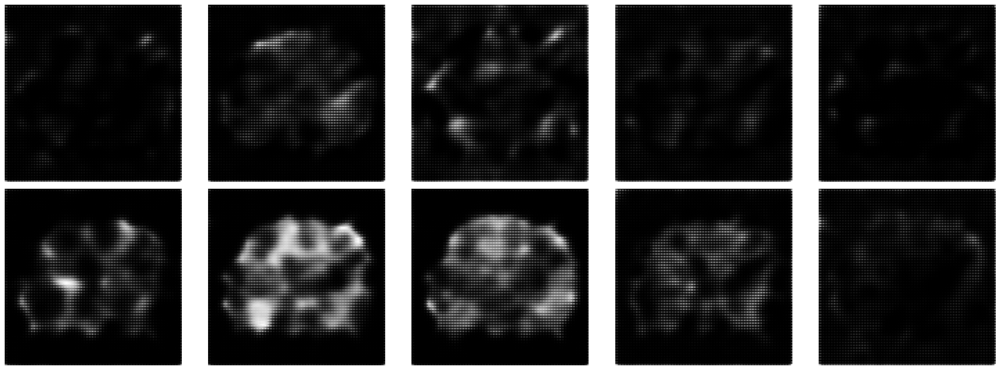

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 1/3750 [00:00<07:25,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 2/3750 [00:00<06:58,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


  0%|                                          | 3/3750 [00:00<12:58,  4.81it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<10:27,  5.97it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<09:02,  6.91it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 6/3750 [00:00<08:13,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 7/3750 [00:00<07:41,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 8/3750 [00:01<07:20,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:01<07:07,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<06:58,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 11/3750 [00:01<06:54,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 12/3750 [00:01<06:47,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 13/3750 [00:01<06:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 14/3750 [00:01<06:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 15/3750 [00:01<06:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 16/3750 [00:01<06:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 17/3750 [00:02<06:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 18/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▏                                        | 19/3750 [00:02<06:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 20/3750 [00:02<06:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 21/3750 [00:02<06:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 22/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 23/3750 [00:02<06:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 24/3750 [00:02<06:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 25/3750 [00:02<06:35,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 26/3750 [00:02<06:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 27/3750 [00:03<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 28/3750 [00:03<06:33,  9.46it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 29/3750 [00:03<06:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 30/3750 [00:03<06:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 31/3750 [00:03<06:37,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▎                                        | 32/3750 [00:03<06:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 33/3750 [00:03<06:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 35/3750 [00:03<06:36,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 36/3750 [00:04<06:40,  9.27it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 37/3750 [00:04<07:39,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 38/3750 [00:04<07:26,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 39/3750 [00:04<07:33,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 40/3750 [00:04<07:16,  8.49it/s]

1/1 [==============================] - 0s 11ms/step


  1%|▍                                        | 41/3750 [00:04<07:10,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 42/3750 [00:04<07:03,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 43/3750 [00:04<06:57,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 44/3750 [00:05<06:53,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 45/3750 [00:05<06:48,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 46/3750 [00:05<06:45,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 47/3750 [00:05<06:46,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 48/3750 [00:05<06:45,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<06:46,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 50/3750 [00:05<06:46,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 51/3750 [00:05<06:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 52/3750 [00:05<06:48,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▌                                        | 53/3750 [00:05<06:48,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 54/3750 [00:06<06:45,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 55/3750 [00:06<06:43,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 56/3750 [00:06<06:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:06<06:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 58/3750 [00:06<06:38,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 59/3750 [00:06<06:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 60/3750 [00:06<06:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 61/3750 [00:06<06:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:07<06:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 64/3750 [00:07<06:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 65/3750 [00:07<06:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 66/3750 [00:07<06:35,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 67/3750 [00:07<06:36,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▋                                        | 68/3750 [00:07<06:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 69/3750 [00:07<06:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 70/3750 [00:07<06:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:07<06:37,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 72/3750 [00:08<06:38,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 73/3750 [00:08<06:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 74/3750 [00:08<06:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 75/3750 [00:08<06:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 76/3750 [00:08<06:34,  9.31it/s]

1/1 [==============================] - 0s 13ms/step


  2%|▊                                        | 77/3750 [00:08<06:53,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 78/3750 [00:08<06:47,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 79/3750 [00:08<06:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▊                                        | 80/3750 [00:08<06:44,  9.07it/s]

1/1 [==============================] - 0s 11ms/step


  2%|▉                                        | 81/3750 [00:09<06:45,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 82/3750 [00:09<06:41,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 83/3750 [00:09<06:39,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 84/3750 [00:09<06:39,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 85/3750 [00:09<06:41,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 86/3750 [00:09<06:40,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


  2%|▉                                        | 87/3750 [00:09<06:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 88/3750 [00:09<06:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 89/3750 [00:09<06:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 90/3750 [00:09<06:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 91/3750 [00:10<06:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 92/3750 [00:10<06:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:10<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 94/3750 [00:10<06:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 95/3750 [00:10<06:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 96/3750 [00:10<06:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 97/3750 [00:10<06:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 98/3750 [00:10<06:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 99/3750 [00:10<06:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:11<06:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 101/3750 [00:11<07:10,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 102/3750 [00:11<06:56,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:11<06:48,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:11<06:46,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 105/3750 [00:11<06:40,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 106/3750 [00:11<06:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 107/3750 [00:11<06:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 108/3750 [00:11<06:30,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 109/3750 [00:12<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 110/3750 [00:12<06:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 111/3750 [00:12<06:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 112/3750 [00:12<07:23,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<07:07,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 114/3750 [00:12<06:59,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 115/3750 [00:12<06:49,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 116/3750 [00:12<06:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 117/3750 [00:12<06:37,  9.13it/s]

1/1 [==============================] - 0s 30ms/step


  3%|█▎                                      | 118/3750 [00:13<07:22,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:13<07:06,  8.51it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 120/3750 [00:13<06:55,  8.73it/s]

1/1 [==============================] - 0s 12ms/step


  3%|█▎                                      | 121/3750 [00:13<06:51,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 122/3750 [00:13<06:45,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 123/3750 [00:13<06:40,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 125/3750 [00:13<06:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 126/3750 [00:13<06:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 127/3750 [00:14<06:26,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 128/3750 [00:14<06:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 129/3750 [00:14<06:23,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 130/3750 [00:14<06:23,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 131/3750 [00:14<06:22,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 132/3750 [00:14<06:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 133/3750 [00:14<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 134/3750 [00:14<06:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 135/3750 [00:14<06:28,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▍                                      | 136/3750 [00:15<06:48,  8.85it/s]

1/1 [==============================] - 0s 12ms/step


  4%|█▍                                      | 137/3750 [00:15<06:49,  8.83it/s]

1/1 [==============================] - 0s 12ms/step


  4%|█▍                                      | 138/3750 [00:15<06:51,  8.77it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▍                                      | 139/3750 [00:15<06:54,  8.71it/s]

1/1 [==============================] - 0s 14ms/step


  4%|█▍                                      | 140/3750 [00:15<07:04,  8.51it/s]

1/1 [==============================] - 0s 21ms/step


  4%|█▌                                      | 141/3750 [00:15<07:24,  8.11it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 142/3750 [00:15<07:36,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 143/3750 [00:15<07:53,  7.62it/s]

1/1 [==============================] - 0s 11ms/step


  4%|█▌                                      | 144/3750 [00:16<07:31,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 145/3750 [00:16<07:12,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▌                                      | 146/3750 [00:16<07:00,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 147/3750 [00:16<06:48,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 148/3750 [00:16<06:44,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 149/3750 [00:16<06:36,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 150/3750 [00:16<06:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 151/3750 [00:16<06:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 152/3750 [00:16<06:29,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 153/3750 [00:17<06:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 154/3750 [00:17<06:49,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▋                                      | 155/3750 [00:17<07:05,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 156/3750 [00:17<06:52,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 157/3750 [00:17<06:43,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 158/3750 [00:17<06:55,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 159/3750 [00:17<06:44,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 160/3750 [00:17<06:38,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 161/3750 [00:17<06:33,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 162/3750 [00:18<06:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 163/3750 [00:18<06:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▋                                      | 164/3750 [00:18<06:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 165/3750 [00:18<06:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 166/3750 [00:18<06:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 167/3750 [00:18<06:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 168/3750 [00:18<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 169/3750 [00:18<06:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:18<06:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 171/3750 [00:18<06:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 172/3750 [00:19<06:27,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:19<06:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 174/3750 [00:19<06:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 175/3750 [00:19<06:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 176/3750 [00:19<06:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 177/3750 [00:19<06:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 178/3750 [00:19<06:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 179/3750 [00:19<06:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 180/3750 [00:19<06:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 181/3750 [00:20<06:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 182/3750 [00:20<06:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 183/3750 [00:20<06:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 184/3750 [00:20<06:18,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▉                                      | 185/3750 [00:20<06:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 186/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 187/3750 [00:20<06:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 188/3750 [00:20<06:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:20<06:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 190/3750 [00:21<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 191/3750 [00:21<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 192/3750 [00:21<06:56,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 193/3750 [00:21<06:46,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 194/3750 [00:21<06:37,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 195/3750 [00:21<06:29,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:21<06:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:21<06:24,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 198/3750 [00:21<06:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 199/3750 [00:22<06:21,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 200/3750 [00:22<06:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 201/3750 [00:22<06:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 202/3750 [00:22<06:15,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 203/3750 [00:22<06:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 204/3750 [00:22<06:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 205/3750 [00:22<06:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 206/3750 [00:22<06:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 207/3750 [00:22<06:17,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▏                                     | 208/3750 [00:22<06:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:23<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 210/3750 [00:23<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 211/3750 [00:23<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:23<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 213/3750 [00:23<06:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 214/3750 [00:23<06:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 215/3750 [00:23<06:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 216/3750 [00:23<06:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 217/3750 [00:23<06:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 218/3750 [00:24<06:21,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 219/3750 [00:24<06:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 220/3750 [00:24<06:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 221/3750 [00:24<06:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 222/3750 [00:24<06:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 223/3750 [00:24<06:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 224/3750 [00:24<06:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 225/3750 [00:24<06:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 226/3750 [00:24<06:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 227/3750 [00:24<06:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 228/3750 [00:25<06:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 229/3750 [00:25<06:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 230/3750 [00:25<06:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 231/3750 [00:25<06:12,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 232/3750 [00:25<06:11,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 233/3750 [00:25<06:10,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 234/3750 [00:25<06:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:25<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 236/3750 [00:25<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:26<06:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 238/3750 [00:26<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:26<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:26<06:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 241/3750 [00:26<06:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:26<06:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 243/3750 [00:26<06:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 244/3750 [00:26<06:12,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▌                                     | 245/3750 [00:26<06:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:27<06:10,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 247/3750 [00:27<06:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 248/3750 [00:27<06:08,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 249/3750 [00:27<06:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 250/3750 [00:27<06:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 251/3750 [00:27<06:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:27<06:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 253/3750 [00:27<06:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 254/3750 [00:27<06:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 255/3750 [00:27<06:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 256/3750 [00:28<06:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:28<06:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 258/3750 [00:28<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 259/3750 [00:28<06:10,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▊                                     | 260/3750 [00:28<06:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 261/3750 [00:28<06:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 262/3750 [00:28<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 263/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:28<06:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 265/3750 [00:29<06:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 266/3750 [00:29<06:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:29<06:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:29<06:05,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 269/3750 [00:29<06:07,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 270/3750 [00:29<06:07,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 271/3750 [00:29<06:17,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:29<06:14,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 273/3750 [00:29<06:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 274/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 275/3750 [00:30<06:09,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 276/3750 [00:30<06:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 277/3750 [00:30<06:22,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 278/3750 [00:30<06:35,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:30<06:31,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 280/3750 [00:30<06:27,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▉                                     | 281/3750 [00:30<06:29,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███                                     | 282/3750 [00:30<06:28,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:30<06:22,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 284/3750 [00:31<06:17,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:31<06:28,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:31<06:28,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:31<06:22,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:31<06:18,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 289/3750 [00:31<06:21,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 290/3750 [00:31<06:19,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 291/3750 [00:31<06:14,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 292/3750 [00:31<06:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 293/3750 [00:32<06:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 294/3750 [00:32<06:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 295/3750 [00:32<06:24,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 296/3750 [00:32<06:42,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 297/3750 [00:32<06:42,  8.59it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:32<06:32,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 299/3750 [00:32<06:30,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 300/3750 [00:32<06:35,  8.72it/s]

1/1 [==============================] - 0s 13ms/step


  8%|███▏                                    | 301/3750 [00:33<06:48,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▏                                    | 302/3750 [00:33<06:42,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 303/3750 [00:33<06:31,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 304/3750 [00:33<06:26,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 305/3750 [00:33<06:23,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 306/3750 [00:33<06:20,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:33<06:19,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 308/3750 [00:33<06:20,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 309/3750 [00:33<06:25,  8.94it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 310/3750 [00:34<06:38,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 311/3750 [00:34<06:44,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 312/3750 [00:34<06:36,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 313/3750 [00:34<06:29,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:34<06:24,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 315/3750 [00:34<06:28,  8.83it/s]

1/1 [==============================] - 0s 11ms/step


  8%|███▎                                    | 316/3750 [00:34<06:28,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 317/3750 [00:34<06:27,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 318/3750 [00:34<06:21,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 319/3750 [00:35<06:15,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 320/3750 [00:35<06:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 321/3750 [00:35<06:15,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 322/3750 [00:35<06:15,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 323/3750 [00:35<06:17,  9.08it/s]

1/1 [==============================] - 0s 12ms/step


  9%|███▍                                    | 324/3750 [00:35<06:23,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▍                                    | 325/3750 [00:35<06:24,  8.90it/s]

1/1 [==============================] - 0s 15ms/step


  9%|███▍                                    | 326/3750 [00:35<06:31,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 327/3750 [00:35<06:26,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▍                                    | 328/3750 [00:36<06:26,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:36<06:33,  8.70it/s]

1/1 [==============================] - 0s 12ms/step


  9%|███▌                                    | 330/3750 [00:36<06:56,  8.21it/s]

1/1 [==============================] - 0s 12ms/step


  9%|███▌                                    | 331/3750 [00:36<07:08,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 332/3750 [00:36<07:01,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▌                                    | 333/3750 [00:36<06:53,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 334/3750 [00:36<06:48,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 335/3750 [00:36<06:40,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 336/3750 [00:36<06:29,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 337/3750 [00:37<06:21,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


  9%|███▌                                    | 338/3750 [00:37<06:16,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 339/3750 [00:37<06:12,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 340/3750 [00:37<06:13,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 341/3750 [00:37<06:15,  9.08it/s]

1/1 [==============================] - 0s 18ms/step


  9%|███▋                                    | 342/3750 [00:37<06:53,  8.25it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 343/3750 [00:37<06:51,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 344/3750 [00:37<06:43,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 345/3750 [00:38<06:46,  8.38it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 346/3750 [00:38<06:45,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▋                                    | 347/3750 [00:38<06:38,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:38<06:27,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 349/3750 [00:38<06:18,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 350/3750 [00:38<06:47,  8.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 351/3750 [00:38<06:38,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


  9%|███▊                                    | 352/3750 [00:38<06:29,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 353/3750 [00:38<06:20,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 354/3750 [00:39<06:16,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 355/3750 [00:39<06:11,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 356/3750 [00:39<06:08,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 357/3750 [00:39<06:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 358/3750 [00:39<06:04,  9.30it/s]

1/1 [==============================] - 0s 12ms/step


 10%|███▊                                    | 359/3750 [00:39<06:28,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▊                                    | 360/3750 [00:39<06:27,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 361/3750 [00:39<06:22,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 362/3750 [00:39<06:18,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 363/3750 [00:40<06:19,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 364/3750 [00:40<06:22,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 365/3750 [00:40<06:19,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 366/3750 [00:40<06:16,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 367/3750 [00:40<06:15,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:40<06:15,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 369/3750 [00:40<06:15,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 370/3750 [00:40<06:12,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 371/3750 [00:40<06:10,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 372/3750 [00:41<06:08,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 10%|███▉                                    | 373/3750 [00:41<06:16,  8.98it/s]

1/1 [==============================] - 0s 12ms/step


 10%|███▉                                    | 374/3750 [00:41<06:34,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 375/3750 [00:41<06:39,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 376/3750 [00:41<06:43,  8.36it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████                                    | 377/3750 [00:41<06:44,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████                                    | 378/3750 [00:41<06:51,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 379/3750 [00:41<06:37,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 380/3750 [00:41<06:25,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 381/3750 [00:42<06:16,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 382/3750 [00:42<06:12,  9.03it/s]

1/1 [==============================] - 0s 11ms/step


 10%|████                                    | 383/3750 [00:42<06:15,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 384/3750 [00:42<06:13,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 385/3750 [00:42<06:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 386/3750 [00:42<06:08,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████▏                                   | 387/3750 [00:42<06:07,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 388/3750 [00:42<06:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 389/3750 [00:42<06:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 390/3750 [00:43<06:05,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:43<06:04,  9.22it/s]

1/1 [==============================] - 0s 12ms/step


 10%|████▏                                   | 392/3750 [00:43<06:14,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 10%|████▏                                   | 393/3750 [00:43<06:10,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 394/3750 [00:43<06:06,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 395/3750 [00:43<06:10,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▏                                   | 396/3750 [00:43<06:20,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 397/3750 [00:43<06:16,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 398/3750 [00:43<06:10,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 399/3750 [00:44<06:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 400/3750 [00:44<06:02,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 401/3750 [00:44<06:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 402/3750 [00:44<06:09,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 403/3750 [00:44<06:18,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 404/3750 [00:44<06:24,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 405/3750 [00:44<06:16,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 406/3750 [00:44<06:10,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 407/3750 [00:44<06:04,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 408/3750 [00:45<06:01,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:45<05:57,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▎                                   | 410/3750 [00:45<06:04,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 411/3750 [00:45<06:06,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 412/3750 [00:45<06:14,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 413/3750 [00:45<06:15,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 414/3750 [00:45<06:10,  9.00it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▍                                   | 415/3750 [00:45<06:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 416/3750 [00:45<06:05,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 417/3750 [00:46<06:02,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 418/3750 [00:46<06:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 419/3750 [00:46<06:03,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▍                                   | 420/3750 [00:46<06:06,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 421/3750 [00:46<06:03,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:46<06:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 423/3750 [00:46<06:03,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 424/3750 [00:46<06:11,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 425/3750 [00:46<06:07,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:47<06:02,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 427/3750 [00:47<05:59,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▌                                   | 428/3750 [00:47<05:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 429/3750 [00:47<05:56,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 11%|████▌                                   | 430/3750 [00:47<06:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:47<06:02,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 12%|████▌                                   | 432/3750 [00:47<06:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 433/3750 [00:47<05:57,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 434/3750 [00:47<05:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 435/3750 [00:48<05:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 436/3750 [00:48<05:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:48<05:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 438/3750 [00:48<05:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 439/3750 [00:48<05:51,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 440/3750 [00:48<05:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 441/3750 [00:48<05:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 442/3750 [00:48<05:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 443/3750 [00:48<05:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 444/3750 [00:48<05:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 445/3750 [00:49<05:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 446/3750 [00:49<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 447/3750 [00:49<05:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 448/3750 [00:49<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:49<05:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 450/3750 [00:49<05:49,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 451/3750 [00:49<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 452/3750 [00:49<05:48,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 453/3750 [00:49<05:48,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 454/3750 [00:50<05:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 455/3750 [00:50<05:47,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 456/3750 [00:50<05:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 457/3750 [00:50<05:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 458/3750 [00:50<05:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 459/3750 [00:50<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:50<05:47,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:50<05:47,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 462/3750 [00:50<05:46,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:50<05:45,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 464/3750 [00:51<05:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 465/3750 [00:51<05:48,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 466/3750 [00:51<05:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 467/3750 [00:51<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 468/3750 [00:51<05:47,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:51<05:46,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 470/3750 [00:51<05:45,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:51<05:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 472/3750 [00:51<05:45,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 473/3750 [00:52<05:45,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 474/3750 [00:52<05:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 475/3750 [00:52<05:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 476/3750 [00:52<05:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 477/3750 [00:52<05:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:52<05:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:52<05:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 480/3750 [00:52<05:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 481/3750 [00:52<05:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 482/3750 [00:52<05:43,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 483/3750 [00:53<05:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 484/3750 [00:53<05:44,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 485/3750 [00:53<05:44,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 486/3750 [00:53<05:44,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 487/3750 [00:53<05:43,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 488/3750 [00:53<05:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:53<05:42,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 490/3750 [00:53<05:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 491/3750 [00:53<05:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 492/3750 [00:54<05:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 493/3750 [00:54<05:44,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 494/3750 [00:54<05:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 495/3750 [00:54<05:44,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 496/3750 [00:54<05:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 497/3750 [00:54<05:44,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 498/3750 [00:54<05:43,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 499/3750 [00:54<05:42,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 500/3750 [00:54<05:41,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 501/3750 [00:54<05:41,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 502/3750 [00:55<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:55<05:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 504/3750 [00:55<05:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 505/3750 [00:55<05:42,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▍                                  | 506/3750 [00:55<05:41,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 507/3750 [00:55<05:41,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 508/3750 [00:55<05:40,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 509/3750 [00:55<05:40,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▍                                  | 510/3750 [00:55<05:40,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 511/3750 [00:56<05:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 512/3750 [00:56<05:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 513/3750 [00:56<05:42,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 514/3750 [00:56<05:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:56<05:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 516/3750 [00:56<05:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 517/3750 [00:56<05:42,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 518/3750 [00:56<05:41,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 519/3750 [00:56<05:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 520/3750 [00:57<05:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 521/3750 [00:57<05:42,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [00:57<05:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:57<05:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 524/3750 [00:57<05:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 525/3750 [00:57<05:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 526/3750 [00:57<05:40,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 527/3750 [00:57<05:40,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 528/3750 [00:57<05:41,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 529/3750 [00:57<05:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 530/3750 [00:58<05:40,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▋                                  | 531/3750 [00:58<05:40,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 532/3750 [00:58<05:39,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [00:58<05:40,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 534/3750 [00:58<05:40,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 535/3750 [00:58<05:39,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 536/3750 [00:58<05:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 537/3750 [00:58<05:39,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 538/3750 [00:58<05:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 539/3750 [00:59<05:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [00:59<05:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 541/3750 [00:59<05:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 542/3750 [00:59<05:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 543/3750 [00:59<05:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 544/3750 [00:59<05:40,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 545/3750 [00:59<05:39,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 546/3750 [00:59<05:38,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [00:59<05:38,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 548/3750 [00:59<05:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 549/3750 [01:00<05:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 550/3750 [01:00<05:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 551/3750 [01:00<05:39,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|█████▉                                  | 552/3750 [01:00<05:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 553/3750 [01:00<05:38,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 554/3750 [01:00<05:38,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 555/3750 [01:00<05:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 556/3750 [01:00<05:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 557/3750 [01:00<05:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 558/3750 [01:01<05:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 559/3750 [01:01<05:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 560/3750 [01:01<05:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:01<05:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 562/3750 [01:01<05:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 563/3750 [01:01<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 564/3750 [01:01<05:37,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 565/3750 [01:01<05:37,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 566/3750 [01:01<05:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████                                  | 567/3750 [01:01<05:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 568/3750 [01:02<05:37,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 569/3750 [01:02<05:36,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:02<05:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 571/3750 [01:02<05:36,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 572/3750 [01:02<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 573/3750 [01:02<05:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 574/3750 [01:02<05:34,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 575/3750 [01:02<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 576/3750 [01:02<05:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 577/3750 [01:03<05:35,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 578/3750 [01:03<05:34,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████▏                                 | 579/3750 [01:03<05:34,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 580/3750 [01:03<05:32,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 15%|██████▏                                 | 581/3750 [01:03<05:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 582/3750 [01:03<05:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:03<05:33,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 584/3750 [01:03<05:35,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 585/3750 [01:03<05:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 586/3750 [01:03<05:34,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 587/3750 [01:04<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 588/3750 [01:04<05:34,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 589/3750 [01:04<05:33,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 590/3750 [01:04<05:33,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 591/3750 [01:04<05:34,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 592/3750 [01:04<05:34,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▎                                 | 593/3750 [01:04<05:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 594/3750 [01:04<05:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 595/3750 [01:04<05:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 596/3750 [01:05<05:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:05<05:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:05<05:32,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 599/3750 [01:05<05:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 600/3750 [01:05<05:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 601/3750 [01:05<05:32,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 602/3750 [01:05<05:33,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 603/3750 [01:05<05:33,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 604/3750 [01:05<05:31,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▍                                 | 605/3750 [01:06<05:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 606/3750 [01:06<05:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 607/3750 [01:06<05:30,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:06<05:29,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 609/3750 [01:06<05:29,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 610/3750 [01:06<05:29,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 611/3750 [01:06<05:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 612/3750 [01:06<05:30,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 613/3750 [01:06<05:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 615/3750 [01:07<05:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:07<05:29,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:07<05:31,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:07<05:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:07<05:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 620/3750 [01:07<05:32,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▌                                 | 621/3750 [01:07<05:31,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 622/3750 [01:07<05:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 623/3750 [01:07<05:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 624/3750 [01:08<05:28,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 625/3750 [01:08<05:28,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 626/3750 [01:08<05:28,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 627/3750 [01:08<05:27,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▋                                 | 628/3750 [01:08<05:27,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▋                                 | 629/3750 [01:08<05:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:08<05:38,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 631/3750 [01:08<05:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 632/3750 [01:08<05:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 633/3750 [01:08<05:32,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 634/3750 [01:09<05:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 635/3750 [01:09<05:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 636/3750 [01:09<05:29,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 637/3750 [01:09<05:28,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 638/3750 [01:09<05:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 639/3750 [01:09<05:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 640/3750 [01:09<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 641/3750 [01:09<05:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 642/3750 [01:09<05:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:10<05:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 644/3750 [01:10<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:10<05:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 646/3750 [01:10<05:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 647/3750 [01:10<05:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 648/3750 [01:10<05:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:10<05:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 650/3750 [01:10<05:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 651/3750 [01:10<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:10<05:28,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:11<05:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 654/3750 [01:11<05:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 655/3750 [01:11<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 656/3750 [01:11<05:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 657/3750 [01:11<05:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 658/3750 [01:11<05:27,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 659/3750 [01:11<05:26,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 660/3750 [01:11<05:25,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 661/3750 [01:11<05:25,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 662/3750 [01:12<05:27,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 663/3750 [01:12<05:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:12<05:25,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 665/3750 [01:12<05:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 666/3750 [01:12<05:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 667/3750 [01:12<05:24,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 668/3750 [01:12<05:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 669/3750 [01:12<05:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 670/3750 [01:12<05:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:13<05:27,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 672/3750 [01:13<05:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 673/3750 [01:13<05:26,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 674/3750 [01:13<05:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 675/3750 [01:13<05:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:13<05:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 677/3750 [01:13<05:25,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 678/3750 [01:13<05:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 679/3750 [01:13<05:24,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 680/3750 [01:13<05:23,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 681/3750 [01:14<05:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 682/3750 [01:14<05:22,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:14<05:21,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 684/3750 [01:14<05:23,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 685/3750 [01:14<05:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 686/3750 [01:14<05:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 687/3750 [01:14<05:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 688/3750 [01:14<05:23,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 689/3750 [01:14<05:22,  9.49it/s]

1/1 [==============================] - 0s 24ms/step


 18%|███████▎                                | 690/3750 [01:15<05:50,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▎                                | 691/3750 [01:15<05:51,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▍                                | 692/3750 [01:15<05:49,  8.76it/s]

1/1 [==============================] - 0s 13ms/step


 18%|███████▍                                | 693/3750 [01:15<06:02,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 694/3750 [01:15<06:26,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 695/3750 [01:15<06:14,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 696/3750 [01:15<06:11,  8.23it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 697/3750 [01:15<06:14,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▍                                | 698/3750 [01:16<06:14,  8.15it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:16<06:00,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:16<05:49,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:16<05:40,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:16<05:36,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 703/3750 [01:16<05:31,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:16<05:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:16<05:26,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 706/3750 [01:16<05:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 707/3750 [01:16<05:26,  9.32it/s]

1/1 [==============================] - 0s 11ms/step


 19%|███████▌                                | 708/3750 [01:17<05:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:17<05:32,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 710/3750 [01:17<05:43,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 711/3750 [01:17<05:37,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 712/3750 [01:17<05:34,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 713/3750 [01:17<05:31,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 714/3750 [01:17<05:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 715/3750 [01:17<05:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 716/3750 [01:17<05:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 717/3750 [01:18<05:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 718/3750 [01:18<05:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:18<05:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 720/3750 [01:18<05:19,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 721/3750 [01:18<05:21,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 722/3750 [01:18<05:20,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 723/3750 [01:18<05:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 724/3750 [01:18<05:18,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 725/3750 [01:18<05:18,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 726/3750 [01:19<05:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 727/3750 [01:19<05:18,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:19<05:18,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▊                                | 729/3750 [01:19<05:18,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▊                                | 730/3750 [01:19<05:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 731/3750 [01:19<05:19,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 732/3750 [01:19<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 733/3750 [01:19<05:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 734/3750 [01:19<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 735/3750 [01:19<05:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:20<05:19,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▊                                | 737/3750 [01:20<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:20<05:18,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 739/3750 [01:20<05:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:20<05:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:20<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:20<05:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:20<05:18,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 744/3750 [01:20<05:17,  9.46it/s]

1/1 [==============================] - 0s 11ms/step


 20%|███████▉                                | 745/3750 [01:21<05:21,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▉                                | 746/3750 [01:21<05:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 747/3750 [01:21<05:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:21<05:21,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 749/3750 [01:21<05:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 750/3750 [01:21<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 751/3750 [01:21<05:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 752/3750 [01:21<05:16,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████                                | 753/3750 [01:21<05:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:21<05:29,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:22<05:33,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:22<05:28,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 757/3750 [01:22<05:27,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 758/3750 [01:22<05:25,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 759/3750 [01:22<05:33,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 760/3750 [01:22<05:28,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:22<05:23,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:22<05:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 763/3750 [01:22<05:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 764/3750 [01:23<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 765/3750 [01:23<05:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:23<05:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 767/3750 [01:23<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 768/3750 [01:23<05:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 769/3750 [01:23<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 770/3750 [01:23<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▏                               | 771/3750 [01:23<05:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 772/3750 [01:23<05:13,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 773/3750 [01:24<05:14,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 774/3750 [01:24<05:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 775/3750 [01:24<05:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 776/3750 [01:24<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 777/3750 [01:24<05:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 778/3750 [01:24<05:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 779/3750 [01:24<05:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:24<05:15,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 781/3750 [01:24<05:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 782/3750 [01:24<05:13,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 783/3750 [01:25<05:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 784/3750 [01:25<05:11,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:25<05:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 786/3750 [01:25<05:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 787/3750 [01:25<05:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 788/3750 [01:25<05:12,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 789/3750 [01:25<05:12,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 790/3750 [01:25<05:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 791/3750 [01:25<05:12,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▍                               | 792/3750 [01:26<05:11,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 793/3750 [01:26<05:10,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 794/3750 [01:26<05:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 795/3750 [01:26<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 796/3750 [01:26<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:26<05:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 798/3750 [01:26<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 799/3750 [01:26<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 800/3750 [01:26<05:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 801/3750 [01:26<05:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:27<05:11,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:27<05:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 804/3750 [01:27<05:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 805/3750 [01:27<05:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 806/3750 [01:27<05:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 807/3750 [01:27<05:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▌                               | 808/3750 [01:27<05:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 809/3750 [01:27<05:09,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 810/3750 [01:27<05:09,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 811/3750 [01:28<05:08,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 812/3750 [01:28<05:10,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 813/3750 [01:28<05:10,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 814/3750 [01:28<05:10,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 815/3750 [01:28<05:10,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 816/3750 [01:28<05:09,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▋                               | 817/3750 [01:28<05:09,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 818/3750 [01:28<05:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 819/3750 [01:28<05:08,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 820/3750 [01:28<05:08,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 821/3750 [01:29<05:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:29<05:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 823/3750 [01:29<05:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 824/3750 [01:29<05:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 825/3750 [01:29<05:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 826/3750 [01:29<05:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 827/3750 [01:29<05:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 828/3750 [01:29<05:11,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▊                               | 829/3750 [01:29<05:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 830/3750 [01:30<05:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 831/3750 [01:30<05:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 832/3750 [01:30<05:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 833/3750 [01:30<05:08,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 834/3750 [01:30<05:07,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 835/3750 [01:30<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 836/3750 [01:30<05:06,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 837/3750 [01:30<05:06,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 838/3750 [01:30<05:06,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 839/3750 [01:31<05:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:31<05:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 841/3750 [01:31<05:07,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 842/3750 [01:31<05:07,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 843/3750 [01:31<05:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 844/3750 [01:31<05:05,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 845/3750 [01:31<05:04,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 846/3750 [01:31<05:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:31<05:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 848/3750 [01:31<05:06,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 849/3750 [01:32<05:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:32<05:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 851/3750 [01:32<05:07,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 852/3750 [01:32<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 853/3750 [01:32<05:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████                               | 854/3750 [01:32<05:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 855/3750 [01:32<05:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 856/3750 [01:32<05:05,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 857/3750 [01:32<05:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:33<05:06,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 859/3750 [01:33<05:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 860/3750 [01:33<05:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 861/3750 [01:33<05:04,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 862/3750 [01:33<05:04,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:33<05:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 864/3750 [01:33<05:02,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 865/3750 [01:33<05:02,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▏                              | 866/3750 [01:33<05:02,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 867/3750 [01:33<05:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 868/3750 [01:34<05:04,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 869/3750 [01:34<05:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 870/3750 [01:34<05:03,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 871/3750 [01:34<05:02,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 872/3750 [01:34<05:02,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▎                              | 873/3750 [01:34<05:02,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 874/3750 [01:34<05:03,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 875/3750 [01:34<05:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 876/3750 [01:34<05:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 877/3750 [01:35<05:17,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 878/3750 [01:35<05:12,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 879/3750 [01:35<05:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 880/3750 [01:35<05:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 881/3750 [01:35<05:05,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 882/3750 [01:35<05:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 883/3750 [01:35<05:03,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 884/3750 [01:35<05:03,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▍                              | 885/3750 [01:35<05:04,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 886/3750 [01:35<05:03,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 887/3750 [01:36<05:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 888/3750 [01:36<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 889/3750 [01:36<05:02,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 890/3750 [01:36<05:02,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 891/3750 [01:36<05:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 892/3750 [01:36<05:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 893/3750 [01:36<05:01,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 894/3750 [01:36<05:01,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 895/3750 [01:36<05:03,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 896/3750 [01:37<05:02,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 897/3750 [01:37<05:02,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 898/3750 [01:37<05:01,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 899/3750 [01:37<05:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 900/3750 [01:37<04:59,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 901/3750 [01:37<04:58,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 902/3750 [01:37<04:58,  9.54it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 903/3750 [01:37<04:59,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 904/3750 [01:37<05:00,  9.47it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 905/3750 [01:37<05:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 906/3750 [01:38<05:00,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 907/3750 [01:38<04:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 908/3750 [01:38<04:59,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 909/3750 [01:38<04:58,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 910/3750 [01:38<04:59,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 911/3750 [01:38<04:58,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▋                              | 912/3750 [01:38<04:57,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 913/3750 [01:38<05:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 914/3750 [01:38<04:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 915/3750 [01:39<04:59,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 916/3750 [01:39<04:58,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 917/3750 [01:39<04:57,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▊                              | 918/3750 [01:39<04:58,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 919/3750 [01:39<04:58,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 920/3750 [01:39<04:57,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 921/3750 [01:39<04:58,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▊                              | 922/3750 [01:39<04:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 923/3750 [01:39<04:59,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 924/3750 [01:39<04:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 925/3750 [01:40<04:58,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 926/3750 [01:40<04:57,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 927/3750 [01:40<04:57,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 928/3750 [01:40<04:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:40<04:56,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 930/3750 [01:40<04:57,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:40<04:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 932/3750 [01:40<04:57,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:40<04:56,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 934/3750 [01:41<04:55,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 935/3750 [01:41<04:55,  9.53it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▉                              | 936/3750 [01:41<04:56,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 937/3750 [01:41<04:54,  9.54it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 938/3750 [01:41<04:54,  9.55it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 939/3750 [01:41<04:55,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 940/3750 [01:41<04:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 941/3750 [01:41<04:59,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 942/3750 [01:41<04:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 943/3750 [01:41<04:56,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 944/3750 [01:42<04:54,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 945/3750 [01:42<04:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 946/3750 [01:42<04:54,  9.53it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 947/3750 [01:42<04:54,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████                              | 948/3750 [01:42<04:54,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:42<04:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 950/3750 [01:42<04:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 951/3750 [01:42<04:55,  9.49it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████▏                             | 952/3750 [01:42<04:55,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 953/3750 [01:43<04:54,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 954/3750 [01:43<04:54,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 955/3750 [01:43<04:53,  9.52it/s]

1/1 [==============================] - 0s 8ms/step


 25%|██████████▏                             | 956/3750 [01:43<04:53,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▏                             | 957/3750 [01:43<04:54,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 958/3750 [01:43<04:55,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 959/3750 [01:43<04:55,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 960/3750 [01:43<04:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 961/3750 [01:43<04:54,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 962/3750 [01:43<04:54,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 963/3750 [01:44<04:53,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 964/3750 [01:44<04:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 965/3750 [01:44<04:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 966/3750 [01:44<04:52,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 967/3750 [01:44<04:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 968/3750 [01:44<04:54,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 969/3750 [01:44<04:52,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 970/3750 [01:44<04:53,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 971/3750 [01:44<04:53,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▎                             | 972/3750 [01:45<04:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:45<04:52,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 974/3750 [01:45<05:04,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 975/3750 [01:45<05:01,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 976/3750 [01:45<04:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 977/3750 [01:45<04:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:45<04:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 979/3750 [01:45<04:56,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 980/3750 [01:45<04:58,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 981/3750 [01:46<04:56,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▍                             | 982/3750 [01:46<04:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 983/3750 [01:46<04:52,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 984/3750 [01:46<04:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 985/3750 [01:46<04:51,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 986/3750 [01:46<04:53,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 987/3750 [01:46<04:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 988/3750 [01:46<04:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 989/3750 [01:46<04:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 990/3750 [01:46<04:52,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 991/3750 [01:47<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 992/3750 [01:47<04:50,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 993/3750 [01:47<04:51,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 994/3750 [01:47<04:55,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                             | 995/3750 [01:47<05:02,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 996/3750 [01:47<05:06,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▋                             | 997/3750 [01:47<05:10,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 998/3750 [01:47<05:18,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 999/3750 [01:47<05:20,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1000/3750 [01:48<05:33,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1001/3750 [01:48<05:25,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:48<05:16,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1003/3750 [01:48<05:09,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:48<05:06,  8.95it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▍                            | 1005/3750 [01:48<05:01,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1006/3750 [01:48<04:59,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:48<04:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1008/3750 [01:48<04:57,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1009/3750 [01:49<04:57,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1010/3750 [01:49<04:55,  9.26it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██████████▌                            | 1011/3750 [01:49<05:08,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1012/3750 [01:49<05:12,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1013/3750 [01:49<05:05,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1014/3750 [01:49<05:02,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:49<04:58,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:49<04:56,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1017/3750 [01:49<04:54,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1018/3750 [01:50<04:54,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1019/3750 [01:50<04:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1020/3750 [01:50<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1021/3750 [01:50<04:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1022/3750 [01:50<04:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1023/3750 [01:50<04:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1024/3750 [01:50<04:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1025/3750 [01:50<04:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1026/3750 [01:50<04:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1027/3750 [01:51<04:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1028/3750 [01:51<04:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1029/3750 [01:51<04:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1030/3750 [01:51<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1031/3750 [01:51<04:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1032/3750 [01:51<04:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1033/3750 [01:51<04:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1034/3750 [01:51<04:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1035/3750 [01:51<04:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1036/3750 [01:52<04:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1037/3750 [01:52<04:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▊                            | 1038/3750 [01:52<05:33,  8.13it/s]

1/1 [==============================] - 0s 12ms/step


 28%|██████████▊                            | 1039/3750 [01:52<05:26,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1040/3750 [01:52<05:16,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▊                            | 1041/3750 [01:52<05:12,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:52<05:10,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1043/3750 [01:52<05:03,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1044/3750 [01:52<04:59,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:53<04:55,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1046/3750 [01:53<04:53,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1047/3750 [01:53<04:52,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1048/3750 [01:53<04:51,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1049/3750 [01:53<04:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1050/3750 [01:53<04:49,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1051/3750 [01:53<04:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1052/3750 [01:53<04:49,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1053/3750 [01:53<04:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1054/3750 [01:54<04:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1055/3750 [01:54<04:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1056/3750 [01:54<04:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1057/3750 [01:54<04:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1058/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1059/3750 [01:54<04:45,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1060/3750 [01:54<04:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:54<04:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:54<04:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1063/3750 [01:54<04:45,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1064/3750 [01:55<04:43,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1065/3750 [01:55<04:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1066/3750 [01:55<04:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1067/3750 [01:55<04:43,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1068/3750 [01:55<04:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:55<04:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▏                           | 1070/3750 [01:55<04:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:55<04:45,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▏                           | 1072/3750 [01:56<07:38,  5.85it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1073/3750 [01:56<06:45,  6.60it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1074/3750 [01:56<06:09,  7.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1075/3750 [01:56<05:43,  7.78it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1076/3750 [01:56<05:26,  8.20it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1077/3750 [01:56<05:14,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1078/3750 [01:56<05:05,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1079/3750 [01:56<05:00,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1080/3750 [01:56<04:57,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1081/3750 [01:57<04:54,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1082/3750 [01:57<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1083/3750 [01:57<04:48,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1084/3750 [01:57<04:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1085/3750 [01:57<04:45,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [01:57<04:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1087/3750 [01:57<04:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [01:57<04:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1089/3750 [01:57<04:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1090/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1091/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:58<04:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:58<04:44,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1094/3750 [01:58<04:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1095/3750 [01:58<04:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1096/3750 [01:58<04:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1097/3750 [01:58<04:45,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1098/3750 [01:58<04:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [01:59<04:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [01:59<04:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1101/3750 [01:59<04:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1102/3750 [01:59<04:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1103/3750 [01:59<04:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [01:59<04:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [01:59<04:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▌                           | 1106/3750 [01:59<04:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1107/3750 [01:59<04:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [01:59<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1109/3750 [02:00<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [02:00<04:43,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1111/3750 [02:00<04:43,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1112/3750 [02:00<04:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1113/3750 [02:00<04:43,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1114/3750 [02:00<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1115/3750 [02:00<04:42,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1116/3750 [02:00<04:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [02:00<04:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1118/3750 [02:01<04:40,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1119/3750 [02:01<04:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1120/3750 [02:01<04:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1121/3750 [02:01<04:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1122/3750 [02:01<04:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1123/3750 [02:01<04:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1124/3750 [02:01<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:01<04:41,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1126/3750 [02:01<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1127/3750 [02:02<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1128/3750 [02:02<04:40,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1129/3750 [02:02<04:40,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1130/3750 [02:02<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1131/3750 [02:02<04:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1132/3750 [02:02<04:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1133/3750 [02:02<04:39,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1134/3750 [02:02<04:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1135/3750 [02:02<04:42,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1136/3750 [02:02<04:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1137/3750 [02:03<04:41,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1138/3750 [02:03<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:03<04:40,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▊                           | 1140/3750 [02:03<04:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1141/3750 [02:03<04:43,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1142/3750 [02:03<04:42,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1143/3750 [02:03<04:41,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1144/3750 [02:03<04:42,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1145/3750 [02:03<04:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:04<04:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1147/3750 [02:04<04:40,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1148/3750 [02:04<04:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1149/3750 [02:04<04:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1150/3750 [02:04<04:39,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1151/3750 [02:04<04:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1152/3750 [02:04<04:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1153/3750 [02:04<04:40,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1154/3750 [02:04<04:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1155/3750 [02:05<04:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1156/3750 [02:05<04:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1157/3750 [02:05<04:38,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1158/3750 [02:05<04:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1159/3750 [02:05<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1160/3750 [02:05<04:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1161/3750 [02:05<04:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1162/3750 [02:05<04:36,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████                           | 1163/3750 [02:05<04:39,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████                           | 1164/3750 [02:05<04:39,  9.26it/s]

1/1 [==============================] - 0s 12ms/step


 31%|████████████                           | 1165/3750 [02:06<04:48,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1166/3750 [02:06<04:46,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1167/3750 [02:06<04:43,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1168/3750 [02:06<04:48,  8.95it/s]

1/1 [==============================] - 0s 19ms/step


 31%|████████████▏                          | 1169/3750 [02:06<05:39,  7.60it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1170/3750 [02:06<05:23,  7.97it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1171/3750 [02:06<05:09,  8.32it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1172/3750 [02:06<05:00,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1173/3750 [02:07<04:54,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1174/3750 [02:07<04:49,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1175/3750 [02:07<04:46,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 31%|████████████▏                          | 1176/3750 [02:07<04:47,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1177/3750 [02:07<04:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1178/3750 [02:07<04:41,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1179/3750 [02:07<04:59,  8.60it/s]

1/1 [==============================] - 0s 12ms/step


 31%|████████████▎                          | 1180/3750 [02:07<05:47,  7.40it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1181/3750 [02:08<05:27,  7.83it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1182/3750 [02:08<05:13,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1183/3750 [02:08<05:03,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1184/3750 [02:08<04:57,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:08<04:50,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1186/3750 [02:08<04:45,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1187/3750 [02:08<04:41,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▎                          | 1188/3750 [02:08<04:38,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1189/3750 [02:08<04:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1190/3750 [02:08<04:35,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1191/3750 [02:09<04:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1192/3750 [02:09<04:34,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1193/3750 [02:09<04:35,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1194/3750 [02:09<04:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1195/3750 [02:09<04:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1196/3750 [02:09<04:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1197/3750 [02:09<04:33,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1198/3750 [02:09<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1199/3750 [02:09<04:33,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▍                          | 1200/3750 [02:10<04:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1201/3750 [02:10<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1202/3750 [02:10<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:10<04:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1204/3750 [02:10<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1205/3750 [02:10<04:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1206/3750 [02:10<04:33,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1207/3750 [02:10<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:10<04:33,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▌                          | 1209/3750 [02:11<04:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1210/3750 [02:11<04:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1211/3750 [02:11<04:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1212/3750 [02:11<04:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1213/3750 [02:11<04:32,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:11<04:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:11<04:32,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:11<04:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1217/3750 [02:11<04:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1218/3750 [02:12<04:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1219/3750 [02:12<04:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1220/3750 [02:12<04:31,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1221/3750 [02:12<04:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1222/3750 [02:12<04:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1223/3750 [02:12<04:29,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:12<04:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1225/3750 [02:12<04:28,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1226/3750 [02:12<04:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1227/3750 [02:12<04:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1228/3750 [02:13<04:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1229/3750 [02:13<04:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1230/3750 [02:13<05:21,  7.83it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1231/3750 [02:13<05:07,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1232/3750 [02:13<04:55,  8.52it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1233/3750 [02:13<04:46,  8.78it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▊                          | 1234/3750 [02:13<04:39,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1235/3750 [02:13<04:36,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1236/3750 [02:13<04:34,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1237/3750 [02:14<04:32,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▉                          | 1238/3750 [02:14<04:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1239/3750 [02:14<04:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1240/3750 [02:14<04:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:14<04:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1242/3750 [02:14<04:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1243/3750 [02:14<04:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:14<04:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1245/3750 [02:14<04:30,  9.25it/s]

1/1 [==============================] - 0s 13ms/step


 33%|████████████▉                          | 1246/3750 [02:15<04:37,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1247/3750 [02:15<04:35,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 33%|████████████▉                          | 1248/3750 [02:15<04:36,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1249/3750 [02:15<04:38,  9.00it/s]

1/1 [==============================] - 0s 14ms/step


 33%|█████████████                          | 1250/3750 [02:15<04:45,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1251/3750 [02:15<04:39,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:15<04:36,  9.04it/s]

1/1 [==============================] - 0s 17ms/step


 33%|█████████████                          | 1253/3750 [02:15<04:40,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:15<04:35,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:16<04:32,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:16<04:30,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1257/3750 [02:16<04:28,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████                          | 1258/3750 [02:16<04:29,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:16<04:28,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1260/3750 [02:16<04:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1261/3750 [02:16<04:26,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████                          | 1262/3750 [02:16<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1263/3750 [02:16<04:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1264/3750 [02:17<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1265/3750 [02:17<04:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1266/3750 [02:17<04:24,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1267/3750 [02:17<04:23,  9.42it/s]

1/1 [==============================] - 0s 26ms/step


 34%|█████████████▏                         | 1268/3750 [02:17<04:37,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1269/3750 [02:17<04:33,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1270/3750 [02:17<04:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1271/3750 [02:17<04:29,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1272/3750 [02:17<04:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1273/3750 [02:18<04:28,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1274/3750 [02:18<04:30,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1275/3750 [02:18<04:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1276/3750 [02:18<04:27,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1277/3750 [02:18<04:26,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1278/3750 [02:18<04:26,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1279/3750 [02:18<04:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1280/3750 [02:18<04:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1281/3750 [02:18<04:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1282/3750 [02:18<04:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1283/3750 [02:19<04:24,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▎                         | 1284/3750 [02:19<04:23,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1285/3750 [02:19<04:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1286/3750 [02:19<04:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1287/3750 [02:19<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1288/3750 [02:19<04:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1289/3750 [02:19<04:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1290/3750 [02:19<04:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1291/3750 [02:19<04:23,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▍                         | 1292/3750 [02:20<04:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1293/3750 [02:20<04:22,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▍                         | 1294/3750 [02:20<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1295/3750 [02:20<04:20,  9.43it/s]

1/1 [==============================] - 0s 11ms/step


 35%|█████████████▍                         | 1296/3750 [02:20<04:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1297/3750 [02:20<04:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1298/3750 [02:20<04:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1299/3750 [02:20<04:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1300/3750 [02:20<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1301/3750 [02:21<04:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1302/3750 [02:21<04:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1303/3750 [02:21<04:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1304/3750 [02:21<04:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1305/3750 [02:21<04:19,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1306/3750 [02:21<04:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1307/3750 [02:21<04:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1308/3750 [02:21<04:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1309/3750 [02:21<04:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1310/3750 [02:21<04:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1311/3750 [02:22<04:19,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1312/3750 [02:22<04:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1313/3750 [02:22<04:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1314/3750 [02:22<04:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:22<04:21,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1316/3750 [02:22<04:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1317/3750 [02:22<04:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1318/3750 [02:22<04:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:22<04:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1320/3750 [02:23<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1321/3750 [02:23<04:19,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▋                         | 1322/3750 [02:23<04:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1323/3750 [02:23<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1324/3750 [02:23<04:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1325/3750 [02:23<04:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1326/3750 [02:23<04:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1327/3750 [02:23<04:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1328/3750 [02:23<04:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▊                         | 1329/3750 [02:23<04:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1330/3750 [02:24<04:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1331/3750 [02:24<04:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1332/3750 [02:24<04:15,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1333/3750 [02:24<04:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1334/3750 [02:24<04:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1335/3750 [02:24<04:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1336/3750 [02:24<04:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1337/3750 [02:24<04:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1338/3750 [02:24<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1339/3750 [02:25<04:17,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1340/3750 [02:25<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1341/3750 [02:25<04:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1342/3750 [02:25<04:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1343/3750 [02:25<04:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1344/3750 [02:25<04:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1345/3750 [02:25<04:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1346/3750 [02:25<04:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1347/3750 [02:25<04:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1348/3750 [02:26<04:15,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1349/3750 [02:26<04:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1350/3750 [02:26<04:15,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:26<04:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1352/3750 [02:26<04:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1353/3750 [02:26<04:15,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1354/3750 [02:26<04:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1355/3750 [02:26<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1356/3750 [02:26<04:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1357/3750 [02:26<04:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1358/3750 [02:27<04:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1359/3750 [02:27<04:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1360/3750 [02:27<04:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1361/3750 [02:27<04:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1362/3750 [02:27<04:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1363/3750 [02:27<04:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1364/3750 [02:27<04:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1365/3750 [02:27<04:14,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1366/3750 [02:27<04:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1367/3750 [02:28<04:12,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████▏                        | 1368/3750 [02:28<04:11,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▏                        | 1369/3750 [02:28<04:10,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▏                        | 1370/3750 [02:28<04:10,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1371/3750 [02:28<04:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1372/3750 [02:28<04:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1373/3750 [02:28<04:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1374/3750 [02:28<04:11,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1375/3750 [02:28<04:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1376/3750 [02:28<04:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1377/3750 [02:29<04:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1378/3750 [02:29<04:11,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1379/3750 [02:29<04:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1380/3750 [02:29<04:11,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1381/3750 [02:29<04:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▎                        | 1382/3750 [02:29<04:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1383/3750 [02:29<04:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1384/3750 [02:29<04:11,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1385/3750 [02:29<04:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1386/3750 [02:30<04:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1387/3750 [02:30<04:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1388/3750 [02:30<04:10,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1389/3750 [02:30<04:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1390/3750 [02:30<04:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1391/3750 [02:30<04:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1392/3750 [02:30<04:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1393/3750 [02:30<04:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1394/3750 [02:30<04:09,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1395/3750 [02:31<04:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1396/3750 [02:31<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1397/3750 [02:31<04:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1398/3750 [02:31<04:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1399/3750 [02:31<04:10,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1400/3750 [02:31<04:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1401/3750 [02:31<04:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1402/3750 [02:31<04:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1403/3750 [02:31<04:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1404/3750 [02:31<04:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1405/3750 [02:32<04:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1406/3750 [02:32<04:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1407/3750 [02:32<04:10,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1408/3750 [02:32<04:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1409/3750 [02:32<04:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1410/3750 [02:32<04:11,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1411/3750 [02:32<04:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1412/3750 [02:32<04:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1413/3750 [02:32<04:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1414/3750 [02:33<04:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1415/3750 [02:33<04:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1416/3750 [02:33<04:07,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▋                        | 1417/3750 [02:33<04:06,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1418/3750 [02:33<04:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1419/3750 [02:33<04:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1420/3750 [02:33<04:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1421/3750 [02:33<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1422/3750 [02:33<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1423/3750 [02:33<04:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1424/3750 [02:34<04:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1425/3750 [02:34<04:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1426/3750 [02:34<04:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▊                        | 1427/3750 [02:34<04:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1428/3750 [02:34<04:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1429/3750 [02:34<04:07,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1430/3750 [02:34<04:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:34<04:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1432/3750 [02:34<04:06,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1433/3750 [02:35<04:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1434/3750 [02:35<04:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 38%|██████████████▉                        | 1435/3750 [02:35<04:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1436/3750 [02:35<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1437/3750 [02:35<04:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1438/3750 [02:35<04:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1439/3750 [02:35<04:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1440/3750 [02:35<04:07,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1441/3750 [02:35<04:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1442/3750 [02:36<04:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|███████████████                        | 1443/3750 [02:36<04:05,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1444/3750 [02:36<04:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1445/3750 [02:36<04:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1446/3750 [02:36<04:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1447/3750 [02:36<04:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1448/3750 [02:36<04:05,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1449/3750 [02:36<04:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1450/3750 [02:36<04:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1451/3750 [02:36<04:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1452/3750 [02:37<04:05,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1453/3750 [02:37<04:06,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████                        | 1454/3750 [02:37<04:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1455/3750 [02:37<04:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1456/3750 [02:37<04:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1457/3750 [02:37<04:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1458/3750 [02:37<04:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1459/3750 [02:37<04:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1460/3750 [02:37<04:03,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1461/3750 [02:38<04:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1462/3750 [02:38<04:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1463/3750 [02:38<04:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1464/3750 [02:38<04:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▏                       | 1465/3750 [02:38<04:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1466/3750 [02:38<04:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1467/3750 [02:38<04:02,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▎                       | 1468/3750 [02:38<04:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1469/3750 [02:38<04:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 39%|███████████████▎                       | 1470/3750 [02:39<04:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1471/3750 [02:39<04:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1472/3750 [02:39<04:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:39<04:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1474/3750 [02:39<04:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1475/3750 [02:39<04:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1476/3750 [02:39<04:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1477/3750 [02:39<04:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1478/3750 [02:39<04:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1479/3750 [02:39<04:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1480/3750 [02:40<04:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1481/3750 [02:40<04:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1482/3750 [02:40<04:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1483/3750 [02:40<04:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1484/3750 [02:40<04:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1485/3750 [02:40<04:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1486/3750 [02:40<04:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1487/3750 [02:40<04:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1488/3750 [02:40<04:07,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1489/3750 [02:41<04:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1490/3750 [02:41<04:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1491/3750 [02:41<04:02,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1492/3750 [02:41<04:01,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1493/3750 [02:41<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1494/3750 [02:41<03:59,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:41<04:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1496/3750 [02:41<04:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1497/3750 [02:41<04:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▌                       | 1498/3750 [02:42<03:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1499/3750 [02:42<03:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1500/3750 [02:42<03:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1501/3750 [02:42<03:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1502/3750 [02:42<03:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:42<04:03,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▋                       | 1504/3750 [02:42<04:05,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1505/3750 [02:42<04:02,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1506/3750 [02:42<04:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1507/3750 [02:42<03:59,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1508/3750 [02:43<03:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1509/3750 [02:43<03:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1510/3750 [02:43<03:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1511/3750 [02:43<03:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1512/3750 [02:43<03:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:43<03:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:43<03:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1515/3750 [02:43<03:58,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▊                       | 1516/3750 [02:43<03:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1517/3750 [02:44<03:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1518/3750 [02:44<03:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1519/3750 [02:44<03:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1520/3750 [02:44<03:58,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▊                       | 1521/3750 [02:44<03:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1522/3750 [02:44<03:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1523/3750 [02:44<03:58,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1524/3750 [02:44<03:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:44<03:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1526/3750 [02:45<03:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1527/3750 [02:45<03:57,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1528/3750 [02:45<03:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:45<03:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1530/3750 [02:45<03:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1531/3750 [02:45<03:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1532/3750 [02:45<03:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1533/3750 [02:45<03:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1534/3750 [02:45<03:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1535/3750 [02:45<03:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1536/3750 [02:46<03:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 41%|███████████████▉                       | 1537/3750 [02:46<03:54,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1538/3750 [02:46<03:53,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1539/3750 [02:46<03:53,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1540/3750 [02:46<03:53,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1541/3750 [02:46<03:53,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1542/3750 [02:46<03:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1543/3750 [02:46<03:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1544/3750 [02:46<03:54,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1545/3750 [02:47<03:53,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████                       | 1546/3750 [02:47<03:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1547/3750 [02:47<03:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1548/3750 [02:47<03:55,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1549/3750 [02:47<03:55,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1550/3750 [02:47<03:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1551/3750 [02:47<03:56,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1552/3750 [02:47<03:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1553/3750 [02:47<03:55,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1554/3750 [02:47<03:54,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 41%|████████████████▏                      | 1555/3750 [02:48<03:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1556/3750 [02:48<03:54,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1557/3750 [02:48<03:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1558/3750 [02:48<03:52,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1559/3750 [02:48<03:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1560/3750 [02:48<03:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1561/3750 [02:48<03:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1562/3750 [02:48<03:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1563/3750 [02:48<03:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1564/3750 [02:49<03:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1565/3750 [02:49<03:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1566/3750 [02:49<03:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1567/3750 [02:49<03:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1568/3750 [02:49<03:51,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1569/3750 [02:49<03:51,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▎                      | 1570/3750 [02:49<03:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1571/3750 [02:49<03:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1572/3750 [02:49<03:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1573/3750 [02:50<03:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1574/3750 [02:50<03:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1575/3750 [02:50<03:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1576/3750 [02:50<03:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1577/3750 [02:50<03:49,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1578/3750 [02:50<03:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1579/3750 [02:50<03:49,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1580/3750 [02:50<03:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1581/3750 [02:50<03:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1582/3750 [02:50<03:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1583/3750 [02:51<03:50,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1584/3750 [02:51<03:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▍                      | 1585/3750 [02:51<03:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:51<03:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1587/3750 [02:51<03:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1588/3750 [02:51<03:49,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1589/3750 [02:51<03:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1590/3750 [02:51<03:51,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▌                      | 1591/3750 [02:51<03:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1592/3750 [02:52<03:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1593/3750 [02:52<03:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1594/3750 [02:52<03:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1595/3750 [02:52<03:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1596/3750 [02:52<03:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:52<03:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1598/3750 [02:52<03:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1599/3750 [02:52<03:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1600/3750 [02:52<03:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1601/3750 [02:53<03:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1602/3750 [02:53<03:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1603/3750 [02:53<03:49,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:53<03:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1605/3750 [02:53<03:47,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1606/3750 [02:53<03:46,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1607/3750 [02:53<03:45,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1608/3750 [02:53<03:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1609/3750 [02:53<03:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1610/3750 [02:53<03:48,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1611/3750 [02:54<03:47,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [02:54<03:46,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:54<03:45,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1614/3750 [02:54<03:44,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1615/3750 [02:54<03:44,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1616/3750 [02:54<03:44,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:54<03:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1618/3750 [02:54<03:46,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1619/3750 [02:54<03:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1620/3750 [02:55<03:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1621/3750 [02:55<03:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1622/3750 [02:55<03:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1623/3750 [02:55<03:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1624/3750 [02:55<03:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1625/3750 [02:55<03:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1626/3750 [02:55<03:45,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1627/3750 [02:55<03:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1628/3750 [02:55<03:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1629/3750 [02:55<03:46,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1630/3750 [02:56<03:46,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▉                      | 1631/3750 [02:56<03:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1632/3750 [02:56<03:44,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 44%|████████████████▉                      | 1633/3750 [02:56<03:43,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [02:56<03:44,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1635/3750 [02:56<03:44,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1636/3750 [02:56<03:43,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1637/3750 [02:56<03:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1638/3750 [02:56<03:45,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1639/3750 [02:57<03:45,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [02:57<03:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1641/3750 [02:57<03:44,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1642/3750 [02:57<03:42,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1643/3750 [02:57<03:43,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1644/3750 [02:57<03:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1645/3750 [02:57<03:47,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1646/3750 [02:57<03:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1647/3750 [02:57<03:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1648/3750 [02:58<03:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [02:58<03:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1650/3750 [02:58<03:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1651/3750 [02:58<03:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1652/3750 [02:58<03:44,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1653/3750 [02:58<03:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1654/3750 [02:58<03:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1655/3750 [02:58<03:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1656/3750 [02:58<03:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1657/3750 [02:58<03:44,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▏                     | 1658/3750 [02:59<03:43,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1659/3750 [02:59<03:42,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1660/3750 [02:59<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1661/3750 [02:59<03:41,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1662/3750 [02:59<03:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1663/3750 [02:59<03:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1664/3750 [02:59<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1665/3750 [02:59<03:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1666/3750 [02:59<03:44,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1667/3750 [03:00<03:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████▎                     | 1668/3750 [03:00<03:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1669/3750 [03:00<03:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1670/3750 [03:00<03:42,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1671/3750 [03:00<03:40,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1672/3750 [03:00<03:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1673/3750 [03:00<03:40,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1674/3750 [03:00<03:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1675/3750 [03:00<03:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [03:00<03:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [03:01<03:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1678/3750 [03:01<03:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1679/3750 [03:01<03:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1680/3750 [03:01<03:40,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1681/3750 [03:01<03:39,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▍                     | 1682/3750 [03:01<03:39,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1683/3750 [03:01<03:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1684/3750 [03:01<03:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1685/3750 [03:01<03:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1686/3750 [03:02<03:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1687/3750 [03:02<03:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1688/3750 [03:02<03:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1689/3750 [03:02<03:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1690/3750 [03:02<03:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1691/3750 [03:02<03:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1692/3750 [03:02<03:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1693/3750 [03:02<03:41,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▌                     | 1694/3750 [03:02<03:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1695/3750 [03:03<03:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1696/3750 [03:03<03:38,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1697/3750 [03:03<03:36,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1698/3750 [03:03<03:35,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


 45%|█████████████████▋                     | 1699/3750 [03:03<03:35,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1700/3750 [03:03<03:35,  9.52it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1701/3750 [03:03<03:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:03<03:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [03:03<03:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1704/3750 [03:03<03:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1705/3750 [03:04<03:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:04<03:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1707/3750 [03:04<03:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1708/3750 [03:04<03:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:04<03:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:04<03:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:04<03:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1712/3750 [03:04<03:38,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1713/3750 [03:04<03:38,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1714/3750 [03:05<03:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:05<03:39,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:05<03:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1717/3750 [03:05<03:37,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1718/3750 [03:05<03:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1719/3750 [03:05<03:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:05<03:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1721/3750 [03:05<03:35,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1722/3750 [03:05<03:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:05<03:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:06<03:35,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1725/3750 [03:06<03:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1726/3750 [03:06<03:34,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1727/3750 [03:06<03:32,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1728/3750 [03:06<03:33,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1729/3750 [03:06<03:33,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1730/3750 [03:06<03:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1731/3750 [03:06<03:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1732/3750 [03:06<03:35,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1733/3750 [03:07<03:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:07<03:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1735/3750 [03:07<03:35,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1736/3750 [03:07<03:34,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1737/3750 [03:07<03:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1738/3750 [03:07<03:34,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1739/3750 [03:07<03:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1740/3750 [03:07<03:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1741/3750 [03:07<03:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1742/3750 [03:08<03:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████▏                    | 1743/3750 [03:08<03:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1744/3750 [03:08<03:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1745/3750 [03:08<03:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1746/3750 [03:08<03:37,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▏                    | 1747/3750 [03:08<03:53,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1748/3750 [03:08<03:48,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1749/3750 [03:08<03:45,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1750/3750 [03:08<03:41,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:09<03:39,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1752/3750 [03:09<03:37,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1753/3750 [03:09<03:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1754/3750 [03:09<03:34,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1755/3750 [03:09<03:33,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1756/3750 [03:09<03:32,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1757/3750 [03:09<03:31,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1758/3750 [03:09<03:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1759/3750 [03:09<03:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1760/3750 [03:09<03:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1761/3750 [03:10<03:31,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1762/3750 [03:10<03:31,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1763/3750 [03:10<03:30,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▎                    | 1764/3750 [03:10<03:32,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1765/3750 [03:10<03:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:10<03:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1767/3750 [03:10<03:31,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1768/3750 [03:10<03:32,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1769/3750 [03:10<03:31,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1770/3750 [03:11<03:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1771/3750 [03:11<03:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▍                    | 1772/3750 [03:11<03:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1773/3750 [03:11<03:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1774/3750 [03:11<03:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1775/3750 [03:11<03:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1776/3750 [03:11<03:35,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1777/3750 [03:11<03:35,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1778/3750 [03:11<03:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1779/3750 [03:12<03:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▌                    | 1780/3750 [03:12<03:31,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▌                    | 1781/3750 [03:12<03:31,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1782/3750 [03:12<03:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1783/3750 [03:12<03:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1784/3750 [03:12<03:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1785/3750 [03:12<03:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1786/3750 [03:12<03:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1787/3750 [03:12<03:30,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1788/3750 [03:12<03:31,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1789/3750 [03:13<03:30,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1790/3750 [03:13<03:29,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1791/3750 [03:13<03:28,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1792/3750 [03:13<03:27,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1793/3750 [03:13<03:27,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1794/3750 [03:13<03:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1795/3750 [03:13<03:26,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1796/3750 [03:13<03:28,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1797/3750 [03:13<03:27,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1798/3750 [03:14<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1799/3750 [03:14<03:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1800/3750 [03:14<03:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▋                    | 1801/3750 [03:14<03:26,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1802/3750 [03:14<03:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1803/3750 [03:14<03:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1804/3750 [03:14<03:27,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1805/3750 [03:14<03:27,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1806/3750 [03:14<03:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1807/3750 [03:15<03:39,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1808/3750 [03:15<03:41,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▊                    | 1809/3750 [03:15<03:45,  8.61it/s]

1/1 [==============================] - 0s 12ms/step


 48%|██████████████████▊                    | 1810/3750 [03:15<03:45,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1811/3750 [03:15<03:54,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▊                    | 1812/3750 [03:15<03:49,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1813/3750 [03:15<03:59,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1814/3750 [03:15<04:03,  7.96it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:16<04:06,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1816/3750 [03:16<03:54,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1817/3750 [03:16<03:45,  8.57it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▉                    | 1818/3750 [03:16<03:38,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1819/3750 [03:16<03:34,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1820/3750 [03:16<03:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1821/3750 [03:16<03:29,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1822/3750 [03:16<03:27,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1823/3750 [03:16<03:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1824/3750 [03:16<03:27,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1825/3750 [03:17<03:35,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1826/3750 [03:17<03:37,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1827/3750 [03:17<03:34,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1828/3750 [03:17<03:31,  9.07it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1829/3750 [03:17<03:30,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:17<03:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:17<03:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1832/3750 [03:17<03:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1833/3750 [03:17<03:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1834/3750 [03:18<03:25,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1835/3750 [03:18<03:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1836/3750 [03:18<03:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████                    | 1837/3750 [03:18<03:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:18<03:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1839/3750 [03:18<03:23,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1840/3750 [03:18<03:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1841/3750 [03:18<03:23,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1842/3750 [03:18<03:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1843/3750 [03:19<03:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1844/3750 [03:19<03:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1845/3750 [03:19<03:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1846/3750 [03:19<03:23,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1847/3750 [03:19<03:22,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 49%|███████████████████▏                   | 1848/3750 [03:19<03:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1849/3750 [03:19<03:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1850/3750 [03:19<03:22,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1851/3750 [03:19<03:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:19<03:22,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▎                   | 1853/3750 [03:20<03:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1854/3750 [03:20<03:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1855/3750 [03:20<03:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1856/3750 [03:20<03:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1857/3750 [03:20<03:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1858/3750 [03:20<03:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1859/3750 [03:20<03:21,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1860/3750 [03:20<03:20,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▎                   | 1861/3750 [03:20<03:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1862/3750 [03:21<03:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1863/3750 [03:21<03:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1864/3750 [03:21<03:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1865/3750 [03:21<03:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1866/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:21<03:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:21<03:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1869/3750 [03:21<03:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1870/3750 [03:21<03:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▍                   | 1871/3750 [03:22<03:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1872/3750 [03:22<03:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1873/3750 [03:22<03:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1874/3750 [03:22<03:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1875/3750 [03:22<03:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1876/3750 [03:22<03:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1877/3750 [03:22<03:18,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1878/3750 [03:22<03:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1879/3750 [03:22<03:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1880/3750 [03:22<03:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1881/3750 [03:23<03:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1882/3750 [03:23<03:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1883/3750 [03:23<03:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1884/3750 [03:23<03:19,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▌                   | 1885/3750 [03:23<03:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1886/3750 [03:23<03:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1887/3750 [03:23<03:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1888/3750 [03:23<03:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1889/3750 [03:23<03:18,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:24<03:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1891/3750 [03:24<03:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1892/3750 [03:24<03:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1893/3750 [03:24<03:16,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1894/3750 [03:24<03:17,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1895/3750 [03:24<03:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:24<03:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1897/3750 [03:24<03:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1898/3750 [03:24<03:16,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▋                   | 1899/3750 [03:24<03:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1900/3750 [03:25<03:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1901/3750 [03:25<03:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1902/3750 [03:25<03:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:25<03:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1904/3750 [03:25<03:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1905/3750 [03:25<03:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1906/3750 [03:25<03:15,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1907/3750 [03:25<03:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1908/3750 [03:25<03:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1909/3750 [03:26<03:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1910/3750 [03:26<03:22,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1911/3750 [03:26<03:20,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1912/3750 [03:26<03:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1913/3750 [03:26<03:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1914/3750 [03:26<03:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1915/3750 [03:26<03:16,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▉                   | 1916/3750 [03:26<03:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1917/3750 [03:26<03:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1918/3750 [03:27<03:14,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1919/3750 [03:27<03:15,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1920/3750 [03:27<03:15,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1921/3750 [03:27<03:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1922/3750 [03:27<03:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▉                   | 1923/3750 [03:27<03:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1924/3750 [03:27<03:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1925/3750 [03:27<03:14,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1926/3750 [03:27<03:13,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1927/3750 [03:27<03:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1928/3750 [03:28<03:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1929/3750 [03:28<03:14,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 51%|████████████████████                   | 1930/3750 [03:28<03:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1931/3750 [03:28<03:12,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████                   | 1932/3750 [03:28<03:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1933/3750 [03:28<03:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████                   | 1934/3750 [03:28<03:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1935/3750 [03:28<03:13,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1936/3750 [03:28<03:11,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1937/3750 [03:29<03:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1938/3750 [03:29<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1939/3750 [03:29<03:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1940/3750 [03:29<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1941/3750 [03:29<03:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:29<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1943/3750 [03:29<03:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1944/3750 [03:29<03:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1945/3750 [03:29<03:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1946/3750 [03:30<03:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1947/3750 [03:30<03:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1948/3750 [03:30<03:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:30<03:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1950/3750 [03:30<03:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1951/3750 [03:30<03:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1952/3750 [03:30<03:10,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1953/3750 [03:30<03:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:30<03:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1955/3750 [03:30<03:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1956/3750 [03:31<03:10,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1957/3750 [03:31<03:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1958/3750 [03:31<03:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1959/3750 [03:31<03:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:31<03:10,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1961/3750 [03:31<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1962/3750 [03:31<03:09,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1963/3750 [03:31<03:09,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1964/3750 [03:31<03:09,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▍                  | 1965/3750 [03:32<03:08,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1966/3750 [03:32<03:09,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▍                  | 1967/3750 [03:32<03:12,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1968/3750 [03:32<03:11,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:32<03:10,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▍                  | 1970/3750 [03:32<03:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:32<03:09,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:32<03:13,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1973/3750 [03:32<03:12,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1974/3750 [03:32<03:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1975/3750 [03:33<03:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1976/3750 [03:33<03:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:33<03:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1978/3750 [03:33<03:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1979/3750 [03:33<03:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1980/3750 [03:33<03:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1981/3750 [03:33<03:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1982/3750 [03:33<03:06,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:33<03:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1984/3750 [03:34<03:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1985/3750 [03:34<03:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1986/3750 [03:34<03:08,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1987/3750 [03:34<03:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1988/3750 [03:34<03:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1989/3750 [03:34<03:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1990/3750 [03:34<03:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1991/3750 [03:34<03:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▋                  | 1992/3750 [03:34<03:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1993/3750 [03:35<03:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1994/3750 [03:35<03:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1995/3750 [03:35<03:10,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1996/3750 [03:35<03:09,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1997/3750 [03:35<03:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1998/3750 [03:35<03:07,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 1999/3750 [03:35<03:06,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▊                  | 2000/3750 [03:35<03:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:35<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2002/3750 [03:35<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2003/3750 [03:36<03:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2004/3750 [03:36<03:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:36<03:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2006/3750 [03:36<03:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:36<03:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2008/3750 [03:36<03:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2009/3750 [03:36<03:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2010/3750 [03:36<03:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2011/3750 [03:36<03:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2012/3750 [03:37<03:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2013/3750 [03:37<03:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:37<03:07,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2015/3750 [03:37<03:05,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2016/3750 [03:37<03:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2017/3750 [03:37<03:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2018/3750 [03:37<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:37<03:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2020/3750 [03:37<03:04,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2021/3750 [03:38<03:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2022/3750 [03:38<03:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2023/3750 [03:38<03:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2024/3750 [03:38<03:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:38<03:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2026/3750 [03:38<03:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2027/3750 [03:38<03:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2028/3750 [03:38<03:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2029/3750 [03:38<03:02,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2030/3750 [03:38<03:02,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████                  | 2031/3750 [03:39<03:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:39<03:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:39<03:01,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:39<03:01,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:39<03:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:39<03:00,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:39<03:00,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:39<03:00,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:39<03:00,  9.50it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:40<03:01,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:40<03:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:40<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:40<03:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:40<03:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:40<03:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:40<03:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:40<03:00,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:40<02:59,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:40<02:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:41<02:59,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:41<03:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:41<02:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:41<02:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:41<02:59,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:41<03:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:41<03:00,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:41<02:59,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:41<02:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:42<02:58,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:42<02:58,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:42<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:42<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:42<02:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:42<02:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:42<02:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:42<02:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:42<02:58,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:43<02:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:43<02:58,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:43<02:59,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:43<02:58,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:43<02:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:43<02:58,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:43<02:57,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:43<02:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:43<02:57,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:43<02:57,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:44<02:57,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:44<02:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:44<02:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:44<02:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:44<02:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:44<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:44<02:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:44<02:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:44<02:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:45<02:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:45<02:57,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:45<03:06,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:45<03:03,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:45<03:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:45<02:59,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:45<02:57,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:45<02:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:45<02:56,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:46<02:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:46<02:55,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:46<02:55,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:46<02:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:46<02:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:46<02:55,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:46<02:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:46<02:55,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:46<02:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:46<02:54,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:47<02:54,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:47<02:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:47<02:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:47<02:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:47<02:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:47<02:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:47<02:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:47<02:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:47<02:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:48<02:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2116/3750 [03:48<02:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2117/3750 [03:48<02:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 56%|██████████████████████                 | 2118/3750 [03:48<02:55,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2119/3750 [03:48<02:56,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████                 | 2120/3750 [03:48<02:55,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2121/3750 [03:48<02:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2122/3750 [03:48<02:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2123/3750 [03:48<02:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2124/3750 [03:48<02:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2125/3750 [03:49<02:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2126/3750 [03:49<02:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2127/3750 [03:49<02:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2128/3750 [03:49<02:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2129/3750 [03:49<02:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2130/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2131/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2132/3750 [03:49<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2133/3750 [03:49<02:52,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2134/3750 [03:50<02:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▏                | 2135/3750 [03:50<02:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2136/3750 [03:50<02:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2137/3750 [03:50<02:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2138/3750 [03:50<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2139/3750 [03:50<02:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2140/3750 [03:50<02:52,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2141/3750 [03:50<02:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2142/3750 [03:50<02:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2143/3750 [03:51<02:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2144/3750 [03:51<02:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:51<02:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2146/3750 [03:51<02:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2147/3750 [03:51<02:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2148/3750 [03:51<02:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2149/3750 [03:51<02:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2150/3750 [03:51<02:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2151/3750 [03:51<02:50,  9.36it/s]

1/1 [==============================] - 0s 59ms/step


 57%|██████████████████████▍                | 2152/3750 [03:52<03:23,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2153/3750 [03:52<03:15,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2154/3750 [03:52<03:10,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2155/3750 [03:52<03:05,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▍                | 2156/3750 [03:52<03:02,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2157/3750 [03:52<02:57,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▍                | 2158/3750 [03:52<02:55,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2159/3750 [03:52<02:54,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2160/3750 [03:52<02:52,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2161/3750 [03:53<02:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2162/3750 [03:53<02:50,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▍                | 2163/3750 [03:53<02:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [03:53<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2165/3750 [03:53<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [03:53<02:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2167/3750 [03:53<02:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2168/3750 [03:53<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2169/3750 [03:53<02:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [03:53<02:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2171/3750 [03:54<02:48,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2172/3750 [03:54<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2173/3750 [03:54<02:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2174/3750 [03:54<02:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2175/3750 [03:54<02:47,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2176/3750 [03:54<02:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2177/3750 [03:54<02:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2178/3750 [03:54<02:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2179/3750 [03:54<02:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2180/3750 [03:55<02:46,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2181/3750 [03:55<02:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [03:55<02:45,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2183/3750 [03:55<02:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2184/3750 [03:55<02:45,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2185/3750 [03:55<02:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2186/3750 [03:55<02:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2187/3750 [03:55<02:46,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2188/3750 [03:55<02:45,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2189/3750 [03:56<02:45,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2190/3750 [03:56<02:44,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2191/3750 [03:56<02:44,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2192/3750 [03:56<02:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [03:56<02:44,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2194/3750 [03:56<02:44,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2195/3750 [03:56<04:20,  5.96it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2196/3750 [03:56<03:51,  6.71it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2197/3750 [03:57<03:31,  7.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2198/3750 [03:57<03:17,  7.85it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2199/3750 [03:57<03:07,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2200/3750 [03:57<03:00,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2201/3750 [03:57<02:55,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [03:57<02:52,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2203/3750 [03:57<02:51,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2204/3750 [03:57<02:48,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2205/3750 [03:57<02:47,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2206/3750 [03:58<02:46,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2207/3750 [03:58<02:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2208/3750 [03:58<02:44,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2209/3750 [03:58<02:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [03:58<02:43,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2211/3750 [03:58<03:04,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2212/3750 [03:58<02:59,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2213/3750 [03:58<02:54,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2214/3750 [03:58<02:51,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2215/3750 [03:59<02:49,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2216/3750 [03:59<02:46,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2217/3750 [03:59<02:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2218/3750 [03:59<02:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2219/3750 [03:59<02:43,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2220/3750 [03:59<02:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2221/3750 [03:59<02:45,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2222/3750 [03:59<02:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2223/3750 [03:59<02:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2224/3750 [03:59<02:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2225/3750 [04:00<02:43,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2226/3750 [04:00<02:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2227/3750 [04:00<02:42,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2228/3750 [04:00<02:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2229/3750 [04:00<02:42,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [04:00<02:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2231/3750 [04:00<02:43,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2232/3750 [04:00<02:43,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2233/3750 [04:00<02:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2234/3750 [04:01<02:43,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▏               | 2235/3750 [04:01<02:43,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2236/3750 [04:01<02:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2237/3750 [04:01<02:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2238/3750 [04:01<02:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2239/3750 [04:01<02:42,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2240/3750 [04:01<02:42,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2241/3750 [04:01<02:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2242/3750 [04:01<02:41,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2243/3750 [04:02<02:41,  9.34it/s]

1/1 [==============================] - 0s 12ms/step


 60%|███████████████████████▎               | 2244/3750 [04:02<02:46,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2245/3750 [04:02<02:45,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2246/3750 [04:02<02:44,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2247/3750 [04:02<02:45,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2248/3750 [04:02<02:45,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2249/3750 [04:02<02:44,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2250/3750 [04:02<02:43,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2251/3750 [04:02<02:42,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2252/3750 [04:03<02:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2253/3750 [04:03<02:40,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2254/3750 [04:03<02:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2255/3750 [04:03<02:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2256/3750 [04:03<02:39,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2257/3750 [04:03<02:38,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2258/3750 [04:03<02:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [04:03<02:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:03<02:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2261/3750 [04:03<02:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2262/3750 [04:04<02:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2263/3750 [04:04<02:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2264/3750 [04:04<02:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▌               | 2265/3750 [04:04<02:37,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2266/3750 [04:04<02:37,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2267/3750 [04:04<02:38,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2268/3750 [04:04<02:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2269/3750 [04:04<02:37,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2270/3750 [04:04<02:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:05<02:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2272/3750 [04:05<02:36,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2273/3750 [04:05<02:36,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2274/3750 [04:05<02:36,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2275/3750 [04:05<02:36,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2276/3750 [04:05<02:41,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2277/3750 [04:05<02:41,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2278/3750 [04:05<02:40,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2279/3750 [04:05<02:39,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2280/3750 [04:06<02:38,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2281/3750 [04:06<02:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2282/3750 [04:06<02:37,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2283/3750 [04:06<02:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2284/3750 [04:06<02:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2285/3750 [04:06<02:36,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2286/3750 [04:06<02:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2287/3750 [04:06<02:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2288/3750 [04:06<02:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2289/3750 [04:06<02:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2290/3750 [04:07<02:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2291/3750 [04:07<02:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:07<02:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2293/3750 [04:07<02:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2294/3750 [04:07<02:34,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▊               | 2295/3750 [04:07<02:48,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2296/3750 [04:07<02:46,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2297/3750 [04:07<02:43,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2298/3750 [04:07<02:40,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2299/3750 [04:08<02:39,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:08<02:38,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2301/3750 [04:08<03:07,  7.72it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2302/3750 [04:08<02:59,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2303/3750 [04:08<02:53,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2304/3750 [04:08<02:46,  8.70it/s]

1/1 [==============================] - 0s 11ms/step


 61%|███████████████████████▉               | 2305/3750 [04:08<02:48,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2306/3750 [04:08<02:44,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 62%|███████████████████████▉               | 2307/3750 [04:09<02:41,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2308/3750 [04:09<02:39,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2309/3750 [04:09<02:37,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2310/3750 [04:09<02:37,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:09<02:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2312/3750 [04:09<02:35,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████               | 2313/3750 [04:09<02:36,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2314/3750 [04:09<02:35,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2315/3750 [04:09<02:36,  9.17it/s]

1/1 [==============================] - 0s 12ms/step


 62%|████████████████████████               | 2316/3750 [04:09<02:37,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2317/3750 [04:10<02:36,  9.16it/s]

1/1 [==============================] - 0s 12ms/step


 62%|████████████████████████               | 2318/3750 [04:10<02:38,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:10<02:37,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2320/3750 [04:10<02:36,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2321/3750 [04:10<02:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2322/3750 [04:10<02:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2323/3750 [04:10<02:33,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2324/3750 [04:10<02:32,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2325/3750 [04:10<02:34,  9.20it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▏              | 2326/3750 [04:11<02:52,  8.24it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2327/3750 [04:11<02:47,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2328/3750 [04:11<02:43,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:11<02:41,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▏              | 2330/3750 [04:11<02:38,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:11<02:37,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2332/3750 [04:11<02:35,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:11<02:34,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2334/3750 [04:11<02:34,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2335/3750 [04:12<02:33,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2336/3750 [04:12<02:33,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2337/3750 [04:12<02:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2338/3750 [04:12<02:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2339/3750 [04:12<02:31,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2340/3750 [04:12<02:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2341/3750 [04:12<02:30,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2342/3750 [04:12<02:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2343/3750 [04:12<02:31,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2344/3750 [04:13<02:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:13<02:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2346/3750 [04:13<02:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2347/3750 [04:13<02:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:13<02:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2349/3750 [04:13<02:30,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2350/3750 [04:13<02:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2351/3750 [04:13<02:29,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:13<02:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2353/3750 [04:14<02:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2354/3750 [04:14<02:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:14<02:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2356/3750 [04:14<02:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2357/3750 [04:14<02:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2358/3750 [04:14<02:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2359/3750 [04:14<02:27,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2360/3750 [04:14<02:27,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2361/3750 [04:14<02:27,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▌              | 2362/3750 [04:15<02:40,  8.63it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▌              | 2363/3750 [04:15<02:39,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▌              | 2364/3750 [04:15<02:38,  8.73it/s]

1/1 [==============================] - 0s 12ms/step


 63%|████████████████████████▌              | 2365/3750 [04:15<02:45,  8.37it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2366/3750 [04:15<02:44,  8.42it/s]

1/1 [==============================] - 0s 11ms/step


 63%|████████████████████████▌              | 2367/3750 [04:15<02:46,  8.29it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2368/3750 [04:15<02:48,  8.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:15<03:14,  7.12it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:16<03:08,  7.33it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2371/3750 [04:16<02:57,  7.77it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2372/3750 [04:16<02:48,  8.18it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2373/3750 [04:16<02:42,  8.48it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2374/3750 [04:16<02:37,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2375/3750 [04:16<02:33,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▋              | 2376/3750 [04:16<02:31,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2377/3750 [04:16<02:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2378/3750 [04:16<02:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2379/3750 [04:17<02:32,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▊              | 2380/3750 [04:17<02:40,  8.53it/s]

1/1 [==============================] - 0s 22ms/step


 63%|████████████████████████▊              | 2381/3750 [04:17<02:41,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2382/3750 [04:17<02:38,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2383/3750 [04:17<02:35,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2384/3750 [04:17<02:32,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2385/3750 [04:17<02:30,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:17<02:29,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2387/3750 [04:17<02:28,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:18<02:27,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2389/3750 [04:18<02:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2390/3750 [04:18<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2391/3750 [04:18<02:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2392/3750 [04:18<02:25,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2393/3750 [04:18<02:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2394/3750 [04:18<02:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:18<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2396/3750 [04:18<02:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2397/3750 [04:18<02:24,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▉              | 2398/3750 [04:19<02:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2399/3750 [04:19<02:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2400/3750 [04:19<02:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2401/3750 [04:19<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2402/3750 [04:19<02:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2403/3750 [04:19<02:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2404/3750 [04:19<02:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2405/3750 [04:19<02:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2406/3750 [04:19<02:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2407/3750 [04:20<02:26,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:20<02:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2409/3750 [04:20<02:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2410/3750 [04:20<02:24,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2411/3750 [04:20<02:23,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2412/3750 [04:20<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:20<02:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:20<02:22,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 64%|█████████████████████████              | 2415/3750 [04:20<02:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:21<02:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:21<02:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:21<02:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:21<02:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:21<02:24,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:21<02:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:21<02:23,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:21<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:21<02:22,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:22<02:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:22<02:21,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:22<02:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:22<02:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:22<02:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:22<02:21,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:22<02:21,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:22<02:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:22<02:21,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:22<02:20,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:23<02:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:23<02:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:23<02:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:23<02:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:23<02:20,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:23<02:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:23<02:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:23<02:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:23<02:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:24<02:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:24<02:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:24<02:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:24<02:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:24<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:24<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:24<02:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:24<02:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:24<02:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:24<02:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:25<02:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:25<02:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:25<02:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:25<02:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:25<02:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:25<02:17,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:25<02:17,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:25<02:17,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:25<02:16,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:26<02:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:26<02:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:26<02:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:26<02:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:26<02:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:26<02:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:26<02:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:26<02:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:26<02:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:27<02:16,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:27<02:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:27<02:15,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:27<02:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:27<02:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:27<02:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:27<02:16,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:27<02:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:27<02:15,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:27<02:14,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:28<02:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:28<02:14,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:28<02:14,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:28<02:13,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:28<02:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:28<02:14,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:28<02:14,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:28<02:13,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:28<02:13,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:29<02:13,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:29<02:12,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:29<02:12,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:29<02:12,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:29<02:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:29<02:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:29<02:12,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:29<02:11,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:29<02:12,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2500/3750 [04:29<02:12,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2501/3750 [04:30<02:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2502/3750 [04:30<02:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2503/3750 [04:30<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2504/3750 [04:30<02:12,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2505/3750 [04:30<02:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2506/3750 [04:30<02:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:30<02:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:30<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:30<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:31<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2511/3750 [04:31<02:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:31<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:31<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:31<02:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:31<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:31<02:11,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:31<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:31<02:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:32<02:10,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:32<02:10,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:32<02:09,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:32<02:09,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:32<02:11,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:32<02:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:32<02:10,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:32<02:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:32<02:10,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:32<02:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:33<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:33<02:09,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:33<02:14,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:33<02:14,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:33<02:12,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:33<02:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:33<02:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:33<02:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:33<02:10,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:34<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:34<02:09,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:34<02:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:34<02:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:34<02:08,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:34<02:08,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:34<02:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:34<02:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:34<02:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:35<02:08,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:35<02:08,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:35<02:07,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:35<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:35<02:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:35<02:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:35<02:07,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:35<02:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:35<02:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:35<02:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:36<02:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:36<02:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:36<02:06,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:36<02:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:36<02:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:36<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:36<02:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:36<02:06,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:36<02:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:37<02:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:37<02:05,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:37<02:05,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:37<02:05,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:37<02:05,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:37<02:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:37<02:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:37<02:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:37<02:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:37<02:04,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:38<02:04,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:38<02:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:38<02:05,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:38<02:04,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:38<02:04,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:38<02:04,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:38<02:03,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:38<02:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:38<02:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:39<02:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:39<02:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:39<02:04,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:39<02:06,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:39<02:06,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:39<02:05,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:39<02:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:39<02:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:39<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:40<02:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:40<02:03,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:40<02:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:40<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2598/3750 [04:40<02:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:40<02:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2600/3750 [04:40<02:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2601/3750 [04:40<02:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2602/3750 [04:40<02:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:40<02:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2604/3750 [04:41<02:01,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2605/3750 [04:41<02:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2606/3750 [04:41<02:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:41<02:01,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2608/3750 [04:41<02:02,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:41<02:02,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:41<02:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:41<02:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:41<02:02,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:42<02:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:42<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:42<02:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:42<02:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:42<02:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:42<02:00,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:42<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:42<02:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:42<02:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:43<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:43<02:00,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:43<02:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:43<01:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:43<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:43<02:00,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:43<01:59,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:43<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:43<01:59,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:43<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:44<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:44<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:44<01:59,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:44<01:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:44<01:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:44<01:59,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:44<01:59,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:44<01:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:44<01:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:45<01:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:45<01:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:45<01:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:45<01:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:45<01:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:45<01:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:45<01:58,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:45<01:57,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:45<01:58,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:46<01:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:46<01:57,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:46<01:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:46<01:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:46<01:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:46<01:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:46<01:57,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:46<01:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:46<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:46<01:56,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:47<01:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:47<01:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:47<01:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:47<01:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:47<01:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:47<01:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:47<01:56,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:47<01:55,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:47<01:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:48<01:55,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:48<01:55,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:48<01:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:48<01:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:48<01:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:48<01:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:48<01:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:48<01:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:48<01:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:48<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:49<01:53,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:49<01:54,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:49<01:53,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:49<01:53,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:49<01:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:49<01:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:49<01:53,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:49<01:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:49<01:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:50<01:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:50<01:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:50<01:52,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:50<01:52,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:50<01:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2693/3750 [04:50<01:53,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:50<01:53,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2695/3750 [04:50<01:52,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2696/3750 [04:50<01:52,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2697/3750 [04:51<01:51,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2698/3750 [04:51<01:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2699/3750 [04:51<01:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2700/3750 [04:51<01:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2701/3750 [04:51<01:51,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2702/3750 [04:51<01:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2703/3750 [04:51<01:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [04:51<01:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:51<01:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:51<01:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:52<01:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:52<01:50,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:52<01:50,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:52<01:50,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:52<01:50,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:52<01:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:52<01:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:52<01:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [04:52<01:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2716/3750 [04:53<01:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [04:53<01:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████▎          | 2718/3750 [04:53<01:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2719/3750 [04:53<01:51,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2720/3750 [04:53<01:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2721/3750 [04:53<01:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2722/3750 [04:53<01:50,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2723/3750 [04:53<01:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [04:53<01:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2725/3750 [04:54<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2726/3750 [04:54<01:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2727/3750 [04:54<01:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [04:54<01:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [04:54<01:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2730/3750 [04:54<01:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [04:54<01:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2732/3750 [04:54<01:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2733/3750 [04:54<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2734/3750 [04:54<01:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2735/3750 [04:55<01:48,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2736/3750 [04:55<01:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2737/3750 [04:55<01:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2738/3750 [04:55<01:48,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2739/3750 [04:55<01:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2740/3750 [04:55<01:48,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2741/3750 [04:55<01:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2742/3750 [04:55<01:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2743/3750 [04:55<01:47,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2744/3750 [04:56<01:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2745/3750 [04:56<01:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2746/3750 [04:56<01:46,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2747/3750 [04:56<01:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2748/3750 [04:56<01:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2749/3750 [04:56<01:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2750/3750 [04:56<01:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2751/3750 [04:56<01:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2752/3750 [04:56<01:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2753/3750 [04:57<01:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2754/3750 [04:57<01:45,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▋          | 2755/3750 [04:57<01:45,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▋          | 2756/3750 [04:57<01:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2757/3750 [04:57<01:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2758/3750 [04:57<01:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2759/3750 [04:57<01:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2760/3750 [04:57<01:46,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▋          | 2761/3750 [04:57<01:46,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2762/3750 [04:57<01:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2763/3750 [04:58<01:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2764/3750 [04:58<01:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2765/3750 [04:58<01:45,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2766/3750 [04:58<01:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2767/3750 [04:58<01:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2768/3750 [04:58<01:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2769/3750 [04:58<01:45,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2770/3750 [04:58<01:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2771/3750 [04:58<01:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [04:59<01:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [04:59<01:45,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2774/3750 [04:59<01:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2775/3750 [04:59<01:44,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▊          | 2776/3750 [04:59<01:44,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2777/3750 [04:59<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2778/3750 [04:59<01:43,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2779/3750 [04:59<01:43,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2780/3750 [04:59<01:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:00<01:43,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:00<01:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:00<01:44,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:00<01:44,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:00<01:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:00<01:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:00<01:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:00<01:44,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2789/3750 [05:00<01:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2790/3750 [05:00<01:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2791/3750 [05:01<01:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2792/3750 [05:01<01:43,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 74%|█████████████████████████████          | 2793/3750 [05:01<01:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:01<01:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2795/3750 [05:01<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2796/3750 [05:01<01:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████          | 2797/3750 [05:01<01:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2798/3750 [05:01<01:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2799/3750 [05:01<01:42,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2800/3750 [05:02<01:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:02<01:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:02<01:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:02<01:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:02<01:41,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:02<01:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:02<01:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:02<01:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:02<01:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:03<01:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:03<01:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:03<01:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:03<01:40,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:03<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:03<01:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:03<01:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:03<01:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:03<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:03<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:04<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:04<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:04<01:39,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:04<01:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:04<01:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:04<01:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:04<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:04<01:39,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:04<01:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:05<01:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:05<01:40,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:05<01:40,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:05<01:39,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:05<01:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:05<01:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:05<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:05<01:37,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:05<01:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:06<01:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:06<01:37,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:06<01:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:06<01:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:06<01:37,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:06<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:06<01:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:06<01:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:06<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:06<01:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:07<01:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:07<01:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:07<01:36,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:07<01:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:07<01:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:07<01:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:07<01:36,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:07<01:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:07<01:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:08<01:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:08<01:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:08<01:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:08<01:34,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:08<01:35,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:08<01:39,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:08<01:39,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:08<01:45,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:08<01:42,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:09<01:40,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:09<01:39,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:09<01:38,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:09<01:37,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:09<01:35,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:09<01:35,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:09<01:35,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:09<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:09<01:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:10<01:34,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:10<01:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:10<01:34,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:10<01:34,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:10<01:33,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:10<01:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:10<01:32,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:10<01:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:10<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:10<01:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:11<01:33,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2885/3750 [05:11<01:33,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:11<01:33,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2887/3750 [05:11<01:33,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2888/3750 [05:11<01:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2889/3750 [05:11<01:32,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2890/3750 [05:11<01:33,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2891/3750 [05:11<01:33,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:11<01:32,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████         | 2893/3750 [05:12<01:33,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2894/3750 [05:12<01:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2895/3750 [05:12<01:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2896/3750 [05:12<01:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:12<01:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:12<01:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:12<01:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:12<01:31,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:12<01:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:13<01:30,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:13<01:31,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:13<01:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:13<01:30,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:13<01:30,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:13<01:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:13<01:30,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:13<01:30,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:13<01:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:14<01:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:14<01:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:14<01:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:14<01:30,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:14<01:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:14<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:14<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:14<01:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:14<01:29,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:14<01:31,  9.05it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:15<01:31,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:15<01:31,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:15<01:31,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:15<01:30,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:15<01:30,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:15<01:30,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:15<01:29,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:15<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:15<01:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:16<01:28,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:16<01:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:16<01:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:16<01:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:16<01:27,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:16<01:27,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:16<01:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:16<01:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:16<01:26,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:17<01:26,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:17<01:26,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:17<01:26,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:17<01:26,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:17<01:26,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:17<01:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:17<01:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:17<01:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:17<01:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:18<01:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:18<01:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:18<01:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:18<01:25,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:18<01:25,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:18<01:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:18<01:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:18<01:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:18<01:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:18<01:24,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:19<01:25,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:19<01:25,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:19<01:25,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:19<01:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:19<01:24,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:19<01:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:19<01:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:19<01:24,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:19<01:23,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:20<01:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:20<01:22,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:20<01:22,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:20<01:23,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:20<01:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:20<01:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:20<01:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:20<01:23,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:20<01:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:21<01:23,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:21<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:21<01:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:21<01:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:21<01:22,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 79%|███████████████████████████████        | 2981/3750 [05:21<01:22,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2982/3750 [05:21<01:22,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2983/3750 [05:21<01:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:21<01:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2985/3750 [05:21<01:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2986/3750 [05:22<01:21,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2987/3750 [05:22<01:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2988/3750 [05:22<01:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2989/3750 [05:22<01:21,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████        | 2990/3750 [05:22<01:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2991/3750 [05:22<01:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2992/3750 [05:22<01:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:22<01:20,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:22<01:20,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:23<01:20,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:23<01:20,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:23<01:20,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:23<01:19,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:23<01:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:23<01:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:23<01:20,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:23<01:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:23<01:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:23<01:20,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:24<01:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:24<01:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:24<01:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:24<01:19,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:24<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:24<01:19,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:24<01:19,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:24<01:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:24<01:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:25<01:18,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:25<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:25<01:18,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:25<01:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:25<01:18,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:25<01:19,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:25<01:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:25<01:18,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:25<01:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:26<01:17,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:26<01:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:26<01:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:26<01:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:26<01:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:26<01:17,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:26<01:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:26<01:17,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:26<01:17,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:26<01:16,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:27<01:16,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:27<01:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:27<01:15,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:27<01:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:27<01:15,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:27<01:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:27<01:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:27<01:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:27<01:16,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:28<01:15,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:28<01:15,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:28<01:15,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:28<01:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:28<01:15,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:28<01:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:28<01:15,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:28<01:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:28<01:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:29<01:15,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:29<01:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:29<01:15,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:29<01:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:29<01:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:29<01:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:29<01:18,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:29<01:17,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:29<01:16,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:30<01:15,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:30<01:15,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:30<01:14,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:30<01:14,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:30<01:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:30<01:13,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:30<01:13,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:30<01:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:30<01:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:30<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:31<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:31<01:12,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:31<01:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:31<01:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:31<01:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:31<01:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:31<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3077/3750 [05:31<01:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3078/3750 [05:31<01:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3079/3750 [05:32<01:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3080/3750 [05:32<01:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3081/3750 [05:32<01:12,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3082/3750 [05:32<01:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3083/3750 [05:32<01:11,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3084/3750 [05:32<01:11,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3085/3750 [05:32<01:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3086/3750 [05:32<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3087/3750 [05:32<01:11,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3088/3750 [05:33<01:10,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:33<01:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:33<01:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:33<01:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:33<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:33<01:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:33<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:33<01:10,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:33<01:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:33<01:10,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:34<01:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:34<01:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:34<01:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:34<01:09,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:34<01:09,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:34<01:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:34<01:08,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:34<01:09,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:34<01:09,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:35<01:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:35<01:09,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:35<01:08,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:35<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:35<01:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:35<01:08,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:35<01:08,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:35<01:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:35<01:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:36<01:08,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:36<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:36<01:07,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:36<01:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:36<01:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:36<01:07,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:36<01:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:36<01:07,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:36<01:07,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:37<01:06,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:37<01:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:37<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:37<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:37<01:06,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:37<01:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:37<01:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:37<01:06,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:37<01:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:38<01:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:38<01:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:38<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:38<01:05,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:38<01:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:38<01:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:38<01:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:38<01:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:38<01:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:39<01:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:39<01:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:39<01:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:39<01:04,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:39<01:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:39<01:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:39<01:03,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:39<01:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:39<01:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:39<01:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:40<01:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:40<01:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:40<01:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:40<01:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:40<01:03,  9.37it/s]

1/1 [==============================] - 0s 11ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:40<01:03,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:40<01:03,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:40<01:03,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:40<01:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:41<01:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:41<01:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:41<01:02,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:41<01:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:41<01:01,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:41<01:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:41<01:01,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:41<01:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:41<01:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:42<01:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:42<01:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:42<01:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:42<01:01,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:42<01:01,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:42<01:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:42<01:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:42<01:01,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:42<01:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:42<01:00,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:43<01:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:43<01:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:43<01:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:43<01:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:43<01:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:43<01:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:43<00:59,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:43<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:43<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:44<01:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:44<01:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:44<00:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:44<00:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:44<00:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:44<00:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:44<00:59,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:44<00:59,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:44<00:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:45<00:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:45<00:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:45<00:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:45<00:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:45<00:58,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:45<00:58,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:45<00:57,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:45<00:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:45<00:57,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:45<00:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:46<00:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:46<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:46<00:57,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:46<00:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:46<00:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:46<00:57,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:46<00:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:46<00:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:46<00:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:47<00:56,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:47<00:56,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:47<00:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:47<00:56,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:47<00:56,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:47<00:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:47<00:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:47<00:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:47<00:55,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:48<00:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:48<00:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:48<00:56,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:48<00:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:48<00:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:48<00:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:48<00:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:48<00:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:48<00:55,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:48<00:55,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:49<00:55,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:49<00:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:49<00:55,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:49<00:55,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:49<00:54,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:49<00:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:49<00:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:49<00:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:49<00:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:50<00:53,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:50<00:54,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:50<00:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:50<00:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:50<00:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:50<00:53,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:50<00:53,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:50<00:53,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:50<00:53,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:51<00:52,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:51<00:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:51<00:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:51<00:52,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:51<00:52,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:51<00:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:51<00:52,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:51<00:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [05:51<00:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [05:52<00:51,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [05:52<00:51,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [05:52<00:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [05:52<00:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [05:52<00:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3270/3750 [05:52<00:51,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3271/3750 [05:52<00:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3272/3750 [05:52<00:51,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3273/3750 [05:52<00:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3274/3750 [05:52<00:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3275/3750 [05:53<00:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3276/3750 [05:53<00:50,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 87%|██████████████████████████████████     | 3277/3750 [05:53<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3278/3750 [05:53<00:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3279/3750 [05:53<00:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [05:53<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3281/3750 [05:53<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [05:53<00:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [05:53<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [05:54<00:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [05:54<00:50,  9.23it/s]

1/1 [==============================] - 0s 72ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [05:54<01:05,  7.13it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [05:54<01:00,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [05:54<00:57,  8.02it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [05:54<00:55,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [05:54<00:53,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [05:54<00:52,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [05:55<00:51,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [05:55<00:50,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [05:55<00:49,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [05:55<00:49,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [05:55<00:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [05:55<00:48,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [05:55<00:48,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [05:55<00:48,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [05:55<00:48,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [05:55<00:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [05:56<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [05:56<00:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [05:56<00:47,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [05:56<00:47,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [05:56<00:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [05:56<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [05:56<00:47,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [05:56<00:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [05:56<00:47,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [05:57<00:47,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [05:57<00:46,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [05:57<00:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [05:57<00:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [05:57<00:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [05:57<00:46,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [05:57<01:17,  5.59it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [05:58<01:08,  6.35it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [05:58<01:01,  7.05it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [05:58<00:56,  7.61it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [05:58<00:53,  8.06it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [05:58<00:50,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [05:58<00:49,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [05:58<00:48,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [05:58<00:47,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [05:58<00:46,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [05:59<00:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [05:59<00:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [05:59<00:45,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [05:59<00:45,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [05:59<00:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [05:59<00:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [05:59<00:44,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [05:59<00:44,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [05:59<00:44,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [05:59<00:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:00<00:44,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:00<00:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:00<00:43,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:00<00:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:00<00:43,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:00<00:43,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:00<00:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:00<00:43,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:00<00:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:01<00:43,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:01<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:01<00:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:01<00:43,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:01<00:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:01<00:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:01<00:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:01<00:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:01<00:42,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:02<00:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:02<00:41,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:02<00:41,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:02<00:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:02<00:41,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:02<00:41,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:02<00:41,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:02<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:02<00:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:02<00:41,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:03<00:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:03<00:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:03<00:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:03<00:40,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:03<00:40,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:03<00:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:03<00:40,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:03<00:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:03<00:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:04<00:40,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:04<00:40,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:04<00:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:04<00:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:04<00:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:04<00:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:04<00:39,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:04<00:39,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:04<00:39,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:05<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:05<00:39,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:05<00:38,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:05<00:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:05<00:46,  7.81it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:05<00:44,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:05<00:43,  8.38it/s]

1/1 [==============================] - 0s 11ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:05<00:41,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:05<00:40,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:06<00:40,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:06<00:39,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:06<00:38,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:06<00:38,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:06<00:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:06<00:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:06<00:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:06<00:37,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:06<00:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:07<00:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:07<00:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:07<00:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:07<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:07<00:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:07<00:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:07<00:36,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:07<00:36,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:07<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:07<00:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:08<00:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:08<00:36,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:08<00:36,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:08<00:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:08<00:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:08<00:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:08<00:35,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:08<00:35,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:08<00:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:09<00:35,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:09<00:35,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:09<00:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:09<00:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:09<00:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:09<00:34,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:09<00:34,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:09<00:34,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:09<00:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:10<00:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:10<00:34,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:10<00:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:10<00:34,  9.18it/s]

1/1 [==============================] - 0s 15ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:10<00:39,  7.93it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:10<00:38,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:10<00:38,  8.27it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:10<00:37,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:10<00:36,  8.53it/s]

1/1 [==============================] - 0s 18ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:11<00:36,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:11<00:35,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:11<00:35,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:11<00:35,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:11<00:35,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:11<00:34,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:11<00:34,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:11<00:33,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:11<00:33,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:12<00:33,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:12<00:33,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:12<00:33,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:12<00:33,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:12<00:32,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:12<00:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:12<00:32,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:12<00:32,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:12<00:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:13<00:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:13<00:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:13<00:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:13<00:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:13<00:31,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:13<00:31,  9.30it/s]

1/1 [==============================] - 0s 11ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:13<00:31,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:13<00:31,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:13<00:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:14<00:30,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:14<00:30,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:14<00:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:14<00:30,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:14<00:30,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:14<00:30,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:14<00:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:14<00:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:14<00:29,  9.36it/s]

1/1 [==============================] - 0s 54ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:15<00:33,  8.13it/s]

1/1 [==============================] - 0s 12ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:15<00:33,  8.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:15<00:32,  8.45it/s]

1/1 [==============================] - 0s 12ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:15<00:32,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:15<00:32,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:15<00:32,  8.37it/s]

1/1 [==============================] - 0s 28ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:15<00:34,  7.78it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:15<00:36,  7.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:16<00:34,  7.86it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:16<00:32,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:16<00:31,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:16<00:30,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:16<00:29,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:16<00:29,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:16<00:28,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:16<00:28,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:16<00:28,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:17<00:29,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:17<00:30,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:17<00:30,  8.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:17<00:29,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:17<00:28,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:17<00:28,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:17<00:28,  9.03it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:17<00:27,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:17<00:27,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:18<00:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:18<00:26,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:18<00:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:18<00:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:18<00:26,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:18<00:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:18<00:26,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:18<00:26,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:18<00:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:19<00:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:19<00:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:19<00:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:19<00:25,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:19<00:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:19<00:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:19<00:25,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:19<00:25,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:19<00:25,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:19<00:25,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:20<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:20<00:24,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:20<00:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:20<00:24,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:20<00:24,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:20<00:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:20<00:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:20<00:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:20<00:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:21<00:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:21<00:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:21<00:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:21<00:23,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:21<00:23,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:21<00:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:21<00:23,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:21<00:23,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:21<00:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:22<00:23,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:22<00:23,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:22<00:22,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:22<00:22,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:22<00:22,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:22<00:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:22<00:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:22<00:22,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:22<00:22,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:23<00:22,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:23<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:23<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:23<00:21,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:23<00:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:23<00:21,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:23<00:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:23<00:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:23<00:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:23<00:20,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:24<00:20,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:24<00:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:24<00:20,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:24<00:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:24<00:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:24<00:20,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:24<00:20,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:24<00:20,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:24<00:19,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:25<00:19,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:25<00:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:25<00:19,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:25<00:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:25<00:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:25<00:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:25<00:19,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:25<00:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:25<00:18,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:26<00:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:26<00:18,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:26<00:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:26<00:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:26<00:18,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:26<00:18,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:26<00:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:26<00:18,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:26<00:18,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:26<00:18,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:27<00:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:27<00:17,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:27<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:27<00:17,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:27<00:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:27<00:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:27<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:27<00:17,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:27<00:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:28<00:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:28<00:16,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:28<00:16,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:28<00:16,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:28<00:16,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:28<00:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:28<00:16,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:28<00:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:28<00:16,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:29<00:15,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:29<00:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:29<00:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:29<00:15,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:29<00:15,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:29<00:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:29<00:15,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:29<00:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:29<00:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:30<00:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:30<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:30<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:30<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:30<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:30<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:30<00:14,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:30<00:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:30<00:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:30<00:13,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:31<00:13,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:31<00:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:31<00:13,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:31<00:13,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:31<00:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:31<00:13,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:31<00:13,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:31<00:13,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:31<00:13,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:32<00:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:32<00:12,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:32<00:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:32<00:12,  9.39it/s]

1/1 [==============================] - 0s 11ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:32<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:32<00:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:32<00:12,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:32<00:12,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:32<00:12,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:33<00:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:33<00:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:33<00:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:33<00:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:33<00:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:33<00:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:33<00:11,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:33<00:11,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:33<00:11,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:33<00:11,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:34<00:11,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:34<00:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:34<00:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:34<00:10,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:34<00:10,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:34<00:10,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:34<00:10,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:34<00:10,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:34<00:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:35<00:09,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:35<00:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:35<00:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:35<00:09,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:35<00:09,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:35<00:09,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:35<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:35<00:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:35<00:08,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:36<00:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:36<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:36<00:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:36<00:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:36<00:08,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:36<00:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:36<00:08,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:36<00:08,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:36<00:08,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:36<00:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:37<00:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:37<00:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:37<00:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:37<00:07,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:37<00:07,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:37<00:07,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:37<00:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:37<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:37<00:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:38<00:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:38<00:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:38<00:06,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:38<00:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:38<00:06,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:38<00:06,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:38<00:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:38<00:06,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:38<00:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:39<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:39<00:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:39<00:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:39<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:39<00:05,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:39<00:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:39<00:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:39<00:05,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:39<00:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:39<00:04,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:40<00:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:40<00:04,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:40<00:04,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:40<00:04,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:40<00:04,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:40<00:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:40<00:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:40<00:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:40<00:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:41<00:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:41<00:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:41<00:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:41<00:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:41<00:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:41<00:03,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:41<00:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:41<00:03,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:41<00:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:42<00:02,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:42<00:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:42<00:02,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:42<00:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:42<00:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:42<00:02,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:42<00:02,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:42<00:02,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:42<00:02,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:42<00:01,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:43<00:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:43<00:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:43<00:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:43<00:01,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:43<00:01,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:43<00:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:43<00:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:43<00:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:43<00:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:44<00:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:44<00:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:44<00:00,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:44<00:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:44<00:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:44<00:00,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:44<00:00,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:44<00:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


100%|███████████████████████████████████████| 3750/3750 [06:44<00:00,  9.26it/s]

EPOCH: 9 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 11ms/step


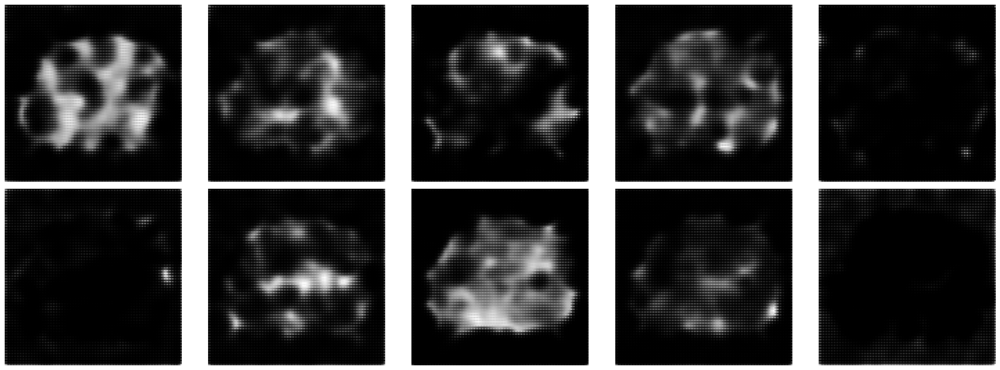

  0%|                                                  | 0/3750 [00:00<?, ?it/s]

1/1 [==============================] - 0s 11ms/step


  0%|                                          | 1/3750 [00:00<07:26,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 2/3750 [00:00<07:04,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


  0%|                                          | 3/3750 [00:00<06:52,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 4/3750 [00:00<07:04,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 5/3750 [00:00<06:53,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 6/3750 [00:00<06:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 7/3750 [00:00<06:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 8/3750 [00:00<06:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                          | 9/3750 [00:00<06:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 10/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|                                         | 11/3750 [00:01<06:38,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 12/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 13/3750 [00:01<06:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 14/3750 [00:01<06:36,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 15/3750 [00:01<06:35,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 16/3750 [00:01<06:40,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


  0%|▏                                        | 17/3750 [00:01<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  0%|▏                                        | 18/3750 [00:01<06:38,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▏                                        | 19/3750 [00:02<06:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 20/3750 [00:02<06:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 21/3750 [00:02<06:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▏                                        | 22/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 23/3750 [00:02<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 24/3750 [00:02<06:35,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 25/3750 [00:02<06:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 26/3750 [00:02<06:36,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 27/3750 [00:02<06:36,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 28/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 29/3750 [00:03<06:34,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 30/3750 [00:03<06:35,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▎                                        | 31/3750 [00:03<06:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 32/3750 [00:03<06:34,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 33/3750 [00:03<06:34,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▎                                        | 34/3750 [00:03<06:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 35/3750 [00:03<06:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 36/3750 [00:03<06:35,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 37/3750 [00:03<06:33,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▍                                        | 38/3750 [00:04<06:32,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 39/3750 [00:04<06:31,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 40/3750 [00:04<06:30,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 41/3750 [00:04<06:30,  9.51it/s]

1/1 [==============================] - 0s 10ms/step


  1%|▍                                        | 42/3750 [00:04<06:31,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 43/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 44/3750 [00:04<06:33,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▍                                        | 45/3750 [00:04<06:32,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 46/3750 [00:04<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 47/3750 [00:05<06:32,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 48/3750 [00:05<06:30,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 49/3750 [00:05<06:31,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 50/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 51/3750 [00:05<06:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 52/3750 [00:05<06:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 53/3750 [00:05<06:31,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 54/3750 [00:05<06:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  1%|▌                                        | 55/3750 [00:05<06:30,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  1%|▌                                        | 56/3750 [00:05<06:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▌                                        | 57/3750 [00:06<06:29,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 58/3750 [00:06<06:29,  9.48it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 59/3750 [00:06<06:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 60/3750 [00:06<06:28,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 61/3750 [00:06<06:31,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 62/3750 [00:06<06:31,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 63/3750 [00:06<06:30,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 64/3750 [00:06<06:30,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▋                                        | 65/3750 [00:06<06:29,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 66/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 67/3750 [00:07<06:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▋                                        | 68/3750 [00:07<06:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 69/3750 [00:07<06:28,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 70/3750 [00:07<06:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 71/3750 [00:07<06:29,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 72/3750 [00:07<06:29,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 73/3750 [00:07<06:28,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 74/3750 [00:07<06:27,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 75/3750 [00:07<06:27,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▊                                        | 76/3750 [00:08<06:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 77/3750 [00:08<06:27,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 78/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 79/3750 [00:08<06:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▊                                        | 80/3750 [00:08<06:28,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 81/3750 [00:08<06:27,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 82/3750 [00:08<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 83/3750 [00:08<06:26,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 84/3750 [00:08<06:27,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 85/3750 [00:09<06:27,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  2%|▉                                        | 86/3750 [00:09<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 87/3750 [00:09<06:26,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 88/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 89/3750 [00:09<06:28,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 90/3750 [00:09<06:28,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  2%|▉                                        | 91/3750 [00:09<06:30,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  2%|█                                        | 92/3750 [00:09<06:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  2%|█                                        | 93/3750 [00:09<06:29,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█                                        | 94/3750 [00:09<06:28,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 95/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 96/3750 [00:10<06:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 97/3750 [00:10<06:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 98/3750 [00:10<06:28,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                        | 99/3750 [00:10<06:26,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 100/3750 [00:10<06:27,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 101/3750 [00:10<06:26,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 102/3750 [00:10<06:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 103/3750 [00:10<06:24,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 104/3750 [00:11<06:25,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█                                       | 105/3750 [00:11<06:25,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 106/3750 [00:11<06:28,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 107/3750 [00:11<06:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 108/3750 [00:11<06:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 109/3750 [00:11<06:28,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 110/3750 [00:11<06:26,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 111/3750 [00:11<06:26,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 112/3750 [00:11<06:24,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 113/3750 [00:12<06:24,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 114/3750 [00:12<06:22,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▏                                      | 115/3750 [00:12<06:23,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 116/3750 [00:12<06:25,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▏                                      | 117/3750 [00:12<06:24,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 118/3750 [00:12<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 119/3750 [00:12<06:24,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 120/3750 [00:12<06:23,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 121/3750 [00:12<06:26,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 122/3750 [00:12<06:23,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▎                                      | 123/3750 [00:13<06:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 124/3750 [00:13<06:22,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 125/3750 [00:13<06:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 126/3750 [00:13<06:22,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 127/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▎                                      | 128/3750 [00:13<06:22,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  3%|█▍                                      | 129/3750 [00:13<06:19,  9.54it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 130/3750 [00:13<06:19,  9.53it/s]

1/1 [==============================] - 0s 9ms/step


  3%|█▍                                      | 131/3750 [00:13<06:20,  9.51it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▍                                      | 132/3750 [00:14<06:19,  9.52it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 133/3750 [00:14<06:21,  9.49it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 134/3750 [00:14<06:23,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 135/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 136/3750 [00:14<06:21,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 137/3750 [00:14<06:21,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 138/3750 [00:14<06:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 139/3750 [00:14<06:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▍                                      | 140/3750 [00:14<06:20,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 141/3750 [00:14<06:19,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 142/3750 [00:15<06:19,  9.51it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 143/3750 [00:15<06:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 144/3750 [00:15<06:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 145/3750 [00:15<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 146/3750 [00:15<06:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 147/3750 [00:15<06:21,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 148/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 149/3750 [00:15<06:21,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 150/3750 [00:15<06:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 151/3750 [00:16<06:20,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▌                                      | 152/3750 [00:16<06:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 153/3750 [00:16<06:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 154/3750 [00:16<06:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 155/3750 [00:16<06:22,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 156/3750 [00:16<06:22,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 157/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 158/3750 [00:16<06:21,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 159/3750 [00:16<06:20,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 160/3750 [00:16<06:20,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 161/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 162/3750 [00:17<06:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 163/3750 [00:17<06:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▋                                      | 164/3750 [00:17<06:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  4%|█▊                                      | 165/3750 [00:17<06:21,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


  4%|█▊                                      | 166/3750 [00:17<06:20,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▊                                      | 167/3750 [00:17<06:25,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


  4%|█▊                                      | 168/3750 [00:17<06:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 169/3750 [00:17<06:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 170/3750 [00:18<06:21,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  5%|█▊                                      | 171/3750 [00:18<06:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 172/3750 [00:18<06:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 173/3750 [00:18<06:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 174/3750 [00:18<06:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▊                                      | 175/3750 [00:18<06:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 176/3750 [00:18<06:21,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 177/3750 [00:18<06:22,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 178/3750 [00:18<06:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 179/3750 [00:19<06:21,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  5%|█▉                                      | 180/3750 [00:19<06:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 181/3750 [00:19<06:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 182/3750 [00:19<06:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 183/3750 [00:19<06:20,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 184/3750 [00:19<06:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 185/3750 [00:19<06:19,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 186/3750 [00:19<06:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|█▉                                      | 187/3750 [00:19<06:19,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 188/3750 [00:19<06:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 189/3750 [00:20<06:17,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 190/3750 [00:20<06:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 191/3750 [00:20<06:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 192/3750 [00:20<06:18,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 193/3750 [00:20<06:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 194/3750 [00:20<06:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 195/3750 [00:20<06:17,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 196/3750 [00:20<06:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 197/3750 [00:20<06:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██                                      | 198/3750 [00:21<06:15,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██                                      | 199/3750 [00:21<06:17,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 200/3750 [00:21<06:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 201/3750 [00:21<06:15,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 202/3750 [00:21<06:14,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 203/3750 [00:21<06:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  5%|██▏                                     | 204/3750 [00:21<06:13,  9.49it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 205/3750 [00:21<06:13,  9.50it/s]

1/1 [==============================] - 0s 8ms/step


  5%|██▏                                     | 206/3750 [00:21<06:12,  9.50it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 207/3750 [00:21<06:13,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 208/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 209/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▏                                     | 210/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 211/3750 [00:22<06:15,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 212/3750 [00:22<06:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 213/3750 [00:22<06:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 214/3750 [00:22<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 215/3750 [00:22<06:14,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 216/3750 [00:22<06:14,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 217/3750 [00:23<06:17,  9.35it/s]

1/1 [==============================] - 0s 11ms/step


  6%|██▎                                     | 218/3750 [00:23<06:56,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▎                                     | 219/3750 [00:23<06:49,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 220/3750 [00:23<06:39,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▎                                     | 221/3750 [00:23<06:33,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▎                                     | 222/3750 [00:23<06:27,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 223/3750 [00:23<06:24,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 224/3750 [00:23<06:21,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 225/3750 [00:23<06:21,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 226/3750 [00:24<06:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 227/3750 [00:24<06:22,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


  6%|██▍                                     | 228/3750 [00:24<06:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 229/3750 [00:24<06:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 230/3750 [00:24<06:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 231/3750 [00:24<06:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 232/3750 [00:24<07:02,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▍                                     | 233/3750 [00:24<06:47,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▍                                     | 234/3750 [00:24<06:39,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 235/3750 [00:25<06:33,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 236/3750 [00:25<06:30,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 237/3750 [00:25<06:29,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 238/3750 [00:25<06:24,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 239/3750 [00:25<06:21,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 240/3750 [00:25<06:18,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


  6%|██▌                                     | 241/3750 [00:25<06:19,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 242/3750 [00:25<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  6%|██▌                                     | 243/3750 [00:25<06:17,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▌                                     | 244/3750 [00:26<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 245/3750 [00:26<06:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▌                                     | 246/3750 [00:26<06:18,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 247/3750 [00:26<06:17,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 248/3750 [00:26<06:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 249/3750 [00:26<06:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 250/3750 [00:26<06:14,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▋                                     | 251/3750 [00:26<06:12,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 252/3750 [00:26<06:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 253/3750 [00:26<06:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 254/3750 [00:27<06:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 255/3750 [00:27<06:14,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▋                                     | 256/3750 [00:27<06:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▋                                     | 257/3750 [00:27<06:16,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 258/3750 [00:27<06:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 259/3750 [00:27<06:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 260/3750 [00:27<06:12,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 261/3750 [00:27<06:11,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


  7%|██▊                                     | 262/3750 [00:27<06:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 263/3750 [00:28<06:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 264/3750 [00:28<06:10,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 265/3750 [00:28<06:11,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 266/3750 [00:28<06:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 267/3750 [00:28<06:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 268/3750 [00:28<06:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▊                                     | 269/3750 [00:28<06:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 270/3750 [00:28<06:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 271/3750 [00:28<06:07,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 272/3750 [00:29<06:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 273/3750 [00:29<06:09,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 274/3750 [00:29<06:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 275/3750 [00:29<06:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 276/3750 [00:29<06:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 277/3750 [00:29<06:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 278/3750 [00:29<06:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 279/3750 [00:29<06:13,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


  7%|██▉                                     | 280/3750 [00:29<06:13,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


  7%|██▉                                     | 281/3750 [00:29<06:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 282/3750 [00:30<06:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 283/3750 [00:30<06:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 284/3750 [00:30<06:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 285/3750 [00:30<06:09,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 286/3750 [00:30<06:08,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 287/3750 [00:30<06:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 288/3750 [00:30<06:06,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 289/3750 [00:30<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 290/3750 [00:30<06:06,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███                                     | 291/3750 [00:31<06:05,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███                                     | 292/3750 [00:31<06:06,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 293/3750 [00:31<06:07,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 294/3750 [00:31<06:06,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 295/3750 [00:31<06:05,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 296/3750 [00:31<06:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 297/3750 [00:31<06:04,  9.47it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 298/3750 [00:31<06:04,  9.46it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▏                                    | 299/3750 [00:31<06:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 300/3750 [00:31<06:03,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 301/3750 [00:32<06:04,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 302/3750 [00:32<06:06,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 303/3750 [00:32<06:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▏                                    | 304/3750 [00:32<06:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 305/3750 [00:32<06:07,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


  8%|███▎                                    | 306/3750 [00:32<06:05,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 307/3750 [00:32<06:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 308/3750 [00:32<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 309/3750 [00:32<06:04,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 310/3750 [00:33<06:05,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 311/3750 [00:33<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 312/3750 [00:33<06:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 313/3750 [00:33<06:04,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▎                                    | 314/3750 [00:33<06:05,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 315/3750 [00:33<06:07,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▎                                    | 316/3750 [00:33<06:07,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


  8%|███▍                                    | 317/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


  8%|███▍                                    | 318/3750 [00:33<06:07,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 319/3750 [00:34<06:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 320/3750 [00:34<06:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 321/3750 [00:34<06:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 322/3750 [00:34<06:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 323/3750 [00:34<06:10,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 324/3750 [00:34<06:08,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 325/3750 [00:34<06:07,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 326/3750 [00:34<06:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 327/3750 [00:34<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▍                                    | 328/3750 [00:34<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 329/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 330/3750 [00:35<06:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 331/3750 [00:35<06:04,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 332/3750 [00:35<06:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 333/3750 [00:35<06:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 334/3750 [00:35<06:04,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 335/3750 [00:35<06:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 336/3750 [00:35<06:02,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 337/3750 [00:35<06:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 338/3750 [00:36<06:01,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▌                                    | 339/3750 [00:36<06:00,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 340/3750 [00:36<06:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 341/3750 [00:36<06:02,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 342/3750 [00:36<06:01,  9.42it/s]

1/1 [==============================] - 0s 11ms/step


  9%|███▋                                    | 343/3750 [00:36<06:02,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 344/3750 [00:36<06:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 345/3750 [00:36<06:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 346/3750 [00:36<06:01,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 347/3750 [00:36<06:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 348/3750 [00:37<06:00,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 349/3750 [00:37<06:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 350/3750 [00:37<06:01,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▋                                    | 351/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 352/3750 [00:37<05:59,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 353/3750 [00:37<05:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 354/3750 [00:37<05:59,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 355/3750 [00:37<06:00,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


  9%|███▊                                    | 356/3750 [00:37<05:59,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 357/3750 [00:38<05:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 358/3750 [00:38<06:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 359/3750 [00:38<05:59,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 360/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 361/3750 [00:38<05:58,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▊                                    | 362/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▊                                    | 363/3750 [00:38<05:58,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 364/3750 [00:38<05:58,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 365/3750 [00:38<05:59,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 366/3750 [00:39<05:59,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|███▉                                    | 367/3750 [00:39<06:01,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 368/3750 [00:39<06:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 369/3750 [00:39<06:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 370/3750 [00:39<05:58,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 371/3750 [00:39<05:57,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 372/3750 [00:39<05:57,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 373/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|███▉                                    | 374/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 375/3750 [00:39<05:56,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 376/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 377/3750 [00:40<05:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 378/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 379/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 380/3750 [00:40<05:58,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 381/3750 [00:40<05:58,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 382/3750 [00:40<05:57,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 10%|████                                    | 383/3750 [00:40<05:56,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 384/3750 [00:40<05:55,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 385/3750 [00:41<05:56,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████                                    | 386/3750 [00:41<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 387/3750 [00:41<05:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 388/3750 [00:41<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 389/3750 [00:41<05:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 390/3750 [00:41<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 391/3750 [00:41<05:56,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 392/3750 [00:41<05:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 10%|████▏                                   | 393/3750 [00:41<05:57,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 394/3750 [00:41<05:56,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 395/3750 [00:42<05:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 396/3750 [00:42<06:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 397/3750 [00:42<06:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▏                                   | 398/3750 [00:42<05:59,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 399/3750 [00:42<05:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 400/3750 [00:42<05:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 401/3750 [00:42<05:56,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 402/3750 [00:42<05:55,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 403/3750 [00:42<05:55,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 404/3750 [00:43<05:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 405/3750 [00:43<05:57,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 406/3750 [00:43<05:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 407/3750 [00:43<05:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 408/3750 [00:43<05:54,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 11%|████▎                                   | 409/3750 [00:43<05:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▎                                   | 410/3750 [00:43<05:54,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 411/3750 [00:43<05:55,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 412/3750 [00:43<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 413/3750 [00:44<05:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 414/3750 [00:44<05:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 415/3750 [00:44<05:55,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 416/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 417/3750 [00:44<05:54,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 418/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 419/3750 [00:44<05:54,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 420/3750 [00:44<05:54,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▍                                   | 421/3750 [00:44<05:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 422/3750 [00:44<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 423/3750 [00:45<05:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 424/3750 [00:45<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 425/3750 [00:45<05:52,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 426/3750 [00:45<05:51,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 427/3750 [00:45<05:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 428/3750 [00:45<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 429/3750 [00:45<05:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 430/3750 [00:45<05:52,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 11%|████▌                                   | 431/3750 [00:45<05:51,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▌                                   | 432/3750 [00:46<05:51,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▌                                   | 433/3750 [00:46<05:54,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 434/3750 [00:46<05:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 435/3750 [00:46<05:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 436/3750 [00:46<05:53,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 437/3750 [00:46<05:53,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 438/3750 [00:46<05:52,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 439/3750 [00:46<05:50,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 440/3750 [00:46<05:50,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▋                                   | 441/3750 [00:46<05:50,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 442/3750 [00:47<05:54,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 443/3750 [00:47<05:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 444/3750 [00:47<05:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▋                                   | 445/3750 [00:47<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 446/3750 [00:47<05:51,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 447/3750 [00:47<05:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 448/3750 [00:47<05:50,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 449/3750 [00:47<05:50,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 450/3750 [00:47<05:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 451/3750 [00:48<05:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 452/3750 [00:48<05:51,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 453/3750 [00:48<05:51,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 454/3750 [00:48<05:49,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▊                                   | 455/3750 [00:48<05:48,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 456/3750 [00:48<05:48,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▊                                   | 457/3750 [00:48<05:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 458/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 459/3750 [00:48<05:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 460/3750 [00:49<05:50,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 461/3750 [00:49<05:51,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 462/3750 [00:49<05:49,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 12%|████▉                                   | 463/3750 [00:49<05:48,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 464/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 465/3750 [00:49<05:49,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 466/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 467/3750 [00:49<05:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 12%|████▉                                   | 468/3750 [00:49<05:49,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 469/3750 [00:49<05:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 470/3750 [00:50<05:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████                                   | 471/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 472/3750 [00:50<05:47,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 473/3750 [00:50<05:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 474/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 475/3750 [00:50<05:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 476/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 477/3750 [00:50<05:47,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 478/3750 [00:50<05:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 479/3750 [00:51<05:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████                                   | 480/3750 [00:51<05:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 481/3750 [00:51<05:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 482/3750 [00:51<05:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 483/3750 [00:51<05:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 484/3750 [00:51<05:50,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 485/3750 [00:51<05:49,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 486/3750 [00:51<05:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 487/3750 [00:51<05:47,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 488/3750 [00:51<05:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 489/3750 [00:52<05:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 490/3750 [00:52<05:46,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▏                                  | 491/3750 [00:52<05:46,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▏                                  | 492/3750 [00:52<05:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 493/3750 [00:52<05:45,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 494/3750 [00:52<05:46,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 495/3750 [00:52<05:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 496/3750 [00:52<05:44,  9.44it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▎                                  | 497/3750 [00:52<05:45,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 498/3750 [00:53<05:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 499/3750 [00:53<09:12,  5.88it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 500/3750 [00:53<08:10,  6.63it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 501/3750 [00:53<07:25,  7.29it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▎                                  | 502/3750 [00:53<06:54,  7.83it/s]

1/1 [==============================] - 0s 8ms/step


 13%|█████▎                                  | 503/3750 [00:53<06:32,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 504/3750 [00:53<06:18,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 13%|█████▍                                  | 505/3750 [00:54<06:09,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 13%|█████▍                                  | 506/3750 [00:54<06:02,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 507/3750 [00:54<05:57,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 508/3750 [00:54<05:53,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 14%|█████▍                                  | 509/3750 [00:54<08:10,  6.61it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 510/3750 [00:54<07:26,  7.25it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 511/3750 [00:54<09:44,  5.55it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 512/3750 [00:55<08:32,  6.31it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▍                                  | 513/3750 [00:55<07:42,  7.00it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 514/3750 [00:55<07:07,  7.57it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▍                                  | 515/3750 [00:55<06:42,  8.04it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 516/3750 [00:55<06:25,  8.39it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▌                                  | 517/3750 [00:55<06:12,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 518/3750 [00:55<06:03,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 519/3750 [00:55<05:57,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 520/3750 [00:55<05:51,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 521/3750 [00:56<05:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 522/3750 [00:56<05:48,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 523/3750 [00:56<05:45,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 14%|█████▌                                  | 524/3750 [00:56<05:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 525/3750 [00:56<05:45,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 526/3750 [00:56<05:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▌                                  | 527/3750 [00:56<05:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 528/3750 [00:56<05:43,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 529/3750 [00:56<05:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 530/3750 [00:56<05:42,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 531/3750 [00:57<05:42,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 532/3750 [00:57<05:41,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 533/3750 [00:57<05:41,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 534/3750 [00:57<05:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 535/3750 [00:57<05:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 536/3750 [00:57<05:44,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 537/3750 [00:57<05:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▋                                  | 538/3750 [00:57<06:41,  8.01it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▋                                  | 539/3750 [00:58<06:23,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 540/3750 [00:58<06:09,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 541/3750 [00:58<06:00,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 14%|█████▊                                  | 542/3750 [00:58<05:53,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 14%|█████▊                                  | 543/3750 [00:58<05:53,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 544/3750 [00:58<05:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 545/3750 [00:58<05:47,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 546/3750 [00:58<05:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 547/3750 [00:58<05:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 548/3750 [00:58<05:44,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▊                                  | 549/3750 [00:59<05:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▊                                  | 550/3750 [00:59<05:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 551/3750 [00:59<05:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 552/3750 [00:59<05:41,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 553/3750 [00:59<05:43,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 554/3750 [00:59<05:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 555/3750 [00:59<05:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 556/3750 [00:59<05:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 557/3750 [00:59<05:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 558/3750 [01:00<05:40,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 15%|█████▉                                  | 559/3750 [01:00<05:42,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 560/3750 [01:00<05:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 561/3750 [01:00<05:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 15%|█████▉                                  | 562/3750 [01:00<05:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 563/3750 [01:00<05:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 564/3750 [01:00<05:40,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 565/3750 [01:00<05:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 566/3750 [01:00<05:38,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 567/3750 [01:01<05:50,  9.07it/s]

1/1 [==============================] - 0s 12ms/step


 15%|██████                                  | 568/3750 [01:01<05:57,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 569/3750 [01:01<05:55,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 15%|██████                                  | 570/3750 [01:01<05:51,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████                                  | 571/3750 [01:01<06:03,  8.74it/s]

1/1 [==============================] - 0s 13ms/step


 15%|██████                                  | 572/3750 [01:01<06:12,  8.52it/s]

1/1 [==============================] - 0s 11ms/step


 15%|██████                                  | 573/3750 [01:01<06:23,  8.27it/s]

1/1 [==============================] - 0s 12ms/step


 15%|██████                                  | 574/3750 [01:01<06:29,  8.15it/s]

1/1 [==============================] - 0s 18ms/step


 15%|██████▏                                 | 575/3750 [01:01<06:51,  7.72it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 576/3750 [01:02<06:54,  7.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|██████▏                                 | 577/3750 [01:02<06:50,  7.74it/s]

1/1 [==============================] - 0s 11ms/step


 15%|██████▏                                 | 578/3750 [01:02<07:03,  7.50it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 579/3750 [01:02<06:40,  7.91it/s]

1/1 [==============================] - 0s 10ms/step


 15%|██████▏                                 | 580/3750 [01:02<06:34,  8.04it/s]

1/1 [==============================] - 0s 11ms/step


 15%|██████▏                                 | 581/3750 [01:02<06:32,  8.07it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▏                                 | 582/3750 [01:02<06:28,  8.14it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 583/3750 [01:02<06:24,  8.24it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▏                                 | 584/3750 [01:03<06:14,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▏                                 | 585/3750 [01:03<06:04,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 586/3750 [01:03<05:56,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 587/3750 [01:03<05:52,  8.97it/s]

1/1 [==============================] - 0s 12ms/step


 16%|██████▎                                 | 588/3750 [01:03<06:19,  8.34it/s]

1/1 [==============================] - 0s 13ms/step


 16%|██████▎                                 | 589/3750 [01:03<07:28,  7.04it/s]

1/1 [==============================] - 0s 12ms/step


 16%|██████▎                                 | 590/3750 [01:03<07:14,  7.28it/s]

1/1 [==============================] - 0s 12ms/step


 16%|██████▎                                 | 591/3750 [01:04<07:00,  7.52it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 592/3750 [01:04<06:47,  7.75it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 593/3750 [01:04<06:37,  7.94it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 594/3750 [01:04<06:26,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 595/3750 [01:04<06:15,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▎                                 | 596/3750 [01:04<06:07,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▎                                 | 597/3750 [01:04<05:59,  8.78it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 598/3750 [01:04<05:53,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 599/3750 [01:04<05:52,  8.93it/s]

1/1 [==============================] - 0s 11ms/step


 16%|██████▍                                 | 600/3750 [01:05<05:50,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 601/3750 [01:05<05:49,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 602/3750 [01:05<05:49,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 603/3750 [01:05<05:49,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 604/3750 [01:05<05:47,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 605/3750 [01:05<05:43,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 606/3750 [01:05<05:40,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 607/3750 [01:05<05:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▍                                 | 608/3750 [01:05<05:41,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 16%|██████▍                                 | 609/3750 [01:05<05:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 610/3750 [01:06<05:43,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 16%|██████▌                                 | 611/3750 [01:06<05:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 612/3750 [01:06<05:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 613/3750 [01:06<05:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 614/3750 [01:06<05:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 615/3750 [01:06<05:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 616/3750 [01:06<05:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 617/3750 [01:06<05:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 16%|██████▌                                 | 618/3750 [01:06<05:37,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 619/3750 [01:07<05:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 620/3750 [01:07<05:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▌                                 | 621/3750 [01:07<05:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 622/3750 [01:07<05:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 623/3750 [01:07<05:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 624/3750 [01:07<05:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 625/3750 [01:07<05:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 626/3750 [01:07<05:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 627/3750 [01:07<05:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 628/3750 [01:08<05:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 629/3750 [01:08<05:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 630/3750 [01:08<05:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 631/3750 [01:08<05:34,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▋                                 | 632/3750 [01:08<05:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 633/3750 [01:08<05:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 634/3750 [01:08<05:32,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 635/3750 [01:08<05:31,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▊                                 | 636/3750 [01:08<05:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 637/3750 [01:08<05:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 638/3750 [01:09<05:34,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 639/3750 [01:09<05:35,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 640/3750 [01:09<05:34,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 641/3750 [01:09<05:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 642/3750 [01:09<05:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▊                                 | 643/3750 [01:09<05:32,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▊                                 | 644/3750 [01:09<05:28,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 645/3750 [01:09<05:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 646/3750 [01:09<05:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 647/3750 [01:10<05:32,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 17%|██████▉                                 | 648/3750 [01:10<05:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 649/3750 [01:10<05:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 17%|██████▉                                 | 650/3750 [01:10<06:37,  7.80it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 651/3750 [01:10<06:19,  8.17it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 652/3750 [01:10<06:06,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 653/3750 [01:10<06:00,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 654/3750 [01:10<05:52,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 655/3750 [01:11<05:49,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 17%|██████▉                                 | 656/3750 [01:11<05:45,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 657/3750 [01:11<05:41,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 658/3750 [01:11<05:38,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 659/3750 [01:11<05:35,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 660/3750 [01:11<05:43,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 18%|███████                                 | 661/3750 [01:11<05:55,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████                                 | 662/3750 [01:11<05:50,  8.81it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████                                 | 663/3750 [01:11<05:47,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 664/3750 [01:12<05:43,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 665/3750 [01:12<05:42,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 666/3750 [01:12<05:38,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████                                 | 667/3750 [01:12<05:34,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 668/3750 [01:12<05:32,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 669/3750 [01:12<05:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 670/3750 [01:12<05:29,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 671/3750 [01:12<05:29,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 18%|███████▏                                | 672/3750 [01:12<05:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 673/3750 [01:12<05:28,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 674/3750 [01:13<05:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 675/3750 [01:13<05:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 676/3750 [01:13<05:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 677/3750 [01:13<05:29,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 18%|███████▏                                | 678/3750 [01:13<05:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▏                                | 679/3750 [01:13<05:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 680/3750 [01:13<05:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 681/3750 [01:13<05:28,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 682/3750 [01:13<05:27,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 683/3750 [01:14<05:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 684/3750 [01:14<05:29,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 685/3750 [01:14<05:29,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 686/3750 [01:14<05:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 687/3750 [01:14<05:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 688/3750 [01:14<05:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 689/3750 [01:14<05:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 690/3750 [01:14<05:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▎                                | 691/3750 [01:14<05:30,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▍                                | 692/3750 [01:15<05:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 18%|███████▍                                | 693/3750 [01:15<05:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 694/3750 [01:15<05:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 695/3750 [01:15<05:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 696/3750 [01:15<05:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 697/3750 [01:15<05:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▍                                | 698/3750 [01:15<05:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 699/3750 [01:15<05:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 700/3750 [01:15<05:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 701/3750 [01:15<05:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 702/3750 [01:16<05:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▍                                | 703/3750 [01:16<05:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 704/3750 [01:16<05:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 705/3750 [01:16<05:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 706/3750 [01:16<05:25,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 707/3750 [01:16<05:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▌                                | 708/3750 [01:16<05:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 709/3750 [01:16<05:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 710/3750 [01:16<05:22,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 711/3750 [01:17<05:21,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▌                                | 712/3750 [01:17<05:21,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 713/3750 [01:17<05:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▌                                | 714/3750 [01:17<05:24,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 715/3750 [01:17<05:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 716/3750 [01:17<05:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 717/3750 [01:17<05:24,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 19%|███████▋                                | 718/3750 [01:17<05:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 719/3750 [01:17<05:22,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 19%|███████▋                                | 720/3750 [01:17<05:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 721/3750 [01:18<05:23,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 722/3750 [01:18<05:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 723/3750 [01:18<05:25,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 724/3750 [01:18<05:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 725/3750 [01:18<05:24,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▋                                | 726/3750 [01:18<05:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 727/3750 [01:18<05:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 728/3750 [01:18<05:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 729/3750 [01:18<05:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 730/3750 [01:19<05:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 19%|███████▊                                | 731/3750 [01:19<05:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 732/3750 [01:19<05:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 733/3750 [01:19<05:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 734/3750 [01:19<05:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 735/3750 [01:19<05:21,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 736/3750 [01:19<05:20,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 20%|███████▊                                | 737/3750 [01:19<05:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▊                                | 738/3750 [01:19<05:22,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 20%|███████▉                                | 739/3750 [01:20<05:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 740/3750 [01:20<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 741/3750 [01:20<05:19,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 742/3750 [01:20<05:21,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 743/3750 [01:20<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 744/3750 [01:20<05:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 745/3750 [01:20<05:19,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 746/3750 [01:20<05:18,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 747/3750 [01:20<05:17,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 748/3750 [01:20<05:16,  9.47it/s]

1/1 [==============================] - 0s 9ms/step


 20%|███████▉                                | 749/3750 [01:21<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 750/3750 [01:21<05:17,  9.46it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 751/3750 [01:21<05:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 752/3750 [01:21<05:21,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 753/3750 [01:21<05:19,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 754/3750 [01:21<05:23,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 755/3750 [01:21<05:21,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 756/3750 [01:21<05:20,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 757/3750 [01:21<05:18,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 758/3750 [01:22<05:18,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 759/3750 [01:22<05:17,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 760/3750 [01:22<05:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████                                | 761/3750 [01:22<05:19,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 762/3750 [01:22<05:16,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 763/3750 [01:22<05:16,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 764/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 765/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 766/3750 [01:22<05:16,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 20%|████████▏                               | 767/3750 [01:23<05:15,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 20%|████████▏                               | 768/3750 [01:23<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 769/3750 [01:23<05:16,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 770/3750 [01:23<05:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 771/3750 [01:23<05:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 772/3750 [01:23<05:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▏                               | 773/3750 [01:23<05:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 774/3750 [01:23<05:16,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 775/3750 [01:23<05:16,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 776/3750 [01:23<05:15,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 777/3750 [01:24<05:15,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 778/3750 [01:24<05:15,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 779/3750 [01:24<05:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 780/3750 [01:24<05:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 781/3750 [01:24<05:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 782/3750 [01:24<05:17,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 783/3750 [01:24<05:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▎                               | 784/3750 [01:24<05:16,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 21%|████████▎                               | 785/3750 [01:24<05:15,  9.40it/s]

1/1 [==============================] - 0s 18ms/step


 21%|████████▍                               | 786/3750 [01:25<05:49,  8.49it/s]

1/1 [==============================] - 0s 16ms/step


 21%|████████▍                               | 787/3750 [01:25<06:05,  8.11it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 788/3750 [01:25<06:00,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 789/3750 [01:25<05:58,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 21%|████████▍                               | 790/3750 [01:25<05:54,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 791/3750 [01:25<05:47,  8.51it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 792/3750 [01:25<05:41,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 793/3750 [01:25<05:35,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 794/3750 [01:26<05:39,  8.70it/s]

1/1 [==============================] - 0s 11ms/step


 21%|████████▍                               | 795/3750 [01:26<05:35,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▍                               | 796/3750 [01:26<05:29,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 797/3750 [01:26<05:25,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 798/3750 [01:26<05:24,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 799/3750 [01:26<05:22,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 800/3750 [01:26<05:20,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 801/3750 [01:26<05:19,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 802/3750 [01:26<05:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 803/3750 [01:26<05:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 21%|████████▌                               | 804/3750 [01:27<05:19,  9.23it/s]

1/1 [==============================] - 0s 13ms/step


 21%|████████▌                               | 805/3750 [01:27<05:39,  8.67it/s]

1/1 [==============================] - 0s 15ms/step


 21%|████████▌                               | 806/3750 [01:27<06:23,  7.68it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▌                               | 807/3750 [01:27<06:15,  7.84it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▌                               | 808/3750 [01:27<06:05,  8.06it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 809/3750 [01:27<05:57,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 810/3750 [01:27<05:45,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 811/3750 [01:27<05:39,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 812/3750 [01:28<05:53,  8.32it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▋                               | 813/3750 [01:28<05:53,  8.31it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 814/3750 [01:28<05:45,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▋                               | 815/3750 [01:28<05:35,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 816/3750 [01:28<05:38,  8.68it/s]

1/1 [==============================] - 0s 18ms/step


 22%|████████▋                               | 817/3750 [01:28<05:45,  8.49it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▋                               | 818/3750 [01:28<06:20,  7.71it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▋                               | 819/3750 [01:28<06:04,  8.04it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▋                               | 820/3750 [01:29<05:56,  8.23it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 821/3750 [01:29<05:44,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 822/3750 [01:29<05:35,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 823/3750 [01:29<05:32,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 824/3750 [01:29<05:51,  8.32it/s]

1/1 [==============================] - 0s 15ms/step


 22%|████████▊                               | 825/3750 [01:29<06:09,  7.93it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▊                               | 826/3750 [01:29<06:01,  8.09it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 827/3750 [01:29<05:52,  8.28it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▊                               | 828/3750 [01:29<05:46,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▊                               | 829/3750 [01:30<05:39,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 830/3750 [01:30<05:34,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▊                               | 831/3750 [01:30<05:30,  8.83it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▊                               | 832/3750 [01:30<05:29,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 833/3750 [01:30<05:30,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 834/3750 [01:30<05:28,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 835/3750 [01:30<05:36,  8.67it/s]

1/1 [==============================] - 0s 11ms/step


 22%|████████▉                               | 836/3750 [01:30<05:36,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 837/3750 [01:31<05:31,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 838/3750 [01:31<05:26,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 839/3750 [01:31<05:22,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 22%|████████▉                               | 840/3750 [01:31<05:19,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 22%|████████▉                               | 841/3750 [01:31<05:19,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 842/3750 [01:31<05:38,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 22%|████████▉                               | 843/3750 [01:31<05:31,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 844/3750 [01:31<05:28,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 845/3750 [01:31<05:23,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 846/3750 [01:32<05:20,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 847/3750 [01:32<05:17,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 848/3750 [01:32<05:24,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 849/3750 [01:32<05:20,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 850/3750 [01:32<05:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 851/3750 [01:32<05:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 852/3750 [01:32<05:17,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 853/3750 [01:32<05:16,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████                               | 854/3750 [01:32<05:16,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████                               | 855/3750 [01:32<05:14,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 856/3750 [01:33<05:14,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 857/3750 [01:33<05:16,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 858/3750 [01:33<05:17,  9.11it/s]

1/1 [==============================] - 0s 11ms/step


 23%|█████████▏                              | 859/3750 [01:33<05:18,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 860/3750 [01:33<05:17,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 861/3750 [01:33<05:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 862/3750 [01:33<05:12,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 863/3750 [01:33<05:17,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 864/3750 [01:33<05:14,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 865/3750 [01:34<05:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▏                              | 866/3750 [01:34<05:14,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▏                              | 867/3750 [01:34<05:17,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 868/3750 [01:34<05:17,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 869/3750 [01:34<05:17,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 870/3750 [01:34<05:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 871/3750 [01:34<05:13,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 872/3750 [01:34<05:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 873/3750 [01:34<05:18,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 23%|█████████▎                              | 874/3750 [01:35<05:22,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 875/3750 [01:35<05:19,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 876/3750 [01:35<05:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 877/3750 [01:35<05:13,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▎                              | 878/3750 [01:35<05:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 23%|█████████▍                              | 879/3750 [01:35<05:11,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 23%|█████████▍                              | 880/3750 [01:35<05:07,  9.33it/s]

1/1 [==============================] - 0s 30ms/step


 23%|█████████▍                              | 881/3750 [01:35<05:33,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 882/3750 [01:35<05:31,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▍                              | 883/3750 [01:36<05:28,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 884/3750 [01:36<05:22,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 885/3750 [01:36<05:17,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 886/3750 [01:36<05:16,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 887/3750 [01:36<05:18,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 888/3750 [01:36<05:15,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▍                              | 889/3750 [01:36<05:14,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▍                              | 890/3750 [01:36<05:12,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 891/3750 [01:37<05:48,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 892/3750 [01:37<05:37,  8.46it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 893/3750 [01:37<05:29,  8.67it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▌                              | 894/3750 [01:37<05:24,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 895/3750 [01:37<05:21,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▌                              | 896/3750 [01:37<05:30,  8.63it/s]

1/1 [==============================] - 0s 16ms/step


 24%|█████████▌                              | 897/3750 [01:37<06:09,  7.72it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 898/3750 [01:37<05:52,  8.10it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 899/3750 [01:37<05:39,  8.40it/s]

1/1 [==============================] - 0s 14ms/step


 24%|█████████▌                              | 900/3750 [01:38<05:34,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▌                              | 901/3750 [01:38<05:30,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▌                              | 902/3750 [01:38<05:25,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 903/3750 [01:38<05:30,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 904/3750 [01:38<05:25,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 905/3750 [01:38<05:56,  7.98it/s]

1/1 [==============================] - 0s 12ms/step


 24%|█████████▋                              | 906/3750 [01:38<06:02,  7.85it/s]

1/1 [==============================] - 0s 12ms/step


 24%|█████████▋                              | 907/3750 [01:38<06:06,  7.75it/s]

1/1 [==============================] - 0s 11ms/step


 24%|█████████▋                              | 908/3750 [01:39<06:08,  7.71it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 909/3750 [01:39<05:51,  8.07it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 910/3750 [01:39<05:42,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 911/3750 [01:39<05:32,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 912/3750 [01:39<05:26,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▋                              | 913/3750 [01:39<05:27,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 24%|█████████▋                              | 914/3750 [01:39<05:20,  8.84it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 915/3750 [01:39<05:15,  8.99it/s]

1/1 [==============================] - 0s 8ms/step


 24%|█████████▊                              | 916/3750 [01:39<05:11,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 917/3750 [01:40<05:14,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 24%|█████████▊                              | 918/3750 [01:40<05:24,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 919/3750 [01:40<05:23,  8.76it/s]

1/1 [==============================] - 0s 11ms/step


 25%|█████████▊                              | 920/3750 [01:40<05:29,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 921/3750 [01:40<05:29,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 922/3750 [01:40<05:29,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 25%|█████████▊                              | 923/3750 [01:40<05:23,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 924/3750 [01:40<05:19,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▊                              | 925/3750 [01:40<05:15,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 926/3750 [01:41<05:11,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 927/3750 [01:41<05:06,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 928/3750 [01:41<05:09,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 929/3750 [01:41<05:13,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 25%|█████████▉                              | 930/3750 [01:41<05:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 931/3750 [01:41<05:10,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 932/3750 [01:41<05:09,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 933/3750 [01:41<05:08,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 934/3750 [01:41<05:06,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 935/3750 [01:42<05:04,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 936/3750 [01:42<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|█████████▉                              | 937/3750 [01:42<05:14,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 938/3750 [01:42<05:11,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 25%|██████████                              | 939/3750 [01:42<05:10,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 940/3750 [01:42<05:10,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 941/3750 [01:42<05:07,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 942/3750 [01:42<05:05,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 943/3750 [01:42<05:04,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 944/3750 [01:43<05:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 945/3750 [01:43<05:01,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 946/3750 [01:43<05:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 947/3750 [01:43<05:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 948/3750 [01:43<05:02,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████                              | 949/3750 [01:43<05:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 950/3750 [01:43<05:01,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 951/3750 [01:43<05:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 952/3750 [01:43<04:59,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 953/3750 [01:44<05:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 954/3750 [01:44<05:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 955/3750 [01:44<04:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 25%|██████████▏                             | 956/3750 [01:44<04:58,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 957/3750 [01:44<05:00,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▏                             | 958/3750 [01:44<05:06,  9.12it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▏                             | 959/3750 [01:44<05:34,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▏                             | 960/3750 [01:44<05:43,  8.12it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 961/3750 [01:44<05:30,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 962/3750 [01:45<05:21,  8.66it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 963/3750 [01:45<05:19,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 964/3750 [01:45<05:19,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 965/3750 [01:45<05:15,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 966/3750 [01:45<05:12,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 967/3750 [01:45<05:09,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 968/3750 [01:45<05:09,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 969/3750 [01:45<05:12,  8.90it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▎                             | 970/3750 [01:45<05:11,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▎                             | 971/3750 [01:46<05:07,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▎                             | 972/3750 [01:46<05:08,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 973/3750 [01:46<05:05,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 974/3750 [01:46<05:12,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 26%|██████████▍                             | 975/3750 [01:46<05:15,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 976/3750 [01:46<05:17,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 977/3750 [01:46<05:12,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 978/3750 [01:46<05:07,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 979/3750 [01:46<05:05,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 980/3750 [01:47<05:05,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▍                             | 981/3750 [01:47<05:04,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 982/3750 [01:47<05:11,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 983/3750 [01:47<05:07,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▍                             | 984/3750 [01:47<05:04,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 26%|██████████▌                             | 985/3750 [01:47<05:11,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 26%|██████████▌                             | 986/3750 [01:47<05:12,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 987/3750 [01:47<05:10,  8.91it/s]

1/1 [==============================] - 0s 13ms/step


 26%|██████████▌                             | 988/3750 [01:47<05:21,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 989/3750 [01:48<05:15,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 990/3750 [01:48<05:12,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 991/3750 [01:48<05:07,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 992/3750 [01:48<05:07,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 26%|██████████▌                             | 993/3750 [01:48<05:07,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 994/3750 [01:48<05:08,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 995/3750 [01:48<05:06,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                             | 996/3750 [01:48<05:06,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 997/3750 [01:48<05:04,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 998/3750 [01:49<05:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                             | 999/3750 [01:49<04:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1000/3750 [01:49<04:57,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1001/3750 [01:49<04:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1002/3750 [01:49<04:56,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1003/3750 [01:49<04:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1004/3750 [01:49<04:58,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1005/3750 [01:49<04:56,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1006/3750 [01:49<04:55,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1007/3750 [01:50<04:58,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▍                            | 1008/3750 [01:50<05:00,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▍                            | 1009/3750 [01:50<05:00,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1010/3750 [01:50<05:00,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1011/3750 [01:50<04:59,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1012/3750 [01:50<05:01,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1013/3750 [01:50<05:01,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1014/3750 [01:50<05:00,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1015/3750 [01:50<04:58,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1016/3750 [01:51<04:59,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1017/3750 [01:51<05:01,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1018/3750 [01:51<04:58,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▌                            | 1019/3750 [01:51<05:02,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1020/3750 [01:51<05:03,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 27%|██████████▌                            | 1021/3750 [01:51<05:02,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1022/3750 [01:51<05:00,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1023/3750 [01:51<04:56,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1024/3750 [01:51<04:54,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1025/3750 [01:52<04:53,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1026/3750 [01:52<04:53,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1027/3750 [01:52<04:53,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1028/3750 [01:52<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1029/3750 [01:52<04:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 27%|██████████▋                            | 1030/3750 [01:52<04:51,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 27%|██████████▋                            | 1031/3750 [01:52<04:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1032/3750 [01:52<04:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▋                            | 1033/3750 [01:52<04:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1034/3750 [01:52<04:50,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1035/3750 [01:53<04:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1036/3750 [01:53<04:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1037/3750 [01:53<04:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1038/3750 [01:53<04:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1039/3750 [01:53<04:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1040/3750 [01:53<04:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1041/3750 [01:53<04:52,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1042/3750 [01:53<04:53,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▊                            | 1043/3750 [01:53<04:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1044/3750 [01:54<04:54,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▊                            | 1045/3750 [01:54<04:54,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1046/3750 [01:54<04:52,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1047/3750 [01:54<04:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1048/3750 [01:54<04:52,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1049/3750 [01:54<04:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1050/3750 [01:54<04:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1051/3750 [01:54<04:50,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1052/3750 [01:54<04:51,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1053/3750 [01:55<04:53,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1054/3750 [01:55<04:58,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 28%|██████████▉                            | 1055/3750 [01:55<05:01,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 28%|██████████▉                            | 1056/3750 [01:55<04:57,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 28%|██████████▉                            | 1057/3750 [01:55<04:54,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1058/3750 [01:55<04:52,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1059/3750 [01:55<04:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1060/3750 [01:55<04:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1061/3750 [01:55<04:51,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1062/3750 [01:56<04:49,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 28%|███████████                            | 1063/3750 [01:56<04:47,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 28%|███████████                            | 1064/3750 [01:56<04:48,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1065/3750 [01:56<04:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1066/3750 [01:56<04:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1067/3750 [01:56<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 28%|███████████                            | 1068/3750 [01:56<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████                            | 1069/3750 [01:56<04:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1070/3750 [01:56<04:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1071/3750 [01:56<04:50,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 29%|███████████▏                           | 1072/3750 [01:57<04:55,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1073/3750 [01:57<04:55,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1074/3750 [01:57<04:53,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1075/3750 [01:57<04:52,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▏                           | 1076/3750 [01:57<04:51,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1077/3750 [01:57<04:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1078/3750 [01:57<04:49,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1079/3750 [01:57<04:51,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1080/3750 [01:57<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▏                           | 1081/3750 [01:58<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1082/3750 [01:58<04:50,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▎                           | 1083/3750 [01:58<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1084/3750 [01:58<04:50,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1085/3750 [01:58<04:51,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1086/3750 [01:58<04:51,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▎                           | 1087/3750 [01:58<04:51,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1088/3750 [01:58<04:51,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1089/3750 [01:58<04:52,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1090/3750 [01:59<04:50,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1091/3750 [01:59<04:50,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1092/3750 [01:59<05:15,  8.43it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▎                           | 1093/3750 [01:59<05:06,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1094/3750 [01:59<04:59,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 29%|███████████▍                           | 1095/3750 [01:59<04:54,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1096/3750 [01:59<04:52,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1097/3750 [01:59<04:50,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 29%|███████████▍                           | 1098/3750 [01:59<04:50,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1099/3750 [02:00<04:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1100/3750 [02:00<04:46,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1101/3750 [02:00<04:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1102/3750 [02:00<04:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1103/3750 [02:00<04:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1104/3750 [02:00<04:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▍                           | 1105/3750 [02:00<04:45,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 29%|███████████▌                           | 1106/3750 [02:00<04:44,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▌                           | 1107/3750 [02:00<04:44,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1108/3750 [02:01<04:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1109/3750 [02:01<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1110/3750 [02:01<04:43,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1111/3750 [02:01<04:42,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1112/3750 [02:01<04:42,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1113/3750 [02:01<04:41,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1114/3750 [02:01<04:43,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1115/3750 [02:01<04:43,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▌                           | 1116/3750 [02:01<04:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▌                           | 1117/3750 [02:01<04:44,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1118/3750 [02:02<04:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1119/3750 [02:02<04:46,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▋                           | 1120/3750 [02:02<04:44,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 30%|███████████▋                           | 1121/3750 [02:02<04:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1122/3750 [02:02<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1123/3750 [02:02<04:42,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1124/3750 [02:02<04:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1125/3750 [02:02<04:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1126/3750 [02:02<04:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1127/3750 [02:03<04:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1128/3750 [02:03<04:41,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▋                           | 1129/3750 [02:03<04:41,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1130/3750 [02:03<04:41,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1131/3750 [02:03<04:41,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 30%|███████████▊                           | 1132/3750 [02:03<04:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1133/3750 [02:03<04:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1134/3750 [02:03<04:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1135/3750 [02:03<04:44,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1136/3750 [02:04<04:45,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1137/3750 [02:04<04:43,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1138/3750 [02:04<04:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1139/3750 [02:04<04:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1140/3750 [02:04<04:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▊                           | 1141/3750 [02:04<04:38,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1142/3750 [02:04<04:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 30%|███████████▉                           | 1143/3750 [02:04<04:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1144/3750 [02:04<04:38,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 31%|███████████▉                           | 1145/3750 [02:04<04:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1146/3750 [02:05<04:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1147/3750 [02:05<04:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1148/3750 [02:05<04:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1149/3750 [02:05<04:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|███████████▉                           | 1150/3750 [02:05<04:42,  9.19it/s]

1/1 [==============================] - 0s 11ms/step


 31%|███████████▉                           | 1151/3750 [02:05<04:49,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1152/3750 [02:05<04:50,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 31%|███████████▉                           | 1153/3750 [02:05<04:48,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1154/3750 [02:05<04:47,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1155/3750 [02:06<04:44,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1156/3750 [02:06<04:44,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1157/3750 [02:06<04:42,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1158/3750 [02:06<04:40,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1159/3750 [02:06<04:39,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1160/3750 [02:06<04:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1161/3750 [02:06<04:37,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████                           | 1162/3750 [02:06<04:36,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1163/3750 [02:06<04:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1164/3750 [02:07<04:36,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████                           | 1165/3750 [02:07<04:37,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1166/3750 [02:07<04:37,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1167/3750 [02:07<04:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1168/3750 [02:07<04:35,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1169/3750 [02:07<04:34,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1170/3750 [02:07<04:35,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1171/3750 [02:07<04:35,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1172/3750 [02:07<04:35,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 31%|████████████▏                          | 1173/3750 [02:08<04:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1174/3750 [02:08<04:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1175/3750 [02:08<04:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▏                          | 1176/3750 [02:08<04:35,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▏                          | 1177/3750 [02:08<04:40,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1178/3750 [02:08<04:52,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 31%|████████████▎                          | 1179/3750 [02:08<04:52,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1180/3750 [02:08<04:47,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 31%|████████████▎                          | 1181/3750 [02:08<04:45,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1182/3750 [02:09<04:41,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1183/3750 [02:09<04:40,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1184/3750 [02:09<04:42,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1185/3750 [02:09<04:42,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1186/3750 [02:09<04:44,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▎                          | 1187/3750 [02:09<04:48,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1188/3750 [02:09<04:55,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▎                          | 1189/3750 [02:09<04:59,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▍                          | 1190/3750 [02:09<04:59,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1191/3750 [02:10<04:56,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1192/3750 [02:10<04:59,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1193/3750 [02:10<05:00,  8.50it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1194/3750 [02:10<05:02,  8.44it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▍                          | 1195/3750 [02:10<05:10,  8.24it/s]

1/1 [==============================] - 0s 17ms/step


 32%|████████████▍                          | 1196/3750 [02:10<05:23,  7.90it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1197/3750 [02:10<05:14,  8.12it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1198/3750 [02:10<05:03,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▍                          | 1199/3750 [02:11<04:59,  8.51it/s]

1/1 [==============================] - 0s 12ms/step


 32%|████████████▍                          | 1200/3750 [02:11<05:08,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 32%|████████████▍                          | 1201/3750 [02:11<05:06,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1202/3750 [02:11<04:58,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1203/3750 [02:11<04:50,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1204/3750 [02:11<04:45,  8.90it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1205/3750 [02:11<04:40,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1206/3750 [02:11<04:37,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1207/3750 [02:11<04:36,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1208/3750 [02:12<04:37,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1209/3750 [02:12<04:35,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1210/3750 [02:12<04:33,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 32%|████████████▌                          | 1211/3750 [02:12<04:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1212/3750 [02:12<04:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▌                          | 1213/3750 [02:12<04:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1214/3750 [02:12<04:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1215/3750 [02:12<04:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 32%|████████████▋                          | 1216/3750 [02:12<04:33,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▋                          | 1217/3750 [02:12<04:46,  8.84it/s]

1/1 [==============================] - 0s 11ms/step


 32%|████████████▋                          | 1218/3750 [02:13<04:51,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1219/3750 [02:13<04:47,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▋                          | 1220/3750 [02:13<04:44,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1221/3750 [02:13<04:45,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▋                          | 1222/3750 [02:13<04:45,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▋                          | 1223/3750 [02:13<04:43,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▋                          | 1224/3750 [02:13<04:40,  9.02it/s]

1/1 [==============================] - 0s 8ms/step


 33%|████████████▋                          | 1225/3750 [02:13<04:37,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1226/3750 [02:13<04:36,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1227/3750 [02:14<04:34,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1228/3750 [02:14<04:32,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1229/3750 [02:14<04:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1230/3750 [02:14<04:31,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1231/3750 [02:14<04:32,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1232/3750 [02:14<04:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1233/3750 [02:14<04:30,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1234/3750 [02:14<04:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▊                          | 1235/3750 [02:14<04:32,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1236/3750 [02:15<04:35,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▊                          | 1237/3750 [02:15<04:35,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1238/3750 [02:15<04:34,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1239/3750 [02:15<04:32,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1240/3750 [02:15<04:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1241/3750 [02:15<04:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1242/3750 [02:15<04:32,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1243/3750 [02:15<04:31,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1244/3750 [02:15<04:32,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1245/3750 [02:16<04:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1246/3750 [02:16<04:29,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 33%|████████████▉                          | 1247/3750 [02:16<04:29,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1248/3750 [02:16<04:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|████████████▉                          | 1249/3750 [02:16<04:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1250/3750 [02:16<04:31,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 33%|█████████████                          | 1251/3750 [02:16<04:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1252/3750 [02:16<04:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1253/3750 [02:16<04:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1254/3750 [02:17<04:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1255/3750 [02:17<04:25,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 33%|█████████████                          | 1256/3750 [02:17<04:24,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1257/3750 [02:17<04:24,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1258/3750 [02:17<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1259/3750 [02:17<04:24,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1260/3750 [02:17<04:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1261/3750 [02:17<04:26,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████                          | 1262/3750 [02:17<04:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1263/3750 [02:17<04:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1264/3750 [02:18<04:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1265/3750 [02:18<04:23,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▏                         | 1266/3750 [02:18<04:24,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▏                         | 1267/3750 [02:18<04:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1268/3750 [02:18<04:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1269/3750 [02:18<04:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1270/3750 [02:18<04:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1271/3750 [02:18<04:24,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1272/3750 [02:18<04:24,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 34%|█████████████▏                         | 1273/3750 [02:19<04:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▏                         | 1274/3750 [02:19<04:23,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1275/3750 [02:19<04:32,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1276/3750 [02:19<04:37,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1277/3750 [02:19<04:34,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1278/3750 [02:19<04:32,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1279/3750 [02:19<04:32,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1280/3750 [02:19<04:29,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1281/3750 [02:19<04:29,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1282/3750 [02:20<04:35,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▎                         | 1283/3750 [02:20<04:35,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1284/3750 [02:20<04:31,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1285/3750 [02:20<04:29,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▎                         | 1286/3750 [02:20<04:27,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 34%|█████████████▍                         | 1287/3750 [02:20<04:26,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1288/3750 [02:20<04:27,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1289/3750 [02:20<04:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1290/3750 [02:20<04:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1291/3750 [02:21<04:24,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1292/3750 [02:21<04:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 34%|█████████████▍                         | 1293/3750 [02:21<04:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1294/3750 [02:21<04:21,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1295/3750 [02:21<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1296/3750 [02:21<04:20,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1297/3750 [02:21<04:21,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▍                         | 1298/3750 [02:21<04:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1299/3750 [02:21<04:20,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1300/3750 [02:21<04:19,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▌                         | 1301/3750 [02:22<04:20,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1302/3750 [02:22<04:22,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1303/3750 [02:22<04:25,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1304/3750 [02:22<04:28,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1305/3750 [02:22<04:29,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1306/3750 [02:22<04:29,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1307/3750 [02:22<04:31,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▌                         | 1308/3750 [02:22<04:29,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1309/3750 [02:22<04:27,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▌                         | 1310/3750 [02:23<04:27,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1311/3750 [02:23<04:26,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1312/3750 [02:23<04:24,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1313/3750 [02:23<04:22,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1314/3750 [02:23<04:21,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1315/3750 [02:23<04:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1316/3750 [02:23<04:21,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1317/3750 [02:23<04:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1318/3750 [02:23<04:19,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1319/3750 [02:24<04:20,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▋                         | 1320/3750 [02:24<04:19,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1321/3750 [02:24<04:18,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 35%|█████████████▋                         | 1322/3750 [02:24<04:23,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1323/3750 [02:24<04:31,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1324/3750 [02:24<04:29,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1325/3750 [02:24<04:29,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1326/3750 [02:24<04:28,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1327/3750 [02:24<04:32,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1328/3750 [02:25<04:37,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1329/3750 [02:25<04:40,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 35%|█████████████▊                         | 1330/3750 [02:25<04:42,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 35%|█████████████▊                         | 1331/3750 [02:25<04:43,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1332/3750 [02:25<04:40,  8.63it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1333/3750 [02:25<04:37,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▊                         | 1334/3750 [02:25<04:34,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1335/3750 [02:25<04:29,  8.96it/s]

1/1 [==============================] - 0s 8ms/step


 36%|█████████████▉                         | 1336/3750 [02:25<04:25,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1337/3750 [02:26<04:22,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1338/3750 [02:26<04:23,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1339/3750 [02:26<04:32,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1340/3750 [02:26<04:36,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 36%|█████████████▉                         | 1341/3750 [02:26<04:38,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1342/3750 [02:26<04:40,  8.59it/s]

1/1 [==============================] - 0s 12ms/step


 36%|█████████████▉                         | 1343/3750 [02:26<04:41,  8.56it/s]

1/1 [==============================] - 0s 11ms/step


 36%|█████████████▉                         | 1344/3750 [02:26<04:43,  8.48it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1345/3750 [02:26<04:43,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 36%|█████████████▉                         | 1346/3750 [02:27<04:37,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1347/3750 [02:27<04:31,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1348/3750 [02:27<04:26,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1349/3750 [02:27<04:23,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1350/3750 [02:27<04:20,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1351/3750 [02:27<04:21,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1352/3750 [02:27<04:20,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 36%|██████████████                         | 1353/3750 [02:27<04:19,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1354/3750 [02:27<04:19,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████                         | 1355/3750 [02:28<04:29,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████                         | 1356/3750 [02:28<04:32,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████                         | 1357/3750 [02:28<04:38,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████                         | 1358/3750 [02:28<04:40,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1359/3750 [02:28<04:35,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1360/3750 [02:28<04:29,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1361/3750 [02:28<04:25,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 36%|██████████████▏                        | 1362/3750 [02:28<04:24,  9.02it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████▏                        | 1363/3750 [02:28<04:26,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1364/3750 [02:29<04:26,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 36%|██████████████▏                        | 1365/3750 [02:29<04:32,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1366/3750 [02:29<04:36,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 36%|██████████████▏                        | 1367/3750 [02:29<04:41,  8.46it/s]

1/1 [==============================] - 0s 15ms/step


 36%|██████████████▏                        | 1368/3750 [02:29<05:05,  7.80it/s]

1/1 [==============================] - 0s 12ms/step


 37%|██████████████▏                        | 1369/3750 [02:29<05:03,  7.84it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▏                        | 1370/3750 [02:29<05:05,  7.80it/s]

1/1 [==============================] - 0s 12ms/step


 37%|██████████████▎                        | 1371/3750 [02:30<05:04,  7.82it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1372/3750 [02:30<05:14,  7.56it/s]

1/1 [==============================] - 0s 25ms/step


 37%|██████████████▎                        | 1373/3750 [02:30<05:25,  7.31it/s]

1/1 [==============================] - 0s 42ms/step


 37%|██████████████▎                        | 1374/3750 [02:30<06:21,  6.22it/s]

1/1 [==============================] - 0s 11ms/step


 37%|██████████████▎                        | 1375/3750 [02:30<06:12,  6.37it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1376/3750 [02:30<05:41,  6.96it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1377/3750 [02:30<05:16,  7.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1378/3750 [02:30<05:00,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1379/3750 [02:31<04:49,  8.20it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▎                        | 1380/3750 [02:31<04:44,  8.32it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1381/3750 [02:31<04:38,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▎                        | 1382/3750 [02:31<04:29,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1383/3750 [02:31<04:25,  8.91it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1384/3750 [02:31<04:23,  8.97it/s]

1/1 [==============================] - 0s 33ms/step


 37%|██████████████▍                        | 1385/3750 [02:31<04:47,  8.21it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1386/3750 [02:31<04:41,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1387/3750 [02:32<04:34,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1388/3750 [02:32<04:31,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1389/3750 [02:32<04:29,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▍                        | 1390/3750 [02:32<04:31,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1391/3750 [02:32<04:26,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1392/3750 [02:32<04:24,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▍                        | 1393/3750 [02:32<04:20,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▍                        | 1394/3750 [02:32<04:17,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 37%|██████████████▌                        | 1395/3750 [02:32<04:15,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1396/3750 [02:33<04:17,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1397/3750 [02:33<04:19,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1398/3750 [02:33<04:18,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1399/3750 [02:33<04:15,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1400/3750 [02:33<04:18,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1401/3750 [02:33<04:18,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1402/3750 [02:33<04:18,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1403/3750 [02:33<04:17,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 37%|██████████████▌                        | 1404/3750 [02:33<04:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1405/3750 [02:34<04:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 37%|██████████████▌                        | 1406/3750 [02:34<04:16,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1407/3750 [02:34<04:16,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1408/3750 [02:34<04:14,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1409/3750 [02:34<04:16,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1410/3750 [02:34<04:15,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1411/3750 [02:34<04:16,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1412/3750 [02:34<04:17,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1413/3750 [02:34<04:17,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1414/3750 [02:34<04:19,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1415/3750 [02:35<04:19,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1416/3750 [02:35<04:17,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▋                        | 1417/3750 [02:35<04:16,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▋                        | 1418/3750 [02:35<04:15,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1419/3750 [02:35<04:13,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1420/3750 [02:35<04:16,  9.09it/s]

1/1 [==============================] - 0s 12ms/step


 38%|██████████████▊                        | 1421/3750 [02:35<04:19,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1422/3750 [02:35<04:16,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1423/3750 [02:35<04:14,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1424/3750 [02:36<04:12,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1425/3750 [02:36<04:11,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1426/3750 [02:36<04:10,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1427/3750 [02:36<04:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1428/3750 [02:36<04:10,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▊                        | 1429/3750 [02:36<04:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▊                        | 1430/3750 [02:36<04:09,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1431/3750 [02:36<04:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1432/3750 [02:36<04:08,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1433/3750 [02:37<04:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1434/3750 [02:37<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1435/3750 [02:37<04:06,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1436/3750 [02:37<04:06,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1437/3750 [02:37<04:07,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 38%|██████████████▉                        | 1438/3750 [02:37<04:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1439/3750 [02:37<04:08,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1440/3750 [02:37<04:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1441/3750 [02:37<04:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 38%|██████████████▉                        | 1442/3750 [02:38<04:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 38%|███████████████                        | 1443/3750 [02:38<04:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1444/3750 [02:38<04:05,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1445/3750 [02:38<04:10,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1446/3750 [02:38<04:13,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1447/3750 [02:38<04:18,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1448/3750 [02:38<04:18,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1449/3750 [02:38<04:17,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1450/3750 [02:38<04:14,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1451/3750 [02:39<04:14,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1452/3750 [02:39<04:14,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████                        | 1453/3750 [02:39<04:14,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████                        | 1454/3750 [02:39<04:13,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1455/3750 [02:39<04:11,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1456/3750 [02:39<04:11,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1457/3750 [02:39<04:12,  9.08it/s]

1/1 [==============================] - 0s 11ms/step


 39%|███████████████▏                       | 1458/3750 [02:39<04:14,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1459/3750 [02:39<04:15,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1460/3750 [02:40<04:12,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1461/3750 [02:40<04:11,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1462/3750 [02:40<04:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1463/3750 [02:40<04:09,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▏                       | 1464/3750 [02:40<04:09,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1465/3750 [02:40<04:11,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▏                       | 1466/3750 [02:40<04:12,  9.03it/s]

1/1 [==============================] - 0s 14ms/step


 39%|███████████████▎                       | 1467/3750 [02:40<04:17,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1468/3750 [02:40<04:15,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1469/3750 [02:40<04:12,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1470/3750 [02:41<04:10,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1471/3750 [02:41<04:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1472/3750 [02:41<04:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1473/3750 [02:41<04:07,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1474/3750 [02:41<04:06,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1475/3750 [02:41<04:07,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1476/3750 [02:41<04:10,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1477/3750 [02:41<04:11,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▎                       | 1478/3750 [02:42<04:30,  8.40it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1479/3750 [02:42<04:23,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 39%|███████████████▍                       | 1480/3750 [02:42<04:18,  8.78it/s]

1/1 [==============================] - 0s 10ms/step


 39%|███████████████▍                       | 1481/3750 [02:42<04:14,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1482/3750 [02:42<04:16,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1483/3750 [02:42<04:18,  8.77it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1484/3750 [02:42<04:17,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1485/3750 [02:42<04:16,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1486/3750 [02:42<04:16,  8.83it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▍                       | 1487/3750 [02:43<04:14,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1488/3750 [02:43<04:13,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1489/3750 [02:43<04:11,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▍                       | 1490/3750 [02:43<04:09,  9.05it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1491/3750 [02:43<04:14,  8.86it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▌                       | 1492/3750 [02:43<04:14,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1493/3750 [02:43<04:12,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1494/3750 [02:43<04:12,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1495/3750 [02:43<04:10,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1496/3750 [02:44<04:10,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1497/3750 [02:44<04:09,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1498/3750 [02:44<04:07,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1499/3750 [02:44<04:06,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1500/3750 [02:44<04:05,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▌                       | 1501/3750 [02:44<04:05,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▌                       | 1502/3750 [02:44<04:08,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1503/3750 [02:44<04:07,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1504/3750 [02:44<04:06,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1505/3750 [02:45<04:05,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1506/3750 [02:45<04:04,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1507/3750 [02:45<04:02,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 40%|███████████████▋                       | 1508/3750 [02:45<04:04,  9.16it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▋                       | 1509/3750 [02:45<04:08,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 40%|███████████████▋                       | 1510/3750 [02:45<04:08,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1511/3750 [02:45<04:05,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1512/3750 [02:45<04:05,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1513/3750 [02:45<04:09,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▋                       | 1514/3750 [02:45<04:06,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1515/3750 [02:46<04:04,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1516/3750 [02:46<04:04,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 40%|███████████████▊                       | 1517/3750 [02:46<04:05,  9.10it/s]

1/1 [==============================] - 0s 11ms/step


 40%|███████████████▊                       | 1518/3750 [02:46<04:08,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1519/3750 [02:46<04:07,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1520/3750 [02:46<04:08,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1521/3750 [02:46<04:15,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1522/3750 [02:46<04:18,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1523/3750 [02:47<04:19,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▊                       | 1524/3750 [02:47<04:21,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1525/3750 [02:47<04:22,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▊                       | 1526/3750 [02:47<04:16,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1527/3750 [02:47<04:11,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1528/3750 [02:47<04:08,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1529/3750 [02:47<04:04,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1530/3750 [02:47<04:04,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1531/3750 [02:47<04:02,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1532/3750 [02:48<04:01,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1533/3750 [02:48<04:00,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1534/3750 [02:48<04:01,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1535/3750 [02:48<04:04,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 41%|███████████████▉                       | 1536/3750 [02:48<04:11,  8.81it/s]

1/1 [==============================] - 0s 11ms/step


 41%|███████████████▉                       | 1537/3750 [02:48<04:17,  8.59it/s]

1/1 [==============================] - 0s 10ms/step


 41%|███████████████▉                       | 1538/3750 [02:48<04:20,  8.50it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1539/3750 [02:48<04:21,  8.45it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████                       | 1540/3750 [02:48<04:26,  8.30it/s]

1/1 [==============================] - 0s 11ms/step


 41%|████████████████                       | 1541/3750 [02:49<04:24,  8.36it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1542/3750 [02:49<04:19,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1543/3750 [02:49<04:14,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1544/3750 [02:49<04:10,  8.79it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████                       | 1545/3750 [02:49<04:07,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1546/3750 [02:49<04:05,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1547/3750 [02:49<04:03,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1548/3750 [02:49<04:03,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1549/3750 [02:49<04:05,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████                       | 1550/3750 [02:50<04:03,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1551/3750 [02:50<04:03,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1552/3750 [02:50<04:01,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1553/3750 [02:50<04:00,  9.12it/s]

1/1 [==============================] - 0s 14ms/step


 41%|████████████████▏                      | 1554/3750 [02:50<04:04,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 41%|████████████████▏                      | 1555/3750 [02:50<04:03,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 41%|████████████████▏                      | 1556/3750 [02:50<04:01,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1557/3750 [02:50<04:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1558/3750 [02:50<03:58,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▏                      | 1559/3750 [02:51<03:58,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1560/3750 [02:51<03:56,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▏                      | 1561/3750 [02:51<03:56,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▏                      | 1562/3750 [02:51<04:00,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1563/3750 [02:51<04:01,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1564/3750 [02:51<04:00,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1565/3750 [02:51<04:00,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1566/3750 [02:51<03:58,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1567/3750 [02:51<03:57,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1568/3750 [02:52<04:02,  9.02it/s]

1/1 [==============================] - 0s 12ms/step


 42%|████████████████▎                      | 1569/3750 [02:52<04:06,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1570/3750 [02:52<04:07,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1571/3750 [02:52<04:03,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1572/3750 [02:52<04:02,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▎                      | 1573/3750 [02:52<04:04,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▎                      | 1574/3750 [02:52<04:04,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1575/3750 [02:52<04:03,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1576/3750 [02:52<04:01,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1577/3750 [02:53<04:03,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1578/3750 [02:53<04:02,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1579/3750 [02:53<04:01,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1580/3750 [02:53<04:02,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1581/3750 [02:53<04:03,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1582/3750 [02:53<04:02,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1583/3750 [02:53<03:59,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1584/3750 [02:53<03:57,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 42%|████████████████▍                      | 1585/3750 [02:53<03:55,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▍                      | 1586/3750 [02:54<03:53,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1587/3750 [02:54<03:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1588/3750 [02:54<03:52,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1589/3750 [02:54<03:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1590/3750 [02:54<03:51,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1591/3750 [02:54<03:51,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 42%|████████████████▌                      | 1592/3750 [02:54<03:50,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 42%|████████████████▌                      | 1593/3750 [02:54<03:50,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1594/3750 [02:54<03:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1595/3750 [02:55<03:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1596/3750 [02:55<03:50,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▌                      | 1597/3750 [02:55<03:50,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▌                      | 1598/3750 [02:55<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1599/3750 [02:55<03:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1600/3750 [02:55<03:50,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1601/3750 [02:55<03:51,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1602/3750 [02:55<03:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1603/3750 [02:55<03:49,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▋                      | 1604/3750 [02:55<03:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1605/3750 [02:56<03:48,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1606/3750 [02:56<03:49,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1607/3750 [02:56<03:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1608/3750 [02:56<03:49,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1609/3750 [02:56<03:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▋                      | 1610/3750 [02:56<03:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1611/3750 [02:56<03:47,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1612/3750 [02:56<03:46,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1613/3750 [02:56<03:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1614/3750 [02:57<03:47,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1615/3750 [02:57<03:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1616/3750 [02:57<06:18,  5.63it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1617/3750 [02:57<05:33,  6.40it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1618/3750 [02:57<05:00,  7.08it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1619/3750 [02:57<04:38,  7.64it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▊                      | 1620/3750 [02:57<04:23,  8.10it/s]

1/1 [==============================] - 0s 8ms/step


 43%|████████████████▊                      | 1621/3750 [02:58<04:11,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▊                      | 1622/3750 [02:58<04:09,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1623/3750 [02:58<04:04,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1624/3750 [02:58<03:59,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1625/3750 [02:58<03:55,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1626/3750 [02:58<03:52,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1627/3750 [02:58<03:50,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1628/3750 [02:58<03:49,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1629/3750 [02:58<03:48,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 43%|████████████████▉                      | 1630/3750 [02:58<03:47,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 43%|████████████████▉                      | 1631/3750 [02:59<03:47,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1632/3750 [02:59<03:49,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1633/3750 [02:59<03:50,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 44%|████████████████▉                      | 1634/3750 [02:59<03:49,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1635/3750 [02:59<03:48,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1636/3750 [02:59<03:51,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1637/3750 [02:59<03:50,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1638/3750 [02:59<03:50,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1639/3750 [02:59<03:49,  9.18it/s]

1/1 [==============================] - 0s 8ms/step


 44%|█████████████████                      | 1640/3750 [03:00<03:47,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1641/3750 [03:00<03:48,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1642/3750 [03:00<03:47,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████                      | 1643/3750 [03:00<04:02,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1644/3750 [03:00<04:00,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████                      | 1645/3750 [03:00<03:58,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████                      | 1646/3750 [03:00<03:55,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1647/3750 [03:00<03:53,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1648/3750 [03:00<03:53,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1649/3750 [03:01<03:52,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1650/3750 [03:01<03:51,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1651/3750 [03:01<03:52,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1652/3750 [03:01<03:55,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 44%|█████████████████▏                     | 1653/3750 [03:01<03:55,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1654/3750 [03:01<03:53,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1655/3750 [03:01<03:52,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▏                     | 1656/3750 [03:01<03:50,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1657/3750 [03:01<03:49,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▏                     | 1658/3750 [03:02<03:48,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1659/3750 [03:02<03:56,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1660/3750 [03:02<03:55,  8.87it/s]

1/1 [==============================] - 0s 10ms/step


 44%|█████████████████▎                     | 1661/3750 [03:02<03:54,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1662/3750 [03:02<03:56,  8.83it/s]

1/1 [==============================] - 0s 15ms/step


 44%|█████████████████▎                     | 1663/3750 [03:02<04:14,  8.19it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1664/3750 [03:02<04:07,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1665/3750 [03:02<04:02,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1666/3750 [03:03<03:58,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1667/3750 [03:03<03:56,  8.81it/s]

1/1 [==============================] - 0s 9ms/step


 44%|█████████████████▎                     | 1668/3750 [03:03<03:54,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1669/3750 [03:03<03:51,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▎                     | 1670/3750 [03:03<03:48,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1671/3750 [03:03<03:46,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1672/3750 [03:03<03:46,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1673/3750 [03:03<03:45,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1674/3750 [03:03<03:45,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1675/3750 [03:03<03:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1676/3750 [03:04<03:44,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1677/3750 [03:04<03:45,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▍                     | 1678/3750 [03:04<03:45,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1679/3750 [03:04<03:44,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1680/3750 [03:04<03:43,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1681/3750 [03:04<03:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▍                     | 1682/3750 [03:04<03:42,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1683/3750 [03:04<03:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1684/3750 [03:04<03:40,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1685/3750 [03:05<03:40,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1686/3750 [03:05<03:41,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1687/3750 [03:05<03:42,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1688/3750 [03:05<03:42,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1689/3750 [03:05<03:42,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1690/3750 [03:05<03:43,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▌                     | 1691/3750 [03:05<03:44,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1692/3750 [03:05<03:43,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▌                     | 1693/3750 [03:05<03:42,  9.22it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▌                     | 1694/3750 [03:06<03:46,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1695/3750 [03:06<03:49,  8.95it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1696/3750 [03:06<03:51,  8.88it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1697/3750 [03:06<03:49,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1698/3750 [03:06<03:47,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 45%|█████████████████▋                     | 1699/3750 [03:06<03:48,  8.99it/s]

1/1 [==============================] - 0s 10ms/step


 45%|█████████████████▋                     | 1700/3750 [03:06<03:47,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1701/3750 [03:06<03:46,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1702/3750 [03:06<03:44,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1703/3750 [03:07<03:42,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1704/3750 [03:07<03:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1705/3750 [03:07<03:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 45%|█████████████████▋                     | 1706/3750 [03:07<03:41,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1707/3750 [03:07<03:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1708/3750 [03:07<03:39,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1709/3750 [03:07<03:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1710/3750 [03:07<03:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1711/3750 [03:07<03:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1712/3750 [03:08<03:39,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1713/3750 [03:08<03:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1714/3750 [03:08<03:39,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1715/3750 [03:08<03:39,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▊                     | 1716/3750 [03:08<03:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1717/3750 [03:08<03:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▊                     | 1718/3750 [03:08<03:43,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1719/3750 [03:08<03:43,  9.08it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1720/3750 [03:08<03:42,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1721/3750 [03:08<03:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1722/3750 [03:09<03:40,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1723/3750 [03:09<03:40,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1724/3750 [03:09<03:39,  9.22it/s]

1/1 [==============================] - 0s 8ms/step


 46%|█████████████████▉                     | 1725/3750 [03:09<03:40,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1726/3750 [03:09<03:39,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1727/3750 [03:09<03:43,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1728/3750 [03:09<03:43,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 46%|█████████████████▉                     | 1729/3750 [03:09<03:45,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 46%|█████████████████▉                     | 1730/3750 [03:09<03:46,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1731/3750 [03:10<03:44,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1732/3750 [03:10<03:41,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 46%|██████████████████                     | 1733/3750 [03:10<03:38,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 46%|██████████████████                     | 1734/3750 [03:10<03:40,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1735/3750 [03:10<03:46,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1736/3750 [03:10<03:52,  8.65it/s]

1/1 [==============================] - 0s 11ms/step


 46%|██████████████████                     | 1737/3750 [03:10<03:55,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1738/3750 [03:10<03:54,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1739/3750 [03:11<03:55,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 46%|██████████████████                     | 1740/3750 [03:11<03:55,  8.54it/s]

1/1 [==============================] - 0s 12ms/step


 46%|██████████████████                     | 1741/3750 [03:11<04:04,  8.21it/s]

1/1 [==============================] - 0s 11ms/step


 46%|██████████████████                     | 1742/3750 [03:11<04:09,  8.06it/s]

1/1 [==============================] - 0s 11ms/step


 46%|██████████████████▏                    | 1743/3750 [03:11<04:11,  7.98it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1744/3750 [03:11<04:08,  8.07it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1745/3750 [03:11<04:04,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1746/3750 [03:11<03:57,  8.42it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1747/3750 [03:11<03:51,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1748/3750 [03:12<03:45,  8.88it/s]

1/1 [==============================] - 0s 8ms/step


 47%|██████████████████▏                    | 1749/3750 [03:12<03:41,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1750/3750 [03:12<03:39,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1751/3750 [03:12<03:37,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1752/3750 [03:12<03:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▏                    | 1753/3750 [03:12<03:38,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▏                    | 1754/3750 [03:12<03:43,  8.95it/s]

1/1 [==============================] - 0s 13ms/step


 47%|██████████████████▎                    | 1755/3750 [03:12<03:52,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1756/3750 [03:12<03:54,  8.51it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1757/3750 [03:13<03:57,  8.39it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1758/3750 [03:13<04:00,  8.29it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▎                    | 1759/3750 [03:13<04:00,  8.27it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1760/3750 [03:13<03:54,  8.47it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1761/3750 [03:13<03:55,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▎                    | 1762/3750 [03:13<03:55,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1763/3750 [03:13<03:52,  8.56it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1764/3750 [03:13<03:47,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1765/3750 [03:14<03:45,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▎                    | 1766/3750 [03:14<03:42,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1767/3750 [03:14<03:40,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1768/3750 [03:14<03:40,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1769/3750 [03:14<03:39,  9.04it/s]

1/1 [==============================] - 0s 11ms/step


 47%|██████████████████▍                    | 1770/3750 [03:14<03:46,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1771/3750 [03:14<03:52,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1772/3750 [03:14<03:47,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1773/3750 [03:14<03:44,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1774/3750 [03:15<03:44,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1775/3750 [03:15<03:44,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1776/3750 [03:15<03:42,  8.89it/s]

1/1 [==============================] - 0s 9ms/step


 47%|██████████████████▍                    | 1777/3750 [03:15<03:45,  8.74it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▍                    | 1778/3750 [03:15<03:48,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1779/3750 [03:15<03:50,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1780/3750 [03:15<03:54,  8.42it/s]

1/1 [==============================] - 0s 10ms/step


 47%|██████████████████▌                    | 1781/3750 [03:15<03:53,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1782/3750 [03:15<03:51,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▌                    | 1783/3750 [03:16<03:45,  8.71it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1784/3750 [03:16<03:41,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1785/3750 [03:16<03:38,  8.98it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▌                    | 1786/3750 [03:16<03:35,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1787/3750 [03:16<03:33,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1788/3750 [03:16<03:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1789/3750 [03:16<03:31,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▌                    | 1790/3750 [03:16<03:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1791/3750 [03:16<03:30,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1792/3750 [03:17<03:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1793/3750 [03:17<03:33,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1794/3750 [03:17<03:31,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1795/3750 [03:17<03:35,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1796/3750 [03:17<03:39,  8.89it/s]

1/1 [==============================] - 0s 11ms/step


 48%|██████████████████▋                    | 1797/3750 [03:17<03:44,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1798/3750 [03:17<03:46,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1799/3750 [03:17<03:48,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▋                    | 1800/3750 [03:17<03:49,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1801/3750 [03:18<03:44,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▋                    | 1802/3750 [03:18<03:39,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1803/3750 [03:18<03:36,  9.01it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1804/3750 [03:18<03:33,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1805/3750 [03:18<03:31,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1806/3750 [03:18<03:29,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 48%|██████████████████▊                    | 1807/3750 [03:18<03:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1808/3750 [03:18<03:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1809/3750 [03:18<03:29,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1810/3750 [03:19<03:28,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1811/3750 [03:19<03:27,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1812/3750 [03:19<03:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1813/3750 [03:19<03:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▊                    | 1814/3750 [03:19<03:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1815/3750 [03:19<03:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1816/3750 [03:19<03:27,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 48%|██████████████████▉                    | 1817/3750 [03:19<03:28,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 48%|██████████████████▉                    | 1818/3750 [03:19<03:33,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 49%|██████████████████▉                    | 1819/3750 [03:20<03:34,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1820/3750 [03:20<03:32,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1821/3750 [03:20<03:31,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1822/3750 [03:20<03:30,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1823/3750 [03:20<03:30,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1824/3750 [03:20<03:30,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 49%|██████████████████▉                    | 1825/3750 [03:20<03:28,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 49%|██████████████████▉                    | 1826/3750 [03:20<03:26,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1827/3750 [03:20<03:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1828/3750 [03:21<03:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1829/3750 [03:21<03:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1830/3750 [03:21<03:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1831/3750 [03:21<03:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1832/3750 [03:21<03:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1833/3750 [03:21<03:24,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1834/3750 [03:21<03:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1835/3750 [03:21<03:26,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1836/3750 [03:21<03:32,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████                    | 1837/3750 [03:22<03:37,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████                    | 1838/3750 [03:22<03:40,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1839/3750 [03:22<03:42,  8.60it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▏                   | 1840/3750 [03:22<03:44,  8.51it/s]

1/1 [==============================] - 0s 11ms/step


 49%|███████████████████▏                   | 1841/3750 [03:22<03:42,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1842/3750 [03:22<03:37,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1843/3750 [03:22<03:33,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1844/3750 [03:22<03:30,  9.04it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1845/3750 [03:22<03:29,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1846/3750 [03:23<03:29,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1847/3750 [03:23<03:29,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1848/3750 [03:23<03:28,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 49%|███████████████████▏                   | 1849/3750 [03:23<03:27,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▏                   | 1850/3750 [03:23<03:26,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1851/3750 [03:23<03:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1852/3750 [03:23<03:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1853/3750 [03:23<03:24,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1854/3750 [03:23<03:24,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1855/3750 [03:23<03:25,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 49%|███████████████████▎                   | 1856/3750 [03:24<03:29,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▎                   | 1857/3750 [03:24<03:32,  8.92it/s]

1/1 [==============================] - 0s 11ms/step


 50%|███████████████████▎                   | 1858/3750 [03:24<03:36,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1859/3750 [03:24<03:34,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1860/3750 [03:24<03:37,  8.69it/s]

1/1 [==============================] - 0s 11ms/step


 50%|███████████████████▎                   | 1861/3750 [03:24<03:37,  8.67it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▎                   | 1862/3750 [03:24<03:40,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1863/3750 [03:24<03:40,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1864/3750 [03:25<03:42,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1865/3750 [03:25<03:41,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1866/3750 [03:25<03:39,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1867/3750 [03:25<03:35,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▍                   | 1868/3750 [03:25<03:34,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1869/3750 [03:25<03:37,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1870/3750 [03:25<03:39,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1871/3750 [03:25<03:38,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1872/3750 [03:25<03:35,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1873/3750 [03:26<03:34,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▍                   | 1874/3750 [03:26<03:37,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1875/3750 [03:26<03:39,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1876/3750 [03:26<03:39,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1877/3750 [03:26<03:39,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1878/3750 [03:26<03:41,  8.46it/s]

1/1 [==============================] - 0s 11ms/step


 50%|███████████████████▌                   | 1879/3750 [03:26<03:39,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1880/3750 [03:26<03:37,  8.61it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1881/3750 [03:27<03:38,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1882/3750 [03:27<03:39,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1883/3750 [03:27<03:40,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1884/3750 [03:27<03:39,  8.49it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1885/3750 [03:27<03:40,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 50%|███████████████████▌                   | 1886/3750 [03:27<03:37,  8.59it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▌                   | 1887/3750 [03:27<03:32,  8.78it/s]

1/1 [==============================] - 0s 11ms/step


 50%|███████████████████▋                   | 1888/3750 [03:27<03:29,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1889/3750 [03:27<03:26,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1890/3750 [03:28<03:24,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 50%|███████████████████▋                   | 1891/3750 [03:28<03:24,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1892/3750 [03:28<03:23,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 50%|███████████████████▋                   | 1893/3750 [03:28<03:27,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1894/3750 [03:28<03:31,  8.76it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1895/3750 [03:28<03:34,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▋                   | 1896/3750 [03:28<03:34,  8.64it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1897/3750 [03:28<03:36,  8.57it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1898/3750 [03:28<03:37,  8.53it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▋                   | 1899/3750 [03:29<03:33,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1900/3750 [03:29<03:28,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1901/3750 [03:29<03:25,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1902/3750 [03:29<03:24,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 51%|███████████████████▊                   | 1903/3750 [03:29<03:32,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1904/3750 [03:29<03:35,  8.58it/s]

1/1 [==============================] - 0s 9ms/step


 51%|███████████████████▊                   | 1905/3750 [03:29<03:32,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1906/3750 [03:29<03:31,  8.71it/s]

1/1 [==============================] - 0s 14ms/step


 51%|███████████████████▊                   | 1907/3750 [03:30<03:39,  8.41it/s]

1/1 [==============================] - 0s 20ms/step


 51%|███████████████████▊                   | 1908/3750 [03:30<03:44,  8.19it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1909/3750 [03:30<03:53,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1910/3750 [03:30<04:01,  7.63it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▊                   | 1911/3750 [03:30<04:07,  7.42it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1912/3750 [03:30<03:59,  7.67it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1913/3750 [03:30<03:54,  7.85it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1914/3750 [03:30<03:52,  7.90it/s]

1/1 [==============================] - 0s 30ms/step


 51%|███████████████████▉                   | 1915/3750 [03:31<04:45,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 51%|███████████████████▉                   | 1916/3750 [03:31<04:38,  6.57it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1917/3750 [03:31<04:22,  6.99it/s]

1/1 [==============================] - 0s 15ms/step


 51%|███████████████████▉                   | 1918/3750 [03:31<04:14,  7.20it/s]

1/1 [==============================] - 0s 12ms/step


 51%|███████████████████▉                   | 1919/3750 [03:31<04:13,  7.21it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1920/3750 [03:31<04:14,  7.20it/s]

1/1 [==============================] - 0s 12ms/step


 51%|███████████████████▉                   | 1921/3750 [03:31<04:08,  7.35it/s]

1/1 [==============================] - 0s 10ms/step


 51%|███████████████████▉                   | 1922/3750 [03:32<03:59,  7.64it/s]

1/1 [==============================] - 0s 11ms/step


 51%|███████████████████▉                   | 1923/3750 [03:32<03:52,  7.85it/s]

1/1 [==============================] - 0s 11ms/step


 51%|████████████████████                   | 1924/3750 [03:32<03:50,  7.93it/s]

1/1 [==============================] - 0s 11ms/step


 51%|████████████████████                   | 1925/3750 [03:32<03:46,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1926/3750 [03:32<03:46,  8.05it/s]

1/1 [==============================] - 0s 12ms/step


 51%|████████████████████                   | 1927/3750 [03:32<03:47,  8.00it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1928/3750 [03:32<03:45,  8.08it/s]

1/1 [==============================] - 0s 9ms/step


 51%|████████████████████                   | 1929/3750 [03:32<03:41,  8.22it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1930/3750 [03:33<03:34,  8.47it/s]

1/1 [==============================] - 0s 10ms/step


 51%|████████████████████                   | 1931/3750 [03:33<03:32,  8.57it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████                   | 1932/3750 [03:33<03:30,  8.65it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1933/3750 [03:33<03:28,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████                   | 1934/3750 [03:33<03:30,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████                   | 1935/3750 [03:33<03:31,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1936/3750 [03:33<03:29,  8.64it/s]

1/1 [==============================] - 0s 11ms/step


 52%|████████████████████▏                  | 1937/3750 [03:33<03:32,  8.52it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1938/3750 [03:33<03:34,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1939/3750 [03:34<03:34,  8.45it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1940/3750 [03:34<03:28,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1941/3750 [03:34<03:23,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1942/3750 [03:34<03:56,  7.63it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1943/3750 [03:34<03:45,  8.02it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▏                  | 1944/3750 [03:34<03:36,  8.34it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▏                  | 1945/3750 [03:34<03:29,  8.61it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1946/3750 [03:34<03:26,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▏                  | 1947/3750 [03:35<03:23,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1948/3750 [03:35<03:20,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1949/3750 [03:35<03:23,  8.86it/s]

1/1 [==============================] - 0s 10ms/step


 52%|████████████████████▎                  | 1950/3750 [03:35<03:21,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1951/3750 [03:35<03:18,  9.04it/s]

1/1 [==============================] - 0s 8ms/step


 52%|████████████████████▎                  | 1952/3750 [03:35<03:16,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1953/3750 [03:35<03:15,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1954/3750 [03:35<03:15,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1955/3750 [03:35<03:15,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1956/3750 [03:35<03:14,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1957/3750 [03:36<03:14,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1958/3750 [03:36<03:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▎                  | 1959/3750 [03:36<03:15,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1960/3750 [03:36<03:14,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1961/3750 [03:36<03:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1962/3750 [03:36<03:13,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1963/3750 [03:36<03:13,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1964/3750 [03:36<03:12,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1965/3750 [03:36<03:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1966/3750 [03:37<03:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1967/3750 [03:37<03:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 52%|████████████████████▍                  | 1968/3750 [03:37<03:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1969/3750 [03:37<03:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1970/3750 [03:37<03:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▍                  | 1971/3750 [03:37<03:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1972/3750 [03:37<03:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1973/3750 [03:37<03:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1974/3750 [03:37<03:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1975/3750 [03:38<03:09,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1976/3750 [03:38<03:10,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1977/3750 [03:38<03:09,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 53%|████████████████████▌                  | 1978/3750 [03:38<03:09,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▌                  | 1979/3750 [03:38<03:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1980/3750 [03:38<03:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1981/3750 [03:38<03:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1982/3750 [03:38<03:09,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▌                  | 1983/3750 [03:38<03:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1984/3750 [03:38<03:09,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1985/3750 [03:39<03:11,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1986/3750 [03:39<03:11,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1987/3750 [03:39<03:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1988/3750 [03:39<03:11,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1989/3750 [03:39<03:11,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1990/3750 [03:39<03:10,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▋                  | 1991/3750 [03:39<03:10,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1992/3750 [03:39<03:13,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1993/3750 [03:39<03:13,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1994/3750 [03:40<03:16,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▋                  | 1995/3750 [03:40<03:16,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 1996/3750 [03:40<03:15,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1997/3750 [03:40<03:13,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 1998/3750 [03:40<03:11,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 1999/3750 [03:40<03:11,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2000/3750 [03:40<03:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2001/3750 [03:40<03:13,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2002/3750 [03:40<03:13,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2003/3750 [03:41<03:11,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 2004/3750 [03:41<03:12,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 53%|████████████████████▊                  | 2005/3750 [03:41<03:14,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 53%|████████████████████▊                  | 2006/3750 [03:41<03:13,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▊                  | 2007/3750 [03:41<03:10,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 54%|████████████████████▉                  | 2008/3750 [03:41<03:09,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2009/3750 [03:41<03:09,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2010/3750 [03:41<03:08,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 54%|████████████████████▉                  | 2011/3750 [03:41<03:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2012/3750 [03:42<03:08,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2013/3750 [03:42<03:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2014/3750 [03:42<03:08,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2015/3750 [03:42<03:07,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2016/3750 [03:42<03:06,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2017/3750 [03:42<03:06,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2018/3750 [03:42<03:09,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|████████████████████▉                  | 2019/3750 [03:42<03:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2020/3750 [03:42<03:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2021/3750 [03:43<03:08,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2022/3750 [03:43<03:10,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2023/3750 [03:43<03:15,  8.84it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2024/3750 [03:43<03:13,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2025/3750 [03:43<03:11,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2026/3750 [03:43<03:09,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2027/3750 [03:43<03:08,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2028/3750 [03:43<03:06,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████                  | 2029/3750 [03:43<03:10,  9.01it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████                  | 2030/3750 [03:44<03:11,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████                  | 2031/3750 [03:44<03:09,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2032/3750 [03:44<03:09,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2033/3750 [03:44<03:10,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2034/3750 [03:44<03:13,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 54%|█████████████████████▏                 | 2035/3750 [03:44<03:19,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2036/3750 [03:44<03:20,  8.54it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2037/3750 [03:44<03:20,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2038/3750 [03:44<03:19,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 54%|█████████████████████▏                 | 2039/3750 [03:45<03:15,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2040/3750 [03:45<03:11,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2041/3750 [03:45<03:09,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2042/3750 [03:45<03:08,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 54%|█████████████████████▏                 | 2043/3750 [03:45<03:07,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2044/3750 [03:45<03:05,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▎                 | 2045/3750 [03:45<03:06,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2046/3750 [03:45<03:05,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2047/3750 [03:45<03:04,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2048/3750 [03:46<03:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2049/3750 [03:46<03:03,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2050/3750 [03:46<03:02,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2051/3750 [03:46<03:02,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2052/3750 [03:46<03:03,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2053/3750 [03:46<03:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2054/3750 [03:46<03:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▎                 | 2055/3750 [03:46<03:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2056/3750 [03:46<03:06,  9.08it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2057/3750 [03:47<03:12,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2058/3750 [03:47<03:13,  8.72it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2059/3750 [03:47<03:16,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2060/3750 [03:47<03:15,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2061/3750 [03:47<03:17,  8.57it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2062/3750 [03:47<03:16,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2063/3750 [03:47<03:17,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2064/3750 [03:47<03:16,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▍                 | 2065/3750 [03:47<03:17,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2066/3750 [03:48<03:17,  8.53it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▍                 | 2067/3750 [03:48<03:16,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2068/3750 [03:48<03:16,  8.58it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2069/3750 [03:48<03:16,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2070/3750 [03:48<03:15,  8.61it/s]

1/1 [==============================] - 0s 12ms/step


 55%|█████████████████████▌                 | 2071/3750 [03:48<03:14,  8.63it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2072/3750 [03:48<03:15,  8.60it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2073/3750 [03:48<03:11,  8.75it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2074/3750 [03:49<03:09,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2075/3750 [03:49<03:07,  8.95it/s]

1/1 [==============================] - 0s 10ms/step


 55%|█████████████████████▌                 | 2076/3750 [03:49<03:06,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2077/3750 [03:49<03:04,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2078/3750 [03:49<03:02,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▌                 | 2079/3750 [03:49<03:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▋                 | 2080/3750 [03:49<03:01,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 55%|█████████████████████▋                 | 2081/3750 [03:49<03:00,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2082/3750 [03:49<02:59,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2083/3750 [03:49<02:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2084/3750 [03:50<02:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2085/3750 [03:50<02:59,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▋                 | 2086/3750 [03:50<03:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2087/3750 [03:50<03:02,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2088/3750 [03:50<03:03,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▋                 | 2089/3750 [03:50<03:06,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▋                 | 2090/3750 [03:50<03:05,  8.93it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▋                 | 2091/3750 [03:50<03:04,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2092/3750 [03:50<03:02,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2093/3750 [03:51<03:00,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2094/3750 [03:51<02:59,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2095/3750 [03:51<03:01,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▊                 | 2096/3750 [03:51<03:01,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2097/3750 [03:51<02:59,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2098/3750 [03:51<03:01,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2099/3750 [03:51<03:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2100/3750 [03:51<03:00,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2101/3750 [03:51<02:59,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▊                 | 2102/3750 [03:52<02:59,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▊                 | 2103/3750 [03:52<03:00,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2104/3750 [03:52<03:03,  8.98it/s]

1/1 [==============================] - 0s 12ms/step


 56%|█████████████████████▉                 | 2105/3750 [03:52<03:05,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2106/3750 [03:52<03:03,  8.98it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2107/3750 [03:52<03:08,  8.74it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2108/3750 [03:52<03:13,  8.49it/s]

1/1 [==============================] - 0s 10ms/step


 56%|█████████████████████▉                 | 2109/3750 [03:52<03:10,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 56%|█████████████████████▉                 | 2110/3750 [03:53<03:31,  7.75it/s]

1/1 [==============================] - 0s 14ms/step


 56%|█████████████████████▉                 | 2111/3750 [03:53<03:45,  7.28it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████████████████████▉                 | 2112/3750 [03:53<03:59,  6.83it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████████████████████▉                 | 2113/3750 [03:53<04:09,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████████████████████▉                 | 2114/3750 [03:53<04:10,  6.52it/s]

1/1 [==============================] - 0s 11ms/step


 56%|█████████████████████▉                 | 2115/3750 [03:53<03:59,  6.82it/s]

1/1 [==============================] - 0s 26ms/step


 56%|██████████████████████                 | 2116/3750 [03:53<04:11,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 56%|██████████████████████                 | 2117/3750 [03:54<04:28,  6.09it/s]

1/1 [==============================] - 0s 15ms/step


 56%|██████████████████████                 | 2118/3750 [03:54<04:28,  6.07it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████                 | 2119/3750 [03:54<04:05,  6.65it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2120/3750 [03:54<04:01,  6.76it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████                 | 2121/3750 [03:54<03:51,  7.05it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2122/3750 [03:54<03:41,  7.34it/s]

1/1 [==============================] - 0s 13ms/step


 57%|██████████████████████                 | 2123/3750 [03:54<03:38,  7.44it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2124/3750 [03:55<03:31,  7.68it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2125/3750 [03:55<03:26,  7.87it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████                 | 2126/3750 [03:55<03:20,  8.11it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████                 | 2127/3750 [03:55<03:12,  8.41it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2128/3750 [03:55<03:08,  8.60it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2129/3750 [03:55<03:07,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2130/3750 [03:55<03:06,  8.71it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2131/3750 [03:55<03:04,  8.77it/s]

1/1 [==============================] - 0s 12ms/step


 57%|██████████████████████▏                | 2132/3750 [03:56<03:13,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2133/3750 [03:56<03:14,  8.33it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2134/3750 [03:56<03:13,  8.34it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2135/3750 [03:56<03:10,  8.46it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2136/3750 [03:56<03:12,  8.40it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▏                | 2137/3750 [03:56<03:14,  8.31it/s]

1/1 [==============================] - 0s 54ms/step


 57%|██████████████████████▏                | 2138/3750 [03:56<04:08,  6.50it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▏                | 2139/3750 [03:56<03:46,  7.11it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2140/3750 [03:57<03:52,  6.91it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▎                | 2141/3750 [03:57<03:41,  7.27it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2142/3750 [03:57<03:31,  7.61it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2143/3750 [03:57<03:48,  7.03it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2144/3750 [03:57<03:34,  7.49it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2145/3750 [03:57<03:21,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2146/3750 [03:57<03:14,  8.26it/s]

1/1 [==============================] - 0s 9ms/step


 57%|██████████████████████▎                | 2147/3750 [03:57<03:13,  8.30it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▎                | 2148/3750 [03:58<03:12,  8.32it/s]

1/1 [==============================] - 0s 8ms/step


 57%|██████████████████████▎                | 2149/3750 [03:58<03:11,  8.36it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▎                | 2150/3750 [03:58<03:12,  8.31it/s]

1/1 [==============================] - 0s 14ms/step


 57%|██████████████████████▎                | 2151/3750 [03:58<03:14,  8.22it/s]

1/1 [==============================] - 0s 14ms/step


 57%|██████████████████████▍                | 2152/3750 [03:58<03:17,  8.10it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2153/3750 [03:58<03:19,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2154/3750 [03:58<03:22,  7.89it/s]

1/1 [==============================] - 0s 10ms/step


 57%|██████████████████████▍                | 2155/3750 [03:58<03:29,  7.63it/s]

1/1 [==============================] - 0s 11ms/step


 57%|██████████████████████▍                | 2156/3750 [03:59<03:27,  7.69it/s]

1/1 [==============================] - 0s 12ms/step


 58%|██████████████████████▍                | 2157/3750 [03:59<03:29,  7.59it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▍                | 2158/3750 [03:59<03:27,  7.68it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2159/3750 [03:59<03:45,  7.06it/s]

1/1 [==============================] - 0s 14ms/step


 58%|██████████████████████▍                | 2160/3750 [03:59<03:41,  7.17it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2161/3750 [03:59<03:35,  7.36it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▍                | 2162/3750 [03:59<03:29,  7.59it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▍                | 2163/3750 [04:00<03:20,  7.92it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2164/3750 [04:00<03:14,  8.16it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2165/3750 [04:00<03:10,  8.31it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2166/3750 [04:00<03:07,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2167/3750 [04:00<03:05,  8.54it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▌                | 2168/3750 [04:00<03:02,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2169/3750 [04:00<03:01,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2170/3750 [04:00<03:01,  8.69it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2171/3750 [04:00<03:01,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2172/3750 [04:01<03:00,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▌                | 2173/3750 [04:01<03:00,  8.75it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2174/3750 [04:01<02:57,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▌                | 2175/3750 [04:01<02:54,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2176/3750 [04:01<02:53,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2177/3750 [04:01<02:52,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2178/3750 [04:01<02:51,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2179/3750 [04:01<02:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2180/3750 [04:01<02:49,  9.24it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2181/3750 [04:02<02:50,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▋                | 2182/3750 [04:02<02:49,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2183/3750 [04:02<02:48,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2184/3750 [04:02<02:48,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▋                | 2185/3750 [04:02<02:48,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2186/3750 [04:02<02:49,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▋                | 2187/3750 [04:02<02:51,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 58%|██████████████████████▊                | 2188/3750 [04:02<02:53,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2189/3750 [04:02<02:55,  8.89it/s]

1/1 [==============================] - 0s 18ms/step


 58%|██████████████████████▊                | 2190/3750 [04:03<03:00,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2191/3750 [04:03<02:56,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 58%|██████████████████████▊                | 2192/3750 [04:03<02:53,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 58%|██████████████████████▊                | 2193/3750 [04:03<02:51,  9.09it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▊                | 2194/3750 [04:03<02:51,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2195/3750 [04:03<02:59,  8.64it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2196/3750 [04:03<02:59,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2197/3750 [04:03<03:05,  8.37it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2198/3750 [04:03<03:01,  8.55it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▊                | 2199/3750 [04:04<02:57,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2200/3750 [04:04<02:54,  8.87it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2201/3750 [04:04<03:08,  8.22it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2202/3750 [04:04<03:01,  8.51it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2203/3750 [04:04<02:57,  8.73it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2204/3750 [04:04<02:53,  8.91it/s]

1/1 [==============================] - 0s 8ms/step


 59%|██████████████████████▉                | 2205/3750 [04:04<02:52,  8.97it/s]

1/1 [==============================] - 0s 11ms/step


 59%|██████████████████████▉                | 2206/3750 [04:04<02:51,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2207/3750 [04:04<02:49,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2208/3750 [04:05<02:48,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2209/3750 [04:05<02:48,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2210/3750 [04:05<02:47,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 59%|██████████████████████▉                | 2211/3750 [04:05<02:46,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2212/3750 [04:05<02:45,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2213/3750 [04:05<02:44,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2214/3750 [04:05<02:46,  9.21it/s]

1/1 [==============================] - 0s 11ms/step


 59%|███████████████████████                | 2215/3750 [04:05<03:14,  7.91it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2216/3750 [04:06<03:05,  8.25it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████                | 2217/3750 [04:06<02:59,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2218/3750 [04:06<02:56,  8.70it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2219/3750 [04:06<02:51,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2220/3750 [04:06<02:48,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████                | 2221/3750 [04:06<02:48,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2222/3750 [04:06<02:46,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████                | 2223/3750 [04:06<02:46,  9.16it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2224/3750 [04:06<02:46,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 59%|███████████████████████▏               | 2225/3750 [04:06<02:46,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2226/3750 [04:07<02:45,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2227/3750 [04:07<02:44,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2228/3750 [04:07<02:45,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 59%|███████████████████████▏               | 2229/3750 [04:07<02:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2230/3750 [04:07<02:44,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 59%|███████████████████████▏               | 2231/3750 [04:07<02:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2232/3750 [04:07<02:43,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2233/3750 [04:07<02:43,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▏               | 2234/3750 [04:07<02:43,  9.30it/s]

1/1 [==============================] - 0s 13ms/step


 60%|███████████████████████▏               | 2235/3750 [04:08<02:47,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2236/3750 [04:08<02:48,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2237/3750 [04:08<02:49,  8.92it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2238/3750 [04:08<02:48,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2239/3750 [04:08<02:47,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▎               | 2240/3750 [04:08<02:55,  8.60it/s]

1/1 [==============================] - 0s 11ms/step


 60%|███████████████████████▎               | 2241/3750 [04:08<02:53,  8.72it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2242/3750 [04:08<02:50,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2243/3750 [04:08<02:49,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2244/3750 [04:09<02:50,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2245/3750 [04:09<02:48,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2246/3750 [04:09<02:46,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▎               | 2247/3750 [04:09<02:46,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2248/3750 [04:09<02:47,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2249/3750 [04:09<02:47,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2250/3750 [04:09<02:46,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2251/3750 [04:09<02:46,  9.01it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▍               | 2252/3750 [04:09<02:51,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2253/3750 [04:10<02:48,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2254/3750 [04:10<02:46,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2255/3750 [04:10<02:44,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2256/3750 [04:10<02:44,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 60%|███████████████████████▍               | 2257/3750 [04:10<02:42,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2258/3750 [04:10<02:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▍               | 2259/3750 [04:10<02:41,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2260/3750 [04:10<02:41,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2261/3750 [04:10<02:43,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2262/3750 [04:11<02:43,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2263/3750 [04:11<02:41,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2264/3750 [04:11<02:40,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2265/3750 [04:11<02:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2266/3750 [04:11<02:40,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 60%|███████████████████████▌               | 2267/3750 [04:11<02:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 60%|███████████████████████▌               | 2268/3750 [04:11<02:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2269/3750 [04:11<02:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2270/3750 [04:11<02:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▌               | 2271/3750 [04:12<02:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2272/3750 [04:12<02:38,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▋               | 2273/3750 [04:12<02:39,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2274/3750 [04:12<02:39,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2275/3750 [04:12<02:40,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2276/3750 [04:12<02:39,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2277/3750 [04:12<02:39,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2278/3750 [04:12<02:38,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2279/3750 [04:12<02:39,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2280/3750 [04:13<02:38,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▋               | 2281/3750 [04:13<02:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2282/3750 [04:13<02:39,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▋               | 2283/3750 [04:13<02:39,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2284/3750 [04:13<02:38,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2285/3750 [04:13<02:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2286/3750 [04:13<02:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2287/3750 [04:13<02:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2288/3750 [04:13<02:38,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2289/3750 [04:13<02:37,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2290/3750 [04:14<02:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2291/3750 [04:14<02:36,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2292/3750 [04:14<02:36,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▊               | 2293/3750 [04:14<02:35,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2294/3750 [04:14<02:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▊               | 2295/3750 [04:14<02:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2296/3750 [04:14<02:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2297/3750 [04:14<02:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2298/3750 [04:14<02:35,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 61%|███████████████████████▉               | 2299/3750 [04:15<02:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2300/3750 [04:15<02:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2301/3750 [04:15<02:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2302/3750 [04:15<02:35,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 61%|███████████████████████▉               | 2303/3750 [04:15<02:34,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2304/3750 [04:15<02:37,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2305/3750 [04:15<02:36,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 61%|███████████████████████▉               | 2306/3750 [04:15<02:36,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 62%|███████████████████████▉               | 2307/3750 [04:15<02:35,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2308/3750 [04:16<02:35,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2309/3750 [04:16<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2310/3750 [04:16<02:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2311/3750 [04:16<02:33,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2312/3750 [04:16<02:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2313/3750 [04:16<02:33,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2314/3750 [04:16<02:34,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████               | 2315/3750 [04:16<02:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2316/3750 [04:16<02:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2317/3750 [04:16<02:34,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2318/3750 [04:17<02:34,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████               | 2319/3750 [04:17<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2320/3750 [04:17<02:33,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▏              | 2321/3750 [04:17<02:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2322/3750 [04:17<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2323/3750 [04:17<02:33,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2324/3750 [04:17<02:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2325/3750 [04:17<02:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2326/3750 [04:17<02:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2327/3750 [04:18<02:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2328/3750 [04:18<02:33,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2329/3750 [04:18<02:37,  9.00it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▏              | 2330/3750 [04:18<02:41,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▏              | 2331/3750 [04:18<02:40,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 62%|████████████████████████▎              | 2332/3750 [04:18<02:39,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2333/3750 [04:18<02:39,  8.88it/s]

1/1 [==============================] - 0s 11ms/step


 62%|████████████████████████▎              | 2334/3750 [04:18<02:40,  8.83it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2335/3750 [04:18<02:39,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2336/3750 [04:19<02:38,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2337/3750 [04:19<02:38,  8.90it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2338/3750 [04:19<02:40,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2339/3750 [04:19<02:37,  8.94it/s]

1/1 [==============================] - 0s 8ms/step


 62%|████████████████████████▎              | 2340/3750 [04:19<02:37,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2341/3750 [04:19<02:37,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2342/3750 [04:19<02:37,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 62%|████████████████████████▎              | 2343/3750 [04:19<02:35,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2344/3750 [04:19<02:33,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2345/3750 [04:20<02:33,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 63%|████████████████████████▍              | 2346/3750 [04:20<02:32,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2347/3750 [04:20<02:31,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2348/3750 [04:20<02:30,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2349/3750 [04:20<02:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2350/3750 [04:20<02:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2351/3750 [04:20<02:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2352/3750 [04:20<02:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2353/3750 [04:20<02:32,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▍              | 2354/3750 [04:21<02:32,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▍              | 2355/3750 [04:21<02:33,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2356/3750 [04:21<02:33,  9.10it/s]

1/1 [==============================] - 0s 10ms/step


 63%|████████████████████████▌              | 2357/3750 [04:21<02:32,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2358/3750 [04:21<02:33,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2359/3750 [04:21<02:33,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2360/3750 [04:21<02:33,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2361/3750 [04:21<02:34,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2362/3750 [04:21<02:33,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2363/3750 [04:22<02:33,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2364/3750 [04:22<02:32,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2365/3750 [04:22<02:31,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2366/3750 [04:22<02:31,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▌              | 2367/3750 [04:22<02:31,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2368/3750 [04:22<02:31,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2369/3750 [04:22<02:30,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2370/3750 [04:22<02:31,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2371/3750 [04:22<02:31,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2372/3750 [04:23<02:31,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2373/3750 [04:23<02:31,  9.09it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2374/3750 [04:23<02:32,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2375/3750 [04:23<02:30,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2376/3750 [04:23<02:30,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2377/3750 [04:23<02:31,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2378/3750 [04:23<02:31,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▋              | 2379/3750 [04:23<02:31,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2380/3750 [04:23<02:31,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 63%|████████████████████████▊              | 2381/3750 [04:24<02:30,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▊              | 2382/3750 [04:24<02:29,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▊              | 2383/3750 [04:24<02:29,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2384/3750 [04:24<02:28,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2385/3750 [04:24<02:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2386/3750 [04:24<02:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2387/3750 [04:24<02:27,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2388/3750 [04:24<02:27,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▊              | 2389/3750 [04:24<02:26,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 64%|████████████████████████▊              | 2390/3750 [04:24<02:26,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▊              | 2391/3750 [04:25<02:26,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2392/3750 [04:25<02:26,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2393/3750 [04:25<02:26,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2394/3750 [04:25<02:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2395/3750 [04:25<02:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2396/3750 [04:25<02:26,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2397/3750 [04:25<02:25,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2398/3750 [04:25<02:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2399/3750 [04:25<02:26,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2400/3750 [04:26<02:25,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 64%|████████████████████████▉              | 2401/3750 [04:26<02:25,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2402/3750 [04:26<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|████████████████████████▉              | 2403/3750 [04:26<02:24,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2404/3750 [04:26<02:24,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2405/3750 [04:26<02:23,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2406/3750 [04:26<02:23,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2407/3750 [04:26<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2408/3750 [04:26<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2409/3750 [04:27<02:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2410/3750 [04:27<02:24,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2411/3750 [04:27<02:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2412/3750 [04:27<02:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2413/3750 [04:27<02:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████              | 2414/3750 [04:27<02:23,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 64%|█████████████████████████              | 2415/3750 [04:27<02:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2416/3750 [04:27<02:23,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2417/3750 [04:27<02:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 64%|█████████████████████████▏             | 2418/3750 [04:28<02:23,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2419/3750 [04:28<02:23,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2420/3750 [04:28<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2421/3750 [04:28<02:22,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2422/3750 [04:28<02:22,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▏             | 2423/3750 [04:28<02:22,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2424/3750 [04:28<02:28,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2425/3750 [04:28<02:26,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2426/3750 [04:28<02:25,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▏             | 2427/3750 [04:28<02:24,  9.17it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2428/3750 [04:29<02:24,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2429/3750 [04:29<02:24,  9.14it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2430/3750 [04:29<02:27,  8.96it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2431/3750 [04:29<02:27,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2432/3750 [04:29<02:31,  8.68it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2433/3750 [04:29<02:28,  8.85it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2434/3750 [04:29<02:26,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2435/3750 [04:29<02:25,  9.05it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▎             | 2436/3750 [04:29<02:23,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2437/3750 [04:30<02:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▎             | 2438/3750 [04:30<02:23,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▎             | 2439/3750 [04:30<02:22,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2440/3750 [04:30<02:22,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


 65%|█████████████████████████▍             | 2441/3750 [04:30<02:21,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2442/3750 [04:30<02:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2443/3750 [04:30<02:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2444/3750 [04:30<02:20,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2445/3750 [04:30<02:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2446/3750 [04:31<02:19,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▍             | 2447/3750 [04:31<02:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2448/3750 [04:31<02:20,  9.25it/s]

1/1 [==============================] - 0s 11ms/step


 65%|█████████████████████████▍             | 2449/3750 [04:31<02:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2450/3750 [04:31<02:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▍             | 2451/3750 [04:31<02:20,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2452/3750 [04:31<02:20,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 65%|█████████████████████████▌             | 2453/3750 [04:31<02:20,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2454/3750 [04:31<02:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2455/3750 [04:32<02:19,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 65%|█████████████████████████▌             | 2456/3750 [04:32<02:19,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2457/3750 [04:32<02:19,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2458/3750 [04:32<02:20,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2459/3750 [04:32<02:20,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2460/3750 [04:32<02:21,  9.13it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2461/3750 [04:32<02:21,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▌             | 2462/3750 [04:32<02:20,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▌             | 2463/3750 [04:32<02:20,  9.15it/s]

1/1 [==============================] - 0s 10ms/step


 66%|█████████████████████████▋             | 2464/3750 [04:33<02:20,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2465/3750 [04:33<02:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2466/3750 [04:33<02:20,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2467/3750 [04:33<02:19,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2468/3750 [04:33<02:18,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2469/3750 [04:33<02:19,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2470/3750 [04:33<02:22,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2471/3750 [04:33<02:20,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2472/3750 [04:33<02:19,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2473/3750 [04:34<02:19,  9.12it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▋             | 2474/3750 [04:34<02:18,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▋             | 2475/3750 [04:34<02:17,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 66%|█████████████████████████▊             | 2476/3750 [04:34<02:17,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2477/3750 [04:34<02:17,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2478/3750 [04:34<02:17,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2479/3750 [04:34<02:17,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2480/3750 [04:34<02:16,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2481/3750 [04:34<02:16,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2482/3750 [04:34<02:24,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2483/3750 [04:35<02:26,  8.66it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2484/3750 [04:35<02:22,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2485/3750 [04:35<02:20,  8.98it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2486/3750 [04:35<02:18,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▊             | 2487/3750 [04:35<02:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2488/3750 [04:35<02:18,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2489/3750 [04:35<02:17,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2490/3750 [04:35<02:16,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2491/3750 [04:35<02:15,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2492/3750 [04:36<02:15,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 66%|█████████████████████████▉             | 2493/3750 [04:36<02:14,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2494/3750 [04:36<02:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2495/3750 [04:36<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2496/3750 [04:36<02:15,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2497/3750 [04:36<02:14,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2498/3750 [04:36<02:14,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|█████████████████████████▉             | 2499/3750 [04:36<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2500/3750 [04:36<02:13,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2501/3750 [04:37<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2502/3750 [04:37<02:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2503/3750 [04:37<02:13,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2504/3750 [04:37<02:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2505/3750 [04:37<02:12,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2506/3750 [04:37<02:12,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2507/3750 [04:37<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2508/3750 [04:37<02:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2509/3750 [04:37<02:12,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2510/3750 [04:38<02:12,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████             | 2511/3750 [04:38<02:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████             | 2512/3750 [04:38<02:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2513/3750 [04:38<02:20,  8.79it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2514/3750 [04:38<02:19,  8.86it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2515/3750 [04:38<02:17,  8.95it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2516/3750 [04:38<02:16,  9.06it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2517/3750 [04:38<02:14,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2518/3750 [04:38<02:13,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2519/3750 [04:38<02:12,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2520/3750 [04:39<02:12,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2521/3750 [04:39<02:11,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2522/3750 [04:39<02:10,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2523/3750 [04:39<02:11,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▏            | 2524/3750 [04:39<02:11,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2525/3750 [04:39<02:10,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 67%|██████████████████████████▎            | 2526/3750 [04:39<02:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2527/3750 [04:39<02:10,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2528/3750 [04:39<02:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2529/3750 [04:40<02:11,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2530/3750 [04:40<02:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 67%|██████████████████████████▎            | 2531/3750 [04:40<02:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2532/3750 [04:40<02:11,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2533/3750 [04:40<02:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2534/3750 [04:40<02:11,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2535/3750 [04:40<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▎            | 2536/3750 [04:40<02:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2537/3750 [04:40<02:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2538/3750 [04:41<02:09,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▍            | 2539/3750 [04:41<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2540/3750 [04:41<02:09,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2541/3750 [04:41<02:08,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2542/3750 [04:41<02:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2543/3750 [04:41<02:09,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2544/3750 [04:41<02:09,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2545/3750 [04:41<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2546/3750 [04:41<02:08,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2547/3750 [04:41<02:08,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▍            | 2548/3750 [04:42<02:08,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2549/3750 [04:42<02:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2550/3750 [04:42<02:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2551/3750 [04:42<02:07,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2552/3750 [04:42<02:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2553/3750 [04:42<02:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2554/3750 [04:42<02:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2555/3750 [04:42<02:07,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▌            | 2556/3750 [04:42<02:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 68%|██████████████████████████▌            | 2557/3750 [04:43<02:06,  9.41it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████████████████████████▌            | 2558/3750 [04:43<02:17,  8.65it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2559/3750 [04:43<02:15,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▌            | 2560/3750 [04:43<02:13,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2561/3750 [04:43<02:11,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2562/3750 [04:43<02:11,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2563/3750 [04:43<02:09,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 68%|██████████████████████████▋            | 2564/3750 [04:43<02:09,  9.18it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2565/3750 [04:43<02:08,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2566/3750 [04:44<02:08,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2567/3750 [04:44<02:07,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 68%|██████████████████████████▋            | 2568/3750 [04:44<02:07,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▋            | 2569/3750 [04:44<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2570/3750 [04:44<02:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▋            | 2571/3750 [04:44<02:07,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▋            | 2572/3750 [04:44<02:07,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2573/3750 [04:44<02:06,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▊            | 2574/3750 [04:44<02:06,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2575/3750 [04:45<02:06,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2576/3750 [04:45<02:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2577/3750 [04:45<02:05,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2578/3750 [04:45<02:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2579/3750 [04:45<02:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2580/3750 [04:45<02:04,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2581/3750 [04:45<02:05,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2582/3750 [04:45<02:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▊            | 2583/3750 [04:45<02:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 69%|██████████████████████████▊            | 2584/3750 [04:45<02:04,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2585/3750 [04:46<02:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2586/3750 [04:46<02:03,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2587/3750 [04:46<02:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2588/3750 [04:46<02:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2589/3750 [04:46<02:03,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2590/3750 [04:46<02:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2591/3750 [04:46<02:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2592/3750 [04:46<02:03,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2593/3750 [04:46<02:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2594/3750 [04:47<02:02,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 69%|██████████████████████████▉            | 2595/3750 [04:47<02:03,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|██████████████████████████▉            | 2596/3750 [04:47<02:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2597/3750 [04:47<02:02,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2598/3750 [04:47<02:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2599/3750 [04:47<02:03,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2600/3750 [04:47<02:03,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2601/3750 [04:47<02:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2602/3750 [04:47<02:03,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2603/3750 [04:48<02:05,  9.11it/s]

1/1 [==============================] - 0s 10ms/step


 69%|███████████████████████████            | 2604/3750 [04:48<02:05,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 69%|███████████████████████████            | 2605/3750 [04:48<02:05,  9.16it/s]

1/1 [==============================] - 0s 8ms/step


 69%|███████████████████████████            | 2606/3750 [04:48<02:03,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2607/3750 [04:48<02:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████            | 2608/3750 [04:48<02:02,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2609/3750 [04:48<02:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2610/3750 [04:48<02:02,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2611/3750 [04:48<02:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2612/3750 [04:48<02:01,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2613/3750 [04:49<02:00,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2614/3750 [04:49<02:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2615/3750 [04:49<02:00,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2616/3750 [04:49<02:01,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▏           | 2617/3750 [04:49<02:01,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 70%|███████████████████████████▏           | 2618/3750 [04:49<02:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2619/3750 [04:49<02:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▏           | 2620/3750 [04:49<02:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2621/3750 [04:49<02:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2622/3750 [04:50<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2623/3750 [04:50<02:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2624/3750 [04:50<02:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2625/3750 [04:50<01:59,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2626/3750 [04:50<01:59,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2627/3750 [04:50<01:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2628/3750 [04:50<02:00,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2629/3750 [04:50<02:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2630/3750 [04:50<02:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▎           | 2631/3750 [04:51<01:59,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▎           | 2632/3750 [04:51<02:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2633/3750 [04:51<02:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2634/3750 [04:51<01:59,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 70%|███████████████████████████▍           | 2635/3750 [04:51<01:59,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2636/3750 [04:51<01:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2637/3750 [04:51<01:58,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2638/3750 [04:51<01:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2639/3750 [04:51<01:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2640/3750 [04:51<01:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2641/3750 [04:52<01:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2642/3750 [04:52<01:58,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 70%|███████████████████████████▍           | 2643/3750 [04:52<01:58,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▍           | 2644/3750 [04:52<01:58,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2645/3750 [04:52<01:57,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2646/3750 [04:52<01:58,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 71%|███████████████████████████▌           | 2647/3750 [04:52<01:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2648/3750 [04:52<01:59,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2649/3750 [04:52<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2650/3750 [04:53<01:58,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2651/3750 [04:53<01:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2652/3750 [04:53<01:57,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2653/3750 [04:53<01:58,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2654/3750 [04:53<01:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2655/3750 [04:53<01:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▌           | 2656/3750 [04:53<01:56,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2657/3750 [04:53<01:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2658/3750 [04:53<01:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2659/3750 [04:54<01:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2660/3750 [04:54<01:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2661/3750 [04:54<01:56,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2662/3750 [04:54<01:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2663/3750 [04:54<01:56,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2664/3750 [04:54<01:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2665/3750 [04:54<01:55,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2666/3750 [04:54<01:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2667/3750 [04:54<01:56,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▋           | 2668/3750 [04:54<01:55,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2669/3750 [04:55<01:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2670/3750 [04:55<01:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2671/3750 [04:55<01:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2672/3750 [04:55<01:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2673/3750 [04:55<01:55,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2674/3750 [04:55<01:54,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2675/3750 [04:55<01:56,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2676/3750 [04:55<01:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2677/3750 [04:55<01:55,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2678/3750 [04:56<01:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▊           | 2679/3750 [04:56<01:55,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 71%|███████████████████████████▊           | 2680/3750 [04:56<01:55,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 71%|███████████████████████████▉           | 2681/3750 [04:56<01:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2682/3750 [04:56<01:54,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2683/3750 [04:56<01:54,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2684/3750 [04:56<01:54,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2685/3750 [04:56<01:53,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 72%|███████████████████████████▉           | 2686/3750 [04:56<01:53,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2687/3750 [04:57<01:54,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2688/3750 [04:57<01:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2689/3750 [04:57<01:53,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2690/3750 [04:57<01:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|███████████████████████████▉           | 2691/3750 [04:57<01:53,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 72%|███████████████████████████▉           | 2692/3750 [04:57<01:54,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2693/3750 [04:57<01:54,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2694/3750 [04:57<01:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2695/3750 [04:57<01:54,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2696/3750 [04:58<01:54,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2697/3750 [04:58<01:54,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 72%|████████████████████████████           | 2698/3750 [04:58<01:53,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2699/3750 [04:58<01:53,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████           | 2700/3750 [04:58<01:53,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2701/3750 [04:58<01:53,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2702/3750 [04:58<01:54,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2703/3750 [04:58<01:53,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████           | 2704/3750 [04:58<01:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2705/3750 [04:58<01:52,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2706/3750 [04:59<01:52,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2707/3750 [04:59<01:52,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2708/3750 [04:59<01:52,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2709/3750 [04:59<01:51,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2710/3750 [04:59<01:51,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2711/3750 [04:59<01:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2712/3750 [04:59<01:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2713/3750 [04:59<01:50,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2714/3750 [04:59<01:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2715/3750 [05:00<01:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▏          | 2716/3750 [05:00<01:50,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 72%|████████████████████████████▎          | 2717/3750 [05:00<01:50,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 72%|████████████████████████████▎          | 2718/3750 [05:00<01:52,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2719/3750 [05:00<01:52,  9.14it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▎          | 2720/3750 [05:00<01:51,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2721/3750 [05:00<01:51,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▎          | 2722/3750 [05:00<01:50,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2723/3750 [05:00<01:51,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2724/3750 [05:01<01:50,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2725/3750 [05:01<01:50,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2726/3750 [05:01<01:49,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2727/3750 [05:01<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▎          | 2728/3750 [05:01<01:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2729/3750 [05:01<01:48,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2730/3750 [05:01<01:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2731/3750 [05:01<01:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2732/3750 [05:01<01:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2733/3750 [05:01<01:48,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2734/3750 [05:02<03:00,  5.63it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2735/3750 [05:02<02:38,  6.40it/s]

1/1 [==============================] - 0s 8ms/step


 73%|████████████████████████████▍          | 2736/3750 [05:02<02:23,  7.08it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2737/3750 [05:02<02:12,  7.64it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2738/3750 [05:02<02:05,  8.09it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2739/3750 [05:02<01:59,  8.44it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▍          | 2740/3750 [05:02<01:56,  8.70it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2741/3750 [05:03<01:53,  8.91it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2742/3750 [05:03<01:51,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2743/3750 [05:03<01:50,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2744/3750 [05:03<01:49,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2745/3750 [05:03<01:50,  9.08it/s]

1/1 [==============================] - 0s 13ms/step


 73%|████████████████████████████▌          | 2746/3750 [05:03<01:52,  8.91it/s]

1/1 [==============================] - 0s 31ms/step


 73%|████████████████████████████▌          | 2747/3750 [05:03<02:01,  8.29it/s]

1/1 [==============================] - 0s 19ms/step


 73%|████████████████████████████▌          | 2748/3750 [05:03<02:07,  7.86it/s]

1/1 [==============================] - 0s 9ms/step


 73%|████████████████████████████▌          | 2749/3750 [05:04<02:02,  8.18it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2750/3750 [05:04<01:58,  8.44it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2751/3750 [05:04<01:56,  8.56it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▌          | 2752/3750 [05:04<01:54,  8.71it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▋          | 2753/3750 [05:04<01:53,  8.80it/s]

1/1 [==============================] - 0s 11ms/step


 73%|████████████████████████████▋          | 2754/3750 [05:04<01:53,  8.81it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2755/3750 [05:04<01:51,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 73%|████████████████████████████▋          | 2756/3750 [05:04<01:51,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2757/3750 [05:04<01:50,  8.97it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2758/3750 [05:05<01:50,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2759/3750 [05:05<01:54,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2760/3750 [05:05<01:53,  8.73it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▋          | 2761/3750 [05:05<01:52,  8.82it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2762/3750 [05:05<01:50,  8.93it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2763/3750 [05:05<01:48,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▋          | 2764/3750 [05:05<01:47,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2765/3750 [05:05<01:46,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2766/3750 [05:05<01:46,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2767/3750 [05:05<01:46,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2768/3750 [05:06<01:46,  9.22it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2769/3750 [05:06<01:46,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2770/3750 [05:06<01:46,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2771/3750 [05:06<01:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2772/3750 [05:06<01:45,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2773/3750 [05:06<01:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2774/3750 [05:06<01:44,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▊          | 2775/3750 [05:06<01:44,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▊          | 2776/3750 [05:06<01:44,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2777/3750 [05:07<01:45,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2778/3750 [05:07<01:45,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2779/3750 [05:07<01:44,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2780/3750 [05:07<01:44,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2781/3750 [05:07<01:44,  9.25it/s]

1/1 [==============================] - 0s 16ms/step


 74%|████████████████████████████▉          | 2782/3750 [05:07<01:58,  8.14it/s]

1/1 [==============================] - 0s 51ms/step


 74%|████████████████████████████▉          | 2783/3750 [05:07<02:08,  7.53it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2784/3750 [05:07<02:01,  7.93it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2785/3750 [05:08<01:56,  8.28it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2786/3750 [05:08<01:53,  8.52it/s]

1/1 [==============================] - 0s 9ms/step


 74%|████████████████████████████▉          | 2787/3750 [05:08<01:50,  8.68it/s]

1/1 [==============================] - 0s 10ms/step


 74%|████████████████████████████▉          | 2788/3750 [05:08<01:48,  8.85it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████          | 2789/3750 [05:08<01:47,  8.94it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████          | 2790/3750 [05:08<01:46,  8.98it/s]

1/1 [==============================] - 0s 10ms/step


 74%|█████████████████████████████          | 2791/3750 [05:08<01:46,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2792/3750 [05:08<01:45,  9.04it/s]

1/1 [==============================] - 0s 9ms/step


 74%|█████████████████████████████          | 2793/3750 [05:08<01:45,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2794/3750 [05:09<01:44,  9.17it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████          | 2795/3750 [05:09<01:44,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████          | 2796/3750 [05:09<01:53,  8.43it/s]

1/1 [==============================] - 0s 13ms/step


 75%|█████████████████████████████          | 2797/3750 [05:09<02:04,  7.64it/s]

1/1 [==============================] - 0s 12ms/step


 75%|█████████████████████████████          | 2798/3750 [05:09<02:01,  7.85it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████          | 2799/3750 [05:09<01:56,  8.13it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████          | 2800/3750 [05:09<01:52,  8.45it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2801/3750 [05:09<01:50,  8.62it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2802/3750 [05:09<01:48,  8.77it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2803/3750 [05:10<01:46,  8.89it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2804/3750 [05:10<01:45,  8.96it/s]

1/1 [==============================] - 0s 11ms/step


 75%|█████████████████████████████▏         | 2805/3750 [05:10<01:45,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2806/3750 [05:10<01:44,  9.00it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2807/3750 [05:10<01:44,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2808/3750 [05:10<01:43,  9.12it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▏         | 2809/3750 [05:10<01:42,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2810/3750 [05:10<01:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2811/3750 [05:10<01:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▏         | 2812/3750 [05:11<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2813/3750 [05:11<01:41,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2814/3750 [05:11<01:40,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2815/3750 [05:11<01:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2816/3750 [05:11<01:40,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2817/3750 [05:11<01:40,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2818/3750 [05:11<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2819/3750 [05:11<01:39,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2820/3750 [05:11<01:39,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2821/3750 [05:12<01:39,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 75%|█████████████████████████████▎         | 2822/3750 [05:12<01:39,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2823/3750 [05:12<01:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▎         | 2824/3750 [05:12<01:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2825/3750 [05:12<01:39,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2826/3750 [05:12<01:39,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2827/3750 [05:12<01:38,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2828/3750 [05:12<01:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2829/3750 [05:12<01:38,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2830/3750 [05:13<01:38,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 75%|█████████████████████████████▍         | 2831/3750 [05:13<01:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▍         | 2832/3750 [05:13<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2833/3750 [05:13<01:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2834/3750 [05:13<01:38,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▍         | 2835/3750 [05:13<01:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▍         | 2836/3750 [05:13<01:38,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2837/3750 [05:13<01:38,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2838/3750 [05:13<01:38,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2839/3750 [05:13<01:37,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2840/3750 [05:14<01:38,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2841/3750 [05:14<01:38,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▌         | 2842/3750 [05:14<01:37,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2843/3750 [05:14<01:37,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2844/3750 [05:14<01:38,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2845/3750 [05:14<01:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2846/3750 [05:14<01:37,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▌         | 2847/3750 [05:14<01:37,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▌         | 2848/3750 [05:14<01:36,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2849/3750 [05:15<01:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2850/3750 [05:15<01:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2851/3750 [05:15<01:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2852/3750 [05:15<01:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2853/3750 [05:15<01:37,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2854/3750 [05:15<01:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2855/3750 [05:15<01:36,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2856/3750 [05:15<01:36,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▋         | 2857/3750 [05:15<01:35,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 76%|█████████████████████████████▋         | 2858/3750 [05:16<01:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2859/3750 [05:16<01:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▋         | 2860/3750 [05:16<01:35,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 76%|█████████████████████████████▊         | 2861/3750 [05:16<01:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2862/3750 [05:16<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2863/3750 [05:16<01:35,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2864/3750 [05:16<01:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2865/3750 [05:16<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2866/3750 [05:16<01:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2867/3750 [05:16<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 76%|█████████████████████████████▊         | 2868/3750 [05:17<01:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2869/3750 [05:17<01:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2870/3750 [05:17<01:33,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2871/3750 [05:17<01:33,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▊         | 2872/3750 [05:17<01:34,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2873/3750 [05:17<01:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2874/3750 [05:17<01:33,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2875/3750 [05:17<01:33,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2876/3750 [05:17<01:33,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2877/3750 [05:18<01:33,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2878/3750 [05:18<01:33,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 77%|█████████████████████████████▉         | 2879/3750 [05:18<01:33,  9.28it/s]

1/1 [==============================] - 0s 11ms/step


 77%|█████████████████████████████▉         | 2880/3750 [05:18<01:34,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2881/3750 [05:18<01:33,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2882/3750 [05:18<01:34,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2883/3750 [05:18<01:33,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 77%|█████████████████████████████▉         | 2884/3750 [05:18<01:33,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2885/3750 [05:18<01:32,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2886/3750 [05:19<01:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2887/3750 [05:19<01:32,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2888/3750 [05:19<01:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2889/3750 [05:19<01:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2890/3750 [05:19<01:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2891/3750 [05:19<01:31,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 77%|██████████████████████████████         | 2892/3750 [05:19<01:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2893/3750 [05:19<01:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2894/3750 [05:19<01:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2895/3750 [05:19<01:31,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████         | 2896/3750 [05:20<01:31,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2897/3750 [05:20<01:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2898/3750 [05:20<01:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2899/3750 [05:20<01:30,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2900/3750 [05:20<01:31,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2901/3750 [05:20<01:32,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2902/3750 [05:20<01:31,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 77%|██████████████████████████████▏        | 2903/3750 [05:20<01:31,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2904/3750 [05:20<01:30,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2905/3750 [05:21<01:30,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 77%|██████████████████████████████▏        | 2906/3750 [05:21<01:30,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2907/3750 [05:21<01:29,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▏        | 2908/3750 [05:21<01:29,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 78%|██████████████████████████████▎        | 2909/3750 [05:21<01:30,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2910/3750 [05:21<01:30,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2911/3750 [05:21<01:30,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2912/3750 [05:21<01:29,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2913/3750 [05:21<01:29,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2914/3750 [05:22<01:29,  9.36it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▎        | 2915/3750 [05:22<01:30,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2916/3750 [05:22<01:29,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2917/3750 [05:22<01:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 78%|██████████████████████████████▎        | 2918/3750 [05:22<01:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2919/3750 [05:22<01:29,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▎        | 2920/3750 [05:22<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2921/3750 [05:22<01:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2922/3750 [05:22<01:28,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2923/3750 [05:22<01:28,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2924/3750 [05:23<01:29,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2925/3750 [05:23<01:30,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2926/3750 [05:23<01:29,  9.19it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▍        | 2927/3750 [05:23<01:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2928/3750 [05:23<01:29,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2929/3750 [05:23<01:29,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2930/3750 [05:23<01:28,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2931/3750 [05:23<01:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▍        | 2932/3750 [05:23<01:27,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2933/3750 [05:24<01:28,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2934/3750 [05:24<01:28,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2935/3750 [05:24<01:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2936/3750 [05:24<01:27,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2937/3750 [05:24<01:27,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2938/3750 [05:24<01:27,  9.26it/s]

1/1 [==============================] - 0s 10ms/step


 78%|██████████████████████████████▌        | 2939/3750 [05:24<01:27,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2940/3750 [05:24<01:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2941/3750 [05:24<01:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2942/3750 [05:25<01:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 78%|██████████████████████████████▌        | 2943/3750 [05:25<01:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▌        | 2944/3750 [05:25<01:26,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2945/3750 [05:25<01:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2946/3750 [05:25<01:25,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2947/3750 [05:25<01:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2948/3750 [05:25<01:26,  9.30it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▋        | 2949/3750 [05:25<01:26,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2950/3750 [05:25<01:25,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2951/3750 [05:25<01:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2952/3750 [05:26<01:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2953/3750 [05:26<01:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2954/3750 [05:26<01:25,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▋        | 2955/3750 [05:26<01:25,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▋        | 2956/3750 [05:26<01:25,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2957/3750 [05:26<01:25,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2958/3750 [05:26<01:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2959/3750 [05:26<01:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2960/3750 [05:26<01:23,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2961/3750 [05:27<01:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2962/3750 [05:27<01:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2963/3750 [05:27<01:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▊        | 2964/3750 [05:27<01:23,  9.40it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▊        | 2965/3750 [05:27<01:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2966/3750 [05:27<01:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2967/3750 [05:27<01:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▊        | 2968/3750 [05:27<01:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2969/3750 [05:27<01:23,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2970/3750 [05:28<01:23,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2971/3750 [05:28<01:23,  9.38it/s]

1/1 [==============================] - 0s 11ms/step


 79%|██████████████████████████████▉        | 2972/3750 [05:28<01:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2973/3750 [05:28<01:23,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2974/3750 [05:28<01:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2975/3750 [05:28<01:22,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 79%|██████████████████████████████▉        | 2976/3750 [05:28<01:23,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2977/3750 [05:28<01:23,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2978/3750 [05:28<01:22,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 79%|██████████████████████████████▉        | 2979/3750 [05:28<01:22,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 79%|██████████████████████████████▉        | 2980/3750 [05:29<01:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 79%|███████████████████████████████        | 2981/3750 [05:29<01:21,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2982/3750 [05:29<01:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2983/3750 [05:29<01:21,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████        | 2984/3750 [05:29<01:22,  9.25it/s]

1/1 [==============================] - 0s 13ms/step


 80%|███████████████████████████████        | 2985/3750 [05:29<01:30,  8.43it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████        | 2986/3750 [05:29<01:29,  8.55it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2987/3750 [05:29<01:29,  8.57it/s]

1/1 [==============================] - 0s 15ms/step


 80%|███████████████████████████████        | 2988/3750 [05:30<01:28,  8.56it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████████████████████████████        | 2989/3750 [05:30<01:32,  8.26it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2990/3750 [05:30<01:33,  8.09it/s]

1/1 [==============================] - 0s 11ms/step


 80%|███████████████████████████████        | 2991/3750 [05:30<01:34,  8.04it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████        | 2992/3750 [05:30<01:35,  7.95it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2993/3750 [05:30<01:31,  8.28it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2994/3750 [05:30<01:30,  8.39it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2995/3750 [05:30<01:27,  8.66it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 2996/3750 [05:30<01:25,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2997/3750 [05:31<01:23,  8.97it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 2998/3750 [05:31<01:22,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 2999/3750 [05:31<01:21,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3000/3750 [05:31<01:21,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▏       | 3001/3750 [05:31<01:20,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▏       | 3002/3750 [05:31<01:26,  8.69it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 3003/3750 [05:31<01:24,  8.80it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▏       | 3004/3750 [05:31<01:28,  8.43it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3005/3750 [05:31<01:25,  8.67it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3006/3750 [05:32<01:23,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3007/3750 [05:32<01:22,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3008/3750 [05:32<01:21,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3009/3750 [05:32<01:20,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3010/3750 [05:32<01:19,  9.27it/s]

1/1 [==============================] - 0s 10ms/step


 80%|███████████████████████████████▎       | 3011/3750 [05:32<01:19,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3012/3750 [05:32<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3013/3750 [05:32<01:19,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 80%|███████████████████████████████▎       | 3014/3750 [05:32<01:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3015/3750 [05:33<01:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▎       | 3016/3750 [05:33<01:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3017/3750 [05:33<01:18,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 80%|███████████████████████████████▍       | 3018/3750 [05:33<01:18,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3019/3750 [05:33<01:18,  9.33it/s]

1/1 [==============================] - 0s 16ms/step


 81%|███████████████████████████████▍       | 3020/3750 [05:33<01:20,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3021/3750 [05:33<01:20,  9.03it/s]

1/1 [==============================] - 0s 68ms/step


 81%|███████████████████████████████▍       | 3022/3750 [05:33<01:37,  7.46it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▍       | 3023/3750 [05:34<01:33,  7.78it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▍       | 3024/3750 [05:34<01:30,  7.99it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▍       | 3025/3750 [05:34<01:27,  8.33it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▍       | 3026/3750 [05:34<01:24,  8.54it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▍       | 3027/3750 [05:34<01:23,  8.68it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▍       | 3028/3750 [05:34<01:22,  8.74it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3029/3750 [05:34<01:21,  8.85it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▌       | 3030/3750 [05:34<01:20,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3031/3750 [05:34<01:20,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3032/3750 [05:35<01:20,  8.97it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3033/3750 [05:35<01:19,  9.04it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▌       | 3034/3750 [05:35<01:19,  8.99it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▌       | 3035/3750 [05:35<01:19,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3036/3750 [05:35<01:18,  9.06it/s]

1/1 [==============================] - 0s 11ms/step


 81%|███████████████████████████████▌       | 3037/3750 [05:35<01:19,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3038/3750 [05:35<01:18,  9.06it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▌       | 3039/3750 [05:35<01:18,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▌       | 3040/3750 [05:35<01:18,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3041/3750 [05:36<01:18,  9.09it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3042/3750 [05:36<01:19,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3043/3750 [05:36<01:18,  9.03it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3044/3750 [05:36<01:17,  9.07it/s]

1/1 [==============================] - 0s 10ms/step


 81%|███████████████████████████████▋       | 3045/3750 [05:36<01:17,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3046/3750 [05:36<01:18,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3047/3750 [05:36<01:18,  9.01it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3048/3750 [05:36<01:17,  9.12it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3049/3750 [05:36<01:16,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3050/3750 [05:36<01:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3051/3750 [05:37<01:16,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▋       | 3052/3750 [05:37<01:15,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3053/3750 [05:37<01:15,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3054/3750 [05:37<01:14,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3055/3750 [05:37<01:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 81%|███████████████████████████████▊       | 3056/3750 [05:37<01:14,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3057/3750 [05:37<01:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3058/3750 [05:37<01:13,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3059/3750 [05:37<01:13,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 82%|███████████████████████████████▊       | 3060/3750 [05:38<01:13,  9.45it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▊       | 3061/3750 [05:38<01:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3062/3750 [05:38<01:13,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3063/3750 [05:38<01:13,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▊       | 3064/3750 [05:38<01:17,  8.88it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3065/3750 [05:38<01:15,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3066/3750 [05:38<01:14,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3067/3750 [05:38<01:14,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3068/3750 [05:38<01:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3069/3750 [05:39<01:13,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3070/3750 [05:39<01:13,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3071/3750 [05:39<01:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3072/3750 [05:39<01:12,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3073/3750 [05:39<01:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3074/3750 [05:39<01:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 82%|███████████████████████████████▉       | 3075/3750 [05:39<01:12,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 82%|███████████████████████████████▉       | 3076/3750 [05:39<01:12,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3077/3750 [05:39<01:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3078/3750 [05:40<01:11,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3079/3750 [05:40<01:11,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3080/3750 [05:40<01:11,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3081/3750 [05:40<01:11,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3082/3750 [05:40<01:11,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 82%|████████████████████████████████       | 3083/3750 [05:40<01:11,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3084/3750 [05:40<01:10,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3085/3750 [05:40<01:10,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3086/3750 [05:40<01:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████       | 3087/3750 [05:40<01:10,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 82%|████████████████████████████████       | 3088/3750 [05:41<01:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3089/3750 [05:41<01:11,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3090/3750 [05:41<01:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3091/3750 [05:41<01:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3092/3750 [05:41<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 82%|████████████████████████████████▏      | 3093/3750 [05:41<01:10,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3094/3750 [05:41<01:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3095/3750 [05:41<01:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3096/3750 [05:41<01:10,  9.23it/s]

1/1 [==============================] - 0s 11ms/step


 83%|████████████████████████████████▏      | 3097/3750 [05:42<01:18,  8.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3098/3750 [05:42<01:16,  8.54it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3099/3750 [05:42<01:14,  8.76it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▏      | 3100/3750 [05:42<01:13,  8.90it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▎      | 3101/3750 [05:42<01:12,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3102/3750 [05:42<01:12,  8.93it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████████████████████████████▎      | 3103/3750 [05:42<01:17,  8.38it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3104/3750 [05:42<01:14,  8.62it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3105/3750 [05:42<01:13,  8.80it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3106/3750 [05:43<01:12,  8.92it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3107/3750 [05:43<01:10,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3108/3750 [05:43<01:10,  9.10it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▎      | 3109/3750 [05:43<01:09,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3110/3750 [05:43<01:09,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3111/3750 [05:43<01:09,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▎      | 3112/3750 [05:43<01:08,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3113/3750 [05:43<01:09,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3114/3750 [05:43<01:08,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3115/3750 [05:44<01:08,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3116/3750 [05:44<01:07,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3117/3750 [05:44<01:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3118/3750 [05:44<01:07,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▍      | 3119/3750 [05:44<01:07,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3120/3750 [05:44<01:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3121/3750 [05:44<01:07,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▍      | 3122/3750 [05:44<01:07,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3123/3750 [05:44<01:07,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▍      | 3124/3750 [05:45<01:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3125/3750 [05:45<01:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3126/3750 [05:45<01:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3127/3750 [05:45<01:07,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3128/3750 [05:45<01:07,  9.20it/s]

1/1 [==============================] - 0s 10ms/step


 83%|████████████████████████████████▌      | 3129/3750 [05:45<01:07,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 83%|████████████████████████████████▌      | 3130/3750 [05:45<01:07,  9.19it/s]

1/1 [==============================] - 0s 8ms/step


 83%|████████████████████████████████▌      | 3131/3750 [05:45<01:06,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 84%|████████████████████████████████▌      | 3132/3750 [05:45<01:06,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3133/3750 [05:45<01:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3134/3750 [05:46<01:05,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▌      | 3135/3750 [05:46<01:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3136/3750 [05:46<01:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▌      | 3137/3750 [05:46<01:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3138/3750 [05:46<01:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3139/3750 [05:46<01:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3140/3750 [05:46<01:05,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▋      | 3141/3750 [05:46<01:05,  9.34it/s]

1/1 [==============================] - 0s 11ms/step


 84%|████████████████████████████████▋      | 3142/3750 [05:46<01:05,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3143/3750 [05:47<01:05,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3144/3750 [05:47<01:05,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3145/3750 [05:47<01:05,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3146/3750 [05:47<01:05,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3147/3750 [05:47<01:05,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3148/3750 [05:47<01:04,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▋      | 3149/3750 [05:47<01:04,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3150/3750 [05:47<01:04,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3151/3750 [05:47<01:04,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3152/3750 [05:48<01:04,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3153/3750 [05:48<01:04,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3154/3750 [05:48<01:04,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3155/3750 [05:48<01:04,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3156/3750 [05:48<01:04,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3157/3750 [05:48<01:03,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3158/3750 [05:48<01:03,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3159/3750 [05:48<01:03,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▊      | 3160/3750 [05:48<01:03,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▊      | 3161/3750 [05:49<01:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3162/3750 [05:49<01:02,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3163/3750 [05:49<01:02,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3164/3750 [05:49<01:02,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 84%|████████████████████████████████▉      | 3165/3750 [05:49<01:02,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3166/3750 [05:49<01:02,  9.33it/s]

1/1 [==============================] - 0s 11ms/step


 84%|████████████████████████████████▉      | 3167/3750 [05:49<01:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 84%|████████████████████████████████▉      | 3168/3750 [05:49<01:02,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3169/3750 [05:49<01:02,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3170/3750 [05:49<01:02,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 85%|████████████████████████████████▉      | 3171/3750 [05:50<01:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3172/3750 [05:50<01:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|████████████████████████████████▉      | 3173/3750 [05:50<01:01,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3174/3750 [05:50<01:01,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3175/3750 [05:50<01:01,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3176/3750 [05:50<01:01,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3177/3750 [05:50<01:01,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3178/3750 [05:50<01:01,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3179/3750 [05:50<01:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3180/3750 [05:51<01:00,  9.35it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████      | 3181/3750 [05:51<01:01,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████      | 3182/3750 [05:51<01:00,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3183/3750 [05:51<01:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3184/3750 [05:51<01:01,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████      | 3185/3750 [05:51<01:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3186/3750 [05:51<01:00,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3187/3750 [05:51<01:00,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3188/3750 [05:51<01:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3189/3750 [05:52<00:59,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3190/3750 [05:52<00:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3191/3750 [05:52<00:59,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3192/3750 [05:52<00:59,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3193/3750 [05:52<00:59,  9.29it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▏     | 3194/3750 [05:52<01:00,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3195/3750 [05:52<01:00,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 85%|█████████████████████████████████▏     | 3196/3750 [05:52<01:01,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▏     | 3197/3750 [05:52<01:00,  9.10it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3198/3750 [05:52<01:00,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3199/3750 [05:53<00:59,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3200/3750 [05:53<00:59,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3201/3750 [05:53<00:59,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3202/3750 [05:53<00:58,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3203/3750 [05:53<00:58,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3204/3750 [05:53<00:58,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 85%|█████████████████████████████████▎     | 3205/3750 [05:53<01:00,  9.02it/s]

1/1 [==============================] - 0s 10ms/step


 85%|█████████████████████████████████▎     | 3206/3750 [05:53<01:00,  9.06it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▎     | 3207/3750 [05:53<00:59,  9.11it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3208/3750 [05:54<00:59,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▎     | 3209/3750 [05:54<00:58,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3210/3750 [05:54<00:58,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3211/3750 [05:54<00:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3212/3750 [05:54<00:57,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3213/3750 [05:54<00:57,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3214/3750 [05:54<00:57,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3215/3750 [05:54<00:57,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3216/3750 [05:54<00:56,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▍     | 3217/3750 [05:55<00:56,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3218/3750 [05:55<00:56,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3219/3750 [05:55<00:56,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3220/3750 [05:55<00:56,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▍     | 3221/3750 [05:55<00:57,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3222/3750 [05:55<00:57,  9.20it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3223/3750 [05:55<00:57,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3224/3750 [05:55<00:56,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3225/3750 [05:55<00:56,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3226/3750 [05:55<00:56,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3227/3750 [05:56<00:56,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3228/3750 [05:56<00:56,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▌     | 3229/3750 [05:56<00:56,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3230/3750 [05:56<00:55,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 86%|█████████████████████████████████▌     | 3231/3750 [05:56<00:55,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3232/3750 [05:56<00:55,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▌     | 3233/3750 [05:56<00:55,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3234/3750 [05:56<00:55,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3235/3750 [05:56<00:55,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3236/3750 [05:57<00:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3237/3750 [05:57<00:54,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 86%|█████████████████████████████████▋     | 3238/3750 [05:57<00:54,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3239/3750 [05:57<00:54,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3240/3750 [05:57<00:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3241/3750 [05:57<00:55,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3242/3750 [05:57<00:54,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 86%|█████████████████████████████████▋     | 3243/3750 [05:57<00:54,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▋     | 3244/3750 [05:57<00:54,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▋     | 3245/3750 [05:58<00:54,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3246/3750 [05:58<00:54,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3247/3750 [05:58<00:53,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3248/3750 [05:58<00:53,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3249/3750 [05:58<00:53,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3250/3750 [05:58<00:53,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3251/3750 [05:58<00:53,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▊     | 3252/3750 [05:58<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3253/3750 [05:58<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3254/3750 [05:59<00:53,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3255/3750 [05:59<00:52,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▊     | 3256/3750 [05:59<00:52,  9.33it/s]

1/1 [==============================] - 0s 10ms/step


 87%|█████████████████████████████████▊     | 3257/3750 [05:59<00:52,  9.33it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3258/3750 [05:59<00:52,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3259/3750 [05:59<00:52,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3260/3750 [05:59<00:52,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3261/3750 [05:59<00:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3262/3750 [05:59<00:53,  9.15it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3263/3750 [05:59<00:52,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3264/3750 [06:00<00:52,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3265/3750 [06:00<00:52,  9.29it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3266/3750 [06:00<00:51,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 87%|█████████████████████████████████▉     | 3267/3750 [06:00<00:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3268/3750 [06:00<00:51,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 87%|█████████████████████████████████▉     | 3269/3750 [06:00<00:51,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3270/3750 [06:00<00:51,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3271/3750 [06:00<00:51,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3272/3750 [06:00<00:50,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3273/3750 [06:01<00:52,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3274/3750 [06:01<00:51,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3275/3750 [06:01<00:51,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3276/3750 [06:01<00:50,  9.31it/s]

1/1 [==============================] - 0s 11ms/step


 87%|██████████████████████████████████     | 3277/3750 [06:01<00:50,  9.28it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3278/3750 [06:01<00:50,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3279/3750 [06:01<00:50,  9.30it/s]

1/1 [==============================] - 0s 8ms/step


 87%|██████████████████████████████████     | 3280/3750 [06:01<00:50,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 87%|██████████████████████████████████     | 3281/3750 [06:01<00:50,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3282/3750 [06:02<00:49,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3283/3750 [06:02<00:49,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3284/3750 [06:02<00:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3285/3750 [06:02<00:49,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▏    | 3286/3750 [06:02<00:49,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3287/3750 [06:02<00:49,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3288/3750 [06:02<00:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3289/3750 [06:02<00:49,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3290/3750 [06:02<00:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3291/3750 [06:02<00:48,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3292/3750 [06:03<00:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▏    | 3293/3750 [06:03<00:48,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3294/3750 [06:03<00:48,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3295/3750 [06:03<00:48,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3296/3750 [06:03<00:48,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3297/3750 [06:03<00:48,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3298/3750 [06:03<00:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3299/3750 [06:03<00:48,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3300/3750 [06:03<00:48,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3301/3750 [06:04<00:47,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▎    | 3302/3750 [06:04<00:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3303/3750 [06:04<00:47,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3304/3750 [06:04<00:47,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▎    | 3305/3750 [06:04<00:47,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3306/3750 [06:04<00:47,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3307/3750 [06:04<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3308/3750 [06:04<00:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3309/3750 [06:04<00:47,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3310/3750 [06:04<00:47,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3311/3750 [06:05<00:46,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3312/3750 [06:05<00:46,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3313/3750 [06:05<00:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3314/3750 [06:05<00:46,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 88%|██████████████████████████████████▍    | 3315/3750 [06:05<00:46,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3316/3750 [06:05<00:46,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▍    | 3317/3750 [06:05<00:46,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 88%|██████████████████████████████████▌    | 3318/3750 [06:05<00:46,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3319/3750 [06:05<00:46,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3320/3750 [06:06<00:45,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3321/3750 [06:06<00:45,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▌    | 3322/3750 [06:06<00:45,  9.44it/s]

1/1 [==============================] - 0s 11ms/step


 89%|██████████████████████████████████▌    | 3323/3750 [06:06<00:45,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▌    | 3324/3750 [06:06<00:45,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3325/3750 [06:06<00:45,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3326/3750 [06:06<00:45,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3327/3750 [06:06<00:45,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3328/3750 [06:06<00:45,  9.20it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▌    | 3329/3750 [06:07<00:45,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3330/3750 [06:07<00:45,  9.26it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3331/3750 [06:07<00:45,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▋    | 3332/3750 [06:07<00:44,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3333/3750 [06:07<00:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3334/3750 [06:07<00:44,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3335/3750 [06:07<00:44,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3336/3750 [06:07<00:44,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3337/3750 [06:07<00:44,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3338/3750 [06:07<00:44,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3339/3750 [06:08<00:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3340/3750 [06:08<00:43,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▋    | 3341/3750 [06:08<00:43,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3342/3750 [06:08<00:43,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 89%|██████████████████████████████████▊    | 3343/3750 [06:08<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3344/3750 [06:08<00:43,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3345/3750 [06:08<00:43,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3346/3750 [06:08<00:43,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3347/3750 [06:08<00:43,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3348/3750 [06:09<00:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3349/3750 [06:09<00:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3350/3750 [06:09<00:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3351/3750 [06:09<00:42,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▊    | 3352/3750 [06:09<00:42,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 89%|██████████████████████████████████▊    | 3353/3750 [06:09<00:42,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3354/3750 [06:09<00:42,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3355/3750 [06:09<00:42,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 89%|██████████████████████████████████▉    | 3356/3750 [06:09<00:41,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 90%|██████████████████████████████████▉    | 3357/3750 [06:10<00:41,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 90%|██████████████████████████████████▉    | 3358/3750 [06:10<00:42,  9.21it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3359/3750 [06:10<00:42,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3360/3750 [06:10<00:41,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3361/3750 [06:10<00:41,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3362/3750 [06:10<00:41,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3363/3750 [06:10<00:41,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3364/3750 [06:10<00:41,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 90%|██████████████████████████████████▉    | 3365/3750 [06:10<00:41,  9.31it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3366/3750 [06:10<00:41,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3367/3750 [06:11<00:41,  9.21it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████    | 3368/3750 [06:11<00:41,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3369/3750 [06:11<00:41,  9.23it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████    | 3370/3750 [06:11<00:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3371/3750 [06:11<00:40,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3372/3750 [06:11<00:40,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3373/3750 [06:11<00:40,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3374/3750 [06:11<00:40,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3375/3750 [06:11<00:39,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3376/3750 [06:12<00:39,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████    | 3377/3750 [06:12<00:39,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3378/3750 [06:12<00:39,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 90%|███████████████████████████████████▏   | 3379/3750 [06:12<00:39,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3380/3750 [06:12<00:39,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3381/3750 [06:12<00:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3382/3750 [06:12<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3383/3750 [06:12<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3384/3750 [06:12<00:39,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3385/3750 [06:13<00:39,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3386/3750 [06:13<00:38,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 90%|███████████████████████████████████▏   | 3387/3750 [06:13<00:38,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3388/3750 [06:13<00:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▏   | 3389/3750 [06:13<00:38,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3390/3750 [06:13<00:38,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3391/3750 [06:13<00:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3392/3750 [06:13<00:38,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 90%|███████████████████████████████████▎   | 3393/3750 [06:13<00:38,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3394/3750 [06:13<00:37,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3395/3750 [06:14<00:37,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3396/3750 [06:14<00:37,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3397/3750 [06:14<00:37,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3398/3750 [06:14<00:37,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3399/3750 [06:14<00:37,  9.40it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▎   | 3400/3750 [06:14<00:37,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▎   | 3401/3750 [06:14<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3402/3750 [06:14<00:37,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3403/3750 [06:14<00:37,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3404/3750 [06:15<00:37,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3405/3750 [06:15<00:36,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 91%|███████████████████████████████████▍   | 3406/3750 [06:15<00:36,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▍   | 3407/3750 [06:15<00:37,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3408/3750 [06:15<00:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3409/3750 [06:15<00:36,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3410/3750 [06:15<00:36,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3411/3750 [06:15<00:36,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3412/3750 [06:15<00:36,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▍   | 3413/3750 [06:16<00:36,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3414/3750 [06:16<00:36,  9.27it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3415/3750 [06:16<00:36,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3416/3750 [06:16<00:35,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3417/3750 [06:16<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3418/3750 [06:16<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3419/3750 [06:16<00:35,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3420/3750 [06:16<00:35,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3421/3750 [06:16<00:35,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3422/3750 [06:16<00:35,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3423/3750 [06:17<00:34,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3424/3750 [06:17<00:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▌   | 3425/3750 [06:17<00:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3426/3750 [06:17<00:34,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3427/3750 [06:17<00:34,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 91%|███████████████████████████████████▋   | 3428/3750 [06:17<00:34,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3429/3750 [06:17<00:34,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3430/3750 [06:17<00:34,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 91%|███████████████████████████████████▋   | 3431/3750 [06:17<00:34,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3432/3750 [06:18<00:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3433/3750 [06:18<00:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3434/3750 [06:18<00:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3435/3750 [06:18<00:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3436/3750 [06:18<00:33,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▋   | 3437/3750 [06:18<00:33,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3438/3750 [06:18<00:33,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3439/3750 [06:18<00:33,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3440/3750 [06:18<00:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3441/3750 [06:19<00:32,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3442/3750 [06:19<00:32,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▊   | 3443/3750 [06:19<00:32,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3444/3750 [06:19<00:32,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3445/3750 [06:19<00:32,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3446/3750 [06:19<00:32,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3447/3750 [06:19<00:32,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3448/3750 [06:19<00:32,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▊   | 3449/3750 [06:19<00:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3450/3750 [06:19<00:32,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3451/3750 [06:20<00:31,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3452/3750 [06:20<00:31,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 92%|███████████████████████████████████▉   | 3453/3750 [06:20<00:31,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3454/3750 [06:20<00:31,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3455/3750 [06:20<00:31,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 92%|███████████████████████████████████▉   | 3456/3750 [06:20<00:31,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3457/3750 [06:20<00:31,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3458/3750 [06:20<00:31,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3459/3750 [06:20<00:30,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3460/3750 [06:21<00:30,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 92%|███████████████████████████████████▉   | 3461/3750 [06:21<00:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3462/3750 [06:21<00:30,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3463/3750 [06:21<00:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3464/3750 [06:21<00:30,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3465/3750 [06:21<00:30,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3466/3750 [06:21<00:30,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 92%|████████████████████████████████████   | 3467/3750 [06:21<00:30,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 92%|████████████████████████████████████   | 3468/3750 [06:21<00:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3469/3750 [06:21<00:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3470/3750 [06:22<00:29,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3471/3750 [06:22<00:29,  9.48it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3472/3750 [06:22<00:29,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████   | 3473/3750 [06:22<00:29,  9.43it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3474/3750 [06:22<00:29,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3475/3750 [06:22<00:29,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3476/3750 [06:22<00:29,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3477/3750 [06:22<00:29,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3478/3750 [06:22<00:28,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3479/3750 [06:23<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3480/3750 [06:23<00:28,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3481/3750 [06:23<00:28,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▏  | 3482/3750 [06:23<00:28,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3483/3750 [06:23<00:28,  9.29it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▏  | 3484/3750 [06:23<00:28,  9.25it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▏  | 3485/3750 [06:23<00:28,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3486/3750 [06:23<00:28,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


 93%|████████████████████████████████████▎  | 3487/3750 [06:23<00:28,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3488/3750 [06:24<00:28,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3489/3750 [06:24<00:27,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3490/3750 [06:24<00:27,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3491/3750 [06:24<00:27,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▎  | 3492/3750 [06:24<00:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3493/3750 [06:24<00:27,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3494/3750 [06:24<00:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3495/3750 [06:24<00:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3496/3750 [06:24<00:27,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▎  | 3497/3750 [06:24<00:27,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3498/3750 [06:25<00:26,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3499/3750 [06:25<00:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3500/3750 [06:25<00:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3501/3750 [06:25<00:26,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3502/3750 [06:25<00:26,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3503/3750 [06:25<00:26,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3504/3750 [06:25<00:26,  9.31it/s]

1/1 [==============================] - 0s 8ms/step


 93%|████████████████████████████████████▍  | 3505/3750 [06:25<00:26,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 93%|████████████████████████████████████▍  | 3506/3750 [06:25<00:26,  9.34it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▍  | 3507/3750 [06:26<00:26,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3508/3750 [06:26<00:25,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▍  | 3509/3750 [06:26<00:25,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3510/3750 [06:26<00:25,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3511/3750 [06:26<00:25,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3512/3750 [06:26<00:25,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3513/3750 [06:26<00:25,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3514/3750 [06:26<00:25,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3515/3750 [06:26<00:25,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3516/3750 [06:27<00:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3517/3750 [06:27<00:24,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3518/3750 [06:27<00:24,  9.41it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▌  | 3519/3750 [06:27<00:24,  9.38it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▌  | 3520/3750 [06:27<00:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▌  | 3521/3750 [06:27<00:24,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3522/3750 [06:27<00:24,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3523/3750 [06:27<00:24,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3524/3750 [06:27<00:24,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3525/3750 [06:27<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3526/3750 [06:28<00:23,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 94%|████████████████████████████████████▋  | 3527/3750 [06:28<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3528/3750 [06:28<00:23,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3529/3750 [06:28<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3530/3750 [06:28<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3531/3750 [06:28<00:23,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3532/3750 [06:28<00:23,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▋  | 3533/3750 [06:28<00:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3534/3750 [06:28<00:23,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3535/3750 [06:29<00:22,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3536/3750 [06:29<00:22,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3537/3750 [06:29<00:22,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3538/3750 [06:29<00:22,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3539/3750 [06:29<00:22,  9.39it/s]

1/1 [==============================] - 0s 21ms/step


 94%|████████████████████████████████████▊  | 3540/3750 [06:29<00:23,  8.96it/s]

1/1 [==============================] - 0s 10ms/step


 94%|████████████████████████████████████▊  | 3541/3750 [06:29<00:23,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3542/3750 [06:29<00:23,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 94%|████████████████████████████████████▊  | 3543/3750 [06:29<00:23,  8.92it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3544/3750 [06:30<00:22,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▊  | 3545/3750 [06:30<00:22,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3546/3750 [06:30<00:22,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3547/3750 [06:30<00:21,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3548/3750 [06:30<00:21,  9.25it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3549/3750 [06:30<00:21,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3550/3750 [06:30<00:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3551/3750 [06:30<00:21,  9.17it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3552/3750 [06:30<00:21,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3553/3750 [06:30<00:21,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3554/3750 [06:31<00:21,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3555/3750 [06:31<00:20,  9.32it/s]

1/1 [==============================] - 0s 10ms/step


 95%|████████████████████████████████████▉  | 3556/3750 [06:31<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|████████████████████████████████████▉  | 3557/3750 [06:31<00:20,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3558/3750 [06:31<00:20,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████  | 3559/3750 [06:31<00:20,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3560/3750 [06:31<00:20,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3561/3750 [06:31<00:20,  9.13it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3562/3750 [06:31<00:20,  9.18it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3563/3750 [06:32<00:20,  9.23it/s]

1/1 [==============================] - 0s 10ms/step


 95%|█████████████████████████████████████  | 3564/3750 [06:32<00:20,  9.26it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3565/3750 [06:32<00:19,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3566/3750 [06:32<00:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3567/3750 [06:32<00:19,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3568/3750 [06:32<00:19,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████  | 3569/3750 [06:32<00:19,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3570/3750 [06:32<00:19,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3571/3750 [06:32<00:19,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3572/3750 [06:33<00:19,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3573/3750 [06:33<00:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3574/3750 [06:33<00:18,  9.37it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3575/3750 [06:33<00:18,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 95%|█████████████████████████████████████▏ | 3576/3750 [06:33<00:18,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3577/3750 [06:33<00:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3578/3750 [06:33<00:18,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3579/3750 [06:33<00:18,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3580/3750 [06:33<00:18,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 95%|█████████████████████████████████████▏ | 3581/3750 [06:33<00:18,  9.32it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3582/3750 [06:34<00:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3583/3750 [06:34<00:17,  9.36it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3584/3750 [06:34<00:17,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3585/3750 [06:34<00:17,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3586/3750 [06:34<00:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3587/3750 [06:34<00:17,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3588/3750 [06:34<00:17,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3589/3750 [06:34<00:17,  9.24it/s]

1/1 [==============================] - 0s 10ms/step


 96%|█████████████████████████████████████▎ | 3590/3750 [06:34<00:17,  9.27it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▎ | 3591/3750 [06:35<00:17,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3592/3750 [06:35<00:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▎ | 3593/3750 [06:35<00:16,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3594/3750 [06:35<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3595/3750 [06:35<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3596/3750 [06:35<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3597/3750 [06:35<00:16,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3598/3750 [06:35<00:16,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3599/3750 [06:35<00:16,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3600/3750 [06:36<00:16,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3601/3750 [06:36<00:15,  9.36it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████████████████████████████████▍ | 3602/3750 [06:36<00:16,  8.87it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3603/3750 [06:36<00:16,  9.03it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▍ | 3604/3750 [06:36<00:16,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▍ | 3605/3750 [06:36<00:15,  9.08it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3606/3750 [06:36<00:15,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3607/3750 [06:36<00:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3608/3750 [06:36<00:15,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3609/3750 [06:37<00:15,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3610/3750 [06:37<00:15,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3611/3750 [06:37<00:14,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3612/3750 [06:37<00:14,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3613/3750 [06:37<00:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3614/3750 [06:37<00:14,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▌ | 3615/3750 [06:37<00:14,  9.44it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3616/3750 [06:37<00:14,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 96%|█████████████████████████████████████▌ | 3617/3750 [06:37<00:14,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 96%|█████████████████████████████████████▋ | 3618/3750 [06:37<00:14,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3619/3750 [06:38<00:13,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3620/3750 [06:38<00:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3621/3750 [06:38<00:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3622/3750 [06:38<00:13,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3623/3750 [06:38<00:13,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▋ | 3624/3750 [06:38<00:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3625/3750 [06:38<00:13,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3626/3750 [06:38<00:13,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3627/3750 [06:38<00:13,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3628/3750 [06:39<00:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▋ | 3629/3750 [06:39<00:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3630/3750 [06:39<00:12,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3631/3750 [06:39<00:12,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3632/3750 [06:39<00:12,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3633/3750 [06:39<00:12,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3634/3750 [06:39<00:12,  9.39it/s]

1/1 [==============================] - 0s 10ms/step


 97%|█████████████████████████████████████▊ | 3635/3750 [06:39<00:12,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3636/3750 [06:39<00:12,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3637/3750 [06:39<00:12,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3638/3750 [06:40<00:11,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▊ | 3639/3750 [06:40<00:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3640/3750 [06:40<00:11,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▊ | 3641/3750 [06:40<00:11,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3642/3750 [06:40<00:11,  9.41it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3643/3750 [06:40<00:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3644/3750 [06:40<00:11,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3645/3750 [06:40<00:11,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3646/3750 [06:40<00:11,  9.17it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3647/3750 [06:41<00:11,  9.00it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3648/3750 [06:41<00:11,  9.11it/s]

1/1 [==============================] - 0s 8ms/step


 97%|█████████████████████████████████████▉ | 3649/3750 [06:41<00:11,  9.16it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3650/3750 [06:41<00:10,  9.23it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3651/3750 [06:41<00:10,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3652/3750 [06:41<00:10,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 97%|█████████████████████████████████████▉ | 3653/3750 [06:41<00:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3654/3750 [06:41<00:10,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3655/3750 [06:41<00:10,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 97%|██████████████████████████████████████ | 3656/3750 [06:42<00:10,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3657/3750 [06:42<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3658/3750 [06:42<00:09,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3659/3750 [06:42<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3660/3750 [06:42<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3661/3750 [06:42<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3662/3750 [06:42<00:09,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3663/3750 [06:42<00:09,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3664/3750 [06:42<00:09,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████ | 3665/3750 [06:42<00:09,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3666/3750 [06:43<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3667/3750 [06:43<00:08,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3668/3750 [06:43<00:08,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3669/3750 [06:43<00:08,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3670/3750 [06:43<00:08,  9.44it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3671/3750 [06:43<00:08,  9.45it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3672/3750 [06:43<00:08,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3673/3750 [06:43<00:08,  9.45it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3674/3750 [06:43<00:08,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3675/3750 [06:44<00:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▏| 3676/3750 [06:44<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▏| 3677/3750 [06:44<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3678/3750 [06:44<00:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3679/3750 [06:44<00:07,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3680/3750 [06:44<00:07,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 98%|██████████████████████████████████████▎| 3681/3750 [06:44<00:07,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3682/3750 [06:44<00:07,  9.42it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3683/3750 [06:44<00:07,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3684/3750 [06:45<00:07,  9.19it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3685/3750 [06:45<00:07,  9.25it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3686/3750 [06:45<00:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3687/3750 [06:45<00:06,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3688/3750 [06:45<00:06,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▎| 3689/3750 [06:45<00:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3690/3750 [06:45<00:06,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3691/3750 [06:45<00:06,  9.37it/s]

1/1 [==============================] - 0s 10ms/step


 98%|██████████████████████████████████████▍| 3692/3750 [06:45<00:06,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 98%|██████████████████████████████████████▍| 3693/3750 [06:45<00:06,  9.31it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3694/3750 [06:46<00:06,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3695/3750 [06:46<00:05,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3696/3750 [06:46<00:05,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3697/3750 [06:46<00:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3698/3750 [06:46<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3699/3750 [06:46<00:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3700/3750 [06:46<00:05,  9.39it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▍| 3701/3750 [06:46<00:05,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3702/3750 [06:46<00:05,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3703/3750 [06:47<00:05,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3704/3750 [06:47<00:04,  9.35it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3705/3750 [06:47<00:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3706/3750 [06:47<00:04,  9.38it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▌| 3707/3750 [06:47<00:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3708/3750 [06:47<00:04,  9.34it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3709/3750 [06:47<00:04,  9.36it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3710/3750 [06:47<00:04,  8.84it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3711/3750 [06:47<00:04,  9.02it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3712/3750 [06:48<00:04,  9.07it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▌| 3713/3750 [06:48<00:04,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3714/3750 [06:48<00:03,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3715/3750 [06:48<00:03,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3716/3750 [06:48<00:03,  9.35it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3717/3750 [06:48<00:03,  9.39it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3718/3750 [06:48<00:03,  9.34it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▋| 3719/3750 [06:48<00:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3720/3750 [06:48<00:03,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3721/3750 [06:48<00:03,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3722/3750 [06:49<00:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3723/3750 [06:49<00:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3724/3750 [06:49<00:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▋| 3725/3750 [06:49<00:02,  9.43it/s]

1/1 [==============================] - 0s 8ms/step


 99%|██████████████████████████████████████▊| 3726/3750 [06:49<00:02,  9.43it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3727/3750 [06:49<00:02,  9.42it/s]

1/1 [==============================] - 0s 10ms/step


 99%|██████████████████████████████████████▊| 3728/3750 [06:49<00:02,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3729/3750 [06:49<00:02,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3730/3750 [06:49<00:02,  8.99it/s]

1/1 [==============================] - 0s 9ms/step


 99%|██████████████████████████████████████▊| 3731/3750 [06:50<00:02,  8.94it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3732/3750 [06:50<00:01,  9.05it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3733/3750 [06:50<00:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3734/3750 [06:50<00:01,  9.22it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3735/3750 [06:50<00:01,  9.28it/s]

1/1 [==============================] - 0s 10ms/step


100%|██████████████████████████████████████▊| 3736/3750 [06:50<00:01,  9.28it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▊| 3737/3750 [06:50<00:01,  9.32it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3738/3750 [06:50<00:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3739/3750 [06:50<00:01,  9.14it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3740/3750 [06:51<00:01,  9.21it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3741/3750 [06:51<00:00,  9.24it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3742/3750 [06:51<00:00,  9.30it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3743/3750 [06:51<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3744/3750 [06:51<00:00,  9.37it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3745/3750 [06:51<00:00,  9.38it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3746/3750 [06:51<00:00,  9.41it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3747/3750 [06:51<00:00,  9.42it/s]

1/1 [==============================] - 0s 8ms/step


100%|██████████████████████████████████████▉| 3748/3750 [06:51<00:00,  9.40it/s]

1/1 [==============================] - 0s 9ms/step


100%|██████████████████████████████████████▉| 3749/3750 [06:52<00:00,  9.33it/s]

1/1 [==============================] - 0s 9ms/step


100%|███████████████████████████████████████| 3750/3750 [06:52<00:00,  9.10it/s]

EPOCH: 10 Generator Loss: 0.0000 Discriminator Loss: 0.0000
1/1 [==============================] - 0s 13ms/step


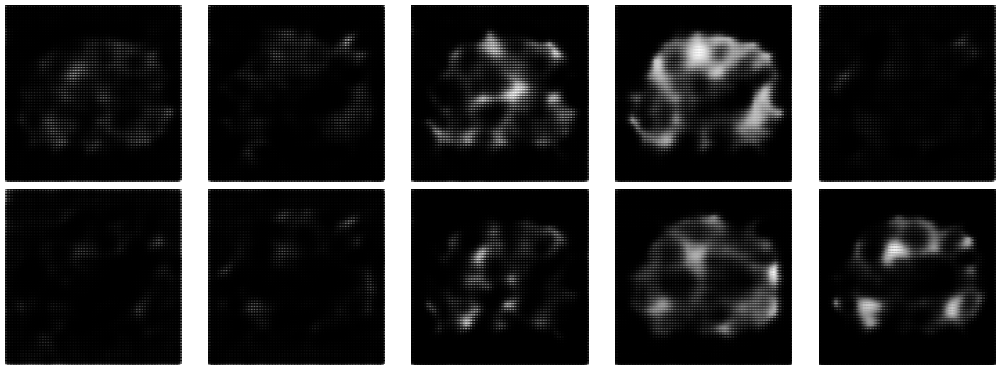

In [21]:
np.random.seed(SEED)
for epoch in range(10):
    for batch in tqdm(range(STEPS_PER_EPOCH)):

        noise = np.random.normal(0,1, size=(BATCH_SIZE, NOISE_DIM))
        fake_X = generator.predict(noise)
        
        idx = np.random.randint(0, X_train.shape[0], size=BATCH_SIZE)
        real_X = X_train[idx]

        X = np.concatenate((real_X, fake_X))

        disc_y = np.zeros(2*BATCH_SIZE)
        disc_y[:BATCH_SIZE] = 1

        d_loss = discriminator.train_on_batch(X, disc_y)
        
        y_gen = np.ones(BATCH_SIZE)
        g_loss = gan.train_on_batch(noise, y_gen)

    print(f"EPOCH: {epoch + 1} Generator Loss: {g_loss:.4f} Discriminator Loss: {d_loss:.4f}")
    noise = np.random.normal(0, 1, size=(10,NOISE_DIM))
    sample_images(noise, (2,5))

# Let's generate some images !

1/1 [==============================] - 0s 229ms/step


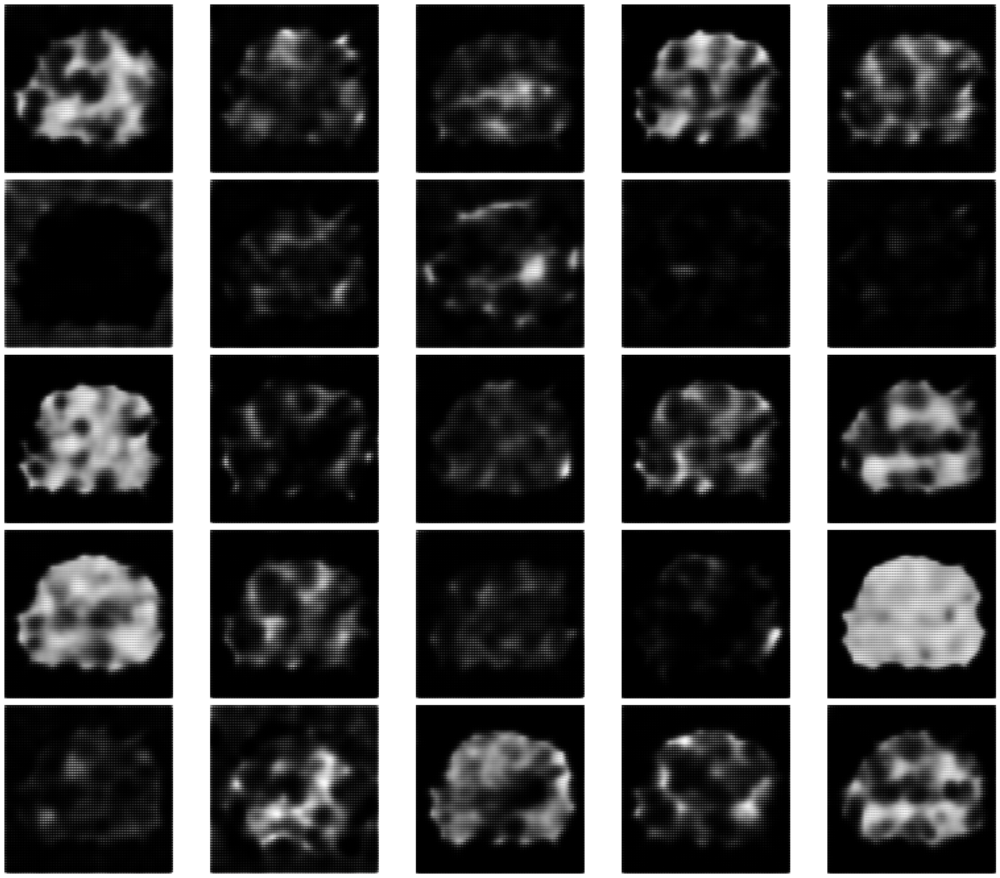

In [22]:
noise = np.random.normal(0, 1, size=(25, NOISE_DIM))
sample_images(noise, (5,5), (24,20), save=True)

noise = np.random.normal(0, 1, size=(100, NOISE_DIM))
sample_images(noise, (10,10), (24,20), save=True)

# Testing the Generated sample: Plotting the Distributions

<p style="font-size:20px">In this test, we compare the generated images with the real samples by plotting their distributions. If the distributions overlap, that indicates the generated samples are very close to the real ones
</p>

In [23]:
generated_images = generator.predict(noise)
generated_images.shape

1/1 [==============================] - 0s 136ms/step


(25, 128, 128, 1)

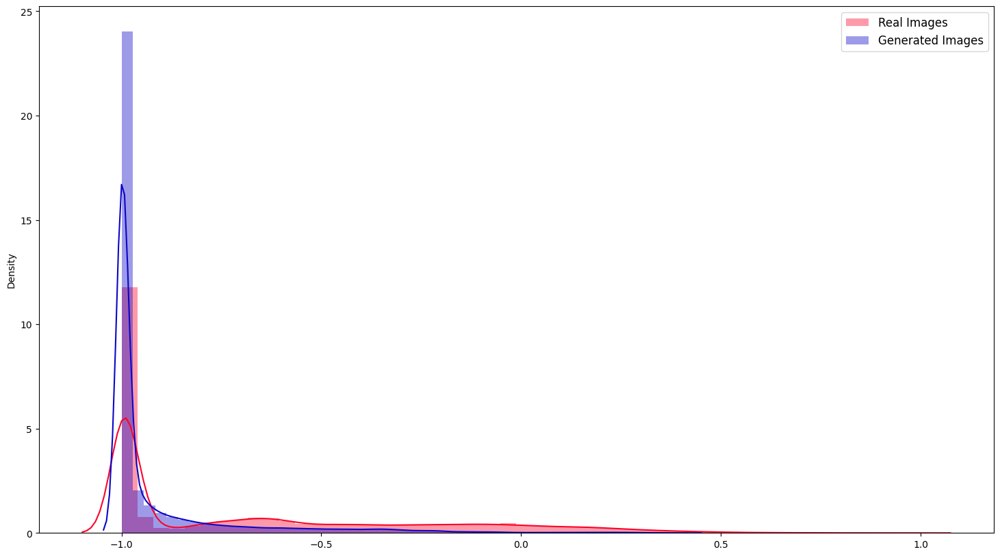

In [24]:
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(18,10))

sns.distplot(X_train, label='Real Images', hist=True, color='#fc0328', ax=axs)
sns.distplot(generated_images, label='Generated Images', hist=True, color='#0c06c7', ax=axs)

axs.legend(loc='upper right', prop={'size': 12})

plt.show()

# Conclusion

<p style="font-size:20px">
    As we can see from the plot, the distribution of Generated Images is approximately the same as that of the Real Images. From this we can conclude that the generated images are a true representative of the real ones, capturing most of the variations.
</p>

# References

<p style="font-size:20px">
<ul>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/1406.2661">Generative Adversarial Networks</a> (2014)</li>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/1606.03498">Improved Techniques for Training GANs</a> (2016)</li>
    <li style="font-size:20px"><a href="https://arxiv.org/abs/2108.03235">SMOTified-GAN for class imbalanced pattern classification problems</a> (2021)</li>
</ul>
</p>